# Dependencies

In [1]:
import os
from collections import Counter
from copy import copy

import pandas as pd
import numpy as np

from sklearn.preprocessing import OneHotEncoder
from sklearn.feature_selection import SelectPercentile, f_classif
from sklearn.model_selection import StratifiedShuffleSplit,ShuffleSplit,StratifiedKFold,KFold
from sklearn.model_selection import GridSearchCV, ParameterGrid
from sklearn.metrics import roc_curve, auc, mean_squared_error, roc_auc_score
from sklearn.preprocessing import scale, minmax_scale, MinMaxScaler
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA, KernelPCA

import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Lambda, Dense, concatenate, Dropout
from tensorflow.keras.losses import MeanSquaredError
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.utils import plot_model
from tensorflow.keras.wrappers.scikit_learn import KerasRegressor

import matplotlib
import matplotlib.pylab as plt
from scipy import interp

import pandas as pd
import seaborn as sns

import plotly.offline as py
import plotly.graph_objs as go
py.init_notebook_mode()
import shutil

# Settings

In [2]:
np.random.seed(256)
random_seed = 42

n_shuffles = 10
n_cv_folds = 3
test_data_ratio = 0.2

f_sele = True
f_percent = 30

try:
    os.mkdir("output_data/")
except OSError:
    print("Directory already exists")

Directory already exists


# Loading data

In [3]:
# Training data
X = pd.read_csv("input_data/crohns/TN_crohn.unoise3.ASV.table_FINAL.txt", sep = "\t", index_col = 0)
X = X.transpose()
labels = np.load("input_data/crohns/labels.npy", allow_pickle = True)
ids = np.load("input_data/crohns/IDs.npy", allow_pickle = True)
# Taxa data
tax_table = pd.read_csv("input_data/crohns/ASV_taxonomy_TN_crohn_SILVA_138.csv", index_col = "ASV_ID")

In [4]:
len(tax_table.index)

3513

In [5]:
X.shape

(1359, 3655)

In [6]:
counts = Counter(labels)
print(counts)

Counter({'CD': 731, 'no': 335, 'UC': 219, 'IC': 73, 'control': 1})


In [4]:
# Delete control
drop_id = ids[np.where(labels == "control")[0][0]]
labels = np.delete(labels, np.where(labels == "control")[0][0])
X = X.drop(drop_id)

# Classifiying only CD, randomly subsampling patients

In [5]:
len_healthy = counts["no"]
cd_idx = np.random.choice(np.where(labels == "CD")[0], len_healthy, replace = False)
healthy_idx = np.where(labels == "no")[0]
joined_idx = np.concatenate((cd_idx, healthy_idx))
X = X.iloc[joined_idx]
labels = labels[joined_idx]

NameError: name 'counts' is not defined

In [75]:
enc = OneHotEncoder(sparse = False)
y = enc.fit_transform(labels.astype(str).reshape(-1, 1))
y = y[:, 0]

In [10]:
# Filter out Eukaryotes?

In [11]:
X.head()

#OTU ID,Zotu5,Zotu601,Zotu125,Zotu1119,Zotu79,Zotu127,Zotu49,Zotu62,Zotu9,Zotu64,...,Zotu3145,Zotu2819,Zotu3130,Zotu3534,Zotu3234,Zotu2542,Zotu2700,Zotu3558,Zotu3065,Zotu2641
ERR1369173,118,0,0,0,1,0,22,0,1269,0,...,0,0,0,0,0,0,0,0,0,0
ERR1369617,4,0,0,0,0,0,0,3,16,0,...,0,0,0,0,0,0,0,0,0,0
ERR1369732,103,0,2,0,2,0,5,4,105,0,...,0,0,0,0,0,0,0,0,0,0
ERR1369030,11,0,11,0,28,3,28,28,147,7,...,0,0,0,0,0,0,0,0,0,0
ERR1369699,0,0,0,0,40,0,0,0,4,0,...,0,0,0,0,0,0,0,0,0,0


In [12]:
tax_table.head()

,Kingdom,Phylum,Class,Order,Family,Genus,Species
ASV_ID,,,,,,,
Zotu1,Bacteria,Bacteroidota,Bacteroidia,Bacteroidales,Bacteroidaceae,Bacteroides,vulgatus
Zotu2,Bacteria,Bacteroidota,Bacteroidia,Bacteroidales,Bacteroidaceae,Bacteroides,NaN
Zotu3,Bacteria,Firmicutes,Clostridia,Oscillospirales,Ruminococcaceae,Faecalibacterium,NaN
Zotu4,Bacteria,Proteobacteria,Gammaproteobacteria,Enterobacterales,Enterobacteriaceae,Escherichia/Shigella,NaN
Zotu5,Bacteria,Bacteroidota,Bacteroidia,Bacteroidales,Bacteroidaceae,Bacteroides,NaN


In [36]:
pd.isnull(tax_table['Species'].unique())

array([False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,

In [7]:
zotu_abundances = X

In [14]:
X.head()

#OTU ID,Zotu5,Zotu601,Zotu125,Zotu1119,Zotu79,Zotu127,Zotu49,Zotu62,Zotu9,Zotu64,...,Zotu3145,Zotu2819,Zotu3130,Zotu3534,Zotu3234,Zotu2542,Zotu2700,Zotu3558,Zotu3065,Zotu2641
ERR1369173,118,0,0,0,1,0,22,0,1269,0,...,0,0,0,0,0,0,0,0,0,0
ERR1369617,4,0,0,0,0,0,0,3,16,0,...,0,0,0,0,0,0,0,0,0,0
ERR1369732,103,0,2,0,2,0,5,4,105,0,...,0,0,0,0,0,0,0,0,0,0
ERR1369030,11,0,11,0,28,3,28,28,147,7,...,0,0,0,0,0,0,0,0,0,0
ERR1369699,0,0,0,0,40,0,0,0,4,0,...,0,0,0,0,0,0,0,0,0,0


# Function that maps OTUs abundances to list of dataframes of taxa abundance

In [70]:
def zotus_to_tax_dfs(zotu_abundances, tax_table):
    dataframes = []
    for rank in ["Kingdom", "Phylum", "Class", "Order", "Family", "Genus", "Species"]:
        headers = tax_table[rank].unique()
        headers[np.argwhere(pd.isnull(headers)).flatten()] = f'NaN_{rank}'
        rows = range(len(zotu_abundances))
        dataframe = pd.DataFrame(columns = headers, index = rows)
        dataframe = dataframe.fillna(0)
        for zotu_name in zotu_abundances.columns:
            if zotu_name not in tax_table.index:
                continue
            tax = tax_table.loc[zotu_name][rank]
            if pd.isnull(tax):
                tax = f'NaN_{rank}'
            summed_series = dataframe[tax].values + zotu_abundances[zotu_name].values
            dataframe[tax] = summed_series
        dataframes.append(dataframe)
    dataframes.append(zotu_abundances.copy().reset_index(drop=True))
    return dataframes

In [9]:
def group_by_params(df, n_combinations, n_scores = 2):
    mean_score_df = pd.DataFrame(index = df.index[:n_scores], columns = [comb + 1 for comb in range(n_combinations)])
    params = []
    for i in range(n_combinations):
        filtered = df.filter(regex=("CV_.*_GS_{}$".format(i+1)))
        params.append(filtered.loc['Params', "CV_1_GS_{}".format(i+1)])
        mean_score_df[i+1] = filtered.loc[filtered.index[:n_scores]].mean(axis = 1).values
    mean_score_df.loc['Params'] = params
    return mean_score_df, params 

In [46]:
from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

scaled_X_values = scaler.fit(X).transform(X, copy=True)

imputer = KNNImputer(n_neighbors=4)

X_no_nans_scaled = imputer.fit_transform(scaled_X_values)

X_no_nans = scaler.inverse_transform(X_no_nans_scaled)

X_no_nans_df = pd.DataFrame(X_no_nans, columns=X.columns, index=X.index)

split_dfs = zotus_to_tax_dfs(X_no_nans_df, tax_table)

split_dfs[0].tail()

['Bacteria' 'NaN_Kingdom' 'Eukaryota' 'Archaea']
['Bacteroidota' 'Firmicutes' 'Proteobacteria' 'NaN_Phylum'
 'Verrucomicrobiota' 'Actinobacteriota' 'Fusobacteriota'
 'Desulfobacterota' 'Cyanobacteria' 'Euryarchaeota' 'Campilobacterota'
 'Spirochaetota' 'Deferribacterota' 'Synergistota' 'Vertebrata'
 'Patescibacteria' 'Planctomycetota' 'Myxococcota' 'Deinococcota'
 'Bdellovibrionota' 'Abditibacteriota' 'Thermoplasmatota' 'Euglenozoa'
 'Gemmatimonadota' 'WPS-2' 'Acidobacteriota' 'Chloroflexi' 'Nanoarchaeota'
 'Dependentiae' 'Armatimonadota']
['Bacteroidia' 'Clostridia' 'Gammaproteobacteria' 'NaN_Class'
 'Negativicutes' 'Bacilli' 'Verrucomicrobiae' 'Actinobacteria'
 'Fusobacteriia' 'Desulfovibrionia' 'Coriobacteriia' 'Alphaproteobacteria'
 'Vampirivibrionia' 'Methanobacteria' 'Campylobacteria' 'Brachyspirae'
 'Lentisphaeria' 'Incertae_Sedis' 'Cyanobacteriia' 'Deferribacteres'
 'Synergistia' 'Limnochordia' 'Mammalia' 'Saccharimonadia'
 'Planctomycetes' 'Polyangia' 'Gracilibacteria' 'Deinoc

['vulgatus' 'NaN_Species' 'prausnitzii' 'caccae' 'massiliensis' 'invisus'
 'excrementihominis' 'merdae' 'inulinivorans' 'uniformis' 'bacterium'
 'muciniphila' 'longicatena' 'hadrus' 'copri' 'distasonis'
 'saccharivorans' 'putredinis' 'ramosum' 'wadsworthia' 'nexilis'
 'bartlettii' 'wadsworthensis' 'plebeius' 'aerofaciens' 'coprocola'
 'finegoldii' 'faecis' 'obeum' 'caecimuris' 'intestinalis' 'comes'
 'faecium' 'plautii' 'formicigenerans' 'splanchnicus' 'bicirculans'
 'edouardi' 'pectinoschiza' 'bromii' 'periodonticum' 'paraputrificum'
 'intestini' 'eggerthii' 'catus' 'hominis' 'shahii' 'nucleatum'
 'hathewayi' 'mitsuokai' 'propionicifaciens' 'metallidurans' 'segnis'
 'asaccharolytica' 'fastidiosus' 'salyersiae' 'tayi' 'morganii'
 'sanguinis' 'succinatutens' 'biformis' 'coprophilus' 'bifidum' 'nordii'
 'callidus' 'filiformis' 'funiformis' 'fastidiosa' 'goldsteinii' 'varium'
 'butyricum' 'stomatis' 'succinatiphilus' 'ulcerans' 'obesi'
 'pectinilyticus' 'glucerasea' 'eutactus' 'nigrescens

,Bacteria,NaN_Kingdom,Eukaryota,Archaea
1353,127752.0,197.0,173.0,0.0
1354,169443.0,252.0,133.0,0.0
1355,3288.0,416.0,94.0,0.0
1356,32413.0,188.0,88.0,0.0
1357,101631.0,375.0,280.0,0.0


In [71]:
split_dfs = zotus_to_tax_dfs(X, tax_table)

In [72]:
split_dfs[7].head()

#OTU ID,Zotu5,Zotu601,Zotu125,Zotu1119,Zotu79,Zotu127,Zotu49,Zotu62,Zotu9,Zotu64,...,Zotu3145,Zotu2819,Zotu3130,Zotu3534,Zotu3234,Zotu2542,Zotu2700,Zotu3558,Zotu3065,Zotu2641
0,630,604,908,54,4052,2754,2625,94,873,1399,...,0,0,0,0,0,0,0,0,0,0
1,27,0,8,0,1,0,17,90,56,7,...,0,0,0,0,0,0,0,0,0,0
2,8,0,1,8,5,1,0,53,2905,58,...,0,0,0,0,0,0,0,0,0,0
3,987,4,16,0,0,0,129,170,5,12,...,0,0,0,0,0,0,0,0,0,0
4,20,0,134,0,1,0,40,63,11,0,...,0,0,0,0,0,0,0,0,0,0


In [73]:
merged_dfs = pd.concat(split_dfs, axis=1, join='inner')

import os.path as op

output_path = op.join('output_data', 'merged_dfs.csv')
merged_dfs.to_csv(output_path)

In [76]:
np.save(op.join('output_data', 'y_merged_datasets'), y)

In [13]:
merged_dfs = pd.concat(split_dfs, axis=1, join='inner')

In [64]:
merged_dfs.head()

,Bacteria,NaN_Kingdom,Eukaryota,Archaea,Bacteroidota,Firmicutes,Proteobacteria,NaN_Phylum,Verrucomicrobiota,Actinobacteriota,...,valvarum,dentalis,hofstadii,europaea,marshii,antarcticum,crusticola,bauzanensis,coleohominis,gerencseriae
0,45167,1,9,0,9579,33466,412,10,0,1654,...,0,0,0,0,0,0,0,0,0,1
1,21519,1,8,0,3396,13717,3,9,1567,2701,...,0,0,0,0,0,0,0,0,0,0
2,51644,2,25,0,1666,43650,6295,27,1,19,...,0,0,0,0,0,0,0,0,0,0
3,50652,2,7,744,15045,33884,108,17,2,1436,...,0,0,0,0,0,0,0,0,0,0
4,7223,0,1,0,1021,5954,22,1,33,193,...,0,0,0,0,0,0,0,0,0,0


# Model build function

In [17]:
def build_fn(input_dimensions, learning_rate, activation, n_branch_outputs, dropout):
    
    dim_k, dim_p, dim_c, dim_o, dim_f, dim_g, dim_s, dim_z = input_dimensions

    # Inputs
    inputKingdom = Input(shape=(dim_k,), name = "input_kingdom")
    inputPhylum = Input(shape=(dim_p,), name = "input_phylum")
    inputClass = Input(shape=(dim_c,), name = "input_class")
    inputOrder = Input(shape=(dim_o,), name = "input_order")
    inputFamily = Input(shape=(dim_f,), name = "input_family")
    inputGenus = Input(shape=(dim_g,), name = "input_genus")
    inputSpecies = Input(shape=(dim_s,), name = "input_species")
    inputZotus = Input(shape=(dim_z,), name = "input_zotu")

    # Kingdom branch
    k = Dense(1, activation=activation)(inputKingdom)
    k = Model(inputs=inputKingdom, outputs=k)
    # Phylum branch
    p = Dense(16, activation=activation)(inputPhylum)
    p = Dense(n_branch_outputs, activation=activation)(p)
    p = Model(inputs=inputPhylum, outputs=p)
    # Class branch
    c = Dense(32, activation=activation)(inputClass)
    c = Dense(n_branch_outputs, activation=activation)(c)
    c = Model(inputs=inputClass, outputs=c)
    # Order branch
    o = Dense(32, activation=activation)(inputOrder)
    o = Dense(n_branch_outputs, activation=activation)(o)
    o = Model(inputs=inputOrder, outputs=o)
    # Family branch
    f = Dense(64, activation=activation)(inputFamily)
    f = Dense(n_branch_outputs, activation=activation)(f)
    f = Model(inputs=inputFamily, outputs=f)
    # Genus branch
    g = Dense(64, activation=activation)(inputGenus)
    g = Dense(n_branch_outputs, activation=activation)(g)
    g = Model(inputs=inputGenus, outputs=g)
    # Species branch
    s = Dense(64, activation=activation)(inputSpecies)
    s = Dense(n_branch_outputs, activation=activation)(s)
    s = Model(inputs=inputSpecies, outputs=s)
    # Zotu branch
    z = Dense(64, activation=activation)(inputZotus)
    z = Dense(32, activation=activation)(z)
    z = Dense(n_branch_outputs, activation=activation)(z)
    z = Model(inputs=inputZotus, outputs=z)
    # Concatenating outputs
    combined = concatenate([k.output, p.output, c.output, o.output, f.output, g.output, s.output, z.output])
    x = Dropout(dropout)(combined)
    # Fully connected layers
    x = Dense(32, activation=activation)(x)
    x = Dense(1, activation="sigmoid")(x)
    # Final model
    model = Model(inputs=[k.input, p.input, c.input, o.input, f.input, g.input, s.input, z.input], outputs = x)
    model.compile(optimizer = Adam(lr = learning_rate), loss = MeanSquaredError())
    return model

In [18]:
#model.summary()

In [19]:
#plot_model(model)

# Shuffle and train

In [20]:
list_auc=[]

tprs = []
aucs = []
mean_fpr = np.linspace(0, 1, 100)

i = 0
StratShufSpl=StratifiedShuffleSplit(n_shuffles,
                                    test_size = test_data_ratio, 
                                    random_state = random_seed)

plt.style.use('ggplot')
params = {'legend.fontsize': 'medium',
          'figure.figsize': (10, 10),
          'axes.labelsize': 'medium',
          'axes.titlesize':'medium',
          'xtick.labelsize':'medium',
          'ytick.labelsize':'medium'}
plt.rcParams.update(params)
plt.rcParams["font.family"] = "sans-serif"
#"cursive"
shuffle_counter=0

--------------------------------
Beginning shuffle 1
--------------------------------


Univariately selecting features

--------------------------------
Beginning cross validation fold 1 in shuffle 1 with 216 candidates
--------------------------------


Splitting data in different taxanomic ranks



/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning:

Pass percentile=30 as keyword args. From version 0.25 passing these as positional arguments will result in an error

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/feature_selection/_univariate_selection.py:114: UserWarning:

Features [ 167  366  394  514  528  875  963  990 1017 1028 1030 1036 1038 1040
 1051 1064 1065 1073 1075 1078 1081 1083 1091 1094 1097 1108 1116 1119
 1132 1158 1159 1174 1189 1193 1209 1221 1222 1280 1321 1327 1349 1370
 1488 1490 1495 1502 1509 1532 1536 1545 1566 1576 1583 1611 1614 1622
 1635 1665 1669 1684 1717 1723 1727 1737 1742 1743 1746 1752 1753 1762
 1765 1785 1793 1798 1804 1814 1831 1833 1834 1843 1875 1917 1918 1919
 1920 1921 1922 1923 1924 1930 1932 1938 1943 1944 1948 1950 1958 1967
 1969 1974 1984 1986 1987 1988 1997 1999 2020 2021 2039 2042 2044 2050
 2060 2061 2062 2063 2080 2083 2088 2090 2097 2100 2105 2111 211

Fitting scalers
Finished scaling
Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.1918 - val_loss: 0.0643
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0765 - val_loss: 0.0389
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0455 - val_loss: 0.0621
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0202 - val_loss: 0.0322
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.0341
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0123 - val_loss: 0.0396
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.0711
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.1493
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0144 - val_loss: 0.0768
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.

Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0390 - val_loss: 0.0832
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0319 - val_loss: 0.0834
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0337 - val_loss: 0.0510
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0264 - val_loss: 0.0924
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0113 - val_loss: 0.0561
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0808
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0144 - val_loss: 0.0664
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.0732
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.0555
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.0877


Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.0946
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0961
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0970
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.0773
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.0902
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.0936
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0903
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0025 - val_loss: 0.0949
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0021 - val_loss: 0.0911
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0017 - val_loss: 0.0922


Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2190 - val_loss: 0.2254
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2133 - val_loss: 0.2214
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2072 - val_loss: 0.2158
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2010 - val_loss: 0.2123
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1947 - val_loss: 0.2070
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1882 - val_loss: 0.2021
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1814 - val_loss: 0.1963
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1741 - val_loss: 0.1900
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1670 - val_loss: 0.1831
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1588 - val_loss: 0.1768
E

Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1063 - val_loss: 0.0963
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0974 - val_loss: 0.0902
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0900 - val_loss: 0.0835
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0818 - val_loss: 0.0798
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0767 - val_loss: 0.0765
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0702 - val_loss: 0.0732
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0654 - val_loss: 0.0679
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0606 - val_loss: 0.0650
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0562 - val_loss: 0.0639
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0527 - val_loss: 0.0610


Epoch 99/300
25/25 [==============================] - 0s 2ms/step - loss: 8.8678e-04 - val_loss: 0.0297
Epoch 100/300
25/25 [==============================] - 0s 2ms/step - loss: 8.5471e-04 - val_loss: 0.0296
Epoch 101/300
25/25 [==============================] - 0s 2ms/step - loss: 8.2750e-04 - val_loss: 0.0297
Epoch 102/300
25/25 [==============================] - 0s 2ms/step - loss: 7.9797e-04 - val_loss: 0.0298
Epoch 103/300
25/25 [==============================] - 0s 2ms/step - loss: 7.7228e-04 - val_loss: 0.0297
Epoch 104/300
25/25 [==============================] - 0s 2ms/step - loss: 7.4917e-04 - val_loss: 0.0297
Epoch 105/300
25/25 [==============================] - 0s 2ms/step - loss: 7.2476e-04 - val_loss: 0.0297
Epoch 106/300
25/25 [==============================] - 0s 2ms/step - loss: 7.0272e-04 - val_loss: 0.0297
Epoch 107/300
25/25 [==============================] - 0s 2ms/step - loss: 6.7949e-04 - val_loss: 0.0297
Epoch 108/300
25/25 [==============================] - 0

25/25 [==============================] - 0s 2ms/step - loss: 0.0471 - val_loss: 0.1407
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0355 - val_loss: 0.2068
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0401 - val_loss: 0.1389
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0219 - val_loss: 0.1241
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0279 - val_loss: 0.1739
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0270 - val_loss: 0.1504
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0233 - val_loss: 0.0985
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0249 - val_loss: 0.1209


Val AUC: 0.8446502057613169


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2164 - val_loss: 0.1499
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1272 - 

Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.0389
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.0304
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.0285
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.0276
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.0639
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.0446
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0558
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.0398
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0090 - val_loss: 0.0377
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.0422


25/25 [==============================] - 0s 2ms/step - loss: 0.0275 - val_loss: 0.0393
Epoch 103/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0297 - val_loss: 0.0442
Epoch 104/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0340 - val_loss: 0.0409
Epoch 105/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0285 - val_loss: 0.0395
Epoch 106/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0313 - val_loss: 0.0386
Epoch 107/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0405 - val_loss: 0.0412
Epoch 108/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0421 - val_loss: 0.0431
Epoch 109/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0266 - val_loss: 0.0390
Epoch 110/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0273 - val_loss: 0.0381
Epoch 111/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0355 - val_loss: 0.0407
Epoc

Epoch 70/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0092 - val_loss: 0.0501
Epoch 71/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.0500
Epoch 72/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0488
Epoch 73/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0090 - val_loss: 0.0488
Epoch 74/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.0491
Epoch 75/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0485
Epoch 76/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.0480
Epoch 77/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.0486
Epoch 78/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0481
Epoch 79/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.0492


25/25 [==============================] - 0s 2ms/step - loss: 0.0491 - val_loss: 0.0690
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0526 - val_loss: 0.0645
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1334 - val_loss: 0.0980
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1391 - val_loss: 0.1210
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1075 - val_loss: 0.1127
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0973 - val_loss: 0.1160
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1062 - val_loss: 0.1550
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1003 - val_loss: 0.1259
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0987 - val_loss: 0.1487
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0887 - val_loss: 0.1531
Epoch 30/300


25/25 [==============================] - 0s 2ms/step - loss: 0.1969 - val_loss: 0.1490
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1412 - val_loss: 0.0921
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0892 - val_loss: 0.0620
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0530 - val_loss: 0.0645
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0331 - val_loss: 0.0972
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0270 - val_loss: 0.1018
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0156 - val_loss: 0.0660
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0137 - val_loss: 0.0583
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0139 - val_loss: 0.0609
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.0688
Epoch 12/300
25/25 [

25/25 [==============================] - 0s 2ms/step - loss: 0.0531 - val_loss: 0.0689
Epoch 92/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0626 - val_loss: 0.0725
Epoch 93/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0583 - val_loss: 0.0619
Epoch 94/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0604 - val_loss: 0.0510
Epoch 95/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0474 - val_loss: 0.0661
Epoch 96/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0635 - val_loss: 0.0764
Epoch 97/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0533 - val_loss: 0.0767
Epoch 98/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0499 - val_loss: 0.0792
Epoch 99/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0604 - val_loss: 0.0860
Epoch 100/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0551 - val_loss: 0.0725
Epoch 101/30

13/13 [==============================] - 0s 3ms/step - loss: 0.0308 - val_loss: 0.1352
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0302 - val_loss: 0.0803
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0276 - val_loss: 0.1383
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0344 - val_loss: 0.1486
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0290 - val_loss: 0.1422
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0313 - val_loss: 0.0905
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0251 - val_loss: 0.1013
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0212 - val_loss: 0.0970
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0187 - val_loss: 0.1311
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0190 - val_loss: 0.0850
Epoch 19/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.1286
Epoch 42/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.1286


Val AUC: 0.9224965706447189


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2325 - val_loss: 0.1301
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1433 - val_loss: 0.0770
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0622 - val_loss: 0.0410
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0304 - val_loss: 0.0551
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0161 - val_loss: 0.0537
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0122 - val_loss: 0.0889
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1433
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_l

Epoch 49/300
13/13 [==============================] - 0s 3ms/step - loss: 6.1694e-05 - val_loss: 0.0582
Epoch 50/300
13/13 [==============================] - 0s 3ms/step - loss: 5.8503e-05 - val_loss: 0.0586
Epoch 51/300
13/13 [==============================] - 0s 3ms/step - loss: 5.5501e-05 - val_loss: 0.0585
Epoch 52/300
13/13 [==============================] - 0s 3ms/step - loss: 5.2965e-05 - val_loss: 0.0590


Val AUC: 0.9231824417009602


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2495 - val_loss: 0.2482
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2489 - val_loss: 0.2474
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2483 - val_loss: 0.2466
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2477 - val_loss: 0.2459
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2469 - val_loss: 0.2449
Epoch 6/300
13/13 [==============================] - 0s 

13/13 [==============================] - 0s 2ms/step - loss: 0.0524 - val_loss: 0.0628
Epoch 160/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0518 - val_loss: 0.0617
Epoch 161/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0517 - val_loss: 0.0617
Epoch 162/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0512 - val_loss: 0.0666
Epoch 163/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0517 - val_loss: 0.0654
Epoch 164/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0508 - val_loss: 0.0640
Epoch 165/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0499 - val_loss: 0.0630
Epoch 166/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0494 - val_loss: 0.0632
Epoch 167/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0490 - val_loss: 0.0647
Epoch 168/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0493 - val_loss: 0.0645
Epoc

13/13 [==============================] - 0s 2ms/step - loss: 0.0964 - val_loss: 0.1123
Epoch 37/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0915 - val_loss: 0.1095
Epoch 38/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0868 - val_loss: 0.1054
Epoch 39/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0824 - val_loss: 0.1055
Epoch 40/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0783 - val_loss: 0.0965
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0740 - val_loss: 0.0945
Epoch 42/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0701 - val_loss: 0.0918
Epoch 43/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0664 - val_loss: 0.0915
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0629 - val_loss: 0.0883
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0607 - val_loss: 0.0942
Epoch 46/300


Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1723 - val_loss: 0.1742
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1648 - val_loss: 0.1659
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1577 - val_loss: 0.1595
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1505 - val_loss: 0.1544
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1424 - val_loss: 0.1451
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1347 - val_loss: 0.1401
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1272 - val_loss: 0.1338
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1198 - val_loss: 0.1261
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1125 - val_loss: 0.1195
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1063 - val_loss: 0.1134


Epoch 103/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0053 - val_loss: 0.0531
Epoch 104/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.0530
Epoch 105/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.0528
Epoch 106/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0050 - val_loss: 0.0529
Epoch 107/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0049 - val_loss: 0.0531
Epoch 108/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0531
Epoch 109/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.0532
Epoch 110/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.0533


Val AUC: 0.9348422496570644


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2239 - val_loss: 0.1066
Epoch 2/300
13/13 [==============================] - 0s 2ms/

13/13 [==============================] - 0s 2ms/step - loss: 0.0443 - val_loss: 0.0728
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0154 - val_loss: 0.0546
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.0580
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0073 - val_loss: 0.0611
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0056 - val_loss: 0.0699
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0047 - val_loss: 0.0679
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.0677
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0121 - val_loss: 0.0690
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.1344
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.0764
Epoch 17/300
13

13/13 [==============================] - 0s 3ms/step - loss: 0.0278 - val_loss: 0.0423


Val AUC: 0.934156378600823


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2412 - val_loss: 0.2217
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2154 - val_loss: 0.1853
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1869 - val_loss: 0.1471
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1459 - val_loss: 0.1093
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1160 - val_loss: 0.0774
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0837 - val_loss: 0.0626
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0572 - val_loss: 0.0504
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0437 - val_loss: 0.0416
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0306 - val_los

Epoch 75/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0824 - val_loss: 0.1031
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0787 - val_loss: 0.1005
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0842 - val_loss: 0.1039
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0830 - val_loss: 0.1058
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0755 - val_loss: 0.1067
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0810 - val_loss: 0.1026
Epoch 81/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0789 - val_loss: 0.1008
Epoch 82/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0691 - val_loss: 0.1009
Epoch 83/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0749 - val_loss: 0.1002
Epoch 84/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0660 - val_loss: 0.0985


Epoch 126/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0069 - val_loss: 0.0351
Epoch 127/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.0359
Epoch 128/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.0365
Epoch 129/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.0365
Epoch 130/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0044 - val_loss: 0.0369
Epoch 131/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.0370


Val AUC: 0.9355281207133058


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2506 - val_loss: 0.2435
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2458 - val_loss: 0.2411
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2441 - val_loss: 0.2384
Epoch 4/300
13/13 [==============================] - 0s 2ms/step

13/13 [==============================] - 0s 3ms/step - loss: 0.0544 - val_loss: 0.0958
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0482 - val_loss: 0.0796
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0311 - val_loss: 0.0830
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0270 - val_loss: 0.0825
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0271 - val_loss: 0.0868
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0250 - val_loss: 0.1052
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0536 - val_loss: 0.1312
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0567 - val_loss: 0.0842
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0380 - val_loss: 0.0835
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0224 - val_loss: 0.0849
Epoch 21/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0779 - val_loss: 0.0604
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0725 - val_loss: 0.0661
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0622 - val_loss: 0.0603
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0579 - val_loss: 0.0615
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0636 - val_loss: 0.0516
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0588 - val_loss: 0.0577
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0548 - val_loss: 0.0507
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0549 - val_loss: 0.0510
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0604 - val_loss: 0.0578
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0558 - val_loss: 0.0581
Epoch 23/300


Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0153 - val_loss: 0.0397
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0443
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0099 - val_loss: 0.0474
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0303 - val_loss: 0.1805
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0157 - val_loss: 0.0423
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.0418
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0119 - val_loss: 0.0422
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0144 - val_loss: 0.0431
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0122 - val_loss: 0.0458
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0108 - val_loss: 0.0472


Epoch 106/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0902 - val_loss: 0.0757
Epoch 107/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0849 - val_loss: 0.0766
Epoch 108/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0751 - val_loss: 0.0777
Epoch 109/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0791 - val_loss: 0.0738
Epoch 110/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0879 - val_loss: 0.0679
Epoch 111/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0916 - val_loss: 0.0680
Epoch 112/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0769 - val_loss: 0.0716
Epoch 113/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0770 - val_loss: 0.0741
Epoch 114/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0726 - val_loss: 0.0724
Epoch 115/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0871 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.0556 - val_loss: 0.0612
Epoch 188/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0666 - val_loss: 0.0593
Epoch 189/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0575 - val_loss: 0.0601
Epoch 190/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0690 - val_loss: 0.0627
Epoch 191/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0679 - val_loss: 0.0646
Epoch 192/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0690 - val_loss: 0.0643


Val AUC: 0.9441015089163238


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2512 - val_loss: 0.2488
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2492 - val_loss: 0.2480
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2466 - val_loss: 0.2474
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.248

Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0555 - val_loss: 0.0597
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0642 - val_loss: 0.0582
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0546 - val_loss: 0.0578
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0517 - val_loss: 0.0568
Epoch 81/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0539 - val_loss: 0.0549
Epoch 82/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0460 - val_loss: 0.0542
Epoch 83/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0444 - val_loss: 0.0534
Epoch 84/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0507 - val_loss: 0.0529
Epoch 85/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0439 - val_loss: 0.0534
Epoch 86/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0485 - val_loss: 0.0508


13/13 [==============================] - 0s 2ms/step - loss: 0.0407 - val_loss: 0.0541
Epoch 68/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0379 - val_loss: 0.0537
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0392 - val_loss: 0.0522
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0376 - val_loss: 0.0514
Epoch 71/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0372 - val_loss: 0.0510
Epoch 72/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0358 - val_loss: 0.0499
Epoch 73/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0359 - val_loss: 0.0495
Epoch 74/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0352 - val_loss: 0.0498
Epoch 75/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0356 - val_loss: 0.0488
Epoch 76/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0350 - val_loss: 0.0486
Epoch 77/300


7/7 [==============================] - 0s 3ms/step - loss: 0.0479 - val_loss: 0.1016
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0469 - val_loss: 0.0963
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0427 - val_loss: 0.0744
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0367 - val_loss: 0.0779
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0328 - val_loss: 0.0737
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0293 - val_loss: 0.0688
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0263 - val_loss: 0.0744
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0240 - val_loss: 0.0732
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0216 - val_loss: 0.0693
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0207 - val_loss: 0.0749
Epoch 24/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0037 - val_loss: 0.0467
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0036 - val_loss: 0.0457
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0035 - val_loss: 0.0455
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0035 - val_loss: 0.0464
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.0469
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.0458
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.0463
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.0465
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.0473
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0031 - val_loss: 0.0579
Epoch 46/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1107 - val_loss: 0.1101
Epoch 60/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1085 - val_loss: 0.1087
Epoch 61/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1062 - val_loss: 0.1071
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1038 - val_loss: 0.1050
Epoch 63/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1016 - val_loss: 0.1029
Epoch 64/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1000 - val_loss: 0.1012
Epoch 65/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0976 - val_loss: 0.0998
Epoch 66/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0951 - val_loss: 0.0984
Epoch 67/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0930 - val_loss: 0.0965
Epoch 68/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0908 - val_loss: 0.0952
Epoch 69/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.2350 - val_loss: 0.2369
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2331 - val_loss: 0.2354
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2314 - val_loss: 0.2342
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2296 - val_loss: 0.2325
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2278 - val_loss: 0.2307
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2261 - val_loss: 0.2287
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2244 - val_loss: 0.2269
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2226 - val_loss: 0.2252
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2207 - val_loss: 0.2236
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2188 - val_loss: 0.2221
Epoch 18/300
7/7 [================

Epoch 174/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0120 - val_loss: 0.0499
Epoch 175/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0119 - val_loss: 0.0544
Epoch 176/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0117 - val_loss: 0.0550
Epoch 177/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0116 - val_loss: 0.0558
Epoch 178/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0115 - val_loss: 0.0585
Epoch 179/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0110 - val_loss: 0.0458
Epoch 180/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0113 - val_loss: 0.0423
Epoch 181/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0114 - val_loss: 0.0421
Epoch 182/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0112 - val_loss: 0.0429
Epoch 183/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0108 - val_loss: 0.0447
Epoch 184/

7/7 [==============================] - 0s 4ms/step - loss: 0.0471 - val_loss: 0.0916
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0424 - val_loss: 0.0625
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0469 - val_loss: 0.0742
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0464 - val_loss: 0.0567
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0569 - val_loss: 0.0858
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0452 - val_loss: 0.0961
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0533 - val_loss: 0.0592
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0391 - val_loss: 0.0368
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0292 - val_loss: 0.0476
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0456 - val_loss: 0.0584
Epoch 26/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0088 - val_loss: 0.0667
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0076 - val_loss: 0.0509
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0127 - val_loss: 0.0994
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0131 - val_loss: 0.0604
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0124 - val_loss: 0.0605
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.0676
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0070 - val_loss: 0.0689
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0071 - val_loss: 0.1128
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0081 - val_loss: 0.0660
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0091 - val_loss: 0.0736
Epoch 20/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0815 - val_loss: 0.0778
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0658 - val_loss: 0.0590
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0548 - val_loss: 0.0600
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0433 - val_loss: 0.0467
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0370 - val_loss: 0.0445
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0295 - val_loss: 0.0576
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0224 - val_loss: 0.0388
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0204 - val_loss: 0.0489
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0172 - val_loss: 0.0474
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0183 - val_loss: 0.0307
Epoch 18/300
7/7 [================

7/7 [==============================] - 0s 4ms/step - loss: 0.1539 - val_loss: 0.1531
Epoch 138/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1561 - val_loss: 0.1514
Epoch 139/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1582 - val_loss: 0.1507
Epoch 140/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1556 - val_loss: 0.1513
Epoch 141/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1553 - val_loss: 0.1519
Epoch 142/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1548 - val_loss: 0.1517
Epoch 143/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1544 - val_loss: 0.1507
Epoch 144/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1499 - val_loss: 0.1506
Epoch 145/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1539 - val_loss: 0.1506
Epoch 146/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1557 - val_loss: 0.1494
Epoch 147/300
7/7 [=====

Epoch 220/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1095 - val_loss: 0.1051
Epoch 221/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1086 - val_loss: 0.1041
Epoch 222/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1066 - val_loss: 0.1026
Epoch 223/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1025 - val_loss: 0.1018
Epoch 224/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1004 - val_loss: 0.1020
Epoch 225/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1038 - val_loss: 0.1018
Epoch 226/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1068 - val_loss: 0.1013
Epoch 227/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1024 - val_loss: 0.1010
Epoch 228/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0924 - val_loss: 0.1006
Epoch 229/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1030 - val_loss: 0.0997
Epoch 230/

Epoch 86/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0881 - val_loss: 0.1066
Epoch 87/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0878 - val_loss: 0.1020
Epoch 88/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0883 - val_loss: 0.0932
Epoch 89/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0858 - val_loss: 0.0921
Epoch 90/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0865 - val_loss: 0.0960
Epoch 91/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0808 - val_loss: 0.0950
Epoch 92/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0780 - val_loss: 0.0918
Epoch 93/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0745 - val_loss: 0.0900
Epoch 94/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0826 - val_loss: 0.0895
Epoch 95/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0750 - val_loss: 0.0898
Epoch 96/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0434 - val_loss: 0.0641
Epoch 94/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0413 - val_loss: 0.0644
Epoch 95/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0385 - val_loss: 0.0648
Epoch 96/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0401 - val_loss: 0.0674
Epoch 97/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0367 - val_loss: 0.0678
Epoch 98/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0377 - val_loss: 0.0661
Epoch 99/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0367 - val_loss: 0.0645
Epoch 100/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0343 - val_loss: 0.0629
Epoch 101/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0363 - val_loss: 0.0622
Epoch 102/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0359 - val_loss: 0.0611
Epoch 103/300
7/7 [===========

Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0507 - val_loss: 0.0518
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0285 - val_loss: 0.0692
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0228 - val_loss: 0.0669
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0220 - val_loss: 0.0530
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0340 - val_loss: 0.2386
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0411 - val_loss: 0.1004
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0506 - val_loss: 0.1727
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0395 - val_loss: 0.0886
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0157 - val_loss: 0.1180
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0252 - val_loss: 0.1074
Epoch 16/300
7/7 [======

7/7 [==============================] - 0s 3ms/step - loss: 8.8022e-04 - val_loss: 0.1001
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0074 - val_loss: 0.0445
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.0237
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.0713
Epoch 54/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0088 - val_loss: 0.0204
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0096 - val_loss: 0.0221
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0031 - val_loss: 0.0499
Epoch 57/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.0473
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0034 - val_loss: 0.0248


Val AUC: 0.8954046639231824


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2383 - val_loss: 0.21

7/7 [==============================] - 0s 3ms/step - loss: 0.0230 - val_loss: 0.0596
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0199 - val_loss: 0.0629
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0181 - val_loss: 0.0633
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0194 - val_loss: 0.0640
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0210 - val_loss: 0.0620
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0152 - val_loss: 0.0555
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0200 - val_loss: 0.0557
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0176 - val_loss: 0.0637
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0115 - val_loss: 0.0718
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0148 - val_loss: 0.0696
Epoch 45/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1237 - val_loss: 0.1406
Epoch 113/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1268 - val_loss: 0.1409
Epoch 114/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1297 - val_loss: 0.1415
Epoch 115/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1287 - val_loss: 0.1402
Epoch 116/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1336 - val_loss: 0.1370
Epoch 117/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1351 - val_loss: 0.1363
Epoch 118/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1246 - val_loss: 0.1374
Epoch 119/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1290 - val_loss: 0.1412
Epoch 120/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1245 - val_loss: 0.1419
Epoch 121/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1200 - val_loss: 0.1390
Epoch 122/300
7/7 [=====

Epoch 90/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0797 - val_loss: 0.0821
Epoch 91/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0758 - val_loss: 0.0802
Epoch 92/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0752 - val_loss: 0.0782
Epoch 93/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0757 - val_loss: 0.0788
Epoch 94/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0734 - val_loss: 0.0794
Epoch 95/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0725 - val_loss: 0.0768
Epoch 96/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0684 - val_loss: 0.0731
Epoch 97/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0705 - val_loss: 0.0709
Epoch 98/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0686 - val_loss: 0.0709
Epoch 99/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0693 - val_loss: 0.0717
Epoch 100/300
7/7 [=

Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1941 - val_loss: 0.1913
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1909 - val_loss: 0.1882
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1890 - val_loss: 0.1837
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1821 - val_loss: 0.1785
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1805 - val_loss: 0.1742
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1783 - val_loss: 0.1685
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1740 - val_loss: 0.1638
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1681 - val_loss: 0.1599
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1655 - val_loss: 0.1579
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1615 - val_loss: 0.1567
Epoch 37/300
7/7 [==

25/25 [==============================] - 0s 2ms/step - loss: 0.1267 - val_loss: 0.1459
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1212 - val_loss: 0.0437
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0500 - val_loss: 0.0737
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0244 - val_loss: 0.0803
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0185 - val_loss: 0.0536
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0225 - val_loss: 0.0559
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0201 - val_loss: 0.1215
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0125 - val_loss: 0.1124
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0231 - val_loss: 0.0708
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0212 - val_loss: 0.0428
Epoch 12/300
25/25 [

25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0357


Val AUC: 0.9255829903978052


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2106 - val_loss: 0.1152
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1121 - val_loss: 0.0484
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0611 - val_loss: 0.0669
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0320 - val_loss: 0.0501
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.0519
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0089 - val_loss: 0.0488
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.0505
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0515
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0058 - val_los

Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0378
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.0380
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.0373
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0095 - val_loss: 0.0370
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0092 - val_loss: 0.0361
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.0367
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.0368
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.0356
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.0360
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0074 - val_loss: 0.0361


Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0279 - val_loss: 0.0575
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0324 - val_loss: 0.1147
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0599 - val_loss: 0.1064
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0327 - val_loss: 0.1036
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0541 - val_loss: 0.0806
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0479 - val_loss: 0.0969
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0308 - val_loss: 0.1062
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0236 - val_loss: 0.1118
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0369 - val_loss: 0.1360
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0289 - val_loss: 0.0973


25/25 [==============================] - 0s 2ms/step - loss: 0.0139 - val_loss: 0.0405
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.0398
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.0407
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0158 - val_loss: 0.0470
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0264 - val_loss: 0.0420
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0171 - val_loss: 0.0413
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.0478
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.0458
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0110 - val_loss: 0.0465
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.0433
Epoch 28/300


Epoch 67/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0258 - val_loss: 0.0429
Epoch 68/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0234 - val_loss: 0.0422
Epoch 69/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0220 - val_loss: 0.0427
Epoch 70/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0217 - val_loss: 0.0392
Epoch 71/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0217 - val_loss: 0.0374
Epoch 72/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0240 - val_loss: 0.0396
Epoch 73/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0246 - val_loss: 0.0442
Epoch 74/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0217 - val_loss: 0.0381
Epoch 75/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0211 - val_loss: 0.0376
Epoch 76/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0154 - val_loss: 0.0374


Epoch 67/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0422
Epoch 68/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.0403
Epoch 69/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0439
Epoch 70/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0047 - val_loss: 0.0445
Epoch 71/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.0433
Epoch 72/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.0450
Epoch 73/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0043 - val_loss: 0.0442
Epoch 74/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.0432
Epoch 75/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0047 - val_loss: 0.0466
Epoch 76/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.0454


25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0506
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0482
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0474
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0474
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0475
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0476
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0477
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0482


Val AUC: 0.9300411522633745


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2372 - val_loss: 0.1786
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1706 - 

Epoch 76/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0414 - val_loss: 0.0728
Epoch 77/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0459 - val_loss: 0.0690
Epoch 78/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0480 - val_loss: 0.0658
Epoch 79/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0424 - val_loss: 0.0686
Epoch 80/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0490 - val_loss: 0.0703
Epoch 81/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0443 - val_loss: 0.0683
Epoch 82/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0421 - val_loss: 0.0685
Epoch 83/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0301 - val_loss: 0.0723
Epoch 84/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0354 - val_loss: 0.0735
Epoch 85/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0458 - val_loss: 0.0708


Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.1439
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0463 - val_loss: 0.1153
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0260 - val_loss: 0.0862
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0167 - val_loss: 0.1110
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0149 - val_loss: 0.1917
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0207 - val_loss: 0.1173
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.1663
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0214 - val_loss: 0.1350
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.1357
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.1319


13/13 [==============================] - 0s 3ms/step - loss: 0.0031 - val_loss: 0.0575
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0603
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.0632
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0639
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0668


Val AUC: 0.924554183813443


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2182 - val_loss: 0.1520
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1458 - val_loss: 0.0876
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0959 - val_loss: 0.0618
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0605 - val_loss: 0.0577
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0366 - val

13/13 [==============================] - 0s 3ms/step - loss: 0.0197 - val_loss: 0.0597
Epoch 76/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0189 - val_loss: 0.0616
Epoch 77/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0183 - val_loss: 0.0647
Epoch 78/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0178 - val_loss: 0.0699
Epoch 79/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0175 - val_loss: 0.0725
Epoch 80/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0168 - val_loss: 0.0675
Epoch 81/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0163 - val_loss: 0.0637
Epoch 82/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0157 - val_loss: 0.0636
Epoch 83/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0154 - val_loss: 0.0623
Epoch 84/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0149 - val_loss: 0.0633
Epoch 85/300


Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0149 - val_loss: 0.0442
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0145 - val_loss: 0.0434
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0139 - val_loss: 0.0439
Epoch 71/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0134 - val_loss: 0.0441
Epoch 72/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0130 - val_loss: 0.0436
Epoch 73/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.0439
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.0428
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0119 - val_loss: 0.0419
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.0423
Epoch 77/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0105 - val_loss: 0.0443


13/13 [==============================] - 0s 3ms/step - loss: 0.0460 - val_loss: 0.1141
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0311 - val_loss: 0.1060
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0500 - val_loss: 0.0876
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0226 - val_loss: 0.0901
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0202 - val_loss: 0.0797
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.0894
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0135 - val_loss: 0.1299
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0162 - val_loss: 0.0787
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.0872
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.0861
Epoch 15/300
13/1

13/13 [==============================] - 0s 3ms/step - loss: 0.1659 - val_loss: 0.1149
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1126 - val_loss: 0.0646
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0905 - val_loss: 0.0563
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0808 - val_loss: 0.0905
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0549 - val_loss: 0.0426
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0400 - val_loss: 0.0478
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0297 - val_loss: 0.0455
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0212 - val_loss: 0.0407
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0153 - val_loss: 0.0527
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0414
Epoch 12/300
13/13 [

Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0654 - val_loss: 0.0711
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0647 - val_loss: 0.0681
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0606 - val_loss: 0.0673
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0538 - val_loss: 0.0661
Epoch 54/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0635 - val_loss: 0.0607
Epoch 55/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0536 - val_loss: 0.0631
Epoch 56/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0507 - val_loss: 0.0649
Epoch 57/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0506 - val_loss: 0.0589
Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0556 - val_loss: 0.0579
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0545 - val_loss: 0.0582


13/13 [==============================] - 0s 2ms/step - loss: 0.0355 - val_loss: 0.0554
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0342 - val_loss: 0.0549
Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0332 - val_loss: 0.0531
Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0306 - val_loss: 0.0530
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0311 - val_loss: 0.0532
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0295 - val_loss: 0.0540
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0289 - val_loss: 0.0537
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0281 - val_loss: 0.0532
Epoch 63/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0260 - val_loss: 0.0533
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0234 - val_loss: 0.0535
Epoch 65/300


Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0518 - val_loss: 0.0630
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0483 - val_loss: 0.0619
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0464 - val_loss: 0.0549
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0455 - val_loss: 0.0546
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0430 - val_loss: 0.0511
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0413 - val_loss: 0.0548
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0391 - val_loss: 0.0571
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0367 - val_loss: 0.0577
Epoch 43/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0380 - val_loss: 0.0708
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0338 - val_loss: 0.0563


13/13 [==============================] - 0s 2ms/step - loss: 0.0513 - val_loss: 0.0591
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0347 - val_loss: 0.0860
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0175 - val_loss: 0.0649
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0104 - val_loss: 0.0565
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0129 - val_loss: 0.0532
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0091 - val_loss: 0.1035
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0064 - val_loss: 0.0612
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0075 - val_loss: 0.0667
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0054 - val_loss: 0.0751
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0057 - val_loss: 0.0753
Epoch 13/300
13/13 

Epoch 63/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0283 - val_loss: 0.0307
Epoch 64/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0153 - val_loss: 0.0398
Epoch 65/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0233 - val_loss: 0.0461
Epoch 66/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0142 - val_loss: 0.0363
Epoch 67/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0114 - val_loss: 0.0379
Epoch 68/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0182 - val_loss: 0.0401
Epoch 69/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0181 - val_loss: 0.0376
Epoch 70/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0151 - val_loss: 0.0374
Epoch 71/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0195 - val_loss: 0.0355
Epoch 72/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0164 - val_loss: 0.0285


Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0762 - val_loss: 0.0598
Epoch 68/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0706 - val_loss: 0.0589
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0705 - val_loss: 0.0580
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0645 - val_loss: 0.0555
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0682 - val_loss: 0.0538
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0640 - val_loss: 0.0606
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0616 - val_loss: 0.0660
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0633 - val_loss: 0.0601
Epoch 75/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0613 - val_loss: 0.0532
Epoch 76/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0675 - val_loss: 0.0513


13/13 [==============================] - 0s 2ms/step - loss: 0.0494 - val_loss: 0.0544
Epoch 51/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0469 - val_loss: 0.0524
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0485 - val_loss: 0.0531
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0470 - val_loss: 0.0531
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0414 - val_loss: 0.0557
Epoch 55/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0413 - val_loss: 0.0511
Epoch 56/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0394 - val_loss: 0.0487
Epoch 57/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0387 - val_loss: 0.0495
Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0395 - val_loss: 0.0517
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0370 - val_loss: 0.0498
Epoch 60/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.0474
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0163 - val_loss: 0.0481
Epoch 72/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0156 - val_loss: 0.0476
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0153 - val_loss: 0.0473
Epoch 74/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0154 - val_loss: 0.0464
Epoch 75/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0154 - val_loss: 0.0404
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0172 - val_loss: 0.0435
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0138 - val_loss: 0.0559
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0144 - val_loss: 0.0534
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0138 - val_loss: 0.0475
Epoch 80/300


7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.0945
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.0940
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.0936
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.0933


Val AUC: 0.9259259259259259


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2345 - val_loss: 0.1852
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1886 - val_loss: 0.1446
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1562 - val_loss: 0.1296
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1320 - val_loss: 0.0972
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1055 - val_loss: 0.0763
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0823 - val_loss: 0.0623
Epoch 

7/7 [==============================] - 0s 4ms/step - loss: 0.1525 - val_loss: 0.1367
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1493 - val_loss: 0.1346
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1461 - val_loss: 0.1340
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1435 - val_loss: 0.1344
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1409 - val_loss: 0.1321
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1377 - val_loss: 0.1257
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1347 - val_loss: 0.1224
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1317 - val_loss: 0.1213
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1291 - val_loss: 0.1191
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1262 - val_loss: 0.1149
Epoch 45/300
7/7 [===============

Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1339 - val_loss: 0.1366
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1315 - val_loss: 0.1331
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1288 - val_loss: 0.1320
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1259 - val_loss: 0.1302
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1232 - val_loss: 0.1284
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1204 - val_loss: 0.1282
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1181 - val_loss: 0.1292
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1160 - val_loss: 0.1291
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1141 - val_loss: 0.1293
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1118 - val_loss: 0.1275
Epoch 44/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0770 - val_loss: 0.0771
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0743 - val_loss: 0.0732
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0723 - val_loss: 0.0702
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0702 - val_loss: 0.0691
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0683 - val_loss: 0.0662
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0670 - val_loss: 0.0643
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0654 - val_loss: 0.0639
Epoch 57/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0631 - val_loss: 0.0665
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0612 - val_loss: 0.0672
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0597 - val_loss: 0.0641
Epoch 60/300
7/7 [===============

Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0090 - val_loss: 0.0800
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0084 - val_loss: 0.0726
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0084 - val_loss: 0.0732
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.0872
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0081 - val_loss: 0.0983
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.1015
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0081 - val_loss: 0.1032
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0079 - val_loss: 0.0904
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0079 - val_loss: 0.0831
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0080 - val_loss: 0.0835
Epoch 18/300
7/7 [====

7/7 [==============================] - 0s 4ms/step - loss: 0.0131 - val_loss: 0.0420
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0207 - val_loss: 0.1185
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0198 - val_loss: 0.0586
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0220 - val_loss: 0.0582
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0209 - val_loss: 0.0532
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0149 - val_loss: 0.0485
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0163 - val_loss: 0.0437
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0144 - val_loss: 0.0427
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0172 - val_loss: 0.0390
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0149 - val_loss: 0.0411
Epoch 53/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0843 - val_loss: 0.0786
Epoch 81/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0758 - val_loss: 0.0774
Epoch 82/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0875 - val_loss: 0.0767
Epoch 83/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0824 - val_loss: 0.0762
Epoch 84/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0739 - val_loss: 0.0754
Epoch 85/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0728 - val_loss: 0.0751
Epoch 86/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0727 - val_loss: 0.0748
Epoch 87/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0765 - val_loss: 0.0739
Epoch 88/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0789 - val_loss: 0.0723
Epoch 89/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0679 - val_loss: 0.0710
Epoch 90/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0339 - val_loss: 0.0579
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0339 - val_loss: 0.0562
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0365 - val_loss: 0.0544
Epoch 166/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0399 - val_loss: 0.0528
Epoch 167/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0384 - val_loss: 0.0516
Epoch 168/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0343 - val_loss: 0.0510
Epoch 169/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0316 - val_loss: 0.0505
Epoch 170/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0317 - val_loss: 0.0501
Epoch 171/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0450 - val_loss: 0.0503
Epoch 172/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0376 - val_loss: 0.0503
Epoch 173/300
7/7 [=====

Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1705 - val_loss: 0.1533
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1650 - val_loss: 0.1491
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1607 - val_loss: 0.1460
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1598 - val_loss: 0.1426
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1543 - val_loss: 0.1392
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1505 - val_loss: 0.1362
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1520 - val_loss: 0.1333
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1471 - val_loss: 0.1310
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1435 - val_loss: 0.1319
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1393 - val_loss: 0.1315
Epoch 31/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0729 - val_loss: 0.0666
Epoch 58/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0724 - val_loss: 0.0655
Epoch 59/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0703 - val_loss: 0.0648
Epoch 60/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0678 - val_loss: 0.0650
Epoch 61/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0657 - val_loss: 0.0653
Epoch 62/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0642 - val_loss: 0.0645
Epoch 63/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0614 - val_loss: 0.0629
Epoch 64/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0606 - val_loss: 0.0614
Epoch 65/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0577 - val_loss: 0.0622
Epoch 66/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0582 - val_loss: 0.0615
Epoch 67/300
7/7 [===============

Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0120 - val_loss: 0.0698
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0100 - val_loss: 0.1062
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0101 - val_loss: 0.0730
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0076 - val_loss: 0.0945
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0084 - val_loss: 0.0543
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0120 - val_loss: 0.1273
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0102 - val_loss: 0.0883
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.0654
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0062 - val_loss: 0.0669
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.0638
Epoch 19/300
7/7 [===

Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0081 - val_loss: 0.0625
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0079 - val_loss: 0.0613
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.0608
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0079 - val_loss: 0.0609
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0079 - val_loss: 0.0627
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.0647
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.0647
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.0646


Val AUC: 0.9602194787379972


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2461 - val_loss: 0.2171
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2250 - val_lo

7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.0697
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0088 - val_loss: 0.0718
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0085 - val_loss: 0.0723
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.0722
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.0717
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0068 - val_loss: 0.0720
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0083 - val_loss: 0.0737


Val AUC: 0.9447873799725652


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2365 - val_loss: 0.1844
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2037 - val_loss: 0.1502
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1769 - val_loss: 0.1522
Epo

7/7 [==============================] - 0s 4ms/step - loss: 0.0650 - val_loss: 0.0627
Epoch 121/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0659 - val_loss: 0.0621
Epoch 122/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0631 - val_loss: 0.0613
Epoch 123/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0633 - val_loss: 0.0627
Epoch 124/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0687 - val_loss: 0.0629
Epoch 125/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0640 - val_loss: 0.0630
Epoch 126/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0555 - val_loss: 0.0624
Epoch 127/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0641 - val_loss: 0.0621
Epoch 128/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0676 - val_loss: 0.0620
Epoch 129/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0592 - val_loss: 0.0639
Epoch 130/300
7/7 [=====

7/7 [==============================] - 0s 4ms/step - loss: 0.1091 - val_loss: 0.0960
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1046 - val_loss: 0.0952
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1028 - val_loss: 0.0946
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1002 - val_loss: 0.0935
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0985 - val_loss: 0.0912
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1000 - val_loss: 0.0898
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0914 - val_loss: 0.0889
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0888 - val_loss: 0.0875
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0888 - val_loss: 0.0854
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0869 - val_loss: 0.0843
Epoch 55/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1138 - val_loss: 0.0929
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1151 - val_loss: 0.0912
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1112 - val_loss: 0.0903
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1067 - val_loss: 0.0898
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1050 - val_loss: 0.0875
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1016 - val_loss: 0.0832
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1007 - val_loss: 0.0814
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0986 - val_loss: 0.0798
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0946 - val_loss: 0.0795
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0933 - val_loss: 0.0788
Epoch 58/300
7/7 [===============

25/25 [==============================] - 0s 2ms/step - loss: 0.0124 - val_loss: 0.1696
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0115 - val_loss: 0.1714
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.1812
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.1783
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.1766
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.1687
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.1828
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.2058
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0047 - val_loss: 0.2459
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0044 - val_loss: 0.2281
Epoch 17/300
25

Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0581 - val_loss: 0.1646
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0534 - val_loss: 0.1599
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0494 - val_loss: 0.1600
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0452 - val_loss: 0.1583
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0423 - val_loss: 0.1606
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0389 - val_loss: 0.1595
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0363 - val_loss: 0.1592
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0340 - val_loss: 0.1582
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0319 - val_loss: 0.1584
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0298 - val_loss: 0.1613


Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0251 - val_loss: 0.2380
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0335 - val_loss: 0.1989
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0347 - val_loss: 0.2297
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0454 - val_loss: 0.2369


Val AUC: 0.799039780521262


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2190 - val_loss: 0.2031
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1531 - val_loss: 0.1744
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0825 - val_loss: 0.1872
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0622 - val_loss: 0.1981
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0415 - val_loss: 0.1974
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0

25/25 [==============================] - 0s 2ms/step - loss: 0.0320 - val_loss: 0.2472
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0370 - val_loss: 0.2118
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0296 - val_loss: 0.2147
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0319 - val_loss: 0.2049
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.2348
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0195 - val_loss: 0.2303
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0323 - val_loss: 0.2286


Val AUC: 0.8288751714677641


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2430 - val_loss: 0.2210
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1912 - val_loss: 0.1816
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1366 - v

25/25 [==============================] - 0s 2ms/step - loss: 0.1998 - val_loss: 0.2216
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1972 - val_loss: 0.2194
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1913 - val_loss: 0.2165
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1845 - val_loss: 0.2154
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1849 - val_loss: 0.2126
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1791 - val_loss: 0.2105
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1749 - val_loss: 0.2065
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1655 - val_loss: 0.2029
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1608 - val_loss: 0.1999
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1563 - val_loss: 0.1970
Epoch 33/300


Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0497 - val_loss: 0.1505
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0454 - val_loss: 0.1536
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0517 - val_loss: 0.1513
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0462 - val_loss: 0.1532
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0519 - val_loss: 0.1515
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0441 - val_loss: 0.1526
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0463 - val_loss: 0.1528
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0421 - val_loss: 0.1522
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0489 - val_loss: 0.1526
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0432 - val_loss: 0.1532


25/25 [==============================] - 0s 2ms/step - loss: 0.0872 - val_loss: 0.1330
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0809 - val_loss: 0.1433
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0828 - val_loss: 0.1263
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0826 - val_loss: 0.1509
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0786 - val_loss: 0.1759
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0723 - val_loss: 0.1859
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0783 - val_loss: 0.1967
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0812 - val_loss: 0.1851
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0802 - val_loss: 0.1525
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0865 - val_loss: 0.1641
Epoch 18/300
2

25/25 [==============================] - 0s 2ms/step - loss: 0.1883 - val_loss: 0.2067
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1811 - val_loss: 0.2020
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1729 - val_loss: 0.1986
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1713 - val_loss: 0.1954
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1533 - val_loss: 0.1911
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1523 - val_loss: 0.1881
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1330 - val_loss: 0.1845
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1430 - val_loss: 0.1819
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1423 - val_loss: 0.1794
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1208 - val_loss: 0.1758
Epoch 26/300


Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0829 - val_loss: 0.1584
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0709 - val_loss: 0.1569
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0727 - val_loss: 0.1608
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0699 - val_loss: 0.1610
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0707 - val_loss: 0.1574
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0656 - val_loss: 0.1582
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0665 - val_loss: 0.1602
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0593 - val_loss: 0.1586
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0582 - val_loss: 0.1566
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0547 - val_loss: 0.1596


13/13 [==============================] - 0s 2ms/step - loss: 0.0135 - val_loss: 0.1920
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.1716
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0110 - val_loss: 0.1663
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0108 - val_loss: 0.1650
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0105 - val_loss: 0.1657
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.1667
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.1652
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.1666
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.1682
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0111 - val_loss: 0.1604
Epoch 20/300


13/13 [==============================] - 0s 3ms/step - loss: 0.2013 - val_loss: 0.2190
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1978 - val_loss: 0.2170
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1943 - val_loss: 0.2150
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1908 - val_loss: 0.2125
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1872 - val_loss: 0.2114
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1835 - val_loss: 0.2098
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1797 - val_loss: 0.2079
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1759 - val_loss: 0.2064
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1721 - val_loss: 0.2046
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1682 - val_loss: 0.2027
Epoch 27/300


Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1514 - val_loss: 0.1885
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1448 - val_loss: 0.1847
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1378 - val_loss: 0.1807
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1312 - val_loss: 0.1776
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1248 - val_loss: 0.1744
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1185 - val_loss: 0.1726
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1126 - val_loss: 0.1703
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1068 - val_loss: 0.1690
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1019 - val_loss: 0.1681
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0967 - val_loss: 0.1657


13/13 [==============================] - 0s 2ms/step - loss: 0.0127 - val_loss: 0.2032
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.2355
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0248 - val_loss: 0.2975
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0415 - val_loss: 0.2685
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0311 - val_loss: 0.2423
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0252 - val_loss: 0.2434
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.2609
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.2148
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.2601
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0139 - val_loss: 0.1816
Epoch 26/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0310 - val_loss: 0.1595
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0329 - val_loss: 0.1630
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0289 - val_loss: 0.1633
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0342 - val_loss: 0.1660
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0324 - val_loss: 0.1668
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0389 - val_loss: 0.1659
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0290 - val_loss: 0.1646
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0317 - val_loss: 0.1624
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0290 - val_loss: 0.1636
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0280 - val_loss: 0.1647
Epoch 28/300


13/13 [==============================] - 0s 3ms/step - loss: 0.2438 - val_loss: 0.2469
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2431 - val_loss: 0.2462
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2420 - val_loss: 0.2454
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2398 - val_loss: 0.2447
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2388 - val_loss: 0.2441
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2367 - val_loss: 0.2432
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2352 - val_loss: 0.2424
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2336 - val_loss: 0.2415
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2315 - val_loss: 0.2402
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2283 - val_loss: 0.2383
Epoch 20/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0642 - val_loss: 0.1435
Epoch 93/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0705 - val_loss: 0.1437
Epoch 94/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0767 - val_loss: 0.1438
Epoch 95/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0629 - val_loss: 0.1435
Epoch 96/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0687 - val_loss: 0.1424
Epoch 97/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0746 - val_loss: 0.1427
Epoch 98/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0685 - val_loss: 0.1419
Epoch 99/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0594 - val_loss: 0.1425
Epoch 100/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0603 - val_loss: 0.1461
Epoch 101/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0572 - val_loss: 0.1471
Epoch 102/3

Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0439 - val_loss: 0.1518
Epoch 54/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0398 - val_loss: 0.1524
Epoch 55/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0400 - val_loss: 0.1537
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0371 - val_loss: 0.1536
Epoch 57/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0391 - val_loss: 0.1538
Epoch 58/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0358 - val_loss: 0.1533
Epoch 59/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0350 - val_loss: 0.1533
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0363 - val_loss: 0.1555
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0312 - val_loss: 0.1530
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0323 - val_loss: 0.1518


13/13 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.2607
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.2463


Val AUC: 0.9279835390946501


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2488 - val_loss: 0.2476
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2417 - val_loss: 0.2409
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2318 - val_loss: 0.2284
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2146 - val_loss: 0.2172
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1942 - val_loss: 0.2049
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1812 - val_loss: 0.2051
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1585 - val_loss: 0.1905
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1584 - val_l

Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1058 - val_loss: 0.1575
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1016 - val_loss: 0.1567
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1075 - val_loss: 0.1565
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0999 - val_loss: 0.1567
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0923 - val_loss: 0.1561
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1042 - val_loss: 0.1557
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0965 - val_loss: 0.1560
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0908 - val_loss: 0.1558
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0955 - val_loss: 0.1555
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0998 - val_loss: 0.1558


Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1216 - val_loss: 0.1680
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1152 - val_loss: 0.1671
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1172 - val_loss: 0.1650
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1081 - val_loss: 0.1635
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1038 - val_loss: 0.1616
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1020 - val_loss: 0.1594
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0940 - val_loss: 0.1593
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0930 - val_loss: 0.1557
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0817 - val_loss: 0.1604
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0833 - val_loss: 0.1562


Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0377 - val_loss: 0.1015
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0205 - val_loss: 0.1525
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0158 - val_loss: 0.1513
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0149 - val_loss: 0.2040
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0113 - val_loss: 0.2032
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0154 - val_loss: 0.2224
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0125 - val_loss: 0.2080
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0133 - val_loss: 0.2467
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0137 - val_loss: 0.1888
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0119 - val_loss: 0.1904
Epoch 14/300
7/7 [========

Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.1231
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0030 - val_loss: 0.1257
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.1289
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.1305
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1305
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1325
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1332
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1330
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1338
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1341
Epoch 26/300
7/7 [==

Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.1573
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.1575
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0051 - val_loss: 0.1586
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0051 - val_loss: 0.1598
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0050 - val_loss: 0.1604
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0049 - val_loss: 0.1605
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0048 - val_loss: 0.1610
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0048 - val_loss: 0.1605
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0047 - val_loss: 0.1610
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0047 - val_loss: 0.1614


Val AUC: 0.9485596

Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2488 - val_loss: 0.2474
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2481 - val_loss: 0.2468
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2472 - val_loss: 0.2460
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2461 - val_loss: 0.2451
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2451 - val_loss: 0.2446
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2442 - val_loss: 0.2438
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2433 - val_loss: 0.2432
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2424 - val_loss: 0.2426
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2416 - val_loss: 0.2419
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2405 - val_loss: 0.2412
Epoch 20/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.1457 - val_loss: 0.1890
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1420 - val_loss: 0.1871
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1386 - val_loss: 0.1853
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1350 - val_loss: 0.1837
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1315 - val_loss: 0.1822
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1282 - val_loss: 0.1802
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1248 - val_loss: 0.1784
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1217 - val_loss: 0.1769
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1184 - val_loss: 0.1753
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1153 - val_loss: 0.1739
Epoch 54/300
7/7 [===============

Epoch 87/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0438 - val_loss: 0.1399
Epoch 88/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0429 - val_loss: 0.1390
Epoch 89/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0420 - val_loss: 0.1393
Epoch 90/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0408 - val_loss: 0.1418
Epoch 91/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0400 - val_loss: 0.1447
Epoch 92/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0395 - val_loss: 0.1439
Epoch 93/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0384 - val_loss: 0.1426
Epoch 94/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0373 - val_loss: 0.1409
Epoch 95/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0365 - val_loss: 0.1404
Epoch 96/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0357 - val_loss: 0.1404
Epoch 97/300
7/7 [==

7/7 [==============================] - 0s 6ms/step - loss: 0.0116 - val_loss: 0.2373
Epoch 17/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0124 - val_loss: 0.1629
Epoch 18/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0139 - val_loss: 0.2406
Epoch 19/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0100 - val_loss: 0.2519
Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0071 - val_loss: 0.2552
Epoch 21/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0059 - val_loss: 0.2499
Epoch 22/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0073 - val_loss: 0.2502
Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0053 - val_loss: 0.2703
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0032 - val_loss: 0.2881
Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0092 - val_loss: 0.2886
Epoch 26/300
7/7 [===============

Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1302 - val_loss: 0.1634
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1108 - val_loss: 0.1554
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0929 - val_loss: 0.1483
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0846 - val_loss: 0.1439
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0695 - val_loss: 0.1359
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0595 - val_loss: 0.1365
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0516 - val_loss: 0.1367
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0402 - val_loss: 0.1385
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0351 - val_loss: 0.1419
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0278 - val_loss: 0.1423
Epoch 18/300
7/7 [====

7/7 [==============================] - 0s 4ms/step - loss: 0.2189 - val_loss: 0.2311
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2180 - val_loss: 0.2298
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2120 - val_loss: 0.2280
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2111 - val_loss: 0.2269
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2102 - val_loss: 0.2257
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2066 - val_loss: 0.2242
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2031 - val_loss: 0.2227
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2019 - val_loss: 0.2216
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1998 - val_loss: 0.2197
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1962 - val_loss: 0.2176
Epoch 30/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1470 - val_loss: 0.1781
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1393 - val_loss: 0.1760
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1387 - val_loss: 0.1737
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1395 - val_loss: 0.1714
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1349 - val_loss: 0.1703
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1299 - val_loss: 0.1685
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1262 - val_loss: 0.1668
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1270 - val_loss: 0.1654
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1205 - val_loss: 0.1635
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1245 - val_loss: 0.1629
Epoch 53/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0434 - val_loss: 0.1303
Epoch 94/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0430 - val_loss: 0.1298
Epoch 95/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0426 - val_loss: 0.1294
Epoch 96/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0424 - val_loss: 0.1294
Epoch 97/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0428 - val_loss: 0.1303
Epoch 98/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0451 - val_loss: 0.1305
Epoch 99/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0431 - val_loss: 0.1303
Epoch 100/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0379 - val_loss: 0.1300
Epoch 101/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0383 - val_loss: 0.1295
Epoch 102/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0372 - val_loss: 0.1286
Epoch 103/300
7/7 [===========

Epoch 176/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0133 - val_loss: 0.1214
Epoch 177/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0131 - val_loss: 0.1235
Epoch 178/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0143 - val_loss: 0.1244
Epoch 179/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0130 - val_loss: 0.1236
Epoch 180/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0109 - val_loss: 0.1225
Epoch 181/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0127 - val_loss: 0.1215
Epoch 182/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0116 - val_loss: 0.1210
Epoch 183/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0130 - val_loss: 0.1209


Val AUC: 0.9540466392318243


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2414 - val_loss: 0.2291
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2054 

Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0077 - val_loss: 0.1920
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0105 - val_loss: 0.1984
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0090 - val_loss: 0.2069


Val AUC: 0.9286694101508917


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2499 - val_loss: 0.2373
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2275 - val_loss: 0.2135
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1982 - val_loss: 0.1885
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1585 - val_loss: 0.1663
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1330 - val_loss: 0.1503
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1017 - val_loss: 0.1421
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0825 - val_loss: 0

7/7 [==============================] - 0s 4ms/step - loss: 0.0480 - val_loss: 0.1542
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0397 - val_loss: 0.1609
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0320 - val_loss: 0.1485
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0286 - val_loss: 0.1488
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0255 - val_loss: 0.1498
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0210 - val_loss: 0.1525
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0172 - val_loss: 0.1592
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0148 - val_loss: 0.1636
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0140 - val_loss: 0.1662
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0150 - val_loss: 0.1678
Epoch 22/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0888 - val_loss: 0.1630
Epoch 148/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0987 - val_loss: 0.1629
Epoch 149/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1002 - val_loss: 0.1624
Epoch 150/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1058 - val_loss: 0.1625
Epoch 151/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0996 - val_loss: 0.1628
Epoch 152/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1042 - val_loss: 0.1636
Epoch 153/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1050 - val_loss: 0.1633
Epoch 154/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1002 - val_loss: 0.1643
Epoch 155/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1079 - val_loss: 0.1646
Epoch 156/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0992 - val_loss: 0.1645
Epoch 157/300
7/7 [=====

7/7 [==============================] - 0s 4ms/step - loss: 0.1753 - val_loss: 0.2034
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1716 - val_loss: 0.2010
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1707 - val_loss: 0.1977
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1645 - val_loss: 0.1953
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1628 - val_loss: 0.1931
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1590 - val_loss: 0.1913
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1595 - val_loss: 0.1897
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1573 - val_loss: 0.1885
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1556 - val_loss: 0.1870
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1473 - val_loss: 0.1855
Epoch 49/300
7/7 [===============

25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.2762


Val AUC: 0.9250685871056241


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.1854 - val_loss: 0.1602
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0870 - val_loss: 0.1862
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0415 - val_loss: 0.1366
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0273 - val_loss: 0.1230
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0222 - val_loss: 0.2756
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0246 - val_loss: 0.2272
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0272 - val_loss: 0.1519
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0187 - val_loss: 0.2452
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0146 - val_los

25/25 [==============================] - 0s 2ms/step - loss: 0.0807 - val_loss: 0.1545
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0740 - val_loss: 0.1495
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0688 - val_loss: 0.1485
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0633 - val_loss: 0.1452
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0588 - val_loss: 0.1434
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0547 - val_loss: 0.1422
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0508 - val_loss: 0.1410
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0479 - val_loss: 0.1397
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0441 - val_loss: 0.1397
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0413 - val_loss: 0.1379
Epoch 29/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0207 - val_loss: 0.2741
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.2721
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.3602
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.2315
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0187 - val_loss: 0.2140
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.2697
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.2469
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0158 - val_loss: 0.2452


Val AUC: 0.9262688614540466


Epoch 1/300
25/25 [==============================] - 0s 7ms/step - loss: 0.2031 - val_loss: 0.1680
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0879 - 

25/25 [==============================] - 0s 2ms/step - loss: 0.1119 - val_loss: 0.1582
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0594 - val_loss: 0.1418
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0427 - val_loss: 0.1553
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0292 - val_loss: 0.1671
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0168 - val_loss: 0.1820
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0124 - val_loss: 0.1728
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.1747
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.1691
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.1715
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.1911
Epoch 12/300
25/25 [

25/25 [==============================] - 0s 2ms/step - loss: 0.0657 - val_loss: 0.1442
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0639 - val_loss: 0.2365
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0775 - val_loss: 0.1803
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0560 - val_loss: 0.2151
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0446 - val_loss: 0.2510
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0365 - val_loss: 0.1943
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0586 - val_loss: 0.2011
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0551 - val_loss: 0.1806
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0388 - val_loss: 0.1523
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0440 - val_loss: 0.2225
Epoch 15/300
25/2

25/25 [==============================] - 0s 2ms/step - loss: 0.0573 - val_loss: 0.1612
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0405 - val_loss: 0.1938
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0307 - val_loss: 0.1927
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0197 - val_loss: 0.1622
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0185 - val_loss: 0.1995
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0165 - val_loss: 0.1929
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.1998
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.2134
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0108 - val_loss: 0.2222
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.2483
Epoch 14/300
25/25

25/25 [==============================] - 0s 2ms/step - loss: 0.0740 - val_loss: 0.1504
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0679 - val_loss: 0.1488
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0645 - val_loss: 0.1479
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0585 - val_loss: 0.1456
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0522 - val_loss: 0.1447
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0519 - val_loss: 0.1460
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0520 - val_loss: 0.1454
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0473 - val_loss: 0.1468
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0427 - val_loss: 0.1447
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0411 - val_loss: 0.1404
Epoch 29/300


13/13 [==============================] - 0s 2ms/step - loss: 0.2068 - val_loss: 0.2085
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0903 - val_loss: 0.1952
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0843 - val_loss: 0.2119
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0479 - val_loss: 0.2374
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0444 - val_loss: 0.2231
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0303 - val_loss: 0.2250
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0230 - val_loss: 0.2149
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0222 - val_loss: 0.2229
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0168 - val_loss: 0.2401
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.2232
Epoch 12/300
13/13 [

13/13 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.2421
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.2621
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.2657
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.2648
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.2642
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.2684
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.2716
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.2729


Val AUC: 0.9382716049382717


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2507 - val_loss: 0.2456
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2481 - 

Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0181 - val_loss: 0.1412
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.1420
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.1412


Val AUC: 0.9430727023319616


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2508 - val_loss: 0.2331
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2400 - val_loss: 0.2272
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2322 - val_loss: 0.2223
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2243 - val_loss: 0.2166
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2160 - val_loss: 0.2109
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2082 - val_loss: 0.2056
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 

13/13 [==============================] - 0s 2ms/step - loss: 0.0155 - val_loss: 0.1791
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.2437
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.2762
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0936 - val_loss: 0.2476
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0565 - val_loss: 0.2355
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0249 - val_loss: 0.2566
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0203 - val_loss: 0.2302
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0115 - val_loss: 0.2613
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.2460
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0108 - val_loss: 0.2545
Epoch 18/300
1

13/13 [==============================] - 0s 3ms/step - loss: 0.0786 - val_loss: 0.1364
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0572 - val_loss: 0.1388
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0402 - val_loss: 0.1407
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0289 - val_loss: 0.1595
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0203 - val_loss: 0.1425
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0159 - val_loss: 0.1459
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0112 - val_loss: 0.1471
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.1522
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.1540
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.1593
Epoch 14/300
13/13

Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0469 - val_loss: 0.1388
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0474 - val_loss: 0.1396
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0451 - val_loss: 0.1399
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0442 - val_loss: 0.1393
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0451 - val_loss: 0.1396
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0487 - val_loss: 0.1404
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0475 - val_loss: 0.1416
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0470 - val_loss: 0.1413
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0389 - val_loss: 0.1406
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0436 - val_loss: 0.1416


13/13 [==============================] - 0s 2ms/step - loss: 0.0608 - val_loss: 0.2967
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0541 - val_loss: 0.2377
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0548 - val_loss: 0.2660
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0333 - val_loss: 0.3573
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0526 - val_loss: 0.2607
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0508 - val_loss: 0.2868
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0601 - val_loss: 0.2068
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0755 - val_loss: 0.2381
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0607 - val_loss: 0.1990
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0685 - val_loss: 0.2233
Epoch 23/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0408 - val_loss: 0.1457
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0297 - val_loss: 0.1480
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0280 - val_loss: 0.1541
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0233 - val_loss: 0.1646
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0186 - val_loss: 0.1665
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.1732
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0150 - val_loss: 0.1759
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.1795
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0092 - val_loss: 0.1847
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0097 - val_loss: 0.1858
Epoch 17/300
13

Epoch 37/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0734 - val_loss: 0.1469
Epoch 38/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0770 - val_loss: 0.1429
Epoch 39/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0689 - val_loss: 0.1422
Epoch 40/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0684 - val_loss: 0.1425
Epoch 41/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0690 - val_loss: 0.1436
Epoch 42/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0617 - val_loss: 0.1455
Epoch 43/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0584 - val_loss: 0.1463
Epoch 44/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0552 - val_loss: 0.1454
Epoch 45/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0562 - val_loss: 0.1453
Epoch 46/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0566 - val_loss: 0.1467


7/7 [==============================] - 0s 3ms/step - loss: 0.0105 - val_loss: 0.2467
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.2132
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.2011
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0058 - val_loss: 0.2577
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0065 - val_loss: 0.2381
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0087 - val_loss: 0.3063
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0163 - val_loss: 0.3090
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0076 - val_loss: 0.2071
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0093 - val_loss: 0.2750
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0062 - val_loss: 0.2680


Val AUC: 0.9120370370370371


E

Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1883
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1856
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1836
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1819
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1809
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1790
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1773


Val AUC: 0.9396433470507545


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2399 - val_loss: 0.2004
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1322 - val_loss: 0.1783
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1171 - val_los

Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0058 - val_loss: 0.1522
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.1567
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0048 - val_loss: 0.1595
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0043 - val_loss: 0.1632
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0040 - val_loss: 0.1677
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0038 - val_loss: 0.1700
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0037 - val_loss: 0.1712
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0036 - val_loss: 0.1724
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0035 - val_loss: 0.1738


Val AUC: 0.9519890260631001


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2377 - val_l

7/7 [==============================] - 0s 4ms/step - loss: 0.1037 - val_loss: 0.1502
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1026 - val_loss: 0.1502
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1019 - val_loss: 0.1499
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1000 - val_loss: 0.1489
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0970 - val_loss: 0.1480
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0941 - val_loss: 0.1487
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0914 - val_loss: 0.1502
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0902 - val_loss: 0.1502
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0895 - val_loss: 0.1532
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0885 - val_loss: 0.1526
Epoch 56/300
7/7 [===============

Epoch 87/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0373 - val_loss: 0.1348
Epoch 88/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0364 - val_loss: 0.1339
Epoch 89/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0356 - val_loss: 0.1336
Epoch 90/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0349 - val_loss: 0.1337
Epoch 91/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0343 - val_loss: 0.1340
Epoch 92/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0336 - val_loss: 0.1346
Epoch 93/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0329 - val_loss: 0.1355
Epoch 94/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0323 - val_loss: 0.1364
Epoch 95/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0317 - val_loss: 0.1370
Epoch 96/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0311 - val_loss: 0.1369
Epoch 97/300
7/7 [==

Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0223 - val_loss: 0.2202
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0199 - val_loss: 0.1993
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0148 - val_loss: 0.2102
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0133 - val_loss: 0.2163
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0106 - val_loss: 0.2173
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0095 - val_loss: 0.2155
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0088 - val_loss: 0.2200
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0080 - val_loss: 0.2276
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.2305
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.2318
Epoch 19/300
7/7 [===

Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0106 - val_loss: 0.2331
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0105 - val_loss: 0.2403
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.2346
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0109 - val_loss: 0.2035
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0125 - val_loss: 0.2503


Val AUC: 0.9427297668038409


Epoch 1/300
7/7 [==============================] - 0s 22ms/step - loss: 0.2382 - val_loss: 0.2312
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2113 - val_loss: 0.2151
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1909 - val_loss: 0.2015
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1656 - val_loss: 0.1880
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1461 - val_loss:

Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0058 - val_loss: 0.1926
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0045 - val_loss: 0.2055
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0049 - val_loss: 0.2260
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.2035
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0044 - val_loss: 0.1912
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0036 - val_loss: 0.2038
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.2131


Val AUC: 0.9530178326474623


Epoch 1/300
7/7 [==============================] - 0s 18ms/step - loss: 0.2601 - val_loss: 0.2599
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2515 - val_loss: 0.2542
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2448 - val_los

7/7 [==============================] - 0s 4ms/step - loss: 0.1135 - val_loss: 0.1727
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1132 - val_loss: 0.1722
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1061 - val_loss: 0.1715
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1018 - val_loss: 0.1712
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1003 - val_loss: 0.1710
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1006 - val_loss: 0.1699
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0971 - val_loss: 0.1679
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0961 - val_loss: 0.1666
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1000 - val_loss: 0.1656
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0935 - val_loss: 0.1650
Epoch 56/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0420 - val_loss: 0.1868
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0351 - val_loss: 0.1834
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0393 - val_loss: 0.1843
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0483 - val_loss: 0.2369
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0335 - val_loss: 0.1524
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0479 - val_loss: 0.2469
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0392 - val_loss: 0.1425
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0354 - val_loss: 0.2016
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0392 - val_loss: 0.2028
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0344 - val_loss: 0.2182
Epoch 26/300
7/7 [===============

Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0726 - val_loss: 0.1700
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0606 - val_loss: 0.1553
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0583 - val_loss: 0.1799
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0461 - val_loss: 0.1898
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0406 - val_loss: 0.1911
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0375 - val_loss: 0.1722
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0324 - val_loss: 0.2068
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0377 - val_loss: 0.1909
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0424 - val_loss: 0.1839
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0449 - val_loss: 0.1710
Epoch 15/300
7/7 [=======

Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0593 - val_loss: 0.1490
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0588 - val_loss: 0.1512
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0562 - val_loss: 0.1532
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0546 - val_loss: 0.1549
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0544 - val_loss: 0.1560
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0484 - val_loss: 0.1587
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0498 - val_loss: 0.1592
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0454 - val_loss: 0.1586
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0514 - val_loss: 0.1620
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0401 - val_loss: 0.1865
Epoch 26/300
7/7 [==

Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2246 - val_loss: 0.2240
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2206 - val_loss: 0.2218
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2171 - val_loss: 0.2197
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2156 - val_loss: 0.2182
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2135 - val_loss: 0.2161
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2087 - val_loss: 0.2135
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2098 - val_loss: 0.2111
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2032 - val_loss: 0.2088
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2049 - val_loss: 0.2070
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2036 - val_loss: 0.2059
Epoch 17/300
7/7 [=====

7/7 [==============================] - 0s 3ms/step - loss: 0.1327 - val_loss: 0.1691
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1328 - val_loss: 0.1671
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1364 - val_loss: 0.1659
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1295 - val_loss: 0.1646
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1297 - val_loss: 0.1635
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1268 - val_loss: 0.1624
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1230 - val_loss: 0.1619
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1195 - val_loss: 0.1608
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1204 - val_loss: 0.1595
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1183 - val_loss: 0.1574
Epoch 43/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1021 - val_loss: 0.1441
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0975 - val_loss: 0.1437
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0929 - val_loss: 0.1441
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0933 - val_loss: 0.1445
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0889 - val_loss: 0.1433
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0925 - val_loss: 0.1420
Epoch 54/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0873 - val_loss: 0.1411
Epoch 55/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0836 - val_loss: 0.1407
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0877 - val_loss: 0.1416
Epoch 57/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0798 - val_loss: 0.1412
Epoch 58/300
7/7 [===============

Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0475
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0475
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0474
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0475
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0474
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0474
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0474
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0474
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0474
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0474


25/25 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0588
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.0610
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0598
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0060 - val_loss: 0.0591
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0629
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.0619
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.0622
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.0628
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0613
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0626
Epoch 26/300


Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2384 - val_loss: 0.2363
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2358 - val_loss: 0.2343
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2326 - val_loss: 0.2316
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2290 - val_loss: 0.2286
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2245 - val_loss: 0.2253
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2195 - val_loss: 0.2210
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2134 - val_loss: 0.2164
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2067 - val_loss: 0.2119
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1997 - val_loss: 0.2068
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1920 - val_loss: 0.2001
Epo

Epoch 89/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0902


Val AUC: 0.9293552812071332


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2532 - val_loss: 0.2492
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2476 - val_loss: 0.2463
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2435 - val_loss: 0.2433
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2385 - val_loss: 0.2380
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2322 - val_loss: 0.2320
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2246 - val_loss: 0.2246
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2151 - val_loss: 0.2148
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2052 - val_loss: 0.2053
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1

Epoch 63/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0025 - val_loss: 0.0437
Epoch 64/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.0437
Epoch 65/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0023 - val_loss: 0.0435
Epoch 66/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0022 - val_loss: 0.0436
Epoch 67/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0021 - val_loss: 0.0437
Epoch 68/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.0449
Epoch 69/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0019 - val_loss: 0.0438
Epoch 70/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0018 - val_loss: 0.0438
Epoch 71/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0017 - val_loss: 0.0438
Epoch 72/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.0438


25/25 [==============================] - 0s 2ms/step - loss: 0.0544 - val_loss: 0.1708
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0513 - val_loss: 0.1738
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0533 - val_loss: 0.1690
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0514 - val_loss: 0.1707
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0556 - val_loss: 0.1639


Val AUC: 0.8669410150891632


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2269 - val_loss: 0.1620
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1527 - val_loss: 0.1358
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0857 - val_loss: 0.0734
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0477 - val_loss: 0.0643
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0317 - val

25/25 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.0969
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.1164
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0616
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0014 - val_loss: 0.0781
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 6.7808e-04 - val_loss: 0.0552
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 4.4271e-04 - val_loss: 0.0560
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 3.0191e-04 - val_loss: 0.0543
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 3.7418e-04 - val_loss: 0.0528
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 3.7201e-04 - val_loss: 0.0529
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 4.9740e-04 - val_lo

Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1110 - val_loss: 0.1227
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1034 - val_loss: 0.1220
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1028 - val_loss: 0.1213
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0966 - val_loss: 0.1198
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1001 - val_loss: 0.1186
Epoch 59/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0984 - val_loss: 0.1182
Epoch 60/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0972 - val_loss: 0.1172
Epoch 61/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1012 - val_loss: 0.1156
Epoch 62/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0954 - val_loss: 0.1140
Epoch 63/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0897 - val_loss: 0.1121


25/25 [==============================] - 0s 2ms/step - loss: 0.1406 - val_loss: 0.1509
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1313 - val_loss: 0.1437
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1226 - val_loss: 0.1370
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1137 - val_loss: 0.1303
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1045 - val_loss: 0.1218
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1026 - val_loss: 0.1179
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0989 - val_loss: 0.1120
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0883 - val_loss: 0.1078
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0859 - val_loss: 0.1039
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0806 - val_loss: 0.0998
Epoch 33/300


Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1224 - val_loss: 0.1390
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1147 - val_loss: 0.1291
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1013 - val_loss: 0.1236
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0940 - val_loss: 0.1171
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0863 - val_loss: 0.1096
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0778 - val_loss: 0.1050
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0711 - val_loss: 0.1017
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0690 - val_loss: 0.0956
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0600 - val_loss: 0.0947
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0540 - val_loss: 0.0938


25/25 [==============================] - 0s 2ms/step - loss: 0.0107 - val_loss: 0.1136
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0108 - val_loss: 0.1071


Val AUC: 0.9236968449931413


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2361 - val_loss: 0.1752
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1927 - val_loss: 0.1744
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1477 - val_loss: 0.0967
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1007 - val_loss: 0.0633
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1013 - val_loss: 0.0657
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0810 - val_loss: 0.0762
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0677 - val_loss: 0.0631
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0754 - val_lo

25/25 [==============================] - 0s 2ms/step - loss: 0.0312 - val_loss: 0.0725
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0341 - val_loss: 0.0732
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0211 - val_loss: 0.0677
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0221 - val_loss: 0.0734
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0212 - val_loss: 0.0659
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0188 - val_loss: 0.0710
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.0664
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0156 - val_loss: 0.0637
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0161 - val_loss: 0.0575
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0126 - val_loss: 0.0574
Epoch 19/300


Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.0655
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.0661
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.0667
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0668
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0662
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.0669
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0657
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.0507
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0479
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0476


Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0325 - val_loss: 0.0477
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0295 - val_loss: 0.0463
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0277 - val_loss: 0.0455
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0260 - val_loss: 0.0601
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.0468
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0288 - val_loss: 0.0446
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0239 - val_loss: 0.0442
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0240 - val_loss: 0.0447
Epoch 59/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0229 - val_loss: 0.0434
Epoch 60/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0259 - val_loss: 0.0442


Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1408 - val_loss: 0.1694
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1388 - val_loss: 0.1567
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1195 - val_loss: 0.1912
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1154 - val_loss: 0.1607
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0962 - val_loss: 0.1551
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1499 - val_loss: 0.1754
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1074 - val_loss: 0.1686
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0845 - val_loss: 0.1645
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0728 - val_loss: 0.1414
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0572 - val_loss: 0.1833
Epoc

13/13 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.0560
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.0628
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.0571
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.0629
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.0561
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0067 - val_loss: 0.0655
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0678
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0802
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0538
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.0847
Epoch 20/300


13/13 [==============================] - 0s 2ms/step - loss: 0.1992 - val_loss: 0.2086
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1936 - val_loss: 0.2041
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1881 - val_loss: 0.1995
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1828 - val_loss: 0.1950
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1774 - val_loss: 0.1905
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1717 - val_loss: 0.1857
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1659 - val_loss: 0.1809
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1603 - val_loss: 0.1760
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1546 - val_loss: 0.1711
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1488 - val_loss: 0.1662
Epoch 26/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0116 - val_loss: 0.0685
Epoch 99/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0113 - val_loss: 0.0684
Epoch 100/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0110 - val_loss: 0.0683
Epoch 101/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0108 - val_loss: 0.0684
Epoch 102/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0105 - val_loss: 0.0682
Epoch 103/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0103 - val_loss: 0.0679
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.0678
Epoch 105/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.0678
Epoch 106/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0095 - val_loss: 0.0677
Epoch 107/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0093 - val_loss: 0.0678
Epoch

13/13 [==============================] - 0s 2ms/step - loss: 5.9100e-04 - val_loss: 0.0591
Epoch 259/300
13/13 [==============================] - 0s 2ms/step - loss: 5.8401e-04 - val_loss: 0.0591
Epoch 260/300
13/13 [==============================] - 0s 2ms/step - loss: 5.7729e-04 - val_loss: 0.0591
Epoch 261/300
13/13 [==============================] - 0s 2ms/step - loss: 5.7049e-04 - val_loss: 0.0591
Epoch 262/300
13/13 [==============================] - 0s 2ms/step - loss: 5.6407e-04 - val_loss: 0.0591
Epoch 263/300
13/13 [==============================] - 0s 2ms/step - loss: 5.5773e-04 - val_loss: 0.0590
Epoch 264/300
13/13 [==============================] - 0s 2ms/step - loss: 5.5174e-04 - val_loss: 0.0589
Epoch 265/300
13/13 [==============================] - 0s 3ms/step - loss: 5.4554e-04 - val_loss: 0.0590
Epoch 266/300
13/13 [==============================] - 0s 2ms/step - loss: 5.3889e-04 - val_loss: 0.0590
Epoch 267/300
13/13 [==============================] - 0s 2ms/step - 

Epoch 119/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0070 - val_loss: 0.0659
Epoch 120/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0068 - val_loss: 0.0653
Epoch 121/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0067 - val_loss: 0.0652
Epoch 122/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0066 - val_loss: 0.0660
Epoch 123/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0065 - val_loss: 0.0654
Epoch 124/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0064 - val_loss: 0.0649
Epoch 125/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0063 - val_loss: 0.0643
Epoch 126/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0062 - val_loss: 0.0649
Epoch 127/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0061 - val_loss: 0.0648
Epoch 128/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0060 - val_los

13/13 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.0570
Epoch 201/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.0569
Epoch 202/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.0569
Epoch 203/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.0568
Epoch 204/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.0568
Epoch 205/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.0570
Epoch 206/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0033 - val_loss: 0.0571
Epoch 207/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0033 - val_loss: 0.0572
Epoch 208/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0033 - val_loss: 0.0575
Epoch 209/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0033 - val_loss: 0.0571
Epoc

Epoch 78/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0112 - val_loss: 0.0675
Epoch 79/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0109 - val_loss: 0.0672
Epoch 80/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0106 - val_loss: 0.0669
Epoch 81/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0103 - val_loss: 0.0670
Epoch 82/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0100 - val_loss: 0.0665
Epoch 83/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0098 - val_loss: 0.0663
Epoch 84/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0096 - val_loss: 0.0663
Epoch 85/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0093 - val_loss: 0.0662
Epoch 86/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0091 - val_loss: 0.0659
Epoch 87/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0089 - val_loss: 0.0664


Epoch 238/300
13/13 [==============================] - 0s 3ms/step - loss: 3.2970e-04 - val_loss: 0.0504
Epoch 239/300
13/13 [==============================] - 0s 3ms/step - loss: 3.2457e-04 - val_loss: 0.0504
Epoch 240/300
13/13 [==============================] - 0s 3ms/step - loss: 3.2000e-04 - val_loss: 0.0503
Epoch 241/300
13/13 [==============================] - 0s 3ms/step - loss: 3.1558e-04 - val_loss: 0.0502
Epoch 242/300
13/13 [==============================] - 0s 3ms/step - loss: 3.1088e-04 - val_loss: 0.0502
Epoch 243/300
13/13 [==============================] - 0s 3ms/step - loss: 3.0651e-04 - val_loss: 0.0502
Epoch 244/300
13/13 [==============================] - 0s 3ms/step - loss: 3.0265e-04 - val_loss: 0.0501
Epoch 245/300
13/13 [==============================] - 0s 3ms/step - loss: 2.9816e-04 - val_loss: 0.0499
Epoch 246/300
13/13 [==============================] - 0s 3ms/step - loss: 2.9427e-04 - val_loss: 0.0498
Epoch 247/300
13/13 [==============================] - 

13/13 [==============================] - 0s 2ms/step - loss: 0.0182 - val_loss: 0.0819
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0157 - val_loss: 0.0896
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0256 - val_loss: 0.0765
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0256 - val_loss: 0.0768
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0197 - val_loss: 0.0773
Epoch 33/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0355 - val_loss: 0.0982
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0230 - val_loss: 0.0757
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.0877
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0222 - val_loss: 0.0843
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0265 - val_loss: 0.0777
Epoch 38/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.0797
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.0646
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.0607
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.0676
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.0714
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.0711
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.1185
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0692
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0629
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0035 - val_loss: 0.0711
Epoch 31/300


Epoch 59/300
13/13 [==============================] - 0s 3ms/step - loss: 2.0131e-04 - val_loss: 0.0482
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 4.2143e-04 - val_loss: 0.0673
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 8.6969e-05 - val_loss: 0.0709
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 8.2681e-05 - val_loss: 0.0633
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 2.1630e-04 - val_loss: 0.0612
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 8.0076e-05 - val_loss: 0.0653
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 7.6359e-05 - val_loss: 0.0621
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 9.4341e-05 - val_loss: 0.0551


Val AUC: 0.9156378600823045


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2491 - val_loss: 0.2498
Epoch 2/300
13/13 [=================

13/13 [==============================] - 0s 2ms/step - loss: 0.1158 - val_loss: 0.1274
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1039 - val_loss: 0.1252
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0984 - val_loss: 0.1225
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0934 - val_loss: 0.1194
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0932 - val_loss: 0.1179
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0959 - val_loss: 0.1153
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0926 - val_loss: 0.1127
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0932 - val_loss: 0.1106
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0885 - val_loss: 0.1116
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0887 - val_loss: 0.1081
Epoch 47/300


Epoch 119/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0285 - val_loss: 0.0744
Epoch 120/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0311 - val_loss: 0.0740
Epoch 121/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0334 - val_loss: 0.0755
Epoch 122/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0311 - val_loss: 0.0760
Epoch 123/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0292 - val_loss: 0.0757
Epoch 124/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0247 - val_loss: 0.0767
Epoch 125/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.0755


Val AUC: 0.942729766803841


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2545 - val_loss: 0.2509
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2509 - val_loss: 0.2493
Epoch 3/300
13/13 [==============================] - 0s 3ms/ste

13/13 [==============================] - 0s 3ms/step - loss: 0.0490 - val_loss: 0.0838
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0419 - val_loss: 0.0691
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0296 - val_loss: 0.0910
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0301 - val_loss: 0.0642
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0231 - val_loss: 0.0769
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0228 - val_loss: 0.0899
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.0880
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0277 - val_loss: 0.1143
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0276 - val_loss: 0.0909
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0259 - val_loss: 0.0658
Epoch 15/300
13/1

13/13 [==============================] - 0s 3ms/step - loss: 0.0079 - val_loss: 0.1097
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.1046
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1043
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1040
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.1038
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0073 - val_loss: 0.1044
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.1063
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1058
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0074 - val_loss: 0.1080


Val AUC: 0.9375857338820303


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2478 -

Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0559 - val_loss: 0.1058
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0505 - val_loss: 0.0998
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0534 - val_loss: 0.1028
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0502 - val_loss: 0.1044
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0555 - val_loss: 0.0960
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0474 - val_loss: 0.0937
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0411 - val_loss: 0.0907
Epoch 81/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0457 - val_loss: 0.0978
Epoch 82/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0537 - val_loss: 0.0958
Epoch 83/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0412 - val_loss: 0.0933


Epoch 55/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1111 - val_loss: 0.1154
Epoch 56/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1162 - val_loss: 0.1154
Epoch 57/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1107 - val_loss: 0.1141
Epoch 58/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1010 - val_loss: 0.1128
Epoch 59/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1066 - val_loss: 0.1109
Epoch 60/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1170 - val_loss: 0.1100
Epoch 61/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1129 - val_loss: 0.1091
Epoch 62/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1134 - val_loss: 0.1085
Epoch 63/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1139 - val_loss: 0.1075
Epoch 64/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1025 - val_loss: 0.1064


Epoch 108/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0351 - val_loss: 0.0532
Epoch 109/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0373 - val_loss: 0.0532
Epoch 110/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0298 - val_loss: 0.0531
Epoch 111/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0384 - val_loss: 0.0533
Epoch 112/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0334 - val_loss: 0.0533
Epoch 113/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0315 - val_loss: 0.0530
Epoch 114/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0344 - val_loss: 0.0532
Epoch 115/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0343 - val_loss: 0.0529
Epoch 116/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0363 - val_loss: 0.0530
Epoch 117/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0309 - val_los

13/13 [==============================] - 0s 3ms/step - loss: 0.1924 - val_loss: 0.2042
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1868 - val_loss: 0.1997
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1881 - val_loss: 0.1957
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1817 - val_loss: 0.1915
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1786 - val_loss: 0.1873
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1722 - val_loss: 0.1832
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1723 - val_loss: 0.1789
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1602 - val_loss: 0.1743
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1569 - val_loss: 0.1698
Epoch 27/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1523 - val_loss: 0.1652
Epoch 28/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0218 - val_loss: 0.0653
Epoch 101/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0199 - val_loss: 0.0651
Epoch 102/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0245 - val_loss: 0.0658
Epoch 103/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0189 - val_loss: 0.0654
Epoch 104/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0239 - val_loss: 0.0661
Epoch 105/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0177 - val_loss: 0.0661
Epoch 106/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0202 - val_loss: 0.0652
Epoch 107/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0195 - val_loss: 0.0647
Epoch 108/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0208 - val_loss: 0.0634
Epoch 109/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0255 - val_loss: 0.0638
Epoc

Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0894 - val_loss: 0.1667
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0547 - val_loss: 0.0635
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0302 - val_loss: 0.1062
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0409 - val_loss: 0.0521
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0310 - val_loss: 0.0615
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0234 - val_loss: 0.0898
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0145 - val_loss: 0.0557
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0089 - val_loss: 0.0528
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0054 - val_loss: 0.0512
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0040 - val_loss: 0.0535
Epoch 13/300
7/7 [=========

7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.0690
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.0678
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.0672
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.0671
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0674
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0675
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0678


Val AUC: 0.933641975308642


Epoch 1/300
7/7 [==============================] - 0s 18ms/step - loss: 0.2454 - val_loss: 0.2060
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1921 - val_loss: 0.1759
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1518 - val_loss: 0.1490
Epoc

Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 6.2096e-06 - val_loss: 0.0614
Epoch 76/300
7/7 [==============================] - 0s 4ms/step - loss: 6.0415e-06 - val_loss: 0.0613
Epoch 77/300
7/7 [==============================] - 0s 4ms/step - loss: 5.8629e-06 - val_loss: 0.0612
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 5.7320e-06 - val_loss: 0.0612
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 5.5860e-06 - val_loss: 0.0612
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 5.4177e-06 - val_loss: 0.0613
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 5.2586e-06 - val_loss: 0.0612
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 5.1404e-06 - val_loss: 0.0611
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 5.0215e-06 - val_loss: 0.0610
Epoch 84/300
7/7 [==============================] - 0s 4ms/step - loss: 4.8636e-06

7/7 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.0423
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.0426
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.0427
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.0430
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.0431
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0433
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0435
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.0436
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0437
Epoch 54/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.0438
Epoch 55/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0456 - val_loss: 0.1100
Epoch 104/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0451 - val_loss: 0.1093
Epoch 105/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0442 - val_loss: 0.1095
Epoch 106/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0429 - val_loss: 0.1108
Epoch 107/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0418 - val_loss: 0.1112
Epoch 108/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0410 - val_loss: 0.1100
Epoch 109/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0399 - val_loss: 0.1081
Epoch 110/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0393 - val_loss: 0.1078
Epoch 111/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0384 - val_loss: 0.1081
Epoch 112/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0375 - val_loss: 0.1086
Epoch 113/300
7/7 [=====

Epoch 186/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0105 - val_loss: 0.1010
Epoch 187/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0107 - val_loss: 0.1020
Epoch 188/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0105 - val_loss: 0.1003
Epoch 189/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.0971
Epoch 190/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0099 - val_loss: 0.0940
Epoch 191/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0097 - val_loss: 0.0929


Val AUC: 0.9228395061728395


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2508 - val_loss: 0.2498
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2489 - val_loss: 0.2489
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2472 - val_loss: 0.2479
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2457 - va

7/7 [==============================] - 0s 3ms/step - loss: 0.0123 - val_loss: 0.0654
Epoch 162/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0121 - val_loss: 0.0653
Epoch 163/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0120 - val_loss: 0.0651
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0118 - val_loss: 0.0649
Epoch 165/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0116 - val_loss: 0.0648
Epoch 166/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0115 - val_loss: 0.0647
Epoch 167/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0113 - val_loss: 0.0645
Epoch 168/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0112 - val_loss: 0.0644
Epoch 169/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0110 - val_loss: 0.0643
Epoch 170/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0109 - val_loss: 0.0641
Epoch 171/300
7/7 [=====

Epoch 244/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0042 - val_loss: 0.0589
Epoch 245/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0042 - val_loss: 0.0588
Epoch 246/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0041 - val_loss: 0.0588
Epoch 247/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0041 - val_loss: 0.0590
Epoch 248/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0040 - val_loss: 0.0590
Epoch 249/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0039 - val_loss: 0.0590
Epoch 250/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0039 - val_loss: 0.0589
Epoch 251/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0038 - val_loss: 0.0587
Epoch 252/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0038 - val_loss: 0.0586
Epoch 253/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0037 - val_loss: 0.0586
Epoch 254/

Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2012 - val_loss: 0.2127
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1985 - val_loss: 0.2107
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1959 - val_loss: 0.2085
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1926 - val_loss: 0.2059
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1892 - val_loss: 0.2034
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1859 - val_loss: 0.2008
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1820 - val_loss: 0.1978
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1782 - val_loss: 0.1948
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1744 - val_loss: 0.1918
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1705 - val_loss: 0.1895
Epoch 37/300
7/7 [==

Epoch 193/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0065 - val_loss: 0.0543
Epoch 194/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0063 - val_loss: 0.0545
Epoch 195/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0061 - val_loss: 0.0549
Epoch 196/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0057 - val_loss: 0.0554
Epoch 197/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0056 - val_loss: 0.0558
Epoch 198/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.0552


Val AUC: 0.9327846364883402


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2201 - val_loss: 0.1526
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1509 - val_loss: 0.1043
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1080 - val_loss: 0.0943
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0937 - va

Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0116 - val_loss: 0.0533
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0091 - val_loss: 0.0585
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0065 - val_loss: 0.0621
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0058 - val_loss: 0.0620
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0056 - val_loss: 0.0621
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0057 - val_loss: 0.0594
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0057 - val_loss: 0.0557
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0051 - val_loss: 0.0728
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0054 - val_loss: 0.0596
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.0631
Epoch 21/300
7/7 [==

Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0881 - val_loss: 0.1131
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0500 - val_loss: 0.0820
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0261 - val_loss: 0.0836
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0152 - val_loss: 0.0784
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0110 - val_loss: 0.0811
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0089 - val_loss: 0.0774
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0083 - val_loss: 0.0621
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0063 - val_loss: 0.0599
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0059 - val_loss: 0.0606
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0057 - val_loss: 0.0611
Epoch 14/300
7/7 [========

7/7 [==============================] - 0s 4ms/step - loss: 0.2130 - val_loss: 0.2137
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1948 - val_loss: 0.1974
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1767 - val_loss: 0.1783
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1568 - val_loss: 0.1525
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1296 - val_loss: 0.1311
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1019 - val_loss: 0.1157
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0815 - val_loss: 0.0972
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0758 - val_loss: 0.0863
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0582 - val_loss: 0.0811
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0611 - val_loss: 0.0933
Epoch 13/300
7/7 [=====================

Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 6.3960e-04 - val_loss: 0.0749
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0010 - val_loss: 0.0634
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0011 - val_loss: 0.0588
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0010 - val_loss: 0.0572
Epoch 55/300
7/7 [==============================] - 0s 3ms/step - loss: 5.4775e-04 - val_loss: 0.0582


Val AUC: 0.9362139917695473


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2522 - val_loss: 0.2510
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2524 - val_loss: 0.2499
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2495 - val_loss: 0.2488
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2486 - val_loss: 0.2476
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2476 - v

7/7 [==============================] - 0s 3ms/step - loss: 0.0651 - val_loss: 0.0746
Epoch 163/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0626 - val_loss: 0.0722
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0681 - val_loss: 0.0714
Epoch 165/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0666 - val_loss: 0.0726
Epoch 166/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0590 - val_loss: 0.0748
Epoch 167/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0561 - val_loss: 0.0753
Epoch 168/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0661 - val_loss: 0.0747
Epoch 169/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0706 - val_loss: 0.0738
Epoch 170/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0596 - val_loss: 0.0725
Epoch 171/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0528 - val_loss: 0.0715
Epoch 172/300
7/7 [=====

Epoch 85/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0595 - val_loss: 0.0859
Epoch 86/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0624 - val_loss: 0.0849
Epoch 87/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0566 - val_loss: 0.0844
Epoch 88/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0593 - val_loss: 0.0840
Epoch 89/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0567 - val_loss: 0.0839
Epoch 90/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0632 - val_loss: 0.0837
Epoch 91/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0592 - val_loss: 0.0824
Epoch 92/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0570 - val_loss: 0.0817
Epoch 93/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0555 - val_loss: 0.0818
Epoch 94/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0586 - val_loss: 0.0817
Epoch 95/300
7/7 [==

Epoch 31/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1837 - val_loss: 0.1968
Epoch 32/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1818 - val_loss: 0.1940
Epoch 33/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1820 - val_loss: 0.1908
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1744 - val_loss: 0.1873
Epoch 35/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1678 - val_loss: 0.1847
Epoch 36/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1685 - val_loss: 0.1831
Epoch 37/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1648 - val_loss: 0.1787
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1596 - val_loss: 0.1752
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1524 - val_loss: 0.1736
Epoch 40/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1499 - val_loss: 0.1700
Epoch 41/300
7/7 [==

Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0559 - val_loss: 0.0867
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0590 - val_loss: 0.0749
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0504 - val_loss: 0.0751
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0502 - val_loss: 0.0792
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0459 - val_loss: 0.0754
Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0533 - val_loss: 0.0738
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0464 - val_loss: 0.0745
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0476 - val_loss: 0.0757
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0473 - val_loss: 0.0794
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0363 - val_loss: 0.0736
Epoch 30/300
7/7 [==

Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2531 - val_loss: 0.2404
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2361 - val_loss: 0.2162
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2074 - val_loss: 0.1801
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1828 - val_loss: 0.1390
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1739 - val_loss: 0.1334
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1383 - val_loss: 0.1150
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1152 - val_loss: 0.1039
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1220 - val_loss: 0.1083
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0998 - val_loss: 0.0775
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0871 - val_loss: 0.0852
Epoch 11/300
7/7 [==========

7/7 [==============================] - 0s 3ms/step - loss: 0.0260 - val_loss: 0.0649
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0213 - val_loss: 0.0643
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0225 - val_loss: 0.0671
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0245 - val_loss: 0.0650
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0226 - val_loss: 0.0673
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0188 - val_loss: 0.0691
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0143 - val_loss: 0.0600
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0172 - val_loss: 0.0619
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0175 - val_loss: 0.0572
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0169 - val_loss: 0.0570
Epoch 31/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1801 - val_loss: 0.1808
Epoch 70/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1760 - val_loss: 0.1794
Epoch 71/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1811 - val_loss: 0.1779
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1674 - val_loss: 0.1763
Epoch 73/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1772 - val_loss: 0.1747
Epoch 74/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1707 - val_loss: 0.1732
Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1724 - val_loss: 0.1717
Epoch 76/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1641 - val_loss: 0.1702
Epoch 77/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1745 - val_loss: 0.1687
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1697 - val_loss: 0.1673
Epoch 79/300
7/7 [===============

Epoch 235/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0704 - val_loss: 0.0852
Epoch 236/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0714 - val_loss: 0.0844
Epoch 237/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0740 - val_loss: 0.0841
Epoch 238/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0674 - val_loss: 0.0839
Epoch 239/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0788 - val_loss: 0.0839
Epoch 240/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0687 - val_loss: 0.0833
Epoch 241/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0795 - val_loss: 0.0832


Val AUC: 0.9461591220850479


Epoch 1/300
7/7 [==============================] - 0s 19ms/step - loss: 0.2484 - val_loss: 0.2531
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2475 - val_loss: 0.2524
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2472 - 

7/7 [==============================] - 0s 3ms/step - loss: 0.0345 - val_loss: 0.0667
Epoch 161/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0327 - val_loss: 0.0661
Epoch 162/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0312 - val_loss: 0.0655
Epoch 163/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0311 - val_loss: 0.0653
Epoch 164/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0285 - val_loss: 0.0658
Epoch 165/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0297 - val_loss: 0.0666
Epoch 166/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0301 - val_loss: 0.0666
Epoch 167/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0306 - val_loss: 0.0671
Epoch 168/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0325 - val_loss: 0.0695
Epoch 169/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0326 - val_loss: 0.0699
Epoch 170/300
7/7 [=====

7/7 [==============================] - 0s 3ms/step - loss: 0.0228 - val_loss: 0.0700
Epoch 156/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0226 - val_loss: 0.0646
Epoch 157/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0228 - val_loss: 0.0638
Epoch 158/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0203 - val_loss: 0.0638
Epoch 159/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0212 - val_loss: 0.0641
Epoch 160/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0215 - val_loss: 0.0647
Epoch 161/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0221 - val_loss: 0.0651
Epoch 162/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0196 - val_loss: 0.0653
Epoch 163/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0198 - val_loss: 0.0650
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0231 - val_loss: 0.0646
Epoch 165/300
7/7 [=====

Epoch 111/300
25/25 [==============================] - 0s 2ms/step - loss: 0.4363 - val_loss: 0.4651
Epoch 112/300
25/25 [==============================] - 0s 2ms/step - loss: 0.4493 - val_loss: 0.4651
Epoch 113/300
25/25 [==============================] - 0s 2ms/step - loss: 0.4311 - val_loss: 0.4651
Epoch 114/300
25/25 [==============================] - 0s 2ms/step - loss: 0.4311 - val_loss: 0.4651
Epoch 115/300
25/25 [==============================] - 0s 2ms/step - loss: 0.4310 - val_loss: 0.4651
Epoch 116/300
25/25 [==============================] - 0s 2ms/step - loss: 0.4335 - val_loss: 0.4651


Val AUC: 0.5462962962962963


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2159 - val_loss: 0.1341
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1028 - val_loss: 0.1015
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0506 - val_loss: 0.1185
Epoch 4/300
25/25 [==============================] - 0s 2ms/step 

25/25 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0627
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.0602
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0090 - val_loss: 0.0578
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.0581
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.0570
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0656
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.0547
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.0547
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.0539
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0531
Epoch 19/300


Epoch 60/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0446
Epoch 61/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0446
Epoch 62/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0446
Epoch 63/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0447
Epoch 64/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0448
Epoch 65/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0446
Epoch 66/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0447
Epoch 67/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0449
Epoch 68/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0450
Epoch 69/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0451


25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0437
Epoch 146/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0437
Epoch 147/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0436
Epoch 148/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0437
Epoch 149/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0437
Epoch 150/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0436
Epoch 151/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0436
Epoch 152/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0437
Epoch 153/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0436
Epoch 154/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0436
Epoc

Epoch 144/300
25/25 [==============================] - 0s 2ms/step - loss: 1.7646e-04 - val_loss: 0.0516
Epoch 145/300
25/25 [==============================] - 0s 2ms/step - loss: 1.7181e-04 - val_loss: 0.0514
Epoch 146/300
25/25 [==============================] - 0s 2ms/step - loss: 1.6701e-04 - val_loss: 0.0513
Epoch 147/300
25/25 [==============================] - 0s 2ms/step - loss: 1.6317e-04 - val_loss: 0.0511
Epoch 148/300
25/25 [==============================] - 0s 2ms/step - loss: 1.5954e-04 - val_loss: 0.0510
Epoch 149/300
25/25 [==============================] - 0s 2ms/step - loss: 1.5590e-04 - val_loss: 0.0510
Epoch 150/300
25/25 [==============================] - 0s 2ms/step - loss: 1.5241e-04 - val_loss: 0.0510
Epoch 151/300
25/25 [==============================] - 0s 2ms/step - loss: 1.4936e-04 - val_loss: 0.0509
Epoch 152/300
25/25 [==============================] - 0s 2ms/step - loss: 1.4604e-04 - val_loss: 0.0509
Epoch 153/300
25/25 [==============================] - 

25/25 [==============================] - 0s 2ms/step - loss: 3.6316e-05 - val_loss: 0.0499
Epoch 223/300
25/25 [==============================] - 0s 2ms/step - loss: 3.5680e-05 - val_loss: 0.0499
Epoch 224/300
25/25 [==============================] - 0s 2ms/step - loss: 3.5119e-05 - val_loss: 0.0499
Epoch 225/300
25/25 [==============================] - 0s 2ms/step - loss: 3.4585e-05 - val_loss: 0.0499
Epoch 226/300
25/25 [==============================] - 0s 2ms/step - loss: 3.4052e-05 - val_loss: 0.0499
Epoch 227/300
25/25 [==============================] - 0s 2ms/step - loss: 3.3538e-05 - val_loss: 0.0498
Epoch 228/300
25/25 [==============================] - 0s 2ms/step - loss: 3.2928e-05 - val_loss: 0.0498
Epoch 229/300
25/25 [==============================] - 0s 2ms/step - loss: 3.2451e-05 - val_loss: 0.0499
Epoch 230/300
25/25 [==============================] - 0s 2ms/step - loss: 3.1944e-05 - val_loss: 0.0498
Epoch 231/300
25/25 [==============================] - 0s 2ms/step - 

Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0566 - val_loss: 0.0897
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0522 - val_loss: 0.0872
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0480 - val_loss: 0.0844
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0446 - val_loss: 0.0826
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0414 - val_loss: 0.0811
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0384 - val_loss: 0.0795
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0358 - val_loss: 0.0777
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0333 - val_loss: 0.0764
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0310 - val_loss: 0.0757
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0292 - val_loss: 0.0761


25/25 [==============================] - 0s 2ms/step - loss: 6.3751e-05 - val_loss: 0.0532
Epoch 180/300
25/25 [==============================] - 0s 2ms/step - loss: 6.2425e-05 - val_loss: 0.0531
Epoch 181/300
25/25 [==============================] - 0s 2ms/step - loss: 6.1261e-05 - val_loss: 0.0531
Epoch 182/300
25/25 [==============================] - 0s 2ms/step - loss: 5.9915e-05 - val_loss: 0.0530
Epoch 183/300
25/25 [==============================] - 0s 2ms/step - loss: 5.8715e-05 - val_loss: 0.0529
Epoch 184/300
25/25 [==============================] - 0s 2ms/step - loss: 5.7474e-05 - val_loss: 0.0529
Epoch 185/300
25/25 [==============================] - 0s 2ms/step - loss: 5.6404e-05 - val_loss: 0.0529
Epoch 186/300
25/25 [==============================] - 0s 2ms/step - loss: 5.5293e-05 - val_loss: 0.0528
Epoch 187/300
25/25 [==============================] - 0s 2ms/step - loss: 5.4347e-05 - val_loss: 0.0528
Epoch 188/300
25/25 [==============================] - 0s 2ms/step - 

25/25 [==============================] - 0s 2ms/step - loss: 0.0317 - val_loss: 0.0716
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0158 - val_loss: 0.1150
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0197 - val_loss: 0.1336
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0171 - val_loss: 0.0934
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0174 - val_loss: 0.1499
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0324 - val_loss: 0.1264
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0158 - val_loss: 0.1342
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0202 - val_loss: 0.1220
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0187 - val_loss: 0.1315
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0125 - val_loss: 0.1229
Epoch 23/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0111 - val_loss: 0.0661
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.0553
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0150 - val_loss: 0.0814
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0880
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0729
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.0755
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0751
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.0721
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.0672
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0711
Epoch 39/300


Epoch 82/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0240 - val_loss: 0.0612
Epoch 83/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0165 - val_loss: 0.0610
Epoch 84/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0165 - val_loss: 0.0671
Epoch 85/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0237 - val_loss: 0.0613
Epoch 86/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0213 - val_loss: 0.0577
Epoch 87/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0180 - val_loss: 0.0581
Epoch 88/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0190 - val_loss: 0.0594
Epoch 89/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0138 - val_loss: 0.0588
Epoch 90/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0205 - val_loss: 0.0607
Epoch 91/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0128 - val_loss: 0.0597


25/25 [==============================] - 0s 2ms/step - loss: 0.2391 - val_loss: 0.2297
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2225 - val_loss: 0.2166
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2133 - val_loss: 0.2041
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2003 - val_loss: 0.1923
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1873 - val_loss: 0.1804
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1735 - val_loss: 0.1693
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1605 - val_loss: 0.1586
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1489 - val_loss: 0.1496
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1399 - val_loss: 0.1400
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1267 - val_loss: 0.1309
Epoch 12/300
25/25 [

25/25 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.0579
Epoch 85/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0587
Epoch 86/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0588
Epoch 87/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0015 - val_loss: 0.0583


Val AUC: 0.9468449931412894


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2413 - val_loss: 0.1636
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1827 - val_loss: 0.1646
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1300 - val_loss: 0.1092
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1110 - val_loss: 0.0937
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1186 - val_loss: 0.0964
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0864 - val_

25/25 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.0851
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.0861
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.0897
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.0773
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.0760
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0086 - val_loss: 0.0878
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.1178
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.1024
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.0910
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.0956
Epoch 23/300


Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0088 - val_loss: 0.0866
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0073 - val_loss: 0.0671
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0852
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0667
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0627
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0044 - val_loss: 0.1219
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.0565
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.0614
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0587
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0597


Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1066 - val_loss: 0.1055
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1066 - val_loss: 0.1026
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0931 - val_loss: 0.0980
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0942 - val_loss: 0.0944
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0924 - val_loss: 0.0908
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0821 - val_loss: 0.0906
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0808 - val_loss: 0.0903
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0806 - val_loss: 0.0875
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0853 - val_loss: 0.0857
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0853 - val_loss: 0.0859


Epoch 104/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0248 - val_loss: 0.0618
Epoch 105/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0261 - val_loss: 0.0644
Epoch 106/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0288 - val_loss: 0.0645
Epoch 107/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0182 - val_loss: 0.0674
Epoch 108/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0256 - val_loss: 0.0664
Epoch 109/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0251 - val_loss: 0.0651
Epoch 110/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0254 - val_loss: 0.0638
Epoch 111/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0208 - val_loss: 0.0642
Epoch 112/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0191 - val_loss: 0.0604
Epoch 113/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0225 - val_los

25/25 [==============================] - 0s 2ms/step - loss: 0.0019 - val_loss: 0.0539
Epoch 152/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0011 - val_loss: 0.0526
Epoch 153/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0014 - val_loss: 0.0521
Epoch 154/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0015 - val_loss: 0.0509
Epoch 155/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.0505
Epoch 156/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0017 - val_loss: 0.0549
Epoch 157/300
25/25 [==============================] - 0s 2ms/step - loss: 6.7795e-04 - val_loss: 0.0581
Epoch 158/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0022 - val_loss: 0.0609
Epoch 159/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0014 - val_loss: 0.0660
Epoch 160/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0017 - val_loss: 0.0650


Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1562 - val_loss: 0.1613
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1474 - val_loss: 0.1541
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1405 - val_loss: 0.1475
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1293 - val_loss: 0.1402
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1204 - val_loss: 0.1327
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1124 - val_loss: 0.1261
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1027 - val_loss: 0.1191
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0958 - val_loss: 0.1123
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0876 - val_loss: 0.1057
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0831 - val_loss: 0.0986
E

Epoch 91/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.0534
Epoch 92/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.0538
Epoch 93/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0014 - val_loss: 0.0540
Epoch 94/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0015 - val_loss: 0.0539
Epoch 95/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.0535
Epoch 96/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0010 - val_loss: 0.0529


Val AUC: 0.9324417009602195


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2121 - val_loss: 0.1488
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1203 - val_loss: 0.1033
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0773 - val_loss: 0.0817
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss

13/13 [==============================] - 0s 3ms/step - loss: 0.0178 - val_loss: 0.0610
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.1032
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0227 - val_loss: 0.0975
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0141 - val_loss: 0.0991
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0158 - val_loss: 0.0976
Epoch 13/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0229 - val_loss: 0.2014
Epoch 14/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0319 - val_loss: 0.1088
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0194 - val_loss: 0.0844
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0095 - val_loss: 0.0960
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0085 - val_loss: 0.1058
Epoch 18/300
1

Epoch 118/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0447
Epoch 119/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0447
Epoch 120/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0447
Epoch 121/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0447
Epoch 122/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0447
Epoch 123/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0447
Epoch 124/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0446
Epoch 125/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0446
Epoch 126/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0446
Epoch 127/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0667
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0686
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.0644
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0655
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.0669
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0685
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.0685
Epoch 31/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.0686
Epoch 32/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.0697
Epoch 33/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.0707
Epoch 34/300


Epoch 44/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0703
Epoch 45/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0755
Epoch 46/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0757
Epoch 47/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0739


Val AUC: 0.9238683127572016


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2490 - val_loss: 0.2427
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2419 - val_loss: 0.2381
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2369 - val_loss: 0.2342
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2322 - val_loss: 0.2303
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2275 - val_loss: 0.2257
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss:

13/13 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.0611
Epoch 160/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0016 - val_loss: 0.0612
Epoch 161/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0016 - val_loss: 0.0611
Epoch 162/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0015 - val_loss: 0.0610
Epoch 163/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0015 - val_loss: 0.0609
Epoch 164/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0015 - val_loss: 0.0607
Epoch 165/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0015 - val_loss: 0.0605
Epoch 166/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0014 - val_loss: 0.0604
Epoch 167/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0014 - val_loss: 0.0604
Epoch 168/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0014 - val_loss: 0.0604
Epoc

Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0810 - val_loss: 0.1075
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0770 - val_loss: 0.1057
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0724 - val_loss: 0.1042
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0688 - val_loss: 0.1005
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0653 - val_loss: 0.0970
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0621 - val_loss: 0.0965
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0592 - val_loss: 0.0940
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0587 - val_loss: 0.1033
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0547 - val_loss: 0.0907
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0507 - val_loss: 0.0845


13/13 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1031
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.1072
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.1109
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.0665
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0632
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.0617
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0656
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0059 - val_loss: 0.0656
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.0647
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0051 - val_loss: 0.0644
Epoch 31/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.0715
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.0741
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.0745
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0066 - val_loss: 0.0702
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0682
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.0681
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.0668
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0055 - val_loss: 0.0704
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0708
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.0662
Epoch 21/300


Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1110 - val_loss: 0.1272
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1015 - val_loss: 0.1245
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1017 - val_loss: 0.1227
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0943 - val_loss: 0.1206
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0925 - val_loss: 0.1164
Epoch 32/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0924 - val_loss: 0.1144
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0945 - val_loss: 0.1135
Epoch 34/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0926 - val_loss: 0.1153
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0805 - val_loss: 0.1102
Epoch 36/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0878 - val_loss: 0.1063


Epoch 109/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0335 - val_loss: 0.0642
Epoch 110/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0272 - val_loss: 0.0649
Epoch 111/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0322 - val_loss: 0.0653
Epoch 112/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0303 - val_loss: 0.0646
Epoch 113/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0326 - val_loss: 0.0655
Epoch 114/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0314 - val_loss: 0.0657
Epoch 115/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0308 - val_loss: 0.0671
Epoch 116/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0349 - val_loss: 0.0669
Epoch 117/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.0682
Epoch 118/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0318 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0551
Epoch 143/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0551
Epoch 144/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0555
Epoch 145/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0556
Epoch 146/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.0550
Epoch 147/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.0554
Epoch 148/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.0563
Epoch 149/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.0563
Epoch 150/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.0560
Epoch 151/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.0557
Epoc

13/13 [==============================] - 0s 2ms/step - loss: 0.0597 - val_loss: 0.1182
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0506 - val_loss: 0.1268
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0318 - val_loss: 0.1441
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0364 - val_loss: 0.1422
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0350 - val_loss: 0.1185
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0261 - val_loss: 0.0963
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0170 - val_loss: 0.1118
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0142 - val_loss: 0.0960
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0138 - val_loss: 0.0810
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0139 - val_loss: 0.1615
Epoch 15/300
13/1

13/13 [==============================] - 0s 3ms/step - loss: 0.0167 - val_loss: 0.0675
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0159 - val_loss: 0.0888
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0147 - val_loss: 0.0660
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0140 - val_loss: 0.0673
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0100 - val_loss: 0.0848
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0093 - val_loss: 0.0681
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0096 - val_loss: 0.0686
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0069 - val_loss: 0.0948
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0062 - val_loss: 0.0938
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0069 - val_loss: 0.0830
Epoch 21/300


Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1549 - val_loss: 0.1581
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1510 - val_loss: 0.1532
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1506 - val_loss: 0.1488
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1379 - val_loss: 0.1434
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1369 - val_loss: 0.1386
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1305 - val_loss: 0.1343
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1284 - val_loss: 0.1304
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1215 - val_loss: 0.1269
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1207 - val_loss: 0.1228
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1127 - val_loss: 0.1182


Epoch 98/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0142 - val_loss: 0.0579
Epoch 99/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0150 - val_loss: 0.0579
Epoch 100/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0132 - val_loss: 0.0576
Epoch 101/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0137 - val_loss: 0.0574


Val AUC: 0.9396433470507544


Epoch 1/300
13/13 [==============================] - 0s 11ms/step - loss: 0.2465 - val_loss: 0.2419
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2310 - val_loss: 0.2357
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2245 - val_loss: 0.2291
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2198 - val_loss: 0.2212
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2051 - val_loss: 0.2135
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - los

13/13 [==============================] - 0s 3ms/step - loss: 0.0039 - val_loss: 0.0564
Epoch 160/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0036 - val_loss: 0.0562
Epoch 161/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0042 - val_loss: 0.0568
Epoch 162/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.0571
Epoch 163/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0039 - val_loss: 0.0572
Epoch 164/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0044 - val_loss: 0.0571
Epoch 165/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0040 - val_loss: 0.0577
Epoch 166/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0036 - val_loss: 0.0581
Epoch 167/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.0590
Epoch 168/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0035 - val_loss: 0.0591
Epoc

Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0102 - val_loss: 0.0960
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0098 - val_loss: 0.0961
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0083 - val_loss: 0.1001
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0080 - val_loss: 0.1041
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0079 - val_loss: 0.1057
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0079 - val_loss: 0.1048
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0079 - val_loss: 0.1001
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0079 - val_loss: 0.0827
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0079 - val_loss: 0.0796
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0076 - val_loss: 0.0811
Epoch 23/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0050 - val_loss: 0.0587
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0049 - val_loss: 0.0582
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0046 - val_loss: 0.0578
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0043 - val_loss: 0.0576
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0042 - val_loss: 0.0572
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0040 - val_loss: 0.0565
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0039 - val_loss: 0.0561
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0038 - val_loss: 0.0558
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0037 - val_loss: 0.0555
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0036 - val_loss: 0.0553
Epoch 39/300
7/7 [===============

Epoch 110/300
7/7 [==============================] - 0s 4ms/step - loss: 1.1728e-04 - val_loss: 0.0507
Epoch 111/300
7/7 [==============================] - 0s 4ms/step - loss: 1.1511e-04 - val_loss: 0.0507
Epoch 112/300
7/7 [==============================] - 0s 4ms/step - loss: 1.1309e-04 - val_loss: 0.0506
Epoch 113/300
7/7 [==============================] - 0s 3ms/step - loss: 1.1111e-04 - val_loss: 0.0506
Epoch 114/300
7/7 [==============================] - 0s 3ms/step - loss: 1.0882e-04 - val_loss: 0.0507
Epoch 115/300
7/7 [==============================] - 0s 4ms/step - loss: 1.0639e-04 - val_loss: 0.0507
Epoch 116/300
7/7 [==============================] - 0s 3ms/step - loss: 1.0397e-04 - val_loss: 0.0507
Epoch 117/300
7/7 [==============================] - 0s 4ms/step - loss: 1.0195e-04 - val_loss: 0.0506
Epoch 118/300
7/7 [==============================] - 0s 4ms/step - loss: 1.0003e-04 - val_loss: 0.0506
Epoch 119/300
7/7 [==============================] - 0s 4ms/step - loss: 

7/7 [==============================] - 0s 4ms/step - loss: 0.0146 - val_loss: 0.0724
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0129 - val_loss: 0.0725
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0116 - val_loss: 0.0727
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0106 - val_loss: 0.0755
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0099 - val_loss: 0.0719
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0091 - val_loss: 0.0703
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0085 - val_loss: 0.0694
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0081 - val_loss: 0.0687
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.0672
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0073 - val_loss: 0.0651
Epoch 25/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0716 - val_loss: 0.0967
Epoch 68/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0699 - val_loss: 0.0967
Epoch 69/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0684 - val_loss: 0.0964
Epoch 70/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0670 - val_loss: 0.0969
Epoch 71/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0656 - val_loss: 0.0952
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0637 - val_loss: 0.0917
Epoch 73/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0621 - val_loss: 0.0893
Epoch 74/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0606 - val_loss: 0.0878
Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0594 - val_loss: 0.0871
Epoch 76/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0580 - val_loss: 0.0869
Epoch 77/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1016 - val_loss: 0.1204
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0989 - val_loss: 0.1197
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0965 - val_loss: 0.1182
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0940 - val_loss: 0.1151
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0921 - val_loss: 0.1131
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0906 - val_loss: 0.1116
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0884 - val_loss: 0.1102
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0861 - val_loss: 0.1087
Epoch 55/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0834 - val_loss: 0.1079
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0815 - val_loss: 0.1092
Epoch 57/300
7/7 [===============

Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1835 - val_loss: 0.1844
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1784 - val_loss: 0.1793
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1727 - val_loss: 0.1750
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1676 - val_loss: 0.1705
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1632 - val_loss: 0.1669
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1588 - val_loss: 0.1636
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1544 - val_loss: 0.1605
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1506 - val_loss: 0.1573
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1467 - val_loss: 0.1541
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1427 - val_loss: 0.1512
Epoch 24/300
7/7 [==

Epoch 180/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0092 - val_loss: 0.0638
Epoch 181/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0090 - val_loss: 0.0636
Epoch 182/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0089 - val_loss: 0.0634
Epoch 183/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0088 - val_loss: 0.0633
Epoch 184/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0087 - val_loss: 0.0634
Epoch 185/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0085 - val_loss: 0.0637
Epoch 186/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0084 - val_loss: 0.0642
Epoch 187/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0083 - val_loss: 0.0643
Epoch 188/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.0641
Epoch 189/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0081 - val_loss: 0.0631
Epoch 190/

Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0167 - val_loss: 0.0942
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0156 - val_loss: 0.1003
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0166 - val_loss: 0.1039
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0149 - val_loss: 0.0863
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0150 - val_loss: 0.0715
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0141 - val_loss: 0.0647
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0144 - val_loss: 0.0683
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0132 - val_loss: 0.0737
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0150 - val_loss: 0.0815
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0172 - val_loss: 0.0936
Epoch 25/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0128 - val_loss: 0.0633
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0173 - val_loss: 0.0635
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0160 - val_loss: 0.0647
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0155 - val_loss: 0.0653
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0197 - val_loss: 0.0625
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0126 - val_loss: 0.0620
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0128 - val_loss: 0.0622
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0204 - val_loss: 0.0647
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0144 - val_loss: 0.0652
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0139 - val_loss: 0.0671
Epoch 41/300
7/7 [===============

7/7 [==============================] - 0s 6ms/step - loss: 0.0155 - val_loss: 0.0505
Epoch 65/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0108 - val_loss: 0.0482
Epoch 66/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0181 - val_loss: 0.0481
Epoch 67/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0168 - val_loss: 0.0493
Epoch 68/300
7/7 [==============================] - ETA: 0s - loss: 0.007 - 0s 6ms/step - loss: 0.0182 - val_loss: 0.0513
Epoch 69/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0162 - val_loss: 0.0513
Epoch 70/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0188 - val_loss: 0.0518
Epoch 71/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0160 - val_loss: 0.0617
Epoch 72/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0232 - val_loss: 0.0563
Epoch 73/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0158 - val_loss: 0.0509
Epoch 74/

Epoch 27/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0057 - val_loss: 0.0721
Epoch 28/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0058 - val_loss: 0.0697
Epoch 29/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0055 - val_loss: 0.0666
Epoch 30/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0057 - val_loss: 0.0605
Epoch 31/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0055 - val_loss: 0.0603
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0054 - val_loss: 0.0602
Epoch 33/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0055 - val_loss: 0.0598
Epoch 34/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0055 - val_loss: 0.0592
Epoch 35/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0054 - val_loss: 0.0586
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0054 - val_loss: 0.0580
Epoch 37/300
7/7 [==

7/7 [==============================] - 0s 5ms/step - loss: 0.0320 - val_loss: 0.0715
Epoch 154/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0398 - val_loss: 0.0706
Epoch 155/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0336 - val_loss: 0.0701
Epoch 156/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0353 - val_loss: 0.0696
Epoch 157/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0412 - val_loss: 0.0683
Epoch 158/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0387 - val_loss: 0.0657
Epoch 159/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0350 - val_loss: 0.0657
Epoch 160/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0308 - val_loss: 0.0660
Epoch 161/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0407 - val_loss: 0.0668
Epoch 162/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0405 - val_loss: 0.0680
Epoch 163/300
7/7 [=====

7/7 [==============================] - 0s 5ms/step - loss: 0.0237 - val_loss: 0.0616
Epoch 141/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0226 - val_loss: 0.0615
Epoch 142/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0204 - val_loss: 0.0615
Epoch 143/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0230 - val_loss: 0.0615
Epoch 144/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0207 - val_loss: 0.0616
Epoch 145/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0215 - val_loss: 0.0615
Epoch 146/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0224 - val_loss: 0.0614
Epoch 147/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0196 - val_loss: 0.0613
Epoch 148/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0210 - val_loss: 0.0612
Epoch 149/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0190 - val_loss: 0.0611
Epoch 150/300
7/7 [=====

Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1555 - val_loss: 0.1720
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1522 - val_loss: 0.1686
Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1497 - val_loss: 0.1655
Epoch 26/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1448 - val_loss: 0.1629
Epoch 27/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1436 - val_loss: 0.1605
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1399 - val_loss: 0.1580
Epoch 29/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1379 - val_loss: 0.1550
Epoch 30/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1345 - val_loss: 0.1523
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1330 - val_loss: 0.1501
Epoch 32/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1297 - val_loss: 0.1475
Epoch 33/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.1455 - val_loss: 0.1105
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1194 - val_loss: 0.0778
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0748 - val_loss: 0.0805
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0808 - val_loss: 0.0546
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0644 - val_loss: 0.0620
Epoch 8/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0585 - val_loss: 0.0668
Epoch 9/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0596 - val_loss: 0.0502
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0530 - val_loss: 0.0457
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0475 - val_loss: 0.0714
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0518 - val_loss: 0.0744
Epoch 13/300
7/7 [====================

7/7 [==============================] - 0s 7ms/step - loss: 0.0156 - val_loss: 0.0495
Epoch 30/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0156 - val_loss: 0.0499
Epoch 31/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0156 - val_loss: 0.0498
Epoch 32/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0157 - val_loss: 0.0505
Epoch 33/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0156 - val_loss: 0.0502
Epoch 34/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0158 - val_loss: 0.0503
Epoch 35/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0156 - val_loss: 0.0505
Epoch 36/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0155 - val_loss: 0.0504
Epoch 37/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0156 - val_loss: 0.0494
Epoch 38/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0156 - val_loss: 0.0483


Val AUC: 0.9382716049382717


E

Epoch 8/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0244 - val_loss: 0.0621
Epoch 9/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0194 - val_loss: 0.0744
Epoch 10/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0154 - val_loss: 0.0810
Epoch 11/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0118 - val_loss: 0.0734
Epoch 12/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0136 - val_loss: 0.0667
Epoch 13/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0108 - val_loss: 0.0652
Epoch 14/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0112 - val_loss: 0.0650
Epoch 15/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0081 - val_loss: 0.0648
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0085 - val_loss: 0.0652
Epoch 17/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0081 - val_loss: 0.0659
Epoch 18/300
7/7 [====

7/7 [==============================] - 0s 5ms/step - loss: 0.1883 - val_loss: 0.1728
Epoch 3/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1585 - val_loss: 0.1532
Epoch 4/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1417 - val_loss: 0.1556
Epoch 5/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1197 - val_loss: 0.1291
Epoch 6/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1005 - val_loss: 0.1180
Epoch 7/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0800 - val_loss: 0.1109
Epoch 8/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0655 - val_loss: 0.1027
Epoch 9/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0576 - val_loss: 0.0988
Epoch 10/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0517 - val_loss: 0.1077
Epoch 11/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0443 - val_loss: 0.0996
Epoch 12/300
7/7 [======================

7/7 [==============================] - 0s 5ms/step - loss: 0.1214 - val_loss: 0.1268
Epoch 66/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1204 - val_loss: 0.1256
Epoch 67/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1207 - val_loss: 0.1244
Epoch 68/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1248 - val_loss: 0.1231
Epoch 69/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1217 - val_loss: 0.1217
Epoch 70/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1177 - val_loss: 0.1208
Epoch 71/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1091 - val_loss: 0.1201
Epoch 72/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1136 - val_loss: 0.1197
Epoch 73/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1084 - val_loss: 0.1194
Epoch 74/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1086 - val_loss: 0.1184
Epoch 75/300
7/7 [===============

Epoch 231/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0471 - val_loss: 0.0656
Epoch 232/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0450 - val_loss: 0.0652
Epoch 233/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0416 - val_loss: 0.0646


Val AUC: 0.9427297668038409


Epoch 1/300
7/7 [==============================] - 0s 25ms/step - loss: 0.2493 - val_loss: 0.2428
Epoch 2/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2412 - val_loss: 0.2374
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2328 - val_loss: 0.2326
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2318 - val_loss: 0.2280
Epoch 5/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2270 - val_loss: 0.2238
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2208 - val_loss: 0.2202
Epoch 7/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2167 - val_loss

7/7 [==============================] - 0s 6ms/step - loss: 0.0132 - val_loss: 0.0690
Epoch 165/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0153 - val_loss: 0.0701
Epoch 166/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0140 - val_loss: 0.0704
Epoch 167/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0160 - val_loss: 0.0703
Epoch 168/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0161 - val_loss: 0.0707
Epoch 169/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0138 - val_loss: 0.0703
Epoch 170/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0143 - val_loss: 0.0699
Epoch 171/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0129 - val_loss: 0.0703
Epoch 172/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0147 - val_loss: 0.0730
Epoch 173/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0124 - val_loss: 0.0738


Val AUC: 0.94272976680

7/7 [==============================] - 0s 6ms/step - loss: 0.0158 - val_loss: 0.0695
Epoch 158/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0137 - val_loss: 0.0696
Epoch 159/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0146 - val_loss: 0.0693
Epoch 160/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0160 - val_loss: 0.0692
Epoch 161/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0157 - val_loss: 0.0691
Epoch 162/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0155 - val_loss: 0.0681
Epoch 163/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0135 - val_loss: 0.0678
Epoch 164/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0143 - val_loss: 0.0679
Epoch 165/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0146 - val_loss: 0.0685
Epoch 166/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0134 - val_loss: 0.0691
Epoch 167/300
7/7 [=====

<ipython-input-21-bd47217d1810>:128: DeprecationWarning:

scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning:

Pass percentile=30 as keyword args. From version 0.25 passing these as positional arguments will result in an error

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/feature_selection/_univariate_selection.py:114: UserWarning:

Features [ 167  354  366  394  528  568  637  642  650  656  717  742  745  875
  899  963 1017 1028 1030 1036 1038 1040 1051 1056 1058 1064 1065 1073
 1074 1075 1078 1081 1083 1085 1091 1094 1097 1108 1116 1119 1132 1158
 1159 1174 1189 1193 1194 1205 1209 1221 1222 1253 1280 1297 1305 1314
 1321 1349 1370 1386 1413 1427 1436 1446 1488 1490 1495 1502 1505 1509
 1532 1534 1536 1545 1563 1576 1583 1607 1611 1614 1622 1625 1629 1635
 1661 1665 1669 1677 1684 1717 1723 1737 1743 1744 1746 175

--------------------------------
Beginning cross validation fold 1 in shuffle 2 with 216 candidates
--------------------------------


Splitting data in different taxanomic ranks

Fitting scalers
Finished scaling
Epoch 1/300
25/25 [==============================] - 0s 9ms/step - loss: 0.2275 - val_loss: 0.1631
Epoch 2/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1492 - val_loss: 0.1935
Epoch 3/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1144 - val_loss: 0.1680
Epoch 4/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0868 - val_loss: 0.1426
Epoch 5/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0635 - val_loss: 0.1042
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0660 - val_loss: 0.2008
Epoch 7/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1213 - val_loss: 0.1309
Epoch 8/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0729 - val_loss: 0.

25/25 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.1018
Epoch 25/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.1025
Epoch 26/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.1031
Epoch 27/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1035


Val AUC: 0.9615912208504801


Epoch 1/300
25/25 [==============================] - 0s 8ms/step - loss: 0.2465 - val_loss: 0.2251
Epoch 2/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2133 - val_loss: 0.1836
Epoch 3/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1431 - val_loss: 0.1509
Epoch 4/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0877 - val_loss: 0.0960
Epoch 5/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0609 - val_loss: 0.0949
Epoch 6/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0330 - val_

Epoch 24/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0960 - val_loss: 0.1535
Epoch 25/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0892 - val_loss: 0.1449
Epoch 26/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0830 - val_loss: 0.1446
Epoch 27/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0772 - val_loss: 0.1405
Epoch 28/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0717 - val_loss: 0.1394
Epoch 29/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0663 - val_loss: 0.1315
Epoch 30/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0615 - val_loss: 0.1350
Epoch 31/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0568 - val_loss: 0.1273
Epoch 32/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0524 - val_loss: 0.1299
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0485 - val_loss: 0.1219


Epoch 57/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0067 - val_loss: 0.0995
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.1004


Val AUC: 0.9797668038408779


Epoch 1/300
25/25 [==============================] - 0s 8ms/step - loss: 0.2321 - val_loss: 0.1657
Epoch 2/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1442 - val_loss: 0.1618
Epoch 3/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1501 - val_loss: 0.1461
Epoch 4/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1067 - val_loss: 0.1318
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0927 - val_loss: 0.1356
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1270 - val_loss: 0.1523
Epoch 7/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1102 - val_loss: 0.1588
Epoch 8/300
25/25 [==============================] - 0s 3ms/step - loss: 0.

Epoch 9/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0465 - val_loss: 0.1304
Epoch 10/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0564 - val_loss: 0.1316
Epoch 11/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0432 - val_loss: 0.1365
Epoch 12/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0566 - val_loss: 0.1352
Epoch 13/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0499 - val_loss: 0.1356
Epoch 14/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0397 - val_loss: 0.1403
Epoch 15/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0534 - val_loss: 0.1417
Epoch 16/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0662 - val_loss: 0.1502
Epoch 17/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0592 - val_loss: 0.1467
Epoch 18/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0586 - val_loss: 0.1378
E

Epoch 3/300
25/25 [==============================] - 0s 4ms/step - loss: 0.2504 - val_loss: 0.2483
Epoch 4/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2481 - val_loss: 0.2478
Epoch 5/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2473 - val_loss: 0.2469
Epoch 6/300
25/25 [==============================] - 0s 4ms/step - loss: 0.2449 - val_loss: 0.2448
Epoch 7/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2422 - val_loss: 0.2415
Epoch 8/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2377 - val_loss: 0.2381
Epoch 9/300
25/25 [==============================] - 0s 4ms/step - loss: 0.2346 - val_loss: 0.2344
Epoch 10/300
25/25 [==============================] - 0s 4ms/step - loss: 0.2296 - val_loss: 0.2304
Epoch 11/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2214 - val_loss: 0.2256
Epoch 12/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2162 - val_loss: 0.2199
Epoch 1

Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0890 - val_loss: 0.1315
Epoch 23/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0914 - val_loss: 0.1286
Epoch 24/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0924 - val_loss: 0.1279
Epoch 25/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0814 - val_loss: 0.1240
Epoch 26/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0753 - val_loss: 0.1216
Epoch 27/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0687 - val_loss: 0.1189
Epoch 28/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0686 - val_loss: 0.1162
Epoch 29/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0659 - val_loss: 0.1147
Epoch 30/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0614 - val_loss: 0.1128
Epoch 31/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0544 - val_loss: 0.1118


25/25 [==============================] - 0s 4ms/step - loss: 0.0508 - val_loss: 0.1353


Val AUC: 0.9116941015089164


Epoch 1/300
25/25 [==============================] - 0s 9ms/step - loss: 0.2132 - val_loss: 0.1427
Epoch 2/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1222 - val_loss: 0.2237
Epoch 3/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0830 - val_loss: 0.0875
Epoch 4/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0543 - val_loss: 0.1053
Epoch 5/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0483 - val_loss: 0.1418
Epoch 6/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0646 - val_loss: 0.1420
Epoch 7/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0619 - val_loss: 0.1015
Epoch 8/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0446 - val_loss: 0.1002
Epoch 9/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0330 - val_los

25/25 [==============================] - 0s 3ms/step - loss: 0.0525 - val_loss: 0.1354
Epoch 46/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0496 - val_loss: 0.1256
Epoch 47/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0489 - val_loss: 0.1350
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0398 - val_loss: 0.1229
Epoch 49/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0451 - val_loss: 0.1329
Epoch 50/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0425 - val_loss: 0.1283
Epoch 51/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0505 - val_loss: 0.1389
Epoch 52/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0414 - val_loss: 0.1296
Epoch 53/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0512 - val_loss: 0.1503


Val AUC: 0.9410150891632374


Epoch 1/300
25/25 [==============================] - 0s 9ms/step - loss: 0.2477 -

Epoch 28/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1139 - val_loss: 0.1405
Epoch 29/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1073 - val_loss: 0.1335
Epoch 30/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1027 - val_loss: 0.1347
Epoch 31/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1005 - val_loss: 0.1252
Epoch 32/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1027 - val_loss: 0.1263
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0935 - val_loss: 0.1223
Epoch 34/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0885 - val_loss: 0.1185
Epoch 35/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0861 - val_loss: 0.1138
Epoch 36/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0775 - val_loss: 0.1124
Epoch 37/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0850 - val_loss: 0.1075


13/13 [==============================] - 0s 4ms/step - loss: 0.0076 - val_loss: 0.1525
Epoch 12/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0030 - val_loss: 0.1654
Epoch 13/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1690
Epoch 14/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1667
Epoch 15/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0026 - val_loss: 0.1651
Epoch 16/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1638
Epoch 17/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1623
Epoch 18/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1515
Epoch 19/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1502
Epoch 20/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1518
Epoch 21/300


13/13 [==============================] - 0s 5ms/step - loss: 0.0042 - val_loss: 0.1149
Epoch 14/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0037 - val_loss: 0.1134
Epoch 15/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0025 - val_loss: 0.1083
Epoch 16/300
13/13 [==============================] - 0s 4ms/step - loss: 9.3848e-04 - val_loss: 0.1115
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 6.3768e-04 - val_loss: 0.1138
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 5.1075e-04 - val_loss: 0.1118
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 4.2856e-04 - val_loss: 0.1124
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 3.6576e-04 - val_loss: 0.1123
Epoch 21/300
13/13 [==============================] - 0s 4ms/step - loss: 3.3324e-04 - val_loss: 0.1114
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 2.8255e-04 - va

Epoch 57/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0324 - val_loss: 0.0894
Epoch 58/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0302 - val_loss: 0.0845
Epoch 59/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0291 - val_loss: 0.0828
Epoch 60/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0281 - val_loss: 0.0826
Epoch 61/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0272 - val_loss: 0.0815
Epoch 62/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0263 - val_loss: 0.0823
Epoch 63/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0255 - val_loss: 0.0815
Epoch 64/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0246 - val_loss: 0.0817
Epoch 65/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0238 - val_loss: 0.0833
Epoch 66/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0230 - val_loss: 0.0817


Epoch 30/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0584 - val_loss: 0.1627
Epoch 31/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0536 - val_loss: 0.1376
Epoch 32/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0582 - val_loss: 0.1953


Val AUC: 0.8717421124828532


Epoch 1/300
13/13 [==============================] - 0s 18ms/step - loss: 0.2418 - val_loss: 0.2071
Epoch 2/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1717 - val_loss: 0.1384
Epoch 3/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1178 - val_loss: 0.1270
Epoch 4/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0880 - val_loss: 0.1319
Epoch 5/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1179 - val_loss: 0.1332
Epoch 6/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0771 - val_loss: 0.1028
Epoch 7/300
13/13 [==============================] - 0s 5ms/step - loss: 

13/13 [==============================] - 0s 2ms/step - loss: 0.0504 - val_loss: 0.0884
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0394 - val_loss: 0.0970
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0459 - val_loss: 0.0973


Val AUC: 0.98079561042524


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2505 - val_loss: 0.2465
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2356 - val_loss: 0.2416
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2225 - val_loss: 0.2235
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1940 - val_loss: 0.2107
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1643 - val_loss: 0.1835
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1294 - val_loss: 0.1570
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0998 - val_lo

Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0791 - val_loss: 0.1146
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0831 - val_loss: 0.1150
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0765 - val_loss: 0.1146
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0704 - val_loss: 0.1155
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0690 - val_loss: 0.1169
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0864 - val_loss: 0.1178
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0705 - val_loss: 0.1180
Epoch 74/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0685 - val_loss: 0.1165
Epoch 75/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0656 - val_loss: 0.1149
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0754 - val_loss: 0.1152


Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2006 - val_loss: 0.2116
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1965 - val_loss: 0.2059
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1905 - val_loss: 0.2023
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1847 - val_loss: 0.1966
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1779 - val_loss: 0.1911
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1694 - val_loss: 0.1865
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1640 - val_loss: 0.1808
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1562 - val_loss: 0.1766
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1527 - val_loss: 0.1757
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1482 - val_loss: 0.1688


Epoch 98/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.0817
Epoch 99/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0089 - val_loss: 0.0817
Epoch 100/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0095 - val_loss: 0.0822
Epoch 101/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.0827
Epoch 102/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.0827
Epoch 103/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.0827
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.0827
Epoch 105/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.0821
Epoch 106/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0827
Epoch 107/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss:

13/13 [==============================] - 0s 2ms/step - loss: 0.1074 - val_loss: 0.1141
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1110 - val_loss: 0.0964
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1058 - val_loss: 0.1049
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0898 - val_loss: 0.0941
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0999 - val_loss: 0.1062
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0833 - val_loss: 0.1104
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0838 - val_loss: 0.1151
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0933 - val_loss: 0.1182
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0844 - val_loss: 0.0900
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0900 - val_loss: 0.1871
Epoch 16/300
13/

13/13 [==============================] - 0s 2ms/step - loss: 0.0146 - val_loss: 0.1670
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.2076
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0383 - val_loss: 0.0909
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0218 - val_loss: 0.1109
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0119 - val_loss: 0.0821
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0128 - val_loss: 0.1249
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.1034
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.0976
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.1633
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.1986
Epoch 23/300


Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1214 - val_loss: 0.1577
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1103 - val_loss: 0.1574
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1052 - val_loss: 0.1526
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1123 - val_loss: 0.1463
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1120 - val_loss: 0.1479
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1004 - val_loss: 0.1522
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1055 - val_loss: 0.1547
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1056 - val_loss: 0.1474
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1035 - val_loss: 0.1465
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0949 - val_loss: 0.1438


Epoch 109/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0279 - val_loss: 0.0789
Epoch 110/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0291 - val_loss: 0.0795
Epoch 111/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0275 - val_loss: 0.0798
Epoch 112/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0261 - val_loss: 0.0797
Epoch 113/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0340 - val_loss: 0.0798
Epoch 114/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0239 - val_loss: 0.0810
Epoch 115/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0258 - val_loss: 0.0803
Epoch 116/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0261 - val_loss: 0.0803
Epoch 117/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0306 - val_loss: 0.0806
Epoch 118/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0210 - val_los

Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0135 - val_loss: 0.1185
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0105 - val_loss: 0.0964
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0089 - val_loss: 0.1111
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0071 - val_loss: 0.1014
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0041 - val_loss: 0.1075
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0018 - val_loss: 0.1121
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 8.1482e-04 - val_loss: 0.1079
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 2.6103e-04 - val_loss: 0.1082
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 3.2272e-04 - val_loss: 0.1080
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 6.8150e-05 - val_loss: 0.1206


Va

7/7 [==============================] - 0s 3ms/step - loss: 0.0054 - val_loss: 0.1640
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0047 - val_loss: 0.1727
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0044 - val_loss: 0.1767
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0042 - val_loss: 0.1715
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0040 - val_loss: 0.1691
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0038 - val_loss: 0.1627


Val AUC: 0.9763374485596708


Epoch 1/300
7/7 [==============================] - 2s 280ms/step - loss: 0.2530 - val_loss: 0.2439
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2433 - val_loss: 0.2371
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2318 - val_loss: 0.2277
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2149 - val_loss: 0.2124
Epo

Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2491 - val_loss: 0.2521
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2487 - val_loss: 0.2519
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2484 - val_loss: 0.2518
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2480 - val_loss: 0.2516
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2476 - val_loss: 0.2514
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2472 - val_loss: 0.2511
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2467 - val_loss: 0.2508
Epoch 15/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2461 - val_loss: 0.2505
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2454 - val_loss: 0.2499
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2446 - val_loss: 0.2498
Epoch 18/300
7/7 [====

Epoch 174/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0201 - val_loss: 0.0852
Epoch 175/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0198 - val_loss: 0.0848
Epoch 176/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0195 - val_loss: 0.0849
Epoch 177/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0192 - val_loss: 0.0850
Epoch 178/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0189 - val_loss: 0.0850
Epoch 179/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0186 - val_loss: 0.0851
Epoch 180/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0183 - val_loss: 0.0853
Epoch 181/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0180 - val_loss: 0.0851
Epoch 182/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0177 - val_loss: 0.0851
Epoch 183/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0175 - val_loss: 0.0850
Epoch 184/

7/7 [==============================] - 0s 4ms/step - loss: 0.1130 - val_loss: 0.1617
Epoch 51/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1103 - val_loss: 0.1584
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1079 - val_loss: 0.1544
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1059 - val_loss: 0.1539
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1033 - val_loss: 0.1584
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1016 - val_loss: 0.1576
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0993 - val_loss: 0.1521
Epoch 57/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0973 - val_loss: 0.1486
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0956 - val_loss: 0.1483
Epoch 59/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0937 - val_loss: 0.1472
Epoch 60/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0687 - val_loss: 0.1248
Epoch 71/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0668 - val_loss: 0.1285
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0661 - val_loss: 0.1301
Epoch 73/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0648 - val_loss: 0.1269
Epoch 74/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0628 - val_loss: 0.1227
Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0612 - val_loss: 0.1184
Epoch 76/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0600 - val_loss: 0.1169
Epoch 77/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0589 - val_loss: 0.1163
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0575 - val_loss: 0.1155
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0563 - val_loss: 0.1152
Epoch 80/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0572 - val_loss: 0.0882
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0502 - val_loss: 0.1018
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0507 - val_loss: 0.1797
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0534 - val_loss: 0.1110
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0508 - val_loss: 0.1428
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0458 - val_loss: 0.1417
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0503 - val_loss: 0.1040
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0443 - val_loss: 0.1309
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0341 - val_loss: 0.1721
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0457 - val_loss: 0.1160
Epoch 22/300
7/7 [===============

Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1147 - val_loss: 0.1651
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1471 - val_loss: 0.1747
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1231 - val_loss: 0.1969
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1246 - val_loss: 0.1673
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1222 - val_loss: 0.1682
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1206 - val_loss: 0.1665
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1186 - val_loss: 0.1728
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1111 - val_loss: 0.2028
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1029 - val_loss: 0.1921
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1025 - val_loss: 0.1926
Epoch 25/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0567 - val_loss: 0.1070
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0499 - val_loss: 0.1046
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0400 - val_loss: 0.0944
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0320 - val_loss: 0.0924
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0259 - val_loss: 0.0909
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0212 - val_loss: 0.0993
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0183 - val_loss: 0.1027
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0133 - val_loss: 0.1169
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0145 - val_loss: 0.1196
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0093 - val_loss: 0.1216
Epoch 20/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1067 - val_loss: 0.1636
Epoch 143/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1110 - val_loss: 0.1600
Epoch 144/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1014 - val_loss: 0.1603
Epoch 145/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1040 - val_loss: 0.1635
Epoch 146/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1025 - val_loss: 0.1631
Epoch 147/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0958 - val_loss: 0.1638
Epoch 148/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0958 - val_loss: 0.1632
Epoch 149/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1000 - val_loss: 0.1633
Epoch 150/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0942 - val_loss: 0.1627
Epoch 151/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1046 - val_loss: 0.1634
Epoch 152/300
7/7 [=====

7/7 [==============================] - 0s 3ms/step - loss: 0.1821 - val_loss: 0.2004
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1798 - val_loss: 0.1981
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1771 - val_loss: 0.1962
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1735 - val_loss: 0.1953
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1695 - val_loss: 0.1954
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1644 - val_loss: 0.1939
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1652 - val_loss: 0.1909
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1625 - val_loss: 0.1877
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1619 - val_loss: 0.1847
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1567 - val_loss: 0.1831
Epoch 52/300
7/7 [===============

Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2252 - val_loss: 0.2302
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2241 - val_loss: 0.2291
Epoch 18/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2224 - val_loss: 0.2280
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2200 - val_loss: 0.2264
Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2167 - val_loss: 0.2248
Epoch 21/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2155 - val_loss: 0.2230
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2132 - val_loss: 0.2214
Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2109 - val_loss: 0.2198
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2086 - val_loss: 0.2176
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2052 - val_loss: 0.2159
Epoch 26/300
7/7 [==

Epoch 182/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0128 - val_loss: 0.0847
Epoch 183/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0119 - val_loss: 0.0837
Epoch 184/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0107 - val_loss: 0.0819
Epoch 185/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0123 - val_loss: 0.0797
Epoch 186/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0124 - val_loss: 0.0785
Epoch 187/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0128 - val_loss: 0.0783
Epoch 188/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0133 - val_loss: 0.0783
Epoch 189/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0107 - val_loss: 0.0787
Epoch 190/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0102 - val_loss: 0.0792
Epoch 191/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0106 - val_loss: 0.0793
Epoch 192/

Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0156 - val_loss: 0.0951
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0063 - val_loss: 0.0945
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0065 - val_loss: 0.0984
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0099 - val_loss: 0.1147
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.1115
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.1087
Epoch 37/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0105 - val_loss: 0.1170
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0133 - val_loss: 0.1163
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0081 - val_loss: 0.0939
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0094 - val_loss: 0.0953
Epoch 41/300
7/7 [==

7/7 [==============================] - 0s 5ms/step - loss: 0.0414 - val_loss: 0.1163
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0586 - val_loss: 0.1170
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0295 - val_loss: 0.1124


Val AUC: 0.9519890260631001


Epoch 1/300
7/7 [==============================] - 0s 20ms/step - loss: 0.2486 - val_loss: 0.2199
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2078 - val_loss: 0.1539
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1573 - val_loss: 0.1647
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1287 - val_loss: 0.0817
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0808 - val_loss: 0.1706
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0954 - val_loss: 0.0812
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0684 - val_loss: 0.0901
Epoch 8

7/7 [==============================] - 0s 3ms/step - loss: 0.0127 - val_loss: 0.0937
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0145 - val_loss: 0.0929
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.1027
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0074 - val_loss: 0.1066
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0082 - val_loss: 0.1093
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0075 - val_loss: 0.1167
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0066 - val_loss: 0.1182
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0060 - val_loss: 0.1226
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0062 - val_loss: 0.1243
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0051 - val_loss: 0.1216
Epoch 32/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1211 - val_loss: 0.1460
Epoch 155/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1252 - val_loss: 0.1469
Epoch 156/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1259 - val_loss: 0.1487
Epoch 157/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1269 - val_loss: 0.1497
Epoch 158/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1256 - val_loss: 0.1456
Epoch 159/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1231 - val_loss: 0.1439
Epoch 160/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1198 - val_loss: 0.1431
Epoch 161/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1250 - val_loss: 0.1428
Epoch 162/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1237 - val_loss: 0.1427
Epoch 163/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1174 - val_loss: 0.1421
Epoch 164/300
7/7 [=====

Epoch 237/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0692 - val_loss: 0.1074
Epoch 238/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0752 - val_loss: 0.1065
Epoch 239/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0753 - val_loss: 0.1063
Epoch 240/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0922 - val_loss: 0.1068
Epoch 241/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0798 - val_loss: 0.1077
Epoch 242/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0716 - val_loss: 0.1086
Epoch 243/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0870 - val_loss: 0.1094
Epoch 244/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0857 - val_loss: 0.1099
Epoch 245/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0728 - val_loss: 0.1106
Epoch 246/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0743 - val_loss: 0.1115
Epoch 247/

7/7 [==============================] - 0s 4ms/step - loss: 0.1506 - val_loss: 0.1549
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1499 - val_loss: 0.1539
Epoch 63/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1440 - val_loss: 0.1521
Epoch 64/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1464 - val_loss: 0.1500
Epoch 65/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1474 - val_loss: 0.1480
Epoch 66/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1359 - val_loss: 0.1463
Epoch 67/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1407 - val_loss: 0.1445
Epoch 68/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1405 - val_loss: 0.1432
Epoch 69/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1435 - val_loss: 0.1420
Epoch 70/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1376 - val_loss: 0.1410
Epoch 71/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1379 - val_loss: 0.1524
Epoch 58/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1302 - val_loss: 0.1522
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1311 - val_loss: 0.1523
Epoch 60/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1262 - val_loss: 0.1512
Epoch 61/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1269 - val_loss: 0.1488
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1249 - val_loss: 0.1456
Epoch 63/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1164 - val_loss: 0.1442
Epoch 64/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1191 - val_loss: 0.1442
Epoch 65/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1162 - val_loss: 0.1430
Epoch 66/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1100 - val_loss: 0.1387
Epoch 67/300
7/7 [===============

25/25 [==============================] - 0s 5ms/step - loss: 0.2315 - val_loss: 0.2214
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0928 - val_loss: 0.0920
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0504 - val_loss: 0.0853
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0363 - val_loss: 0.1679
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0296 - val_loss: 0.1250
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0246 - val_loss: 0.1417
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0273 - val_loss: 0.1946
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.1419
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0123 - val_loss: 0.1679
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0108 - val_loss: 0.1393
Epoch 11/300
25/25 [=

25/25 [==============================] - 0s 7ms/step - loss: 0.2239 - val_loss: 0.1743
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1361 - val_loss: 0.1360
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0781 - val_loss: 0.0996
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0514 - val_loss: 0.0959
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0294 - val_loss: 0.1124
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0193 - val_loss: 0.1399
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0128 - val_loss: 0.1382
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1561
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.1210
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.1323
Epoch 11/300
25/25 [=

Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0320 - val_loss: 0.0898
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0300 - val_loss: 0.0882
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0279 - val_loss: 0.0878
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0262 - val_loss: 0.0877
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0249 - val_loss: 0.0866
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0230 - val_loss: 0.0850
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0212 - val_loss: 0.0859
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0201 - val_loss: 0.0859
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0187 - val_loss: 0.0864
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.0865


25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0830
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0812
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0801
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0797
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0793
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0790
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0783
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0779
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0808


Val AUC: 0.9506172839506173


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2318 -

25/25 [==============================] - 0s 2ms/step - loss: 0.0370 - val_loss: 0.0866
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0358 - val_loss: 0.0852
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0303 - val_loss: 0.0853
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0352 - val_loss: 0.0880
Epoch 59/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0321 - val_loss: 0.0843
Epoch 60/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0319 - val_loss: 0.0844
Epoch 61/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0352 - val_loss: 0.0845
Epoch 62/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0287 - val_loss: 0.0878
Epoch 63/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0281 - val_loss: 0.0826
Epoch 64/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0333 - val_loss: 0.0862
Epoch 65/300


Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0123 - val_loss: 0.1073
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0116 - val_loss: 0.1094
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.1100
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0106 - val_loss: 0.1106
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.1149
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.1174
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0097 - val_loss: 0.1180
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.1175
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.1183
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.1185


25/25 [==============================] - 0s 2ms/step - loss: 0.0295 - val_loss: 0.1482
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0217 - val_loss: 0.1172
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0171 - val_loss: 0.1243
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0252 - val_loss: 0.1177
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0233 - val_loss: 0.1376
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0351 - val_loss: 0.1903
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0286 - val_loss: 0.1424
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0349 - val_loss: 0.1333
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.1244
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0199 - val_loss: 0.1308
Epoch 47/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.1107
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.1120
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.1255
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.1239
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.1286
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.1351
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.1169
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.1296
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0115 - val_loss: 0.1126


Val AUC: 0.9681069958847737


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2471 -

Epoch 74/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0367 - val_loss: 0.0906
Epoch 75/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0334 - val_loss: 0.0920
Epoch 76/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0399 - val_loss: 0.0906
Epoch 77/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0363 - val_loss: 0.0908
Epoch 78/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0310 - val_loss: 0.0925
Epoch 79/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0349 - val_loss: 0.0932
Epoch 80/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0313 - val_loss: 0.0984
Epoch 81/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0353 - val_loss: 0.0947
Epoch 82/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0307 - val_loss: 0.0953
Epoch 83/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0326 - val_loss: 0.0959


13/13 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.1392
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0165 - val_loss: 0.1042
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0089 - val_loss: 0.1761
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.1438
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.1544
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.1566
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1567
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1567
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1570
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1574
Epoch 19/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0366 - val_loss: 0.0920
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0259 - val_loss: 0.0749
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0176 - val_loss: 0.0851
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0116 - val_loss: 0.0898
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0080 - val_loss: 0.1043
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0058 - val_loss: 0.1015
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0047 - val_loss: 0.1034
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0041 - val_loss: 0.1024
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0037 - val_loss: 0.1021
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.1018
Epoch 16/300
13/

Epoch 34/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0589 - val_loss: 0.0933
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0557 - val_loss: 0.0928
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0544 - val_loss: 0.0949
Epoch 37/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0511 - val_loss: 0.0865
Epoch 38/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0487 - val_loss: 0.0922
Epoch 39/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0463 - val_loss: 0.0878
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0441 - val_loss: 0.0845
Epoch 41/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0424 - val_loss: 0.0842
Epoch 42/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0403 - val_loss: 0.0829
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0386 - val_loss: 0.0863


Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0535 - val_loss: 0.1653
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0471 - val_loss: 0.1232


Val AUC: 0.9286694101508917


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2194 - val_loss: 0.1368
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1264 - val_loss: 0.1139
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0784 - val_loss: 0.1311
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0499 - val_loss: 0.0794
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0364 - val_loss: 0.1158
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0608 - val_loss: 0.1932
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0737 - val_loss: 0.2193
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0

Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0603 - val_loss: 0.1266
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0401 - val_loss: 0.0866
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0345 - val_loss: 0.1533
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0193 - val_loss: 0.1397
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0228 - val_loss: 0.1132
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0136 - val_loss: 0.1126
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0119 - val_loss: 0.1001
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.0936
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0134 - val_loss: 0.1372
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.1723
Epoch 

13/13 [==============================] - 0s 2ms/step - loss: 0.1070 - val_loss: 0.1202
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1009 - val_loss: 0.1213
Epoch 34/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1008 - val_loss: 0.1263
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0938 - val_loss: 0.1191
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0981 - val_loss: 0.1183
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0906 - val_loss: 0.1116
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0877 - val_loss: 0.1072
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0866 - val_loss: 0.1140
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0844 - val_loss: 0.1098
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0837 - val_loss: 0.1043
Epoch 42/300


Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0830 - val_loss: 0.1103
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0815 - val_loss: 0.1083
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0807 - val_loss: 0.1045
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0737 - val_loss: 0.1065
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0724 - val_loss: 0.1045
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0724 - val_loss: 0.1036
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0656 - val_loss: 0.1053
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0680 - val_loss: 0.1044
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0643 - val_loss: 0.0984
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0589 - val_loss: 0.0970


13/13 [==============================] - 0s 2ms/step - loss: 0.0225 - val_loss: 0.1178
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0185 - val_loss: 0.1627
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1192 - val_loss: 0.2202
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0545 - val_loss: 0.1470
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0269 - val_loss: 0.1546
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0233 - val_loss: 0.1772
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0138 - val_loss: 0.1603
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0164 - val_loss: 0.1664
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0139 - val_loss: 0.1599
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0106 - val_loss: 0.1528
Epoch 17/300
13

13/13 [==============================] - 0s 2ms/step - loss: 0.0227 - val_loss: 0.0915
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0174 - val_loss: 0.0839
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0238 - val_loss: 0.0862
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0183 - val_loss: 0.0911


Val AUC: 0.9746227709190671


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2387 - val_loss: 0.1926
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1785 - val_loss: 0.1674
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1319 - val_loss: 0.1180
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1056 - val_loss: 0.0977
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0763 - val_loss: 0.0966
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0560 - val_

13/13 [==============================] - 0s 2ms/step - loss: 0.0444 - val_loss: 0.0965
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0562 - val_loss: 0.0968
Epoch 105/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0533 - val_loss: 0.0992
Epoch 106/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0430 - val_loss: 0.0997
Epoch 107/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0483 - val_loss: 0.0982
Epoch 108/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0467 - val_loss: 0.1015
Epoch 109/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0423 - val_loss: 0.0991
Epoch 110/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0414 - val_loss: 0.0955
Epoch 111/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0443 - val_loss: 0.0994
Epoch 112/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0407 - val_loss: 0.1016
Epoc

Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0256 - val_loss: 0.1045
Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0246 - val_loss: 0.1040
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0257 - val_loss: 0.1045
Epoch 60/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0237 - val_loss: 0.1050
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0238 - val_loss: 0.1047
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0246 - val_loss: 0.1049
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0233 - val_loss: 0.1040
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0197 - val_loss: 0.1032


Val AUC: 0.9821673525377228


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2372 - val_loss: 0.2015
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss:

7/7 [==============================] - 0s 4ms/step - loss: 0.0803 - val_loss: 0.0951
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0644 - val_loss: 0.0921
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0516 - val_loss: 0.0879
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0428 - val_loss: 0.0842
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0412 - val_loss: 0.1008
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0323 - val_loss: 0.0960
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0288 - val_loss: 0.0941
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0228 - val_loss: 0.0959
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0197 - val_loss: 0.0911
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0159 - val_loss: 0.0891
Epoch 17/300
7/7 [=================

7/7 [==============================] - 0s 5ms/step - loss: 0.0031 - val_loss: 0.1105
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0030 - val_loss: 0.1123
Epoch 29/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0029 - val_loss: 0.1134
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1132
Epoch 31/300
7/7 [==============================] - 0s 5ms/step - loss: 8.8705e-04 - val_loss: 0.1158
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 5.5298e-04 - val_loss: 0.1193


Val AUC: 0.9759945130315502


Epoch 1/300
7/7 [==============================] - 0s 20ms/step - loss: 0.2499 - val_loss: 0.2496
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2480 - val_loss: 0.2488
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2464 - val_loss: 0.2475
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2446 - val_loss: 0.2

7/7 [==============================] - 0s 4ms/step - loss: 0.0153 - val_loss: 0.0714
Epoch 162/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0151 - val_loss: 0.0711
Epoch 163/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0149 - val_loss: 0.0716
Epoch 164/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0146 - val_loss: 0.0735
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0143 - val_loss: 0.0748
Epoch 166/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0141 - val_loss: 0.0755
Epoch 167/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0140 - val_loss: 0.0758
Epoch 168/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0138 - val_loss: 0.0759
Epoch 169/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0136 - val_loss: 0.0754
Epoch 170/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0134 - val_loss: 0.0749
Epoch 171/300
7/7 [=====

7/7 [==============================] - 0s 4ms/step - loss: 0.1643 - val_loss: 0.1677
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1603 - val_loss: 0.1657
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1563 - val_loss: 0.1627
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1526 - val_loss: 0.1588
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1489 - val_loss: 0.1558
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1454 - val_loss: 0.1521
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1420 - val_loss: 0.1480
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1385 - val_loss: 0.1454
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1347 - val_loss: 0.1424
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1313 - val_loss: 0.1396
Epoch 30/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.1385
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0247 - val_loss: 0.1360
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0167 - val_loss: 0.1440
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0171 - val_loss: 0.1312
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0219 - val_loss: 0.1221
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0199 - val_loss: 0.1175
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0131 - val_loss: 0.1143
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0143 - val_loss: 0.1173
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0107 - val_loss: 0.1239
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0089 - val_loss: 0.1226
Epoch 24/300
7/7 [===============

Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0307 - val_loss: 0.1180
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0328 - val_loss: 0.1158
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0326 - val_loss: 0.1180
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0274 - val_loss: 0.1287
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0324 - val_loss: 0.1111
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0315 - val_loss: 0.1053
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0284 - val_loss: 0.1088
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0261 - val_loss: 0.1156
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0244 - val_loss: 0.1200


Val AUC: 0.967764060356653


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2463 - val_lo

Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2444 - val_loss: 0.2386
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2400 - val_loss: 0.2366
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2379 - val_loss: 0.2351
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2336 - val_loss: 0.2336
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2324 - val_loss: 0.2319
Epoch 10/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2270 - val_loss: 0.2294
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2256 - val_loss: 0.2267
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2219 - val_loss: 0.2248
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2196 - val_loss: 0.2229
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2159 - val_loss: 0.2213
Epoch 15/300
7/7 [=======

7/7 [==============================] - 0s 4ms/step - loss: 0.1321 - val_loss: 0.1442
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1292 - val_loss: 0.1425
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1310 - val_loss: 0.1408
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1249 - val_loss: 0.1393
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1236 - val_loss: 0.1378
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1201 - val_loss: 0.1384
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1187 - val_loss: 0.1420
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1200 - val_loss: 0.1412
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1174 - val_loss: 0.1388
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1143 - val_loss: 0.1336
Epoch 46/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0807 - val_loss: 0.1118
Epoch 60/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0800 - val_loss: 0.1111
Epoch 61/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0786 - val_loss: 0.1117
Epoch 62/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0776 - val_loss: 0.1114
Epoch 63/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0739 - val_loss: 0.1090
Epoch 64/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0745 - val_loss: 0.1063
Epoch 65/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0707 - val_loss: 0.1017
Epoch 66/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0711 - val_loss: 0.0979
Epoch 67/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0703 - val_loss: 0.0968
Epoch 68/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0681 - val_loss: 0.0970
Epoch 69/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 0.0934
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0300 - val_loss: 0.0991
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0399 - val_loss: 0.0779
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0356 - val_loss: 0.0760


Val AUC: 0.9543895747599451


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2239 - val_loss: 0.1537
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1281 - val_loss: 0.1171
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0854 - val_loss: 0.1337
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0678 - val_loss: 0.1192
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0418 - val_loss: 0.1385
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0271 - val_loss: 0.1141
Epoch 

Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0412 - val_loss: 0.0806
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0401 - val_loss: 0.0840
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0337 - val_loss: 0.0846
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0356 - val_loss: 0.0845
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0339 - val_loss: 0.0837
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0332 - val_loss: 0.0836
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0376 - val_loss: 0.0836
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0277 - val_loss: 0.0837
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0319 - val_loss: 0.0812
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0346 - val_loss: 0.0906
Epoch 39/300
7/7 [==

Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2413 - val_loss: 0.2406
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2385 - val_loss: 0.2390
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2354 - val_loss: 0.2365
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2345 - val_loss: 0.2346
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2315 - val_loss: 0.2331
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2308 - val_loss: 0.2312
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2267 - val_loss: 0.2291
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2264 - val_loss: 0.2266
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2256 - val_loss: 0.2241
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2207 - val_loss: 0.2220
Epoch 13/300
7/7 [=========

Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2257 - val_loss: 0.2226
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2185 - val_loss: 0.2206
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2175 - val_loss: 0.2186
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2144 - val_loss: 0.2156
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2117 - val_loss: 0.2109
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2044 - val_loss: 0.2057
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2031 - val_loss: 0.2015
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2019 - val_loss: 0.1984
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1996 - val_loss: 0.1954
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1890 - val_loss: 0.1946
Epoch 20/300
7/7 [==

Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1679 - val_loss: 0.1831
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1653 - val_loss: 0.1794
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1628 - val_loss: 0.1763
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1610 - val_loss: 0.1748
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1532 - val_loss: 0.1739
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1556 - val_loss: 0.1734
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1507 - val_loss: 0.1716
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1486 - val_loss: 0.1712
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1422 - val_loss: 0.1677
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1412 - val_loss: 0.1633
Epoch 36/300
7/7 [==

25/25 [==============================] - 0s 2ms/step - loss: 0.0422 - val_loss: 0.1053
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0278 - val_loss: 0.1160
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0214 - val_loss: 0.1184
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.1083
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0181 - val_loss: 0.1177
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.1100
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0123 - val_loss: 0.1074
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.1136
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1197
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.1015
Epoch 14/300
25/25

25/25 [==============================] - 0s 2ms/step - loss: 2.2546e-04 - val_loss: 0.0977
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 1.7757e-04 - val_loss: 0.0978
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 1.5581e-04 - val_loss: 0.0979
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 1.3787e-04 - val_loss: 0.0978
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 1.2444e-04 - val_loss: 0.0978
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 1.1215e-04 - val_loss: 0.0978
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 1.0241e-04 - val_loss: 0.0978
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 9.3662e-05 - val_loss: 0.0979
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 8.5844e-05 - val_loss: 0.0979
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 7.9

Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0421 - val_loss: 0.1228
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0391 - val_loss: 0.1212
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0362 - val_loss: 0.1198
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0339 - val_loss: 0.1188
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0316 - val_loss: 0.1175
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0295 - val_loss: 0.1166
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0276 - val_loss: 0.1154
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0258 - val_loss: 0.1147
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0242 - val_loss: 0.1142
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0228 - val_loss: 0.1132


Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.1107
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0136 - val_loss: 0.1107
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0125 - val_loss: 0.1107
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0116 - val_loss: 0.1100
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0107 - val_loss: 0.1103
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.1102
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.1107
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1102
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1102
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.1105


25/25 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.0985
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1067
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.1019
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.1206
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1430
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0296 - val_loss: 0.2746
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0663 - val_loss: 0.1725
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0419 - val_loss: 0.1384
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0247 - val_loss: 0.1358
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0145 - val_loss: 0.1622
Epoch 22/300


Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0549 - val_loss: 0.1021
Epoch 59/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0572 - val_loss: 0.1033
Epoch 60/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0531 - val_loss: 0.1021
Epoch 61/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0508 - val_loss: 0.1003
Epoch 62/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0498 - val_loss: 0.1000
Epoch 63/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0630 - val_loss: 0.0989
Epoch 64/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0652 - val_loss: 0.1016
Epoch 65/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0461 - val_loss: 0.0994
Epoch 66/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0589 - val_loss: 0.1029
Epoch 67/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0533 - val_loss: 0.1031


25/25 [==============================] - 0s 2ms/step - loss: 0.2452 - val_loss: 0.2468
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2414 - val_loss: 0.2445
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2377 - val_loss: 0.2418
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2346 - val_loss: 0.2387
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2283 - val_loss: 0.2350
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2231 - val_loss: 0.2316
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2167 - val_loss: 0.2281
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2102 - val_loss: 0.2228
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2021 - val_loss: 0.2174
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1930 - val_loss: 0.2110
Epoch 12/300
25/25 [

25/25 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.0912
Epoch 85/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0923
Epoch 86/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0025 - val_loss: 0.0932
Epoch 87/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0019 - val_loss: 0.0928
Epoch 88/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0923
Epoch 89/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.0911
Epoch 90/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0017 - val_loss: 0.0916
Epoch 91/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0934
Epoch 92/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.0935
Epoch 93/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0017 - val_loss: 0.0932
Epoch 94/300


25/25 [==============================] - 0s 3ms/step - loss: 0.0538 - val_loss: 0.1008
Epoch 6/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0398 - val_loss: 0.0938
Epoch 7/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0226 - val_loss: 0.0871
Epoch 8/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0168 - val_loss: 0.1040
Epoch 9/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0156 - val_loss: 0.1045
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.1058
Epoch 11/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0086 - val_loss: 0.1283
Epoch 12/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.1312
Epoch 13/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.1091
Epoch 14/300
25/25 [==============================] - 0s 3ms/step - loss: 2.9122e-04 - val_loss: 0.1155
Epoch 15/300


25/25 [==============================] - 0s 3ms/step - loss: 0.0045 - val_loss: 0.1258
Epoch 25/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0093 - val_loss: 0.1214
Epoch 26/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0051 - val_loss: 0.1289
Epoch 27/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0037 - val_loss: 0.1366
Epoch 28/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0049 - val_loss: 0.1376
Epoch 29/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0060 - val_loss: 0.1516
Epoch 30/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1540
Epoch 31/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1520
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1515


Val AUC: 0.9533607681755829


Epoch 1/300
25/25 [==============================] - 0s 8ms/step - loss: 0.2509 -

Epoch 74/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0843 - val_loss: 0.1205
Epoch 75/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0656 - val_loss: 0.1194
Epoch 76/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0803 - val_loss: 0.1209
Epoch 77/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0668 - val_loss: 0.1180
Epoch 78/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0659 - val_loss: 0.1210
Epoch 79/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0767 - val_loss: 0.1228
Epoch 80/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0677 - val_loss: 0.1201
Epoch 81/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0630 - val_loss: 0.1158
Epoch 82/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0718 - val_loss: 0.1160
Epoch 83/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0700 - val_loss: 0.1201


Epoch 111/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0128 - val_loss: 0.0823
Epoch 112/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0075 - val_loss: 0.0823
Epoch 113/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0116 - val_loss: 0.0825
Epoch 114/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0101 - val_loss: 0.0820
Epoch 115/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0070 - val_loss: 0.0818
Epoch 116/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0086 - val_loss: 0.0814
Epoch 117/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0084 - val_loss: 0.0817
Epoch 118/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0096 - val_loss: 0.0823
Epoch 119/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0098 - val_loss: 0.0833
Epoch 120/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0099 - val_los

13/13 [==============================] - 0s 14ms/step - loss: 0.2022 - val_loss: 0.1498
Epoch 2/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0997 - val_loss: 0.1418
Epoch 3/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0469 - val_loss: 0.1201
Epoch 4/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0908 - val_loss: 0.0867
Epoch 5/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0321 - val_loss: 0.0888
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0226 - val_loss: 0.0917
Epoch 7/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0176 - val_loss: 0.1262
Epoch 8/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0150 - val_loss: 0.0796
Epoch 9/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0092 - val_loss: 0.0751
Epoch 10/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0090 - val_loss: 0.0774
Epoch 11/300
13/13 [

Epoch 20/300
13/13 [==============================] - 0s 4ms/step - loss: 7.2382e-04 - val_loss: 0.0954
Epoch 21/300
13/13 [==============================] - 0s 6ms/step - loss: 6.2171e-04 - val_loss: 0.0955
Epoch 22/300
13/13 [==============================] - 0s 4ms/step - loss: 5.4324e-04 - val_loss: 0.0954
Epoch 23/300
13/13 [==============================] - 0s 5ms/step - loss: 4.8014e-04 - val_loss: 0.0955
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 4.3052e-04 - val_loss: 0.0956
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 3.8647e-04 - val_loss: 0.0960
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 3.6935e-04 - val_loss: 0.0996
Epoch 27/300
13/13 [==============================] - 0s 4ms/step - loss: 3.2715e-04 - val_loss: 0.0979
Epoch 28/300
13/13 [==============================] - 0s 4ms/step - loss: 2.8456e-04 - val_loss: 0.0972
Epoch 29/300
13/13 [==============================] - 0s 4ms/ste

13/13 [==============================] - 0s 4ms/step - loss: 0.0090 - val_loss: 0.1005
Epoch 103/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0087 - val_loss: 0.1006
Epoch 104/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0084 - val_loss: 0.1008
Epoch 105/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.1008
Epoch 106/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0080 - val_loss: 0.1007
Epoch 107/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.1007
Epoch 108/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0075 - val_loss: 0.1007
Epoch 109/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0073 - val_loss: 0.1008


Val AUC: 0.9372427983539096


Epoch 1/300
13/13 [==============================] - 0s 14ms/step - loss: 0.2474 - val_loss: 0.2480
Epoch 2/300
13/13 [==============================] - 0s 4ms/step - loss: 0

13/13 [==============================] - 0s 4ms/step - loss: 0.1433 - val_loss: 0.1787
Epoch 24/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1372 - val_loss: 0.1739
Epoch 25/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1305 - val_loss: 0.1701
Epoch 26/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1241 - val_loss: 0.1656
Epoch 27/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1178 - val_loss: 0.1605
Epoch 28/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1116 - val_loss: 0.1563
Epoch 29/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1053 - val_loss: 0.1524
Epoch 30/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0995 - val_loss: 0.1489
Epoch 31/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0943 - val_loss: 0.1458
Epoch 32/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0890 - val_loss: 0.1417
Epoch 33/300


Epoch 8/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0469 - val_loss: 0.0979
Epoch 9/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0446 - val_loss: 0.0878
Epoch 10/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0473 - val_loss: 0.0901
Epoch 11/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0369 - val_loss: 0.0948
Epoch 12/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0236 - val_loss: 0.0967
Epoch 13/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0279 - val_loss: 0.1007
Epoch 14/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0269 - val_loss: 0.1073
Epoch 15/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0333 - val_loss: 0.1472
Epoch 16/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0625 - val_loss: 0.1430
Epoch 17/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0555 - val_loss: 0.1194
Ep

13/13 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.1424
Epoch 33/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0076 - val_loss: 0.1413
Epoch 34/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0072 - val_loss: 0.1429
Epoch 35/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0061 - val_loss: 0.1439
Epoch 36/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0046 - val_loss: 0.1651
Epoch 37/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0072 - val_loss: 0.1235
Epoch 38/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0043 - val_loss: 0.1353
Epoch 39/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0084 - val_loss: 0.1330


Val AUC: 0.9156378600823045


Epoch 1/300
13/13 [==============================] - 0s 16ms/step - loss: 0.2209 - val_loss: 0.1646
Epoch 2/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1342 -

13/13 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.0929
Epoch 33/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.0951
Epoch 34/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.0934
Epoch 35/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0026 - val_loss: 0.1030
Epoch 36/300
13/13 [==============================] - 0s 4ms/step - loss: 7.2266e-04 - val_loss: 0.0947
Epoch 37/300
13/13 [==============================] - 0s 4ms/step - loss: 6.6652e-04 - val_loss: 0.0952
Epoch 38/300
13/13 [==============================] - 0s 4ms/step - loss: 4.4061e-04 - val_loss: 0.0941
Epoch 39/300
13/13 [==============================] - 0s 4ms/step - loss: 2.1342e-04 - val_loss: 0.0957


Val AUC: 0.9245541838134431


Epoch 1/300
13/13 [==============================] - 0s 15ms/step - loss: 0.2511 - val_loss: 0.2505
Epoch 2/300
13/13 [==============================] - 0s 4ms/step 

13/13 [==============================] - 0s 4ms/step - loss: 0.2436 - val_loss: 0.2450
Epoch 9/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2408 - val_loss: 0.2439
Epoch 10/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2400 - val_loss: 0.2426
Epoch 11/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2379 - val_loss: 0.2412
Epoch 12/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2340 - val_loss: 0.2397
Epoch 13/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2320 - val_loss: 0.2378
Epoch 14/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2290 - val_loss: 0.2359
Epoch 15/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2257 - val_loss: 0.2336
Epoch 16/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2231 - val_loss: 0.2311
Epoch 17/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2179 - val_loss: 0.2283
Epoch 18/300
1

13/13 [==============================] - 0s 3ms/step - loss: 0.0260 - val_loss: 0.1093
Epoch 91/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0211 - val_loss: 0.1091
Epoch 92/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0206 - val_loss: 0.1105
Epoch 93/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0214 - val_loss: 0.1123


Val AUC: 0.9252400548696844


Epoch 1/300
13/13 [==============================] - 0s 15ms/step - loss: 0.2518 - val_loss: 0.2500
Epoch 2/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2495 - val_loss: 0.2485
Epoch 3/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2469 - val_loss: 0.2475
Epoch 4/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2459 - val_loss: 0.2468
Epoch 5/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2452 - val_loss: 0.2460
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2424 - val

Epoch 79/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0232 - val_loss: 0.0963
Epoch 80/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0206 - val_loss: 0.0964
Epoch 81/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0192 - val_loss: 0.0974
Epoch 82/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0218 - val_loss: 0.0963
Epoch 83/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0204 - val_loss: 0.0967
Epoch 84/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0217 - val_loss: 0.1006
Epoch 85/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0192 - val_loss: 0.0980
Epoch 86/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0200 - val_loss: 0.0968
Epoch 87/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0156 - val_loss: 0.0966
Epoch 88/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0180 - val_loss: 0.0968


13/13 [==============================] - 0s 4ms/step - loss: 0.0081 - val_loss: 0.1047
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0230 - val_loss: 0.0997
Epoch 13/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0171 - val_loss: 0.0963
Epoch 14/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0150 - val_loss: 0.0943
Epoch 15/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0117 - val_loss: 0.0921
Epoch 16/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0132 - val_loss: 0.0972
Epoch 17/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0119 - val_loss: 0.0855
Epoch 18/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0132 - val_loss: 0.0799
Epoch 19/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0120 - val_loss: 0.0822
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.0769
Epoch 21/300




Val AUC: 0.9341563786008231


Epoch 1/300
13/13 [==============================] - 0s 14ms/step - loss: 0.2426 - val_loss: 0.2375
Epoch 2/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2206 - val_loss: 0.2166
Epoch 3/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1915 - val_loss: 0.1877
Epoch 4/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1572 - val_loss: 0.1478
Epoch 5/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1157 - val_loss: 0.1212
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0894 - val_loss: 0.1000
Epoch 7/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0671 - val_loss: 0.0950
Epoch 8/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0492 - val_loss: 0.0881
Epoch 9/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0382 - val_loss: 0.0885
Epoch 10/300
13/13 [==============================] - 0s 4ms/step - loss: 0.

13/13 [==============================] - 0s 4ms/step - loss: 0.2401 - val_loss: 0.2410
Epoch 9/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2373 - val_loss: 0.2393
Epoch 10/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2346 - val_loss: 0.2372
Epoch 11/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2311 - val_loss: 0.2350
Epoch 12/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2287 - val_loss: 0.2328
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2239 - val_loss: 0.2301
Epoch 14/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2228 - val_loss: 0.2275
Epoch 15/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2160 - val_loss: 0.2242
Epoch 16/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2163 - val_loss: 0.2214
Epoch 17/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2091 - val_loss: 0.2178
Epoch 18/300
1

13/13 [==============================] - 0s 4ms/step - loss: 0.0248 - val_loss: 0.0959
Epoch 91/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 0.0953
Epoch 92/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0249 - val_loss: 0.0964
Epoch 93/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0259 - val_loss: 0.0965
Epoch 94/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0248 - val_loss: 0.0964
Epoch 95/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0241 - val_loss: 0.0965
Epoch 96/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0258 - val_loss: 0.0978
Epoch 97/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0217 - val_loss: 0.0963
Epoch 98/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0192 - val_loss: 0.0965
Epoch 99/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0252 - val_loss: 0.0984
Epoch 100/300

7/7 [==============================] - 0s 5ms/step - loss: 0.0052 - val_loss: 0.1398
Epoch 30/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0052 - val_loss: 0.1398


Val AUC: 0.9206104252400549


Epoch 1/300
7/7 [==============================] - 0s 24ms/step - loss: 0.2364 - val_loss: 0.2742
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1873 - val_loss: 0.1567
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1033 - val_loss: 0.1255
Epoch 4/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0649 - val_loss: 0.0918
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0408 - val_loss: 0.1589
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0631 - val_loss: 0.1581
Epoch 7/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0494 - val_loss: 0.1002
Epoch 8/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0226 - val_loss: 0.1106
Epoch 9/

7/7 [==============================] - 0s 6ms/step - loss: 0.0198 - val_loss: 0.1104
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0102 - val_loss: 0.1226
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0053 - val_loss: 0.1161
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0030 - val_loss: 0.1143
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0015 - val_loss: 0.1171
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 7.0136e-04 - val_loss: 0.1215
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 3.4068e-04 - val_loss: 0.1179
Epoch 15/300
7/7 [==============================] - 0s 5ms/step - loss: 2.1338e-04 - val_loss: 0.1172
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 1.5757e-04 - val_loss: 0.1179
Epoch 17/300
7/7 [==============================] - 0s 6ms/step - loss: 1.2293e-04 - val_loss: 0.1186
Epoch 18/300
7

7/7 [==============================] - 0s 7ms/step - loss: 0.2407 - val_loss: 0.2438
Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2388 - val_loss: 0.2423
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2368 - val_loss: 0.2409
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2347 - val_loss: 0.2395
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2323 - val_loss: 0.2375
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2297 - val_loss: 0.2353
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2269 - val_loss: 0.2330
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2244 - val_loss: 0.2313
Epoch 15/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2223 - val_loss: 0.2305
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2202 - val_loss: 0.2286
Epoch 17/300
7/7 [=================

Epoch 173/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0144 - val_loss: 0.1098
Epoch 174/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0142 - val_loss: 0.1098
Epoch 175/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0141 - val_loss: 0.1097


Val AUC: 0.9393004115226338


Epoch 1/300
7/7 [==============================] - 0s 23ms/step - loss: 0.2507 - val_loss: 0.2553
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2491 - val_loss: 0.2549
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2479 - val_loss: 0.2543
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2468 - val_loss: 0.2537
Epoch 5/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2456 - val_loss: 0.2531
Epoch 6/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2445 - val_loss: 0.2524
Epoch 7/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2433 - val_loss

Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2354 - val_loss: 0.2460
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2337 - val_loss: 0.2451
Epoch 10/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2320 - val_loss: 0.2441
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2300 - val_loss: 0.2431
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2281 - val_loss: 0.2421
Epoch 13/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2263 - val_loss: 0.2409
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2244 - val_loss: 0.2399
Epoch 15/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2221 - val_loss: 0.2391
Epoch 16/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2200 - val_loss: 0.2386
Epoch 17/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2180 - val_loss: 0.2377
Epoch 18/300
7/7 [====

7/7 [==============================] - 0s 5ms/step - loss: 0.0596 - val_loss: 0.1143
Epoch 18/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0729 - val_loss: 0.1269
Epoch 19/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0666 - val_loss: 0.1181
Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0603 - val_loss: 0.1364
Epoch 21/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0584 - val_loss: 0.1002
Epoch 22/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0543 - val_loss: 0.0913
Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0464 - val_loss: 0.1043
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0527 - val_loss: 0.1007
Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0522 - val_loss: 0.1142


Val AUC: 0.9365569272976682


Epoch 1/300
7/7 [==============================] - 0s 25ms/step - loss: 0.2130 - val_loss: 0.2455
E

Epoch 9/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0436 - val_loss: 0.1260
Epoch 10/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0397 - val_loss: 0.1432
Epoch 11/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0361 - val_loss: 0.1088
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0265 - val_loss: 0.1220
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0209 - val_loss: 0.1080
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0285 - val_loss: 0.1032
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0325 - val_loss: 0.1335
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0248 - val_loss: 0.1432
Epoch 17/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0257 - val_loss: 0.1609
Epoch 18/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0228 - val_loss: 0.1192
Epoch 19/300
7/7 [===

7/7 [==============================] - 0s 7ms/step - loss: 0.0513 - val_loss: 0.1267
Epoch 48/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0543 - val_loss: 0.1246
Epoch 49/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0595 - val_loss: 0.1243
Epoch 50/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0468 - val_loss: 0.1243
Epoch 51/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0427 - val_loss: 0.1262
Epoch 52/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0472 - val_loss: 0.1263
Epoch 53/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0529 - val_loss: 0.1282
Epoch 54/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0427 - val_loss: 0.1306
Epoch 55/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0333 - val_loss: 0.1317
Epoch 56/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0437 - val_loss: 0.1318
Epoch 57/300
7/7 [===============

7/7 [==============================] - 0s 6ms/step - loss: 0.1409 - val_loss: 0.1685
Epoch 56/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1432 - val_loss: 0.1669
Epoch 57/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1464 - val_loss: 0.1654
Epoch 58/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1463 - val_loss: 0.1641
Epoch 59/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1439 - val_loss: 0.1628
Epoch 60/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1377 - val_loss: 0.1618
Epoch 61/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1402 - val_loss: 0.1605
Epoch 62/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1392 - val_loss: 0.1589
Epoch 63/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1299 - val_loss: 0.1574
Epoch 64/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1282 - val_loss: 0.1557
Epoch 65/300
7/7 [===============

7/7 [==============================] - 0s 7ms/step - loss: 0.1846 - val_loss: 0.2046
Epoch 44/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1800 - val_loss: 0.2027
Epoch 45/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1785 - val_loss: 0.2005
Epoch 46/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1754 - val_loss: 0.1978
Epoch 47/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1737 - val_loss: 0.1949
Epoch 48/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1709 - val_loss: 0.1921
Epoch 49/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1656 - val_loss: 0.1895
Epoch 50/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1632 - val_loss: 0.1873
Epoch 51/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1652 - val_loss: 0.1847
Epoch 52/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1594 - val_loss: 0.1824
Epoch 53/300
7/7 [===============

7/7 [==============================] - 0s 6ms/step - loss: 0.1404 - val_loss: 0.1679
Epoch 48/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1406 - val_loss: 0.1654
Epoch 49/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1356 - val_loss: 0.1630
Epoch 50/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1336 - val_loss: 0.1607
Epoch 51/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1303 - val_loss: 0.1592
Epoch 52/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1295 - val_loss: 0.1576
Epoch 53/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1251 - val_loss: 0.1557
Epoch 54/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1235 - val_loss: 0.1538
Epoch 55/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1219 - val_loss: 0.1520
Epoch 56/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1187 - val_loss: 0.1500
Epoch 57/300
7/7 [===============

Epoch 26/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0318 - val_loss: 0.1316
Epoch 27/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0428 - val_loss: 0.1080
Epoch 28/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0445 - val_loss: 0.1073
Epoch 29/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0365 - val_loss: 0.1419
Epoch 30/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0456 - val_loss: 0.1495
Epoch 31/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0359 - val_loss: 0.1305


Val AUC: 0.9204389574759946


Epoch 1/300
7/7 [==============================] - 0s 26ms/step - loss: 0.2430 - val_loss: 0.1828
Epoch 2/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1839 - val_loss: 0.2106
Epoch 3/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1413 - val_loss: 0.1124
Epoch 4/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0936 - val_loss

Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0697 - val_loss: 0.1322
Epoch 13/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0563 - val_loss: 0.1468
Epoch 14/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0490 - val_loss: 0.1445
Epoch 15/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0504 - val_loss: 0.1430
Epoch 16/300
7/7 [==============================] - 0s 29ms/step - loss: 0.0422 - val_loss: 0.1429
Epoch 17/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0412 - val_loss: 0.1406
Epoch 18/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0487 - val_loss: 0.1428
Epoch 19/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0422 - val_loss: 0.1459
Epoch 20/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0552 - val_loss: 0.1394
Epoch 21/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0404 - val_loss: 0.1440
Epoch 22/300
7/7 [=

7/7 [==============================] - 0s 7ms/step - loss: 0.0062 - val_loss: 0.1365
Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0047 - val_loss: 0.1399
Epoch 26/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0056 - val_loss: 0.1574
Epoch 27/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0062 - val_loss: 0.1468


Val AUC: 0.9372427983539093


Epoch 1/300
7/7 [==============================] - 0s 25ms/step - loss: 0.2484 - val_loss: 0.2439
Epoch 2/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2440 - val_loss: 0.2426
Epoch 3/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2409 - val_loss: 0.2387
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2373 - val_loss: 0.2341
Epoch 5/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2316 - val_loss: 0.2308
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2277 - val_loss: 0.2259
Epoch 

7/7 [==============================] - 0s 6ms/step - loss: 0.2003 - val_loss: 0.2126
Epoch 41/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1977 - val_loss: 0.2122
Epoch 42/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1933 - val_loss: 0.2103
Epoch 43/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1911 - val_loss: 0.2081
Epoch 44/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1899 - val_loss: 0.2079
Epoch 45/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1905 - val_loss: 0.2069
Epoch 46/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1932 - val_loss: 0.2053
Epoch 47/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1887 - val_loss: 0.2037
Epoch 48/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1911 - val_loss: 0.2023
Epoch 49/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1790 - val_loss: 0.2007
Epoch 50/300
7/7 [===============

Epoch 206/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0628 - val_loss: 0.1173
Epoch 207/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0682 - val_loss: 0.1160


Val AUC: 0.9228395061728395


Epoch 1/300
7/7 [==============================] - 0s 26ms/step - loss: 0.2493 - val_loss: 0.2513
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2478 - val_loss: 0.2510
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2477 - val_loss: 0.2507
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2464 - val_loss: 0.2504
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2467 - val_loss: 0.2501
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2447 - val_loss: 0.2497
Epoch 7/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2440 - val_loss: 0.2491
Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2449 - val_loss: 

7/7 [==============================] - 0s 6ms/step - loss: 0.0414 - val_loss: 0.0975
Epoch 166/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0463 - val_loss: 0.0974
Epoch 167/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0499 - val_loss: 0.0974
Epoch 168/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0487 - val_loss: 0.0971
Epoch 169/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0462 - val_loss: 0.0968
Epoch 170/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0533 - val_loss: 0.0967
Epoch 171/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0471 - val_loss: 0.0967
Epoch 172/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0422 - val_loss: 0.0965
Epoch 173/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0495 - val_loss: 0.0959
Epoch 174/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0408 - val_loss: 0.0967
Epoch 175/300
7/7 [=====

7/7 [==============================] - 0s 5ms/step - loss: 0.0265 - val_loss: 0.1047
Epoch 139/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0266 - val_loss: 0.1034
Epoch 140/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0237 - val_loss: 0.1033
Epoch 141/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0259 - val_loss: 0.1029
Epoch 142/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0256 - val_loss: 0.1018
Epoch 143/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0234 - val_loss: 0.1016
Epoch 144/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0225 - val_loss: 0.1013
Epoch 145/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0216 - val_loss: 0.1015
Epoch 146/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0250 - val_loss: 0.1015
Epoch 147/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0233 - val_loss: 0.1014
Epoch 148/300
7/7 [=====

25/25 [==============================] - 0s 9ms/step - loss: 0.1955 - val_loss: 0.1043
Epoch 2/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0724 - val_loss: 0.1219
Epoch 3/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0601 - val_loss: 0.1112
Epoch 4/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0442 - val_loss: 0.1186
Epoch 5/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0251 - val_loss: 0.1482
Epoch 6/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0235 - val_loss: 0.1057
Epoch 7/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0270 - val_loss: 0.1771
Epoch 8/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0384 - val_loss: 0.1425
Epoch 9/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0265 - val_loss: 0.1704
Epoch 10/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0228 - val_loss: 0.1624
Epoch 11/300
25/25 [=

Epoch 21/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1028
Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.1027
Epoch 23/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.1026


Val AUC: 0.9327846364883402


Epoch 1/300
25/25 [==============================] - 0s 9ms/step - loss: 0.2228 - val_loss: 0.1903
Epoch 2/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1380 - val_loss: 0.1342
Epoch 3/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0786 - val_loss: 0.1283
Epoch 4/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0480 - val_loss: 0.1075
Epoch 5/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0276 - val_loss: 0.1009
Epoch 6/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0283 - val_loss: 0.0949
Epoch 7/300
25/25 [==============================] - 0s 4ms/step - loss: 0

25/25 [==============================] - 0s 3ms/step - loss: 0.0723 - val_loss: 0.1187
Epoch 18/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0656 - val_loss: 0.1158
Epoch 19/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0600 - val_loss: 0.1136
Epoch 20/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0546 - val_loss: 0.1107
Epoch 21/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0502 - val_loss: 0.1088
Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0462 - val_loss: 0.1072
Epoch 23/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0423 - val_loss: 0.1058
Epoch 24/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0390 - val_loss: 0.1044
Epoch 25/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0362 - val_loss: 0.1032
Epoch 26/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0334 - val_loss: 0.1028
Epoch 27/300


Epoch 45/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0108 - val_loss: 0.1074
Epoch 46/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0100 - val_loss: 0.1075
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0095 - val_loss: 0.1073
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0089 - val_loss: 0.1076
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1076
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.1074
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.1077
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.1076
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.1073
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.1078


25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1154
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1269
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1148
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.1133
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1147


Val AUC: 0.9106652949245542


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.1915 - val_loss: 0.1120
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0883 - val_loss: 0.1636
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0587 - val_loss: 0.1081
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0324 - val_loss: 0.1195
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0272 - val

25/25 [==============================] - 0s 2ms/step - loss: 0.0577 - val_loss: 0.1085
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0617 - val_loss: 0.1064
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0522 - val_loss: 0.1054
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0465 - val_loss: 0.1037
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0544 - val_loss: 0.1036
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0502 - val_loss: 0.1024
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0493 - val_loss: 0.1018
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0470 - val_loss: 0.1004
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0450 - val_loss: 0.0994
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0547 - val_loss: 0.0998
Epoch 39/300


Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0213 - val_loss: 0.1054
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0235 - val_loss: 0.1066
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0208 - val_loss: 0.1066
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0200 - val_loss: 0.1068
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0185 - val_loss: 0.1076
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0161 - val_loss: 0.1081
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.1082
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.1087
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0134 - val_loss: 0.1087
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0125 - val_loss: 0.1087


25/25 [==============================] - 0s 2ms/step - loss: 0.0445 - val_loss: 0.0831
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0270 - val_loss: 0.0927
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0245 - val_loss: 0.1144
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0607 - val_loss: 0.1501
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0408 - val_loss: 0.1236
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0307 - val_loss: 0.1563
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0373 - val_loss: 0.1316
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0272 - val_loss: 0.1029
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0367 - val_loss: 0.1624
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0407 - val_loss: 0.1395
Epoch 14/300
25/25

25/25 [==============================] - 0s 2ms/step - loss: 0.0548 - val_loss: 0.1053
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0339 - val_loss: 0.1104
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0231 - val_loss: 0.1306
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0161 - val_loss: 0.1179
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0110 - val_loss: 0.1118
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0186 - val_loss: 0.1144
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.1184
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1211
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1145
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.1141
Epoch 14/300
25/25

Epoch 62/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0376 - val_loss: 0.1125
Epoch 63/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0341 - val_loss: 0.1118
Epoch 64/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0375 - val_loss: 0.1121
Epoch 65/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0364 - val_loss: 0.1115
Epoch 66/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0404 - val_loss: 0.1122
Epoch 67/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0392 - val_loss: 0.1124
Epoch 68/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0377 - val_loss: 0.1119
Epoch 69/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0313 - val_loss: 0.1109


Val AUC: 0.9382716049382716


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2470 - val_loss: 0.2416
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - lo

Epoch 82/300
25/25 [==============================] - 0s 2ms/step - loss: 9.8047e-04 - val_loss: 0.0902
Epoch 83/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0011 - val_loss: 0.0904
Epoch 84/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.0901
Epoch 85/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0023 - val_loss: 0.0903
Epoch 86/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.0903
Epoch 87/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.0903
Epoch 88/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0011 - val_loss: 0.0900
Epoch 89/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0012 - val_loss: 0.0893
Epoch 90/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0011 - val_loss: 0.0894
Epoch 91/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0015 - val_loss: 0.0

13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1152
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1161
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1166
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1169
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1171
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1168
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1170
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1171
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1171
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1172
Epoch 20/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0382 - val_loss: 0.1059
Epoch 55/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0370 - val_loss: 0.1041
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0355 - val_loss: 0.1032
Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0344 - val_loss: 0.1024
Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0337 - val_loss: 0.1024
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0326 - val_loss: 0.1011
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0312 - val_loss: 0.1003
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0304 - val_loss: 0.0998
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0294 - val_loss: 0.0988
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.0991
Epoch 64/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.1017
Epoch 96/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.1021
Epoch 97/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.1023
Epoch 98/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.1027
Epoch 99/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0060 - val_loss: 0.1026


Val AUC: 0.9314128943758573


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2602 - val_loss: 0.2487
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2460 - val_loss: 0.2413
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2371 - val_loss: 0.2350
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2283 - val_loss: 0.2291
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2191 - val



Val AUC: 0.9537037037037037


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2182 - val_loss: 0.1414
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1316 - val_loss: 0.1056
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1184 - val_loss: 0.1263
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0973 - val_loss: 0.1486
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0796 - val_loss: 0.1488
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0543 - val_loss: 0.1385
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0576 - val_loss: 0.1987
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0671 - val_loss: 0.1319
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0458 - val_loss: 0.1296
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0

Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0236 - val_loss: 0.0932
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0197 - val_loss: 0.0914
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0152 - val_loss: 0.1032
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0132 - val_loss: 0.1107
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0164 - val_loss: 0.1096
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0149 - val_loss: 0.1069
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0134 - val_loss: 0.1086
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0153 - val_loss: 0.1181
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.1247
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0143 - val_loss: 0.1008


13/13 [==============================] - 0s 2ms/step - loss: 0.0184 - val_loss: 0.1062
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.1060
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.1127
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0074 - val_loss: 0.1096
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.1199
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.1161
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.1171
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.1196
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.1184
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0010 - val_loss: 0.1210
Epoch 18/300
1

Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0357 - val_loss: 0.1150
Epoch 54/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0325 - val_loss: 0.1150
Epoch 55/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0338 - val_loss: 0.1162
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0337 - val_loss: 0.1148
Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0296 - val_loss: 0.1139
Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0295 - val_loss: 0.1143
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0283 - val_loss: 0.1140
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0277 - val_loss: 0.1150
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0269 - val_loss: 0.1139
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0256 - val_loss: 0.1138


13/13 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.1010
Epoch 127/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1011
Epoch 128/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.1011
Epoch 129/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.1011
Epoch 130/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0015 - val_loss: 0.1011
Epoch 131/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.1011
Epoch 132/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.1014
Epoch 133/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0017 - val_loss: 0.1008
Epoch 134/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.1013
Epoch 135/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0018 - val_loss: 0.1012
Epoc

13/13 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.1206
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0135 - val_loss: 0.1282
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0150 - val_loss: 0.1224
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.1152
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0135 - val_loss: 0.1350
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0203 - val_loss: 0.1482
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0197 - val_loss: 0.1417
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0155 - val_loss: 0.1221
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0504 - val_loss: 0.1572
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0251 - val_loss: 0.1646


Val AUC: 0.

13/13 [==============================] - 0s 3ms/step - loss: 0.0862 - val_loss: 0.1095
Epoch 50/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0756 - val_loss: 0.1081
Epoch 51/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0775 - val_loss: 0.1066
Epoch 52/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0749 - val_loss: 0.1059
Epoch 53/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0703 - val_loss: 0.1052
Epoch 54/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0767 - val_loss: 0.1041
Epoch 55/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0744 - val_loss: 0.1030
Epoch 56/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0645 - val_loss: 0.1028
Epoch 57/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0671 - val_loss: 0.1019
Epoch 58/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0695 - val_loss: 0.1015
Epoch 59/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0160 - val_loss: 0.1094
Epoch 85/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0164 - val_loss: 0.1093
Epoch 86/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0165 - val_loss: 0.1096
Epoch 87/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0141 - val_loss: 0.1101
Epoch 88/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0143 - val_loss: 0.1103
Epoch 89/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0144 - val_loss: 0.1107
Epoch 90/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0124 - val_loss: 0.1110
Epoch 91/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0124 - val_loss: 0.1110


Val AUC: 0.9420438957475994


Epoch 1/300
13/13 [==============================] - 0s 14ms/step - loss: 0.2728 - val_loss: 0.2440
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2511 -

Epoch 75/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0196 - val_loss: 0.0917
Epoch 76/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0209 - val_loss: 0.0920
Epoch 77/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0198 - val_loss: 0.0925
Epoch 78/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0193 - val_loss: 0.0923
Epoch 79/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0182 - val_loss: 0.0914
Epoch 80/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0174 - val_loss: 0.0917
Epoch 81/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0162 - val_loss: 0.0917
Epoch 82/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0183 - val_loss: 0.0925
Epoch 83/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0183 - val_loss: 0.0928
Epoch 84/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0162 - val_loss: 0.0929


7/7 [==============================] - 0s 4ms/step - loss: 0.0436 - val_loss: 0.1223
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0264 - val_loss: 0.1142
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0150 - val_loss: 0.1042
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0112 - val_loss: 0.1105
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0067 - val_loss: 0.1098
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0059 - val_loss: 0.1121
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0055 - val_loss: 0.1211
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.1104
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.1055
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.1053
Epoch 14/300
7/7 [====================

7/7 [==============================] - 0s 3ms/step - loss: 0.1202 - val_loss: 0.1429
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1173 - val_loss: 0.1406
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1149 - val_loss: 0.1385
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1127 - val_loss: 0.1368
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1106 - val_loss: 0.1352
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1083 - val_loss: 0.1337
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1056 - val_loss: 0.1326
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1034 - val_loss: 0.1315
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1013 - val_loss: 0.1300
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0993 - val_loss: 0.1285
Epoch 55/300
7/7 [===============

Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1438 - val_loss: 0.1699
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1401 - val_loss: 0.1668
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1365 - val_loss: 0.1637
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1323 - val_loss: 0.1608
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1289 - val_loss: 0.1580
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1255 - val_loss: 0.1551
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1221 - val_loss: 0.1528
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1189 - val_loss: 0.1503
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1153 - val_loss: 0.1477
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1122 - val_loss: 0.1455
Epoch 39/300
7/7 [==

Epoch 85/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0259 - val_loss: 0.1048
Epoch 86/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0251 - val_loss: 0.1050
Epoch 87/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0245 - val_loss: 0.1052
Epoch 88/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0239 - val_loss: 0.1053
Epoch 89/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0234 - val_loss: 0.1054
Epoch 90/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0228 - val_loss: 0.1051
Epoch 91/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0223 - val_loss: 0.1050
Epoch 92/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0218 - val_loss: 0.1046
Epoch 93/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0214 - val_loss: 0.1043
Epoch 94/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0208 - val_loss: 0.1045
Epoch 95/300
7/7 [==

Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0133 - val_loss: 0.1242
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0190 - val_loss: 0.1234
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0131 - val_loss: 0.1252
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0132 - val_loss: 0.1292
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0293 - val_loss: 0.1156
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0256 - val_loss: 0.1178
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0243 - val_loss: 0.1314
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0209 - val_loss: 0.1321
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0306 - val_loss: 0.1311
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0138 - val_loss: 0.1267
Epoch 26/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0298 - val_loss: 0.1135
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0225 - val_loss: 0.1404
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0184 - val_loss: 0.1641
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0099 - val_loss: 0.1798
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0080 - val_loss: 0.1565
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0083 - val_loss: 0.1344
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0054 - val_loss: 0.1380
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0065 - val_loss: 0.1402
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0084 - val_loss: 0.1245
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0067 - val_loss: 0.1331
Epoch 15/300
7/7 [===================

7/7 [==============================] - 0s 3ms/step - loss: 0.1343 - val_loss: 0.1585
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1302 - val_loss: 0.1559
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1285 - val_loss: 0.1538
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1298 - val_loss: 0.1532
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1276 - val_loss: 0.1522
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1251 - val_loss: 0.1505
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1236 - val_loss: 0.1485
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1210 - val_loss: 0.1467
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1171 - val_loss: 0.1451
Epoch 54/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1190 - val_loss: 0.1438
Epoch 55/300
7/7 [===============

Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1553 - val_loss: 0.1846
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1526 - val_loss: 0.1836
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1491 - val_loss: 0.1825
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1487 - val_loss: 0.1804
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1466 - val_loss: 0.1773
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1415 - val_loss: 0.1733
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1382 - val_loss: 0.1707
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1378 - val_loss: 0.1681
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1335 - val_loss: 0.1640
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1307 - val_loss: 0.1613
Epoch 38/300
7/7 [==

Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1264 - val_loss: 0.1462
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1218 - val_loss: 0.1444
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1190 - val_loss: 0.1428
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1153 - val_loss: 0.1398
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1125 - val_loss: 0.1360
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1109 - val_loss: 0.1340
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1085 - val_loss: 0.1324
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1049 - val_loss: 0.1302
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1021 - val_loss: 0.1289
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0995 - val_loss: 0.1277
Epoch 40/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0080 - val_loss: 0.1589
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.1581


Val AUC: 0.9382716049382716


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2286 - val_loss: 0.1732
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1575 - val_loss: 0.1475
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1315 - val_loss: 0.1484
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1125 - val_loss: 0.1411
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0870 - val_loss: 0.1448
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0684 - val_loss: 0.1409
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0588 - val_loss: 0.1501
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0773 - val_loss: 0.1460
Epoch 9/

Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1274
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1279
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.1288


Val AUC: 0.9396433470507545


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2429 - val_loss: 0.2332
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2232 - val_loss: 0.2225
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2114 - val_loss: 0.2149
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1907 - val_loss: 0.1975
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1704 - val_loss: 0.1832
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1579 - val_loss: 0.1692
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1447 - val_loss: 0

7/7 [==============================] - 0s 3ms/step - loss: 0.0043 - val_loss: 0.1158
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.1161
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0025 - val_loss: 0.1172
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.1196
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0038 - val_loss: 0.1199


Val AUC: 0.9461591220850479


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2356 - val_loss: 0.2276
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1992 - val_loss: 0.2133
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1732 - val_loss: 0.1844
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1514 - val_loss: 0.1707
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1447 - val_loss: 0.1780
Epoch

7/7 [==============================] - 0s 3ms/step - loss: 0.0607 - val_loss: 0.1207
Epoch 130/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0645 - val_loss: 0.1207
Epoch 131/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0618 - val_loss: 0.1206
Epoch 132/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0688 - val_loss: 0.1205
Epoch 133/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0710 - val_loss: 0.1206
Epoch 134/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0618 - val_loss: 0.1208
Epoch 135/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0617 - val_loss: 0.1210
Epoch 136/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0610 - val_loss: 0.1210
Epoch 137/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0620 - val_loss: 0.1209
Epoch 138/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0618 - val_loss: 0.1208
Epoch 139/300
7/7 [=====

7/7 [==============================] - 0s 3ms/step - loss: 0.0262 - val_loss: 0.1047
Epoch 144/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0253 - val_loss: 0.1084
Epoch 145/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0273 - val_loss: 0.1099
Epoch 146/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0294 - val_loss: 0.1094
Epoch 147/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0247 - val_loss: 0.1084


Val AUC: 0.9375857338820301


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2519 - val_loss: 0.2397
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2425 - val_loss: 0.2366
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2375 - val_loss: 0.2342
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2370 - val_loss: 0.2321
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2352 - val_loss: 0.2288
E

7/7 [==============================] - 0s 3ms/step - loss: 0.0127 - val_loss: 0.0932
Epoch 163/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0121 - val_loss: 0.0931
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0100 - val_loss: 0.0931
Epoch 165/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0126 - val_loss: 0.0929
Epoch 166/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0103 - val_loss: 0.0926
Epoch 167/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0119 - val_loss: 0.0928
Epoch 168/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.0924
Epoch 169/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0105 - val_loss: 0.0919
Epoch 170/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0122 - val_loss: 0.0917
Epoch 171/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0113 - val_loss: 0.0917
Epoch 172/300
7/7 [=====

25/25 [==============================] - 0s 2ms/step - loss: 1.1945e-05 - val_loss: 0.1125
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 1.0778e-05 - val_loss: 0.1132


Val AUC: 0.9156378600823045


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2132 - val_loss: 0.1609
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0845 - val_loss: 0.1383
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0389 - val_loss: 0.2306
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0139 - val_loss: 0.1894
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0111 - val_loss: 0.1412
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.2145
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.1807
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0020 

25/25 [==============================] - 0s 2ms/step - loss: 0.0276 - val_loss: 0.1257
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0256 - val_loss: 0.1232
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0237 - val_loss: 0.1226
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0221 - val_loss: 0.1236
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0209 - val_loss: 0.1240
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0191 - val_loss: 0.1229
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0179 - val_loss: 0.1236
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.1198
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0156 - val_loss: 0.1207
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.1193
Epoch 46/300


25/25 [==============================] - 0s 2ms/step - loss: 0.2413 - val_loss: 0.2406
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2361 - val_loss: 0.2357
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2296 - val_loss: 0.2298
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2221 - val_loss: 0.2229
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2124 - val_loss: 0.2148
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2004 - val_loss: 0.2065
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1883 - val_loss: 0.1986
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1751 - val_loss: 0.1910
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1619 - val_loss: 0.1850
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1498 - val_loss: 0.1802
Epoch 13/300
25/25 

Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0428 - val_loss: 0.1281
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0399 - val_loss: 0.1282
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0371 - val_loss: 0.1264
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0347 - val_loss: 0.1257
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0326 - val_loss: 0.1250
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0306 - val_loss: 0.1240
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0287 - val_loss: 0.1234
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0268 - val_loss: 0.1226
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0253 - val_loss: 0.1232
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0238 - val_loss: 0.1215


Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0698 - val_loss: 0.1662


Val AUC: 0.8717421124828532


Epoch 1/300
25/25 [==============================] - 0s 7ms/step - loss: 0.2306 - val_loss: 0.1494
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1157 - val_loss: 0.1070
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0891 - val_loss: 0.1972
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0824 - val_loss: 0.1903
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0598 - val_loss: 0.1227
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0601 - val_loss: 0.1436
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0486 - val_loss: 0.1549
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0446 - val_loss: 0.1942
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0

Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0949 - val_loss: 0.1288
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0650 - val_loss: 0.1181
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0531 - val_loss: 0.1639
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0344 - val_loss: 0.1341
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0382 - val_loss: 0.1553
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0749 - val_loss: 0.1498
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0374 - val_loss: 0.1459
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0359 - val_loss: 0.1503
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0410 - val_loss: 0.1796
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0289 - val_loss: 0.1309
Epoch 1

25/25 [==============================] - 0s 2ms/step - loss: 0.0123 - val_loss: 0.1886
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0086 - val_loss: 0.1657
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0110 - val_loss: 0.1959
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0144 - val_loss: 0.1765
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0148 - val_loss: 0.1979
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0105 - val_loss: 0.2059
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0183 - val_loss: 0.1694
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0218 - val_loss: 0.1714
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.1557
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.1698
Epoch 44/300


Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1468 - val_loss: 0.1745
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1519 - val_loss: 0.1697
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1350 - val_loss: 0.1654
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1285 - val_loss: 0.1618
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1226 - val_loss: 0.1584
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1169 - val_loss: 0.1560
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1191 - val_loss: 0.1531
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1148 - val_loss: 0.1513
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0995 - val_loss: 0.1493
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0900 - val_loss: 0.1465


Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0892 - val_loss: 0.1473
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0787 - val_loss: 0.1459
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0711 - val_loss: 0.1447
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0669 - val_loss: 0.1448
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0593 - val_loss: 0.1433
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0542 - val_loss: 0.1412
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0516 - val_loss: 0.1392
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0471 - val_loss: 0.1381
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0460 - val_loss: 0.1381
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0448 - val_loss: 0.1414


25/25 [==============================] - 0s 2ms/step - loss: 0.0340 - val_loss: 0.1932
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0329 - val_loss: 0.2348
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0205 - val_loss: 0.2117
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.2078
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.2033
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0025 - val_loss: 0.2068
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.2355
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0043 - val_loss: 0.2149
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.2296
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.2193
Epoch 16/300
25/

25/25 [==============================] - 0s 2ms/step - loss: 0.2328 - val_loss: 0.2360
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2314 - val_loss: 0.2333
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2252 - val_loss: 0.2306
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2236 - val_loss: 0.2276
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2211 - val_loss: 0.2248
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2173 - val_loss: 0.2221
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2145 - val_loss: 0.2184
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2061 - val_loss: 0.2146
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2002 - val_loss: 0.2089
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1907 - val_loss: 0.2034
Epoch 18/300
2

25/25 [==============================] - 0s 2ms/step - loss: 0.0660 - val_loss: 0.1435
Epoch 91/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0698 - val_loss: 0.1447
Epoch 92/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0604 - val_loss: 0.1452
Epoch 93/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0806 - val_loss: 0.1416
Epoch 94/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0707 - val_loss: 0.1449
Epoch 95/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0794 - val_loss: 0.1470
Epoch 96/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0661 - val_loss: 0.1466
Epoch 97/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0639 - val_loss: 0.1420
Epoch 98/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0673 - val_loss: 0.1435


Val AUC: 0.9002057613168725


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2551 -

Epoch 74/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0363 - val_loss: 0.1321
Epoch 75/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0375 - val_loss: 0.1310
Epoch 76/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0372 - val_loss: 0.1322
Epoch 77/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0305 - val_loss: 0.1342
Epoch 78/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0383 - val_loss: 0.1328
Epoch 79/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0356 - val_loss: 0.1315
Epoch 80/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0339 - val_loss: 0.1318
Epoch 81/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0327 - val_loss: 0.1308
Epoch 82/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0271 - val_loss: 0.1319
Epoch 83/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0311 - val_loss: 0.1308


25/25 [==============================] - 0s 2ms/step - loss: 0.2431 - val_loss: 0.2422
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2421 - val_loss: 0.2402
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2381 - val_loss: 0.2378
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2352 - val_loss: 0.2352
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2318 - val_loss: 0.2313
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2278 - val_loss: 0.2275
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2231 - val_loss: 0.2230
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2179 - val_loss: 0.2181
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2079 - val_loss: 0.2128
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2065 - val_loss: 0.2073
Epoch 13/300
25/25 

Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0470 - val_loss: 0.1754
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0253 - val_loss: 0.1875
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0817 - val_loss: 0.2167
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0708 - val_loss: 0.2061
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0442 - val_loss: 0.1807
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0523 - val_loss: 0.2484
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0262 - val_loss: 0.1596
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0224 - val_loss: 0.2540
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.1450
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0123 - val_loss: 0.1338
Epoch 1

Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0172 - val_loss: 0.2145
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0198 - val_loss: 0.1323
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.2098
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.1239
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.1819
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.1763
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0025 - val_loss: 0.1625
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 1.4887e-04 - val_loss: 0.1545
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 1.1473e-04 - val_loss: 0.1542
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 9.2487e-05 - val_l

13/13 [==============================] - 0s 2ms/step - loss: 0.1306 - val_loss: 0.1804
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1246 - val_loss: 0.1775
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1192 - val_loss: 0.1758
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1146 - val_loss: 0.1737
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1105 - val_loss: 0.1714
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1052 - val_loss: 0.1694
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1000 - val_loss: 0.1676
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0960 - val_loss: 0.1667
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0920 - val_loss: 0.1655
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0881 - val_loss: 0.1638
Epoch 39/300


Epoch 111/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.1232
Epoch 112/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.1231
Epoch 113/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.1231
Epoch 114/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.1233
Epoch 115/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0091 - val_loss: 0.1217
Epoch 116/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0090 - val_loss: 0.1220
Epoch 117/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0088 - val_loss: 0.1225
Epoch 118/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0086 - val_loss: 0.1222
Epoch 119/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.1219
Epoch 120/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0083 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.1147
Epoch 193/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1144
Epoch 194/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1138
Epoch 195/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.1137
Epoch 196/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1147
Epoch 197/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0033 - val_loss: 0.1143
Epoch 198/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1140
Epoch 199/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1133
Epoch 200/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1135
Epoch 201/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1138
Epoc

Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0508 - val_loss: 0.1412
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0478 - val_loss: 0.1407
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0452 - val_loss: 0.1393
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0426 - val_loss: 0.1382
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0427 - val_loss: 0.1390
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0402 - val_loss: 0.1380
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0372 - val_loss: 0.1395
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0353 - val_loss: 0.1387
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0336 - val_loss: 0.1372
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0319 - val_loss: 0.1372


13/13 [==============================] - 0s 2ms/step - loss: 0.0595 - val_loss: 0.2140
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0410 - val_loss: 0.1981
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0345 - val_loss: 0.1916
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0334 - val_loss: 0.2005
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0211 - val_loss: 0.2040
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0248 - val_loss: 0.2204
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0580 - val_loss: 0.2031


Val AUC: 0.8453360768175583


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2315 - val_loss: 0.1723
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1221 - val_loss: 0.1422
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0619 - v

Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0312 - val_loss: 0.1445
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0306 - val_loss: 0.1423
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0226 - val_loss: 0.1413
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0260 - val_loss: 0.1275
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0261 - val_loss: 0.1236
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0295 - val_loss: 0.1255
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0227 - val_loss: 0.1244
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0283 - val_loss: 0.1298
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.1386
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0247 - val_loss: 0.1314


Epoch 60/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0752 - val_loss: 0.1498
Epoch 61/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0815 - val_loss: 0.1456
Epoch 62/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0823 - val_loss: 0.1468
Epoch 63/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0791 - val_loss: 0.1482
Epoch 64/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0728 - val_loss: 0.1456
Epoch 65/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0758 - val_loss: 0.1430
Epoch 66/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0746 - val_loss: 0.1460
Epoch 67/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0688 - val_loss: 0.1451
Epoch 68/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0657 - val_loss: 0.1428
Epoch 69/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0723 - val_loss: 0.1456


Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2279 - val_loss: 0.2389
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2241 - val_loss: 0.2361
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2202 - val_loss: 0.2326
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2140 - val_loss: 0.2291
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2087 - val_loss: 0.2256
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2029 - val_loss: 0.2210
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1976 - val_loss: 0.2168
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1897 - val_loss: 0.2129
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1836 - val_loss: 0.2085
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1759 - val_loss: 0.2041


Epoch 92/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0110 - val_loss: 0.1366
Epoch 93/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0108 - val_loss: 0.1380
Epoch 94/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0129 - val_loss: 0.1392
Epoch 95/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0138 - val_loss: 0.1408
Epoch 96/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0127 - val_loss: 0.1426
Epoch 97/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0107 - val_loss: 0.1414
Epoch 98/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0094 - val_loss: 0.1406
Epoch 99/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0123 - val_loss: 0.1424
Epoch 100/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0096 - val_loss: 0.1447
Epoch 101/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0101 - val_loss: 0.143

13/13 [==============================] - 0s 5ms/step - loss: 0.0162 - val_loss: 0.1147
Epoch 12/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0091 - val_loss: 0.1059
Epoch 13/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0136 - val_loss: 0.1040
Epoch 14/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0164 - val_loss: 0.1379
Epoch 15/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0055 - val_loss: 0.1625
Epoch 16/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0300 - val_loss: 0.2390
Epoch 17/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0468 - val_loss: 0.1558
Epoch 18/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0220 - val_loss: 0.1282
Epoch 19/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0191 - val_loss: 0.1544
Epoch 20/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0134 - val_loss: 0.1862
Epoch 21/300


13/13 [==============================] - 0s 6ms/step - loss: 0.2459 - val_loss: 0.2457
Epoch 11/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2460 - val_loss: 0.2449
Epoch 12/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2456 - val_loss: 0.2444
Epoch 13/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2453 - val_loss: 0.2435
Epoch 14/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2438 - val_loss: 0.2427
Epoch 15/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2434 - val_loss: 0.2417
Epoch 16/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2398 - val_loss: 0.2404
Epoch 17/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2387 - val_loss: 0.2390
Epoch 18/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2380 - val_loss: 0.2377
Epoch 19/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2362 - val_loss: 0.2363
Epoch 20/300


Epoch 92/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1185 - val_loss: 0.1785
Epoch 93/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1145 - val_loss: 0.1795
Epoch 94/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1195 - val_loss: 0.1798
Epoch 95/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1177 - val_loss: 0.1779
Epoch 96/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1124 - val_loss: 0.1787
Epoch 97/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1208 - val_loss: 0.1812
Epoch 98/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1119 - val_loss: 0.1800
Epoch 99/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1077 - val_loss: 0.1777
Epoch 100/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1070 - val_loss: 0.1761
Epoch 101/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1095 - val_loss: 0.176

Epoch 82/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0310 - val_loss: 0.1272
Epoch 83/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0282 - val_loss: 0.1285
Epoch 84/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0319 - val_loss: 0.1313
Epoch 85/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0220 - val_loss: 0.1301
Epoch 86/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0245 - val_loss: 0.1297
Epoch 87/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0293 - val_loss: 0.1337
Epoch 88/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0257 - val_loss: 0.1322
Epoch 89/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0279 - val_loss: 0.1308
Epoch 90/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0262 - val_loss: 0.1303
Epoch 91/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0240 - val_loss: 0.1302


Epoch 110/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0138 - val_loss: 0.1247
Epoch 111/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0139 - val_loss: 0.1250
Epoch 112/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0153 - val_loss: 0.1249
Epoch 113/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0132 - val_loss: 0.1249
Epoch 114/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0143 - val_loss: 0.1247
Epoch 115/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0108 - val_loss: 0.1253


Val AUC: 0.9200960219478739


Epoch 1/300
7/7 [==============================] - 0s 26ms/step - loss: 0.2256 - val_loss: 0.2002
Epoch 2/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1444 - val_loss: 0.1844
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0853 - val_loss: 0.2084
Epoch 4/300
7/7 [==============================] - 0s 7ms/step - loss:

Epoch 3/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1465 - val_loss: 0.1678
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0899 - val_loss: 0.1521
Epoch 5/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0524 - val_loss: 0.1288
Epoch 6/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0296 - val_loss: 0.1270
Epoch 7/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0133 - val_loss: 0.1868
Epoch 8/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0063 - val_loss: 0.1634
Epoch 9/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0028 - val_loss: 0.1659
Epoch 10/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0012 - val_loss: 0.1571
Epoch 11/300
7/7 [==============================] - 0s 7ms/step - loss: 6.2374e-04 - val_loss: 0.1653
Epoch 12/300
7/7 [==============================] - 0s 7ms/step - loss: 3.7743e-04 - val_loss: 0.1825
Epoch 13/300
7/7 [=

7/7 [==============================] - 0s 6ms/step - loss: 0.0014 - val_loss: 0.1362
Epoch 37/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0013 - val_loss: 0.1396
Epoch 38/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0012 - val_loss: 0.1364
Epoch 39/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0010 - val_loss: 0.1319
Epoch 40/300
7/7 [==============================] - 0s 9ms/step - loss: 9.5642e-04 - val_loss: 0.1291
Epoch 41/300
7/7 [==============================] - 0s 6ms/step - loss: 8.8914e-04 - val_loss: 0.1283
Epoch 42/300
7/7 [==============================] - 0s 5ms/step - loss: 8.2617e-04 - val_loss: 0.1280
Epoch 43/300
7/7 [==============================] - 0s 7ms/step - loss: 7.7392e-04 - val_loss: 0.1284
Epoch 44/300
7/7 [==============================] - 0s 6ms/step - loss: 7.3224e-04 - val_loss: 0.1298
Epoch 45/300
7/7 [==============================] - 0s 7ms/step - loss: 6.8107e-04 - val_loss: 0.1302
Epoch 46/

Epoch 11/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2454 - val_loss: 0.2484
Epoch 12/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2448 - val_loss: 0.2478
Epoch 13/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2441 - val_loss: 0.2472
Epoch 14/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2434 - val_loss: 0.2465
Epoch 15/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2426 - val_loss: 0.2459
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2418 - val_loss: 0.2453
Epoch 17/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2411 - val_loss: 0.2447
Epoch 18/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2402 - val_loss: 0.2442
Epoch 19/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2395 - val_loss: 0.2434
Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2386 - val_loss: 0.2425
Epoch 21/300
7/7 [==

Epoch 177/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0151 - val_loss: 0.1306
Epoch 178/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0149 - val_loss: 0.1305
Epoch 179/300
7/7 [==============================] - 0s 13ms/step - loss: 0.0148 - val_loss: 0.1304
Epoch 180/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0147 - val_loss: 0.1300
Epoch 181/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0145 - val_loss: 0.1300
Epoch 182/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0144 - val_loss: 0.1300
Epoch 183/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0143 - val_loss: 0.1300
Epoch 184/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0141 - val_loss: 0.1299
Epoch 185/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0140 - val_loss: 0.1299
Epoch 186/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0139 - val_loss: 0.1299
Epoch 187

7/7 [==============================] - 0s 7ms/step - loss: 0.1096 - val_loss: 0.1791
Epoch 53/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1078 - val_loss: 0.1796
Epoch 54/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1062 - val_loss: 0.1785
Epoch 55/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1023 - val_loss: 0.1758
Epoch 56/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0984 - val_loss: 0.1735
Epoch 57/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0953 - val_loss: 0.1717
Epoch 58/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0925 - val_loss: 0.1710
Epoch 59/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0900 - val_loss: 0.1702
Epoch 60/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0877 - val_loss: 0.1706
Epoch 61/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0855 - val_loss: 0.1691
Epoch 62/300
7/7 [===============

7/7 [==============================] - 0s 7ms/step - loss: 0.0451 - val_loss: 0.1402
Epoch 81/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0433 - val_loss: 0.1381
Epoch 82/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0409 - val_loss: 0.1369
Epoch 83/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0394 - val_loss: 0.1363
Epoch 84/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0385 - val_loss: 0.1361
Epoch 85/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0377 - val_loss: 0.1360
Epoch 86/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0369 - val_loss: 0.1356
Epoch 87/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0361 - val_loss: 0.1351
Epoch 88/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0353 - val_loss: 0.1345
Epoch 89/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0345 - val_loss: 0.1342
Epoch 90/300
7/7 [===============

Epoch 163/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0079 - val_loss: 0.1247
Epoch 164/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0077 - val_loss: 0.1247
Epoch 165/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0076 - val_loss: 0.1247
Epoch 166/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0075 - val_loss: 0.1248
Epoch 167/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0073 - val_loss: 0.1248


Val AUC: 0.9314128943758574


Epoch 1/300
7/7 [==============================] - 0s 25ms/step - loss: 0.2374 - val_loss: 0.2062
Epoch 2/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1930 - val_loss: 0.1746
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1556 - val_loss: 0.1466
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1336 - val_loss: 0.1384
Epoch 5/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1303 - val_

7/7 [==============================] - 0s 6ms/step - loss: 0.0037 - val_loss: 0.1380
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0035 - val_loss: 0.1447
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0067 - val_loss: 0.1454
Epoch 15/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0033 - val_loss: 0.1720
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0032 - val_loss: 0.1897
Epoch 17/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0028 - val_loss: 0.1903
Epoch 18/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0030 - val_loss: 0.1977
Epoch 19/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0031 - val_loss: 0.2209
Epoch 20/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0026 - val_loss: 0.2136
Epoch 21/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0022 - val_loss: 0.2320
Epoch 22/300
7/7 [===============

Epoch 29/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0055 - val_loss: 0.1721
Epoch 30/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0041 - val_loss: 0.1347
Epoch 31/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0041 - val_loss: 0.1228
Epoch 32/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0035 - val_loss: 0.1949
Epoch 33/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0028 - val_loss: 0.2055
Epoch 34/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0055 - val_loss: 0.1477
Epoch 35/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0038 - val_loss: 0.1278
Epoch 36/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0011 - val_loss: 0.1290
Epoch 37/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0034 - val_loss: 0.1337
Epoch 38/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0050 - val_loss: 0.1406
Epoch 39/300
7/7 [==

7/7 [==============================] - 0s 6ms/step - loss: 0.2181 - val_loss: 0.2284
Epoch 34/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2145 - val_loss: 0.2272
Epoch 35/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2100 - val_loss: 0.2262
Epoch 36/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2085 - val_loss: 0.2251
Epoch 37/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2108 - val_loss: 0.2239
Epoch 38/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2081 - val_loss: 0.2229
Epoch 39/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2040 - val_loss: 0.2217
Epoch 40/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2033 - val_loss: 0.2205
Epoch 41/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2020 - val_loss: 0.2193
Epoch 42/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2002 - val_loss: 0.2179
Epoch 43/300
7/7 [===============

7/7 [==============================] - 0s 7ms/step - loss: 0.1553 - val_loss: 0.1822
Epoch 40/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1537 - val_loss: 0.1811
Epoch 41/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1518 - val_loss: 0.1799
Epoch 42/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1513 - val_loss: 0.1791
Epoch 43/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1477 - val_loss: 0.1792
Epoch 44/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1457 - val_loss: 0.1777
Epoch 45/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1381 - val_loss: 0.1754
Epoch 46/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1360 - val_loss: 0.1740
Epoch 47/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1348 - val_loss: 0.1722
Epoch 48/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1291 - val_loss: 0.1706
Epoch 49/300
7/7 [===============

Epoch 205/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0085 - val_loss: 0.1166
Epoch 206/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0059 - val_loss: 0.1166
Epoch 207/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0099 - val_loss: 0.1166
Epoch 208/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0076 - val_loss: 0.1163
Epoch 209/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0072 - val_loss: 0.1160
Epoch 210/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0123 - val_loss: 0.1167
Epoch 211/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0080 - val_loss: 0.1292
Epoch 212/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0091 - val_loss: 0.1339
Epoch 213/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0079 - val_loss: 0.1304
Epoch 214/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0066 - val_loss: 0.1259
Epoch 215/

7/7 [==============================] - 0s 9ms/step - loss: 0.1127 - val_loss: 0.1681
Epoch 60/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1084 - val_loss: 0.1669
Epoch 61/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1072 - val_loss: 0.1660
Epoch 62/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1050 - val_loss: 0.1652
Epoch 63/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1019 - val_loss: 0.1642
Epoch 64/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0988 - val_loss: 0.1631
Epoch 65/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0980 - val_loss: 0.1622
Epoch 66/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0957 - val_loss: 0.1613
Epoch 67/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0903 - val_loss: 0.1602
Epoch 68/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0915 - val_loss: 0.1593
Epoch 69/300
7/7 [===============

Epoch 27/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0023 - val_loss: 0.1767
Epoch 28/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0035 - val_loss: 0.1920
Epoch 29/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0028 - val_loss: 0.2026
Epoch 30/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0058 - val_loss: 0.1945
Epoch 31/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0024 - val_loss: 0.1656
Epoch 32/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0095 - val_loss: 0.1829
Epoch 33/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0025 - val_loss: 0.1815
Epoch 34/300
7/7 [==============================] - ETA: 0s - loss: 8.7622e-0 - 0s 6ms/step - loss: 0.0046 - val_loss: 0.1828
Epoch 35/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0045 - val_loss: 0.1871


Val AUC: 0.887517146776406


Epoch 1/300
7/7 [==============================] - 0s 25ms/

7/7 [==============================] - 0s 5ms/step - loss: 0.2228 - val_loss: 0.2154
Epoch 4/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2080 - val_loss: 0.2007
Epoch 5/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1839 - val_loss: 0.1859
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1634 - val_loss: 0.1706
Epoch 7/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1357 - val_loss: 0.1599
Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1230 - val_loss: 0.1484
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0931 - val_loss: 0.1412
Epoch 10/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0909 - val_loss: 0.1408
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0773 - val_loss: 0.1385
Epoch 12/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0736 - val_loss: 0.1292
Epoch 13/300
7/7 [=====================

7/7 [==============================] - 0s 6ms/step - loss: 0.1786 - val_loss: 0.2007
Epoch 93/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1655 - val_loss: 0.1992
Epoch 94/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1685 - val_loss: 0.1977
Epoch 95/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1688 - val_loss: 0.1960
Epoch 96/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1614 - val_loss: 0.1940
Epoch 97/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1603 - val_loss: 0.1921
Epoch 98/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1588 - val_loss: 0.1907
Epoch 99/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1537 - val_loss: 0.1900
Epoch 100/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1596 - val_loss: 0.1883
Epoch 101/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1550 - val_loss: 0.1869
Epoch 102/300
7/7 [============

7/7 [==============================] - 0s 6ms/step - loss: 0.1354 - val_loss: 0.1889
Epoch 53/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1345 - val_loss: 0.1876
Epoch 54/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1278 - val_loss: 0.1861
Epoch 55/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1330 - val_loss: 0.1844
Epoch 56/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1242 - val_loss: 0.1836
Epoch 57/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1250 - val_loss: 0.1827
Epoch 58/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1272 - val_loss: 0.1807
Epoch 59/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1222 - val_loss: 0.1792
Epoch 60/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1162 - val_loss: 0.1784
Epoch 61/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1115 - val_loss: 0.1776
Epoch 62/300
7/7 [===============

7/7 [==============================] - 0s 6ms/step - loss: 0.1788 - val_loss: 0.2008
Epoch 40/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1766 - val_loss: 0.1984
Epoch 41/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1725 - val_loss: 0.1960
Epoch 42/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1724 - val_loss: 0.1934
Epoch 43/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1652 - val_loss: 0.1905
Epoch 44/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1619 - val_loss: 0.1880
Epoch 45/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1611 - val_loss: 0.1856
Epoch 46/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1531 - val_loss: 0.1831
Epoch 47/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1555 - val_loss: 0.1811
Epoch 48/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1515 - val_loss: 0.1793
Epoch 49/300
7/7 [===============

25/25 [==============================] - 0s 4ms/step - loss: 0.0085 - val_loss: 0.1260
Epoch 20/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1352
Epoch 21/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1324
Epoch 22/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1332
Epoch 23/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.1339
Epoch 24/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.1343
Epoch 25/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.1348
Epoch 26/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.1355
Epoch 27/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0077 - val_loss: 0.1361
Epoch 28/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.1370
Epoch 29/300


Epoch 20/300
25/25 [==============================] - 0s 3ms/step - loss: 8.6229e-05 - val_loss: 0.1327
Epoch 21/300
25/25 [==============================] - 0s 5ms/step - loss: 5.9164e-05 - val_loss: 0.1311
Epoch 22/300
25/25 [==============================] - 0s 5ms/step - loss: 4.8537e-05 - val_loss: 0.1291
Epoch 23/300
25/25 [==============================] - 0s 5ms/step - loss: 4.1024e-05 - val_loss: 0.1289
Epoch 24/300
25/25 [==============================] - 0s 4ms/step - loss: 3.5493e-05 - val_loss: 0.1291
Epoch 25/300
25/25 [==============================] - 0s 4ms/step - loss: 3.0972e-05 - val_loss: 0.1287
Epoch 26/300
25/25 [==============================] - 0s 5ms/step - loss: 2.7637e-05 - val_loss: 0.1285
Epoch 27/300
25/25 [==============================] - 0s 5ms/step - loss: 2.4877e-05 - val_loss: 0.1283
Epoch 28/300
25/25 [==============================] - 0s 5ms/step - loss: 2.2693e-05 - val_loss: 0.1285
Epoch 29/300
25/25 [==============================] - 0s 4ms/ste

Epoch 23/300
25/25 [==============================] - 0s 5ms/step - loss: 1.2117e-04 - val_loss: 0.1597
Epoch 24/300
25/25 [==============================] - 0s 5ms/step - loss: 1.1002e-04 - val_loss: 0.1609
Epoch 25/300
25/25 [==============================] - 0s 4ms/step - loss: 9.9855e-05 - val_loss: 0.1614
Epoch 26/300
25/25 [==============================] - 0s 4ms/step - loss: 9.2209e-05 - val_loss: 0.1614


Val AUC: 0.9245541838134431


Epoch 1/300
25/25 [==============================] - 0s 12ms/step - loss: 0.2105 - val_loss: 0.1624
Epoch 2/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1225 - val_loss: 0.1385
Epoch 3/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0653 - val_loss: 0.1429
Epoch 4/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0384 - val_loss: 0.1242
Epoch 5/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0195 - val_loss: 0.1394
Epoch 6/300
25/25 [==============================] - 0s 

Epoch 30/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0295 - val_loss: 0.1252
Epoch 31/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0278 - val_loss: 0.1251
Epoch 32/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0259 - val_loss: 0.1253
Epoch 33/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0242 - val_loss: 0.1237
Epoch 34/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0230 - val_loss: 0.1246
Epoch 35/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0213 - val_loss: 0.1254
Epoch 36/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0199 - val_loss: 0.1244
Epoch 37/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0185 - val_loss: 0.1245
Epoch 38/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0173 - val_loss: 0.1256
Epoch 39/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0162 - val_loss: 0.1239


25/25 [==============================] - 0s 5ms/step - loss: 0.0408 - val_loss: 0.1370
Epoch 5/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0342 - val_loss: 0.1295
Epoch 6/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0709 - val_loss: 0.1312
Epoch 7/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0467 - val_loss: 0.1337
Epoch 8/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0216 - val_loss: 0.1836
Epoch 9/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0213 - val_loss: 0.1578
Epoch 10/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0186 - val_loss: 0.1550
Epoch 11/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0182 - val_loss: 0.2066
Epoch 12/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0257 - val_loss: 0.1392
Epoch 13/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0301 - val_loss: 0.1399
Epoch 14/300
25/25

25/25 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.1548
Epoch 12/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0014 - val_loss: 0.1568
Epoch 13/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0018 - val_loss: 0.1523
Epoch 14/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0016 - val_loss: 0.1450
Epoch 15/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0011 - val_loss: 0.1532
Epoch 16/300
25/25 [==============================] - 0s 5ms/step - loss: 5.6719e-04 - val_loss: 0.1509
Epoch 17/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0025 - val_loss: 0.2734
Epoch 18/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0071 - val_loss: 0.1509
Epoch 19/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0012 - val_loss: 0.1566
Epoch 20/300
25/25 [==============================] - 0s 4ms/step - loss: 8.8129e-04 - val_loss: 0.1410
Epoch

Epoch 18/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0846 - val_loss: 0.1384
Epoch 19/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0907 - val_loss: 0.1371
Epoch 20/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0792 - val_loss: 0.1365
Epoch 21/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0902 - val_loss: 0.1355
Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0733 - val_loss: 0.1327
Epoch 23/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0714 - val_loss: 0.1320
Epoch 24/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0608 - val_loss: 0.1353
Epoch 25/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0667 - val_loss: 0.1323
Epoch 26/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0625 - val_loss: 0.1301
Epoch 27/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0547 - val_loss: 0.1294


25/25 [==============================] - 0s 4ms/step - loss: 0.0452 - val_loss: 0.1973
Epoch 15/300
25/25 [==============================] - 0s 6ms/step - loss: 0.0514 - val_loss: 0.2047
Epoch 16/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0397 - val_loss: 0.1896
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0469 - val_loss: 0.1528
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0456 - val_loss: 0.1649
Epoch 19/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0616 - val_loss: 0.1932
Epoch 20/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0426 - val_loss: 0.2474
Epoch 21/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0757 - val_loss: 0.2348
Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0414 - val_loss: 0.1595


Val AUC: 0.9029492455418381


Epoch 1/300
25/25 [==============================] - 0s 10ms/step - loss: 0.2286 

25/25 [==============================] - 0s 11ms/step - loss: 0.2377 - val_loss: 0.1605
Epoch 2/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1061 - val_loss: 0.1970
Epoch 3/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0734 - val_loss: 0.1802
Epoch 4/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0319 - val_loss: 0.1971
Epoch 5/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0291 - val_loss: 0.1750
Epoch 6/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0136 - val_loss: 0.1936
Epoch 7/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0164 - val_loss: 0.1956
Epoch 8/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0111 - val_loss: 0.1910
Epoch 9/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0245 - val_loss: 0.2183
Epoch 10/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0235 - val_loss: 0.1393
Epoch 11/300
25/25 [

Epoch 21/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0265 - val_loss: 0.1653
Epoch 22/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0213 - val_loss: 0.1935
Epoch 23/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0217 - val_loss: 0.1660
Epoch 24/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0167 - val_loss: 0.1773
Epoch 25/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0209 - val_loss: 0.1682
Epoch 26/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0166 - val_loss: 0.1847


Val AUC: 0.9190672153635118


Epoch 1/300
25/25 [==============================] - 0s 10ms/step - loss: 0.2229 - val_loss: 0.1773
Epoch 2/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1561 - val_loss: 0.1596
Epoch 3/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1068 - val_loss: 0.1515
Epoch 4/300
25/25 [==============================] - 0s 4ms/step - los

Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0515 - val_loss: 0.1308
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0489 - val_loss: 0.1304
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0479 - val_loss: 0.1281
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0460 - val_loss: 0.1292
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0405 - val_loss: 0.1268
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0381 - val_loss: 0.1302
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0368 - val_loss: 0.1295
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0344 - val_loss: 0.1285
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0332 - val_loss: 0.1323
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0347 - val_loss: 0.1318


13/13 [==============================] - 0s 2ms/step - loss: 7.1153e-05 - val_loss: 0.1600
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 6.4085e-05 - val_loss: 0.1609
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 5.8248e-05 - val_loss: 0.1613
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 5.3442e-05 - val_loss: 0.1617


Val AUC: 0.9132373113854595


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.1903 - val_loss: 0.1411
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0648 - val_loss: 0.1625
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0422 - val_loss: 0.2110
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0347 - val_loss: 0.1581
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0165 - val_loss: 0.2193
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - los

Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0154 - val_loss: 0.1121
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.1465
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.1367
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1251
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1449
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1356
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0017 - val_loss: 0.1347
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.1365
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 7.4735e-04 - val_loss: 0.1373
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 5.3284e-04 - val_loss: 0.

Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0416 - val_loss: 0.1419
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0399 - val_loss: 0.1443
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0387 - val_loss: 0.1446
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0360 - val_loss: 0.1409
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0341 - val_loss: 0.1406
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0326 - val_loss: 0.1430
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0317 - val_loss: 0.1383
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0299 - val_loss: 0.1392
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0283 - val_loss: 0.1401
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0274 - val_loss: 0.1405


13/13 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.1473
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.1754
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.2152
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0150 - val_loss: 0.2700
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0230 - val_loss: 0.2750
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0259 - val_loss: 0.2556
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0340 - val_loss: 0.2888
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0743 - val_loss: 0.3105
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0768 - val_loss: 0.1620
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0885 - val_loss: 0.2337
Epoch 24/300


Epoch 1/300
13/13 [==============================] - 0s 13ms/step - loss: 0.2438 - val_loss: 0.1558
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1071 - val_loss: 0.1515
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0345 - val_loss: 0.1401
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0186 - val_loss: 0.1558
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.2652
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0485 - val_loss: 0.2325
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0249 - val_loss: 0.2692
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0156 - val_loss: 0.1830
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0049 - val_loss: 0.1655
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0068 - val_loss: 0.2224
Epoch 11

13/13 [==============================] - 0s 3ms/step - loss: 0.0557 - val_loss: 0.1279
Epoch 60/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0564 - val_loss: 0.1299
Epoch 61/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0602 - val_loss: 0.1277
Epoch 62/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0575 - val_loss: 0.1265
Epoch 63/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0488 - val_loss: 0.1262
Epoch 64/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0564 - val_loss: 0.1264
Epoch 65/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0580 - val_loss: 0.1259
Epoch 66/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0506 - val_loss: 0.1249
Epoch 67/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0564 - val_loss: 0.1244
Epoch 68/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0514 - val_loss: 0.1227
Epoch 69/300


Epoch 33/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0607 - val_loss: 0.1407
Epoch 34/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0592 - val_loss: 0.1391
Epoch 35/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0559 - val_loss: 0.1383
Epoch 36/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0532 - val_loss: 0.1381
Epoch 37/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0534 - val_loss: 0.1436
Epoch 38/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0476 - val_loss: 0.1383
Epoch 39/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0446 - val_loss: 0.1369
Epoch 40/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0461 - val_loss: 0.1386
Epoch 41/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0426 - val_loss: 0.1383
Epoch 42/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0397 - val_loss: 0.1383


13/13 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.2271
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.2298
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.2314
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.2313
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0079 - val_loss: 0.2311
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.2309
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.2307
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.2307
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.2304
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.2301


Val AUC: 0.

13/13 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.2201
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.2625
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.2741
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.2633
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.2577
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.2561
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.2562
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.2565
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.2563
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.2563
Epoch 23/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0720 - val_loss: 0.1211
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0655 - val_loss: 0.1194
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0670 - val_loss: 0.1207
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0664 - val_loss: 0.1218
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0666 - val_loss: 0.1219
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0546 - val_loss: 0.1223
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0639 - val_loss: 0.1193
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0579 - val_loss: 0.1184
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0642 - val_loss: 0.1189
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0585 - val_loss: 0.1201
Epoch 71/300


Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0514 - val_loss: 0.1263
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0508 - val_loss: 0.1246
Epoch 45/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0488 - val_loss: 0.1247
Epoch 46/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0431 - val_loss: 0.1249
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0438 - val_loss: 0.1238
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0442 - val_loss: 0.1231
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0417 - val_loss: 0.1254
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0428 - val_loss: 0.1264
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0366 - val_loss: 0.1206
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0389 - val_loss: 0.1197


7/7 [==============================] - 0s 4ms/step - loss: 6.2485e-05 - val_loss: 0.1748
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 7.2531e-05 - val_loss: 0.1702
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 7.3352e-05 - val_loss: 0.1705


Val AUC: 0.9122085048010974


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2879 - val_loss: 0.1516
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1448 - val_loss: 0.1236
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0761 - val_loss: 0.0956
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0525 - val_loss: 0.1013
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0276 - val_loss: 0.1973
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0222 - val_loss: 0.1441
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0142 - val_loss: 0.

7/7 [==============================] - 0s 4ms/step - loss: 0.0059 - val_loss: 0.1252
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0046 - val_loss: 0.1274
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0037 - val_loss: 0.1297
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.1290
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0024 - val_loss: 0.1307
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0025 - val_loss: 0.1468
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0025 - val_loss: 0.1476
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0015 - val_loss: 0.1565
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0015 - val_loss: 0.1548
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0011 - val_loss: 0.1485
Epoch 28/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0235 - val_loss: 0.1313
Epoch 131/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0231 - val_loss: 0.1292
Epoch 132/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0237 - val_loss: 0.1293
Epoch 133/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0233 - val_loss: 0.1294
Epoch 134/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0224 - val_loss: 0.1298
Epoch 135/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0217 - val_loss: 0.1304
Epoch 136/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0212 - val_loss: 0.1311
Epoch 137/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0209 - val_loss: 0.1315
Epoch 138/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0205 - val_loss: 0.1317
Epoch 139/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0202 - val_loss: 0.1317
Epoch 140/300
7/7 [=====

7/7 [==============================] - 0s 4ms/step - loss: 0.1284 - val_loss: 0.1654
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1249 - val_loss: 0.1637
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1210 - val_loss: 0.1621
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1173 - val_loss: 0.1610
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1139 - val_loss: 0.1604
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1112 - val_loss: 0.1594
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1079 - val_loss: 0.1575
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1048 - val_loss: 0.1557
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1016 - val_loss: 0.1550
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0983 - val_loss: 0.1539
Epoch 42/300
7/7 [===============

7/7 [==============================] - 0s 16ms/step - loss: 0.2249 - val_loss: 0.1566
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1393 - val_loss: 0.1532
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0759 - val_loss: 0.1573
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0836 - val_loss: 0.2126
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0701 - val_loss: 0.1360
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0714 - val_loss: 0.1214
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0520 - val_loss: 0.1559
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0443 - val_loss: 0.1514
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0378 - val_loss: 0.1581
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0358 - val_loss: 0.1722
Epoch 11/300
7/7 [======================

7/7 [==============================] - 0s 3ms/step - loss: 0.0404 - val_loss: 0.1362
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0303 - val_loss: 0.1206
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0253 - val_loss: 0.1177
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0206 - val_loss: 0.1249
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0201 - val_loss: 0.1383
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0153 - val_loss: 0.1329
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0134 - val_loss: 0.1345
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0101 - val_loss: 0.1394
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0088 - val_loss: 0.1432
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0066 - val_loss: 0.1418
Epoch 20/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0307 - val_loss: 0.1069
Epoch 145/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0319 - val_loss: 0.1070
Epoch 146/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0376 - val_loss: 0.1069
Epoch 147/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0376 - val_loss: 0.1068
Epoch 148/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0441 - val_loss: 0.1067
Epoch 149/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0321 - val_loss: 0.1065
Epoch 150/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0339 - val_loss: 0.1064
Epoch 151/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0322 - val_loss: 0.1063
Epoch 152/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0304 - val_loss: 0.1063
Epoch 153/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0336 - val_loss: 0.1060
Epoch 154/300
7/7 [=====

Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1376 - val_loss: 0.1640
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1332 - val_loss: 0.1632
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1328 - val_loss: 0.1629
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1299 - val_loss: 0.1614
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1293 - val_loss: 0.1595
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1237 - val_loss: 0.1560
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1179 - val_loss: 0.1535
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1181 - val_loss: 0.1520
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1142 - val_loss: 0.1508
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1130 - val_loss: 0.1499
Epoch 40/300
7/7 [==

Epoch 196/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0056 - val_loss: 0.1076
Epoch 197/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0058 - val_loss: 0.1076
Epoch 198/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0048 - val_loss: 0.1091
Epoch 199/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0063 - val_loss: 0.1096
Epoch 200/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0059 - val_loss: 0.1093
Epoch 201/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1091
Epoch 202/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0050 - val_loss: 0.1096
Epoch 203/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0054 - val_loss: 0.1113
Epoch 204/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0060 - val_loss: 0.1204


Val AUC: 0.9338134430727023


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.252

7/7 [==============================] - 0s 3ms/step - loss: 0.0291 - val_loss: 0.1751
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0362 - val_loss: 0.2105
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0251 - val_loss: 0.2394
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0253 - val_loss: 0.1470
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0312 - val_loss: 0.1506
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0216 - val_loss: 0.1795
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0209 - val_loss: 0.1750
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0182 - val_loss: 0.1582
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0148 - val_loss: 0.1554
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0237 - val_loss: 0.1640
Epoch 37/300
7/7 [===============

Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0505 - val_loss: 0.2020
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0500 - val_loss: 0.1849
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0417 - val_loss: 0.1839
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0396 - val_loss: 0.1994
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0474 - val_loss: 0.1944
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0352 - val_loss: 0.1919


Val AUC: 0.8779149519890261


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2353 - val_loss: 0.1626
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1634 - val_loss: 0.1520
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1081 - val_loss: 0.1370
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0595 - val_loss

Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2254 - val_loss: 0.2366
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2230 - val_loss: 0.2345
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2220 - val_loss: 0.2324
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2231 - val_loss: 0.2302
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2149 - val_loss: 0.2280
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2133 - val_loss: 0.2254
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2148 - val_loss: 0.2232
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2097 - val_loss: 0.2209
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2084 - val_loss: 0.2184
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2001 - val_loss: 0.2157
Epoch 21/300
7/7 [==

Epoch 177/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0505 - val_loss: 0.1252
Epoch 178/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0480 - val_loss: 0.1250
Epoch 179/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0443 - val_loss: 0.1247
Epoch 180/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0484 - val_loss: 0.1246
Epoch 181/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0453 - val_loss: 0.1245
Epoch 182/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0529 - val_loss: 0.1250
Epoch 183/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0516 - val_loss: 0.1252
Epoch 184/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0536 - val_loss: 0.1253
Epoch 185/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0470 - val_loss: 0.1256
Epoch 186/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0486 - val_loss: 0.1270
Epoch 187/

7/7 [==============================] - 0s 3ms/step - loss: 0.0866 - val_loss: 0.1511
Epoch 60/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0869 - val_loss: 0.1506
Epoch 61/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0838 - val_loss: 0.1500
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0820 - val_loss: 0.1493
Epoch 63/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0786 - val_loss: 0.1488
Epoch 64/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0787 - val_loss: 0.1481
Epoch 65/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0724 - val_loss: 0.1476
Epoch 66/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0766 - val_loss: 0.1469
Epoch 67/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0715 - val_loss: 0.1461
Epoch 68/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0703 - val_loss: 0.1454
Epoch 69/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0288 - val_loss: 0.1329
Epoch 108/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0295 - val_loss: 0.1300
Epoch 109/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0281 - val_loss: 0.1313
Epoch 110/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0279 - val_loss: 0.1301
Epoch 111/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0271 - val_loss: 0.1239
Epoch 112/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0277 - val_loss: 0.1245
Epoch 113/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0274 - val_loss: 0.1296
Epoch 114/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0279 - val_loss: 0.1314
Epoch 115/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0253 - val_loss: 0.1299
Epoch 116/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0240 - val_loss: 0.1283
Epoch 117/300
7/7 [=====

<ipython-input-21-bd47217d1810>:128: DeprecationWarning:

scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning:

Pass percentile=30 as keyword args. From version 0.25 passing these as positional arguments will result in an error

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/feature_selection/_univariate_selection.py:114: UserWarning:

Features [ 167  354  366  394  451  453  528  875  963 1017 1028 1030 1036 1038
 1051 1056 1065 1073 1075 1078 1083 1091 1094 1097 1108 1116 1119 1132
 1158 1159 1174 1189 1193 1209 1212 1221 1222 1280 1292 1297 1305 1314
 1321 1333 1346 1349 1370 1488 1490 1495 1502 1504 1509 1513 1530 1532
 1534 1536 1545 1551 1554 1576 1583 1611 1614 1618 1622 1625 1635 1669
 1684 1696 1710 1717 1723 1737 1743 1746 1747 1750 1753 1762 1765 1771
 1774 1776 1785 1793 1798 1814 1831 1833 1834 1841 1843 184

Fitting scalers
Finished scaling
Epoch 1/300
25/25 [==============================] - 0s 7ms/step - loss: 0.2150 - val_loss: 0.1523
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1159 - val_loss: 0.0774
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0809 - val_loss: 0.0689
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0717 - val_loss: 0.1385
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0540 - val_loss: 0.0918
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0306 - val_loss: 0.1179
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0259 - val_loss: 0.0734
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0161 - val_loss: 0.1239
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.0767
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.

25/25 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.1044
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0023 - val_loss: 0.1174
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.0969
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 8.9076e-05 - val_loss: 0.1109


Val AUC: 0.9471879286694102


Epoch 1/300
25/25 [==============================] - 0s 7ms/step - loss: 0.2287 - val_loss: 0.1611
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1180 - val_loss: 0.1330
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0587 - val_loss: 0.0821
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0456 - val_loss: 0.0885
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0257 - val_loss: 0.0738
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0125 - 

25/25 [==============================] - 0s 2ms/step - loss: 0.0308 - val_loss: 0.1127
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0289 - val_loss: 0.1130
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0273 - val_loss: 0.1133
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0259 - val_loss: 0.1154
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0247 - val_loss: 0.1142
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0236 - val_loss: 0.1176
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0228 - val_loss: 0.1143
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0217 - val_loss: 0.1171
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0207 - val_loss: 0.1180
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0200 - val_loss: 0.1192
Epoch 57/300


Epoch 63/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.0808
Epoch 64/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0044 - val_loss: 0.0813
Epoch 65/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.0808
Epoch 66/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.0812
Epoch 67/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.0804
Epoch 68/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.0804
Epoch 69/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0807
Epoch 70/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0805
Epoch 71/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0805
Epoch 72/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0805


Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0374 - val_loss: 0.1450
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0433 - val_loss: 0.1448
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0386 - val_loss: 0.2010
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0432 - val_loss: 0.1331
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0314 - val_loss: 0.1822
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0334 - val_loss: 0.1606
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0360 - val_loss: 0.1585
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0382 - val_loss: 0.1451
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0265 - val_loss: 0.1445
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0458 - val_loss: 0.1403


25/25 [==============================] - 0s 2ms/step - loss: 0.0384 - val_loss: 0.1339
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0350 - val_loss: 0.0966
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0265 - val_loss: 0.0964
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0324 - val_loss: 0.1016
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0190 - val_loss: 0.0997
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0303 - val_loss: 0.0938
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0162 - val_loss: 0.1057
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0233 - val_loss: 0.1087
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0268 - val_loss: 0.0992
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.1025
Epoch 25/300


Epoch 72/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0519 - val_loss: 0.1050
Epoch 73/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0451 - val_loss: 0.1040
Epoch 74/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0453 - val_loss: 0.1048
Epoch 75/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0556 - val_loss: 0.1057
Epoch 76/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0380 - val_loss: 0.1063
Epoch 77/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0413 - val_loss: 0.1043
Epoch 78/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0433 - val_loss: 0.1056
Epoch 79/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0469 - val_loss: 0.1047
Epoch 80/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0427 - val_loss: 0.1040
Epoch 81/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0449 - val_loss: 0.1028


Epoch 63/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0093 - val_loss: 0.0649
Epoch 64/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0095 - val_loss: 0.0678
Epoch 65/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0090 - val_loss: 0.0653
Epoch 66/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.0645
Epoch 67/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0089 - val_loss: 0.0657
Epoch 68/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0089 - val_loss: 0.0655
Epoch 69/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.0650
Epoch 70/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.0640
Epoch 71/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.0630
Epoch 72/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0090 - val_loss: 0.0652


25/25 [==============================] - 0s 2ms/step - loss: 0.0441 - val_loss: 0.1614
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0419 - val_loss: 0.2062
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0406 - val_loss: 0.1869
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0311 - val_loss: 0.1841
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0216 - val_loss: 0.1740
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0159 - val_loss: 0.1670
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0203 - val_loss: 0.1894
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0185 - val_loss: 0.1719
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0145 - val_loss: 0.1749
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0113 - val_loss: 0.1699
Epoch 34/300


25/25 [==============================] - 0s 2ms/step - loss: 0.2204 - val_loss: 0.2263
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2133 - val_loss: 0.2232
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2125 - val_loss: 0.2200
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2011 - val_loss: 0.2165
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1999 - val_loss: 0.2135
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1952 - val_loss: 0.2125
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1967 - val_loss: 0.2062
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1898 - val_loss: 0.2058
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1902 - val_loss: 0.2027
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1817 - val_loss: 0.1987
Epoch 25/300


Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2147 - val_loss: 0.2156
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2065 - val_loss: 0.2075
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1995 - val_loss: 0.1990
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1894 - val_loss: 0.1907
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1762 - val_loss: 0.1816
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1724 - val_loss: 0.1735
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1694 - val_loss: 0.1698
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1529 - val_loss: 0.1597
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1450 - val_loss: 0.1577
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1349 - val_loss: 0.1503


Epoch 93/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0268 - val_loss: 0.0753


Val AUC: 0.9482167352537723


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2490 - val_loss: 0.2524
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2437 - val_loss: 0.2489
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2423 - val_loss: 0.2450
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2380 - val_loss: 0.2417
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2339 - val_loss: 0.2367
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2297 - val_loss: 0.2317
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2260 - val_loss: 0.2249
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2164 - val_loss: 0.2182
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2

Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 1.5134e-04 - val_loss: 0.0785
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 1.2505e-04 - val_loss: 0.0776
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 1.0721e-04 - val_loss: 0.0781
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 8.8907e-05 - val_loss: 0.0782
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 8.0408e-05 - val_loss: 0.0795
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 6.8820e-05 - val_loss: 0.0786
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 6.1488e-05 - val_loss: 0.0779
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 5.5887e-05 - val_loss: 0.0773
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 5.0866e-05 - val_loss: 0.0763
Epoch 26/300
13/13 [==============================] - 0s 2ms/ste

13/13 [==============================] - 0s 2ms/step - loss: 0.2291 - val_loss: 0.2322
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2259 - val_loss: 0.2295
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2224 - val_loss: 0.2263
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2188 - val_loss: 0.2231
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2147 - val_loss: 0.2194
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2107 - val_loss: 0.2158
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2063 - val_loss: 0.2123
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2020 - val_loss: 0.2088
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1973 - val_loss: 0.2045
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1923 - val_loss: 0.2004
Epoch 21/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.0814
Epoch 94/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0185 - val_loss: 0.0818
Epoch 95/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0180 - val_loss: 0.0820
Epoch 96/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.0818
Epoch 97/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.0818
Epoch 98/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.0815
Epoch 99/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0166 - val_loss: 0.0807
Epoch 100/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0165 - val_loss: 0.0809
Epoch 101/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0160 - val_loss: 0.0814
Epoch 102/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0156 - val_loss: 0.0810
Epoch 103/

Epoch 126/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.0832
Epoch 127/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0023 - val_loss: 0.0831
Epoch 128/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0023 - val_loss: 0.0830
Epoch 129/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0022 - val_loss: 0.0831
Epoch 130/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0021 - val_loss: 0.0831


Val AUC: 0.9465020576131686


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2544 - val_loss: 0.2535
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2481 - val_loss: 0.2509
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2438 - val_loss: 0.2482
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2398 - val_loss: 0.2454
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - 

13/13 [==============================] - 0s 9ms/step - loss: 0.2292 - val_loss: 0.2245
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1832 - val_loss: 0.1480
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1579 - val_loss: 0.1645
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1257 - val_loss: 0.1028
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0940 - val_loss: 0.0874
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0839 - val_loss: 0.1281
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0909 - val_loss: 0.0830
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0735 - val_loss: 0.0874
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0548 - val_loss: 0.0769
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0700 - val_loss: 0.0756
Epoch 11/300
13/13 [=

Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0191 - val_loss: 0.1081
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.1087
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0137 - val_loss: 0.1095
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0128 - val_loss: 0.1116
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0192 - val_loss: 0.1106
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0241 - val_loss: 0.1100
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0163 - val_loss: 0.1101
Epoch 81/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0227 - val_loss: 0.1092
Epoch 82/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0207 - val_loss: 0.1108
Epoch 83/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0156 - val_loss: 0.1108


Epoch 77/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0647 - val_loss: 0.0940
Epoch 78/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0675 - val_loss: 0.0938
Epoch 79/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0751 - val_loss: 0.0930
Epoch 80/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0742 - val_loss: 0.0932
Epoch 81/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0751 - val_loss: 0.0925
Epoch 82/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0720 - val_loss: 0.0923
Epoch 83/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0673 - val_loss: 0.0930
Epoch 84/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0678 - val_loss: 0.0939
Epoch 85/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0759 - val_loss: 0.0928
Epoch 86/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0652 - val_loss: 0.0933


13/13 [==============================] - 0s 3ms/step - loss: 0.0145 - val_loss: 0.0821
Epoch 138/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0173 - val_loss: 0.0826
Epoch 139/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0147 - val_loss: 0.0823
Epoch 140/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0195 - val_loss: 0.0827
Epoch 141/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0167 - val_loss: 0.0829
Epoch 142/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0170 - val_loss: 0.0830
Epoch 143/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0170 - val_loss: 0.0828
Epoch 144/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0191 - val_loss: 0.0825
Epoch 145/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0188 - val_loss: 0.0824
Epoch 146/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0165 - val_loss: 0.0828
Epoc

13/13 [==============================] - 0s 3ms/step - loss: 0.0488 - val_loss: 0.1181
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0551 - val_loss: 0.1472
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0388 - val_loss: 0.1535
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0383 - val_loss: 0.1635
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0508 - val_loss: 0.0978
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0610 - val_loss: 0.1458
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0439 - val_loss: 0.1901
Epoch 27/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0333 - val_loss: 0.1848
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0354 - val_loss: 0.1291
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0430 - val_loss: 0.1491
Epoch 30/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.0957
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.0803
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.0847
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0051 - val_loss: 0.0835
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.0694
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0757
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0049 - val_loss: 0.0840
Epoch 27/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0057 - val_loss: 0.0910
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.0993
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0749
Epoch 30/300


13/13 [==============================] - 0s 2ms/step - loss: 0.1726 - val_loss: 0.1750
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1679 - val_loss: 0.1731
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1640 - val_loss: 0.1701
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1607 - val_loss: 0.1679
Epoch 41/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1583 - val_loss: 0.1667
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1541 - val_loss: 0.1635
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1544 - val_loss: 0.1624
Epoch 44/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1452 - val_loss: 0.1592
Epoch 45/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1461 - val_loss: 0.1574
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1461 - val_loss: 0.1557
Epoch 47/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0243 - val_loss: 0.1052
Epoch 88/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0310 - val_loss: 0.1022
Epoch 89/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0294 - val_loss: 0.1039
Epoch 90/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0300 - val_loss: 0.1087
Epoch 91/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0261 - val_loss: 0.1083
Epoch 92/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0265 - val_loss: 0.1082
Epoch 93/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0194 - val_loss: 0.1070
Epoch 94/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0237 - val_loss: 0.1068
Epoch 95/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0224 - val_loss: 0.1083
Epoch 96/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0213 - val_loss: 0.1083
Epoch 97/300


Epoch 72/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0375 - val_loss: 0.0844
Epoch 73/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0320 - val_loss: 0.0846
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0375 - val_loss: 0.0849
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0399 - val_loss: 0.0837
Epoch 76/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0291 - val_loss: 0.0846
Epoch 77/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0299 - val_loss: 0.0849
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0350 - val_loss: 0.0848
Epoch 79/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0262 - val_loss: 0.0838
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0263 - val_loss: 0.0843
Epoch 81/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0299 - val_loss: 0.0835


Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0874
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0877
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0875
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0874
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0871
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0871
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0870
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0871


Val AUC: 0.9519890260631001


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2271 - val_loss: 0.2625
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2069 - val_lo

Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0852


Val AUC: 0.9519890260631001


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2371 - val_loss: 0.1942
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1689 - val_loss: 0.1357
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1124 - val_loss: 0.0953
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0919 - val_loss: 0.1109
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0888 - val_loss: 0.0668
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0484 - val_loss: 0.0767
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0381 - val_loss: 0.0685
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0307 - val_loss: 0.0870
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0182 - val_loss: 0.0

Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0298 - val_loss: 0.0853
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0246 - val_loss: 0.0875
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0195 - val_loss: 0.0883
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0163 - val_loss: 0.0875
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0145 - val_loss: 0.0884
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0115 - val_loss: 0.0956
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0082 - val_loss: 0.0886
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0068 - val_loss: 0.0899
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0053 - val_loss: 0.0924
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0049 - val_loss: 0.0931
Epoch 21/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.2474 - val_loss: 0.2581
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2449 - val_loss: 0.2564
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2420 - val_loss: 0.2544
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2395 - val_loss: 0.2527
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2369 - val_loss: 0.2508
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2337 - val_loss: 0.2486
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2305 - val_loss: 0.2461
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2270 - val_loss: 0.2434
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2234 - val_loss: 0.2404
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2201 - val_loss: 0.2375
Epoch 32/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1470 - val_loss: 0.1836
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1430 - val_loss: 0.1811
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1391 - val_loss: 0.1785
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1352 - val_loss: 0.1760
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1314 - val_loss: 0.1731
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1276 - val_loss: 0.1684
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1237 - val_loss: 0.1662
Epoch 54/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1198 - val_loss: 0.1628
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1156 - val_loss: 0.1595
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1119 - val_loss: 0.1584
Epoch 57/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0653 - val_loss: 0.1117
Epoch 67/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0637 - val_loss: 0.1107
Epoch 68/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0619 - val_loss: 0.1112
Epoch 69/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0607 - val_loss: 0.1113
Epoch 70/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0594 - val_loss: 0.1106
Epoch 71/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0577 - val_loss: 0.1097
Epoch 72/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0564 - val_loss: 0.1105
Epoch 73/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0554 - val_loss: 0.1099
Epoch 74/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0540 - val_loss: 0.1090
Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0525 - val_loss: 0.1080
Epoch 76/300
7/7 [===============

Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0212 - val_loss: 0.0972
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0184 - val_loss: 0.0999
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0145 - val_loss: 0.1066
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0140 - val_loss: 0.1046
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0083 - val_loss: 0.1024
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0092 - val_loss: 0.1126
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0100 - val_loss: 0.1229
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0087 - val_loss: 0.1130
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0094 - val_loss: 0.1118
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0085 - val_loss: 0.1099
Epoch 20/300
7/7 [==

Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0236 - val_loss: 0.0962
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0170 - val_loss: 0.0794
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0143 - val_loss: 0.0838
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0107 - val_loss: 0.0983
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0079 - val_loss: 0.0776
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0073 - val_loss: 0.0772
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0061 - val_loss: 0.1007
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.0741
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0051 - val_loss: 0.1709
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0050 - val_loss: 0.0780
Epoch 15/300
7/7 [=======

7/7 [==============================] - 0s 4ms/step - loss: 0.0038 - val_loss: 0.0909
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0036 - val_loss: 0.0846
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0036 - val_loss: 0.0817
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0030 - val_loss: 0.0819
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.0805
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0035 - val_loss: 0.0821
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.0843
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0030 - val_loss: 0.0882
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0032 - val_loss: 0.0882
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0031 - val_loss: 0.0911
Epoch 52/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0597 - val_loss: 0.0974
Epoch 151/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0695 - val_loss: 0.0975
Epoch 152/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0713 - val_loss: 0.0977
Epoch 153/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0575 - val_loss: 0.0988
Epoch 154/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0636 - val_loss: 0.0993
Epoch 155/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0691 - val_loss: 0.0996
Epoch 156/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0672 - val_loss: 0.0997
Epoch 157/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0561 - val_loss: 0.0995
Epoch 158/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0574 - val_loss: 0.0988
Epoch 159/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0539 - val_loss: 0.0975
Epoch 160/300
7/7 [=====

7/7 [==============================] - 0s 3ms/step - loss: 0.0339 - val_loss: 0.0891
Epoch 151/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0388 - val_loss: 0.0887
Epoch 152/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0384 - val_loss: 0.0882
Epoch 153/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0348 - val_loss: 0.0878
Epoch 154/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0354 - val_loss: 0.0877
Epoch 155/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0357 - val_loss: 0.0874
Epoch 156/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0341 - val_loss: 0.0873
Epoch 157/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0327 - val_loss: 0.0873
Epoch 158/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0336 - val_loss: 0.0872
Epoch 159/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0315 - val_loss: 0.0867
Epoch 160/300
7/7 [=====

Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2234 - val_loss: 0.2302
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2210 - val_loss: 0.2283
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2194 - val_loss: 0.2263
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2157 - val_loss: 0.2247
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2129 - val_loss: 0.2224
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2114 - val_loss: 0.2204
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2084 - val_loss: 0.2185
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2044 - val_loss: 0.2165
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2013 - val_loss: 0.2148
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1984 - val_loss: 0.2131
Epoch 24/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.1134 - val_loss: 0.0857
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1058 - val_loss: 0.1159
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0995 - val_loss: 0.0822
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0991 - val_loss: 0.0819
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0955 - val_loss: 0.0957
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0864 - val_loss: 0.0950
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1019 - val_loss: 0.1054
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1190 - val_loss: 0.1019
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0877 - val_loss: 0.0993
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0830 - val_loss: 0.0927
Epoch 17/300
7/7 [=================

Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1454 - val_loss: 0.1545
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1524 - val_loss: 0.1399
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1317 - val_loss: 0.1519
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1313 - val_loss: 0.1840
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1448 - val_loss: 0.1685
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1406 - val_loss: 0.1505
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1204 - val_loss: 0.1516
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1238 - val_loss: 0.1424
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1323 - val_loss: 0.1428
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1074 - val_loss: 0.1513
Epoch 17/300
7/7 [=====

7/7 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.0980
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0070 - val_loss: 0.0985
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0094 - val_loss: 0.0984
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0059 - val_loss: 0.0976


Val AUC: 0.9557613168724279


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2477 - val_loss: 0.2458
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2359 - val_loss: 0.2357
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2240 - val_loss: 0.2219
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2040 - val_loss: 0.2042
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1879 - val_loss: 0.1823
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1598 - val_loss: 0.1502
Epoch 

7/7 [==============================] - 0s 3ms/step - loss: 0.1017 - val_loss: 0.1035
Epoch 126/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1037 - val_loss: 0.1027
Epoch 127/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0977 - val_loss: 0.1019
Epoch 128/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0943 - val_loss: 0.1013
Epoch 129/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0945 - val_loss: 0.1007
Epoch 130/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1074 - val_loss: 0.1009
Epoch 131/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0986 - val_loss: 0.1002
Epoch 132/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1116 - val_loss: 0.0991
Epoch 133/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1032 - val_loss: 0.0987
Epoch 134/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0998 - val_loss: 0.0984
Epoch 135/300
7/7 [=====

Epoch 208/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0748 - val_loss: 0.0850
Epoch 209/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0809 - val_loss: 0.0858
Epoch 210/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0734 - val_loss: 0.0865
Epoch 211/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0736 - val_loss: 0.0869
Epoch 212/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0727 - val_loss: 0.0872
Epoch 213/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0843 - val_loss: 0.0873
Epoch 214/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0856 - val_loss: 0.0874
Epoch 215/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0640 - val_loss: 0.0873
Epoch 216/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0730 - val_loss: 0.0872
Epoch 217/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0727 - val_loss: 0.0867
Epoch 218/

7/7 [==============================] - 0s 3ms/step - loss: 0.0447 - val_loss: 0.0957
Epoch 150/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0425 - val_loss: 0.0943
Epoch 151/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0402 - val_loss: 0.0928
Epoch 152/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0356 - val_loss: 0.0923
Epoch 153/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0387 - val_loss: 0.0920
Epoch 154/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0358 - val_loss: 0.0920
Epoch 155/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0368 - val_loss: 0.0923
Epoch 156/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0405 - val_loss: 0.0923
Epoch 157/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0420 - val_loss: 0.0926
Epoch 158/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0303 - val_loss: 0.0931
Epoch 159/300
7/7 [=====

25/25 [==============================] - 0s 2ms/step - loss: 0.0044 - val_loss: 0.1208
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.1595
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0445 - val_loss: 0.0930
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0423 - val_loss: 0.1244
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0624 - val_loss: 0.1228
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0316 - val_loss: 0.0901


Val AUC: 0.9319272976680384


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2061 - val_loss: 0.1098
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0744 - val_loss: 0.1049
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0447 - val_loss: 0.1573
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0266 - va

Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0118 - val_loss: 0.0878
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.1369
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0240 - val_loss: 0.1231
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0138 - val_loss: 0.1015
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.1076
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0122 - val_loss: 0.1050
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0120 - val_loss: 0.1102
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0133 - val_loss: 0.0807
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.1030
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0090 - val_loss: 0.1658
Ep

25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0755
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0755
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0755
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0755
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0754
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0753


Val AUC: 0.9427297668038409


Epoch 1/300
25/25 [==============================] - 0s 8ms/step - loss: 0.2485 - val_loss: 0.2416
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2385 - val_loss: 0.2366
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2305 - val_loss: 0.2315
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2221 - va

Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0603 - val_loss: 0.1021
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0565 - val_loss: 0.1011
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0520 - val_loss: 0.1001
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0479 - val_loss: 0.0973
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0444 - val_loss: 0.0969
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0410 - val_loss: 0.0947
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0382 - val_loss: 0.0935
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0355 - val_loss: 0.0934
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0332 - val_loss: 0.0921
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0306 - val_loss: 0.0912


25/25 [==============================] - 0s 2ms/step - loss: 0.0312 - val_loss: 0.1116
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0262 - val_loss: 0.0974
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.0920
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0228 - val_loss: 0.0804


Val AUC: 0.9451303155006858


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.1928 - val_loss: 0.0860
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0756 - val_loss: 0.0793
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0485 - val_loss: 0.0713
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0264 - val_loss: 0.1043
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.1210
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0138 - val_

25/25 [==============================] - 0s 2ms/step - loss: 0.0948 - val_loss: 0.1087
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0820 - val_loss: 0.1072
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0867 - val_loss: 0.1026
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0877 - val_loss: 0.1005
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0801 - val_loss: 0.0988
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0758 - val_loss: 0.0960
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0680 - val_loss: 0.0918
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0640 - val_loss: 0.0921
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0596 - val_loss: 0.0881
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0579 - val_loss: 0.0873
Epoch 31/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0212 - val_loss: 0.0713
Epoch 104/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0179 - val_loss: 0.0714
Epoch 105/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0120 - val_loss: 0.0709
Epoch 106/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0184 - val_loss: 0.0707
Epoch 107/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0251 - val_loss: 0.0709
Epoch 108/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0163 - val_loss: 0.0703
Epoch 109/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0185 - val_loss: 0.0706
Epoch 110/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0127 - val_loss: 0.0702
Epoch 111/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0197 - val_loss: 0.0704
Epoch 112/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.0705
Epoc

25/25 [==============================] - 0s 2ms/step - loss: 9.4098e-04 - val_loss: 0.0815
Epoch 81/300
25/25 [==============================] - 0s 2ms/step - loss: 8.3628e-04 - val_loss: 0.0803
Epoch 82/300
25/25 [==============================] - 0s 2ms/step - loss: 9.3091e-04 - val_loss: 0.0795
Epoch 83/300
25/25 [==============================] - 0s 2ms/step - loss: 5.1284e-04 - val_loss: 0.0800
Epoch 84/300
25/25 [==============================] - 0s 2ms/step - loss: 8.3438e-04 - val_loss: 0.0799
Epoch 85/300
25/25 [==============================] - 0s 2ms/step - loss: 7.5714e-04 - val_loss: 0.0801
Epoch 86/300
25/25 [==============================] - 0s 2ms/step - loss: 5.7709e-04 - val_loss: 0.0801
Epoch 87/300
25/25 [==============================] - 0s 2ms/step - loss: 5.9000e-04 - val_loss: 0.0802
Epoch 88/300
25/25 [==============================] - 0s 2ms/step - loss: 5.3175e-04 - val_loss: 0.0805
Epoch 89/300
25/25 [==============================] - 0s 2ms/step - loss: 5.8

25/25 [==============================] - 0s 2ms/step - loss: 0.0620 - val_loss: 0.1782
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0476 - val_loss: 0.1054
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0364 - val_loss: 0.1002
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0341 - val_loss: 0.1569
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0380 - val_loss: 0.1549
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0302 - val_loss: 0.1542
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0406 - val_loss: 0.1007
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0478 - val_loss: 0.2356
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0340 - val_loss: 0.0994
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0391 - val_loss: 0.1533
Epoch 21/300


Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.1181
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.0993
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0237 - val_loss: 0.0704
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.1279
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.0864
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.1085
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.1042
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.1008
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.1030
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.1050


Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0150 - val_loss: 0.0790
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0163 - val_loss: 0.0785
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.0786
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0110 - val_loss: 0.0789
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0135 - val_loss: 0.0795
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.0791
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.0787
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0126 - val_loss: 0.0793
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0120 - val_loss: 0.0788


Val AUC: 0.9403292181069959


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - l

13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0798
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0819
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0832
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0843


Val AUC: 0.9478737997256517


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2386 - val_loss: 0.2076
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1292 - val_loss: 0.0655
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0711 - val_loss: 0.0520
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0448 - val_loss: 0.0628
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0252 - val_loss: 0.0664
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0179 - val_

13/13 [==============================] - 0s 9ms/step - loss: 0.2272 - val_loss: 0.1972
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1651 - val_loss: 0.1542
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1217 - val_loss: 0.1167
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0897 - val_loss: 0.0858
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0947 - val_loss: 0.1012
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0672 - val_loss: 0.0772
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0469 - val_loss: 0.0761
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0366 - val_loss: 0.0752
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0297 - val_loss: 0.0709
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0242 - val_loss: 0.0689
Epoch 11/300
13/13 [=

Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0204 - val_loss: 0.0736
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0198 - val_loss: 0.0734
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0193 - val_loss: 0.0731
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0187 - val_loss: 0.0727
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0183 - val_loss: 0.0725
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0179 - val_loss: 0.0723
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.0720
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.0718
Epoch 80/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0165 - val_loss: 0.0717
Epoch 81/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0161 - val_loss: 0.0713


13/13 [==============================] - 0s 9ms/step - loss: 0.2402 - val_loss: 0.2291
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2270 - val_loss: 0.2238
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2176 - val_loss: 0.2137
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2088 - val_loss: 0.2045
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2003 - val_loss: 0.1950
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1916 - val_loss: 0.1867
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1831 - val_loss: 0.1810
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1750 - val_loss: 0.1719
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1661 - val_loss: 0.1670
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1590 - val_loss: 0.1585
Epoch 11/300
13/13 [=

Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0126 - val_loss: 0.1317
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0142 - val_loss: 0.0842
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0152 - val_loss: 0.0967
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0144 - val_loss: 0.1062
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0110 - val_loss: 0.0973
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0163 - val_loss: 0.0870
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.1121
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.0982
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0092 - val_loss: 0.1571
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0217 - val_loss: 0.0707


13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0872
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0874
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0844


Val AUC: 0.9482167352537723


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2400 - val_loss: 0.2118
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1968 - val_loss: 0.1697
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1469 - val_loss: 0.1193
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1055 - val_loss: 0.0977
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0879 - val_loss: 0.0906
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0738 - val_loss: 0.0880
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0703 - val_l

Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1035 - val_loss: 0.1066
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0985 - val_loss: 0.1032
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0968 - val_loss: 0.1005
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0907 - val_loss: 0.0989
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0916 - val_loss: 0.0979
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0839 - val_loss: 0.0956
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0884 - val_loss: 0.0936
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0801 - val_loss: 0.0920
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0776 - val_loss: 0.0906
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0736 - val_loss: 0.0890


13/13 [==============================] - 0s 2ms/step - loss: 0.0338 - val_loss: 0.0741
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0341 - val_loss: 0.0724
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0298 - val_loss: 0.0718
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0293 - val_loss: 0.0708
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0314 - val_loss: 0.0705
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.0704
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0264 - val_loss: 0.0702
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0268 - val_loss: 0.0701
Epoch 66/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0262 - val_loss: 0.0700
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0283 - val_loss: 0.0701
Epoch 68/300


Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0444 - val_loss: 0.0845
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0448 - val_loss: 0.0859
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0418 - val_loss: 0.0848
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0393 - val_loss: 0.0888
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0385 - val_loss: 0.0910
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0375 - val_loss: 0.0842
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0364 - val_loss: 0.0865
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0356 - val_loss: 0.0871
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0316 - val_loss: 0.0866
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0310 - val_loss: 0.0831


13/13 [==============================] - 0s 2ms/step - loss: 0.0182 - val_loss: 0.0790
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0200 - val_loss: 0.0873
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0450 - val_loss: 0.1154
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0547 - val_loss: 0.0790
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0610 - val_loss: 0.1322
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0345 - val_loss: 0.1074
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0359 - val_loss: 0.0788
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0250 - val_loss: 0.1008
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0246 - val_loss: 0.1084
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0255 - val_loss: 0.0813


Val AUC: 0.

13/13 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.0698
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.0696
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.0704
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.0701
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0699
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0702
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0706
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0707
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0711
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0716
Epoch 26/300


Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0992 - val_loss: 0.1076
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0990 - val_loss: 0.1058
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0961 - val_loss: 0.1029
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0947 - val_loss: 0.1044
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0949 - val_loss: 0.1006
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0855 - val_loss: 0.0992
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0938 - val_loss: 0.1003
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0962 - val_loss: 0.0989
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0852 - val_loss: 0.0966
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0843 - val_loss: 0.0951


13/13 [==============================] - 0s 3ms/step - loss: 0.0162 - val_loss: 0.0801
Epoch 95/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0126 - val_loss: 0.0810
Epoch 96/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0138 - val_loss: 0.0808
Epoch 97/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0114 - val_loss: 0.0828
Epoch 98/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0151 - val_loss: 0.0839
Epoch 99/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0129 - val_loss: 0.0834
Epoch 100/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0123 - val_loss: 0.0833
Epoch 101/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0107 - val_loss: 0.0837
Epoch 102/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0123 - val_loss: 0.0854
Epoch 103/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0123 - val_loss: 0.0842
Epoch 104

7/7 [==============================] - 0s 4ms/step - loss: 0.0130 - val_loss: 0.1029
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0095 - val_loss: 0.1110
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0064 - val_loss: 0.1049
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0060 - val_loss: 0.0985
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0080 - val_loss: 0.0764
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0075 - val_loss: 0.1117
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0208 - val_loss: 0.1593
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0226 - val_loss: 0.1313
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0137 - val_loss: 0.1446
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0112 - val_loss: 0.1235
Epoch 18/300
7/7 [================

7/7 [==============================] - 0s 4ms/step - loss: 0.0153 - val_loss: 0.0885
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0133 - val_loss: 0.0883
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0116 - val_loss: 0.0927
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0103 - val_loss: 0.0922
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0093 - val_loss: 0.0902
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.0902
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0071 - val_loss: 0.0904
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0062 - val_loss: 0.0917
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0056 - val_loss: 0.0906
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.0867
Epoch 27/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0063 - val_loss: 0.0711
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0057 - val_loss: 0.0720
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0046 - val_loss: 0.0723
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0038 - val_loss: 0.0722
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0036 - val_loss: 0.0722
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0034 - val_loss: 0.0719
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.0712
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.0710
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.0709
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0031 - val_loss: 0.0712
Epoch 29/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0141 - val_loss: 0.0709
Epoch 157/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0140 - val_loss: 0.0716
Epoch 158/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0138 - val_loss: 0.0719
Epoch 159/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0137 - val_loss: 0.0717
Epoch 160/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0136 - val_loss: 0.0706
Epoch 161/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0134 - val_loss: 0.0701
Epoch 162/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0133 - val_loss: 0.0700
Epoch 163/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0132 - val_loss: 0.0701
Epoch 164/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0130 - val_loss: 0.0704
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0129 - val_loss: 0.0709
Epoch 166/300
7/7 [=====

7/7 [==============================] - 0s 4ms/step - loss: 0.0151 - val_loss: 0.0703
Epoch 151/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0148 - val_loss: 0.0707
Epoch 152/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0144 - val_loss: 0.0718
Epoch 153/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0142 - val_loss: 0.0726
Epoch 154/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0140 - val_loss: 0.0728
Epoch 155/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0138 - val_loss: 0.0725
Epoch 156/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0135 - val_loss: 0.0724
Epoch 157/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0133 - val_loss: 0.0722
Epoch 158/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0131 - val_loss: 0.0720
Epoch 159/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0129 - val_loss: 0.0718
Epoch 160/300
7/7 [=====

7/7 [==============================] - 0s 4ms/step - loss: 0.0095 - val_loss: 0.0677
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0117 - val_loss: 0.0634
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0165 - val_loss: 0.0608
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0114 - val_loss: 0.0629
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0127 - val_loss: 0.0622
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0124 - val_loss: 0.0534
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0405 - val_loss: 0.0595
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0196 - val_loss: 0.0564
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0202 - val_loss: 0.0794
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0166 - val_loss: 0.0526
Epoch 38/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0131 - val_loss: 0.1076
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0162 - val_loss: 0.0960
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0219 - val_loss: 0.0923
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0218 - val_loss: 0.1068
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0227 - val_loss: 0.0919
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0142 - val_loss: 0.0924


Val AUC: 0.9423868312757202


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2369 - val_loss: 0.2119
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1593 - val_loss: 0.1543
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1203 - val_loss: 0.0856
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0819 - val_loss: 0.0952
Epoc

Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0187 - val_loss: 0.0792
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0287 - val_loss: 0.0797
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0250 - val_loss: 0.0814
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0299 - val_loss: 0.0887


Val AUC: 0.9358710562414266


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2319 - val_loss: 0.1993
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1708 - val_loss: 0.1637
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1346 - val_loss: 0.1407
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1181 - val_loss: 0.1303
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1018 - val_loss: 0.1089
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0810 - val_loss: 

Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1743 - val_loss: 0.1835
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1730 - val_loss: 0.1786
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1675 - val_loss: 0.1749
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1700 - val_loss: 0.1717
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1714 - val_loss: 0.1696
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1664 - val_loss: 0.1681
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1617 - val_loss: 0.1669
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1612 - val_loss: 0.1659
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1561 - val_loss: 0.1654
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1543 - val_loss: 0.1615
Epoch 33/300
7/7 [==

Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1833 - val_loss: 0.1966
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1813 - val_loss: 0.1937
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1790 - val_loss: 0.1907
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1756 - val_loss: 0.1878
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1712 - val_loss: 0.1850
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1690 - val_loss: 0.1830
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1634 - val_loss: 0.1809
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1638 - val_loss: 0.1791
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1585 - val_loss: 0.1783
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1596 - val_loss: 0.1772
Epoch 33/300
7/7 [==

Epoch 189/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0146 - val_loss: 0.0631
Epoch 190/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0136 - val_loss: 0.0631
Epoch 191/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0120 - val_loss: 0.0630
Epoch 192/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0118 - val_loss: 0.0629
Epoch 193/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0126 - val_loss: 0.0627
Epoch 194/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0127 - val_loss: 0.0627
Epoch 195/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0133 - val_loss: 0.0628
Epoch 196/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0131 - val_loss: 0.0631
Epoch 197/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0138 - val_loss: 0.0625
Epoch 198/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0127 - val_loss: 0.0622
Epoch 199/

Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1529 - val_loss: 0.1662
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1521 - val_loss: 0.1639
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1501 - val_loss: 0.1615
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1448 - val_loss: 0.1617
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1412 - val_loss: 0.1604
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1389 - val_loss: 0.1564
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1337 - val_loss: 0.1528
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1330 - val_loss: 0.1480
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1276 - val_loss: 0.1440
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1286 - val_loss: 0.1411
Epoch 39/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0252 - val_loss: 0.0753
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0150 - val_loss: 0.0784
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0172 - val_loss: 0.1047
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0139 - val_loss: 0.1092
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0066 - val_loss: 0.1212
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0098 - val_loss: 0.1385
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0086 - val_loss: 0.1255
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0073 - val_loss: 0.1118
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0084 - val_loss: 0.1063
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0059 - val_loss: 0.1097
Epoch 19/300
7/7 [===============

Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0992 - val_loss: 0.0921
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0967 - val_loss: 0.0889
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0963 - val_loss: 0.0892
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0778 - val_loss: 0.0893
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0735 - val_loss: 0.0932
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0694 - val_loss: 0.0878
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0592 - val_loss: 0.0845
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0601 - val_loss: 0.0831
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0612 - val_loss: 0.0865
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0617 - val_loss: 0.0787
Epoch 19/300
7/7 [===

7/7 [==============================] - 0s 4ms/step - loss: 0.0130 - val_loss: 0.0713
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0120 - val_loss: 0.0726
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0095 - val_loss: 0.0905
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0157 - val_loss: 0.1014
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0104 - val_loss: 0.0726
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0105 - val_loss: 0.0701
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0067 - val_loss: 0.0759
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0049 - val_loss: 0.0693
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0040 - val_loss: 0.0670
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.0666
Epoch 30/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1371 - val_loss: 0.1405
Epoch 54/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1324 - val_loss: 0.1396
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1328 - val_loss: 0.1385
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1346 - val_loss: 0.1376
Epoch 57/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1280 - val_loss: 0.1381
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1299 - val_loss: 0.1362
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1189 - val_loss: 0.1325
Epoch 60/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1199 - val_loss: 0.1292
Epoch 61/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1268 - val_loss: 0.1285
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1089 - val_loss: 0.1283
Epoch 63/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1393 - val_loss: 0.1502
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1337 - val_loss: 0.1491
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1398 - val_loss: 0.1470
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1325 - val_loss: 0.1459
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1324 - val_loss: 0.1473
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1293 - val_loss: 0.1455
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1300 - val_loss: 0.1405
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1215 - val_loss: 0.1376
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1208 - val_loss: 0.1355
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1224 - val_loss: 0.1328
Epoch 49/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0730 - val_loss: 0.1008
Epoch 64/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0691 - val_loss: 0.0997
Epoch 65/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0711 - val_loss: 0.0987
Epoch 66/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0715 - val_loss: 0.0984
Epoch 67/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0689 - val_loss: 0.0966
Epoch 68/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0659 - val_loss: 0.0935
Epoch 69/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0646 - val_loss: 0.0921
Epoch 70/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0654 - val_loss: 0.0914
Epoch 71/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0664 - val_loss: 0.0924
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0617 - val_loss: 0.0929
Epoch 73/300
7/7 [===============

Splitting data in different taxanomic ranks

Fitting scalers
Finished scaling
Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.1968 - val_loss: 0.1595
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0961 - val_loss: 0.2094
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0698 - val_loss: 0.1101
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0469 - val_loss: 0.1169
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0358 - val_loss: 0.0914
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0297 - val_loss: 0.0887
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0295 - val_loss: 0.0899
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0223 - val_loss: 0.1197
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0367 - val_loss: 0.1156
Epoch 10/300
25/25 [===========

25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1583
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1584
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1578


Val AUC: 0.9327846364883402


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2492 - val_loss: 0.2414
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2295 - val_loss: 0.2164
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1874 - val_loss: 0.1859
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1473 - val_loss: 0.1701
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1138 - val_loss: 0.1550
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0796 - val_loss: 0.1378
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0343 - val_l

Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 1.3917e-04 - val_loss: 0.1280
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 1.2483e-04 - val_loss: 0.1283
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 1.1155e-04 - val_loss: 0.1281
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 1.0232e-04 - val_loss: 0.1285
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 9.3395e-05 - val_loss: 0.1284


Val AUC: 0.9386145404663924


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2495 - val_loss: 0.2478
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2489 - val_loss: 0.2472
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2477 - val_loss: 0.2462
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2460 - val_loss: 0.2455
Epoch 5/300
25/25 [==============================] -

25/25 [==============================] - 0s 2ms/step - loss: 0.0308 - val_loss: 0.1043
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0292 - val_loss: 0.1031
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0275 - val_loss: 0.1022
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0261 - val_loss: 0.1006
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0249 - val_loss: 0.1038
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0231 - val_loss: 0.0983
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0219 - val_loss: 0.0973
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0206 - val_loss: 0.0945
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.0946
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0185 - val_loss: 0.0939
Epoch 47/300


Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.1165
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.1173
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.1165
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0060 - val_loss: 0.1158
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.1170
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1138
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.1139
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.1147
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.1153
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.1156


25/25 [==============================] - 0s 2ms/step - loss: 0.0298 - val_loss: 0.1009
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0171 - val_loss: 0.0999
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0245 - val_loss: 0.0973
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0231 - val_loss: 0.0958
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0389 - val_loss: 0.0909
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0216 - val_loss: 0.0930
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0279 - val_loss: 0.0944
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0235 - val_loss: 0.0954
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0275 - val_loss: 0.0947
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0273 - val_loss: 0.0954
Epoch 39/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.1159
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0043 - val_loss: 0.1252
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.1092
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.1134
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1153
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.1175
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1204
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1251
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1436
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1341
Epoch 25/300


Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2313 - val_loss: 0.2419
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2264 - val_loss: 0.2364
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2206 - val_loss: 0.2330
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2130 - val_loss: 0.2263
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2067 - val_loss: 0.2202
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1947 - val_loss: 0.2145
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1838 - val_loss: 0.2075
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1719 - val_loss: 0.1995
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1601 - val_loss: 0.1900
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1520 - val_loss: 0.1815
Epoch

25/25 [==============================] - 0s 2ms/step - loss: 0.0160 - val_loss: 0.1331
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.1370
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0106 - val_loss: 0.1387
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0105 - val_loss: 0.1389
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.1395
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1158
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.1382
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.1675
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1139 - val_loss: 0.2198
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1483 - val_loss: 0.1387
Epoch 18/300
2

25/25 [==============================] - 0s 2ms/step - loss: 0.0470 - val_loss: 0.0920
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0354 - val_loss: 0.0950
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0296 - val_loss: 0.1049
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0253 - val_loss: 0.0952
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0181 - val_loss: 0.0992
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.1070
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0093 - val_loss: 0.1229
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0138 - val_loss: 0.1284
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0134 - val_loss: 0.1026
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0128 - val_loss: 0.0930
Epoch 16/300
25/

25/25 [==============================] - 0s 2ms/step - loss: 0.2416 - val_loss: 0.2446
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2379 - val_loss: 0.2431
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2345 - val_loss: 0.2401
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2289 - val_loss: 0.2379
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2218 - val_loss: 0.2340
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2160 - val_loss: 0.2293
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2094 - val_loss: 0.2255
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2036 - val_loss: 0.2190
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1908 - val_loss: 0.2131
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1911 - val_loss: 0.2096
Epoch 14/300
25/25

25/25 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.0947
Epoch 87/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0166 - val_loss: 0.0955
Epoch 88/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0180 - val_loss: 0.0956
Epoch 89/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.0950
Epoch 90/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0153 - val_loss: 0.0953
Epoch 91/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0150 - val_loss: 0.0965
Epoch 92/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.0965
Epoch 93/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0107 - val_loss: 0.0966


Val AUC: 0.9434156378600823


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2441 - val_loss: 0.2515
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2379 - 

Epoch 75/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0092 - val_loss: 0.0848
Epoch 76/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.0924
Epoch 77/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.0864
Epoch 78/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.0851
Epoch 79/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.0885
Epoch 80/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.0927
Epoch 81/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.0927
Epoch 82/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.0874
Epoch 83/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.0908
Epoch 84/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0073 - val_loss: 0.1037


13/13 [==============================] - 0s 2ms/step - loss: 3.2945e-05 - val_loss: 0.0903
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 2.9195e-05 - val_loss: 0.0910
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 2.5927e-05 - val_loss: 0.0915
Epoch 34/300
13/13 [==============================] - 0s 3ms/step - loss: 2.3761e-05 - val_loss: 0.0918
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 2.1633e-05 - val_loss: 0.0925
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 1.9739e-05 - val_loss: 0.0937
Epoch 37/300
13/13 [==============================] - 0s 3ms/step - loss: 1.8165e-05 - val_loss: 0.0947
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 1.6574e-05 - val_loss: 0.0960
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 1.4945e-05 - val_loss: 0.0983
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 1.3

13/13 [==============================] - 0s 2ms/step - loss: 0.1769 - val_loss: 0.2004
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1713 - val_loss: 0.1968
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1644 - val_loss: 0.1921
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1566 - val_loss: 0.1875
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1481 - val_loss: 0.1827
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1397 - val_loss: 0.1786
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1318 - val_loss: 0.1739
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1246 - val_loss: 0.1696
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1173 - val_loss: 0.1654
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1107 - val_loss: 0.1615
Epoch 36/300


Epoch 108/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.0992
Epoch 109/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0146 - val_loss: 0.0994
Epoch 110/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0144 - val_loss: 0.1012
Epoch 111/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0143 - val_loss: 0.1014
Epoch 112/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0142 - val_loss: 0.1010
Epoch 113/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.0999
Epoch 114/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.1000
Epoch 115/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0139 - val_loss: 0.1003
Epoch 116/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0138 - val_loss: 0.1003
Epoch 117/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0137 - val_los

Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0338 - val_loss: 0.1198
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0321 - val_loss: 0.1187
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0305 - val_loss: 0.1134
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0292 - val_loss: 0.1148
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0278 - val_loss: 0.1156
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0263 - val_loss: 0.1126
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0252 - val_loss: 0.1122
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0239 - val_loss: 0.1127
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0227 - val_loss: 0.1126
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0217 - val_loss: 0.1118


13/13 [==============================] - 0s 2ms/step - loss: 0.0451 - val_loss: 0.1852
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0302 - val_loss: 0.1447
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0355 - val_loss: 0.1651
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0366 - val_loss: 0.1724
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0315 - val_loss: 0.1195
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0461 - val_loss: 0.1544
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0358 - val_loss: 0.1325
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0338 - val_loss: 0.1294
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0358 - val_loss: 0.1426
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0396 - val_loss: 0.1430
Epoch 22/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.1126
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.1434
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0037 - val_loss: 0.1386
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.1589


Val AUC: 0.9417009602194788


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2507 - val_loss: 0.2503
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2495 - val_loss: 0.2498
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2492 - val_loss: 0.2495
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2489 - val_loss: 0.2493
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2485 - val_loss: 0.2491
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2482 - val_

Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0702 - val_loss: 0.1214
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0777 - val_loss: 0.1254
Epoch 81/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0701 - val_loss: 0.1235
Epoch 82/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0629 - val_loss: 0.1219
Epoch 83/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0686 - val_loss: 0.1226
Epoch 84/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0768 - val_loss: 0.1230
Epoch 85/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0702 - val_loss: 0.1241
Epoch 86/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0630 - val_loss: 0.1222
Epoch 87/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0646 - val_loss: 0.1207
Epoch 88/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0625 - val_loss: 0.1209


13/13 [==============================] - 0s 2ms/step - loss: 0.1171 - val_loss: 0.1550
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1144 - val_loss: 0.1546
Epoch 32/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1055 - val_loss: 0.1465
Epoch 33/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1007 - val_loss: 0.1441
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1004 - val_loss: 0.1362
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0956 - val_loss: 0.1345
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0885 - val_loss: 0.1389
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0842 - val_loss: 0.1356
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0791 - val_loss: 0.1307
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0793 - val_loss: 0.1323
Epoch 40/300


Epoch 112/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.1001
Epoch 113/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.1007


Val AUC: 0.9286694101508915


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2365 - val_loss: 0.2037
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1740 - val_loss: 0.1538
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1273 - val_loss: 0.1094
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1125 - val_loss: 0.1572
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1051 - val_loss: 0.0984
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1057 - val_loss: 0.1091
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0819 - val_loss: 0.1229
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss:

13/13 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0911
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0806
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0987


Val AUC: 0.9435871056241426


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2613 - val_loss: 0.2673
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2494 - val_loss: 0.2629
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2349 - val_loss: 0.2463
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2118 - val_loss: 0.2388
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1974 - val_loss: 0.2239
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1804 - val_loss: 0.2022
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1645 - val_l

13/13 [==============================] - 0s 2ms/step - loss: 0.2470 - val_loss: 0.2465
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2459 - val_loss: 0.2458
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2441 - val_loss: 0.2448
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2435 - val_loss: 0.2439
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2429 - val_loss: 0.2432
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2413 - val_loss: 0.2420
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2387 - val_loss: 0.2406
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2392 - val_loss: 0.2394
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2358 - val_loss: 0.2379
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2358 - val_loss: 0.2359
Epoch 13/300
13/13 

13/13 [==============================] - 0s 2ms/step - loss: 0.0883 - val_loss: 0.1313
Epoch 86/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0926 - val_loss: 0.1311
Epoch 87/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0890 - val_loss: 0.1308
Epoch 88/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0888 - val_loss: 0.1299
Epoch 89/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1018 - val_loss: 0.1290
Epoch 90/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0934 - val_loss: 0.1290
Epoch 91/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0996 - val_loss: 0.1292
Epoch 92/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0863 - val_loss: 0.1295
Epoch 93/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0875 - val_loss: 0.1304
Epoch 94/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0980 - val_loss: 0.1294
Epoch 95/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0725 - val_loss: 0.1201
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0740 - val_loss: 0.1180
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0608 - val_loss: 0.1164
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0719 - val_loss: 0.1141
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0598 - val_loss: 0.1124
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0632 - val_loss: 0.1121
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0608 - val_loss: 0.1117
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0592 - val_loss: 0.1121
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0544 - val_loss: 0.1128
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0514 - val_loss: 0.1124
Epoch 68/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0182 - val_loss: 0.0723
Epoch 102/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0139 - val_loss: 0.0727
Epoch 103/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0157 - val_loss: 0.0729
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.0725
Epoch 105/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0135 - val_loss: 0.0716
Epoch 106/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0166 - val_loss: 0.0715
Epoch 107/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0125 - val_loss: 0.0690
Epoch 108/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0119 - val_loss: 0.0690
Epoch 109/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.0695
Epoch 110/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.0704
Epoc

7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0912
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0926
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0935
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0941
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0946
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0951
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0954
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0958
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0962
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0966


Val AUC: 0.9478737997256517


E

Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1306
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1315


Val AUC: 0.936556927297668


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2342 - val_loss: 0.2025
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1753 - val_loss: 0.2423
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1365 - val_loss: 0.1769
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1002 - val_loss: 0.1777
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0522 - val_loss: 0.1095
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0448 - val_loss: 0.1691
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0343 - val_loss: 0.1145
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0197 - val_loss: 0.0

Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2319 - val_loss: 0.2359
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2151 - val_loss: 0.2293
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1946 - val_loss: 0.2158
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1735 - val_loss: 0.2143
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1539 - val_loss: 0.1819
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1335 - val_loss: 0.1747
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1118 - val_loss: 0.1660
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0892 - val_loss: 0.1399
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0762 - val_loss: 0.1510
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0624 - val_loss: 0.1166
Epoch 12/300
7/7 [==========

7/7 [==============================] - 0s 3ms/step - loss: 0.0476 - val_loss: 0.1237
Epoch 93/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0464 - val_loss: 0.1228
Epoch 94/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0452 - val_loss: 0.1241
Epoch 95/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0443 - val_loss: 0.1237
Epoch 96/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0431 - val_loss: 0.1220
Epoch 97/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0421 - val_loss: 0.1209
Epoch 98/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0411 - val_loss: 0.1188
Epoch 99/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0402 - val_loss: 0.1154
Epoch 100/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0393 - val_loss: 0.1153
Epoch 101/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0382 - val_loss: 0.1169
Epoch 102/300
7/7 [============

Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2138 - val_loss: 0.2324
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2119 - val_loss: 0.2302
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2102 - val_loss: 0.2290
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2080 - val_loss: 0.2286
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2051 - val_loss: 0.2287
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2027 - val_loss: 0.2273
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2003 - val_loss: 0.2250
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1982 - val_loss: 0.2228
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1960 - val_loss: 0.2209
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1940 - val_loss: 0.2194
Epoch 30/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0837 - val_loss: 0.1415
Epoch 55/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0814 - val_loss: 0.1461
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0806 - val_loss: 0.1457
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0782 - val_loss: 0.1403
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0760 - val_loss: 0.1342
Epoch 59/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0744 - val_loss: 0.1341
Epoch 60/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0724 - val_loss: 0.1338
Epoch 61/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0707 - val_loss: 0.1332
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0690 - val_loss: 0.1336
Epoch 63/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0672 - val_loss: 0.1329
Epoch 64/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0532 - val_loss: 0.1230
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0351 - val_loss: 0.1001
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0247 - val_loss: 0.1169
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0321 - val_loss: 0.1737
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0277 - val_loss: 0.1006
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0193 - val_loss: 0.1448
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0268 - val_loss: 0.1333
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0169 - val_loss: 0.1338
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0173 - val_loss: 0.1272
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0146 - val_loss: 0.1291
Epoch 15/300
7/7 [===================

7/7 [==============================] - 0s 4ms/step - loss: 0.0071 - val_loss: 0.0998
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0064 - val_loss: 0.0956
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0038 - val_loss: 0.1031
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.1033
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0060 - val_loss: 0.1044
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.1115
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.0978
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0032 - val_loss: 0.0939
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0039 - val_loss: 0.1080
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0046 - val_loss: 0.1015
Epoch 23/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0034 - val_loss: 0.1089
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0032 - val_loss: 0.1094
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.1103
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0033 - val_loss: 0.1099


Val AUC: 0.9320987654320988


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2500 - val_loss: 0.2496
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2496 - val_loss: 0.2494
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2491 - val_loss: 0.2493
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2488 - val_loss: 0.2491
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2485 - val_loss: 0.2488
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2474 - val_loss: 0.2487
Epoch 

Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2458 - val_loss: 0.2490
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2451 - val_loss: 0.2482
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2442 - val_loss: 0.2474
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2427 - val_loss: 0.2465
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2411 - val_loss: 0.2454
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2400 - val_loss: 0.2442
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2365 - val_loss: 0.2429
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2353 - val_loss: 0.2415
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2318 - val_loss: 0.2399
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2301 - val_loss: 0.2382
Epoch 16/300
7/7 [======

7/7 [==============================] - 0s 25ms/step - loss: 0.2486 - val_loss: 0.2530
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2487 - val_loss: 0.2516
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2434 - val_loss: 0.2502
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2404 - val_loss: 0.2497
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2406 - val_loss: 0.2490
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2371 - val_loss: 0.2483
Epoch 7/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2368 - val_loss: 0.2470
Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2348 - val_loss: 0.2454
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2338 - val_loss: 0.2438
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2299 - val_loss: 0.2423
Epoch 11/300
7/7 [======================

Epoch 85/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0689 - val_loss: 0.1277
Epoch 86/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0663 - val_loss: 0.1271
Epoch 87/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0637 - val_loss: 0.1277
Epoch 88/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0638 - val_loss: 0.1295
Epoch 89/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0629 - val_loss: 0.1301
Epoch 90/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0637 - val_loss: 0.1299
Epoch 91/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0625 - val_loss: 0.1289
Epoch 92/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0611 - val_loss: 0.1282
Epoch 93/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0585 - val_loss: 0.1261
Epoch 94/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0540 - val_loss: 0.1240
Epoch 95/300
7/7 [==

Epoch 168/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0155 - val_loss: 0.1095
Epoch 169/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0148 - val_loss: 0.1115
Epoch 170/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0174 - val_loss: 0.1092


Val AUC: 0.9324417009602195


Epoch 1/300
7/7 [==============================] - 0s 25ms/step - loss: 0.2368 - val_loss: 0.2206
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2023 - val_loss: 0.1981
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1638 - val_loss: 0.1701
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1730 - val_loss: 0.1691
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1454 - val_loss: 0.1717
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1320 - val_loss: 0.1578
Epoch 7/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1303 - val_loss

Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0341 - val_loss: 0.1457
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0345 - val_loss: 0.1077
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0269 - val_loss: 0.1023
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0131 - val_loss: 0.0802
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0140 - val_loss: 0.0782
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0130 - val_loss: 0.0860
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0143 - val_loss: 0.0900
Epoch 15/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0124 - val_loss: 0.0883
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0091 - val_loss: 0.0975
Epoch 17/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0123 - val_loss: 0.1070
Epoch 18/300
7/7 [====

7/7 [==============================] - 0s 4ms/step - loss: 0.0466 - val_loss: 0.1341
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0421 - val_loss: 0.1347
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0475 - val_loss: 0.1348
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0381 - val_loss: 0.1335


Val AUC: 0.9351851851851852


Epoch 1/300
7/7 [==============================] - 0s 19ms/step - loss: 0.2503 - val_loss: 0.2481
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2361 - val_loss: 0.2454
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2199 - val_loss: 0.2282
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2062 - val_loss: 0.2110
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1827 - val_loss: 0.1948
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1614 - val_loss: 0.1758
Epoch 

7/7 [==============================] - 0s 4ms/step - loss: 0.1883 - val_loss: 0.2005
Epoch 80/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1905 - val_loss: 0.1995
Epoch 81/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1848 - val_loss: 0.1987
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1833 - val_loss: 0.1981
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1896 - val_loss: 0.1979
Epoch 84/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1854 - val_loss: 0.1974
Epoch 85/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1814 - val_loss: 0.1966
Epoch 86/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1839 - val_loss: 0.1961
Epoch 87/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1821 - val_loss: 0.1953
Epoch 88/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1809 - val_loss: 0.1943
Epoch 89/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1029 - val_loss: 0.1395
Epoch 163/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0974 - val_loss: 0.1400
Epoch 164/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0967 - val_loss: 0.1403
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0877 - val_loss: 0.1379
Epoch 166/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0898 - val_loss: 0.1361
Epoch 167/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0846 - val_loss: 0.1356
Epoch 168/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0964 - val_loss: 0.1355
Epoch 169/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0847 - val_loss: 0.1368
Epoch 170/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0913 - val_loss: 0.1373
Epoch 171/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0883 - val_loss: 0.1347
Epoch 172/300
7/7 [=====

Epoch 85/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1036 - val_loss: 0.1423
Epoch 86/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1023 - val_loss: 0.1407
Epoch 87/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1010 - val_loss: 0.1388
Epoch 88/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0984 - val_loss: 0.1379
Epoch 89/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0988 - val_loss: 0.1365
Epoch 90/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0956 - val_loss: 0.1351
Epoch 91/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1034 - val_loss: 0.1346
Epoch 92/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0971 - val_loss: 0.1338
Epoch 93/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0939 - val_loss: 0.1331
Epoch 94/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0976 - val_loss: 0.1324
Epoch 95/300
7/7 [==

Epoch 168/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0530 - val_loss: 0.0922
Epoch 169/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0450 - val_loss: 0.0917
Epoch 170/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0474 - val_loss: 0.0915
Epoch 171/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0505 - val_loss: 0.0926
Epoch 172/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0536 - val_loss: 0.0922
Epoch 173/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0509 - val_loss: 0.0913
Epoch 174/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0512 - val_loss: 0.0901
Epoch 175/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0533 - val_loss: 0.0879
Epoch 176/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0488 - val_loss: 0.0875
Epoch 177/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0445 - val_loss: 0.0874
Epoch 178/

7/7 [==============================] - 0s 3ms/step - loss: 0.0679 - val_loss: 0.1327
Epoch 97/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0648 - val_loss: 0.1358
Epoch 98/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0658 - val_loss: 0.1330
Epoch 99/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0622 - val_loss: 0.1277
Epoch 100/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0627 - val_loss: 0.1243
Epoch 101/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0640 - val_loss: 0.1212
Epoch 102/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0620 - val_loss: 0.1184
Epoch 103/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0571 - val_loss: 0.1183
Epoch 104/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0614 - val_loss: 0.1218
Epoch 105/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0540 - val_loss: 0.1235
Epoch 106/300
7/7 [========

25/25 [==============================] - 0s 2ms/step - loss: 0.0103 - val_loss: 0.1345


Val AUC: 0.9310699588477366


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2187 - val_loss: 0.2423
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0971 - val_loss: 0.0870
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0419 - val_loss: 0.0913
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0244 - val_loss: 0.0975
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0205 - val_loss: 0.1172
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0231 - val_loss: 0.1344
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.1220
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0118 - val_loss: 0.1270
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_los

25/25 [==============================] - 0s 2ms/step - loss: 0.0129 - val_loss: 0.1017
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0120 - val_loss: 0.1010
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.1016
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0106 - val_loss: 0.1004
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.1013
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0095 - val_loss: 0.1014
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.1015
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0086 - val_loss: 0.1026
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.1026
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1033
Epoch 52/300


Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0358 - val_loss: 0.1731
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0225 - val_loss: 0.1559


Val AUC: 0.8930041152263375


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.1978 - val_loss: 0.1513
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1058 - val_loss: 0.2036
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0881 - val_loss: 0.1253
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0526 - val_loss: 0.0979
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0412 - val_loss: 0.1081
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0303 - val_loss: 0.0775
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0251 - val_loss: 0.0831
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.

25/25 [==============================] - 0s 2ms/step - loss: 0.0181 - val_loss: 0.1241
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0213 - val_loss: 0.0898
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0150 - val_loss: 0.1372
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.1165
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0093 - val_loss: 0.1143
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.1044
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0088 - val_loss: 0.1062
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0088 - val_loss: 0.1087
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.1076
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.1075
Epoch 19/300


Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0419 - val_loss: 0.0934
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0374 - val_loss: 0.0944
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0318 - val_loss: 0.0858
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0293 - val_loss: 0.0899
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0297 - val_loss: 0.0876
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0288 - val_loss: 0.0871
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0296 - val_loss: 0.0850
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0232 - val_loss: 0.0874
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0232 - val_loss: 0.0882
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0229 - val_loss: 0.0875


25/25 [==============================] - 0s 2ms/step - loss: 0.0451 - val_loss: 0.1395


Val AUC: 0.9031207133058985


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2476 - val_loss: 0.1763
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0955 - val_loss: 0.1592
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0730 - val_loss: 0.1316
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0563 - val_loss: 0.1874
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0282 - val_loss: 0.2382
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0769 - val_loss: 0.2044
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0429 - val_loss: 0.1737
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0378 - val_loss: 0.1593
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0270 - val_los

25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1095
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1099
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1103
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.1098
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1106
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1112


Val AUC: 0.931755829903978


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2456 - val_loss: 0.2440
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2391 - val_loss: 0.2377
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2318 - val_loss: 0.2345
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2252 - val

Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0192 - val_loss: 0.0925
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0201 - val_loss: 0.0962
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.0948
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.0950
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0171 - val_loss: 0.0951
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0148 - val_loss: 0.0946
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.0951
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.0975
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0122 - val_loss: 0.1029
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.0993


13/13 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.1562
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0107 - val_loss: 0.1550
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0086 - val_loss: 0.1559
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.1590
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.1601
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.1608
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1627
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1634
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1636
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1634
Epoch 20/300


Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0238 - val_loss: 0.0859
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0227 - val_loss: 0.0855
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0220 - val_loss: 0.0850
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0211 - val_loss: 0.0844
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0203 - val_loss: 0.0841
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0195 - val_loss: 0.0846
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0187 - val_loss: 0.0844
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0181 - val_loss: 0.0851
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.0826
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0168 - val_loss: 0.0821


Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0376 - val_loss: 0.1024
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0361 - val_loss: 0.0997
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0349 - val_loss: 0.0951
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0331 - val_loss: 0.0960
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0315 - val_loss: 0.0982
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0301 - val_loss: 0.0962
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0288 - val_loss: 0.0949
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0276 - val_loss: 0.0929
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0263 - val_loss: 0.0928
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0252 - val_loss: 0.0894


13/13 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.1203
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0086 - val_loss: 0.1207
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.1163
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.1146
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.1161
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.1198
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.1190
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1188
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.1199
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1226
Epoch 22/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0871 - val_loss: 0.1411
Epoch 32/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0863 - val_loss: 0.1399
Epoch 33/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0849 - val_loss: 0.1379
Epoch 34/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0816 - val_loss: 0.1366
Epoch 35/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0810 - val_loss: 0.1389
Epoch 36/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0767 - val_loss: 0.1372
Epoch 37/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0723 - val_loss: 0.1378
Epoch 38/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0742 - val_loss: 0.1324
Epoch 39/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0705 - val_loss: 0.1317
Epoch 40/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0680 - val_loss: 0.1310
Epoch 41/300


Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1231 - val_loss: 0.1594
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1179 - val_loss: 0.1542
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1117 - val_loss: 0.1490
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1056 - val_loss: 0.1467
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1057 - val_loss: 0.1455
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0976 - val_loss: 0.1378
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0957 - val_loss: 0.1339
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0918 - val_loss: 0.1336
Epoch 27/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0864 - val_loss: 0.1327
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0819 - val_loss: 0.1296


Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0423 - val_loss: 0.1139
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0524 - val_loss: 0.1485
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0373 - val_loss: 0.1411
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0332 - val_loss: 0.1548
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0315 - val_loss: 0.1824
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0336 - val_loss: 0.1434
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0258 - val_loss: 0.1929
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0323 - val_loss: 0.1229
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0395 - val_loss: 0.1389
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0260 - val_loss: 0.1635


13/13 [==============================] - 0s 3ms/step - loss: 0.0328 - val_loss: 0.1245
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0198 - val_loss: 0.1010
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0216 - val_loss: 0.1587
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0150 - val_loss: 0.1837
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0280 - val_loss: 0.0914
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0207 - val_loss: 0.1066
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0166 - val_loss: 0.1002
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0142 - val_loss: 0.0943
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0142 - val_loss: 0.0745
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.0833
Epoch 15/300
13/1

13/13 [==============================] - 0s 3ms/step - loss: 0.0918 - val_loss: 0.1308
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0879 - val_loss: 0.1281
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0878 - val_loss: 0.1271
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0884 - val_loss: 0.1281
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0805 - val_loss: 0.1283
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0792 - val_loss: 0.1274
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0798 - val_loss: 0.1271
Epoch 49/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0842 - val_loss: 0.1269
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0771 - val_loss: 0.1319
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0765 - val_loss: 0.1261
Epoch 52/300


Epoch 124/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0379 - val_loss: 0.1083
Epoch 125/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0323 - val_loss: 0.1087
Epoch 126/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0357 - val_loss: 0.1103
Epoch 127/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0365 - val_loss: 0.1107
Epoch 128/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0424 - val_loss: 0.1108
Epoch 129/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0370 - val_loss: 0.1105
Epoch 130/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0336 - val_loss: 0.1097
Epoch 131/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0327 - val_loss: 0.1086
Epoch 132/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0325 - val_loss: 0.1084
Epoch 133/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0338 - val_los

Epoch 65/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0195 - val_loss: 0.1017
Epoch 66/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0190 - val_loss: 0.1019
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0161 - val_loss: 0.1023
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0174 - val_loss: 0.1013
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0151 - val_loss: 0.1002
Epoch 70/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0151 - val_loss: 0.0991
Epoch 71/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0159 - val_loss: 0.0989
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.1002
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0151 - val_loss: 0.0992
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0156 - val_loss: 0.0996


Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0188 - val_loss: 0.1058
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0285 - val_loss: 0.0614
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0155 - val_loss: 0.0613
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0147 - val_loss: 0.0865
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0138 - val_loss: 0.0865
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.0864
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.0828
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.0832
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.0863
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.0887
Epoch 18/300
7/7 [====

Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0055 - val_loss: 0.1202
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.1480
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1504
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1460
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.1429
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1411
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1404
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1399
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1396
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1393
Epoch 23/300
7/7 [==

Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0051 - val_loss: 0.1029
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0045 - val_loss: 0.1057
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0042 - val_loss: 0.1075
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0039 - val_loss: 0.1087
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0037 - val_loss: 0.1094
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0035 - val_loss: 0.1099
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0034 - val_loss: 0.1105
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.1109
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0033 - val_loss: 0.1114
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.1118
Epoch 29/300
7/7 [==

Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1160 - val_loss: 0.1596
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1134 - val_loss: 0.1569
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1106 - val_loss: 0.1537
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1082 - val_loss: 0.1521
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1056 - val_loss: 0.1500
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1030 - val_loss: 0.1489
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1004 - val_loss: 0.1450
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0983 - val_loss: 0.1425
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0958 - val_loss: 0.1420
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0932 - val_loss: 0.1418
Epoch 49/300
7/7 [==

Epoch 205/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0085 - val_loss: 0.0795
Epoch 206/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0084 - val_loss: 0.0791
Epoch 207/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0083 - val_loss: 0.0788
Epoch 208/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0082 - val_loss: 0.0787
Epoch 209/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0081 - val_loss: 0.0786
Epoch 210/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0080 - val_loss: 0.0785


Val AUC: 0.9351851851851851


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2360 - val_loss: 0.2493
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2285 - val_loss: 0.2437
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2227 - val_loss: 0.2402
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2180 - va

7/7 [==============================] - 0s 3ms/step - loss: 0.1137 - val_loss: 0.1714
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1105 - val_loss: 0.1694
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1076 - val_loss: 0.1661
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1047 - val_loss: 0.1646
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1017 - val_loss: 0.1605
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0986 - val_loss: 0.1552
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0956 - val_loss: 0.1528
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0930 - val_loss: 0.1516
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0907 - val_loss: 0.1528
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0901 - val_loss: 0.1605
Epoch 42/300
7/7 [===============

Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0133 - val_loss: 0.1208
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0133 - val_loss: 0.1206
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0136 - val_loss: 0.1206
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0135 - val_loss: 0.1288
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0136 - val_loss: 0.1422
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0133 - val_loss: 0.1488
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0133 - val_loss: 0.1510
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0127 - val_loss: 0.1530


Val AUC: 0.9341563786008231


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2168 - val_loss: 0.2458
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1258 - val_lo

7/7 [==============================] - 0s 4ms/step - loss: 0.1424 - val_loss: 0.1412
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1136 - val_loss: 0.1333
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0917 - val_loss: 0.1200
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0761 - val_loss: 0.1253
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0629 - val_loss: 0.1186
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0505 - val_loss: 0.1051
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0473 - val_loss: 0.1023
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0418 - val_loss: 0.1239
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0336 - val_loss: 0.1149
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0272 - val_loss: 0.1073
Epoch 14/300
7/7 [====================

7/7 [==============================] - 0s 3ms/step - loss: 0.0484 - val_loss: 0.1170
Epoch 108/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0521 - val_loss: 0.1167
Epoch 109/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0437 - val_loss: 0.1148
Epoch 110/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0466 - val_loss: 0.1126
Epoch 111/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0471 - val_loss: 0.1116
Epoch 112/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0429 - val_loss: 0.1107
Epoch 113/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0467 - val_loss: 0.1083
Epoch 114/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0491 - val_loss: 0.1079
Epoch 115/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0474 - val_loss: 0.1084
Epoch 116/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0399 - val_loss: 0.1088
Epoch 117/300
7/7 [=====

Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1778 - val_loss: 0.2149
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1780 - val_loss: 0.2103
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1712 - val_loss: 0.2065
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1679 - val_loss: 0.2039
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1666 - val_loss: 0.2018
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1620 - val_loss: 0.1999
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1573 - val_loss: 0.1978
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1543 - val_loss: 0.1964
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1522 - val_loss: 0.1933
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1500 - val_loss: 0.1910
Epoch 31/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0588 - val_loss: 0.1192
Epoch 70/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0571 - val_loss: 0.1191
Epoch 71/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0574 - val_loss: 0.1190
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0549 - val_loss: 0.1188
Epoch 73/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0548 - val_loss: 0.1178
Epoch 74/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0547 - val_loss: 0.1173
Epoch 75/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0537 - val_loss: 0.1174
Epoch 76/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0528 - val_loss: 0.1158
Epoch 77/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0483 - val_loss: 0.1147
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0480 - val_loss: 0.1152
Epoch 79/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0102 - val_loss: 0.1433
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0103 - val_loss: 0.1547
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0095 - val_loss: 0.1591
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.1615
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.1591
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0090 - val_loss: 0.1507
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0297 - val_loss: 0.2282
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0205 - val_loss: 0.1622
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0391 - val_loss: 0.1371
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0194 - val_loss: 0.1594
Epoch 19/300
7/7 [===============

Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0108 - val_loss: 0.1464
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0122 - val_loss: 0.1538
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0118 - val_loss: 0.1615
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0110 - val_loss: 0.1574
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0122 - val_loss: 0.1516
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0107 - val_loss: 0.1444
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0114 - val_loss: 0.1425
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0107 - val_loss: 0.1417
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0112 - val_loss: 0.1405
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0110 - val_loss: 0.1415


Val AUC: 0.9314128

7/7 [==============================] - 0s 4ms/step - loss: 0.1921 - val_loss: 0.2022
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1714 - val_loss: 0.1857
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1432 - val_loss: 0.1619
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1333 - val_loss: 0.1436
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1034 - val_loss: 0.1357
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0966 - val_loss: 0.1198
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0952 - val_loss: 0.1178
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0733 - val_loss: 0.1128
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0664 - val_loss: 0.1124
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0687 - val_loss: 0.1103
Epoch 13/300
7/7 [=====================

7/7 [==============================] - 0s 3ms/step - loss: 0.1172 - val_loss: 0.1463
Epoch 69/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1075 - val_loss: 0.1438
Epoch 70/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1219 - val_loss: 0.1407
Epoch 71/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1069 - val_loss: 0.1404
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1051 - val_loss: 0.1403
Epoch 73/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1091 - val_loss: 0.1397
Epoch 74/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1020 - val_loss: 0.1392
Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1000 - val_loss: 0.1393
Epoch 76/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1012 - val_loss: 0.1385
Epoch 77/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1082 - val_loss: 0.1376
Epoch 78/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.2201 - val_loss: 0.2144
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2104 - val_loss: 0.2122
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2152 - val_loss: 0.2096
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2085 - val_loss: 0.2060
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2028 - val_loss: 0.2028
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1994 - val_loss: 0.1986
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1970 - val_loss: 0.1953
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1913 - val_loss: 0.1924
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1898 - val_loss: 0.1899
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1857 - val_loss: 0.1876
Epoch 17/300
7/7 [=================

Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1591 - val_loss: 0.1915
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1561 - val_loss: 0.1905
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1508 - val_loss: 0.1897
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1510 - val_loss: 0.1866
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1477 - val_loss: 0.1839
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1454 - val_loss: 0.1813
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1451 - val_loss: 0.1769
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1391 - val_loss: 0.1740
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1395 - val_loss: 0.1717
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1335 - val_loss: 0.1698
Epoch 31/300
7/7 [==

Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.1246
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.1245
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.1234
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.1244
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.1217
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1222
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1221
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1213
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.1221
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0073 - val_loss: 0.1146


25/25 [==============================] - 0s 2ms/step - loss: 4.7013e-05 - val_loss: 0.0601
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 4.4259e-05 - val_loss: 0.0602
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 4.1930e-05 - val_loss: 0.0605
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 3.9765e-05 - val_loss: 0.0612
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 3.7739e-05 - val_loss: 0.0607
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 3.5951e-05 - val_loss: 0.0609
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 3.4727e-05 - val_loss: 0.0625
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 3.2667e-05 - val_loss: 0.0608
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 3.1019e-05 - val_loss: 0.0608
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 2.9

Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0418 - val_loss: 0.0808
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0393 - val_loss: 0.0784
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0372 - val_loss: 0.0763
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0351 - val_loss: 0.0744
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0333 - val_loss: 0.0737
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0316 - val_loss: 0.0717
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0301 - val_loss: 0.0700
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0285 - val_loss: 0.0688
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0274 - val_loss: 0.0677
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0260 - val_loss: 0.0664


Epoch 114/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.0404
Epoch 115/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.0397
Epoch 116/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.0398
Epoch 117/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.0398
Epoch 118/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.0396
Epoch 119/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.0399
Epoch 120/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.0396
Epoch 121/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.0398
Epoch 122/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.0401
Epoch 123/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0038 - val_los

25/25 [==============================] - 0s 2ms/step - loss: 0.0419 - val_loss: 0.1055
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0383 - val_loss: 0.1014
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0351 - val_loss: 0.0986
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0322 - val_loss: 0.0953
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0298 - val_loss: 0.0925
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0272 - val_loss: 0.0906
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0252 - val_loss: 0.0878
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0229 - val_loss: 0.0855
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0207 - val_loss: 0.0860
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.0819
Epoch 34/300


Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0477 - val_loss: 0.1399


Val AUC: 0.9286694101508917


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2070 - val_loss: 0.1520
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1077 - val_loss: 0.0962
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0478 - val_loss: 0.0737
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0766 - val_loss: 0.1140
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0620 - val_loss: 0.0544
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0195 - val_loss: 0.0857
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0205 - val_loss: 0.1498
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0367 - val_loss: 0.0781
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0

25/25 [==============================] - 0s 2ms/step - loss: 0.0519 - val_loss: 0.0825
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0469 - val_loss: 0.0905
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0369 - val_loss: 0.0716
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0313 - val_loss: 0.0671
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0320 - val_loss: 0.0483
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0238 - val_loss: 0.0700
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0226 - val_loss: 0.0525
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0272 - val_loss: 0.0556
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.0975
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0158 - val_loss: 0.0800
Epoch 19/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0844 - val_loss: 0.1232
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0772 - val_loss: 0.1231
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0764 - val_loss: 0.1216
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0724 - val_loss: 0.1207
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0754 - val_loss: 0.1228
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0673 - val_loss: 0.1215
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0805 - val_loss: 0.1204
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0629 - val_loss: 0.1192
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0738 - val_loss: 0.1200
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0645 - val_loss: 0.1189
Epoch 53/300


Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0349 - val_loss: 0.0814
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0352 - val_loss: 0.0814
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0333 - val_loss: 0.0827
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0318 - val_loss: 0.0811
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0297 - val_loss: 0.0805
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0272 - val_loss: 0.0802
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0304 - val_loss: 0.0788
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0265 - val_loss: 0.0777
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0251 - val_loss: 0.0772
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0248 - val_loss: 0.0767


Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0671 - val_loss: 0.1153
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0587 - val_loss: 0.0995
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0611 - val_loss: 0.0759
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0708 - val_loss: 0.1014
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0596 - val_loss: 0.0786
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0731 - val_loss: 0.0671
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0613 - val_loss: 0.1696
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1388 - val_loss: 0.1979
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0822 - val_loss: 0.0714
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0589 - val_loss: 0.1672


25/25 [==============================] - 0s 2ms/step - loss: 0.0242 - val_loss: 0.0353
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0225 - val_loss: 0.0234
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.1471
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0145 - val_loss: 0.0532
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0231 - val_loss: 0.0461
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.0493
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0168 - val_loss: 0.0678
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.0234
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0159 - val_loss: 0.0235
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0224 - val_loss: 0.0233
Epoch 22/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.0423
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0476
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0460
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0657
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.0653
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.1110
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.0951
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.1135
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0749
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0795
Epoch 31/300


Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0803 - val_loss: 0.1011
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0888 - val_loss: 0.1011
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0775 - val_loss: 0.0993
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0770 - val_loss: 0.0966
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0753 - val_loss: 0.0951
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0806 - val_loss: 0.0951
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0735 - val_loss: 0.0943
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0716 - val_loss: 0.0918
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0628 - val_loss: 0.0906
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0738 - val_loss: 0.0891


25/25 [==============================] - 0s 2ms/step - loss: 0.1851 - val_loss: 0.2100
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1754 - val_loss: 0.2023
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1600 - val_loss: 0.1944
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1561 - val_loss: 0.1856
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1498 - val_loss: 0.1782
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1450 - val_loss: 0.1707
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1369 - val_loss: 0.1626
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1259 - val_loss: 0.1551
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1167 - val_loss: 0.1474
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1107 - val_loss: 0.1414
Epoch 23/300


Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1553 - val_loss: 0.1828
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1439 - val_loss: 0.1753
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1397 - val_loss: 0.1669
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1249 - val_loss: 0.1591
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1174 - val_loss: 0.1505
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1157 - val_loss: 0.1437
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1030 - val_loss: 0.1376
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0970 - val_loss: 0.1304
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0929 - val_loss: 0.1259
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0863 - val_loss: 0.1200


Epoch 100/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.0525
Epoch 101/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.0732
Epoch 102/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.0705
Epoch 103/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0019 - val_loss: 0.0659
Epoch 104/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0023 - val_loss: 0.0642
Epoch 105/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0613
Epoch 106/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0627
Epoch 107/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.0599
Epoch 108/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.0612
Epoch 109/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0024 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.0563
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0287
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.0304
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.0464
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.0378
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.0300
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.0251
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0271
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.1001
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0984
Epoch 22/300


13/13 [==============================] - 0s 2ms/step - loss: 8.7585e-05 - val_loss: 0.0696
Epoch 43/300
13/13 [==============================] - 0s 3ms/step - loss: 8.2844e-05 - val_loss: 0.0695
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 7.8865e-05 - val_loss: 0.0694
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 7.4844e-05 - val_loss: 0.0687
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 7.1017e-05 - val_loss: 0.0689
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 6.7993e-05 - val_loss: 0.0689
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 6.4598e-05 - val_loss: 0.0688
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 6.1619e-05 - val_loss: 0.0691
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 5.9605e-05 - val_loss: 0.0691
Epoch 51/300
13/13 [==============================] - 0s 3ms/step - loss: 5.5

13/13 [==============================] - 0s 2ms/step - loss: 0.1994 - val_loss: 0.2371
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1956 - val_loss: 0.2363
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1914 - val_loss: 0.2320
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1888 - val_loss: 0.2281
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1842 - val_loss: 0.2318
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1798 - val_loss: 0.2270
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1757 - val_loss: 0.2269
Epoch 33/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1720 - val_loss: 0.2242
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1684 - val_loss: 0.2232
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1648 - val_loss: 0.2223
Epoch 36/300


Epoch 108/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.1222
Epoch 109/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.1269
Epoch 110/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0105 - val_loss: 0.1252
Epoch 111/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0101 - val_loss: 0.1253
Epoch 112/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.1250
Epoch 113/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0095 - val_loss: 0.1233
Epoch 114/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0092 - val_loss: 0.1239
Epoch 115/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0089 - val_loss: 0.1222
Epoch 116/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0086 - val_loss: 0.1239
Epoch 117/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0084 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.0414
Epoch 144/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.0413
Epoch 145/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.0403
Epoch 146/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0015 - val_loss: 0.0417
Epoch 147/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0014 - val_loss: 0.0420
Epoch 148/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0014 - val_loss: 0.0413
Epoch 149/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0014 - val_loss: 0.0409
Epoch 150/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.0408
Epoch 151/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0013 - val_loss: 0.0407
Epoch 152/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.0405
Epoc

Epoch 115/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.0651
Epoch 116/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.0655
Epoch 117/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0640
Epoch 118/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0067 - val_loss: 0.0620
Epoch 119/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0628
Epoch 120/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.0648
Epoch 121/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.0648
Epoch 122/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0640
Epoch 123/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0060 - val_loss: 0.0635
Epoch 124/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0059 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.0674 - val_loss: 0.0880
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0485 - val_loss: 0.0820
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0346 - val_loss: 0.0902
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0382 - val_loss: 0.1072
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0582 - val_loss: 0.1731
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0823 - val_loss: 0.2274
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0412 - val_loss: 0.0742
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0502 - val_loss: 0.1232
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0362 - val_loss: 0.1506
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0268 - val_loss: 0.1402
Epoch 17/300
13

13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0942
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0901
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0918
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.0251
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0232 - val_loss: 0.0459
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0474 - val_loss: 0.1691
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0299 - val_loss: 0.0464
Epoch 27/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0228 - val_loss: 0.1340
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0113 - val_loss: 0.0390
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0041 - val_loss: 0.0939
Epoch 30/300


Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0231 - val_loss: 0.1005
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0154 - val_loss: 0.1013
Epoch 51/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0154 - val_loss: 0.1100


Val AUC: 0.9139231824417009


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2494 - val_loss: 0.2465
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2314 - val_loss: 0.2333
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2073 - val_loss: 0.2151
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1710 - val_loss: 0.1810
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1359 - val_loss: 0.1440
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1067 - val_loss: 0.1128
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0

13/13 [==============================] - 0s 2ms/step - loss: 0.1236 - val_loss: 0.1644
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1157 - val_loss: 0.1606
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1185 - val_loss: 0.1567
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1116 - val_loss: 0.1560
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1066 - val_loss: 0.1536
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1086 - val_loss: 0.1515
Epoch 46/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1115 - val_loss: 0.1512
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1036 - val_loss: 0.1465
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0975 - val_loss: 0.1450
Epoch 49/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1016 - val_loss: 0.1418
Epoch 50/300


Epoch 122/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0375 - val_loss: 0.1015
Epoch 123/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0432 - val_loss: 0.1013
Epoch 124/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0444 - val_loss: 0.1030
Epoch 125/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0525 - val_loss: 0.1005
Epoch 126/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0432 - val_loss: 0.0984
Epoch 127/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0383 - val_loss: 0.0974
Epoch 128/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0411 - val_loss: 0.0952
Epoch 129/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0344 - val_loss: 0.0796
Epoch 130/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0378 - val_loss: 0.0804
Epoch 131/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0371 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0625
Epoch 136/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0099 - val_loss: 0.0592
Epoch 137/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.0589
Epoch 138/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0591
Epoch 139/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0096 - val_loss: 0.0595
Epoch 140/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.0615
Epoch 141/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0138 - val_loss: 0.0607
Epoch 142/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.0597
Epoch 143/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.0597
Epoch 144/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.0605
Epoc

13/13 [==============================] - 0s 2ms/step - loss: 0.1027 - val_loss: 0.1971
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0969 - val_loss: 0.2109
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1202 - val_loss: 0.2248
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1159 - val_loss: 0.1966
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1038 - val_loss: 0.1825
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1275 - val_loss: 0.1852
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1099 - val_loss: 0.1695
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1106 - val_loss: 0.1886
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1063 - val_loss: 0.1517
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1239 - val_loss: 0.1752
Epoch 24/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0132 - val_loss: 0.1011
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.1164
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.0902
Epoch 38/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0084 - val_loss: 0.1245
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0107 - val_loss: 0.1322
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1105
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.1330


Val AUC: 0.8978052126200274


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2249 - val_loss: 0.1923
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1149 - val_loss: 0.1468
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0864 - v

13/13 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.0862
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0043 - val_loss: 0.0867
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.0838
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.1143
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0011 - val_loss: 0.0852
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0915
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 9.0914e-04 - val_loss: 0.0788
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 8.4317e-04 - val_loss: 0.0727
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0018 - val_loss: 0.0826
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0829
Epoch

13/13 [==============================] - 0s 3ms/step - loss: 0.1485 - val_loss: 0.1889
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1449 - val_loss: 0.1845
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1389 - val_loss: 0.1814
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1360 - val_loss: 0.1780
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1303 - val_loss: 0.1739
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1318 - val_loss: 0.1698
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1220 - val_loss: 0.1646
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1232 - val_loss: 0.1605
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1200 - val_loss: 0.1575
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1137 - val_loss: 0.1567
Epoch 35/300


Epoch 107/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0266 - val_loss: 0.0751
Epoch 108/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0269 - val_loss: 0.0711
Epoch 109/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0261 - val_loss: 0.0693
Epoch 110/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0253 - val_loss: 0.0714
Epoch 111/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0267 - val_loss: 0.0714
Epoch 112/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0206 - val_loss: 0.0702
Epoch 113/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0197 - val_loss: 0.0697
Epoch 114/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0235 - val_loss: 0.0696
Epoch 115/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0262 - val_loss: 0.0707
Epoch 116/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0230 - val_los

7/7 [==============================] - 0s 4ms/step - loss: 0.0229 - val_loss: 0.1513
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0223 - val_loss: 0.1512
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0219 - val_loss: 0.1531
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0216 - val_loss: 0.1536
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0213 - val_loss: 0.1552
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0212 - val_loss: 0.1559
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0211 - val_loss: 0.1552
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0210 - val_loss: 0.1525
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0208 - val_loss: 0.1561


Val AUC: 0.8367626886145404


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2355 - val_loss: 0.2126
E

Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0102 - val_loss: 0.0736
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0101 - val_loss: 0.0770
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0100 - val_loss: 0.0770
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0100 - val_loss: 0.0752
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0099 - val_loss: 0.0726
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0098 - val_loss: 0.0688
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0097 - val_loss: 0.0690
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0095 - val_loss: 0.0658
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0107 - val_loss: 0.0607
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0124 - val_loss: 0.0754
Epoch 24/300
7/7 [==

Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1837 - val_loss: 0.2038
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1607 - val_loss: 0.1805
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1345 - val_loss: 0.1559
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1090 - val_loss: 0.1291
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0835 - val_loss: 0.1048
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0654 - val_loss: 0.0876
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0511 - val_loss: 0.0720
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0400 - val_loss: 0.0633
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0330 - val_loss: 0.0603
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0291 - val_loss: 0.0562
Epoch 17/300
7/7 [=====

Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1597 - val_loss: 0.2009
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1569 - val_loss: 0.2010
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1545 - val_loss: 0.2004
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1523 - val_loss: 0.1982
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1499 - val_loss: 0.1958
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1476 - val_loss: 0.1929
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1457 - val_loss: 0.1868
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1434 - val_loss: 0.1846
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1410 - val_loss: 0.1846
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1388 - val_loss: 0.1840
Epoch 48/300
7/7 [==

Epoch 204/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0105 - val_loss: 0.0663
Epoch 205/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0103 - val_loss: 0.0664
Epoch 206/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.0693
Epoch 207/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0101 - val_loss: 0.0697
Epoch 208/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0099 - val_loss: 0.0688
Epoch 209/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0098 - val_loss: 0.0673
Epoch 210/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0096 - val_loss: 0.0663
Epoch 211/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0094 - val_loss: 0.0651
Epoch 212/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0093 - val_loss: 0.0641
Epoch 213/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0092 - val_loss: 0.0622
Epoch 214/

7/7 [==============================] - 0s 4ms/step - loss: 0.1168 - val_loss: 0.1790
Epoch 55/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1148 - val_loss: 0.1796
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1140 - val_loss: 0.1801
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1111 - val_loss: 0.1728
Epoch 58/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1074 - val_loss: 0.1677
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1046 - val_loss: 0.1626
Epoch 60/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1023 - val_loss: 0.1594
Epoch 61/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0998 - val_loss: 0.1573
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0972 - val_loss: 0.1562
Epoch 63/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0947 - val_loss: 0.1567
Epoch 64/300
7/7 [===============

Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1885 - val_loss: 0.2196
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1849 - val_loss: 0.2181
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1814 - val_loss: 0.2169
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1776 - val_loss: 0.2151
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1740 - val_loss: 0.2134
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1705 - val_loss: 0.2121
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1674 - val_loss: 0.2111
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1639 - val_loss: 0.2090
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1604 - val_loss: 0.2063
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1566 - val_loss: 0.2030
Epoch 40/300
7/7 [==

Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0467 - val_loss: 0.1016
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0402 - val_loss: 0.1060
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0438 - val_loss: 0.1163
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0404 - val_loss: 0.1027
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0463 - val_loss: 0.1026
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0485 - val_loss: 0.1035
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0354 - val_loss: 0.1035


Val AUC: 0.9019204389574761


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2395 - val_loss: 0.2006
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1622 - val_loss: 0.1448
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1050 - val_los

7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0462


Val AUC: 0.9223251028806584


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2501 - val_loss: 0.2467
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2273 - val_loss: 0.2518
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2050 - val_loss: 0.2125
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1718 - val_loss: 0.1782
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1449 - val_loss: 0.1430
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1342 - val_loss: 0.1302
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1148 - val_loss: 0.1425
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1117 - val_loss: 0.1507
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1194 - val_loss: 0.1376
Epoch 10/

Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0070 - val_loss: 0.0540
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0060 - val_loss: 0.0549
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0056 - val_loss: 0.0581
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0054 - val_loss: 0.0604
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0060 - val_loss: 0.0531
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0053 - val_loss: 0.0351
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.0299
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.0288
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0055 - val_loss: 0.0313
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.0372
Epoch 29/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.1041 - val_loss: 0.1288
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0832 - val_loss: 0.1108
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0826 - val_loss: 0.0959
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0701 - val_loss: 0.1031
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0559 - val_loss: 0.0886
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0491 - val_loss: 0.0733
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0439 - val_loss: 0.0779
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0345 - val_loss: 0.0724
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0361 - val_loss: 0.0634
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0275 - val_loss: 0.0775
Epoch 19/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 4.6297e-04 - val_loss: 0.0293
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 4.3486e-04 - val_loss: 0.0289
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 5.4122e-04 - val_loss: 0.0270
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 3.2917e-04 - val_loss: 0.0273
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 2.6397e-04 - val_loss: 0.0280
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 2.8963e-04 - val_loss: 0.0288
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 1.2342e-04 - val_loss: 0.0294
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0015 - val_loss: 0.0295
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 3.5805e-04 - val_loss: 0.0283
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 1.3252e-04 - val_loss: 0.02

Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2136 - val_loss: 0.2350
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2135 - val_loss: 0.2343
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2107 - val_loss: 0.2335
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2089 - val_loss: 0.2328
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2066 - val_loss: 0.2320
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2075 - val_loss: 0.2311
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2042 - val_loss: 0.2300
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2027 - val_loss: 0.2289
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2013 - val_loss: 0.2278
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2001 - val_loss: 0.2268
Epoch 48/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.1276 - val_loss: 0.1774
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1235 - val_loss: 0.1768
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1265 - val_loss: 0.1750
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1168 - val_loss: 0.1708
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1160 - val_loss: 0.1698
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1125 - val_loss: 0.1684
Epoch 55/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1152 - val_loss: 0.1652
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1097 - val_loss: 0.1620
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1135 - val_loss: 0.1586
Epoch 58/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1118 - val_loss: 0.1548
Epoch 59/300
7/7 [===============

Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2192 - val_loss: 0.2400
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2140 - val_loss: 0.2382
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2109 - val_loss: 0.2361
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2087 - val_loss: 0.2344
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2055 - val_loss: 0.2332
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2021 - val_loss: 0.2311
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2015 - val_loss: 0.2289
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1965 - val_loss: 0.2270
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1943 - val_loss: 0.2246
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1915 - val_loss: 0.2224
Epoch 25/300
7/7 [==

Epoch 181/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0068 - val_loss: 0.0475
Epoch 182/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0063 - val_loss: 0.0472
Epoch 183/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0065 - val_loss: 0.0471
Epoch 184/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0070 - val_loss: 0.0466
Epoch 185/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0072 - val_loss: 0.0463
Epoch 186/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0063 - val_loss: 0.0461
Epoch 187/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0063 - val_loss: 0.0460
Epoch 188/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0063 - val_loss: 0.0459
Epoch 189/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0055 - val_loss: 0.0460
Epoch 190/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0055 - val_loss: 0.0465
Epoch 191/

7/7 [==============================] - 0s 3ms/step - loss: 0.0504 - val_loss: 0.1622


Val AUC: 0.914437585733882


Epoch 1/300
7/7 [==============================] - 0s 23ms/step - loss: 0.2356 - val_loss: 0.2560
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1902 - val_loss: 0.2483
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1513 - val_loss: 0.1674
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1007 - val_loss: 0.1638
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0752 - val_loss: 0.0967
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0693 - val_loss: 0.0800
Epoch 7/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0689 - val_loss: 0.0617
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0460 - val_loss: 0.1786
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0388 - val_loss: 0.0770
Epoch 10/3

Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1656 - val_loss: 0.1675
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1141 - val_loss: 0.1166
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0858 - val_loss: 0.0831
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0601 - val_loss: 0.0770
Epoch 7/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0607 - val_loss: 0.0783
Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0501 - val_loss: 0.0791
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0405 - val_loss: 0.0772
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0185 - val_loss: 0.0730
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0252 - val_loss: 0.0741
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0166 - val_loss: 0.0558
Epoch 13/300
7/7 [=========

7/7 [==============================] - 0s 5ms/step - loss: 0.0167 - val_loss: 0.0823
Epoch 32/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0107 - val_loss: 0.0811
Epoch 33/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0168 - val_loss: 0.0820
Epoch 34/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0170 - val_loss: 0.0837
Epoch 35/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0175 - val_loss: 0.0792
Epoch 36/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0159 - val_loss: 0.0774
Epoch 37/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0163 - val_loss: 0.0747
Epoch 38/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0141 - val_loss: 0.0747
Epoch 39/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0119 - val_loss: 0.0750


Val AUC: 0.9060356652949245


Epoch 1/300
7/7 [==============================] - 0s 22ms/step - loss: 0.2462 - val_loss: 0.2476
E

7/7 [==============================] - 0s 4ms/step - loss: 0.2115 - val_loss: 0.2285
Epoch 102/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2089 - val_loss: 0.2274
Epoch 103/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2125 - val_loss: 0.2268
Epoch 104/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2103 - val_loss: 0.2258
Epoch 105/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2098 - val_loss: 0.2251
Epoch 106/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2099 - val_loss: 0.2246
Epoch 107/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2085 - val_loss: 0.2244
Epoch 108/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2112 - val_loss: 0.2242
Epoch 109/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2059 - val_loss: 0.2245
Epoch 110/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2083 - val_loss: 0.2247
Epoch 111/300
7/7 [=====

Epoch 184/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1729 - val_loss: 0.1976
Epoch 185/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1712 - val_loss: 0.1974
Epoch 186/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1720 - val_loss: 0.1969
Epoch 187/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1717 - val_loss: 0.1968
Epoch 188/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1681 - val_loss: 0.1968
Epoch 189/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1663 - val_loss: 0.1970
Epoch 190/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1734 - val_loss: 0.1973
Epoch 191/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1738 - val_loss: 0.1969
Epoch 192/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1649 - val_loss: 0.1967
Epoch 193/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1693 - val_loss: 0.1970
Epoch 194/

7/7 [==============================] - 0s 5ms/step - loss: 0.0993 - val_loss: 0.1395
Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0950 - val_loss: 0.1389
Epoch 76/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0939 - val_loss: 0.1405
Epoch 77/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0955 - val_loss: 0.1429
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0890 - val_loss: 0.1388
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0852 - val_loss: 0.1358
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0876 - val_loss: 0.1390
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0869 - val_loss: 0.1370
Epoch 82/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0876 - val_loss: 0.1322
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0818 - val_loss: 0.1271
Epoch 84/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.2410 - val_loss: 0.2459
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2408 - val_loss: 0.2453
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2398 - val_loss: 0.2446
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2383 - val_loss: 0.2439
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2355 - val_loss: 0.2429
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2347 - val_loss: 0.2422
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2332 - val_loss: 0.2416
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2317 - val_loss: 0.2410
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2311 - val_loss: 0.2404
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2283 - val_loss: 0.2396
Epoch 21/300
7/7 [===============

25/25 [==============================] - 0s 2ms/step - loss: 0.0496 - val_loss: 0.0902
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0259 - val_loss: 0.1305
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0267 - val_loss: 0.1780
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0406 - val_loss: 0.0941
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0252 - val_loss: 0.0689
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0184 - val_loss: 0.0695
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0355 - val_loss: 0.1162
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0361 - val_loss: 0.0470
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0748 - val_loss: 0.1215
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0224 - val_loss: 0.0584
Epoch 26/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0706
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0709
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0708
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0718
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0724
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0731


Val AUC: 0.9197530864197532


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2295 - val_loss: 0.2055
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1491 - val_loss: 0.1459
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0844 - val_loss: 0.0819
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0742 - va

Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0751
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.0755
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0073 - val_loss: 0.0757
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.0762
Epoch 59/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0771
Epoch 60/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.0737
Epoch 61/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.0725
Epoch 62/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0731
Epoch 63/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0739
Epoch 64/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.0776


Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0253 - val_loss: 0.0715
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0234 - val_loss: 0.0731
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0221 - val_loss: 0.0748
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0208 - val_loss: 0.0717
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0195 - val_loss: 0.0718
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0185 - val_loss: 0.0703
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.0706
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0166 - val_loss: 0.0691
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0158 - val_loss: 0.0685
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0150 - val_loss: 0.0651


25/25 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.0649
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0172 - val_loss: 0.0876
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0133 - val_loss: 0.0692
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.0697
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.0697
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.0697
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.0697
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.0697
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.0697
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.0697
Epoch 29/300


25/25 [==============================] - 0s 10ms/step - loss: 0.2011 - val_loss: 0.1978
Epoch 2/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1155 - val_loss: 0.1257
Epoch 3/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0626 - val_loss: 0.0669
Epoch 4/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0390 - val_loss: 0.0627
Epoch 5/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0240 - val_loss: 0.0409
Epoch 6/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0124 - val_loss: 0.0608
Epoch 7/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0095 - val_loss: 0.0492
Epoch 8/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0074 - val_loss: 0.0744
Epoch 9/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0067 - val_loss: 0.0328
Epoch 10/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0049 - val_loss: 0.0730
Epoch 11/300
25/25 [

Epoch 5/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0302 - val_loss: 0.0796
Epoch 6/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0197 - val_loss: 0.0605
Epoch 7/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0137 - val_loss: 0.1338
Epoch 8/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0113 - val_loss: 0.0547
Epoch 9/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0074 - val_loss: 0.0668
Epoch 10/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0059 - val_loss: 0.0664
Epoch 11/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0034 - val_loss: 0.0756
Epoch 12/300
25/25 [==============================] - 0s 6ms/step - loss: 0.0032 - val_loss: 0.0655
Epoch 13/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0030 - val_loss: 0.0665
Epoch 14/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0030 - val_loss: 0.0670
Epoch

Epoch 64/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0062 - val_loss: 0.0665
Epoch 65/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0066 - val_loss: 0.0637
Epoch 66/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0054 - val_loss: 0.0663
Epoch 67/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0065 - val_loss: 0.0709
Epoch 68/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0051 - val_loss: 0.0711
Epoch 69/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0055 - val_loss: 0.0660
Epoch 70/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.0667
Epoch 71/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0048 - val_loss: 0.0665
Epoch 72/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0056 - val_loss: 0.0683
Epoch 73/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0050 - val_loss: 0.0686


25/25 [==============================] - 0s 4ms/step - loss: 0.0492 - val_loss: 0.0843
Epoch 4/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0456 - val_loss: 0.0833
Epoch 5/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0797 - val_loss: 0.1334
Epoch 6/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0462 - val_loss: 0.0777
Epoch 7/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0309 - val_loss: 0.0643
Epoch 8/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0277 - val_loss: 0.0810
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0200 - val_loss: 0.0646
Epoch 10/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0183 - val_loss: 0.0840
Epoch 11/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0156 - val_loss: 0.0839
Epoch 12/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0120 - val_loss: 0.1337
Epoch 13/300
25/25 

Epoch 24/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0130 - val_loss: 0.0719
Epoch 25/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0131 - val_loss: 0.0704
Epoch 26/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0130 - val_loss: 0.0699
Epoch 27/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0128 - val_loss: 0.0708
Epoch 28/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0131 - val_loss: 0.0697


Val AUC: 0.8835733882030178


Epoch 1/300
25/25 [==============================] - 0s 12ms/step - loss: 0.2393 - val_loss: 0.2399
Epoch 2/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1868 - val_loss: 0.2162
Epoch 3/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1328 - val_loss: 0.1481
Epoch 4/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0938 - val_loss: 0.0902
Epoch 5/300
25/25 [==============================] - 0s 5ms/step - loss

Epoch 51/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0523 - val_loss: 0.0751
Epoch 52/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0439 - val_loss: 0.0724
Epoch 53/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0383 - val_loss: 0.0733
Epoch 54/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0412 - val_loss: 0.0756
Epoch 55/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0449 - val_loss: 0.0760
Epoch 56/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0407 - val_loss: 0.0748
Epoch 57/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0398 - val_loss: 0.0723
Epoch 58/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0406 - val_loss: 0.0722
Epoch 59/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0424 - val_loss: 0.0725
Epoch 60/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0383 - val_loss: 0.0720


Epoch 16/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0921 - val_loss: 0.1275
Epoch 17/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0832 - val_loss: 0.1199
Epoch 18/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0755 - val_loss: 0.1142
Epoch 19/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0743 - val_loss: 0.1128
Epoch 20/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0649 - val_loss: 0.1043
Epoch 21/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0599 - val_loss: 0.1036
Epoch 22/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0556 - val_loss: 0.0975
Epoch 23/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0519 - val_loss: 0.0948
Epoch 24/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0477 - val_loss: 0.0906
Epoch 25/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0468 - val_loss: 0.0867


13/13 [==============================] - 0s 5ms/step - loss: 0.0500 - val_loss: 0.0657
Epoch 24/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0617 - val_loss: 0.0625
Epoch 25/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0316 - val_loss: 0.0249
Epoch 26/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0137 - val_loss: 0.0254
Epoch 27/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0088 - val_loss: 0.0292
Epoch 28/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0058 - val_loss: 0.0235
Epoch 29/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0052 - val_loss: 0.0233
Epoch 30/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.0233
Epoch 31/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0052 - val_loss: 0.0233
Epoch 32/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.0233
Epoch 33/300


13/13 [==============================] - 0s 6ms/step - loss: 0.0054 - val_loss: 0.0564
Epoch 21/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.0543
Epoch 22/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0052 - val_loss: 0.0658
Epoch 23/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0049 - val_loss: 0.0418
Epoch 24/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0040 - val_loss: 0.0389
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0032 - val_loss: 0.0590
Epoch 26/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0030 - val_loss: 0.0549
Epoch 27/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0030 - val_loss: 0.0541
Epoch 28/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0029 - val_loss: 0.0552
Epoch 29/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0029 - val_loss: 0.0557
Epoch 30/300


13/13 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0636
Epoch 106/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0026 - val_loss: 0.0636
Epoch 107/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0634
Epoch 108/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0632


Val AUC: 0.9094650205761317


Epoch 1/300
13/13 [==============================] - 0s 15ms/step - loss: 0.2453 - val_loss: 0.2468
Epoch 2/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2365 - val_loss: 0.2451
Epoch 3/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2311 - val_loss: 0.2429
Epoch 4/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2249 - val_loss: 0.2383
Epoch 5/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2188 - val_loss: 0.2335
Epoch 6/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2133 - 

Epoch 79/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0149 - val_loss: 0.0628
Epoch 80/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0144 - val_loss: 0.0650
Epoch 81/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0141 - val_loss: 0.0627
Epoch 82/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0137 - val_loss: 0.0624
Epoch 83/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0134 - val_loss: 0.0601
Epoch 84/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0131 - val_loss: 0.0606
Epoch 85/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0127 - val_loss: 0.0606
Epoch 86/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0124 - val_loss: 0.0613
Epoch 87/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0122 - val_loss: 0.0619
Epoch 88/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0119 - val_loss: 0.0605


Epoch 10/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1684 - val_loss: 0.2038
Epoch 11/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1616 - val_loss: 0.2017
Epoch 12/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1546 - val_loss: 0.1912
Epoch 13/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1478 - val_loss: 0.1832
Epoch 14/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1411 - val_loss: 0.1794
Epoch 15/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1338 - val_loss: 0.1799
Epoch 16/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1286 - val_loss: 0.1711
Epoch 17/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1226 - val_loss: 0.1633
Epoch 18/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1175 - val_loss: 0.1577
Epoch 19/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1130 - val_loss: 0.1511


Epoch 92/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0064 - val_loss: 0.0469
Epoch 93/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0062 - val_loss: 0.0441
Epoch 94/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0061 - val_loss: 0.0424
Epoch 95/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0059 - val_loss: 0.0425
Epoch 96/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0058 - val_loss: 0.0434
Epoch 97/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0056 - val_loss: 0.0434
Epoch 98/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0055 - val_loss: 0.0431
Epoch 99/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0054 - val_loss: 0.0427
Epoch 100/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0053 - val_loss: 0.0425
Epoch 101/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0052 - val_loss: 0.042

13/13 [==============================] - 0s 6ms/step - loss: 0.0081 - val_loss: 0.0880
Epoch 18/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0080 - val_loss: 0.0880
Epoch 19/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0085 - val_loss: 0.0859
Epoch 20/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0079 - val_loss: 0.0873
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0080 - val_loss: 0.0905
Epoch 22/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0078 - val_loss: 0.0914
Epoch 23/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0079 - val_loss: 0.0917
Epoch 24/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0078 - val_loss: 0.0919
Epoch 25/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0078 - val_loss: 0.0919
Epoch 26/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0079 - val_loss: 0.0913


Val AUC: 0.

13/13 [==============================] - 0s 5ms/step - loss: 0.0033 - val_loss: 0.0267
Epoch 24/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0037 - val_loss: 0.0254
Epoch 25/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0034 - val_loss: 0.0247
Epoch 26/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0032 - val_loss: 0.0264
Epoch 27/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0035 - val_loss: 0.0253
Epoch 28/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0030 - val_loss: 0.0247
Epoch 29/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0031 - val_loss: 0.0245
Epoch 30/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0030 - val_loss: 0.0246
Epoch 31/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0030 - val_loss: 0.0251
Epoch 32/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.0249
Epoch 33/300


Epoch 23/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1316 - val_loss: 0.1734
Epoch 24/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1319 - val_loss: 0.1670
Epoch 25/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1317 - val_loss: 0.1639
Epoch 26/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1265 - val_loss: 0.1600
Epoch 27/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1240 - val_loss: 0.1569
Epoch 28/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1143 - val_loss: 0.1516
Epoch 29/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1168 - val_loss: 0.1482
Epoch 30/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1104 - val_loss: 0.1447
Epoch 31/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1120 - val_loss: 0.1395
Epoch 32/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1122 - val_loss: 0.1378


Epoch 105/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0288 - val_loss: 0.0510
Epoch 106/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0398 - val_loss: 0.0499
Epoch 107/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0330 - val_loss: 0.0489
Epoch 108/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0349 - val_loss: 0.0487
Epoch 109/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0349 - val_loss: 0.0491
Epoch 110/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0286 - val_loss: 0.0499
Epoch 111/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0347 - val_loss: 0.0521
Epoch 112/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0360 - val_loss: 0.0505
Epoch 113/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0290 - val_loss: 0.0490
Epoch 114/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0335 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.1015 - val_loss: 0.1528
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0951 - val_loss: 0.1478
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0943 - val_loss: 0.1425
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0908 - val_loss: 0.1421
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0888 - val_loss: 0.1360
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0834 - val_loss: 0.1336
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0790 - val_loss: 0.1273
Epoch 31/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0763 - val_loss: 0.1234
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0745 - val_loss: 0.1222
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0673 - val_loss: 0.1173
Epoch 34/300


Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1691 - val_loss: 0.2074
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1644 - val_loss: 0.2022
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1617 - val_loss: 0.1975
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1519 - val_loss: 0.1984
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1463 - val_loss: 0.1948
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1388 - val_loss: 0.1876
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1333 - val_loss: 0.1808
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1305 - val_loss: 0.1753
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1236 - val_loss: 0.1755
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1207 - val_loss: 0.1695


Epoch 93/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0074 - val_loss: 0.0604
Epoch 94/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.0587
Epoch 95/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0560
Epoch 96/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.0527
Epoch 97/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.0542
Epoch 98/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.0571
Epoch 99/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0060 - val_loss: 0.0572
Epoch 100/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0574
Epoch 101/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0060 - val_loss: 0.0702
Epoch 102/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.06

Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0186 - val_loss: 0.0686
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0159 - val_loss: 0.0640
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0207 - val_loss: 0.0637
Epoch 65/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0186 - val_loss: 0.0576
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0179 - val_loss: 0.0573


Val AUC: 0.8559670781893004


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2871 - val_loss: 0.1945
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1365 - val_loss: 0.1400
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0933 - val_loss: 0.0648
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0438 - val_loss: 0.0310
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss:

Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.1532
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0256 - val_loss: 0.0967
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0203 - val_loss: 0.0763
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0215 - val_loss: 0.1538
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0127 - val_loss: 0.0748
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.0796
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.1084
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0959
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0913
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0873


Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0648
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0478
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.1857
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0558
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0035 - val_loss: 0.0881
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0832
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0672
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0665
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0743
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0717


13/13 [==============================] - 0s 3ms/step - loss: 0.1737 - val_loss: 0.2036
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1714 - val_loss: 0.1976
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1658 - val_loss: 0.1935
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1561 - val_loss: 0.1905
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1532 - val_loss: 0.1875
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1489 - val_loss: 0.1808
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1430 - val_loss: 0.1777
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1390 - val_loss: 0.1761
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1339 - val_loss: 0.1706
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1273 - val_loss: 0.1623
Epoch 22/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0148 - val_loss: 0.0776
Epoch 95/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0170 - val_loss: 0.0758
Epoch 96/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0135 - val_loss: 0.0664
Epoch 97/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0129 - val_loss: 0.0617
Epoch 98/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0117 - val_loss: 0.0609
Epoch 99/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0121 - val_loss: 0.0626
Epoch 100/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0128 - val_loss: 0.0631
Epoch 101/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0108 - val_loss: 0.0629
Epoch 102/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.0675
Epoch 103/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0118 - val_loss: 0.0669
Epoch 104

13/13 [==============================] - 0s 3ms/step - loss: 0.0042 - val_loss: 0.0638
Epoch 139/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0042 - val_loss: 0.0625
Epoch 140/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0042 - val_loss: 0.0633
Epoch 141/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0043 - val_loss: 0.0641
Epoch 142/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0044 - val_loss: 0.0645
Epoch 143/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0041 - val_loss: 0.0644
Epoch 144/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0039 - val_loss: 0.0645
Epoch 145/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0041 - val_loss: 0.0647
Epoch 146/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0039 - val_loss: 0.0646
Epoch 147/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0047 - val_loss: 0.0642
Epoc

Epoch 1/300
7/7 [==============================] - 0s 26ms/step - loss: 0.2027 - val_loss: 0.1765
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0981 - val_loss: 0.2443
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1128 - val_loss: 0.0786
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0692 - val_loss: 0.0941
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0482 - val_loss: 0.1037
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0386 - val_loss: 0.1030
Epoch 7/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0319 - val_loss: 0.0753
Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0243 - val_loss: 0.0955
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0196 - val_loss: 0.0994
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0137 - val_loss: 0.0925
Epoch 11/300
7/7 [==========

Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.0666
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.0639
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.0629


Val AUC: 0.9113511659807956


Epoch 1/300
7/7 [==============================] - 0s 20ms/step - loss: 0.2555 - val_loss: 0.2483
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2353 - val_loss: 0.2315
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2077 - val_loss: 0.2118
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1751 - val_loss: 0.1837
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1506 - val_loss: 0.1582
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1152 - val_loss: 0.1422
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0928 - val_loss: 0

7/7 [==============================] - 0s 4ms/step - loss: 0.0870 - val_loss: 0.1082
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0692 - val_loss: 0.1100
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0631 - val_loss: 0.0989
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0493 - val_loss: 0.0652
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0375 - val_loss: 0.0613
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0302 - val_loss: 0.0615
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0259 - val_loss: 0.0518
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0202 - val_loss: 0.0466
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0179 - val_loss: 0.0506
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0142 - val_loss: 0.0492
Epoch 16/300
7/7 [==================

Epoch 89/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0510 - val_loss: 0.1011
Epoch 90/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0500 - val_loss: 0.0970
Epoch 91/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0496 - val_loss: 0.0923
Epoch 92/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0496 - val_loss: 0.0914
Epoch 93/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0481 - val_loss: 0.0918
Epoch 94/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0466 - val_loss: 0.0947
Epoch 95/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0458 - val_loss: 0.0975
Epoch 96/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0454 - val_loss: 0.0981
Epoch 97/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0448 - val_loss: 0.0964
Epoch 98/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0440 - val_loss: 0.0925
Epoch 99/300
7/7 [==

Epoch 88/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0396 - val_loss: 0.0845
Epoch 89/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0389 - val_loss: 0.0835
Epoch 90/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0383 - val_loss: 0.0834
Epoch 91/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0375 - val_loss: 0.0817
Epoch 92/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0370 - val_loss: 0.0809
Epoch 93/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0364 - val_loss: 0.0811
Epoch 94/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0357 - val_loss: 0.0809
Epoch 95/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0351 - val_loss: 0.0811
Epoch 96/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0344 - val_loss: 0.0811
Epoch 97/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0338 - val_loss: 0.0792
Epoch 98/300
7/7 [==

Epoch 171/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0115 - val_loss: 0.0592
Epoch 172/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0113 - val_loss: 0.0578
Epoch 173/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0111 - val_loss: 0.0567
Epoch 174/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0110 - val_loss: 0.0559
Epoch 175/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0109 - val_loss: 0.0563
Epoch 176/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0108 - val_loss: 0.0580
Epoch 177/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0107 - val_loss: 0.0577
Epoch 178/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0106 - val_loss: 0.0556
Epoch 179/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0105 - val_loss: 0.0531
Epoch 180/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0107 - val_loss: 0.0537
Epoch 181/

7/7 [==============================] - 0s 4ms/step - loss: 0.0623 - val_loss: 0.0992
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0608 - val_loss: 0.0972
Epoch 57/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0594 - val_loss: 0.0933
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0584 - val_loss: 0.0865
Epoch 59/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0584 - val_loss: 0.0845
Epoch 60/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0568 - val_loss: 0.0842
Epoch 61/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0549 - val_loss: 0.0858
Epoch 62/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0526 - val_loss: 0.0877
Epoch 63/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0513 - val_loss: 0.0876
Epoch 64/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0503 - val_loss: 0.0868
Epoch 65/300
7/7 [===============

Epoch 1/300
7/7 [==============================] - 0s 18ms/step - loss: 0.2069 - val_loss: 0.3174
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1487 - val_loss: 0.1420
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1001 - val_loss: 0.1229
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0763 - val_loss: 0.1141
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0680 - val_loss: 0.0985
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0538 - val_loss: 0.0955
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0522 - val_loss: 0.1020
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0376 - val_loss: 0.0978
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0276 - val_loss: 0.0629
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0241 - val_loss: 0.1270
Epoch 11/300
7/7 [==========

7/7 [==============================] - 0s 4ms/step - loss: 0.0267 - val_loss: 0.0677
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0243 - val_loss: 0.0623
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0173 - val_loss: 0.0784
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0159 - val_loss: 0.0972
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0218 - val_loss: 0.0904
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0124 - val_loss: 0.0520
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0136 - val_loss: 0.0518
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.0522
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0094 - val_loss: 0.0545
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.0522
Epoch 24/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0780 - val_loss: 0.1032
Epoch 70/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0755 - val_loss: 0.1019
Epoch 71/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0815 - val_loss: 0.1019
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0755 - val_loss: 0.1025
Epoch 73/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0740 - val_loss: 0.1033
Epoch 74/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0696 - val_loss: 0.1053
Epoch 75/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0799 - val_loss: 0.1110
Epoch 76/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0762 - val_loss: 0.1095
Epoch 77/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0724 - val_loss: 0.1061
Epoch 78/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0692 - val_loss: 0.1036
Epoch 79/300
7/7 [===============

Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2111 - val_loss: 0.2270
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2081 - val_loss: 0.2255
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2089 - val_loss: 0.2242
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2025 - val_loss: 0.2220
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1991 - val_loss: 0.2190
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1947 - val_loss: 0.2171
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1904 - val_loss: 0.2155
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1897 - val_loss: 0.2151
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1868 - val_loss: 0.2141
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1818 - val_loss: 0.2113
Epoch 20/300
7/7 [==

Epoch 176/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0146 - val_loss: 0.0564
Epoch 177/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0130 - val_loss: 0.0559
Epoch 178/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0123 - val_loss: 0.0548
Epoch 179/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0121 - val_loss: 0.0526
Epoch 180/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0118 - val_loss: 0.0515
Epoch 181/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0114 - val_loss: 0.0514
Epoch 182/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0122 - val_loss: 0.0513
Epoch 183/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0111 - val_loss: 0.0515
Epoch 184/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0121 - val_loss: 0.0518
Epoch 185/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0115 - val_loss: 0.0520
Epoch 186/

7/7 [==============================] - 0s 3ms/step - loss: 0.0727 - val_loss: 0.1154
Epoch 58/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0677 - val_loss: 0.1138
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0650 - val_loss: 0.1118
Epoch 60/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0653 - val_loss: 0.1098
Epoch 61/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0626 - val_loss: 0.1072
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0600 - val_loss: 0.1045
Epoch 63/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0614 - val_loss: 0.1031
Epoch 64/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0602 - val_loss: 0.1027
Epoch 65/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0592 - val_loss: 0.1035
Epoch 66/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0576 - val_loss: 0.1041
Epoch 67/300
7/7 [===============

Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0290 - val_loss: 0.0694
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0208 - val_loss: 0.0872
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0205 - val_loss: 0.0991
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0194 - val_loss: 0.0941
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0192 - val_loss: 0.1187
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0198 - val_loss: 0.0985
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0174 - val_loss: 0.0928
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0155 - val_loss: 0.0881
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0183 - val_loss: 0.0768
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0142 - val_loss: 0.0886
Epoch 15/300
7/7 [=======

7/7 [==============================] - 0s 4ms/step - loss: 0.0457 - val_loss: 0.1040
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0410 - val_loss: 0.1028
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0226 - val_loss: 0.0961
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0248 - val_loss: 0.0690
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0217 - val_loss: 0.0849
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0164 - val_loss: 0.0770
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0170 - val_loss: 0.0736
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0122 - val_loss: 0.0808
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0065 - val_loss: 0.0667
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0046 - val_loss: 0.0690
Epoch 43/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0062 - val_loss: 0.0603
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0047 - val_loss: 0.0619
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0043 - val_loss: 0.0651
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0038 - val_loss: 0.0674
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0035 - val_loss: 0.0704
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0043 - val_loss: 0.0699
Epoch 55/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0038 - val_loss: 0.0683
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0040 - val_loss: 0.0661
Epoch 57/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.0643
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0035 - val_loss: 0.0613
Epoch 59/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0924 - val_loss: 0.1025
Epoch 113/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0900 - val_loss: 0.1023
Epoch 114/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0760 - val_loss: 0.1007
Epoch 115/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0802 - val_loss: 0.0973
Epoch 116/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0831 - val_loss: 0.0958
Epoch 117/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0753 - val_loss: 0.0945
Epoch 118/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0823 - val_loss: 0.0939
Epoch 119/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0778 - val_loss: 0.0944
Epoch 120/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0771 - val_loss: 0.0958
Epoch 121/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0793 - val_loss: 0.0963
Epoch 122/300
7/7 [=====

Epoch 195/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0528 - val_loss: 0.0840
Epoch 196/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0587 - val_loss: 0.0826
Epoch 197/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0530 - val_loss: 0.0811
Epoch 198/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0530 - val_loss: 0.0793
Epoch 199/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0510 - val_loss: 0.0759
Epoch 200/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0561 - val_loss: 0.0674
Epoch 201/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0507 - val_loss: 0.0650
Epoch 202/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0511 - val_loss: 0.0639
Epoch 203/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0512 - val_loss: 0.0641
Epoch 204/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0496 - val_loss: 0.0627
Epoch 205/

7/7 [==============================] - 0s 4ms/step - loss: 0.0869 - val_loss: 0.1361
Epoch 55/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0877 - val_loss: 0.1345
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0843 - val_loss: 0.1319
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0825 - val_loss: 0.1270
Epoch 58/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0830 - val_loss: 0.1253
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0804 - val_loss: 0.1291
Epoch 60/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0765 - val_loss: 0.1302
Epoch 61/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0765 - val_loss: 0.1255
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0759 - val_loss: 0.1185
Epoch 63/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0707 - val_loss: 0.1135
Epoch 64/300
7/7 [===============

Epoch 220/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0112 - val_loss: 0.0483
Epoch 221/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0096 - val_loss: 0.0503
Epoch 222/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0110 - val_loss: 0.0512
Epoch 223/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0102 - val_loss: 0.0515
Epoch 224/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0115 - val_loss: 0.0516
Epoch 225/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0114 - val_loss: 0.0545
Epoch 226/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0130 - val_loss: 0.0555
Epoch 227/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.0577
Epoch 228/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0115 - val_loss: 0.0575
Epoch 229/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.0558
Epoch 230/

7/7 [==============================] - 0s 4ms/step - loss: 0.2456 - val_loss: 0.2504
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2439 - val_loss: 0.2496
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2422 - val_loss: 0.2490
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2404 - val_loss: 0.2485
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2387 - val_loss: 0.2480
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2371 - val_loss: 0.2474
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2354 - val_loss: 0.2464
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2337 - val_loss: 0.2455
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2320 - val_loss: 0.2448
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2302 - val_loss: 0.2442
Epoch 13/300
7/7 [=====================

Epoch 87/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0476 - val_loss: 0.0939
Epoch 88/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0463 - val_loss: 0.0924
Epoch 89/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0446 - val_loss: 0.0929
Epoch 90/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0432 - val_loss: 0.0953
Epoch 91/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0427 - val_loss: 0.0936
Epoch 92/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0415 - val_loss: 0.0869
Epoch 93/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0412 - val_loss: 0.0838
Epoch 94/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0406 - val_loss: 0.0831
Epoch 95/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0393 - val_loss: 0.0828
Epoch 96/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0381 - val_loss: 0.0825
Epoch 97/300
7/7 [==

Epoch 170/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0090 - val_loss: 0.0621
Epoch 171/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0088 - val_loss: 0.0613
Epoch 172/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0086 - val_loss: 0.0606
Epoch 173/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0085 - val_loss: 0.0600
Epoch 174/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0084 - val_loss: 0.0595
Epoch 175/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.0572
Epoch 176/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0081 - val_loss: 0.0541
Epoch 177/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.0534
Epoch 178/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0080 - val_loss: 0.0540
Epoch 179/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.0526
Epoch 180/

<ipython-input-21-bd47217d1810>:128: DeprecationWarning:

scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning:

Pass percentile=30 as keyword args. From version 0.25 passing these as positional arguments will result in an error

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/feature_selection/_univariate_selection.py:114: UserWarning:

Features [ 167  366  394  451  528  875  963  967  979 1017 1028 1030 1036 1038
 1047 1051 1061 1065 1073 1075 1078 1083 1091 1094 1097 1108 1116 1119
 1132 1158 1159 1174 1189 1193 1209 1212 1221 1222 1272 1280 1321 1333
 1346 1349 1370 1488 1490 1495 1502 1504 1509 1522 1532 1536 1545 1563
 1576 1577 1583 1611 1614 1622 1635 1638 1651 1653 1665 1669 1684 1717
 1722 1723 1737 1743 1746 1753 1762 1765 1771 1774 1776 1785 1793 1798
 1814 1831 1833 1834 1843 1852 1869 1879 1880 1882 1883 188

Fitting scalers
Finished scaling
Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2025 - val_loss: 0.1782
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1142 - val_loss: 0.1246
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0506 - val_loss: 0.1002
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0261 - val_loss: 0.0990
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0365 - val_loss: 0.0883
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0281 - val_loss: 0.1503
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0268 - val_loss: 0.1303
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0244 - val_loss: 0.1426
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.1034
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.

25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0792
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0791
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0796
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0796
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0796
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0797
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0795
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0800
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0800
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0800
Epoch 24/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0159 - val_loss: 0.1232
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0150 - val_loss: 0.1232
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0142 - val_loss: 0.1230
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0135 - val_loss: 0.1233
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0128 - val_loss: 0.1226
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0123 - val_loss: 0.1228
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.1228
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.1229
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.1228
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.1233
Epoch 53/300


Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1091
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.1101
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.1089
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.1095
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.1098
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.1096
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1100
Epoch 59/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.1093
Epoch 60/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.1104
Epoch 61/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1101


Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0124 - val_loss: 0.0967
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0115 - val_loss: 0.0959
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.0956
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0093 - val_loss: 0.0949
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.0937
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.0930
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.0935
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.0927
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0060 - val_loss: 0.0919
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0911


Epoch 117/300
25/25 [==============================] - 0s 2ms/step - loss: 1.9478e-04 - val_loss: 0.0804
Epoch 118/300
25/25 [==============================] - 0s 2ms/step - loss: 1.8905e-04 - val_loss: 0.0803
Epoch 119/300
25/25 [==============================] - 0s 2ms/step - loss: 1.8357e-04 - val_loss: 0.0802
Epoch 120/300
25/25 [==============================] - 0s 2ms/step - loss: 1.7874e-04 - val_loss: 0.0799
Epoch 121/300
25/25 [==============================] - 0s 2ms/step - loss: 1.7246e-04 - val_loss: 0.0801
Epoch 122/300
25/25 [==============================] - 0s 2ms/step - loss: 1.6682e-04 - val_loss: 0.0801
Epoch 123/300
25/25 [==============================] - 0s 2ms/step - loss: 1.6188e-04 - val_loss: 0.0801
Epoch 124/300
25/25 [==============================] - 0s 2ms/step - loss: 1.5703e-04 - val_loss: 0.0804
Epoch 125/300
25/25 [==============================] - 0s 2ms/step - loss: 1.5266e-04 - val_loss: 0.0802
Epoch 126/300
25/25 [==============================] - 

25/25 [==============================] - 0s 2ms/step - loss: 2.5127e-05 - val_loss: 0.0787
Epoch 196/300
25/25 [==============================] - 0s 2ms/step - loss: 2.4488e-05 - val_loss: 0.0785
Epoch 197/300
25/25 [==============================] - 0s 2ms/step - loss: 2.3954e-05 - val_loss: 0.0785
Epoch 198/300
25/25 [==============================] - 0s 2ms/step - loss: 2.3416e-05 - val_loss: 0.0785
Epoch 199/300
25/25 [==============================] - 0s 2ms/step - loss: 2.2930e-05 - val_loss: 0.0785
Epoch 200/300
25/25 [==============================] - 0s 2ms/step - loss: 2.2336e-05 - val_loss: 0.0785
Epoch 201/300
25/25 [==============================] - 0s 2ms/step - loss: 2.1752e-05 - val_loss: 0.0784
Epoch 202/300
25/25 [==============================] - 0s 2ms/step - loss: 2.1287e-05 - val_loss: 0.0781
Epoch 203/300
25/25 [==============================] - 0s 2ms/step - loss: 2.0842e-05 - val_loss: 0.0781
Epoch 204/300
25/25 [==============================] - 0s 2ms/step - 

Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.1221
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1278
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.1321
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1305
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1301
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1286
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1274
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1260
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1354
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1319




Val AUC: 0.9125514403292181


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2471 - val_loss: 0.2379
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2003 - val_loss: 0.2041
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1430 - val_loss: 0.1572
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0913 - val_loss: 0.1170
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0521 - val_loss: 0.1094
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0261 - val_loss: 0.1323
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0308 - val_loss: 0.1622
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0182 - val_loss: 0.1052
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.1179
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0

Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1205 - val_loss: 0.1513
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1197 - val_loss: 0.1471
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1139 - val_loss: 0.1433
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1069 - val_loss: 0.1399
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1051 - val_loss: 0.1367
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0983 - val_loss: 0.1332
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0936 - val_loss: 0.1312
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0874 - val_loss: 0.1294
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0837 - val_loss: 0.1282
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0726 - val_loss: 0.1263


Epoch 110/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.0906


Val AUC: 0.9228395061728395


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2477 - val_loss: 0.2515
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2438 - val_loss: 0.2510
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2388 - val_loss: 0.2500
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2357 - val_loss: 0.2481
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2300 - val_loss: 0.2450
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2242 - val_loss: 0.2399
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2168 - val_loss: 0.2362
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2090 - val_loss: 0.2313
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.

25/25 [==============================] - 0s 2ms/step - loss: 0.0171 - val_loss: 0.1159
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0506 - val_loss: 0.1580
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0330 - val_loss: 0.1417
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0582 - val_loss: 0.2185
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0446 - val_loss: 0.1232
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0455 - val_loss: 0.1424
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0362 - val_loss: 0.1775
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0194 - val_loss: 0.1075
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0241 - val_loss: 0.1334
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0318 - val_loss: 0.1615
Epoch 22/300


25/25 [==============================] - 0s 2ms/step - loss: 0.2408 - val_loss: 0.2329
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2210 - val_loss: 0.2175
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1969 - val_loss: 0.2011
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1712 - val_loss: 0.1888
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1511 - val_loss: 0.1796
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1325 - val_loss: 0.1674
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1196 - val_loss: 0.1689
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1083 - val_loss: 0.1540
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0785 - val_loss: 0.1377
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0791 - val_loss: 0.1338
Epoch 12/300
25/25 [

25/25 [==============================] - 0s 2ms/step - loss: 0.1589 - val_loss: 0.1948
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1538 - val_loss: 0.1918
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1485 - val_loss: 0.1895
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1511 - val_loss: 0.1867
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1464 - val_loss: 0.1833
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1419 - val_loss: 0.1795
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1338 - val_loss: 0.1765
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1309 - val_loss: 0.1711
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1231 - val_loss: 0.1683
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1146 - val_loss: 0.1639
Epoch 43/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0194 - val_loss: 0.0932
Epoch 91/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0210 - val_loss: 0.0937
Epoch 92/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0168 - val_loss: 0.0930
Epoch 93/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0165 - val_loss: 0.0934
Epoch 94/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.0934
Epoch 95/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0215 - val_loss: 0.0952
Epoch 96/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0164 - val_loss: 0.0949
Epoch 97/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0170 - val_loss: 0.0928
Epoch 98/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0213 - val_loss: 0.0917
Epoch 99/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0186 - val_loss: 0.0936
Epoch 100/300

Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0924
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0922
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0920
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0918
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0916


Val AUC: 0.922153635116598


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.1908 - val_loss: 0.2298
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2011 - val_loss: 0.1612
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0929 - val_loss: 0.1383
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0588 - val_loss: 0.1249
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 

Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 1.6290e-05 - val_loss: 0.1391
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 1.4543e-05 - val_loss: 0.1393


Val AUC: 0.9036351165980795


Epoch 1/300
13/13 [==============================] - 0s 13ms/step - loss: 0.2040 - val_loss: 0.1696
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1227 - val_loss: 0.1448
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0747 - val_loss: 0.1524
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0581 - val_loss: 0.1303
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0556 - val_loss: 0.1162
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0305 - val_loss: 0.1033
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0202 - val_loss: 0.1041
Epoch 8/300
13/13 [==============================] - 0s 3ms/step -

13/13 [==============================] - 0s 14ms/step - loss: 0.2519 - val_loss: 0.2556
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2501 - val_loss: 0.2547
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2488 - val_loss: 0.2542
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2474 - val_loss: 0.2538
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2460 - val_loss: 0.2535
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2446 - val_loss: 0.2527
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2432 - val_loss: 0.2518
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2416 - val_loss: 0.2512
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2398 - val_loss: 0.2506
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2378 - val_loss: 0.2494
Epoch 11/300
13/13 [

13/13 [==============================] - 0s 3ms/step - loss: 0.0134 - val_loss: 0.1117
Epoch 84/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0128 - val_loss: 0.1104
Epoch 85/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0123 - val_loss: 0.1116
Epoch 86/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0118 - val_loss: 0.1114
Epoch 87/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0113 - val_loss: 0.1120
Epoch 88/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0108 - val_loss: 0.1115
Epoch 89/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0104 - val_loss: 0.1109
Epoch 90/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0100 - val_loss: 0.1131
Epoch 91/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0095 - val_loss: 0.1128
Epoch 92/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0091 - val_loss: 0.1130
Epoch 93/300


Epoch 70/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0139 - val_loss: 0.1025
Epoch 71/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0141 - val_loss: 0.1031
Epoch 72/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0134 - val_loss: 0.1022
Epoch 73/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0123 - val_loss: 0.1022
Epoch 74/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0118 - val_loss: 0.1025
Epoch 75/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0113 - val_loss: 0.1022
Epoch 76/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0109 - val_loss: 0.1024
Epoch 77/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0104 - val_loss: 0.1028
Epoch 78/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0100 - val_loss: 0.1021
Epoch 79/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0095 - val_loss: 0.1020


13/13 [==============================] - 0s 3ms/step - loss: 0.0200 - val_loss: 0.0993
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0140 - val_loss: 0.1616
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0449 - val_loss: 0.2721
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1018 - val_loss: 0.1526
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0466 - val_loss: 0.1633
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0215 - val_loss: 0.0756
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0132 - val_loss: 0.0697
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0073 - val_loss: 0.0775
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0065 - val_loss: 0.0746
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0085 - val_loss: 0.0997
Epoch 25/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0993


Val AUC: 0.9156378600823044


Epoch 1/300
13/13 [==============================] - 0s 11ms/step - loss: 0.2500 - val_loss: 0.2468
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2436 - val_loss: 0.2404
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2346 - val_loss: 0.2349
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2270 - val_loss: 0.2260
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2111 - val_loss: 0.2140
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1919 - val_loss: 0.1940
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1641 - val_loss: 0.1680
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1298 - val_loss: 0.1467
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1112 - val_lo

13/13 [==============================] - 0s 2ms/step - loss: 0.0984 - val_loss: 0.1574
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0939 - val_loss: 0.1568
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0873 - val_loss: 0.1546
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0940 - val_loss: 0.1511
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0952 - val_loss: 0.1510
Epoch 55/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0887 - val_loss: 0.1514
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0912 - val_loss: 0.1502
Epoch 57/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0794 - val_loss: 0.1511
Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0817 - val_loss: 0.1476
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0813 - val_loss: 0.1472
Epoch 60/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0214 - val_loss: 0.1078
Epoch 85/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0186 - val_loss: 0.1077
Epoch 86/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0234 - val_loss: 0.1076
Epoch 87/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0225 - val_loss: 0.1073
Epoch 88/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0210 - val_loss: 0.1069
Epoch 89/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0160 - val_loss: 0.1066
Epoch 90/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0153 - val_loss: 0.1074
Epoch 91/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0192 - val_loss: 0.1069
Epoch 92/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0159 - val_loss: 0.1066
Epoch 93/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.1065
Epoch 94/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0273 - val_loss: 0.1086
Epoch 67/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0228 - val_loss: 0.1098
Epoch 68/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0246 - val_loss: 0.1081
Epoch 69/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0245 - val_loss: 0.1077
Epoch 70/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0198 - val_loss: 0.1070
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0233 - val_loss: 0.1065
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0222 - val_loss: 0.1055
Epoch 73/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0193 - val_loss: 0.1050
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0179 - val_loss: 0.1045
Epoch 75/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0167 - val_loss: 0.1044
Epoch 76/300


Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1448 - val_loss: 0.1941
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1719 - val_loss: 0.2073
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1287 - val_loss: 0.2148
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1109 - val_loss: 0.1217
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1140 - val_loss: 0.1397
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0923 - val_loss: 0.1420
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0941 - val_loss: 0.1609
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0860 - val_loss: 0.1632
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0877 - val_loss: 0.1464
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0923 - val_loss: 0.1604


13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0994
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1120
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1147
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0105 - val_loss: 0.1153
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0056 - val_loss: 0.1085
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0022 - val_loss: 0.1174
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.1147


Val AUC: 0.9242112482853224


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2111 - val_loss: 0.1819
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1274 - val_loss: 0.1370
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0745 - 

13/13 [==============================] - 0s 3ms/step - loss: 0.0178 - val_loss: 0.0921
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0107 - val_loss: 0.0835
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.0989
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.0840
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0093 - val_loss: 0.0959
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.0885
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.0877
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0115 - val_loss: 0.0971
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.0996
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0062 - val_loss: 0.0997
Epoch 23/300


Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1331 - val_loss: 0.1887
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1363 - val_loss: 0.1880
Epoch 65/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1325 - val_loss: 0.1871
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1374 - val_loss: 0.1866
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1284 - val_loss: 0.1802
Epoch 68/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1241 - val_loss: 0.1814
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1256 - val_loss: 0.1840
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1257 - val_loss: 0.1854
Epoch 71/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1284 - val_loss: 0.1803
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1196 - val_loss: 0.1790


13/13 [==============================] - 0s 3ms/step - loss: 0.1854 - val_loss: 0.2056
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1835 - val_loss: 0.2013
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1699 - val_loss: 0.1978
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1672 - val_loss: 0.1946
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1677 - val_loss: 0.1911
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1636 - val_loss: 0.1878
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1540 - val_loss: 0.1851
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1513 - val_loss: 0.1818
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1413 - val_loss: 0.1788
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1415 - val_loss: 0.1758
Epoch 25/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0508 - val_loss: 0.1206
Epoch 98/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0497 - val_loss: 0.1202
Epoch 99/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0458 - val_loss: 0.1199
Epoch 100/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0405 - val_loss: 0.1187
Epoch 101/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0362 - val_loss: 0.1170
Epoch 102/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0439 - val_loss: 0.1194
Epoch 103/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0456 - val_loss: 0.1211
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0474 - val_loss: 0.1171
Epoch 105/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0391 - val_loss: 0.1162
Epoch 106/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0431 - val_loss: 0.1168
Epoch 

13/13 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.0896
Epoch 151/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.0867
Epoch 152/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.0840
Epoch 153/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.0832
Epoch 154/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.0852
Epoch 155/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0044 - val_loss: 0.0847
Epoch 156/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.0839
Epoch 157/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0037 - val_loss: 0.0935
Epoch 158/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0071 - val_loss: 0.0905
Epoch 159/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0060 - val_loss: 0.0888
Epoc

Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0278 - val_loss: 0.1270
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0239 - val_loss: 0.1397
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0085 - val_loss: 0.0943
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0058 - val_loss: 0.0917
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0035 - val_loss: 0.0939
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.0955
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.0969
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0987
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0996
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1001
Epoch 16/300
7/7 [======

7/7 [==============================] - 0s 3ms/step - loss: 0.2460 - val_loss: 0.2455
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2457 - val_loss: 0.2452
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2453 - val_loss: 0.2450
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2449 - val_loss: 0.2449
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2444 - val_loss: 0.2445
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2438 - val_loss: 0.2442
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2432 - val_loss: 0.2439
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2427 - val_loss: 0.2437
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2423 - val_loss: 0.2435
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2418 - val_loss: 0.2432
Epoch 33/300
7/7 [===============

Epoch 189/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1022 - val_loss: 0.1822
Epoch 190/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1015 - val_loss: 0.1819
Epoch 191/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1009 - val_loss: 0.1818
Epoch 192/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1002 - val_loss: 0.1815
Epoch 193/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0996 - val_loss: 0.1821
Epoch 194/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0989 - val_loss: 0.1828
Epoch 195/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0983 - val_loss: 0.1826
Epoch 196/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0977 - val_loss: 0.1823
Epoch 197/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0971 - val_loss: 0.1819
Epoch 198/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0964 - val_loss: 0.1814
Epoch 199/

Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2084 - val_loss: 0.2419
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2061 - val_loss: 0.2408
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2036 - val_loss: 0.2394
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2012 - val_loss: 0.2381
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1987 - val_loss: 0.2362
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1961 - val_loss: 0.2339
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1932 - val_loss: 0.2321
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1907 - val_loss: 0.2310
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1881 - val_loss: 0.2283
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1852 - val_loss: 0.2264
Epoch 36/300
7/7 [==

Epoch 192/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0056 - val_loss: 0.1123
Epoch 193/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0055 - val_loss: 0.1125
Epoch 194/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0054 - val_loss: 0.1128
Epoch 195/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0053 - val_loss: 0.1131
Epoch 196/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1132
Epoch 197/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0051 - val_loss: 0.1131
Epoch 198/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0050 - val_loss: 0.1133
Epoch 199/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0049 - val_loss: 0.1134
Epoch 200/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0048 - val_loss: 0.1133
Epoch 201/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0048 - val_loss: 0.1132
Epoch 202/

Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2060 - val_loss: 0.2294
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1779 - val_loss: 0.1886
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1644 - val_loss: 0.1744
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1416 - val_loss: 0.1659
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1400 - val_loss: 0.1790
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1252 - val_loss: 0.1815
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1767 - val_loss: 0.2026
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1409 - val_loss: 0.2223
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1403 - val_loss: 0.1674
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1202 - val_loss: 0.1555
Epoch 13/300
7/7 [=========

Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 3.6814e-04 - val_loss: 0.1007
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 5.2582e-04 - val_loss: 0.0952
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0015 - val_loss: 0.0872
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0015 - val_loss: 0.0961
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 2.8467e-04 - val_loss: 0.0993
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 1.2543e-04 - val_loss: 0.0970
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1580
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.1691
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0154 - val_loss: 0.2200
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0295 - val_loss: 0.2015
Epoc

Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0380 - val_loss: 0.1099
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0394 - val_loss: 0.1095
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0257 - val_loss: 0.1089
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0357 - val_loss: 0.1098
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0402 - val_loss: 0.1099
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0343 - val_loss: 0.1100
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0260 - val_loss: 0.1096
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0319 - val_loss: 0.1107
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0287 - val_loss: 0.1138
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0320 - val_loss: 0.1181
Epoch 43/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0206 - val_loss: 0.1064
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0152 - val_loss: 0.1154
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0121 - val_loss: 0.1089
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0101 - val_loss: 0.1083
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0094 - val_loss: 0.1125
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0073 - val_loss: 0.1209
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0073 - val_loss: 0.1226
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0065 - val_loss: 0.1234
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0043 - val_loss: 0.1227
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0043 - val_loss: 0.1214
Epoch 22/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1642 - val_loss: 0.2108
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1570 - val_loss: 0.2089
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1588 - val_loss: 0.2063
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1569 - val_loss: 0.2050
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1570 - val_loss: 0.2037
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1519 - val_loss: 0.2026
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1531 - val_loss: 0.2023
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1493 - val_loss: 0.2023
Epoch 54/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1482 - val_loss: 0.2032
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1495 - val_loss: 0.2006
Epoch 56/300
7/7 [===============

Epoch 212/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0403 - val_loss: 0.1173
Epoch 213/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0407 - val_loss: 0.1160
Epoch 214/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0425 - val_loss: 0.1148
Epoch 215/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0519 - val_loss: 0.1143
Epoch 216/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0507 - val_loss: 0.1142
Epoch 217/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0323 - val_loss: 0.1143
Epoch 218/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0479 - val_loss: 0.1144
Epoch 219/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0399 - val_loss: 0.1145
Epoch 220/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0334 - val_loss: 0.1143
Epoch 221/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0376 - val_loss: 0.1139
Epoch 222/

7/7 [==============================] - 0s 4ms/step - loss: 0.1531 - val_loss: 0.1723
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1540 - val_loss: 0.1697
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1482 - val_loss: 0.1673
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1422 - val_loss: 0.1650
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1417 - val_loss: 0.1626
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1362 - val_loss: 0.1603
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1363 - val_loss: 0.1580
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1339 - val_loss: 0.1558
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1274 - val_loss: 0.1536
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1277 - val_loss: 0.1520
Epoch 60/300
7/7 [===============

Epoch 216/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0140 - val_loss: 0.0886
Epoch 217/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0168 - val_loss: 0.0886
Epoch 218/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0137 - val_loss: 0.0884
Epoch 219/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0136 - val_loss: 0.0882
Epoch 220/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0119 - val_loss: 0.0882
Epoch 221/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0152 - val_loss: 0.0882
Epoch 222/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0177 - val_loss: 0.0883
Epoch 223/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0203 - val_loss: 0.0884
Epoch 224/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0137 - val_loss: 0.0886
Epoch 225/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0143 - val_loss: 0.0887
Epoch 226/

7/7 [==============================] - 0s 3ms/step - loss: 0.0947 - val_loss: 0.1446
Epoch 61/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0921 - val_loss: 0.1439
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0904 - val_loss: 0.1416
Epoch 63/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0861 - val_loss: 0.1401
Epoch 64/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0848 - val_loss: 0.1391
Epoch 65/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0852 - val_loss: 0.1400
Epoch 66/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0837 - val_loss: 0.1388
Epoch 67/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0811 - val_loss: 0.1385
Epoch 68/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0824 - val_loss: 0.1367
Epoch 69/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0762 - val_loss: 0.1338
Epoch 70/300
7/7 [===============

Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0089 - val_loss: 0.1355
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0092 - val_loss: 0.1362
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0089 - val_loss: 0.1327
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0081 - val_loss: 0.1291
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0073 - val_loss: 0.1200
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0096 - val_loss: 0.1167
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0122 - val_loss: 0.1227
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0068 - val_loss: 0.1142
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0100 - val_loss: 0.1727
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0066 - val_loss: 0.1821
Epoch 24/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0099 - val_loss: 0.0951
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0076 - val_loss: 0.0970
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0084 - val_loss: 0.1009
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0056 - val_loss: 0.0906
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0071 - val_loss: 0.0872
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0064 - val_loss: 0.0902
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0120 - val_loss: 0.0999
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0060 - val_loss: 0.0930
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0048 - val_loss: 0.0884
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0049 - val_loss: 0.0991
Epoch 23/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0204 - val_loss: 0.0860
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0247 - val_loss: 0.0886
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0224 - val_loss: 0.0853
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0150 - val_loss: 0.0861
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0178 - val_loss: 0.0878
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0170 - val_loss: 0.0877
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0108 - val_loss: 0.0909
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0212 - val_loss: 0.0927
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0164 - val_loss: 0.0872
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.0878
Epoch 35/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1894 - val_loss: 0.2224
Epoch 69/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1794 - val_loss: 0.2210
Epoch 70/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1804 - val_loss: 0.2206
Epoch 71/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1822 - val_loss: 0.2201
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1852 - val_loss: 0.2199
Epoch 73/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1832 - val_loss: 0.2196
Epoch 74/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1904 - val_loss: 0.2183
Epoch 75/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1851 - val_loss: 0.2172
Epoch 76/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1769 - val_loss: 0.2166
Epoch 77/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1767 - val_loss: 0.2161
Epoch 78/300
7/7 [===============

Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2388 - val_loss: 0.2420
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2389 - val_loss: 0.2411
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2364 - val_loss: 0.2396
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2355 - val_loss: 0.2382
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2326 - val_loss: 0.2369
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2312 - val_loss: 0.2355
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2301 - val_loss: 0.2341
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2283 - val_loss: 0.2324
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2260 - val_loss: 0.2305
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2257 - val_loss: 0.2286
Epoch 23/300
7/7 [==

Epoch 179/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0309 - val_loss: 0.1087
Epoch 180/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0306 - val_loss: 0.1083
Epoch 181/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0365 - val_loss: 0.1085
Epoch 182/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0294 - val_loss: 0.1085
Epoch 183/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0295 - val_loss: 0.1091
Epoch 184/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0333 - val_loss: 0.1094
Epoch 185/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0324 - val_loss: 0.1100
Epoch 186/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0358 - val_loss: 0.1106
Epoch 187/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0311 - val_loss: 0.1109
Epoch 188/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0289 - val_loss: 0.1115
Epoch 189/

7/7 [==============================] - 0s 3ms/step - loss: 0.1209 - val_loss: 0.1635
Epoch 63/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1211 - val_loss: 0.1602
Epoch 64/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1112 - val_loss: 0.1582
Epoch 65/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1126 - val_loss: 0.1575
Epoch 66/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1102 - val_loss: 0.1572
Epoch 67/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1092 - val_loss: 0.1541
Epoch 68/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1045 - val_loss: 0.1514
Epoch 69/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0999 - val_loss: 0.1486
Epoch 70/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0974 - val_loss: 0.1459
Epoch 71/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0989 - val_loss: 0.1444
Epoch 72/300
7/7 [===============

25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1519
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.1495
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.1516
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0118 - val_loss: 0.1298
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.1463
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.1352


Val AUC: 0.8703703703703703


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2208 - val_loss: 0.1584
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0909 - val_loss: 0.1030
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0400 - val_loss: 0.0962
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0273 - va

25/25 [==============================] - 0s 3ms/step - loss: 3.5352e-04 - val_loss: 0.1169
Epoch 17/300
25/25 [==============================] - 0s 3ms/step - loss: 3.1178e-04 - val_loss: 0.1196
Epoch 18/300
25/25 [==============================] - 0s 3ms/step - loss: 2.6519e-04 - val_loss: 0.1162
Epoch 19/300
25/25 [==============================] - 0s 3ms/step - loss: 2.3762e-04 - val_loss: 0.1170
Epoch 20/300
25/25 [==============================] - 0s 3ms/step - loss: 2.1106e-04 - val_loss: 0.1168
Epoch 21/300
25/25 [==============================] - 0s 3ms/step - loss: 1.9027e-04 - val_loss: 0.1166
Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 1.7109e-04 - val_loss: 0.1175
Epoch 23/300
25/25 [==============================] - 0s 3ms/step - loss: 1.5539e-04 - val_loss: 0.1184
Epoch 24/300
25/25 [==============================] - 0s 3ms/step - loss: 1.4169e-04 - val_loss: 0.1169
Epoch 25/300
25/25 [==============================] - 0s 3ms/step - loss: 1.2

Epoch 14/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1059 - val_loss: 0.1469
Epoch 15/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0967 - val_loss: 0.1410
Epoch 16/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0886 - val_loss: 0.1365
Epoch 17/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0817 - val_loss: 0.1324
Epoch 18/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0748 - val_loss: 0.1273
Epoch 19/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0698 - val_loss: 0.1235
Epoch 20/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0638 - val_loss: 0.1203
Epoch 21/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0590 - val_loss: 0.1173
Epoch 22/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0547 - val_loss: 0.1140
Epoch 23/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0506 - val_loss: 0.1114


Epoch 96/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0033 - val_loss: 0.0885
Epoch 97/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.0884
Epoch 98/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0032 - val_loss: 0.0875
Epoch 99/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0032 - val_loss: 0.0879
Epoch 100/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0032 - val_loss: 0.0880
Epoch 101/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0032 - val_loss: 0.0881
Epoch 102/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0031 - val_loss: 0.0884
Epoch 103/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0031 - val_loss: 0.0883
Epoch 104/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0031 - val_loss: 0.0883
Epoch 105/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0031 - val_loss: 0

25/25 [==============================] - 0s 4ms/step - loss: 0.0092 - val_loss: 0.1189
Epoch 41/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.1186
Epoch 42/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0075 - val_loss: 0.1221
Epoch 43/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0068 - val_loss: 0.1232
Epoch 44/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0063 - val_loss: 0.1247
Epoch 45/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0059 - val_loss: 0.1257
Epoch 46/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0055 - val_loss: 0.1225
Epoch 47/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0051 - val_loss: 0.1260
Epoch 48/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0048 - val_loss: 0.1270
Epoch 49/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0044 - val_loss: 0.1256
Epoch 50/300


25/25 [==============================] - 0s 3ms/step - loss: 0.0096 - val_loss: 0.0798
Epoch 17/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0137 - val_loss: 0.1720
Epoch 18/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0276 - val_loss: 0.1591
Epoch 19/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0245 - val_loss: 0.1115
Epoch 20/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0129 - val_loss: 0.1288
Epoch 21/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0058 - val_loss: 0.1155
Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0067 - val_loss: 0.0948
Epoch 23/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0054 - val_loss: 0.0934
Epoch 24/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0056 - val_loss: 0.0927
Epoch 25/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.0927
Epoch 26/300


25/25 [==============================] - 0s 4ms/step - loss: 0.0729 - val_loss: 0.1141
Epoch 25/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0681 - val_loss: 0.1116
Epoch 26/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0635 - val_loss: 0.1100
Epoch 27/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0582 - val_loss: 0.1069
Epoch 28/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0584 - val_loss: 0.1058
Epoch 29/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0562 - val_loss: 0.1033
Epoch 30/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0514 - val_loss: 0.1016
Epoch 31/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0494 - val_loss: 0.1006
Epoch 32/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0521 - val_loss: 0.0993
Epoch 33/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0466 - val_loss: 0.0992
Epoch 34/300


Epoch 47/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0129 - val_loss: 0.0927
Epoch 48/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0128 - val_loss: 0.0929
Epoch 49/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0123 - val_loss: 0.0932
Epoch 50/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0102 - val_loss: 0.0933
Epoch 51/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0107 - val_loss: 0.0932
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.0918
Epoch 53/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0093 - val_loss: 0.0926
Epoch 54/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0077 - val_loss: 0.0926
Epoch 55/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0066 - val_loss: 0.0925
Epoch 56/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0087 - val_loss: 0.0957


25/25 [==============================] - 0s 4ms/step - loss: 0.0332 - val_loss: 0.1195
Epoch 26/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0349 - val_loss: 0.1153


Val AUC: 0.8998628257887518


Epoch 1/300
25/25 [==============================] - 0s 13ms/step - loss: 0.2148 - val_loss: 0.1987
Epoch 2/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1709 - val_loss: 0.2248
Epoch 3/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1132 - val_loss: 0.2210
Epoch 4/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0972 - val_loss: 0.2315
Epoch 5/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0724 - val_loss: 0.1572
Epoch 6/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0539 - val_loss: 0.1312
Epoch 7/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0441 - val_loss: 0.1466
Epoch 8/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0424 - val_l

25/25 [==============================] - 0s 4ms/step - loss: 0.0305 - val_loss: 0.1221
Epoch 21/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0210 - val_loss: 0.1137
Epoch 22/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0210 - val_loss: 0.1632
Epoch 23/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0282 - val_loss: 0.1216
Epoch 24/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0266 - val_loss: 0.1101
Epoch 25/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0396 - val_loss: 0.2050
Epoch 26/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0591 - val_loss: 0.1297
Epoch 27/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0380 - val_loss: 0.1412
Epoch 28/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0220 - val_loss: 0.1533
Epoch 29/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0234 - val_loss: 0.1348
Epoch 30/300


25/25 [==============================] - 0s 4ms/step - loss: 0.1472 - val_loss: 0.1682
Epoch 3/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0979 - val_loss: 0.1330
Epoch 4/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0683 - val_loss: 0.0994
Epoch 5/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0394 - val_loss: 0.0805
Epoch 6/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0341 - val_loss: 0.0970
Epoch 7/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0219 - val_loss: 0.0715
Epoch 8/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0159 - val_loss: 0.0749
Epoch 9/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0093 - val_loss: 0.0706
Epoch 10/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0103 - val_loss: 0.0707
Epoch 11/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0054 - val_loss: 0.0833
Epoch 12/300
25/25 [

Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0624 - val_loss: 0.1219
Epoch 23/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0591 - val_loss: 0.1207
Epoch 24/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0531 - val_loss: 0.1170
Epoch 25/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0533 - val_loss: 0.1161
Epoch 26/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0459 - val_loss: 0.1135
Epoch 27/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0454 - val_loss: 0.1116
Epoch 28/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0406 - val_loss: 0.1109
Epoch 29/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0364 - val_loss: 0.1103
Epoch 30/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0388 - val_loss: 0.1078
Epoch 31/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0326 - val_loss: 0.1058


13/13 [==============================] - 0s 4ms/step - loss: 0.0185 - val_loss: 0.0505
Epoch 6/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0160 - val_loss: 0.0776
Epoch 7/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0127 - val_loss: 0.0842
Epoch 8/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0089 - val_loss: 0.0548
Epoch 9/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0062 - val_loss: 0.0707
Epoch 10/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0108 - val_loss: 0.0991
Epoch 11/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0060 - val_loss: 0.0689
Epoch 12/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0928
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0935
Epoch 14/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0923
Epoch 15/300
13/1

13/13 [==============================] - 0s 4ms/step - loss: 0.0057 - val_loss: 0.0884
Epoch 19/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0055 - val_loss: 0.0900
Epoch 20/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.0925
Epoch 21/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.0926
Epoch 22/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.0909
Epoch 23/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0051 - val_loss: 0.0906
Epoch 24/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0050 - val_loss: 0.0932
Epoch 25/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0046 - val_loss: 0.0966
Epoch 26/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0037 - val_loss: 0.1049
Epoch 27/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0032 - val_loss: 0.0847
Epoch 28/300


Epoch 64/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0202 - val_loss: 0.0992
Epoch 65/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0195 - val_loss: 0.0992
Epoch 66/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0196 - val_loss: 0.0999
Epoch 67/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0183 - val_loss: 0.0967
Epoch 68/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0174 - val_loss: 0.0942
Epoch 69/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0167 - val_loss: 0.0936
Epoch 70/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0161 - val_loss: 0.0938
Epoch 71/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0159 - val_loss: 0.0977
Epoch 72/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0152 - val_loss: 0.0953
Epoch 73/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0143 - val_loss: 0.0937


13/13 [==============================] - 0s 5ms/step - loss: 0.0028 - val_loss: 0.0745
Epoch 227/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0747
Epoch 228/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0749
Epoch 229/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0749
Epoch 230/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0747
Epoch 231/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0746
Epoch 232/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0745
Epoch 233/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0746
Epoch 234/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0746
Epoch 235/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0747
Epoc

Epoch 106/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0044 - val_loss: 0.0824
Epoch 107/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0043 - val_loss: 0.0824
Epoch 108/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0043 - val_loss: 0.0824
Epoch 109/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0043 - val_loss: 0.0824
Epoch 110/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0042 - val_loss: 0.0823
Epoch 111/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0041 - val_loss: 0.0824
Epoch 112/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0041 - val_loss: 0.0824
Epoch 113/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0041 - val_loss: 0.0829
Epoch 114/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0040 - val_loss: 0.0830
Epoch 115/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0040 - val_los

13/13 [==============================] - 0s 4ms/step - loss: 0.0130 - val_loss: 0.1066
Epoch 42/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0140 - val_loss: 0.0937
Epoch 43/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0130 - val_loss: 0.0932
Epoch 44/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0144 - val_loss: 0.0976


Val AUC: 0.9185528120713305


Epoch 1/300
13/13 [==============================] - 0s 15ms/step - loss: 0.2206 - val_loss: 0.1674
Epoch 2/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0965 - val_loss: 0.1802
Epoch 3/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0652 - val_loss: 0.1496
Epoch 4/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0726 - val_loss: 0.0851
Epoch 5/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1694 - val_loss: 0.1767
Epoch 6/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0679 - val

Epoch 28/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0052 - val_loss: 0.0952


Val AUC: 0.9122085048010974


Epoch 1/300
13/13 [==============================] - 0s 16ms/step - loss: 0.2265 - val_loss: 0.2082
Epoch 2/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1764 - val_loss: 0.1763
Epoch 3/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1312 - val_loss: 0.1500
Epoch 4/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1015 - val_loss: 0.1252
Epoch 5/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1013 - val_loss: 0.1243
Epoch 6/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0686 - val_loss: 0.1177
Epoch 7/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0614 - val_loss: 0.1072
Epoch 8/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0471 - val_loss: 0.1013
Epoch 9/300
13/13 [==============================] - 0s 5ms/step - loss: 0.

Epoch 55/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0441 - val_loss: 0.1068
Epoch 56/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0480 - val_loss: 0.1063
Epoch 57/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0549 - val_loss: 0.1091
Epoch 58/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0467 - val_loss: 0.1071
Epoch 59/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0437 - val_loss: 0.1053
Epoch 60/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0497 - val_loss: 0.1045
Epoch 61/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0518 - val_loss: 0.1045
Epoch 62/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0444 - val_loss: 0.1052
Epoch 63/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0419 - val_loss: 0.1058
Epoch 64/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0452 - val_loss: 0.1058


Epoch 118/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0070 - val_loss: 0.0810
Epoch 119/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.0809
Epoch 120/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0054 - val_loss: 0.0808
Epoch 121/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0057 - val_loss: 0.0807
Epoch 122/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0057 - val_loss: 0.0806
Epoch 123/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0054 - val_loss: 0.0807
Epoch 124/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.0807
Epoch 125/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.0814
Epoch 126/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0055 - val_loss: 0.0820
Epoch 127/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0050 - val_los

Epoch 22/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0286 - val_loss: 0.1614
Epoch 23/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0215 - val_loss: 0.1623
Epoch 24/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0402 - val_loss: 0.1647
Epoch 25/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0305 - val_loss: 0.1558
Epoch 26/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0322 - val_loss: 0.1658
Epoch 27/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0354 - val_loss: 0.1510
Epoch 28/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0345 - val_loss: 0.1364
Epoch 29/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0346 - val_loss: 0.1235
Epoch 30/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0247 - val_loss: 0.1228
Epoch 31/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0254 - val_loss: 0.1362


13/13 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.1181
Epoch 34/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1141
Epoch 35/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1155
Epoch 36/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0026 - val_loss: 0.1167
Epoch 37/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0026 - val_loss: 0.1190
Epoch 38/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1195
Epoch 39/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1257


Val AUC: 0.9348422496570645


Epoch 1/300
13/13 [==============================] - 0s 16ms/step - loss: 0.2300 - val_loss: 0.2221
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1812 - val_loss: 0.1852
Epoch 3/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1399 - 

13/13 [==============================] - 0s 4ms/step - loss: 0.0699 - val_loss: 0.1214
Epoch 66/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0732 - val_loss: 0.1209
Epoch 67/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0678 - val_loss: 0.1200
Epoch 68/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0651 - val_loss: 0.1194
Epoch 69/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0621 - val_loss: 0.1180
Epoch 70/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0734 - val_loss: 0.1183
Epoch 71/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0635 - val_loss: 0.1174
Epoch 72/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0685 - val_loss: 0.1163
Epoch 73/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0589 - val_loss: 0.1158
Epoch 74/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0666 - val_loss: 0.1146
Epoch 75/300


13/13 [==============================] - 0s 4ms/step - loss: 0.0399 - val_loss: 0.1109
Epoch 52/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0370 - val_loss: 0.1092
Epoch 53/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0369 - val_loss: 0.1079
Epoch 54/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0364 - val_loss: 0.1078
Epoch 55/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0330 - val_loss: 0.1090
Epoch 56/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0329 - val_loss: 0.1062
Epoch 57/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0328 - val_loss: 0.1047
Epoch 58/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0316 - val_loss: 0.1030
Epoch 59/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0313 - val_loss: 0.1021
Epoch 60/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0318 - val_loss: 0.1025
Epoch 61/300


Epoch 28/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0838 - val_loss: 0.1353
Epoch 29/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0832 - val_loss: 0.1336
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0803 - val_loss: 0.1301
Epoch 31/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0770 - val_loss: 0.1276
Epoch 32/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0729 - val_loss: 0.1257
Epoch 33/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0685 - val_loss: 0.1249
Epoch 34/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0682 - val_loss: 0.1231
Epoch 35/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0653 - val_loss: 0.1211
Epoch 36/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0610 - val_loss: 0.1193
Epoch 37/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0592 - val_loss: 0.1180


Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0877 - val_loss: 0.1420
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0613 - val_loss: 0.1095
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0595 - val_loss: 0.1211
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0336 - val_loss: 0.1045
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0267 - val_loss: 0.1388
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0264 - val_loss: 0.0792
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0174 - val_loss: 0.0817
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0104 - val_loss: 0.0891
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0096 - val_loss: 0.1005
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0086 - val_loss: 0.0969
Epoch 13/300
7/7 [=========

7/7 [==============================] - 0s 3ms/step - loss: 0.0050 - val_loss: 0.0867
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0048 - val_loss: 0.0865
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0048 - val_loss: 0.0864
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0044 - val_loss: 0.0858
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0040 - val_loss: 0.0884
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0033 - val_loss: 0.0871
Epoch 54/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0031 - val_loss: 0.0812
Epoch 55/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.0781
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.0774
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.0775
Epoch 58/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1140 - val_loss: 0.1553
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1115 - val_loss: 0.1536
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1090 - val_loss: 0.1519
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1065 - val_loss: 0.1502
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1042 - val_loss: 0.1486
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1019 - val_loss: 0.1480
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1002 - val_loss: 0.1467
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0979 - val_loss: 0.1452
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0956 - val_loss: 0.1434
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0935 - val_loss: 0.1413
Epoch 56/300
7/7 [===============

Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2016 - val_loss: 0.2205
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1981 - val_loss: 0.2174
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1945 - val_loss: 0.2150
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1907 - val_loss: 0.2130
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1873 - val_loss: 0.2115
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1842 - val_loss: 0.2093
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1806 - val_loss: 0.2059
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1769 - val_loss: 0.2027
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1733 - val_loss: 0.2004
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1699 - val_loss: 0.1984
Epoch 22/300
7/7 [==

Epoch 178/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0047 - val_loss: 0.1145
Epoch 179/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0046 - val_loss: 0.1144
Epoch 180/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0045 - val_loss: 0.1140
Epoch 181/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0044 - val_loss: 0.1132
Epoch 182/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0044 - val_loss: 0.1127
Epoch 183/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0043 - val_loss: 0.1119


Val AUC: 0.9276406035665294


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2522 - val_loss: 0.2666
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2421 - val_loss: 0.2620
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2347 - val_loss: 0.2584
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2279 - va

7/7 [==============================] - 0s 4ms/step - loss: 0.0150 - val_loss: 0.1146
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0117 - val_loss: 0.1145
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0099 - val_loss: 0.1158
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0075 - val_loss: 0.1160


Val AUC: 0.9332990397805212


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2861 - val_loss: 0.2825
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2150 - val_loss: 0.2230
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1456 - val_loss: 0.1796
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0893 - val_loss: 0.1229
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0680 - val_loss: 0.1253
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0485 - val_loss: 0.1019
Epoch 

7/7 [==============================] - 0s 3ms/step - loss: 0.0031 - val_loss: 0.0881
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0031 - val_loss: 0.0899
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.0920
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0031 - val_loss: 0.0933
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0940
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.0971
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0998
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0997
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.0985


Val AUC: 0.9152949245541838


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2366 - val_loss: 0.1985
E

Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1332 - val_loss: 0.1545
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1086 - val_loss: 0.1384
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0892 - val_loss: 0.1266
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0791 - val_loss: 0.1452
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0893 - val_loss: 0.1152
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0575 - val_loss: 0.1215
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0481 - val_loss: 0.1083
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0383 - val_loss: 0.1044
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0334 - val_loss: 0.1035
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0260 - val_loss: 0.1034
Epoch 13/300
7/7 [=========

7/7 [==============================] - 0s 3ms/step - loss: 0.0918 - val_loss: 0.1332
Epoch 66/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0879 - val_loss: 0.1320
Epoch 67/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0878 - val_loss: 0.1312
Epoch 68/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0844 - val_loss: 0.1306
Epoch 69/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0879 - val_loss: 0.1300
Epoch 70/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0814 - val_loss: 0.1291
Epoch 71/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0871 - val_loss: 0.1279
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0829 - val_loss: 0.1264
Epoch 73/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0927 - val_loss: 0.1252
Epoch 74/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0838 - val_loss: 0.1247
Epoch 75/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0816 - val_loss: 0.1268
Epoch 58/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0804 - val_loss: 0.1251
Epoch 59/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0765 - val_loss: 0.1239
Epoch 60/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0738 - val_loss: 0.1230
Epoch 61/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0750 - val_loss: 0.1220
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0733 - val_loss: 0.1208
Epoch 63/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0710 - val_loss: 0.1196
Epoch 64/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0689 - val_loss: 0.1183
Epoch 65/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0669 - val_loss: 0.1172
Epoch 66/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0653 - val_loss: 0.1162
Epoch 67/300
7/7 [===============

Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1555 - val_loss: 0.1885
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1524 - val_loss: 0.1867
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1497 - val_loss: 0.1852
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1457 - val_loss: 0.1840
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1436 - val_loss: 0.1816
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1425 - val_loss: 0.1800
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1386 - val_loss: 0.1783
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1367 - val_loss: 0.1766
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1345 - val_loss: 0.1748
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1341 - val_loss: 0.1735
Epoch 33/300
7/7 [==

Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0311 - val_loss: 0.1547
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0320 - val_loss: 0.1362
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0398 - val_loss: 0.1430
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0321 - val_loss: 0.1439
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0366 - val_loss: 0.1706
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0310 - val_loss: 0.1953
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0287 - val_loss: 0.1328
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0391 - val_loss: 0.1825
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0416 - val_loss: 0.1483
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0437 - val_loss: 0.1450
Epoch 24/300
7/7 [==

Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0632 - val_loss: 0.0947
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0391 - val_loss: 0.1007
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0440 - val_loss: 0.0931
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0455 - val_loss: 0.0979
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0344 - val_loss: 0.0973
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0252 - val_loss: 0.0895
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0333 - val_loss: 0.1219
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0310 - val_loss: 0.0922
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0274 - val_loss: 0.0917
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0355 - val_loss: 0.0823
Epoch 16/300
7/7 [======

Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.1364


Val AUC: 0.9005486968449932


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2390 - val_loss: 0.2354
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2097 - val_loss: 0.2092
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1882 - val_loss: 0.1957
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1623 - val_loss: 0.1830
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1419 - val_loss: 0.1659
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1316 - val_loss: 0.1556
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1235 - val_loss: 0.1447
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1066 - val_loss: 0.1339
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0894 - val_loss: 0.1

Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1263 - val_loss: 0.1533
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1073 - val_loss: 0.1377
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0887 - val_loss: 0.1300
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0782 - val_loss: 0.1195
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0583 - val_loss: 0.1194
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0532 - val_loss: 0.1033
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0425 - val_loss: 0.1025
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0350 - val_loss: 0.0920
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0290 - val_loss: 0.0880
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0269 - val_loss: 0.0918
Epoch 14/300
7/7 [========

Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1642 - val_loss: 0.1708
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1569 - val_loss: 0.1686
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1546 - val_loss: 0.1668
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1539 - val_loss: 0.1652
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1535 - val_loss: 0.1636
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1447 - val_loss: 0.1619
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1519 - val_loss: 0.1607
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1466 - val_loss: 0.1595
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1464 - val_loss: 0.1591
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1434 - val_loss: 0.1582
Epoch 42/300
7/7 [==

Epoch 198/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0426 - val_loss: 0.0949
Epoch 199/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0490 - val_loss: 0.0948
Epoch 200/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0518 - val_loss: 0.0950
Epoch 201/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0419 - val_loss: 0.0952
Epoch 202/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0516 - val_loss: 0.0953
Epoch 203/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0442 - val_loss: 0.0954
Epoch 204/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0454 - val_loss: 0.0956
Epoch 205/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0481 - val_loss: 0.0957
Epoch 206/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0533 - val_loss: 0.0959
Epoch 207/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0459 - val_loss: 0.0959
Epoch 208/

7/7 [==============================] - 0s 3ms/step - loss: 0.0312 - val_loss: 0.0962
Epoch 106/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0308 - val_loss: 0.0964
Epoch 107/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0293 - val_loss: 0.0963
Epoch 108/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0302 - val_loss: 0.0961
Epoch 109/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0279 - val_loss: 0.0962
Epoch 110/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0294 - val_loss: 0.0961
Epoch 111/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0287 - val_loss: 0.0959
Epoch 112/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0299 - val_loss: 0.0955
Epoch 113/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0272 - val_loss: 0.0953
Epoch 114/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0275 - val_loss: 0.0950
Epoch 115/300
7/7 [=====

Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1433 - val_loss: 0.1614
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1355 - val_loss: 0.1601
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1393 - val_loss: 0.1581
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1363 - val_loss: 0.1558
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1304 - val_loss: 0.1534
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1204 - val_loss: 0.1520
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1236 - val_loss: 0.1508
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1225 - val_loss: 0.1498
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1212 - val_loss: 0.1487
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1185 - val_loss: 0.1475
Epoch 40/300
7/7 [==

25/25 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.1285
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.1277
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0174 - val_loss: 0.1268
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0174 - val_loss: 0.1257
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.1254
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.1204
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0172 - val_loss: 0.1182
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0171 - val_loss: 0.1154
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0170 - val_loss: 0.1032
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.1004
Epoch 36/300


Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0680
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0685
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0681
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0680
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0676
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0677
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0665
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0673
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0681
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0672


Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0980
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0982
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0976
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0991
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0982
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0980
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0985
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0985
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0983
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0984


25/25 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.0834
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.0817
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0162 - val_loss: 0.0804
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0149 - val_loss: 0.0786
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0137 - val_loss: 0.0766
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0129 - val_loss: 0.0768
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0762
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0747
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.0729
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.0720
Epoch 52/300


Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1652 - val_loss: 0.2167
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1534 - val_loss: 0.2084
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1408 - val_loss: 0.2017
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1284 - val_loss: 0.1947
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1163 - val_loss: 0.1866
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1053 - val_loss: 0.1759
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0955 - val_loss: 0.1691
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0848 - val_loss: 0.1610
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0762 - val_loss: 0.1553
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0688 - val_loss: 0.1479


Epoch 92/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0988
Epoch 93/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0990
Epoch 94/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0988
Epoch 95/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0977


Val AUC: 0.9022633744855968


Epoch 1/300
25/25 [==============================] - 0s 7ms/step - loss: 0.2231 - val_loss: 0.2123
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1679 - val_loss: 0.1792
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1309 - val_loss: 0.1838
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1265 - val_loss: 0.1921
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1004 - val_loss: 0.1966
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 

25/25 [==============================] - 0s 2ms/step - loss: 0.0250 - val_loss: 0.1487
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0202 - val_loss: 0.1671
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0138 - val_loss: 0.1546
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0127 - val_loss: 0.1648
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0111 - val_loss: 0.1869
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2922 - val_loss: 0.2424
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0460 - val_loss: 0.1249
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0268 - val_loss: 0.1231
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.1376
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0182 - val_loss: 0.1296
Epoch 34/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.1086
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.1032
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0951
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.1106
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.1037
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.1320
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0010 - val_loss: 0.1239
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.1605
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.1290
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.1317
Epoch 24/300


Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1387 - val_loss: 0.1901
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1350 - val_loss: 0.1838
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1262 - val_loss: 0.1785
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1195 - val_loss: 0.1741
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1102 - val_loss: 0.1666
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1035 - val_loss: 0.1607
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0978 - val_loss: 0.1563
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0928 - val_loss: 0.1512
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0897 - val_loss: 0.1457
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0827 - val_loss: 0.1396


Epoch 103/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0047 - val_loss: 0.0871
Epoch 104/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.0779
Epoch 105/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0845
Epoch 106/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.0848
Epoch 107/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.0825
Epoch 108/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.0896
Epoch 109/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0954


Val AUC: 0.892318244170096


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2511 - val_loss: 0.2501
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2471 - val_loss: 0.2483
Epoch 3/300
25/25 [==============================] - 0s 2ms/step

25/25 [==============================] - 0s 2ms/step - loss: 0.0116 - val_loss: 0.0982
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0261 - val_loss: 0.1356
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.1854
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0129 - val_loss: 0.2324
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0612 - val_loss: 0.1331
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0231 - val_loss: 0.1081
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0431 - val_loss: 0.0938
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0204 - val_loss: 0.0879
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0086 - val_loss: 0.0861
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0127 - val_loss: 0.1360
Epoch 21/300


Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0299 - val_loss: 0.0995


Val AUC: 0.8943758573388204


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2424 - val_loss: 0.2379
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2113 - val_loss: 0.2278
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1602 - val_loss: 0.1726
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1061 - val_loss: 0.1317
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0686 - val_loss: 0.0812
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0540 - val_loss: 0.0948
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0349 - val_loss: 0.0813
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0240 - val_loss: 0.0659
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0

25/25 [==============================] - 0s 2ms/step - loss: 0.0689 - val_loss: 0.1037
Epoch 95/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0526 - val_loss: 0.1033
Epoch 96/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0614 - val_loss: 0.1029
Epoch 97/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0548 - val_loss: 0.1027
Epoch 98/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0587 - val_loss: 0.0971
Epoch 99/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0504 - val_loss: 0.0968
Epoch 100/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0566 - val_loss: 0.1004
Epoch 101/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0529 - val_loss: 0.0985
Epoch 102/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0654 - val_loss: 0.1014
Epoch 103/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0509 - val_loss: 0.0986
Epoch 104

Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1319 - val_loss: 0.1900
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1182 - val_loss: 0.1833
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1082 - val_loss: 0.1758
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0998 - val_loss: 0.1702
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0970 - val_loss: 0.1630
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0851 - val_loss: 0.1554
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0770 - val_loss: 0.1503
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0735 - val_loss: 0.1435
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0657 - val_loss: 0.1367
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0674 - val_loss: 0.1309


Epoch 98/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.0825
Epoch 99/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0015 - val_loss: 0.0747
Epoch 100/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.0734
Epoch 101/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.0734
Epoch 102/300
25/25 [==============================] - 0s 2ms/step - loss: 9.5110e-04 - val_loss: 0.0715
Epoch 103/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.0740
Epoch 104/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.0789
Epoch 105/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0010 - val_loss: 0.0760
Epoch 106/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.0743
Epoch 107/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0017 - val_l

13/13 [==============================] - 0s 2ms/step - loss: 0.0308 - val_loss: 0.1173
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0235 - val_loss: 0.0898
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0135 - val_loss: 0.0796
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.0522
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.0488
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.0493
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0532
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0549
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0611
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.1318
Epoch 14/300
13/13

13/13 [==============================] - 0s 2ms/step - loss: 0.1993 - val_loss: 0.2136
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1522 - val_loss: 0.1800
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1106 - val_loss: 0.1633
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0810 - val_loss: 0.1204
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0573 - val_loss: 0.1013
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0480 - val_loss: 0.1130
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0416 - val_loss: 0.1105
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0307 - val_loss: 0.1028
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0233 - val_loss: 0.0846
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.0795
Epoch 12/300
13/13 [

Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0728 - val_loss: 0.1454
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0668 - val_loss: 0.1443
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0621 - val_loss: 0.1401
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0578 - val_loss: 0.1399
Epoch 55/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0543 - val_loss: 0.1346
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0509 - val_loss: 0.1326
Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0479 - val_loss: 0.1305
Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0450 - val_loss: 0.1253
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0429 - val_loss: 0.1243
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0411 - val_loss: 0.1240


13/13 [==============================] - 0s 3ms/step - loss: 0.0251 - val_loss: 0.1099
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0244 - val_loss: 0.1096
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0233 - val_loss: 0.1073
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0226 - val_loss: 0.1065
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0218 - val_loss: 0.1070
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0209 - val_loss: 0.1055
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0201 - val_loss: 0.1043
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0193 - val_loss: 0.1030
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0186 - val_loss: 0.1012
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.1004
Epoch 69/300


Epoch 112/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0910
Epoch 113/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0912
Epoch 114/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0911
Epoch 115/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0911
Epoch 116/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0910
Epoch 117/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0911
Epoch 118/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0912
Epoch 119/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0912
Epoch 120/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0025 - val_loss: 0.0912
Epoch 121/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0024 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.0214 - val_loss: 0.2111
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0226 - val_loss: 0.1933
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0517 - val_loss: 0.2059
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0330 - val_loss: 0.2591
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0556 - val_loss: 0.2427
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0598 - val_loss: 0.2305
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0512 - val_loss: 0.2158
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0559 - val_loss: 0.1946
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0806 - val_loss: 0.1919
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0300 - val_loss: 0.2012
Epoch 21/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0318 - val_loss: 0.1660
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0333 - val_loss: 0.1673
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0317 - val_loss: 0.1618


Val AUC: 0.8813443072702333


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2450 - val_loss: 0.2414
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2205 - val_loss: 0.2274
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1814 - val_loss: 0.1948
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1208 - val_loss: 0.1390
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0750 - val_loss: 0.1446
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0574 - val_loss: 0.0838
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0427 - val_l

13/13 [==============================] - 0s 2ms/step - loss: 0.0466 - val_loss: 0.1095
Epoch 92/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0555 - val_loss: 0.1084
Epoch 93/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0532 - val_loss: 0.1085
Epoch 94/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0515 - val_loss: 0.1132
Epoch 95/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0457 - val_loss: 0.1132
Epoch 96/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0594 - val_loss: 0.1109
Epoch 97/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0503 - val_loss: 0.1114
Epoch 98/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0518 - val_loss: 0.1161
Epoch 99/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0553 - val_loss: 0.1136
Epoch 100/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0531 - val_loss: 0.1111
Epoch 101/30

Epoch 117/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.0705
Epoch 118/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0137 - val_loss: 0.0691
Epoch 119/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0115 - val_loss: 0.0709
Epoch 120/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0155 - val_loss: 0.0665
Epoch 121/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0103 - val_loss: 0.0665
Epoch 122/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0122 - val_loss: 0.0684
Epoch 123/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.0693
Epoch 124/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0119 - val_loss: 0.0703
Epoch 125/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0671


Val AUC: 0.9111796982167353


Epoch 1/300
13/13 [==============================] - 0s 9ms

13/13 [==============================] - 0s 2ms/step - loss: 0.1820 - val_loss: 0.2491
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1754 - val_loss: 0.2222
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1788 - val_loss: 0.2204
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1829 - val_loss: 0.2163
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1780 - val_loss: 0.2752
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2345 - val_loss: 0.2515
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1899 - val_loss: 0.2363
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1711 - val_loss: 0.2252
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1618 - val_loss: 0.2640
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1974 - val_loss: 0.2435
Epoch 24/300


13/13 [==============================] - 0s 3ms/step - loss: 0.2041 - val_loss: 0.2186
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1831 - val_loss: 0.1998
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1603 - val_loss: 0.1741
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1349 - val_loss: 0.1536
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1135 - val_loss: 0.1507
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1103 - val_loss: 0.1296
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0943 - val_loss: 0.1218
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0736 - val_loss: 0.1195
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0809 - val_loss: 0.1198
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0655 - val_loss: 0.1172
Epoch 14/300
13/13

Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1373 - val_loss: 0.1764
Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1422 - val_loss: 0.1723
Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1348 - val_loss: 0.1708
Epoch 59/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1321 - val_loss: 0.1723
Epoch 60/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1258 - val_loss: 0.1684
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1283 - val_loss: 0.1687
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1241 - val_loss: 0.1674
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1247 - val_loss: 0.1635
Epoch 64/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1264 - val_loss: 0.1625
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1240 - val_loss: 0.1622


13/13 [==============================] - 0s 2ms/step - loss: 0.0402 - val_loss: 0.0841
Epoch 100/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0460 - val_loss: 0.0830
Epoch 101/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0515 - val_loss: 0.0824
Epoch 102/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0483 - val_loss: 0.0816
Epoch 103/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0490 - val_loss: 0.0812
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0410 - val_loss: 0.0810
Epoch 105/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0429 - val_loss: 0.0806
Epoch 106/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0439 - val_loss: 0.0803
Epoch 107/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0386 - val_loss: 0.0800
Epoch 108/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0396 - val_loss: 0.0792
Epoc

13/13 [==============================] - 0s 2ms/step - loss: 0.0448 - val_loss: 0.1249
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0482 - val_loss: 0.1248
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0419 - val_loss: 0.1219
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0392 - val_loss: 0.1199
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0374 - val_loss: 0.1210
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0356 - val_loss: 0.1199
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0386 - val_loss: 0.1158
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0349 - val_loss: 0.1166
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0313 - val_loss: 0.1140
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0328 - val_loss: 0.1116
Epoch 55/300


7/7 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.0856
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.0856
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.0855


Val AUC: 0.917352537722908


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.1942 - val_loss: 0.1444
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1006 - val_loss: 0.1058
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0918 - val_loss: 0.1116
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0522 - val_loss: 0.0906
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0372 - val_loss: 0.1256
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0236 - val_loss: 0.0787
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0113 - val_loss: 0.0844
Epoch 8/

Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1147
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1146
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1147
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1147
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1147
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1147
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.1145
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.1135
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1130


Val AUC: 0.9070644718792867


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2231 - val_l

7/7 [==============================] - 0s 4ms/step - loss: 0.0031 - val_loss: 0.0865
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.0868
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0032 - val_loss: 0.0896
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.0948
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.0954
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0036 - val_loss: 0.0940
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.1001
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.0953
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0927
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.0916
Epoch 44/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0203 - val_loss: 0.0880
Epoch 156/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0199 - val_loss: 0.0878
Epoch 157/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0195 - val_loss: 0.0875
Epoch 158/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0192 - val_loss: 0.0872
Epoch 159/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0188 - val_loss: 0.0869
Epoch 160/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0186 - val_loss: 0.0867
Epoch 161/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0182 - val_loss: 0.0865
Epoch 162/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0179 - val_loss: 0.0864
Epoch 163/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0176 - val_loss: 0.0862
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0172 - val_loss: 0.0860
Epoch 165/300
7/7 [=====

Epoch 238/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0050 - val_loss: 0.0772
Epoch 239/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0049 - val_loss: 0.0768
Epoch 240/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0048 - val_loss: 0.0761
Epoch 241/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0048 - val_loss: 0.0757
Epoch 242/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0047 - val_loss: 0.0753
Epoch 243/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0047 - val_loss: 0.0754
Epoch 244/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0046 - val_loss: 0.0756
Epoch 245/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0046 - val_loss: 0.0759
Epoch 246/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0045 - val_loss: 0.0763
Epoch 247/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0044 - val_loss: 0.0766
Epoch 248/

7/7 [==============================] - 0s 3ms/step - loss: 0.0891 - val_loss: 0.1621
Epoch 60/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0869 - val_loss: 0.1608
Epoch 61/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0847 - val_loss: 0.1596
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0827 - val_loss: 0.1581
Epoch 63/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0809 - val_loss: 0.1566
Epoch 64/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0791 - val_loss: 0.1553
Epoch 65/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0770 - val_loss: 0.1540
Epoch 66/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0750 - val_loss: 0.1529
Epoch 67/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0731 - val_loss: 0.1525
Epoch 68/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0708 - val_loss: 0.1492
Epoch 69/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.2368 - val_loss: 0.2473
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2346 - val_loss: 0.2463
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2325 - val_loss: 0.2453
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2306 - val_loss: 0.2445
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2284 - val_loss: 0.2434
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2262 - val_loss: 0.2423
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2236 - val_loss: 0.2407
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2209 - val_loss: 0.2393
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2184 - val_loss: 0.2380
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2158 - val_loss: 0.2362
Epoch 19/300
7/7 [===============

Epoch 175/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0093 - val_loss: 0.0954
Epoch 176/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0091 - val_loss: 0.0952
Epoch 177/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0090 - val_loss: 0.0951
Epoch 178/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0089 - val_loss: 0.0949
Epoch 179/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0087 - val_loss: 0.0947
Epoch 180/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0086 - val_loss: 0.0946
Epoch 181/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0085 - val_loss: 0.0945
Epoch 182/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0084 - val_loss: 0.0944
Epoch 183/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0083 - val_loss: 0.0943
Epoch 184/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0082 - val_loss: 0.0942
Epoch 185/

Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0072 - val_loss: 0.1522
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0073 - val_loss: 0.0906
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0106 - val_loss: 0.0935
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0075 - val_loss: 0.1315
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0057 - val_loss: 0.1152
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0056 - val_loss: 0.1387
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0054 - val_loss: 0.1513
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1493
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.1409
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0055 - val_loss: 0.1497


Val AUC: 0.8998628

Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0182 - val_loss: 0.1206
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0119 - val_loss: 0.0925
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0123 - val_loss: 0.1260
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0109 - val_loss: 0.0958
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0084 - val_loss: 0.1026
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0093 - val_loss: 0.0788
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0101 - val_loss: 0.0739
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0062 - val_loss: 0.0827
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0080 - val_loss: 0.0875
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0067 - val_loss: 0.0971
Epoch 19/300
7/7 [===

7/7 [==============================] - 0s 3ms/step - loss: 0.1396 - val_loss: 0.1773
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1278 - val_loss: 0.1763
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1200 - val_loss: 0.1833
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1145 - val_loss: 0.1727
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1198 - val_loss: 0.1715
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1122 - val_loss: 0.1696
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1122 - val_loss: 0.1622
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1033 - val_loss: 0.1717
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0986 - val_loss: 0.1662
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0932 - val_loss: 0.1657
Epoch 25/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.2309 - val_loss: 0.2423
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2288 - val_loss: 0.2414
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2289 - val_loss: 0.2406
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2270 - val_loss: 0.2398
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2246 - val_loss: 0.2392
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2228 - val_loss: 0.2386
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2223 - val_loss: 0.2376
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2204 - val_loss: 0.2369
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2198 - val_loss: 0.2362
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2173 - val_loss: 0.2353
Epoch 43/300
7/7 [===============

Epoch 199/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0509 - val_loss: 0.1317


Val AUC: 0.8878600823045268


Epoch 1/300
7/7 [==============================] - 0s 23ms/step - loss: 0.2489 - val_loss: 0.2506
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2465 - val_loss: 0.2502
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2460 - val_loss: 0.2500
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2456 - val_loss: 0.2498
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2444 - val_loss: 0.2494
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2437 - val_loss: 0.2492
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2419 - val_loss: 0.2487
Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2421 - val_loss: 0.2482
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2405 - val_loss: 0.

7/7 [==============================] - 0s 5ms/step - loss: 0.0142 - val_loss: 0.1002
Epoch 167/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0128 - val_loss: 0.0999
Epoch 168/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0161 - val_loss: 0.0997
Epoch 169/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0126 - val_loss: 0.0994
Epoch 170/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0137 - val_loss: 0.0993
Epoch 171/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0170 - val_loss: 0.0993
Epoch 172/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0133 - val_loss: 0.0993
Epoch 173/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0131 - val_loss: 0.0994
Epoch 174/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0131 - val_loss: 0.0995
Epoch 175/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0122 - val_loss: 0.0996
Epoch 176/300
7/7 [=====

7/7 [==============================] - 0s 5ms/step - loss: 0.0208 - val_loss: 0.1074
Epoch 142/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0195 - val_loss: 0.1060
Epoch 143/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0191 - val_loss: 0.1050
Epoch 144/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0193 - val_loss: 0.1050
Epoch 145/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0181 - val_loss: 0.1049
Epoch 146/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0214 - val_loss: 0.1055
Epoch 147/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0200 - val_loss: 0.1075
Epoch 148/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0153 - val_loss: 0.1080


Val AUC: 0.914951989026063


Epoch 1/300
7/7 [==============================] - 0s 23ms/step - loss: 0.2417 - val_loss: 0.2252
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1858 - val_loss: 0.1

7/7 [==============================] - 0s 4ms/step - loss: 0.0282 - val_loss: 0.1162
Epoch 52/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0305 - val_loss: 0.1043


Val AUC: 0.8981481481481483


Epoch 1/300
7/7 [==============================] - 0s 25ms/step - loss: 0.2357 - val_loss: 0.2251
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1702 - val_loss: 0.1841
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1004 - val_loss: 0.1309
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0722 - val_loss: 0.1221
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0533 - val_loss: 0.0994
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0407 - val_loss: 0.0947
Epoch 7/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0268 - val_loss: 0.1096
Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0130 - val_loss: 0.1115
Epoch 9/

Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1474 - val_loss: 0.1663
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1335 - val_loss: 0.1615
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1224 - val_loss: 0.1451
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1142 - val_loss: 0.1357
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1014 - val_loss: 0.1280
Epoch 18/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1040 - val_loss: 0.1268
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0834 - val_loss: 0.1348
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0947 - val_loss: 0.1269
Epoch 21/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0868 - val_loss: 0.1220
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0888 - val_loss: 0.1194
Epoch 23/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.2031 - val_loss: 0.2274
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1980 - val_loss: 0.2268
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1978 - val_loss: 0.2262
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1954 - val_loss: 0.2254
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1984 - val_loss: 0.2242
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1972 - val_loss: 0.2230
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1920 - val_loss: 0.2221
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1971 - val_loss: 0.2213
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1892 - val_loss: 0.2208
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1889 - val_loss: 0.2200
Epoch 42/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.2460 - val_loss: 0.2459
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2456 - val_loss: 0.2457
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2445 - val_loss: 0.2453
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2446 - val_loss: 0.2450
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2433 - val_loss: 0.2446
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2418 - val_loss: 0.2443
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2418 - val_loss: 0.2439
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2421 - val_loss: 0.2435
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2411 - val_loss: 0.2430
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2401 - val_loss: 0.2426
Epoch 18/300
7/7 [================

Epoch 174/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0395 - val_loss: 0.0955
Epoch 175/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0362 - val_loss: 0.0954
Epoch 176/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0387 - val_loss: 0.0952
Epoch 177/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0361 - val_loss: 0.0950
Epoch 178/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0387 - val_loss: 0.0949
Epoch 179/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0349 - val_loss: 0.0949
Epoch 180/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0346 - val_loss: 0.0952
Epoch 181/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0359 - val_loss: 0.0973
Epoch 182/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0333 - val_loss: 0.0964
Epoch 183/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 0.0943
Epoch 184/

7/7 [==============================] - 0s 4ms/step - loss: 0.0778 - val_loss: 0.1293
Epoch 93/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0828 - val_loss: 0.1292
Epoch 94/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0680 - val_loss: 0.1293
Epoch 95/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0781 - val_loss: 0.1297
Epoch 96/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0740 - val_loss: 0.1286
Epoch 97/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0717 - val_loss: 0.1256
Epoch 98/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0707 - val_loss: 0.1232
Epoch 99/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0692 - val_loss: 0.1212
Epoch 100/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0680 - val_loss: 0.1201
Epoch 101/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0646 - val_loss: 0.1193
Epoch 102/300
7/7 [============

Epoch 175/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0202 - val_loss: 0.0872
Epoch 176/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0205 - val_loss: 0.0873
Epoch 177/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0228 - val_loss: 0.0868
Epoch 178/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0243 - val_loss: 0.0863
Epoch 179/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0233 - val_loss: 0.0860
Epoch 180/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0232 - val_loss: 0.0857
Epoch 181/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0199 - val_loss: 0.0855
Epoch 182/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0199 - val_loss: 0.0859
Epoch 183/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0221 - val_loss: 0.0855
Epoch 184/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0196 - val_loss: 0.0853
Epoch 185/

Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0881
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0889
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0896
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0902
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0908
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0915
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0921
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0926
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0929
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0933


Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0471


Val AUC: 0.9111796982167353


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2198 - val_loss: 0.2133
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1421 - val_loss: 0.1595
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0995 - val_loss: 0.1179
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0559 - val_loss: 0.0953
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0379 - val_loss: 0.0835
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0242 - val_loss: 0.0734
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0152 - val_loss: 0.1162
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0735
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0

25/25 [==============================] - 0s 2ms/step - loss: 0.1296 - val_loss: 0.1714
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1195 - val_loss: 0.1632
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1108 - val_loss: 0.1581
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1026 - val_loss: 0.1491
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0946 - val_loss: 0.1420
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0868 - val_loss: 0.1365
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0799 - val_loss: 0.1332
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0738 - val_loss: 0.1281
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0683 - val_loss: 0.1232
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0630 - val_loss: 0.1226
Epoch 18/300
2

Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0236 - val_loss: 0.0841
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0217 - val_loss: 0.0812
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0201 - val_loss: 0.0812
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0188 - val_loss: 0.0802
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.0789
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.0819
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0152 - val_loss: 0.0780
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0143 - val_loss: 0.0780
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0135 - val_loss: 0.0780
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0125 - val_loss: 0.0760


25/25 [==============================] - 0s 2ms/step - loss: 0.0191 - val_loss: 0.0697
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.0571
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0193 - val_loss: 0.0607
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0133 - val_loss: 0.0608
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0260 - val_loss: 0.0723
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0182 - val_loss: 0.0469
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0156 - val_loss: 0.0555
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0186 - val_loss: 0.0563
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.0741
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.0847
Epoch 43/300


25/25 [==============================] - 0s 2ms/step - loss: 0.2149 - val_loss: 0.2288
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2007 - val_loss: 0.2215
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1890 - val_loss: 0.2126
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1736 - val_loss: 0.2034
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1605 - val_loss: 0.1925
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1474 - val_loss: 0.1848
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1403 - val_loss: 0.1754
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1308 - val_loss: 0.1688
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1219 - val_loss: 0.1610
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1138 - val_loss: 0.1549
Epoch 17/300
25

25/25 [==============================] - 0s 2ms/step - loss: 0.0190 - val_loss: 0.0731
Epoch 90/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0184 - val_loss: 0.0731
Epoch 91/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0151 - val_loss: 0.0736
Epoch 92/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0233 - val_loss: 0.0732
Epoch 93/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0230 - val_loss: 0.0735
Epoch 94/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0216 - val_loss: 0.0741
Epoch 95/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.0745
Epoch 96/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0197 - val_loss: 0.0739
Epoch 97/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0206 - val_loss: 0.0741
Epoch 98/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0203 - val_loss: 0.0750
Epoch 99/300


Epoch 70/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0667
Epoch 71/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.0664
Epoch 72/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0674
Epoch 73/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0656
Epoch 74/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.0652


Val AUC: 0.904320987654321


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2595 - val_loss: 0.2555
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2376 - val_loss: 0.2457
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2236 - val_loss: 0.2375
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2099 - val_loss: 0.2295
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 

25/25 [==============================] - 0s 2ms/step - loss: 0.0515 - val_loss: 0.1103
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0412 - val_loss: 0.1076
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0371 - val_loss: 0.1383
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0864 - val_loss: 0.1679
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0474 - val_loss: 0.1522
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0506 - val_loss: 0.1414
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0662 - val_loss: 0.0988
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0405 - val_loss: 0.1316
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0404 - val_loss: 0.1373
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0376 - val_loss: 0.1571
Epoch 17/300
25

25/25 [==============================] - 0s 2ms/step - loss: 0.2188 - val_loss: 0.2323
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2093 - val_loss: 0.2284
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2031 - val_loss: 0.2232
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1951 - val_loss: 0.2182
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1810 - val_loss: 0.2127
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1748 - val_loss: 0.2081
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1678 - val_loss: 0.2026
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1637 - val_loss: 0.1989
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1519 - val_loss: 0.1927
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1516 - val_loss: 0.1880
Epoch 14/300
25/25

25/25 [==============================] - 0s 2ms/step - loss: 0.0384 - val_loss: 0.0726
Epoch 87/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0294 - val_loss: 0.0715
Epoch 88/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0324 - val_loss: 0.0733
Epoch 89/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0291 - val_loss: 0.0720
Epoch 90/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0281 - val_loss: 0.0724
Epoch 91/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0310 - val_loss: 0.0725
Epoch 92/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0272 - val_loss: 0.0715
Epoch 93/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0271 - val_loss: 0.0711
Epoch 94/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0238 - val_loss: 0.0714
Epoch 95/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0295 - val_loss: 0.0720
Epoch 96/300


Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0548 - val_loss: 0.1052
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0462 - val_loss: 0.1030
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0426 - val_loss: 0.1020
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0424 - val_loss: 0.0999
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0415 - val_loss: 0.0988
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0352 - val_loss: 0.0975
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0325 - val_loss: 0.0965
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0329 - val_loss: 0.0950
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0282 - val_loss: 0.0939
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0279 - val_loss: 0.0935


13/13 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.1760
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0043 - val_loss: 0.1073
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1811
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.1093
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.0810
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.1022
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1337
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.1405
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1413
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1414
Epoch 21/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0865 - val_loss: 0.1371
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0833 - val_loss: 0.1332
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0792 - val_loss: 0.1311
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0757 - val_loss: 0.1255
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0749 - val_loss: 0.1247
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0711 - val_loss: 0.1206
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0672 - val_loss: 0.1180
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0643 - val_loss: 0.1163
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0619 - val_loss: 0.1143
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0595 - val_loss: 0.1124
Epoch 35/300


Epoch 107/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0047 - val_loss: 0.0640
Epoch 108/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.0628
Epoch 109/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0044 - val_loss: 0.0623
Epoch 110/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0043 - val_loss: 0.0627
Epoch 111/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0041 - val_loss: 0.0642
Epoch 112/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.0636
Epoch 113/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.0625
Epoch 114/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.0659
Epoch 115/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.0663
Epoch 116/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0036 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.0554 - val_loss: 0.1102
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0523 - val_loss: 0.1049
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0494 - val_loss: 0.1032
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0473 - val_loss: 0.1011
Epoch 36/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0451 - val_loss: 0.0991
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0431 - val_loss: 0.0971
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0411 - val_loss: 0.0952
Epoch 39/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0392 - val_loss: 0.0933
Epoch 40/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0374 - val_loss: 0.0913
Epoch 41/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0356 - val_loss: 0.0893
Epoch 42/300


Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0288 - val_loss: 0.0914
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0280 - val_loss: 0.1082
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0205 - val_loss: 0.0799
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0182 - val_loss: 0.1107
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0184 - val_loss: 0.1109
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.0980
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0179 - val_loss: 0.1006
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.1457
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0148 - val_loss: 0.0873
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0203 - val_loss: 0.0919


13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1826
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1831
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1829
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1821
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.1815
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1810


Val AUC: 0.8984910836762688


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2156 - val_loss: 0.2079
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1635 - val_loss: 0.1650
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1162 - val_loss: 0.1359
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0827 - va

Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0477 - val_loss: 0.0893
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0479 - val_loss: 0.0902
Epoch 67/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0458 - val_loss: 0.0896
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0424 - val_loss: 0.0896
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0423 - val_loss: 0.0895
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0446 - val_loss: 0.0887
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0540 - val_loss: 0.0881
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0392 - val_loss: 0.0880
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0423 - val_loss: 0.0877
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0451 - val_loss: 0.0890


13/13 [==============================] - 0s 6ms/step - loss: 0.1433 - val_loss: 0.1854
Epoch 14/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1401 - val_loss: 0.1804
Epoch 15/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1299 - val_loss: 0.1749
Epoch 16/300
13/13 [==============================] - 0s 7ms/step - loss: 0.1262 - val_loss: 0.1702
Epoch 17/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1179 - val_loss: 0.1651
Epoch 18/300
13/13 [==============================] - 0s 8ms/step - loss: 0.1101 - val_loss: 0.1603
Epoch 19/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1072 - val_loss: 0.1562
Epoch 20/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1012 - val_loss: 0.1505
Epoch 21/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0958 - val_loss: 0.1449
Epoch 22/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0917 - val_loss: 0.1401
Epoch 23/300


13/13 [==============================] - 0s 7ms/step - loss: 0.0066 - val_loss: 0.0669
Epoch 96/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0060 - val_loss: 0.0664
Epoch 97/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0056 - val_loss: 0.0698
Epoch 98/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0057 - val_loss: 0.0676
Epoch 99/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0055 - val_loss: 0.0685
Epoch 100/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0056 - val_loss: 0.0682
Epoch 101/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0052 - val_loss: 0.0695
Epoch 102/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0051 - val_loss: 0.0712


Val AUC: 0.9070644718792866


Epoch 1/300
13/13 [==============================] - 0s 18ms/step - loss: 0.1973 - val_loss: 0.2378
Epoch 2/300
13/13 [==============================] - 0s 5ms/step - loss: 0.126

13/13 [==============================] - 0s 6ms/step - loss: 0.0220 - val_loss: 0.1430
Epoch 6/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0479 - val_loss: 0.0552
Epoch 7/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0138 - val_loss: 0.0491
Epoch 8/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0101 - val_loss: 0.0515
Epoch 9/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0093 - val_loss: 0.0591
Epoch 10/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0109 - val_loss: 0.0725
Epoch 11/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0089 - val_loss: 0.0690
Epoch 12/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0087 - val_loss: 0.0435
Epoch 13/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0063 - val_loss: 0.0821
Epoch 14/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0079 - val_loss: 0.0876
Epoch 15/300
13/1

13/13 [==============================] - 0s 6ms/step - loss: 0.2293 - val_loss: 0.2374
Epoch 9/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2240 - val_loss: 0.2339
Epoch 10/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2190 - val_loss: 0.2300
Epoch 11/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2130 - val_loss: 0.2257
Epoch 12/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2048 - val_loss: 0.2210
Epoch 13/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1973 - val_loss: 0.2162
Epoch 14/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1963 - val_loss: 0.2114
Epoch 15/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1892 - val_loss: 0.2072
Epoch 16/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1780 - val_loss: 0.2032
Epoch 17/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1753 - val_loss: 0.1983
Epoch 18/300
1

13/13 [==============================] - 0s 6ms/step - loss: 0.0477 - val_loss: 0.0819
Epoch 91/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0471 - val_loss: 0.0807
Epoch 92/300
13/13 [==============================] - 0s 8ms/step - loss: 0.0466 - val_loss: 0.0804
Epoch 93/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0430 - val_loss: 0.0795
Epoch 94/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0441 - val_loss: 0.0780
Epoch 95/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0461 - val_loss: 0.0770
Epoch 96/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0445 - val_loss: 0.0769
Epoch 97/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0407 - val_loss: 0.0765
Epoch 98/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0431 - val_loss: 0.0761
Epoch 99/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0409 - val_loss: 0.0755
Epoch 100/300

Epoch 5/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2158 - val_loss: 0.2309
Epoch 6/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2028 - val_loss: 0.2273
Epoch 7/300
13/13 [==============================] - 0s 7ms/step - loss: 0.1991 - val_loss: 0.2232
Epoch 8/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1906 - val_loss: 0.2194
Epoch 9/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1829 - val_loss: 0.2147
Epoch 10/300
13/13 [==============================] - 0s 7ms/step - loss: 0.1712 - val_loss: 0.2098
Epoch 11/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1629 - val_loss: 0.2058
Epoch 12/300
13/13 [==============================] - 0s 7ms/step - loss: 0.1610 - val_loss: 0.2007
Epoch 13/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1543 - val_loss: 0.1963
Epoch 14/300
13/13 [==============================] - 0s 7ms/step - loss: 0.1486 - val_loss: 0.1926
Epoch

Epoch 87/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0091 - val_loss: 0.1015
Epoch 88/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0088 - val_loss: 0.1023
Epoch 89/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0078 - val_loss: 0.1027
Epoch 90/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0079 - val_loss: 0.1032
Epoch 91/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0080 - val_loss: 0.1035
Epoch 92/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0084 - val_loss: 0.1032
Epoch 93/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0083 - val_loss: 0.1028
Epoch 94/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0088 - val_loss: 0.1030
Epoch 95/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0071 - val_loss: 0.1033
Epoch 96/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0067 - val_loss: 0.1040


Epoch 13/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0057 - val_loss: 0.1019
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0055 - val_loss: 0.1035
Epoch 15/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0054 - val_loss: 0.1052
Epoch 16/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0053 - val_loss: 0.1066
Epoch 17/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0052 - val_loss: 0.1084
Epoch 18/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0049 - val_loss: 0.1122
Epoch 19/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0033 - val_loss: 0.1096
Epoch 20/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0031 - val_loss: 0.1231
Epoch 21/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0028 - val_loss: 0.1281
Epoch 22/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0028 - val_loss: 0.1314
Epoch 23/300
7/7 [==

7/7 [==============================] - 0s 7ms/step - loss: 0.0033 - val_loss: 0.0857
Epoch 46/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0033 - val_loss: 0.0864
Epoch 47/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0033 - val_loss: 0.0877
Epoch 48/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0032 - val_loss: 0.0932
Epoch 49/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0032 - val_loss: 0.0943
Epoch 50/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0032 - val_loss: 0.0920
Epoch 51/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0031 - val_loss: 0.0902
Epoch 52/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0031 - val_loss: 0.0888
Epoch 53/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0031 - val_loss: 0.0878
Epoch 54/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0030 - val_loss: 0.0876


Val AUC: 0.9125514403292181


E

Epoch 85/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0430 - val_loss: 0.0997
Epoch 86/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0422 - val_loss: 0.0978
Epoch 87/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0410 - val_loss: 0.0950
Epoch 88/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0399 - val_loss: 0.0934
Epoch 89/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0392 - val_loss: 0.0919
Epoch 90/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0383 - val_loss: 0.0910
Epoch 91/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0375 - val_loss: 0.0903
Epoch 92/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0368 - val_loss: 0.0895
Epoch 93/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0360 - val_loss: 0.0889
Epoch 94/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0353 - val_loss: 0.0882
Epoch 95/300
7/7 [

Epoch 168/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0094 - val_loss: 0.0632
Epoch 169/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0093 - val_loss: 0.0631
Epoch 170/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0091 - val_loss: 0.0630
Epoch 171/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0090 - val_loss: 0.0629
Epoch 172/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0089 - val_loss: 0.0629
Epoch 173/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0088 - val_loss: 0.0628
Epoch 174/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0087 - val_loss: 0.0627
Epoch 175/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0085 - val_loss: 0.0627
Epoch 176/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0085 - val_loss: 0.0627
Epoch 177/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0083 - val_loss: 0.0625
Epoch 178/

7/7 [==============================] - 0s 10ms/step - loss: 0.0310 - val_loss: 0.1013
Epoch 96/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0305 - val_loss: 0.1011
Epoch 97/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0299 - val_loss: 0.1008
Epoch 98/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0294 - val_loss: 0.1005
Epoch 99/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0289 - val_loss: 0.0999
Epoch 100/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0284 - val_loss: 0.0990
Epoch 101/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0279 - val_loss: 0.0983
Epoch 102/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0274 - val_loss: 0.0978
Epoch 103/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0269 - val_loss: 0.0973
Epoch 104/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0264 - val_loss: 0.0968
Epoch 105/300
7/7 [========

Epoch 17/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1615 - val_loss: 0.2119
Epoch 18/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1601 - val_loss: 0.2114
Epoch 19/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1571 - val_loss: 0.2077
Epoch 20/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1516 - val_loss: 0.2028
Epoch 21/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1471 - val_loss: 0.1994
Epoch 22/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1442 - val_loss: 0.1970
Epoch 23/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1426 - val_loss: 0.1950
Epoch 24/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1402 - val_loss: 0.1929
Epoch 25/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1355 - val_loss: 0.1910
Epoch 26/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1308 - val_loss: 0.1895
Epoch 27/300
7/7 [==

Epoch 183/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0057 - val_loss: 0.0893
Epoch 184/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0057 - val_loss: 0.0893
Epoch 185/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0056 - val_loss: 0.0894
Epoch 186/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0056 - val_loss: 0.0895
Epoch 187/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0055 - val_loss: 0.0897
Epoch 188/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0054 - val_loss: 0.0898
Epoch 189/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0054 - val_loss: 0.0897


Val AUC: 0.9152949245541838


Epoch 1/300
7/7 [==============================] - 0s 37ms/step - loss: 0.2041 - val_loss: 0.1950
Epoch 2/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1217 - val_loss: 0.1671
Epoch 3/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1181 - 

Epoch 21/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0027 - val_loss: 0.1270
Epoch 22/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0027 - val_loss: 0.1277
Epoch 23/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0034 - val_loss: 0.1251
Epoch 24/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0028 - val_loss: 0.1354
Epoch 25/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0027 - val_loss: 0.1377


Val AUC: 0.913923182441701


Epoch 1/300
7/7 [==============================] - 0s 43ms/step - loss: 0.2195 - val_loss: 0.2031
Epoch 2/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1699 - val_loss: 0.2374
Epoch 3/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1891 - val_loss: 0.1569
Epoch 4/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1072 - val_loss: 0.1324
Epoch 5/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0727 - val_lo

Epoch 28/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1569 - val_loss: 0.1932
Epoch 29/300
7/7 [==============================] - 0s 10ms/step - loss: 0.1540 - val_loss: 0.1917
Epoch 30/300
7/7 [==============================] - 0s 12ms/step - loss: 0.1556 - val_loss: 0.1900
Epoch 31/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1467 - val_loss: 0.1880
Epoch 32/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1485 - val_loss: 0.1859
Epoch 33/300
7/7 [==============================] - 0s 10ms/step - loss: 0.1499 - val_loss: 0.1840
Epoch 34/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1410 - val_loss: 0.1822
Epoch 35/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1395 - val_loss: 0.1808
Epoch 36/300
7/7 [==============================] - 0s 10ms/step - loss: 0.1379 - val_loss: 0.1791
Epoch 37/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1355 - val_loss: 0.1769
Epoch 38/300
7/7

7/7 [==============================] - 0s 8ms/step - loss: 0.0258 - val_loss: 0.0687
Epoch 194/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0293 - val_loss: 0.0685
Epoch 195/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0276 - val_loss: 0.0685
Epoch 196/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0309 - val_loss: 0.0688
Epoch 197/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0263 - val_loss: 0.0692
Epoch 198/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0265 - val_loss: 0.0698
Epoch 199/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0286 - val_loss: 0.0698
Epoch 200/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0289 - val_loss: 0.0696
Epoch 201/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0349 - val_loss: 0.0694
Epoch 202/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0302 - val_loss: 0.0693
Epoch 203/300
7/7 [====

7/7 [==============================] - 0s 5ms/step - loss: 0.0391 - val_loss: 0.1018
Epoch 106/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0366 - val_loss: 0.1011
Epoch 107/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0365 - val_loss: 0.1010
Epoch 108/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0349 - val_loss: 0.1010
Epoch 109/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0371 - val_loss: 0.1007
Epoch 110/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0326 - val_loss: 0.0996
Epoch 111/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0339 - val_loss: 0.0981
Epoch 112/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0364 - val_loss: 0.0978
Epoch 113/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0335 - val_loss: 0.0975
Epoch 114/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0310 - val_loss: 0.0973
Epoch 115/300
7/7 [====

Epoch 32/300
7/7 [==============================] - 0s 10ms/step - loss: 0.1132 - val_loss: 0.1535
Epoch 33/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1114 - val_loss: 0.1511
Epoch 34/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1095 - val_loss: 0.1487
Epoch 35/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1038 - val_loss: 0.1470
Epoch 36/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1023 - val_loss: 0.1466
Epoch 37/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1036 - val_loss: 0.1454
Epoch 38/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0996 - val_loss: 0.1434
Epoch 39/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0959 - val_loss: 0.1426
Epoch 40/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0942 - val_loss: 0.1403
Epoch 41/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0908 - val_loss: 0.1386
Epoch 42/300
7/7 [=

7/7 [==============================] - 0s 9ms/step - loss: 0.0842 - val_loss: 0.1031
Epoch 6/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0711 - val_loss: 0.1144
Epoch 7/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0790 - val_loss: 0.1073
Epoch 8/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0547 - val_loss: 0.0927
Epoch 9/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0456 - val_loss: 0.0832
Epoch 10/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0478 - val_loss: 0.1213
Epoch 11/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0469 - val_loss: 0.0935
Epoch 12/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0433 - val_loss: 0.1023
Epoch 13/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0439 - val_loss: 0.1174
Epoch 14/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0372 - val_loss: 0.1125
Epoch 15/300
7/7 [=================

Epoch 6/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0627 - val_loss: 0.0768
Epoch 7/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0563 - val_loss: 0.1018
Epoch 8/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0493 - val_loss: 0.1089
Epoch 9/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0410 - val_loss: 0.0864
Epoch 10/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0528 - val_loss: 0.0890
Epoch 11/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0458 - val_loss: 0.1139
Epoch 12/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0439 - val_loss: 0.1149
Epoch 13/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0494 - val_loss: 0.0974
Epoch 14/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0488 - val_loss: 0.1182
Epoch 15/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0404 - val_loss: 0.0938
Epoch 16/300
7/7 [======

7/7 [==============================] - 0s 9ms/step - loss: 0.0591 - val_loss: 0.1154
Epoch 8/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0506 - val_loss: 0.0930
Epoch 9/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0402 - val_loss: 0.0946
Epoch 10/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0353 - val_loss: 0.0889
Epoch 11/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0266 - val_loss: 0.0910
Epoch 12/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0248 - val_loss: 0.0860
Epoch 13/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0184 - val_loss: 0.0797
Epoch 14/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0161 - val_loss: 0.0831
Epoch 15/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0120 - val_loss: 0.0883
Epoch 16/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0111 - val_loss: 0.0798
Epoch 17/300
7/7 [===============

7/7 [==============================] - 0s 7ms/step - loss: 0.0611 - val_loss: 0.0998
Epoch 137/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0639 - val_loss: 0.0993
Epoch 138/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0678 - val_loss: 0.0988
Epoch 139/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0566 - val_loss: 0.0982
Epoch 140/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0619 - val_loss: 0.0979
Epoch 141/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0613 - val_loss: 0.0979
Epoch 142/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0709 - val_loss: 0.0979
Epoch 143/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0702 - val_loss: 0.0977
Epoch 144/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0601 - val_loss: 0.0974
Epoch 145/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0530 - val_loss: 0.0967
Epoch 146/300
7/7 [=====

7/7 [==============================] - 0s 8ms/step - loss: 0.0420 - val_loss: 0.0837
Epoch 104/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0454 - val_loss: 0.0828
Epoch 105/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0430 - val_loss: 0.0824
Epoch 106/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0422 - val_loss: 0.0819
Epoch 107/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0406 - val_loss: 0.0810
Epoch 108/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0385 - val_loss: 0.0807
Epoch 109/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0374 - val_loss: 0.0810
Epoch 110/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0399 - val_loss: 0.0813
Epoch 111/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0377 - val_loss: 0.0811
Epoch 112/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0377 - val_loss: 0.0801
Epoch 113/300
7/7 [=====

Epoch 186/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0126 - val_loss: 0.0579
Epoch 187/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0125 - val_loss: 0.0593
Epoch 188/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0129 - val_loss: 0.0613
Epoch 189/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0107 - val_loss: 0.0626
Epoch 190/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0107 - val_loss: 0.0634
Epoch 191/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0105 - val_loss: 0.0633
Epoch 192/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0107 - val_loss: 0.0627
Epoch 193/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0104 - val_loss: 0.0611
Epoch 194/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0126 - val_loss: 0.0606
Epoch 195/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0133 - val_loss: 0.0621
Epoch 196/

7/7 [==============================] - 0s 5ms/step - loss: 0.0593 - val_loss: 0.1149
Epoch 64/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0593 - val_loss: 0.1143
Epoch 65/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0541 - val_loss: 0.1133
Epoch 66/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0545 - val_loss: 0.1111
Epoch 67/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0539 - val_loss: 0.1099
Epoch 68/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0545 - val_loss: 0.1088
Epoch 69/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0518 - val_loss: 0.1076
Epoch 70/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0501 - val_loss: 0.1067
Epoch 71/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0483 - val_loss: 0.1056
Epoch 72/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0486 - val_loss: 0.1032
Epoch 73/300
7/7 [===============

25/25 [==============================] - 0s 2ms/step - loss: 0.1495 - val_loss: 0.1540
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1363 - val_loss: 0.1603
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1616 - val_loss: 0.1727
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1307 - val_loss: 0.1484
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1251 - val_loss: 0.1479
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1099 - val_loss: 0.1493
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0994 - val_loss: 0.1348
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0944 - val_loss: 0.1567
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0970 - val_loss: 0.1446
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1130 - val_loss: 0.1445
Epoch 15/300
25/2

25/25 [==============================] - 0s 2ms/step - loss: 0.2421 - val_loss: 0.2414
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2385 - val_loss: 0.2368
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2325 - val_loss: 0.2307
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2236 - val_loss: 0.2227
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2126 - val_loss: 0.2133
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2006 - val_loss: 0.2025
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1876 - val_loss: 0.1941
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1752 - val_loss: 0.1840
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1628 - val_loss: 0.1757
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1504 - val_loss: 0.1669
Epoch 17/300
25

Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0793 - val_loss: 0.1326
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0727 - val_loss: 0.1294
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0665 - val_loss: 0.1267
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0621 - val_loss: 0.1238
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0569 - val_loss: 0.1223
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0523 - val_loss: 0.1214
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0481 - val_loss: 0.1203
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0445 - val_loss: 0.1191
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0410 - val_loss: 0.1180
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0378 - val_loss: 0.1175


25/25 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.1824
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.1729
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0185 - val_loss: 0.2230
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0191 - val_loss: 0.1888
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0154 - val_loss: 0.2152
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.1759
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.1590
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1637
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1637
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1682
Epoch 19/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0073 - val_loss: 0.1370
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.1234
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1471
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.1475


Val AUC: 0.9530178326474623


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2386 - val_loss: 0.2110
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1920 - val_loss: 0.1649
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1284 - val_loss: 0.1204
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0778 - val_loss: 0.1024
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0474 - val_loss: 0.1092
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0337 - val_

Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0399 - val_loss: 0.1014
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0333 - val_loss: 0.1007
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0378 - val_loss: 0.1010
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0344 - val_loss: 0.0994
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0314 - val_loss: 0.0986
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.1003
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0306 - val_loss: 0.1031
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0247 - val_loss: 0.1004
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0282 - val_loss: 0.1013
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0275 - val_loss: 0.1036


25/25 [==============================] - 0s 2ms/step - loss: 0.0257 - val_loss: 0.1346
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0922 - val_loss: 0.1334
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0734 - val_loss: 0.1220
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0466 - val_loss: 0.1056


Val AUC: 0.9303840877914952


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2005 - val_loss: 0.1397
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1053 - val_loss: 0.1247
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0475 - val_loss: 0.2146
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0344 - val_loss: 0.1303
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0297 - val_loss: 0.2108
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0281 - val_

25/25 [==============================] - 0s 2ms/step - loss: 0.0250 - val_loss: 0.0953
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0190 - val_loss: 0.0914
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0270 - val_loss: 0.1131
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0184 - val_loss: 0.1159
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.0949
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0107 - val_loss: 0.0909
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.0857
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0168 - val_loss: 0.0918
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.1201
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0108 - val_loss: 0.1097
Epoch 18/300
2



Val AUC: 0.9507887517146777


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2516 - val_loss: 0.2514
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2500 - val_loss: 0.2512
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2489 - val_loss: 0.2507
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2486 - val_loss: 0.2505
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2472 - val_loss: 0.2501
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2458 - val_loss: 0.2497
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2453 - val_loss: 0.2484
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2436 - val_loss: 0.2480
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2421 - val_loss: 0.2471
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2

25/25 [==============================] - 0s 2ms/step - loss: 0.0599 - val_loss: 0.1203
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0467 - val_loss: 0.1189
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0468 - val_loss: 0.1184
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0463 - val_loss: 0.1170
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0423 - val_loss: 0.1160
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0445 - val_loss: 0.1153
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0425 - val_loss: 0.1139
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0412 - val_loss: 0.1129
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0445 - val_loss: 0.1130
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0336 - val_loss: 0.1129
Epoch 55/300


Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0491 - val_loss: 0.0994
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0439 - val_loss: 0.0990
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0459 - val_loss: 0.0970
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0403 - val_loss: 0.0995
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0446 - val_loss: 0.0992
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0337 - val_loss: 0.0991
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0344 - val_loss: 0.1004
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0366 - val_loss: 0.0983
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.1020
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0314 - val_loss: 0.1009


13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1385
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1381
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1377
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1377
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1377
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1376
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1375
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1376
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1375


Val AUC: 0.96639231824417


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2374 - v

Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 1.0299e-04 - val_loss: 0.1146
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 9.5664e-05 - val_loss: 0.1145
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 9.0069e-05 - val_loss: 0.1145
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 8.4519e-05 - val_loss: 0.1143
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 7.8830e-05 - val_loss: 0.1145
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 7.4985e-05 - val_loss: 0.1165
Epoch 48/300
13/13 [==============================] - 0s 3ms/step - loss: 7.1453e-05 - val_loss: 0.1161
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 6.7208e-05 - val_loss: 0.1154
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 6.3688e-05 - val_loss: 0.1148
Epoch 51/300
13/13 [==============================] - 0s 2ms/ste

Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1089 - val_loss: 0.1474
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1029 - val_loss: 0.1435
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0975 - val_loss: 0.1399
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0920 - val_loss: 0.1376
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0872 - val_loss: 0.1353
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0826 - val_loss: 0.1340
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0787 - val_loss: 0.1313
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0749 - val_loss: 0.1301
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0725 - val_loss: 0.1281
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0686 - val_loss: 0.1270


13/13 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.0903
Epoch 87/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0902
Epoch 88/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.0901
Epoch 89/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.0899
Epoch 90/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0043 - val_loss: 0.0898
Epoch 91/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0042 - val_loss: 0.0898
Epoch 92/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0040 - val_loss: 0.0897
Epoch 93/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0039 - val_loss: 0.0896
Epoch 94/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.0895
Epoch 95/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.0894
Epoch 96/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0364 - val_loss: 0.1128
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0237 - val_loss: 0.1358
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0253 - val_loss: 0.1236
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0252 - val_loss: 0.1485
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0268 - val_loss: 0.1344
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0214 - val_loss: 0.1407
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0231 - val_loss: 0.1319
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.1328
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0236 - val_loss: 0.1332


Val AUC: 0.957133058984911


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2258 - 

13/13 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.1345
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.1371
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.1388
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.1295
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.1422
Epoch 32/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.1499
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1390
Epoch 34/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.1310


Val AUC: 0.9622770919067216


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2521 - val_loss: 0.2540
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2501 - 

Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0612 - val_loss: 0.1042
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0614 - val_loss: 0.1049
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0547 - val_loss: 0.1049
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0513 - val_loss: 0.1080
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0585 - val_loss: 0.1031
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0672 - val_loss: 0.1023
Epoch 81/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0686 - val_loss: 0.1021
Epoch 82/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0559 - val_loss: 0.1012
Epoch 83/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0520 - val_loss: 0.1013
Epoch 84/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0564 - val_loss: 0.0998


13/13 [==============================] - 0s 2ms/step - loss: 0.0171 - val_loss: 0.1047
Epoch 98/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.1049
Epoch 99/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0154 - val_loss: 0.1042
Epoch 100/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.1059
Epoch 101/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.1041
Epoch 102/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0157 - val_loss: 0.1038


Val AUC: 0.9694787379972565


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2512 - val_loss: 0.2501
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2481 - val_loss: 0.2479
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2433 - val_loss: 0.2457
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2425 -

Epoch 77/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0208 - val_loss: 0.0932
Epoch 78/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0209 - val_loss: 0.0938
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.0967
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0161 - val_loss: 0.0958
Epoch 81/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0208 - val_loss: 0.0964
Epoch 82/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0192 - val_loss: 0.0961
Epoch 83/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.0927


Val AUC: 0.9543895747599451


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2139 - val_loss: 0.1887
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1716 - val_loss: 0.1510
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - los

13/13 [==============================] - 0s 9ms/step - loss: 0.2382 - val_loss: 0.1863
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1680 - val_loss: 0.1433
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1268 - val_loss: 0.1430
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0890 - val_loss: 0.1182
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0613 - val_loss: 0.1019
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0511 - val_loss: 0.1359
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0470 - val_loss: 0.0655
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0271 - val_loss: 0.0928
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0312 - val_loss: 0.1951
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0318 - val_loss: 0.1038
Epoch 11/300
13/13 [=

13/13 [==============================] - 0s 2ms/step - loss: 0.2479 - val_loss: 0.2484
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2452 - val_loss: 0.2475
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2437 - val_loss: 0.2467
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2452 - val_loss: 0.2455
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2448 - val_loss: 0.2445
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2410 - val_loss: 0.2436
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2412 - val_loss: 0.2424
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2389 - val_loss: 0.2410
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2401 - val_loss: 0.2400
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2363 - val_loss: 0.2395
Epoch 16/300
13/

13/13 [==============================] - 0s 2ms/step - loss: 0.1026 - val_loss: 0.1228
Epoch 89/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0934 - val_loss: 0.1220
Epoch 90/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0936 - val_loss: 0.1225
Epoch 91/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1132 - val_loss: 0.1233
Epoch 92/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0981 - val_loss: 0.1216
Epoch 93/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0904 - val_loss: 0.1220
Epoch 94/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0987 - val_loss: 0.1214
Epoch 95/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0909 - val_loss: 0.1211
Epoch 96/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0933 - val_loss: 0.1212
Epoch 97/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0913 - val_loss: 0.1197
Epoch 98/300


13/13 [==============================] - 0s 2ms/step - loss: 0.1822 - val_loss: 0.1842
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1733 - val_loss: 0.1799
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1623 - val_loss: 0.1754
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1618 - val_loss: 0.1724
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1506 - val_loss: 0.1689
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1493 - val_loss: 0.1647
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1472 - val_loss: 0.1622
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1430 - val_loss: 0.1587
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1358 - val_loss: 0.1557
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1322 - val_loss: 0.1527
Epoch 29/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0162 - val_loss: 0.1055
Epoch 102/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0173 - val_loss: 0.1065
Epoch 103/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0180 - val_loss: 0.1086
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.1113
Epoch 105/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.1103
Epoch 106/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0164 - val_loss: 0.1040
Epoch 107/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0164 - val_loss: 0.1072
Epoch 108/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0148 - val_loss: 0.1100
Epoch 109/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0172 - val_loss: 0.1146
Epoch 110/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0162 - val_loss: 0.1094
Epoc

7/7 [==============================] - 0s 4ms/step - loss: 0.2348 - val_loss: 0.2295
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2279 - val_loss: 0.2236
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2183 - val_loss: 0.2167
Epoch 7/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2041 - val_loss: 0.2058
Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1914 - val_loss: 0.1955
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1725 - val_loss: 0.1816
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1503 - val_loss: 0.1568
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1231 - val_loss: 0.1364
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0984 - val_loss: 0.1138
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0747 - val_loss: 0.1028
Epoch 14/300
7/7 [====================

7/7 [==============================] - 0s 5ms/step - loss: 0.2091 - val_loss: 0.2111
Epoch 39/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2073 - val_loss: 0.2098
Epoch 40/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2055 - val_loss: 0.2086
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2035 - val_loss: 0.2075
Epoch 42/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2015 - val_loss: 0.2055
Epoch 43/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1994 - val_loss: 0.2034
Epoch 44/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1974 - val_loss: 0.2015
Epoch 45/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1951 - val_loss: 0.2001
Epoch 46/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1928 - val_loss: 0.1984
Epoch 47/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1904 - val_loss: 0.1966
Epoch 48/300
7/7 [===============

7/7 [==============================] - 0s 5ms/step - loss: 0.2462 - val_loss: 0.2463
Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2457 - val_loss: 0.2459
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2452 - val_loss: 0.2454
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2446 - val_loss: 0.2449
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2440 - val_loss: 0.2444
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2433 - val_loss: 0.2437
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2427 - val_loss: 0.2428
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2419 - val_loss: 0.2419
Epoch 15/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2409 - val_loss: 0.2410
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2400 - val_loss: 0.2400
Epoch 17/300
7/7 [=================



Val AUC: 0.9708504801097394


Epoch 1/300
7/7 [==============================] - 0s 26ms/step - loss: 0.2576 - val_loss: 0.2564
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2547 - val_loss: 0.2547
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2524 - val_loss: 0.2529
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2502 - val_loss: 0.2512
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2482 - val_loss: 0.2492
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2462 - val_loss: 0.2472
Epoch 7/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2444 - val_loss: 0.2454
Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2425 - val_loss: 0.2438
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2408 - val_loss: 0.2422
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2391 - val_loss: 0.2

Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1890 - val_loss: 0.1570
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1314 - val_loss: 0.1324
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0890 - val_loss: 0.1205
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0709 - val_loss: 0.2544
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0744 - val_loss: 0.1329
Epoch 7/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0681 - val_loss: 0.1304
Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0480 - val_loss: 0.2088
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1398 - val_loss: 0.1877
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0558 - val_loss: 0.1644
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0435 - val_loss: 0.1712
Epoch 12/300
7/7 [==========

Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0106 - val_loss: 0.1225
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0085 - val_loss: 0.1185
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0035 - val_loss: 0.0934
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0065 - val_loss: 0.1185
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0047 - val_loss: 0.1398
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0031 - val_loss: 0.1677
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0031 - val_loss: 0.1338
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0069 - val_loss: 0.1329
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0062 - val_loss: 0.1147
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0057 - val_loss: 0.1213
Epoch 20/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0386 - val_loss: 0.1257
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0417 - val_loss: 0.1276
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0277 - val_loss: 0.1292
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0321 - val_loss: 0.1250
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0291 - val_loss: 0.1264
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0345 - val_loss: 0.1262
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0319 - val_loss: 0.1278
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0239 - val_loss: 0.1327
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0213 - val_loss: 0.1315
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0241 - val_loss: 0.1362
Epoch 53/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1115 - val_loss: 0.1401
Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1180 - val_loss: 0.1398
Epoch 76/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1120 - val_loss: 0.1391
Epoch 77/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1115 - val_loss: 0.1368
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1037 - val_loss: 0.1355
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1051 - val_loss: 0.1348
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1063 - val_loss: 0.1351
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1117 - val_loss: 0.1349
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1036 - val_loss: 0.1334
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1067 - val_loss: 0.1323
Epoch 84/300
7/7 [===============

Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2043 - val_loss: 0.2104
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2004 - val_loss: 0.2085
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1991 - val_loss: 0.2066
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1964 - val_loss: 0.2043
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1959 - val_loss: 0.2024
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1923 - val_loss: 0.2003
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1916 - val_loss: 0.1982
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1862 - val_loss: 0.1963
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1826 - val_loss: 0.1947
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1820 - val_loss: 0.1930
Epoch 37/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.1534 - val_loss: 0.1751
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1496 - val_loss: 0.1714
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1432 - val_loss: 0.1679
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1378 - val_loss: 0.1646
Epoch 43/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1317 - val_loss: 0.1619
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1269 - val_loss: 0.1599
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1224 - val_loss: 0.1578
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1194 - val_loss: 0.1559
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1131 - val_loss: 0.1547
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1126 - val_loss: 0.1517
Epoch 49/300
7/7 [===============

Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0057 - val_loss: 0.1578
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0053 - val_loss: 0.1493
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0060 - val_loss: 0.1942
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0062 - val_loss: 0.1971
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0216 - val_loss: 0.1693
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0117 - val_loss: 0.1746
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0102 - val_loss: 0.2219
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0110 - val_loss: 0.1946
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0098 - val_loss: 0.1072
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0058 - val_loss: 0.1171
Epoch 25/300
7/7 [==

Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0943 - val_loss: 0.1280
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1197 - val_loss: 0.1279
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1038 - val_loss: 0.1286
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0892 - val_loss: 0.1329
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0802 - val_loss: 0.1356
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1024 - val_loss: 0.1338
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0750 - val_loss: 0.1368
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0806 - val_loss: 0.1361
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0799 - val_loss: 0.1340
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0907 - val_loss: 0.1377
Epoch 34/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.2231 - val_loss: 0.2317
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2218 - val_loss: 0.2306
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2231 - val_loss: 0.2297
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2202 - val_loss: 0.2286
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2190 - val_loss: 0.2274
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2184 - val_loss: 0.2264
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2130 - val_loss: 0.2252
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2096 - val_loss: 0.2237
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2142 - val_loss: 0.2225
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2112 - val_loss: 0.2215
Epoch 35/300
7/7 [===============

Epoch 191/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1061 - val_loss: 0.1360
Epoch 192/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0975 - val_loss: 0.1351
Epoch 193/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1017 - val_loss: 0.1344
Epoch 194/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0917 - val_loss: 0.1333
Epoch 195/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1045 - val_loss: 0.1325
Epoch 196/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0984 - val_loss: 0.1320
Epoch 197/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0993 - val_loss: 0.1318
Epoch 198/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0974 - val_loss: 0.1316
Epoch 199/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0949 - val_loss: 0.1322
Epoch 200/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0941 - val_loss: 0.1342
Epoch 201/

7/7 [==============================] - 0s 3ms/step - loss: 0.1006 - val_loss: 0.1424
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1064 - val_loss: 0.1402
Epoch 73/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0982 - val_loss: 0.1391
Epoch 74/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0984 - val_loss: 0.1386
Epoch 75/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0895 - val_loss: 0.1394
Epoch 76/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0906 - val_loss: 0.1390
Epoch 77/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0940 - val_loss: 0.1380
Epoch 78/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0856 - val_loss: 0.1351
Epoch 79/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0896 - val_loss: 0.1332
Epoch 80/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0867 - val_loss: 0.1318
Epoch 81/300
7/7 [===============

Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2434 - val_loss: 0.2463
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2438 - val_loss: 0.2455
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2414 - val_loss: 0.2446
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2413 - val_loss: 0.2437
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2401 - val_loss: 0.2429
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2402 - val_loss: 0.2422
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2388 - val_loss: 0.2412
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2374 - val_loss: 0.2401
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2360 - val_loss: 0.2390
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2340 - val_loss: 0.2379
Epoch 18/300
7/7 [====

25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1766
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1780
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1778
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1775
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1773
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1771


Val AUC: 0.9410150891632373


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2113 - val_loss: 0.1143
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0873 - val_loss: 0.1158
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0532 - val_loss: 0.2173
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1354 - va

25/25 [==============================] - 0s 2ms/step - loss: 0.0171 - val_loss: 0.0957
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.0857
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1110
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.1047
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.1108
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.1128
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.1116
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.1103
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.1119
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.1094
Epoch 16/300
25/

25/25 [==============================] - 0s 2ms/step - loss: 0.1592 - val_loss: 0.1591
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1466 - val_loss: 0.1503
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1337 - val_loss: 0.1418
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1208 - val_loss: 0.1358
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1093 - val_loss: 0.1300
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0991 - val_loss: 0.1241
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0892 - val_loss: 0.1191
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0804 - val_loss: 0.1143
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0735 - val_loss: 0.1112
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0658 - val_loss: 0.1085
Epoch 17/300
25

Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0209 - val_loss: 0.0807
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0176 - val_loss: 0.1105
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0345 - val_loss: 0.0508
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0264 - val_loss: 0.1385
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0270 - val_loss: 0.1273
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0294 - val_loss: 0.1250
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.1259
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0324 - val_loss: 0.1402
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0286 - val_loss: 0.1022
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.1011


25/25 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.1151
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0103 - val_loss: 0.1134
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.1092
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.1082
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0144 - val_loss: 0.0709
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0414 - val_loss: 0.2552
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1037 - val_loss: 0.1391
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1165 - val_loss: 0.2154
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0619 - val_loss: 0.1832
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0700 - val_loss: 0.1342
Epoch 27/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0492 - val_loss: 0.0913
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0528 - val_loss: 0.0916
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0514 - val_loss: 0.0912
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0432 - val_loss: 0.0904
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0468 - val_loss: 0.0891
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0485 - val_loss: 0.0901
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0491 - val_loss: 0.0904
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0425 - val_loss: 0.0911
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0447 - val_loss: 0.0915
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0417 - val_loss: 0.0896
Epoch 48/300




Val AUC: 0.9687928669410151


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2520 - val_loss: 0.2318
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2271 - val_loss: 0.2141
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2107 - val_loss: 0.1990
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1954 - val_loss: 0.1858
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1820 - val_loss: 0.1753
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1672 - val_loss: 0.1667
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1549 - val_loss: 0.1570
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1387 - val_loss: 0.1486
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1278 - val_loss: 0.1422
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1

25/25 [==============================] - 0s 2ms/step - loss: 0.0304 - val_loss: 0.1019
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0168 - val_loss: 0.1545
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.1382
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0227 - val_loss: 0.1474
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0133 - val_loss: 0.1261
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0152 - val_loss: 0.1230
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0272 - val_loss: 0.1234
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0250 - val_loss: 0.1284
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0219 - val_loss: 0.2018
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0291 - val_loss: 0.2370
Epoch 14/300
25/25

25/25 [==============================] - 0s 2ms/step - loss: 0.0517 - val_loss: 0.0987
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0515 - val_loss: 0.0973
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0497 - val_loss: 0.0965
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0491 - val_loss: 0.0964
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0511 - val_loss: 0.0962
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0432 - val_loss: 0.0973
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0450 - val_loss: 0.0973
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0465 - val_loss: 0.0982
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0464 - val_loss: 0.1035
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0539 - val_loss: 0.1024
Epoch 52/300


Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.1069
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.1068
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.1066
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.1066


Val AUC: 0.9266117969821673


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2028 - val_loss: 0.1657
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1110 - val_loss: 0.1779
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0744 - val_loss: 0.0884
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0369 - val_loss: 0.0816
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0287 - val_loss: 0.1226
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 

13/13 [==============================] - 0s 9ms/step - loss: 0.2195 - val_loss: 0.1839
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1494 - val_loss: 0.1390
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1011 - val_loss: 0.1191
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0696 - val_loss: 0.1163
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0472 - val_loss: 0.0996
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0317 - val_loss: 0.1071
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0225 - val_loss: 0.1032
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.1154
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0136 - val_loss: 0.1141
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.1185
Epoch 11/300
13/13 [=

13/13 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.0816
Epoch 100/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0095 - val_loss: 0.0816
Epoch 101/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0093 - val_loss: 0.0814
Epoch 102/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.0812
Epoch 103/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0089 - val_loss: 0.0811
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.0810
Epoch 105/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.0810
Epoch 106/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.0809
Epoch 107/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.0809
Epoch 108/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.0808
Epoc

Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.0997
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.0999
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.0997
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.0998
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.1001
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0093 - val_loss: 0.1005


Val AUC: 0.9506172839506173


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2290 - val_loss: 0.1781
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1455 - val_loss: 0.1897
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1769 - val_loss: 0.1967
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - los

13/13 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.1937
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0083 - val_loss: 0.1190
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.1167
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1174
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0081 - val_loss: 0.1340
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0079 - val_loss: 0.1356
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.1358
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1360
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1359
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0081 - val_loss: 0.1353
Epoch 20/300


13/13 [==============================] - 0s 2ms/step - loss: 0.1674 - val_loss: 0.1754
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1594 - val_loss: 0.1701
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1549 - val_loss: 0.1659
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1499 - val_loss: 0.1617
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1438 - val_loss: 0.1582
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1445 - val_loss: 0.1553
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1328 - val_loss: 0.1518
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1311 - val_loss: 0.1489
Epoch 27/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1299 - val_loss: 0.1459
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1234 - val_loss: 0.1434
Epoch 29/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0357 - val_loss: 0.0970
Epoch 102/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0354 - val_loss: 0.0969
Epoch 103/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0310 - val_loss: 0.0970
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0376 - val_loss: 0.0979
Epoch 105/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0302 - val_loss: 0.0986
Epoch 106/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0309 - val_loss: 0.0984
Epoch 107/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0312 - val_loss: 0.0983
Epoch 108/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0337 - val_loss: 0.0984
Epoch 109/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0307 - val_loss: 0.0985
Epoch 110/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0311 - val_loss: 0.0986
Epoc

13/13 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.0815
Epoch 150/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.0808
Epoch 151/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.0808
Epoch 152/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0804
Epoch 153/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.0806
Epoch 154/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.0805
Epoch 155/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.0802
Epoch 156/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.0806
Epoch 157/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.0811
Epoch 158/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.0819
Epoc

13/13 [==============================] - 0s 2ms/step - loss: 0.0126 - val_loss: 0.1829
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0127 - val_loss: 0.1768
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0129 - val_loss: 0.1387
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0110 - val_loss: 0.1555
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0128 - val_loss: 0.1759
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1336 - val_loss: 0.3793
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1882 - val_loss: 0.2073
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1734 - val_loss: 0.3014
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1926 - val_loss: 0.2308
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1815 - val_loss: 0.2556
Epoch 20/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0060 - val_loss: 0.1272
Epoch 31/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0057 - val_loss: 0.1281
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.1303


Val AUC: 0.9489026063100137


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2260 - val_loss: 0.1751
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1629 - val_loss: 0.1487
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1163 - val_loss: 0.1318
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0839 - val_loss: 0.1124
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0621 - val_loss: 0.1156
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0400 - val_loss: 0.1141
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0320 - val_l

13/13 [==============================] - 0s 2ms/step - loss: 0.2295 - val_loss: 0.2134
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2211 - val_loss: 0.2064
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2132 - val_loss: 0.2008
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2083 - val_loss: 0.1948
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2002 - val_loss: 0.1883
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1925 - val_loss: 0.1828
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1863 - val_loss: 0.1775
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1792 - val_loss: 0.1725
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1739 - val_loss: 0.1683
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1678 - val_loss: 0.1646
Epoch 14/300
13/13

Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2447 - val_loss: 0.2291
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2282 - val_loss: 0.2200
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2236 - val_loss: 0.2119
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2163 - val_loss: 0.2035
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2041 - val_loss: 0.1971
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1981 - val_loss: 0.1920
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1893 - val_loss: 0.1881
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1827 - val_loss: 0.1836
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1809 - val_loss: 0.1777
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1704 - val_loss: 0.1721
Epoch 12

7/7 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.1513
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0101 - val_loss: 0.1471
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0100 - val_loss: 0.1421
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0091 - val_loss: 0.1323
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0095 - val_loss: 0.1324
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0084 - val_loss: 0.1410
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1535
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.1632
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0076 - val_loss: 0.1663
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0076 - val_loss: 0.1645
Epoch 26/300
7/7 [===============

Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1766
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1774
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1781


Val AUC: 0.918724279835391


Epoch 1/300
7/7 [==============================] - 0s 23ms/step - loss: 0.2296 - val_loss: 0.1418
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1164 - val_loss: 0.1074
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0655 - val_loss: 0.1215
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0419 - val_loss: 0.1154
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0367 - val_loss: 0.1475
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0361 - val_loss: 0.1189
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0230 - val_loss: 0.

Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0045 - val_loss: 0.0948
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0042 - val_loss: 0.0909
Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0045 - val_loss: 0.1054
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0046 - val_loss: 0.1054
Epoch 27/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0036 - val_loss: 0.1096
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0037 - val_loss: 0.1086
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0034 - val_loss: 0.1040
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.1011
Epoch 31/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0032 - val_loss: 0.0999
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.0996
Epoch 33/300
7/7 [==

7/7 [==============================] - 0s 5ms/step - loss: 0.0058 - val_loss: 0.0981
Epoch 33/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0057 - val_loss: 0.0986
Epoch 34/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0056 - val_loss: 0.0975
Epoch 35/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0047 - val_loss: 0.0994


Val AUC: 0.9718792866941016


Epoch 1/300
7/7 [==============================] - 0s 26ms/step - loss: 0.2584 - val_loss: 0.2575
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2522 - val_loss: 0.2523
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2480 - val_loss: 0.2482
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2440 - val_loss: 0.2437
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2400 - val_loss: 0.2397
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2363 - val_loss: 0.2357
Epoch 

7/7 [==============================] - 0s 5ms/step - loss: 0.1380 - val_loss: 0.1528
Epoch 32/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1357 - val_loss: 0.1519
Epoch 33/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1335 - val_loss: 0.1499
Epoch 34/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1309 - val_loss: 0.1474
Epoch 35/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1280 - val_loss: 0.1455
Epoch 36/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1252 - val_loss: 0.1445
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1226 - val_loss: 0.1429
Epoch 38/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1200 - val_loss: 0.1409
Epoch 39/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1177 - val_loss: 0.1391
Epoch 40/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1151 - val_loss: 0.1374
Epoch 41/300
7/7 [===============

Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1749 - val_loss: 0.1754
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1694 - val_loss: 0.1712
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1652 - val_loss: 0.1677
Epoch 15/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1615 - val_loss: 0.1645
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1573 - val_loss: 0.1619
Epoch 17/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1535 - val_loss: 0.1597
Epoch 18/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1503 - val_loss: 0.1575
Epoch 19/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1464 - val_loss: 0.1540
Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1423 - val_loss: 0.1518
Epoch 21/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1387 - val_loss: 0.1502
Epoch 22/300
7/7 [==

Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0211 - val_loss: 0.1091


Val AUC: 0.9399862825788752


Epoch 1/300
7/7 [==============================] - 0s 20ms/step - loss: 0.2342 - val_loss: 0.1545
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1553 - val_loss: 0.1401
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1077 - val_loss: 0.1589
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0822 - val_loss: 0.1167
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0643 - val_loss: 0.0945
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0513 - val_loss: 0.0979
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0296 - val_loss: 0.0860
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0203 - val_loss: 0.0913
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0125 - val_loss: 0.1

Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0277 - val_loss: 0.0954
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0230 - val_loss: 0.0961
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0217 - val_loss: 0.1028
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0239 - val_loss: 0.1024
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0256 - val_loss: 0.0899
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0317 - val_loss: 0.0958
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0346 - val_loss: 0.0866
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0339 - val_loss: 0.0881
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0351 - val_loss: 0.1034
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0238 - val_loss: 0.1105


Val AUC: 0.9691358

Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2422 - val_loss: 0.2410
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2401 - val_loss: 0.2389
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2383 - val_loss: 0.2367
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2357 - val_loss: 0.2345
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2342 - val_loss: 0.2322
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2299 - val_loss: 0.2300
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2300 - val_loss: 0.2276
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2269 - val_loss: 0.2251
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2244 - val_loss: 0.2224
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2200 - val_loss: 0.2199
Epoch 16/300
7/7 [======

Epoch 172/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0368 - val_loss: 0.0965
Epoch 173/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0340 - val_loss: 0.0966
Epoch 174/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0414 - val_loss: 0.0968
Epoch 175/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0300 - val_loss: 0.0971
Epoch 176/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0359 - val_loss: 0.0976
Epoch 177/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0332 - val_loss: 0.0983
Epoch 178/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0337 - val_loss: 0.0989
Epoch 179/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0330 - val_loss: 0.0994
Epoch 180/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0371 - val_loss: 0.0994
Epoch 181/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0355 - val_loss: 0.0993


Val AUC:

7/7 [==============================] - 0s 4ms/step - loss: 0.1249 - val_loss: 0.1408
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1223 - val_loss: 0.1389
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1251 - val_loss: 0.1383
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1217 - val_loss: 0.1359
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1168 - val_loss: 0.1331
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1167 - val_loss: 0.1313
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1106 - val_loss: 0.1284
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1090 - val_loss: 0.1261
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1060 - val_loss: 0.1245
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1049 - val_loss: 0.1235
Epoch 40/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0353 - val_loss: 0.1224
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0263 - val_loss: 0.0712
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0251 - val_loss: 0.0712
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0212 - val_loss: 0.0696
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0204 - val_loss: 0.1102
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0254 - val_loss: 0.1875
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0380 - val_loss: 0.1961
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0165 - val_loss: 0.2036
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0238 - val_loss: 0.1918
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0247 - val_loss: 0.1155
Epoch 19/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0239 - val_loss: 0.0991
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0265 - val_loss: 0.1015
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0315 - val_loss: 0.1026
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0280 - val_loss: 0.1195
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0241 - val_loss: 0.1164
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0244 - val_loss: 0.1031
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0265 - val_loss: 0.0982
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0305 - val_loss: 0.0944
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0503 - val_loss: 0.1072


Val AUC: 0.9454732510288065


Epoch 1/300
7/7 [==============================] - 0s 18ms/step - loss: 0.2348 - val_loss: 0.1746
E

Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2235 - val_loss: 0.2229
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2202 - val_loss: 0.2198
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2169 - val_loss: 0.2170
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2155 - val_loss: 0.2141
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2105 - val_loss: 0.2111
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2102 - val_loss: 0.2085
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2064 - val_loss: 0.2062
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2060 - val_loss: 0.2042
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2029 - val_loss: 0.2022
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1977 - val_loss: 0.1995
Epoch 21/300
7/7 [==

Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1502 - val_loss: 0.1639
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1490 - val_loss: 0.1615
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1483 - val_loss: 0.1597
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1471 - val_loss: 0.1576
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1392 - val_loss: 0.1553
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1421 - val_loss: 0.1535
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1369 - val_loss: 0.1517
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1331 - val_loss: 0.1493
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1303 - val_loss: 0.1476
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1271 - val_loss: 0.1462
Epoch 34/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.1141 - val_loss: 0.1180
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1107 - val_loss: 0.1167
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1086 - val_loss: 0.1153
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1105 - val_loss: 0.1147
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1075 - val_loss: 0.1147
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1048 - val_loss: 0.1110
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1013 - val_loss: 0.1086
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0988 - val_loss: 0.1075
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0925 - val_loss: 0.1064
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0908 - val_loss: 0.1065
Epoch 47/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1068 - val_loss: 0.1269
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1041 - val_loss: 0.1257
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1020 - val_loss: 0.1250
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1005 - val_loss: 0.1244
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0979 - val_loss: 0.1230
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0960 - val_loss: 0.1221
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0940 - val_loss: 0.1213
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0925 - val_loss: 0.1210
Epoch 58/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0915 - val_loss: 0.1228
Epoch 59/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0926 - val_loss: 0.1248
Epoch 60/300
7/7 [===============

<ipython-input-21-bd47217d1810>:128: DeprecationWarning:

scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning:

Pass percentile=30 as keyword args. From version 0.25 passing these as positional arguments will result in an error

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/feature_selection/_univariate_selection.py:114: UserWarning:

Features [ 167  366  394  528  875  963 1017 1028 1030 1036 1038 1051 1057 1065
 1073 1075 1078 1083 1091 1094 1097 1101 1108 1116 1119 1131 1132 1158
 1159 1174 1183 1189 1190 1193 1194 1209 1221 1222 1280 1321 1346 1349
 1370 1488 1489 1490 1493 1495 1502 1505 1509 1532 1535 1536 1545 1560
 1576 1583 1589 1611 1614 1622 1635 1669 1677 1684 1706 1716 1717 1723
 1737 1738 1743 1744 1745 1746 1752 1753 1762 1765 1785 1792 1793 1798
 1814 1831 1833 1834 1843 1850 1851 1869 1916 1917 1918 191

Fitting scalers
Finished scaling
Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2083 - val_loss: 0.2082
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1376 - val_loss: 0.0879
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0931 - val_loss: 0.0798
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0440 - val_loss: 0.1050
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0252 - val_loss: 0.0869
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0185 - val_loss: 0.0921
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0135 - val_loss: 0.1126
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0154 - val_loss: 0.1102
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.0816
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.

25/25 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.0951
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0969
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.1045
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.0969
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0970
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0021 - val_loss: 0.0954
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0017 - val_loss: 0.0955
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0014 - val_loss: 0.0954
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0012 - val_loss: 0.0954
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 9.9121e-04 - val_loss: 0.0959
Epoch 17/30

Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1752 - val_loss: 0.1830
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1656 - val_loss: 0.1755
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1559 - val_loss: 0.1680
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1465 - val_loss: 0.1612
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1362 - val_loss: 0.1540
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1276 - val_loss: 0.1480
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1189 - val_loss: 0.1418
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1104 - val_loss: 0.1384
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1026 - val_loss: 0.1312
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0958 - val_loss: 0.1282


Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1326 - val_loss: 0.1537
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1189 - val_loss: 0.1466
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1066 - val_loss: 0.1423
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0968 - val_loss: 0.1379
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0877 - val_loss: 0.1276
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0781 - val_loss: 0.1265
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0703 - val_loss: 0.1247
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0636 - val_loss: 0.1197
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0570 - val_loss: 0.1172
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0524 - val_loss: 0.1163


25/25 [==============================] - 0s 2ms/step - loss: 0.0105 - val_loss: 0.1216
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0097 - val_loss: 0.1829
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0142 - val_loss: 0.1645
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.1704
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.1348
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.1339
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.1437
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.1599
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.1448
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.1369
Epoch 22/300


Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0060 - val_loss: 0.1018
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.1108
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.1108
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.1157
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.1169
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.1169
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.1174
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.1180
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1189
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1173


Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0211 - val_loss: 0.0952
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0211 - val_loss: 0.0957
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0208 - val_loss: 0.0932
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0194 - val_loss: 0.0964
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0180 - val_loss: 0.0979
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0170 - val_loss: 0.0976
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.0960
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0186 - val_loss: 0.0981
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0129 - val_loss: 0.0986
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0149 - val_loss: 0.0963


25/25 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.1368
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1510
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0044 - val_loss: 0.1801


Val AUC: 0.9631344307270233


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2393 - val_loss: 0.2238
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1946 - val_loss: 0.1846
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1525 - val_loss: 0.1146
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1079 - val_loss: 0.1042
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1183 - val_loss: 0.1186
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0873 - val_loss: 0.1058
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0765 - val_l

Epoch 65/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0220 - val_loss: 0.1007
Epoch 66/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0299 - val_loss: 0.1046
Epoch 67/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0301 - val_loss: 0.1076
Epoch 68/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0302 - val_loss: 0.1094
Epoch 69/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0269 - val_loss: 0.1037
Epoch 70/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0272 - val_loss: 0.0965
Epoch 71/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0247 - val_loss: 0.1034
Epoch 72/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0217 - val_loss: 0.0926
Epoch 73/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0207 - val_loss: 0.1031
Epoch 74/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0200 - val_loss: 0.1076


25/25 [==============================] - 0s 2ms/step - loss: 0.2084 - val_loss: 0.2124
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2114 - val_loss: 0.2050
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1963 - val_loss: 0.1994
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1935 - val_loss: 0.1932
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1907 - val_loss: 0.1879
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1817 - val_loss: 0.1839
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1752 - val_loss: 0.1778
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1659 - val_loss: 0.1716
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1685 - val_loss: 0.1672
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1633 - val_loss: 0.1651
Epoch 22/300


Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1856 - val_loss: 0.1903
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1795 - val_loss: 0.1839
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1733 - val_loss: 0.1788
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1654 - val_loss: 0.1724
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1584 - val_loss: 0.1674
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1564 - val_loss: 0.1616
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1469 - val_loss: 0.1557
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1350 - val_loss: 0.1529
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1340 - val_loss: 0.1481
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1272 - val_loss: 0.1439


Epoch 95/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0192 - val_loss: 0.0881
Epoch 96/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0133 - val_loss: 0.0877
Epoch 97/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0158 - val_loss: 0.0879
Epoch 98/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0155 - val_loss: 0.0884
Epoch 99/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0128 - val_loss: 0.0869


Val AUC: 0.9519890260631001


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2464 - val_loss: 0.2459
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2454 - val_loss: 0.2433
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2408 - val_loss: 0.2394
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2353 - val_loss: 0.2361
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss:

13/13 [==============================] - 0s 2ms/step - loss: 0.0263 - val_loss: 0.2141
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0188 - val_loss: 0.2143
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.2084
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.2163
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.2236
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0060 - val_loss: 0.2235
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.2249


Val AUC: 0.909122085048011


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2237 - val_loss: 0.2164
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1488 - val_loss: 0.1277
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0770 - va

Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0023 - val_loss: 0.0737
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.0759
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0018 - val_loss: 0.0762
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.0763
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0015 - val_loss: 0.0782
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.0770
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0012 - val_loss: 0.0766
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0011 - val_loss: 0.0759
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0010 - val_loss: 0.0768
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 9.5226e-04 - val_loss: 0.0

Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2140 - val_loss: 0.2164
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2059 - val_loss: 0.2110
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1983 - val_loss: 0.2055
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1910 - val_loss: 0.1998
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1835 - val_loss: 0.1944
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1768 - val_loss: 0.1896
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1705 - val_loss: 0.1863
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1644 - val_loss: 0.1817
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1580 - val_loss: 0.1770
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1523 - val_loss: 0.1721


Epoch 96/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.0872
Epoch 97/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.0873
Epoch 98/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0110 - val_loss: 0.0878
Epoch 99/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0107 - val_loss: 0.0874
Epoch 100/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.0870


Val AUC: 0.943758573388203


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2551 - val_loss: 0.2498
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2528 - val_loss: 0.2492
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2513 - val_loss: 0.2485
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2497 - val_loss: 0.2478
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss:

13/13 [==============================] - 0s 2ms/step - loss: 0.0537 - val_loss: 0.1161
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0510 - val_loss: 0.1139
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0484 - val_loss: 0.1125
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0460 - val_loss: 0.1112
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0437 - val_loss: 0.1101
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0417 - val_loss: 0.1096
Epoch 49/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0398 - val_loss: 0.1087
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0379 - val_loss: 0.1078
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0360 - val_loss: 0.1080
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0345 - val_loss: 0.1071
Epoch 53/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.0961
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.0937
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0097 - val_loss: 0.0982
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0165 - val_loss: 0.2166
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.1255
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.1103
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.1497
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.1124
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.1132
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.1553
Epoch 26/300


13/13 [==============================] - 0s 2ms/step - loss: 0.2125 - val_loss: 0.2213
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2107 - val_loss: 0.2193
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2061 - val_loss: 0.2173
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2030 - val_loss: 0.2149
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2004 - val_loss: 0.2129
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1986 - val_loss: 0.2113
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2012 - val_loss: 0.2095
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1982 - val_loss: 0.2072
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1927 - val_loss: 0.2049
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1915 - val_loss: 0.2032
Epoch 36/300


Epoch 108/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1016 - val_loss: 0.1306
Epoch 109/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1048 - val_loss: 0.1296
Epoch 110/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0983 - val_loss: 0.1320
Epoch 111/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1032 - val_loss: 0.1364
Epoch 112/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1012 - val_loss: 0.1335
Epoch 113/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0956 - val_loss: 0.1299
Epoch 114/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0938 - val_loss: 0.1290
Epoch 115/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0961 - val_loss: 0.1282
Epoch 116/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0920 - val_loss: 0.1277
Epoch 117/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0934 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.0542 - val_loss: 0.1058
Epoch 190/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0512 - val_loss: 0.1085
Epoch 191/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0500 - val_loss: 0.1074
Epoch 192/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0448 - val_loss: 0.1061
Epoch 193/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0533 - val_loss: 0.1068
Epoch 194/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0477 - val_loss: 0.1059
Epoch 195/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0500 - val_loss: 0.1041
Epoch 196/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0409 - val_loss: 0.1046
Epoch 197/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0482 - val_loss: 0.1054
Epoch 198/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0454 - val_loss: 0.1106
Epoc

13/13 [==============================] - 0s 2ms/step - loss: 0.0195 - val_loss: 0.0938


Val AUC: 0.9513031550068587


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2486 - val_loss: 0.2488
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2452 - val_loss: 0.2475
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2424 - val_loss: 0.2464
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2405 - val_loss: 0.2448
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2367 - val_loss: 0.2431
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2357 - val_loss: 0.2410
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2329 - val_loss: 0.2389
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2298 - val_loss: 0.2362
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2270 - val_los

Epoch 82/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0202 - val_loss: 0.1035
Epoch 83/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0183 - val_loss: 0.1033
Epoch 84/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0150 - val_loss: 0.1035
Epoch 85/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0152 - val_loss: 0.1040
Epoch 86/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0182 - val_loss: 0.1041
Epoch 87/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0161 - val_loss: 0.1032
Epoch 88/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0135 - val_loss: 0.1027
Epoch 89/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0150 - val_loss: 0.1026
Epoch 90/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.1032
Epoch 91/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0162 - val_loss: 0.1015


13/13 [==============================] - 0s 2ms/step - loss: 0.1130 - val_loss: 0.0783
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0845 - val_loss: 0.0699
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0446 - val_loss: 0.0666
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0306 - val_loss: 0.0510
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0324 - val_loss: 0.0636
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0137 - val_loss: 0.0770
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0179 - val_loss: 0.0914
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.1396
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0202 - val_loss: 0.1359
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0257 - val_loss: 0.1107
Epoch 13/300
13/13 

Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0697 - val_loss: 0.1288
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0650 - val_loss: 0.1300
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0814 - val_loss: 0.1304
Epoch 72/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0672 - val_loss: 0.1272
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0552 - val_loss: 0.1228
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0625 - val_loss: 0.1191
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0678 - val_loss: 0.1180
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0542 - val_loss: 0.1218
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0610 - val_loss: 0.1252
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0559 - val_loss: 0.1222


Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1008 - val_loss: 0.1316
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1061 - val_loss: 0.1331
Epoch 81/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1037 - val_loss: 0.1338
Epoch 82/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1099 - val_loss: 0.1316
Epoch 83/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1066 - val_loss: 0.1320
Epoch 84/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0930 - val_loss: 0.1302
Epoch 85/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0941 - val_loss: 0.1285
Epoch 86/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0976 - val_loss: 0.1268
Epoch 87/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0821 - val_loss: 0.1270
Epoch 88/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0873 - val_loss: 0.1260


13/13 [==============================] - 0s 2ms/step - loss: 0.2470 - val_loss: 0.2493
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2445 - val_loss: 0.2485
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2447 - val_loss: 0.2477
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2423 - val_loss: 0.2463
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2436 - val_loss: 0.2452
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2403 - val_loss: 0.2439
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2402 - val_loss: 0.2421
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2369 - val_loss: 0.2399
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2330 - val_loss: 0.2377
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2320 - val_loss: 0.2350
Epoch 13/300
13/13 

13/13 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.0904
Epoch 86/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0212 - val_loss: 0.0908
Epoch 87/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0161 - val_loss: 0.0912
Epoch 88/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0166 - val_loss: 0.0905
Epoch 89/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0211 - val_loss: 0.0898
Epoch 90/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0166 - val_loss: 0.0912
Epoch 91/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.0908
Epoch 92/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0166 - val_loss: 0.0912
Epoch 93/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.0907
Epoch 94/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.0903
Epoch 95/300


7/7 [==============================] - 0s 3ms/step - loss: 0.0065 - val_loss: 0.0904
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0059 - val_loss: 0.1014
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0054 - val_loss: 0.1088
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0053 - val_loss: 0.1081
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1072
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1092
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1079
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0051 - val_loss: 0.1070
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0051 - val_loss: 0.1056
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0051 - val_loss: 0.1058
Epoch 19/300
7/7 [===============

Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0095 - val_loss: 0.0969
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0065 - val_loss: 0.1028
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0047 - val_loss: 0.1077
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0039 - val_loss: 0.1165
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0034 - val_loss: 0.1193
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0031 - val_loss: 0.1221
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0030 - val_loss: 0.1248
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.1265
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.1275
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.1280
Epoch 21/300
7/7 [==

7/7 [==============================] - 0s 5ms/step - loss: 0.0085 - val_loss: 0.0837
Epoch 21/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0065 - val_loss: 0.0839
Epoch 22/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0050 - val_loss: 0.0846
Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0038 - val_loss: 0.0851
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0030 - val_loss: 0.0857
Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0025 - val_loss: 0.0870
Epoch 26/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0020 - val_loss: 0.0873
Epoch 27/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0017 - val_loss: 0.0875
Epoch 28/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0016 - val_loss: 0.0906
Epoch 29/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0013 - val_loss: 0.0892
Epoch 30/300
7/7 [===============

7/7 [==============================] - 0s 5ms/step - loss: 0.1489 - val_loss: 0.1832
Epoch 64/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1470 - val_loss: 0.1815
Epoch 65/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1447 - val_loss: 0.1798
Epoch 66/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1429 - val_loss: 0.1789
Epoch 67/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1416 - val_loss: 0.1780
Epoch 68/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1395 - val_loss: 0.1767
Epoch 69/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1373 - val_loss: 0.1754
Epoch 70/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1352 - val_loss: 0.1738
Epoch 71/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1334 - val_loss: 0.1725
Epoch 72/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1317 - val_loss: 0.1714
Epoch 73/300
7/7 [===============

Epoch 17/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2278 - val_loss: 0.2355
Epoch 18/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2261 - val_loss: 0.2342
Epoch 19/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2242 - val_loss: 0.2327
Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2226 - val_loss: 0.2311
Epoch 21/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2206 - val_loss: 0.2296
Epoch 22/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2186 - val_loss: 0.2280
Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2164 - val_loss: 0.2266
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2143 - val_loss: 0.2249
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2122 - val_loss: 0.2233
Epoch 26/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2099 - val_loss: 0.2219
Epoch 27/300
7/7 [==

7/7 [==============================] - 0s 5ms/step - loss: 0.1610 - val_loss: 0.1809
Epoch 40/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1581 - val_loss: 0.1788
Epoch 41/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1552 - val_loss: 0.1763
Epoch 42/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1520 - val_loss: 0.1736
Epoch 43/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1492 - val_loss: 0.1714
Epoch 44/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1464 - val_loss: 0.1691
Epoch 45/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1436 - val_loss: 0.1669
Epoch 46/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1408 - val_loss: 0.1650
Epoch 47/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1378 - val_loss: 0.1636
Epoch 48/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1347 - val_loss: 0.1624
Epoch 49/300
7/7 [===============

Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0733 - val_loss: 0.0787
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0653 - val_loss: 0.0780
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0386 - val_loss: 0.0991
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0252 - val_loss: 0.0917
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0255 - val_loss: 0.1120
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0141 - val_loss: 0.0823
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0157 - val_loss: 0.0926
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0097 - val_loss: 0.0805
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0064 - val_loss: 0.1021
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.0919
Epoch 16/300
7/7 [======

Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0518 - val_loss: 0.1041
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0461 - val_loss: 0.0980
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0330 - val_loss: 0.0946
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0440 - val_loss: 0.1058
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0268 - val_loss: 0.0955
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0327 - val_loss: 0.0997
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0366 - val_loss: 0.1182
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0287 - val_loss: 0.0996
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0282 - val_loss: 0.1043
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0278 - val_loss: 0.1276
Epoch 32/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0042 - val_loss: 0.1208
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0034 - val_loss: 0.1209
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.1159
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0040 - val_loss: 0.1145
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0025 - val_loss: 0.1149
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0031 - val_loss: 0.1139
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0020 - val_loss: 0.1148
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1166
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0016 - val_loss: 0.1216
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0017 - val_loss: 0.1217
Epoch 34/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.2371 - val_loss: 0.2448
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2368 - val_loss: 0.2444
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2358 - val_loss: 0.2439
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2334 - val_loss: 0.2432
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2318 - val_loss: 0.2423
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2309 - val_loss: 0.2411
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2301 - val_loss: 0.2397
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2305 - val_loss: 0.2382
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2279 - val_loss: 0.2368
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2261 - val_loss: 0.2354
Epoch 20/300
7/7 [===============

Epoch 176/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0224 - val_loss: 0.0927
Epoch 177/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0187 - val_loss: 0.0925
Epoch 178/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0208 - val_loss: 0.0923
Epoch 179/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0224 - val_loss: 0.0925
Epoch 180/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0246 - val_loss: 0.0947
Epoch 181/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0219 - val_loss: 0.0950
Epoch 182/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0244 - val_loss: 0.0945
Epoch 183/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0200 - val_loss: 0.0933
Epoch 184/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0203 - val_loss: 0.0929
Epoch 185/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0201 - val_loss: 0.0932
Epoch 186/

7/7 [==============================] - 0s 3ms/step - loss: 0.0811 - val_loss: 0.1245
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0785 - val_loss: 0.1212
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0745 - val_loss: 0.1181
Epoch 59/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0736 - val_loss: 0.1165
Epoch 60/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0700 - val_loss: 0.1154
Epoch 61/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0739 - val_loss: 0.1141
Epoch 62/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0659 - val_loss: 0.1128
Epoch 63/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0686 - val_loss: 0.1122
Epoch 64/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0631 - val_loss: 0.1111
Epoch 65/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0614 - val_loss: 0.1092
Epoch 66/300
7/7 [===============

Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0477 - val_loss: 0.2095
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0570 - val_loss: 0.0990
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0431 - val_loss: 0.0777
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0278 - val_loss: 0.1098
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0192 - val_loss: 0.0710
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0209 - val_loss: 0.0863
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0213 - val_loss: 0.1052
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0112 - val_loss: 0.1145
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0095 - val_loss: 0.1052
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0069 - val_loss: 0.1044
Epoch 18/300
7/7 [====

7/7 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.1343
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0131 - val_loss: 0.1234
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0076 - val_loss: 0.1217
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0091 - val_loss: 0.1263
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0060 - val_loss: 0.1303
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0074 - val_loss: 0.1334


Val AUC: 0.9523319615912209


Epoch 1/300
7/7 [==============================] - 0s 18ms/step - loss: 0.2342 - val_loss: 0.1783
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1654 - val_loss: 0.1378
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1057 - val_loss: 0.1034
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0743 - val_loss: 0.0709
Epoc

Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2278 - val_loss: 0.2319
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2180 - val_loss: 0.2220
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2058 - val_loss: 0.2066
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1879 - val_loss: 0.1936
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1752 - val_loss: 0.1795
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1616 - val_loss: 0.1725
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1499 - val_loss: 0.1718
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1307 - val_loss: 0.1381
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1139 - val_loss: 0.1251
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1013 - val_loss: 0.1539
Epoch 13/300
7/7 [=========

7/7 [==============================] - 0s 4ms/step - loss: 0.1671 - val_loss: 0.1947
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1761 - val_loss: 0.1934
Epoch 73/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1684 - val_loss: 0.1928
Epoch 74/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1692 - val_loss: 0.1928
Epoch 75/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1663 - val_loss: 0.1931
Epoch 76/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1614 - val_loss: 0.1941
Epoch 77/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1681 - val_loss: 0.1946
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1632 - val_loss: 0.1934
Epoch 79/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1636 - val_loss: 0.1928
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1619 - val_loss: 0.1924
Epoch 81/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.2289 - val_loss: 0.2260
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2298 - val_loss: 0.2247
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2246 - val_loss: 0.2232
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2279 - val_loss: 0.2217
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2212 - val_loss: 0.2204
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2197 - val_loss: 0.2189
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2202 - val_loss: 0.2174
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2185 - val_loss: 0.2156
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2156 - val_loss: 0.2139
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2149 - val_loss: 0.2124
Epoch 20/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1922 - val_loss: 0.1959
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1948 - val_loss: 0.1952
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1925 - val_loss: 0.1929
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1870 - val_loss: 0.1899
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1884 - val_loss: 0.1876
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1849 - val_loss: 0.1855
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1810 - val_loss: 0.1833
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1786 - val_loss: 0.1814
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1735 - val_loss: 0.1794
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1715 - val_loss: 0.1773
Epoch 42/300
7/7 [===============

Epoch 198/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0149 - val_loss: 0.0894
Epoch 199/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0148 - val_loss: 0.0895
Epoch 200/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0147 - val_loss: 0.0896
Epoch 201/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0129 - val_loss: 0.0897
Epoch 202/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0155 - val_loss: 0.0898
Epoch 203/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0166 - val_loss: 0.0899
Epoch 204/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0134 - val_loss: 0.0898
Epoch 205/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0143 - val_loss: 0.0898
Epoch 206/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0142 - val_loss: 0.0900
Epoch 207/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0118 - val_loss: 0.0902
Epoch 208/

25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0552
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0558
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0561
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0564
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0566
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0569
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0572
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0573
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0576
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0577
Epoch 21/300


25/25 [==============================] - 0s 2ms/step - loss: 0.1290 - val_loss: 0.1493
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1181 - val_loss: 0.1403
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1081 - val_loss: 0.1360
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0993 - val_loss: 0.1313
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0913 - val_loss: 0.1267
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0841 - val_loss: 0.1231
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0773 - val_loss: 0.1170
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0715 - val_loss: 0.1150
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0643 - val_loss: 0.1113
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0586 - val_loss: 0.1102
Epoch 19/300


Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0095 - val_loss: 0.0928
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.0926
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.0931
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0932
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0939
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.0939
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.0946
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0952
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0044 - val_loss: 0.0955
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.0959


25/25 [==============================] - 0s 2ms/step - loss: 0.0535 - val_loss: 0.2293
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0489 - val_loss: 0.1385
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0195 - val_loss: 0.2053
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0188 - val_loss: 0.1732
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0149 - val_loss: 0.1628
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.1620
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.1618
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1605
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1602
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0043 - val_loss: 0.1591
Epoch 52/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0376 - val_loss: 0.0854
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0387 - val_loss: 0.0860
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0346 - val_loss: 0.0866
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0328 - val_loss: 0.0859
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0331 - val_loss: 0.0851
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0306 - val_loss: 0.0853
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0311 - val_loss: 0.0855
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0291 - val_loss: 0.0852
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0257 - val_loss: 0.0850
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0257 - val_loss: 0.0855
Epoch 56/300




Val AUC: 0.9588477366255144


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2440 - val_loss: 0.2361
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2315 - val_loss: 0.2267
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2182 - val_loss: 0.2143
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2060 - val_loss: 0.2039
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1942 - val_loss: 0.1930
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1801 - val_loss: 0.1846
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1679 - val_loss: 0.1751
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1563 - val_loss: 0.1690
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1441 - val_loss: 0.1610
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1

25/25 [==============================] - 0s 2ms/step - loss: 0.0345 - val_loss: 0.1807
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0331 - val_loss: 0.1898
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0333 - val_loss: 0.2142
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0351 - val_loss: 0.1969
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0205 - val_loss: 0.2197
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0228 - val_loss: 0.2265
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0273 - val_loss: 0.2438
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0326 - val_loss: 0.2195
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0204 - val_loss: 0.2599
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0321 - val_loss: 0.2062
Epoch 28/300


25/25 [==============================] - 0s 2ms/step - loss: 0.2057 - val_loss: 0.2036
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1989 - val_loss: 0.1966
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1892 - val_loss: 0.1890
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1844 - val_loss: 0.1808
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1786 - val_loss: 0.1756
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1658 - val_loss: 0.1703
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1616 - val_loss: 0.1629
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1487 - val_loss: 0.1551
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1417 - val_loss: 0.1502
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1393 - val_loss: 0.1439
Epoch 18/300
2

Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0756 - val_loss: 0.1297
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0698 - val_loss: 0.1289
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0659 - val_loss: 0.1270
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0613 - val_loss: 0.1240
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0613 - val_loss: 0.1227
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0596 - val_loss: 0.1196
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0536 - val_loss: 0.1160
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0499 - val_loss: 0.1155
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0475 - val_loss: 0.1139
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0443 - val_loss: 0.1129


13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1029


Val AUC: 0.9554183813443073


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2191 - val_loss: 0.1425
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1233 - val_loss: 0.1551
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0859 - val_loss: 0.0927
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0541 - val_loss: 0.0935
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0383 - val_loss: 0.0720
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0194 - val_loss: 0.0782
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.1005
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.0949
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0060 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0808
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0809
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.0811
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0822
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0870


Val AUC: 0.9540466392318245


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2539 - val_loss: 0.2366
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2458 - val_loss: 0.2329
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2397 - val_loss: 0.2299
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2348 - val_loss: 0.2265
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2300 - val

Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.0960
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0164 - val_loss: 0.0959
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0159 - val_loss: 0.0957
Epoch 81/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0155 - val_loss: 0.0957
Epoch 82/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0150 - val_loss: 0.0955
Epoch 83/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0146 - val_loss: 0.0954
Epoch 84/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0142 - val_loss: 0.0953
Epoch 85/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0138 - val_loss: 0.0952
Epoch 86/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0135 - val_loss: 0.0951
Epoch 87/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.0950


13/13 [==============================] - 0s 2ms/step - loss: 0.0021 - val_loss: 0.1020
Epoch 131/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.1021
Epoch 132/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.1022
Epoch 133/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.1024
Epoch 134/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0019 - val_loss: 0.1023
Epoch 135/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0019 - val_loss: 0.1023
Epoch 136/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0018 - val_loss: 0.1023
Epoch 137/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0018 - val_loss: 0.1023


Val AUC: 0.9468449931412893


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2548 - val_loss: 0.2391
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.

13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0506
Epoch 34/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.0510
Epoch 35/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.0510
Epoch 36/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.0510
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0509
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0509
Epoch 39/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.0509
Epoch 40/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.0513
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0510
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0509
Epoch 43/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0018 - val_loss: 0.1140
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0012 - val_loss: 0.1182
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 6.4028e-04 - val_loss: 0.1151
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 6.7093e-04 - val_loss: 0.1131


Val AUC: 0.9506172839506173


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2313 - val_loss: 0.1808
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1568 - val_loss: 0.1471
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1105 - val_loss: 0.1279
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0841 - val_loss: 0.1041
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0568 - val_loss: 0.1100
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.042

Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0522 - val_loss: 0.1053
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0495 - val_loss: 0.1036
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0493 - val_loss: 0.1025
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0467 - val_loss: 0.1022
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0457 - val_loss: 0.1010
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0431 - val_loss: 0.0991
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0408 - val_loss: 0.0979
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0407 - val_loss: 0.0970
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0406 - val_loss: 0.0975
Epoch 51/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0365 - val_loss: 0.0967


Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0663 - val_loss: 0.0935
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0678 - val_loss: 0.1049
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0638 - val_loss: 0.1103
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0506 - val_loss: 0.1453
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0478 - val_loss: 0.1262
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0523 - val_loss: 0.1265
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0533 - val_loss: 0.1828
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0454 - val_loss: 0.1516
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0359 - val_loss: 0.1184
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0447 - val_loss: 0.1233


13/13 [==============================] - 0s 2ms/step - loss: 0.0823 - val_loss: 0.1017
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0770 - val_loss: 0.1225
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0703 - val_loss: 0.1077
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0686 - val_loss: 0.1087
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0444 - val_loss: 0.1106
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0380 - val_loss: 0.1110
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0447 - val_loss: 0.1172
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0368 - val_loss: 0.1233
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.1168
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0359 - val_loss: 0.1208
Epoch 16/300
13/

13/13 [==============================] - 0s 2ms/step - loss: 0.0573 - val_loss: 0.0923
Epoch 85/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0463 - val_loss: 0.0927
Epoch 86/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0579 - val_loss: 0.0920
Epoch 87/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0443 - val_loss: 0.0911
Epoch 88/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0471 - val_loss: 0.0903
Epoch 89/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0551 - val_loss: 0.0901
Epoch 90/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0495 - val_loss: 0.0904
Epoch 91/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0428 - val_loss: 0.0900
Epoch 92/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0476 - val_loss: 0.0916
Epoch 93/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0471 - val_loss: 0.0908
Epoch 94/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.0870
Epoch 132/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0084 - val_loss: 0.0869
Epoch 133/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.0868
Epoch 134/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.0869
Epoch 135/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.0866
Epoch 136/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.0863
Epoch 137/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.0858
Epoch 138/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0855
Epoch 139/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.0853
Epoch 140/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.0852
Epoc

13/13 [==============================] - 0s 2ms/step - loss: 0.0968 - val_loss: 0.1253
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0910 - val_loss: 0.1225
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0884 - val_loss: 0.1178
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0865 - val_loss: 0.1181
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0826 - val_loss: 0.1185
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0795 - val_loss: 0.1203
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0783 - val_loss: 0.1116
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0721 - val_loss: 0.1076
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0686 - val_loss: 0.1057
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0672 - val_loss: 0.1020
Epoch 35/300


7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.0906
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.0905
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.0905
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.0905
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.0905
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0051 - val_loss: 0.0905
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0051 - val_loss: 0.0910
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0051 - val_loss: 0.0975
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.1032
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1024


Val AUC: 0.9451303155006858


E

Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0076 - val_loss: 0.0900
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0063 - val_loss: 0.0915
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0051 - val_loss: 0.0937
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0043 - val_loss: 0.0955
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0037 - val_loss: 0.0970
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.0984
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.0995
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.1005
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0023 - val_loss: 0.1014
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0021 - val_loss: 0.1020
Epoch 29/300
7/7 [==

Epoch 7/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2224 - val_loss: 0.2293
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2191 - val_loss: 0.2271
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2164 - val_loss: 0.2241
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2131 - val_loss: 0.2217
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2102 - val_loss: 0.2194
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2072 - val_loss: 0.2169
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2040 - val_loss: 0.2138
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2007 - val_loss: 0.2114
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1980 - val_loss: 0.2090
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1951 - val_loss: 0.2069
Epoch 17/300
7/7 [=====

Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2014 - val_loss: 0.2029
Epoch 15/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1982 - val_loss: 0.1999
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1944 - val_loss: 0.1968
Epoch 17/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1909 - val_loss: 0.1938
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1880 - val_loss: 0.1912
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1845 - val_loss: 0.1887
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1804 - val_loss: 0.1862
Epoch 21/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1769 - val_loss: 0.1831
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1734 - val_loss: 0.1799
Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1707 - val_loss: 0.1777
Epoch 24/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0858 - val_loss: 0.1208
Epoch 48/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0846 - val_loss: 0.1193
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0841 - val_loss: 0.1187
Epoch 50/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0825 - val_loss: 0.1181
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0798 - val_loss: 0.1170
Epoch 52/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0766 - val_loss: 0.1166
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0740 - val_loss: 0.1186
Epoch 54/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0744 - val_loss: 0.1225
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0739 - val_loss: 0.1200
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0706 - val_loss: 0.1144
Epoch 57/300
7/7 [===============

7/7 [==============================] - 0s 5ms/step - loss: 0.0079 - val_loss: 0.1525
Epoch 31/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0078 - val_loss: 0.1527
Epoch 32/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0078 - val_loss: 0.1529
Epoch 33/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0079 - val_loss: 0.1530
Epoch 34/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0080 - val_loss: 0.1533
Epoch 35/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0079 - val_loss: 0.1535
Epoch 36/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0078 - val_loss: 0.1536


Val AUC: 0.9483882030178327


Epoch 1/300
7/7 [==============================] - 0s 26ms/step - loss: 0.2111 - val_loss: 0.1672
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1171 - val_loss: 0.1118
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0926 - val_loss: 0.1098
Epo



Val AUC: 0.9615912208504801


Epoch 1/300
7/7 [==============================] - 0s 24ms/step - loss: 0.2436 - val_loss: 0.2273
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2088 - val_loss: 0.2074
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1933 - val_loss: 0.1919
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1617 - val_loss: 0.1828
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1370 - val_loss: 0.1627
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1239 - val_loss: 0.1394
Epoch 7/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1045 - val_loss: 0.1265
Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0893 - val_loss: 0.1161
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0726 - val_loss: 0.1140
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0717 - val_loss: 0.1

7/7 [==============================] - 0s 5ms/step - loss: 0.0367 - val_loss: 0.0795
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0305 - val_loss: 0.0855
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0486 - val_loss: 0.0991
Epoch 15/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0312 - val_loss: 0.0768
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0390 - val_loss: 0.0732
Epoch 17/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0207 - val_loss: 0.0836
Epoch 18/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0186 - val_loss: 0.0836
Epoch 19/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0147 - val_loss: 0.0760
Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0126 - val_loss: 0.0760
Epoch 21/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0119 - val_loss: 0.0780
Epoch 22/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0629 - val_loss: 0.1080
Epoch 109/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0558 - val_loss: 0.1048
Epoch 110/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0597 - val_loss: 0.1025
Epoch 111/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0563 - val_loss: 0.1014
Epoch 112/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0489 - val_loss: 0.1005
Epoch 113/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0544 - val_loss: 0.1000
Epoch 114/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0608 - val_loss: 0.1001
Epoch 115/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0553 - val_loss: 0.1011
Epoch 116/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0537 - val_loss: 0.1014
Epoch 117/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0585 - val_loss: 0.1013
Epoch 118/300
7/7 [=====

Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1872 - val_loss: 0.2007
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1842 - val_loss: 0.1975
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1794 - val_loss: 0.1953
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1768 - val_loss: 0.1922
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1718 - val_loss: 0.1880
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1671 - val_loss: 0.1844
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1656 - val_loss: 0.1814
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1642 - val_loss: 0.1786
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1563 - val_loss: 0.1768
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1580 - val_loss: 0.1764
Epoch 23/300
7/7 [==

Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1978 - val_loss: 0.1996
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1929 - val_loss: 0.1973
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1908 - val_loss: 0.1951
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1883 - val_loss: 0.1920
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1830 - val_loss: 0.1880
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1783 - val_loss: 0.1848
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1728 - val_loss: 0.1815
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1725 - val_loss: 0.1794
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1672 - val_loss: 0.1769
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1659 - val_loss: 0.1743
Epoch 22/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0935 - val_loss: 0.1395
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0571 - val_loss: 0.0776
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0488 - val_loss: 0.0723
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0334 - val_loss: 0.1283
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0246 - val_loss: 0.1245
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0152 - val_loss: 0.0983
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0143 - val_loss: 0.1131
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0135 - val_loss: 0.1111
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0111 - val_loss: 0.0953
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0116 - val_loss: 0.0882
Epoch 13/300
7/7 [=====================

7/7 [==============================] - 0s 3ms/step - loss: 0.0230 - val_loss: 0.0728
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0154 - val_loss: 0.0762
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0154 - val_loss: 0.0739
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0130 - val_loss: 0.0755
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0136 - val_loss: 0.0859
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0117 - val_loss: 0.0789
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0121 - val_loss: 0.0783
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0112 - val_loss: 0.0951
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0129 - val_loss: 0.0868
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0103 - val_loss: 0.1037
Epoch 26/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0607 - val_loss: 0.0940
Epoch 113/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0661 - val_loss: 0.0938
Epoch 114/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0622 - val_loss: 0.0939
Epoch 115/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0638 - val_loss: 0.0939
Epoch 116/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0567 - val_loss: 0.0943
Epoch 117/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0571 - val_loss: 0.0974
Epoch 118/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0551 - val_loss: 0.0989
Epoch 119/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0634 - val_loss: 0.0995
Epoch 120/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0641 - val_loss: 0.0978
Epoch 121/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0609 - val_loss: 0.0940
Epoch 122/300
7/7 [=====

Epoch 195/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0368 - val_loss: 0.0861
Epoch 196/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0367 - val_loss: 0.0863


Val AUC: 0.9423868312757202


Epoch 1/300
7/7 [==============================] - 0s 18ms/step - loss: 0.2581 - val_loss: 0.2585
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2513 - val_loss: 0.2503
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2474 - val_loss: 0.2438
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2334 - val_loss: 0.2379
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2279 - val_loss: 0.2330
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2244 - val_loss: 0.2290
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2230 - val_loss: 0.2255
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2174 - val_loss: 

7/7 [==============================] - 0s 4ms/step - loss: 0.0275 - val_loss: 0.0954
Epoch 166/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0241 - val_loss: 0.0952
Epoch 167/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0239 - val_loss: 0.0948
Epoch 168/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0258 - val_loss: 0.0951
Epoch 169/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0263 - val_loss: 0.0955
Epoch 170/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0256 - val_loss: 0.0958
Epoch 171/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0249 - val_loss: 0.0958
Epoch 172/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0235 - val_loss: 0.0958
Epoch 173/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0213 - val_loss: 0.0967
Epoch 174/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0240 - val_loss: 0.0967
Epoch 175/300
7/7 [=====

Epoch 248/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0100 - val_loss: 0.0892
Epoch 249/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0116 - val_loss: 0.0922
Epoch 250/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0094 - val_loss: 0.0941
Epoch 251/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0106 - val_loss: 0.0937
Epoch 252/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0089 - val_loss: 0.0920
Epoch 253/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0091 - val_loss: 0.0916
Epoch 254/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0111 - val_loss: 0.0915
Epoch 255/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0086 - val_loss: 0.0914
Epoch 256/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0112 - val_loss: 0.0914
Epoch 257/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0091 - val_loss: 0.0929
Epoch 258/

7/7 [==============================] - 0s 4ms/step - loss: 0.0189 - val_loss: 0.0868
Epoch 148/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0162 - val_loss: 0.0885
Epoch 149/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0181 - val_loss: 0.0881
Epoch 150/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0147 - val_loss: 0.0871
Epoch 151/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0152 - val_loss: 0.0865
Epoch 152/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0145 - val_loss: 0.0866
Epoch 153/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0146 - val_loss: 0.0867
Epoch 154/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0129 - val_loss: 0.0868
Epoch 155/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0135 - val_loss: 0.0866
Epoch 156/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0115 - val_loss: 0.0865
Epoch 157/300
7/7 [=====

25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0716
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0715
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0714
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0712
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0709
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0707


Val AUC: 0.9221536351165981


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2029 - val_loss: 0.1235
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1007 - val_loss: 0.1472
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0602 - val_loss: 0.0756
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0237 - va

25/25 [==============================] - 0s 2ms/step - loss: 0.0246 - val_loss: 0.0857
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0229 - val_loss: 0.0843
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0215 - val_loss: 0.0844
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0201 - val_loss: 0.0840
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.0832
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.0824
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0165 - val_loss: 0.0818
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0155 - val_loss: 0.0819
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0145 - val_loss: 0.0817
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0137 - val_loss: 0.0811
Epoch 48/300


Epoch 120/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0689
Epoch 121/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0689
Epoch 122/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0690
Epoch 123/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0686
Epoch 124/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0686
Epoch 125/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0686
Epoch 126/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0685
Epoch 127/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0685
Epoch 128/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0687
Epoch 129/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_los

Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.0706
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.0701
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.0704
Epoch 59/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0698
Epoch 60/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0685
Epoch 61/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0688
Epoch 62/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0675
Epoch 63/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.0682
Epoch 64/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0023 - val_loss: 0.0683
Epoch 65/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0022 - val_loss: 0.0682


25/25 [==============================] - 0s 2ms/step - loss: 0.2234 - val_loss: 0.2394
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1843 - val_loss: 0.1853
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1590 - val_loss: 0.1672
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1513 - val_loss: 0.1329
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1211 - val_loss: 0.1249
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1086 - val_loss: 0.1279
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0975 - val_loss: 0.1342
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0853 - val_loss: 0.1138
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0842 - val_loss: 0.1326
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0883 - val_loss: 0.1287
Epoch 12/300
25/25 [

Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0047 - val_loss: 0.0571
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.0561


Val AUC: 0.9170096021947874


Epoch 1/300
25/25 [==============================] - 1s 27ms/step - loss: 0.2148 - val_loss: 0.1520
Epoch 2/300
25/25 [==============================] - 1s 26ms/step - loss: 0.0940 - val_loss: 0.0761
Epoch 3/300
25/25 [==============================] - 1s 24ms/step - loss: 0.0527 - val_loss: 0.0565
Epoch 4/300
25/25 [==============================] - 1s 22ms/step - loss: 0.0316 - val_loss: 0.0490
Epoch 5/300
25/25 [==============================] - 0s 10ms/step - loss: 0.0348 - val_loss: 0.0763
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0330 - val_loss: 0.0954
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0116 - val_loss: 0.1071
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - los

25/25 [==============================] - 0s 2ms/step - loss: 0.0674 - val_loss: 0.1045
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0805 - val_loss: 0.1043
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0708 - val_loss: 0.1007
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0730 - val_loss: 0.1002
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0780 - val_loss: 0.0998
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0691 - val_loss: 0.0991
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0703 - val_loss: 0.0972
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0697 - val_loss: 0.0983
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0593 - val_loss: 0.0980
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0592 - val_loss: 0.0968
Epoch 53/300


Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0276 - val_loss: 0.0768
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0273 - val_loss: 0.0769
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0209 - val_loss: 0.0775
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0202 - val_loss: 0.0756
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0193 - val_loss: 0.0747
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.0753
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0163 - val_loss: 0.0700
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.0743
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0148 - val_loss: 0.0716
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0123 - val_loss: 0.0707


25/25 [==============================] - 0s 2ms/step - loss: 0.0904 - val_loss: 0.0975
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1006 - val_loss: 0.1114
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1414 - val_loss: 0.1847
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1482 - val_loss: 0.1655
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1117 - val_loss: 0.1095
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0940 - val_loss: 0.1474
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1137 - val_loss: 0.0673
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1008 - val_loss: 0.1073
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0869 - val_loss: 0.1189
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1010 - val_loss: 0.1038
Epoch 27/300


Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0176 - val_loss: 0.0927
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0186 - val_loss: 0.0653
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0395 - val_loss: 0.0478


Val AUC: 0.9224965706447188


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2200 - val_loss: 0.1797
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1599 - val_loss: 0.1049
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0661 - val_loss: 0.0805
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0412 - val_loss: 0.0480
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0371 - val_loss: 0.0522
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0548 - val_loss: 0.0786
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0

25/25 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0619
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.0690
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0672
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.0891
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.0638
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.0753
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.0589
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.0696
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0677
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.0683
Epoch 31/300


Epoch 72/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0744 - val_loss: 0.0963
Epoch 73/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0708 - val_loss: 0.1011
Epoch 74/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0767 - val_loss: 0.1018
Epoch 75/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0570 - val_loss: 0.1007
Epoch 76/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0709 - val_loss: 0.0949
Epoch 77/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0822 - val_loss: 0.1054
Epoch 78/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0785 - val_loss: 0.1036
Epoch 79/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0775 - val_loss: 0.0949
Epoch 80/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0760 - val_loss: 0.0775
Epoch 81/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0719 - val_loss: 0.0890


25/25 [==============================] - 0s 2ms/step - loss: 0.0229 - val_loss: 0.0668
Epoch 135/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0163 - val_loss: 0.0638
Epoch 136/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0209 - val_loss: 0.0636
Epoch 137/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.0642
Epoch 138/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0191 - val_loss: 0.0675
Epoch 139/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.0659
Epoch 140/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0137 - val_loss: 0.0647
Epoch 141/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0244 - val_loss: 0.0643


Val AUC: 0.9444444444444444


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2506 - val_loss: 0.2460
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.

13/13 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.1372
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0251 - val_loss: 0.1624
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0356 - val_loss: 0.0919
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0365 - val_loss: 0.1139
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0320 - val_loss: 0.1122
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0226 - val_loss: 0.1036
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0799
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.1230
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.0697
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0174 - val_loss: 0.1453
Epoch 47/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0777
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0784
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.0839
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0050 - val_loss: 0.0880
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0049 - val_loss: 0.0832
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.0900
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.1003
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0907


Val AUC: 0.9296982167352538


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2497 - val_loss: 0.2500
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2411 - 

13/13 [==============================] - 0s 2ms/step - loss: 0.1155 - val_loss: 0.1454
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1102 - val_loss: 0.1417
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1049 - val_loss: 0.1380
Epoch 36/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1003 - val_loss: 0.1342
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0952 - val_loss: 0.1309
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0933 - val_loss: 0.1289
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0865 - val_loss: 0.1274
Epoch 40/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0830 - val_loss: 0.1236
Epoch 41/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0781 - val_loss: 0.1195
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0744 - val_loss: 0.1165
Epoch 43/300


Epoch 115/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.0714
Epoch 116/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.0714
Epoch 117/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.0718
Epoch 118/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.0718
Epoch 119/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.0717
Epoch 120/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.0712
Epoch 121/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.0709
Epoch 122/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.0710
Epoch 123/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.0710
Epoch 124/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_los

13/13 [==============================] - 0s 3ms/step - loss: 0.1581 - val_loss: 0.1711
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1503 - val_loss: 0.1640
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1420 - val_loss: 0.1584
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1341 - val_loss: 0.1504
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1265 - val_loss: 0.1452
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1186 - val_loss: 0.1395
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1110 - val_loss: 0.1351
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1041 - val_loss: 0.1296
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0978 - val_loss: 0.1241
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0913 - val_loss: 0.1198
Epoch 31/300


Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0792 - val_loss: 0.1001
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0505 - val_loss: 0.0771
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0590 - val_loss: 0.0658
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0505 - val_loss: 0.0886
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0406 - val_loss: 0.0674
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0457 - val_loss: 0.0747
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0500 - val_loss: 0.0911
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0348 - val_loss: 0.0720
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0256 - val_loss: 0.0696
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0273 - val_loss: 0.0804
Epoc

13/13 [==============================] - 0s 3ms/step - loss: 0.0060 - val_loss: 0.0607
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0664
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.0701
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0720
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0560
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0493
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0496
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0516
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0527
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0492
Epoch 21/300


13/13 [==============================] - 0s 2ms/step - loss: 0.2089 - val_loss: 0.2057
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2094 - val_loss: 0.2035
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2031 - val_loss: 0.2014
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2021 - val_loss: 0.1992
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1973 - val_loss: 0.1968
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1939 - val_loss: 0.1946
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1956 - val_loss: 0.1933
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1920 - val_loss: 0.1912
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1867 - val_loss: 0.1889
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1879 - val_loss: 0.1862
Epoch 35/300


Epoch 107/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0563 - val_loss: 0.0974
Epoch 108/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0518 - val_loss: 0.0963


Val AUC: 0.8978052126200274


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2501 - val_loss: 0.2460
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2486 - val_loss: 0.2437
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2458 - val_loss: 0.2426
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2451 - val_loss: 0.2409
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2434 - val_loss: 0.2389
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2430 - val_loss: 0.2371
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2391 - val_loss: 0.2353
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 

13/13 [==============================] - 0s 2ms/step - loss: 0.1716 - val_loss: 0.1721
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1643 - val_loss: 0.1672
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1585 - val_loss: 0.1618
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1535 - val_loss: 0.1568
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1461 - val_loss: 0.1521
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1389 - val_loss: 0.1474
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1392 - val_loss: 0.1424
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1269 - val_loss: 0.1379
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1249 - val_loss: 0.1333
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1185 - val_loss: 0.1288
Epoch 30/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.0694
Epoch 103/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.0661
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.0654
Epoch 105/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.0658
Epoch 106/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.0655
Epoch 107/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.0653
Epoch 108/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.0653
Epoch 109/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0044 - val_loss: 0.0650


Val AUC: 0.921124828532236


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2379 - val_loss: 0.2021
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1

13/13 [==============================] - 0s 2ms/step - loss: 0.1494 - val_loss: 0.2407
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1184 - val_loss: 0.1126
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0923 - val_loss: 0.1234
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0806 - val_loss: 0.0642
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0388 - val_loss: 0.0484
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0238 - val_loss: 0.0501
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0254 - val_loss: 0.1305
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0342 - val_loss: 0.0708
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0206 - val_loss: 0.0726
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0174 - val_loss: 0.0680
Epoch 12/300
13/13 [

13/13 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.0793
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.0828
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0818
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0802
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.0842
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.0985
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.0993
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1131
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.1123
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.0914
Epoch 29/300


Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0912 - val_loss: 0.1042
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0969 - val_loss: 0.1004
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1012 - val_loss: 0.1003
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0997 - val_loss: 0.1002
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1031 - val_loss: 0.1024
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0948 - val_loss: 0.1040
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0873 - val_loss: 0.1034
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0920 - val_loss: 0.1024
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0962 - val_loss: 0.0997
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1032 - val_loss: 0.0949


Epoch 117/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0144 - val_loss: 0.1003
Epoch 118/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.0995
Epoch 119/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0146 - val_loss: 0.0995
Epoch 120/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0988
Epoch 121/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0106 - val_loss: 0.0995
Epoch 122/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0136 - val_loss: 0.0973
Epoch 123/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0137 - val_loss: 0.1003
Epoch 124/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0185 - val_loss: 0.1001
Epoch 125/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0155 - val_loss: 0.0995
Epoch 126/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0139 - val_los

7/7 [==============================] - 0s 3ms/step - loss: 0.0104 - val_loss: 0.0635


Val AUC: 0.941358024691358


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2183 - val_loss: 0.1545
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1090 - val_loss: 0.0860
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0683 - val_loss: 0.0712
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0784 - val_loss: 0.0881
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0440 - val_loss: 0.1208
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0684 - val_loss: 0.0815
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0309 - val_loss: 0.0784
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0229 - val_loss: 0.0587
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.0558
Epoch 10/3

7/7 [==============================] - 0s 3ms/step - loss: 0.0059 - val_loss: 0.0625
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0057 - val_loss: 0.0649
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0056 - val_loss: 0.0669
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0056 - val_loss: 0.0689
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0055 - val_loss: 0.0705
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0055 - val_loss: 0.0716
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0054 - val_loss: 0.0721
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0054 - val_loss: 0.0721
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0054 - val_loss: 0.0719
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0054 - val_loss: 0.0716
Epoch 28/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0013 - val_loss: 0.0521
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0012 - val_loss: 0.0520
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0011 - val_loss: 0.0518
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 9.7879e-04 - val_loss: 0.0517
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 9.1291e-04 - val_loss: 0.0516
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 8.4157e-04 - val_loss: 0.0516
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 7.8692e-04 - val_loss: 0.0516
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 7.3600e-04 - val_loss: 0.0517
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 6.8703e-04 - val_loss: 0.0517
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 6.5012e-04 - val_loss: 0.0515
Epoch

7/7 [==============================] - 0s 4ms/step - loss: 0.0347 - val_loss: 0.1008
Epoch 119/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0341 - val_loss: 0.1011
Epoch 120/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0336 - val_loss: 0.1011
Epoch 121/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0331 - val_loss: 0.1014
Epoch 122/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0325 - val_loss: 0.1009
Epoch 123/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0319 - val_loss: 0.1005
Epoch 124/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0314 - val_loss: 0.1003
Epoch 125/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0310 - val_loss: 0.1003
Epoch 126/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0305 - val_loss: 0.1004
Epoch 127/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0300 - val_loss: 0.1007
Epoch 128/300
7/7 [=====

Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2221 - val_loss: 0.2250
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2206 - val_loss: 0.2235
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2191 - val_loss: 0.2221
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2175 - val_loss: 0.2207
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2159 - val_loss: 0.2194
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2142 - val_loss: 0.2182
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2125 - val_loss: 0.2170
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2108 - val_loss: 0.2156
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2090 - val_loss: 0.2140
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2071 - val_loss: 0.2126
Epoch 35/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.2477 - val_loss: 0.2431
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2467 - val_loss: 0.2424
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2456 - val_loss: 0.2418
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2444 - val_loss: 0.2411
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2431 - val_loss: 0.2403
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2418 - val_loss: 0.2394
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2405 - val_loss: 0.2385
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2393 - val_loss: 0.2376
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2379 - val_loss: 0.2365
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2363 - val_loss: 0.2352
Epoch 15/300
7/7 [===================

Epoch 89/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0349 - val_loss: 0.0891
Epoch 90/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0346 - val_loss: 0.0897
Epoch 91/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0340 - val_loss: 0.0890
Epoch 92/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0327 - val_loss: 0.0868
Epoch 93/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0311 - val_loss: 0.0857
Epoch 94/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0303 - val_loss: 0.0853
Epoch 95/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0297 - val_loss: 0.0855
Epoch 96/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0294 - val_loss: 0.0852
Epoch 97/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0287 - val_loss: 0.0837
Epoch 98/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0274 - val_loss: 0.0819
Epoch 99/300
7/7 [==

Epoch 172/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0057 - val_loss: 0.0683
Epoch 173/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0056 - val_loss: 0.0687
Epoch 174/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0055 - val_loss: 0.0685
Epoch 175/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0055 - val_loss: 0.0676
Epoch 176/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0054 - val_loss: 0.0676
Epoch 177/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0053 - val_loss: 0.0677
Epoch 178/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.0678
Epoch 179/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0051 - val_loss: 0.0680
Epoch 180/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0050 - val_loss: 0.0682
Epoch 181/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0049 - val_loss: 0.0686
Epoch 182/

Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0110 - val_loss: 0.0862
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0103 - val_loss: 0.1360
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0138 - val_loss: 0.0870
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0082 - val_loss: 0.0936
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0058 - val_loss: 0.0750
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.0773
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0037 - val_loss: 0.0932
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0075 - val_loss: 0.0899
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.0676
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0045 - val_loss: 0.0822
Epoch 18/300
7/7 [====

Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0521 - val_loss: 0.0606
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0284 - val_loss: 0.0798
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0155 - val_loss: 0.0801
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0083 - val_loss: 0.0805
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0119 - val_loss: 0.0948
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0120 - val_loss: 0.0632
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0127 - val_loss: 0.0795
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0108 - val_loss: 0.0783
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0075 - val_loss: 0.0962
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0544 - val_loss: 0.0862
Epoch 16/300
7/7 [======

7/7 [==============================] - 0s 4ms/step - loss: 0.0024 - val_loss: 0.0597
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0053 - val_loss: 0.0533
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0050 - val_loss: 0.0479
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.0473
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0023 - val_loss: 0.0596
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0079 - val_loss: 0.0665
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0045 - val_loss: 0.0737
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0064 - val_loss: 0.0703
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0023 - val_loss: 0.0497
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0035 - val_loss: 0.0476
Epoch 50/300
7/7 [===============

7/7 [==============================] - 0s 5ms/step - loss: 0.2489 - val_loss: 0.2487
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2489 - val_loss: 0.2486
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2487 - val_loss: 0.2485
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2485 - val_loss: 0.2483
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2485 - val_loss: 0.2482
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2483 - val_loss: 0.2481
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2483 - val_loss: 0.2479
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2482 - val_loss: 0.2478
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2478 - val_loss: 0.2476
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2477 - val_loss: 0.2474
Epoch 20/300
7/7 [===============

Epoch 176/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0766 - val_loss: 0.1212
Epoch 177/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0763 - val_loss: 0.1207
Epoch 178/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0762 - val_loss: 0.1206
Epoch 179/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0808 - val_loss: 0.1207
Epoch 180/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0799 - val_loss: 0.1201
Epoch 181/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0738 - val_loss: 0.1195
Epoch 182/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0721 - val_loss: 0.1189
Epoch 183/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0744 - val_loss: 0.1175
Epoch 184/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0745 - val_loss: 0.1139
Epoch 185/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0767 - val_loss: 0.1143
Epoch 186/

7/7 [==============================] - 0s 5ms/step - loss: 0.1781 - val_loss: 0.1901
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1795 - val_loss: 0.1877
Epoch 43/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1780 - val_loss: 0.1848
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1697 - val_loss: 0.1818
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1713 - val_loss: 0.1793
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1680 - val_loss: 0.1782
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1640 - val_loss: 0.1755
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1636 - val_loss: 0.1724
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1580 - val_loss: 0.1699
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1577 - val_loss: 0.1678
Epoch 51/300
7/7 [===============

7/7 [==============================] - 0s 5ms/step - loss: 0.2477 - val_loss: 0.2469
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2472 - val_loss: 0.2464
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2455 - val_loss: 0.2459
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2454 - val_loss: 0.2454
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2445 - val_loss: 0.2450
Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2418 - val_loss: 0.2446
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2425 - val_loss: 0.2440
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2415 - val_loss: 0.2435
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2414 - val_loss: 0.2430
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2404 - val_loss: 0.2424
Epoch 13/300
7/7 [=====================

Epoch 87/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0584 - val_loss: 0.0995
Epoch 88/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0546 - val_loss: 0.0993
Epoch 89/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0522 - val_loss: 0.0996
Epoch 90/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0536 - val_loss: 0.0965
Epoch 91/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0512 - val_loss: 0.0945
Epoch 92/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0528 - val_loss: 0.0935
Epoch 93/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0470 - val_loss: 0.0929
Epoch 94/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0492 - val_loss: 0.0926
Epoch 95/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0450 - val_loss: 0.0925
Epoch 96/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0475 - val_loss: 0.0920
Epoch 97/300
7/7 [==

Epoch 170/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0116 - val_loss: 0.0754
Epoch 171/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0124 - val_loss: 0.0748
Epoch 172/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0124 - val_loss: 0.0745
Epoch 173/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0133 - val_loss: 0.0747
Epoch 174/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0138 - val_loss: 0.0750
Epoch 175/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0114 - val_loss: 0.0754
Epoch 176/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0130 - val_loss: 0.0753
Epoch 177/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0129 - val_loss: 0.0751
Epoch 178/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0117 - val_loss: 0.0748
Epoch 179/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.0744
Epoch 180/

7/7 [==============================] - 0s 5ms/step - loss: 0.0066 - val_loss: 0.0465
Epoch 40/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0052 - val_loss: 0.0685
Epoch 41/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0059 - val_loss: 0.0947
Epoch 42/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0058 - val_loss: 0.1004
Epoch 43/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0067 - val_loss: 0.1065
Epoch 44/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0062 - val_loss: 0.1074
Epoch 45/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0070 - val_loss: 0.1091
Epoch 46/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0053 - val_loss: 0.1092
Epoch 47/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0052 - val_loss: 0.1088
Epoch 48/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0053 - val_loss: 0.1082
Epoch 49/300
7/7 [===============

7/7 [==============================] - 0s 5ms/step - loss: 0.0028 - val_loss: 0.0974
Epoch 75/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0041 - val_loss: 0.0955
Epoch 76/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0031 - val_loss: 0.0955
Epoch 77/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0027 - val_loss: 0.0954
Epoch 78/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0070 - val_loss: 0.0953
Epoch 79/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0027 - val_loss: 0.0941
Epoch 80/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0033 - val_loss: 0.0941


Val AUC: 0.9135802469135802


Epoch 1/300
7/7 [==============================] - 0s 22ms/step - loss: 0.2486 - val_loss: 0.2416
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2380 - val_loss: 0.2248
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2232 - val_loss: 0.2087
Epo

7/7 [==============================] - 0s 4ms/step - loss: 0.0083 - val_loss: 0.0538
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0037 - val_loss: 0.0528
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0047 - val_loss: 0.0500
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0042 - val_loss: 0.0493
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0048 - val_loss: 0.0518
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0025 - val_loss: 0.0548
Epoch 84/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0064 - val_loss: 0.0559
Epoch 85/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0055 - val_loss: 0.0574
Epoch 86/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.0601
Epoch 87/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0059 - val_loss: 0.0590
Epoch 88/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1599 - val_loss: 0.1579
Epoch 77/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1605 - val_loss: 0.1566
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1595 - val_loss: 0.1555
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1538 - val_loss: 0.1543
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1496 - val_loss: 0.1533
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1535 - val_loss: 0.1523
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1544 - val_loss: 0.1511
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1462 - val_loss: 0.1499
Epoch 84/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1487 - val_loss: 0.1493
Epoch 85/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1460 - val_loss: 0.1481
Epoch 86/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1052 - val_loss: 0.1029
Epoch 160/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0841 - val_loss: 0.1039
Epoch 161/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0959 - val_loss: 0.1044
Epoch 162/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0996 - val_loss: 0.1036
Epoch 163/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0925 - val_loss: 0.1029
Epoch 164/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0999 - val_loss: 0.1025
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0973 - val_loss: 0.1023
Epoch 166/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1027 - val_loss: 0.1022
Epoch 167/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0819 - val_loss: 0.1023
Epoch 168/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0953 - val_loss: 0.1021
Epoch 169/300
7/7 [=====

7/7 [==============================] - 0s 4ms/step - loss: 0.1872 - val_loss: 0.1976
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1863 - val_loss: 0.1972
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1869 - val_loss: 0.1950
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1850 - val_loss: 0.1930
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1763 - val_loss: 0.1907
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1778 - val_loss: 0.1883
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1752 - val_loss: 0.1856
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1800 - val_loss: 0.1830
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1699 - val_loss: 0.1806
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1663 - val_loss: 0.1786
Epoch 46/300
7/7 [===============

Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2270 - val_loss: 0.2256
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2289 - val_loss: 0.2241
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2260 - val_loss: 0.2227
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2235 - val_loss: 0.2215
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2230 - val_loss: 0.2204
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2224 - val_loss: 0.2194
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2200 - val_loss: 0.2181
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2163 - val_loss: 0.2168
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2156 - val_loss: 0.2158
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2167 - val_loss: 0.2146
Epoch 41/300
7/7 [==

Epoch 197/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0158 - val_loss: 0.0654
Epoch 198/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0154 - val_loss: 0.0651
Epoch 199/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0191 - val_loss: 0.0647
Epoch 200/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0130 - val_loss: 0.0645
Epoch 201/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0154 - val_loss: 0.0646
Epoch 202/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0137 - val_loss: 0.0648
Epoch 203/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0143 - val_loss: 0.0648
Epoch 204/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0180 - val_loss: 0.0647
Epoch 205/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0164 - val_loss: 0.0648
Epoch 206/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0187 - val_loss: 0.0647


Val AUC:

25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0670
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0671
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0671
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0670
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0672
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0671


Val AUC: 0.9425582990397805


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.1857 - val_loss: 0.1512
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0684 - val_loss: 0.1030
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0901 - val_loss: 0.0925
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0428 - va

25/25 [==============================] - 0s 2ms/step - loss: 0.0137 - val_loss: 0.0639
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.0660
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.0711
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.0775
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.0802
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 6.3601e-04 - val_loss: 0.0786
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 4.7616e-04 - val_loss: 0.0805
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 3.7576e-04 - val_loss: 0.0816
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 3.1525e-04 - val_loss: 0.0814
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 2.6751e-04 - val_loss: 0.0

25/25 [==============================] - 0s 2ms/step - loss: 0.0982 - val_loss: 0.1253
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0899 - val_loss: 0.1213
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0822 - val_loss: 0.1163
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0753 - val_loss: 0.1114
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0694 - val_loss: 0.1066
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0634 - val_loss: 0.1034
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0584 - val_loss: 0.1003
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0536 - val_loss: 0.0970
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0495 - val_loss: 0.0942
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0456 - val_loss: 0.0924
Epoch 22/300


Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0454 - val_loss: 0.0776
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0414 - val_loss: 0.0752
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0376 - val_loss: 0.0734
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0343 - val_loss: 0.0712
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0315 - val_loss: 0.0706
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0289 - val_loss: 0.0690
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0266 - val_loss: 0.0688
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0243 - val_loss: 0.0666
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0226 - val_loss: 0.0668
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0212 - val_loss: 0.0660


25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0465
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0465
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0465
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0465
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0465
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0465


Val AUC: 0.9252400548696845


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.1830 - val_loss: 0.1190
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1105 - val_loss: 0.1235
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0913 - val_loss: 0.0967
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0743 - va

25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0479
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0483
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0484
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0479
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0475
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0476
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0475
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0474
Epoch 59/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0474
Epoch 60/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0474
Epoch 61/300


Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1137 - val_loss: 0.1300
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1089 - val_loss: 0.1245
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0963 - val_loss: 0.1196
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0885 - val_loss: 0.1148
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0829 - val_loss: 0.1110
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0805 - val_loss: 0.1069
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0697 - val_loss: 0.1042
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0642 - val_loss: 0.1009
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0611 - val_loss: 0.0978
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0577 - val_loss: 0.0950


Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0479 - val_loss: 0.1066
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0408 - val_loss: 0.0721


Val AUC: 0.9302126200274348


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2115 - val_loss: 0.1141
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1104 - val_loss: 0.2104
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0937 - val_loss: 0.1664
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0646 - val_loss: 0.0937
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0421 - val_loss: 0.1822
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0313 - val_loss: 0.1124
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0262 - val_loss: 0.0910
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.

25/25 [==============================] - 0s 2ms/step - loss: 0.0657 - val_loss: 0.0575
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0564 - val_loss: 0.0661
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0584 - val_loss: 0.0790
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0401 - val_loss: 0.0731
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0292 - val_loss: 0.0745
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0204 - val_loss: 0.0922
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0279 - val_loss: 0.0735
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0250 - val_loss: 0.0698
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0243 - val_loss: 0.0771
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0334 - val_loss: 0.0630
Epoch 20/300


Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0182 - val_loss: 0.1652
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0214 - val_loss: 0.0930
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0163 - val_loss: 0.0930
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.0698
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0354 - val_loss: 0.0884


Val AUC: 0.8777434842249657


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.1915 - val_loss: 0.1221
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0824 - val_loss: 0.0902
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0623 - val_loss: 0.0697
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0456 - val_loss: 0.0847
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss:

25/25 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.0595
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0610
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0600
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0578
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0585
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0612
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0632
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0605
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0570
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0578
Epoch 33/300


Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0613 - val_loss: 0.0770
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0632 - val_loss: 0.0767
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0518 - val_loss: 0.0768
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0544 - val_loss: 0.0744
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0586 - val_loss: 0.0739
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0586 - val_loss: 0.0737
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0558 - val_loss: 0.0723
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0443 - val_loss: 0.0727
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0533 - val_loss: 0.0742
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0489 - val_loss: 0.0693


Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2066 - val_loss: 0.2029
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1966 - val_loss: 0.1922
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1858 - val_loss: 0.1782
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1705 - val_loss: 0.1669
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1592 - val_loss: 0.1611
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1501 - val_loss: 0.1503
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1381 - val_loss: 0.1417
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1327 - val_loss: 0.1344
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1226 - val_loss: 0.1266
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1137 - val_loss: 0.1224
Epoch 

13/13 [==============================] - 0s 3ms/step - loss: 0.0086 - val_loss: 0.0448
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.0450
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0468
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0470
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0463
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0462
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.0462
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.0462
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0077 - val_loss: 0.0461
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.0461
Epoch 18/300
1

13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0525
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0525
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0523


Val AUC: 0.9368998628257887


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2448 - val_loss: 0.2408
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2411 - val_loss: 0.2375
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2379 - val_loss: 0.2349
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2347 - val_loss: 0.2323
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2319 - val_loss: 0.2305
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2286 - val_loss: 0.2267
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2241 - val_

Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0165 - val_loss: 0.0534
Epoch 81/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0160 - val_loss: 0.0533
Epoch 82/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0155 - val_loss: 0.0524
Epoch 83/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0152 - val_loss: 0.0510
Epoch 84/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.0511
Epoch 85/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0143 - val_loss: 0.0517
Epoch 86/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.0531
Epoch 87/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0137 - val_loss: 0.0526
Epoch 88/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0133 - val_loss: 0.0521
Epoch 89/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0129 - val_loss: 0.0515


13/13 [==============================] - 0s 2ms/step - loss: 0.1855 - val_loss: 0.2018
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1769 - val_loss: 0.1944
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1686 - val_loss: 0.1896
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1623 - val_loss: 0.1855
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1555 - val_loss: 0.1790
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1466 - val_loss: 0.1693
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1394 - val_loss: 0.1632
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1330 - val_loss: 0.1600
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1262 - val_loss: 0.1554
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1198 - val_loss: 0.1499
Epoch 17/300
13

13/13 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.0735
Epoch 90/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0745
Epoch 91/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.0745
Epoch 92/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0749
Epoch 93/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0045 - val_loss: 0.0752


Val AUC: 0.9255829903978052


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2202 - val_loss: 0.1975
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1524 - val_loss: 0.1316
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1129 - val_loss: 0.1081
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1059 - val_loss: 0.0924
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0846 - va

13/13 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.0645
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0047 - val_loss: 0.0646
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0648
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.0627
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.0571


Val AUC: 0.9300411522633745


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.1904 - val_loss: 0.1379
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0756 - val_loss: 0.0611
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0431 - val_loss: 0.0644
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0254 - val_loss: 0.0506
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0193 - va

13/13 [==============================] - 0s 2ms/step - loss: 0.1530 - val_loss: 0.1584
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1513 - val_loss: 0.1548
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1428 - val_loss: 0.1506
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1423 - val_loss: 0.1467
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1362 - val_loss: 0.1436
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1327 - val_loss: 0.1402
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1229 - val_loss: 0.1367
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1294 - val_loss: 0.1332
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1170 - val_loss: 0.1294
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1182 - val_loss: 0.1272
Epoch 29/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0341 - val_loss: 0.0649
Epoch 102/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0261 - val_loss: 0.0660
Epoch 103/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0272 - val_loss: 0.0663
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0323 - val_loss: 0.0670
Epoch 105/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0265 - val_loss: 0.0672
Epoch 106/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.0665
Epoch 107/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0266 - val_loss: 0.0663
Epoch 108/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0259 - val_loss: 0.0660
Epoch 109/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0274 - val_loss: 0.0643
Epoch 110/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0219 - val_loss: 0.0638
Epoc

Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0967 - val_loss: 0.1067
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0920 - val_loss: 0.1031
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0867 - val_loss: 0.1001
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0820 - val_loss: 0.0977
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0788 - val_loss: 0.0954
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0749 - val_loss: 0.0929
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0717 - val_loss: 0.0918
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0683 - val_loss: 0.0879
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0679 - val_loss: 0.0861
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0642 - val_loss: 0.0845


Epoch 107/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0055 - val_loss: 0.0637
Epoch 108/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.0634
Epoch 109/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.0630
Epoch 110/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.0630
Epoch 111/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0630
Epoch 112/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0631
Epoch 113/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.0633
Epoch 114/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.0635
Epoch 115/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0055 - val_loss: 0.0634


Val AUC: 0.940329218106996


Epoch 1/300
13/13 [==============================] - 0s 10ms

13/13 [==============================] - 0s 2ms/step - loss: 0.0211 - val_loss: 0.0666
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0165 - val_loss: 0.0757
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.0476
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0074 - val_loss: 0.0463
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0468
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.1186
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0159 - val_loss: 0.0715
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0174 - val_loss: 0.0734
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0213 - val_loss: 0.0508
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0089 - val_loss: 0.0733
Epoch 18/300
1

13/13 [==============================] - 0s 2ms/step - loss: 0.0115 - val_loss: 0.0498
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.0539
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.0501
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.0496
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0548
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.0554
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.0551
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.0475
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0498
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0044 - val_loss: 0.0496
Epoch 22/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0483 - val_loss: 0.0655
Epoch 86/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0520 - val_loss: 0.0627
Epoch 87/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0508 - val_loss: 0.0624
Epoch 88/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0454 - val_loss: 0.0638
Epoch 89/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0440 - val_loss: 0.0629
Epoch 90/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0439 - val_loss: 0.0621
Epoch 91/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0506 - val_loss: 0.0622
Epoch 92/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0433 - val_loss: 0.0611
Epoch 93/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0426 - val_loss: 0.0616
Epoch 94/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0395 - val_loss: 0.0611
Epoch 95/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0943 - val_loss: 0.1139
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0917 - val_loss: 0.1119
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0887 - val_loss: 0.1119
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0860 - val_loss: 0.1077
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0840 - val_loss: 0.1030
Epoch 36/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0792 - val_loss: 0.1025
Epoch 37/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0742 - val_loss: 0.1040
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0724 - val_loss: 0.0993
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0694 - val_loss: 0.0967
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0679 - val_loss: 0.0943
Epoch 41/300


Epoch 113/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0540
Epoch 114/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0547
Epoch 115/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.0524
Epoch 116/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.0519
Epoch 117/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.0522
Epoch 118/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.0534
Epoch 119/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.0524
Epoch 120/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.0512
Epoch 121/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.0509
Epoch 122/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0082 - val_los

7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.0630
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0651
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0660
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.0669
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.0662
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0657
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0652


Val AUC: 0.9163237311385459


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2028 - val_loss: 0.1908
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1217 - val_loss: 0.1076
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0970 - val_loss: 0.0639
Epo

7/7 [==============================] - 0s 5ms/step - loss: 0.0053 - val_loss: 0.0607
Epoch 22/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0053 - val_loss: 0.0604
Epoch 23/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0053 - val_loss: 0.0605
Epoch 24/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0052 - val_loss: 0.0608
Epoch 25/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0052 - val_loss: 0.0610
Epoch 26/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0052 - val_loss: 0.0612
Epoch 27/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0052 - val_loss: 0.0614
Epoch 28/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0052 - val_loss: 0.0615
Epoch 29/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0052 - val_loss: 0.0617
Epoch 30/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0052 - val_loss: 0.0619


Val AUC: 0.9396433470507545


E

7/7 [==============================] - 0s 6ms/step - loss: 0.1876 - val_loss: 0.1990
Epoch 22/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1840 - val_loss: 0.1964
Epoch 23/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1800 - val_loss: 0.1924
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1760 - val_loss: 0.1888
Epoch 25/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1722 - val_loss: 0.1858
Epoch 26/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1683 - val_loss: 0.1829
Epoch 27/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1645 - val_loss: 0.1799
Epoch 28/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1606 - val_loss: 0.1769
Epoch 29/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1567 - val_loss: 0.1727
Epoch 30/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1528 - val_loss: 0.1687
Epoch 31/300
7/7 [===============

Epoch 15/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1963 - val_loss: 0.1953
Epoch 16/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1923 - val_loss: 0.1914
Epoch 17/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1879 - val_loss: 0.1873
Epoch 18/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1838 - val_loss: 0.1835
Epoch 19/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1799 - val_loss: 0.1798
Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1760 - val_loss: 0.1762
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1717 - val_loss: 0.1725
Epoch 22/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1674 - val_loss: 0.1690
Epoch 23/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1639 - val_loss: 0.1655
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1593 - val_loss: 0.1618
Epoch 25/300
7/7 [==

Epoch 22/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1660 - val_loss: 0.1631
Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1627 - val_loss: 0.1612
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1587 - val_loss: 0.1580
Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1550 - val_loss: 0.1553
Epoch 26/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1516 - val_loss: 0.1520
Epoch 27/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1480 - val_loss: 0.1489
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1446 - val_loss: 0.1453
Epoch 29/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1409 - val_loss: 0.1437
Epoch 30/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1377 - val_loss: 0.1415
Epoch 31/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1339 - val_loss: 0.1374
Epoch 32/300
7/7 [==

Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0165 - val_loss: 0.0957
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0111 - val_loss: 0.0944
Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0156 - val_loss: 0.0998
Epoch 26/300
7/7 [==============================] - ETA: 0s - loss: 0.004 - 0s 5ms/step - loss: 0.0215 - val_loss: 0.0931
Epoch 27/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0158 - val_loss: 0.0855
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0150 - val_loss: 0.1070
Epoch 29/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0141 - val_loss: 0.0828


Val AUC: 0.9231824417009602


Epoch 1/300
7/7 [==============================] - 0s 23ms/step - loss: 0.2244 - val_loss: 0.1574
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1521 - val_loss: 0.1963
Epoch 3/300
7/7 [==============================] - 0s 5ms/step 

7/7 [==============================] - 0s 4ms/step - loss: 0.0246 - val_loss: 0.0716
Epoch 22/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0300 - val_loss: 0.0694
Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0346 - val_loss: 0.0711
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0380 - val_loss: 0.0724
Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0223 - val_loss: 0.0729
Epoch 26/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0217 - val_loss: 0.0702
Epoch 27/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0215 - val_loss: 0.0693
Epoch 28/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0269 - val_loss: 0.0687
Epoch 29/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0233 - val_loss: 0.0719
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0202 - val_loss: 0.0777
Epoch 31/300
7/7 [===============

7/7 [==============================] - 0s 5ms/step - loss: 0.1021 - val_loss: 0.1187
Epoch 54/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1045 - val_loss: 0.1174
Epoch 55/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0992 - val_loss: 0.1170
Epoch 56/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0964 - val_loss: 0.1164
Epoch 57/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0996 - val_loss: 0.1150
Epoch 58/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0998 - val_loss: 0.1136
Epoch 59/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0930 - val_loss: 0.1127
Epoch 60/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0955 - val_loss: 0.1121
Epoch 61/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0923 - val_loss: 0.1117
Epoch 62/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0963 - val_loss: 0.1116
Epoch 63/300
7/7 [===============

7/7 [==============================] - 0s 6ms/step - loss: 0.0232 - val_loss: 0.0495
Epoch 219/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0244 - val_loss: 0.0487
Epoch 220/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0195 - val_loss: 0.0485
Epoch 221/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0210 - val_loss: 0.0490
Epoch 222/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0236 - val_loss: 0.0496
Epoch 223/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0287 - val_loss: 0.0508
Epoch 224/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0272 - val_loss: 0.0511
Epoch 225/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0199 - val_loss: 0.0504
Epoch 226/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0227 - val_loss: 0.0497
Epoch 227/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0222 - val_loss: 0.0487
Epoch 228/300
7/7 [=====

7/7 [==============================] - 0s 5ms/step - loss: 0.1013 - val_loss: 0.1167
Epoch 45/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0978 - val_loss: 0.1141
Epoch 46/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0938 - val_loss: 0.1125
Epoch 47/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0908 - val_loss: 0.1127
Epoch 48/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0922 - val_loss: 0.1176
Epoch 49/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0927 - val_loss: 0.1180
Epoch 50/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0880 - val_loss: 0.1141
Epoch 51/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0873 - val_loss: 0.1089
Epoch 52/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0823 - val_loss: 0.1060
Epoch 53/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0826 - val_loss: 0.1038
Epoch 54/300
7/7 [===============

7/7 [==============================] - 0s 7ms/step - loss: 0.0475 - val_loss: 0.0828
Epoch 71/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0455 - val_loss: 0.0824
Epoch 72/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0461 - val_loss: 0.0818
Epoch 73/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0446 - val_loss: 0.0813
Epoch 74/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0423 - val_loss: 0.0806
Epoch 75/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0427 - val_loss: 0.0788
Epoch 76/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0413 - val_loss: 0.0782
Epoch 77/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0384 - val_loss: 0.0778
Epoch 78/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0375 - val_loss: 0.0784
Epoch 79/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0369 - val_loss: 0.0790
Epoch 80/300
7/7 [===============

Epoch 3/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1015 - val_loss: 0.0581
Epoch 4/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0843 - val_loss: 0.0862
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0863 - val_loss: 0.0815
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0729 - val_loss: 0.0634
Epoch 7/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0565 - val_loss: 0.0627
Epoch 8/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0697 - val_loss: 0.0487
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0653 - val_loss: 0.0538
Epoch 10/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0634 - val_loss: 0.1250
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0604 - val_loss: 0.0710
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0733 - val_loss: 0.0904
Epoch 13/300
7/7 [=========

Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0042 - val_loss: 0.0699
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0050 - val_loss: 0.0789
Epoch 15/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0028 - val_loss: 0.0778
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0037 - val_loss: 0.0690
Epoch 17/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0032 - val_loss: 0.0606
Epoch 18/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0030 - val_loss: 0.0655
Epoch 19/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0027 - val_loss: 0.0706
Epoch 20/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0029 - val_loss: 0.0711
Epoch 21/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0029 - val_loss: 0.0679
Epoch 22/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0028 - val_loss: 0.0653
Epoch 23/300
7/7 [==

7/7 [==============================] - 0s 6ms/step - loss: 0.1739 - val_loss: 0.1552
Epoch 4/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1542 - val_loss: 0.1350
Epoch 5/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1238 - val_loss: 0.1199
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1009 - val_loss: 0.1031
Epoch 7/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0827 - val_loss: 0.0878
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0635 - val_loss: 0.0745
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0556 - val_loss: 0.0738
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0477 - val_loss: 0.0605
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0438 - val_loss: 0.0553
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0327 - val_loss: 0.0641
Epoch 13/300
7/7 [=====================

7/7 [==============================] - 0s 5ms/step - loss: 0.0800 - val_loss: 0.0790
Epoch 96/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0801 - val_loss: 0.0788
Epoch 97/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0729 - val_loss: 0.0785
Epoch 98/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0713 - val_loss: 0.0783
Epoch 99/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0616 - val_loss: 0.0766
Epoch 100/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0720 - val_loss: 0.0748
Epoch 101/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0716 - val_loss: 0.0745
Epoch 102/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0672 - val_loss: 0.0747
Epoch 103/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0679 - val_loss: 0.0747
Epoch 104/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0707 - val_loss: 0.0739
Epoch 105/300
7/7 [=========

Epoch 178/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0510 - val_loss: 0.0602
Epoch 179/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0480 - val_loss: 0.0587
Epoch 180/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0489 - val_loss: 0.0577
Epoch 181/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0451 - val_loss: 0.0566
Epoch 182/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0493 - val_loss: 0.0545
Epoch 183/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0506 - val_loss: 0.0537
Epoch 184/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0420 - val_loss: 0.0536
Epoch 185/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0452 - val_loss: 0.0542
Epoch 186/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0401 - val_loss: 0.0564
Epoch 187/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0459 - val_loss: 0.0575
Epoch 188/

Epoch 46/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1241 - val_loss: 0.1335
Epoch 47/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1205 - val_loss: 0.1321
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1215 - val_loss: 0.1302
Epoch 49/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1108 - val_loss: 0.1293
Epoch 50/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1129 - val_loss: 0.1284
Epoch 51/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1114 - val_loss: 0.1273
Epoch 52/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1092 - val_loss: 0.1252
Epoch 53/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1146 - val_loss: 0.1227
Epoch 54/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1037 - val_loss: 0.1206
Epoch 55/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1067 - val_loss: 0.1178
Epoch 56/300
7/7 [==

7/7 [==============================] - 0s 5ms/step - loss: 0.0965 - val_loss: 0.1120
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0953 - val_loss: 0.1110
Epoch 53/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0935 - val_loss: 0.1087
Epoch 54/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0889 - val_loss: 0.1062
Epoch 55/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0892 - val_loss: 0.1043
Epoch 56/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0863 - val_loss: 0.1030
Epoch 57/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0824 - val_loss: 0.1015
Epoch 58/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0825 - val_loss: 0.1005
Epoch 59/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0792 - val_loss: 0.0985
Epoch 60/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0763 - val_loss: 0.0975
Epoch 61/300
7/7 [===============

Epoch 8/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0277 - val_loss: 0.1511
Epoch 9/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0193 - val_loss: 0.1946
Epoch 10/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0096 - val_loss: 0.1937
Epoch 11/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0127 - val_loss: 0.2258
Epoch 12/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0164 - val_loss: 0.1922
Epoch 13/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0263 - val_loss: 0.2488
Epoch 14/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0436 - val_loss: 0.1803
Epoch 15/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0091 - val_loss: 0.2978
Epoch 16/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0581 - val_loss: 0.2328
Epoch 17/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0434 - val_loss: 0.1868
Ep

25/25 [==============================] - 0s 5ms/step - loss: 0.0034 - val_loss: 0.0885
Epoch 14/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0032 - val_loss: 0.0890
Epoch 15/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0031 - val_loss: 0.0900
Epoch 16/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0031 - val_loss: 0.0907
Epoch 17/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0030 - val_loss: 0.0918
Epoch 18/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.0919
Epoch 19/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.0922
Epoch 20/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.0928
Epoch 21/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.0930
Epoch 22/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0928
Epoch 23/300


25/25 [==============================] - 0s 4ms/step - loss: 0.0012 - val_loss: 0.1019
Epoch 103/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0012 - val_loss: 0.1014
Epoch 104/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0011 - val_loss: 0.1011
Epoch 105/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0011 - val_loss: 0.1008
Epoch 106/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0011 - val_loss: 0.1008
Epoch 107/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0010 - val_loss: 0.1011
Epoch 108/300
25/25 [==============================] - 0s 4ms/step - loss: 9.9841e-04 - val_loss: 0.1003
Epoch 109/300
25/25 [==============================] - 0s 5ms/step - loss: 9.7033e-04 - val_loss: 0.1008
Epoch 110/300
25/25 [==============================] - 0s 4ms/step - loss: 9.3969e-04 - val_loss: 0.1009
Epoch 111/300
25/25 [==============================] - 0s 4ms/step - loss: 9.1045e-04 - val_l

Epoch 51/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0066 - val_loss: 0.1317
Epoch 52/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0063 - val_loss: 0.1319
Epoch 53/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0059 - val_loss: 0.1323
Epoch 54/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0055 - val_loss: 0.1323
Epoch 55/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.1327
Epoch 56/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0048 - val_loss: 0.1322
Epoch 57/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0046 - val_loss: 0.1328
Epoch 58/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0043 - val_loss: 0.1335


Val AUC: 0.9324417009602195


Epoch 1/300
25/25 [==============================] - 0s 11ms/step - loss: 0.2461 - val_loss: 0.2113
Epoch 2/300
25/25 [==============================] - 0s 4ms/step - l

25/25 [==============================] - 0s 4ms/step - loss: 0.0687 - val_loss: 0.1795
Epoch 6/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0251 - val_loss: 0.1401
Epoch 7/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0153 - val_loss: 0.1204
Epoch 8/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0161 - val_loss: 0.1358
Epoch 9/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0153 - val_loss: 0.1748
Epoch 10/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0114 - val_loss: 0.1903
Epoch 11/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0173 - val_loss: 0.1976
Epoch 12/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0124 - val_loss: 0.1941
Epoch 13/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0149 - val_loss: 0.2043
Epoch 14/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0142 - val_loss: 0.2129
Epoch 15/300
25/2

25/25 [==============================] - 0s 3ms/step - loss: 0.0638 - val_loss: 0.1327
Epoch 44/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0656 - val_loss: 0.1310
Epoch 45/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0735 - val_loss: 0.1344
Epoch 46/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0577 - val_loss: 0.1363
Epoch 47/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0733 - val_loss: 0.1363
Epoch 48/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0575 - val_loss: 0.1373
Epoch 49/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0650 - val_loss: 0.1414
Epoch 50/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0572 - val_loss: 0.1434
Epoch 51/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0671 - val_loss: 0.1386
Epoch 52/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0575 - val_loss: 0.1414
Epoch 53/300


Epoch 61/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0141 - val_loss: 0.0901
Epoch 62/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0165 - val_loss: 0.0881
Epoch 63/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0144 - val_loss: 0.0917
Epoch 64/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0129 - val_loss: 0.0889
Epoch 65/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0125 - val_loss: 0.0893
Epoch 66/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0121 - val_loss: 0.0861
Epoch 67/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0119 - val_loss: 0.0860
Epoch 68/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0116 - val_loss: 0.0845
Epoch 69/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0122 - val_loss: 0.0847
Epoch 70/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0100 - val_loss: 0.0865


25/25 [==============================] - 0s 3ms/step - loss: 0.0175 - val_loss: 0.1340
Epoch 13/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0189 - val_loss: 0.1499
Epoch 14/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0098 - val_loss: 0.1494
Epoch 15/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0100 - val_loss: 0.1050
Epoch 16/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0106 - val_loss: 0.0974
Epoch 17/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0090 - val_loss: 0.0940
Epoch 18/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0055 - val_loss: 0.1877
Epoch 19/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0100 - val_loss: 0.1404
Epoch 20/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0064 - val_loss: 0.1155
Epoch 21/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0074 - val_loss: 0.1452
Epoch 22/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1570
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.1682
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.1361
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.1639
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1454
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0023 - val_loss: 0.1355
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.1424


Val AUC: 0.9382716049382716


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2443 - val_loss: 0.2246
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2057 - val_loss: 0.1880
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1412 - v

Epoch 121/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0506 - val_loss: 0.1333
Epoch 122/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0559 - val_loss: 0.1336
Epoch 123/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0396 - val_loss: 0.1336
Epoch 124/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0530 - val_loss: 0.1320
Epoch 125/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0393 - val_loss: 0.1325
Epoch 126/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0383 - val_loss: 0.1310
Epoch 127/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0497 - val_loss: 0.1366
Epoch 128/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0533 - val_loss: 0.1338
Epoch 129/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0500 - val_loss: 0.1304
Epoch 130/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0433 - val_los

Epoch 66/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0123 - val_loss: 0.1174
Epoch 67/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0119 - val_loss: 0.1133
Epoch 68/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.1144
Epoch 69/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0105 - val_loss: 0.1179
Epoch 70/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0113 - val_loss: 0.1260
Epoch 71/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.1221
Epoch 72/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.1212
Epoch 73/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.1210
Epoch 74/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.1200
Epoch 75/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0116 - val_loss: 0.1244


13/13 [==============================] - 0s 2ms/step - loss: 0.0154 - val_loss: 0.1589
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.1400
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0084 - val_loss: 0.1252
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.1256
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1308
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.1327
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1453
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.1662
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0056 - val_loss: 0.1449
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0085 - val_loss: 0.1320
Epoch 18/300
1

Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0989 - val_loss: 0.1585
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0951 - val_loss: 0.1539
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0913 - val_loss: 0.1527
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0877 - val_loss: 0.1500
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0842 - val_loss: 0.1472
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0807 - val_loss: 0.1479
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0775 - val_loss: 0.1447
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0740 - val_loss: 0.1427
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0707 - val_loss: 0.1404
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0677 - val_loss: 0.1395


Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2137 - val_loss: 0.2267
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2077 - val_loss: 0.2231
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2015 - val_loss: 0.2188
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1950 - val_loss: 0.2142
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1873 - val_loss: 0.2096
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1790 - val_loss: 0.2051
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1704 - val_loss: 0.1999
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1616 - val_loss: 0.1942
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1525 - val_loss: 0.1889
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1449 - val_loss: 0.1861


13/13 [==============================] - 0s 2ms/step - loss: 0.0322 - val_loss: 0.1955
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.1997
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.1880
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.1650


Val AUC: 0.9170096021947874


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2490 - val_loss: 0.2430
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2309 - val_loss: 0.2191
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2014 - val_loss: 0.1898
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1814 - val_loss: 0.1834
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1620 - val_loss: 0.1778
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1378 - val

13/13 [==============================] - 0s 2ms/step - loss: 0.2258 - val_loss: 0.2239
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1994 - val_loss: 0.1956
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1501 - val_loss: 0.1694
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0997 - val_loss: 0.1360
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0630 - val_loss: 0.1202
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0397 - val_loss: 0.1674
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0327 - val_loss: 0.1128
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.1323
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0151 - val_loss: 0.1114
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.1695
Epoch 12/300
13/13 [

Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1015 - val_loss: 0.1530
Epoch 55/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0934 - val_loss: 0.1518
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1043 - val_loss: 0.1539
Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0893 - val_loss: 0.1533
Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0905 - val_loss: 0.1499
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0858 - val_loss: 0.1502
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0953 - val_loss: 0.1484
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0911 - val_loss: 0.1447
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0883 - val_loss: 0.1463
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0950 - val_loss: 0.1425


Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0737 - val_loss: 0.1334
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0704 - val_loss: 0.1305
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0654 - val_loss: 0.1275
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0679 - val_loss: 0.1254
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0658 - val_loss: 0.1239
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0639 - val_loss: 0.1217
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0612 - val_loss: 0.1199
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0548 - val_loss: 0.1189
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0526 - val_loss: 0.1184
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0488 - val_loss: 0.1176


13/13 [==============================] - 0s 3ms/step - loss: 0.0675 - val_loss: 0.1251
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0635 - val_loss: 0.1512
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0797 - val_loss: 0.1215
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0608 - val_loss: 0.1662
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0635 - val_loss: 0.1280
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0634 - val_loss: 0.1467
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0659 - val_loss: 0.1297
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0603 - val_loss: 0.1781
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0626 - val_loss: 0.1394
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0700 - val_loss: 0.1393
Epoch 27/300


13/13 [==============================] - 0s 2ms/step - loss: 0.1107 - val_loss: 0.1440
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1033 - val_loss: 0.1292
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0883 - val_loss: 0.1387
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0837 - val_loss: 0.1351
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0761 - val_loss: 0.1294
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0649 - val_loss: 0.1445
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0632 - val_loss: 0.1338
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0584 - val_loss: 0.1240
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0853 - val_loss: 0.1568
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0607 - val_loss: 0.1356
Epoch 19/300


Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1051 - val_loss: 0.1411
Epoch 71/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1015 - val_loss: 0.1402
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0952 - val_loss: 0.1366
Epoch 73/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0959 - val_loss: 0.1371
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1001 - val_loss: 0.1387
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0851 - val_loss: 0.1373
Epoch 76/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0982 - val_loss: 0.1366
Epoch 77/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0947 - val_loss: 0.1390
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0960 - val_loss: 0.1385
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0957 - val_loss: 0.1362


Epoch 113/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0182 - val_loss: 0.1214
Epoch 114/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0146 - val_loss: 0.1241
Epoch 115/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0206 - val_loss: 0.1231
Epoch 116/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0131 - val_loss: 0.1229
Epoch 117/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0173 - val_loss: 0.1211
Epoch 118/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0150 - val_loss: 0.1222
Epoch 119/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0182 - val_loss: 0.1223
Epoch 120/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0132 - val_loss: 0.1220
Epoch 121/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0162 - val_loss: 0.1232
Epoch 122/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0154 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.2050 - val_loss: 0.2162
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2012 - val_loss: 0.2125
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1956 - val_loss: 0.2073
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1907 - val_loss: 0.2027
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1847 - val_loss: 0.1976
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1789 - val_loss: 0.1930
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1738 - val_loss: 0.1894
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1694 - val_loss: 0.1844
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1668 - val_loss: 0.1801
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1583 - val_loss: 0.1764
Epoch 24/300


Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0591 - val_loss: 0.1922
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0509 - val_loss: 0.1971
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0381 - val_loss: 0.2047
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0291 - val_loss: 0.2240
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0321 - val_loss: 0.2231
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0257 - val_loss: 0.2370
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0293 - val_loss: 0.2240
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0158 - val_loss: 0.2350
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0127 - val_loss: 0.2490
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0105 - val_loss: 0.2633
Epoch 18/300
7/7 [====

7/7 [==============================] - 0s 3ms/step - loss: 0.1265 - val_loss: 0.1601
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1015 - val_loss: 0.1498
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0825 - val_loss: 0.1471
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0675 - val_loss: 0.1398
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0536 - val_loss: 0.1427
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0452 - val_loss: 0.1334
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0358 - val_loss: 0.1312
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0300 - val_loss: 0.1291
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0250 - val_loss: 0.1391
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0220 - val_loss: 0.1303
Epoch 16/300
7/7 [==================

7/7 [==============================] - 0s 4ms/step - loss: 0.1973 - val_loss: 0.2146
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1948 - val_loss: 0.2130
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1924 - val_loss: 0.2115
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1898 - val_loss: 0.2099
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1875 - val_loss: 0.2084
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1853 - val_loss: 0.2073
Epoch 45/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1834 - val_loss: 0.2061
Epoch 46/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1809 - val_loss: 0.2045
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1781 - val_loss: 0.2019
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1755 - val_loss: 0.2004
Epoch 49/300
7/7 [===============

7/7 [==============================] - 0s 5ms/step - loss: 0.1406 - val_loss: 0.1695
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1367 - val_loss: 0.1671
Epoch 57/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1331 - val_loss: 0.1652
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1301 - val_loss: 0.1636
Epoch 59/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1273 - val_loss: 0.1616
Epoch 60/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1234 - val_loss: 0.1594
Epoch 61/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1206 - val_loss: 0.1574
Epoch 62/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1173 - val_loss: 0.1559
Epoch 63/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1144 - val_loss: 0.1544
Epoch 64/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1116 - val_loss: 0.1527
Epoch 65/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0770 - val_loss: 0.1460
Epoch 70/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0750 - val_loss: 0.1452
Epoch 71/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0732 - val_loss: 0.1441
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0713 - val_loss: 0.1430
Epoch 73/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0694 - val_loss: 0.1423
Epoch 74/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0676 - val_loss: 0.1416
Epoch 75/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0661 - val_loss: 0.1406
Epoch 76/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0644 - val_loss: 0.1395
Epoch 77/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0629 - val_loss: 0.1387
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0612 - val_loss: 0.1382
Epoch 79/300
7/7 [===============

Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1529 - val_loss: 0.1813
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1200 - val_loss: 0.1933
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1136 - val_loss: 0.1683
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0955 - val_loss: 0.1707
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0867 - val_loss: 0.1722
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0721 - val_loss: 0.1889
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0522 - val_loss: 0.2066
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0458 - val_loss: 0.2277
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0496 - val_loss: 0.2415
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0450 - val_loss: 0.2105
Epoch 15/300
7/7 [=======

Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.1090
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.1079
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.1085
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0040 - val_loss: 0.1076
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1075
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0046 - val_loss: 0.1074
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.1215
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.1207
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0048 - val_loss: 0.1152


Val AUC: 0.9393004115226337


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2454 - val_l

Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1910 - val_loss: 0.1890
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1681 - val_loss: 0.1742
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1434 - val_loss: 0.1587
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1177 - val_loss: 0.1507
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1066 - val_loss: 0.1537
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0863 - val_loss: 0.1593
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0743 - val_loss: 0.1484
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0592 - val_loss: 0.1366
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0458 - val_loss: 0.1285
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0400 - val_loss: 0.1244
Epoch 15/300
7/7 [=======

7/7 [==============================] - 0s 3ms/step - loss: 0.1793 - val_loss: 0.2080
Epoch 79/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1825 - val_loss: 0.2073
Epoch 80/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1803 - val_loss: 0.2067
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1812 - val_loss: 0.2053
Epoch 82/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1752 - val_loss: 0.2043
Epoch 83/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1747 - val_loss: 0.2035
Epoch 84/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1684 - val_loss: 0.2027
Epoch 85/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1716 - val_loss: 0.2019
Epoch 86/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1730 - val_loss: 0.2011
Epoch 87/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1675 - val_loss: 0.2002
Epoch 88/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0854 - val_loss: 0.1493
Epoch 162/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0781 - val_loss: 0.1491
Epoch 163/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0809 - val_loss: 0.1457
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0815 - val_loss: 0.1442
Epoch 165/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0846 - val_loss: 0.1438
Epoch 166/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0812 - val_loss: 0.1437
Epoch 167/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0743 - val_loss: 0.1436
Epoch 168/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0794 - val_loss: 0.1427
Epoch 169/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0727 - val_loss: 0.1426
Epoch 170/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0766 - val_loss: 0.1423
Epoch 171/300
7/7 [=====

Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2381 - val_loss: 0.2424
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2355 - val_loss: 0.2413
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2337 - val_loss: 0.2402
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2357 - val_loss: 0.2393
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2320 - val_loss: 0.2384
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2309 - val_loss: 0.2376
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2313 - val_loss: 0.2364
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2281 - val_loss: 0.2352
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2268 - val_loss: 0.2337
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2257 - val_loss: 0.2321
Epoch 37/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.1370 - val_loss: 0.1688
Epoch 55/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1328 - val_loss: 0.1675
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1324 - val_loss: 0.1654
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1257 - val_loss: 0.1634
Epoch 58/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1267 - val_loss: 0.1615
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1203 - val_loss: 0.1599
Epoch 60/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1207 - val_loss: 0.1585
Epoch 61/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1183 - val_loss: 0.1572
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1128 - val_loss: 0.1560
Epoch 63/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1114 - val_loss: 0.1549
Epoch 64/300
7/7 [===============

Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0821 - val_loss: 0.1421
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0874 - val_loss: 0.1810
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0730 - val_loss: 0.1256
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0793 - val_loss: 0.1618
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0592 - val_loss: 0.1511
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0551 - val_loss: 0.1332
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0479 - val_loss: 0.1518
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0547 - val_loss: 0.1498
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0519 - val_loss: 0.1348
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0382 - val_loss: 0.1585
Epoch 18/300
7/7 [====

7/7 [==============================] - 0s 4ms/step - loss: 3.3061e-04 - val_loss: 0.1560
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0018 - val_loss: 0.1513
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 3.0354e-04 - val_loss: 0.1528
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 2.2549e-04 - val_loss: 0.1539
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0015 - val_loss: 0.1608
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0032 - val_loss: 0.1473
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.1634


Val AUC: 0.9427297668038409


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2604 - val_loss: 0.2541
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2568 - val_loss: 0.2499
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2488 - val_loss

7/7 [==============================] - 0s 3ms/step - loss: 0.0518 - val_loss: 0.1381
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0454 - val_loss: 0.1447
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0418 - val_loss: 0.1281
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0392 - val_loss: 0.1308
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0342 - val_loss: 0.1427
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0343 - val_loss: 0.1415
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0244 - val_loss: 0.1427
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0283 - val_loss: 0.1525
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0317 - val_loss: 0.1527
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0249 - val_loss: 0.1531
Epoch 26/300
7/7 [===============

Epoch 90/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1357 - val_loss: 0.1854
Epoch 91/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1423 - val_loss: 0.1852
Epoch 92/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1416 - val_loss: 0.1849
Epoch 93/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1463 - val_loss: 0.1835
Epoch 94/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1413 - val_loss: 0.1827
Epoch 95/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1404 - val_loss: 0.1822
Epoch 96/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1388 - val_loss: 0.1817
Epoch 97/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1338 - val_loss: 0.1810
Epoch 98/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1421 - val_loss: 0.1800
Epoch 99/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1410 - val_loss: 0.1795
Epoch 100/300
7/7 [=

Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2158 - val_loss: 0.2297
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2154 - val_loss: 0.2282
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2160 - val_loss: 0.2267
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2107 - val_loss: 0.2253
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2075 - val_loss: 0.2241
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2089 - val_loss: 0.2223
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2051 - val_loss: 0.2205
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2045 - val_loss: 0.2189
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2012 - val_loss: 0.2173
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1960 - val_loss: 0.2158
Epoch 36/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.1458 - val_loss: 0.1681
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1425 - val_loss: 0.1671
Epoch 54/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1403 - val_loss: 0.1659
Epoch 55/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1367 - val_loss: 0.1646
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1353 - val_loss: 0.1625
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1304 - val_loss: 0.1610
Epoch 58/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1331 - val_loss: 0.1590
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1224 - val_loss: 0.1574
Epoch 60/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1210 - val_loss: 0.1562
Epoch 61/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1189 - val_loss: 0.1550
Epoch 62/300
7/7 [===============

Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.1661
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0273 - val_loss: 0.1583
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0543 - val_loss: 0.2309
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0324 - val_loss: 0.1332
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0214 - val_loss: 0.1970
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.1393
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0134 - val_loss: 0.1665
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0174 - val_loss: 0.0978
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.1427
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1320


25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0912
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0911
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0908
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0905
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0907
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0904
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0903
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0903
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0902
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0900
Epoch 53/300


Epoch 125/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0853
Epoch 126/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0854
Epoch 127/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0854
Epoch 128/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0853
Epoch 129/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0853
Epoch 130/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0853
Epoch 131/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0853


Val AUC: 0.923525377229081


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2056 - val_loss: 0.1761
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1104 - val_loss: 0.1371
Epoch 3/300
25/25 [==============================] - 0s 2ms/step

Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0413 - val_loss: 0.1145
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0383 - val_loss: 0.1138
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0356 - val_loss: 0.1134
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0330 - val_loss: 0.1123
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0307 - val_loss: 0.1101
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0285 - val_loss: 0.1108
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0265 - val_loss: 0.1099
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0249 - val_loss: 0.1104
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0231 - val_loss: 0.1105
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0217 - val_loss: 0.1101


25/25 [==============================] - 0s 6ms/step - loss: 0.2227 - val_loss: 0.1312
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1022 - val_loss: 0.2320
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0514 - val_loss: 0.1313
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0300 - val_loss: 0.2333
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0400 - val_loss: 0.1892
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0352 - val_loss: 0.1870
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0245 - val_loss: 0.2245
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0228 - val_loss: 0.2414
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0183 - val_loss: 0.1939
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0166 - val_loss: 0.2563
Epoch 11/300
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.1008
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.1034
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1064
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.1068
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 5.6321e-04 - val_loss: 0.1332
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 2.9760e-04 - val_loss: 0.1288
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 3.8147e-04 - val_loss: 0.1282
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 2.5655e-04 - val_loss: 0.1246
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 2.1010e-04 - val_loss: 0.1227
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 1.7897e-04 - val_lo

Epoch 65/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0043 - val_loss: 0.1094
Epoch 66/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.1080
Epoch 67/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1100
Epoch 68/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1094


Val AUC: 0.9358710562414265


Epoch 1/300
25/25 [==============================] - 0s 8ms/step - loss: 0.2504 - val_loss: 0.2474
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2268 - val_loss: 0.2399
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2205 - val_loss: 0.2300
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2032 - val_loss: 0.2209
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1913 - val_loss: 0.2121
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 

25/25 [==============================] - 0s 8ms/step - loss: 0.2273 - val_loss: 0.1736
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1227 - val_loss: 0.1619
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0890 - val_loss: 0.1147
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0695 - val_loss: 0.1500
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0609 - val_loss: 0.1566
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0528 - val_loss: 0.1372
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0419 - val_loss: 0.1462
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0340 - val_loss: 0.1341
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0367 - val_loss: 0.1676
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0423 - val_loss: 0.1952
Epoch 11/300
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 0.1721 - val_loss: 0.1871
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1588 - val_loss: 0.1803
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1484 - val_loss: 0.1745
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1448 - val_loss: 0.1677
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1390 - val_loss: 0.1634
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1255 - val_loss: 0.1578
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1227 - val_loss: 0.1525
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1106 - val_loss: 0.1479
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1117 - val_loss: 0.1450
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1061 - val_loss: 0.1415
Epoch 21/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0285 - val_loss: 0.1128
Epoch 94/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0311 - val_loss: 0.1144
Epoch 95/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0347 - val_loss: 0.1134
Epoch 96/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0313 - val_loss: 0.1138
Epoch 97/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.1149
Epoch 98/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0300 - val_loss: 0.1156


Val AUC: 0.943758573388203


Epoch 1/300
25/25 [==============================] - 0s 7ms/step - loss: 0.2506 - val_loss: 0.2491
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2366 - val_loss: 0.2426
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2301 - val_loss: 0.2359
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2205 - val

Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0222 - val_loss: 0.1871
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0139 - val_loss: 0.1681
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0133 - val_loss: 0.1564
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0051 - val_loss: 0.2248
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0020 - val_loss: 0.1813
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.2419
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2762 - val_loss: 0.2906
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1828 - val_loss: 0.2379
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1149 - val_loss: 0.2190
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1159 - val_loss: 0.2312


13/13 [==============================] - 0s 3ms/step - loss: 0.0101 - val_loss: 0.2036
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0164 - val_loss: 0.1602
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0141 - val_loss: 0.2078
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0195 - val_loss: 0.1974
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0276 - val_loss: 0.1357
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0132 - val_loss: 0.1136
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0137 - val_loss: 0.2020
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0135 - val_loss: 0.2035
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0122 - val_loss: 0.1854
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0091 - val_loss: 0.1687
Epoch 22/300


13/13 [==============================] - 0s 2ms/step - loss: 6.2221e-04 - val_loss: 0.1438
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 5.6707e-04 - val_loss: 0.1433
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 5.1479e-04 - val_loss: 0.1433


Val AUC: 0.918724279835391


Epoch 1/300
13/13 [==============================] - 0s 11ms/step - loss: 0.2185 - val_loss: 0.1818
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1504 - val_loss: 0.1612
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1174 - val_loss: 0.1370
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0739 - val_loss: 0.1317
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0542 - val_loss: 0.1268
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0379 - val_loss: 0.1135
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.

13/13 [==============================] - 0s 3ms/step - loss: 0.1309 - val_loss: 0.1661
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1249 - val_loss: 0.1620
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1183 - val_loss: 0.1577
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1122 - val_loss: 0.1531
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1062 - val_loss: 0.1492
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1005 - val_loss: 0.1448
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0955 - val_loss: 0.1415
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0909 - val_loss: 0.1388
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0860 - val_loss: 0.1365
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0839 - val_loss: 0.1378
Epoch 24/300


Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1203 - val_loss: 0.1516
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1134 - val_loss: 0.1487
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1067 - val_loss: 0.1452
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1002 - val_loss: 0.1429
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0946 - val_loss: 0.1396
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0884 - val_loss: 0.1363
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0835 - val_loss: 0.1346
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0781 - val_loss: 0.1319
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0734 - val_loss: 0.1298
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0688 - val_loss: 0.1274


13/13 [==============================] - 0s 2ms/step - loss: 0.0215 - val_loss: 0.1356
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0190 - val_loss: 0.1136
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0341 - val_loss: 0.1725
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0854 - val_loss: 0.2200
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0856 - val_loss: 0.2544
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0533 - val_loss: 0.2583
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1276 - val_loss: 0.3100
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0873 - val_loss: 0.2588
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0677 - val_loss: 0.2090
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0626 - val_loss: 0.2179
Epoch 22/300


13/13 [==============================] - 0s 3ms/step - loss: 0.1602 - val_loss: 0.1704
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1091 - val_loss: 0.1549
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0677 - val_loss: 0.1257
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0482 - val_loss: 0.1275
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0341 - val_loss: 0.1431
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0238 - val_loss: 0.1381
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0158 - val_loss: 0.1420
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.1347
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0092 - val_loss: 0.1423
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0080 - val_loss: 0.1359
Epoch 12/300
13/13 [

13/13 [==============================] - 0s 3ms/step - loss: 0.0161 - val_loss: 0.1007
Epoch 141/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0197 - val_loss: 0.1018
Epoch 142/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.1015


Val AUC: 0.9379286694101507


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2513 - val_loss: 0.2488
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2403 - val_loss: 0.2419
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2315 - val_loss: 0.2365
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2231 - val_loss: 0.2313
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2185 - val_loss: 0.2271
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2113 - val_loss: 0.2225
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2021 - va

Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0115 - val_loss: 0.1082
Epoch 81/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.1076


Val AUC: 0.9372427983539096


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2554 - val_loss: 0.2476
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2380 - val_loss: 0.2429
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2343 - val_loss: 0.2356
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2244 - val_loss: 0.2310
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2145 - val_loss: 0.2259
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2086 - val_loss: 0.2174
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2017 - val_loss: 0.2143
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0

13/13 [==============================] - 0s 3ms/step - loss: 0.0082 - val_loss: 0.1004
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.0978
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1011
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1010
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.1045
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1142
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.1112
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.1083


Val AUC: 0.9163237311385459


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2500 - val_loss: 0.2294
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1865 -

13/13 [==============================] - 0s 2ms/step - loss: 0.0840 - val_loss: 0.1403
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0573 - val_loss: 0.1331
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0412 - val_loss: 0.1410
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0322 - val_loss: 0.1110
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0172 - val_loss: 0.1057
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0139 - val_loss: 0.1183
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0106 - val_loss: 0.1124
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0073 - val_loss: 0.1250
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0097 - val_loss: 0.1375
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0093 - val_loss: 0.1141
Epoch 14/300
13/13

13/13 [==============================] - 0s 2ms/step - loss: 0.1351 - val_loss: 0.1583
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1258 - val_loss: 0.1553
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1246 - val_loss: 0.1528
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1141 - val_loss: 0.1494
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1196 - val_loss: 0.1481
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1132 - val_loss: 0.1467
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1065 - val_loss: 0.1431
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1045 - val_loss: 0.1412
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0924 - val_loss: 0.1389
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0969 - val_loss: 0.1373
Epoch 30/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0097 - val_loss: 0.1152
Epoch 103/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.1155
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0090 - val_loss: 0.1161


Val AUC: 0.9375857338820301


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2492 - val_loss: 0.2280
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2471 - val_loss: 0.2223
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2340 - val_loss: 0.2173
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2299 - val_loss: 0.2134
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2228 - val_loss: 0.2098
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2148 - val_loss: 0.2061
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2134 - va

Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0146 - val_loss: 0.1027
Epoch 81/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0124 - val_loss: 0.1018


Val AUC: 0.9468449931412893


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2501 - val_loss: 0.2300
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1929 - val_loss: 0.1738
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1480 - val_loss: 0.1700
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1432 - val_loss: 0.1577
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0929 - val_loss: 0.1529
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0775 - val_loss: 0.1789
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0662 - val_loss: 0.1812
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0625 - val_loss

Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0104 - val_loss: 0.1770
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.1774
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0104 - val_loss: 0.1776
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0104 - val_loss: 0.1780


Val AUC: 0.9252400548696844


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2083 - val_loss: 0.1737
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0941 - val_loss: 0.2018
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0582 - val_loss: 0.2001
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0552 - val_loss: 0.2124
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0278 - val_loss: 0.1226
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0259 - val_loss: 

Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0512
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0510
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0509
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0507
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0506
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0505
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0503
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0503
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0501
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0500
Epoch 39/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.1131
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.1116
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0025 - val_loss: 0.1106
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0021 - val_loss: 0.1096
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0019 - val_loss: 0.1092
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0017 - val_loss: 0.1088
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0015 - val_loss: 0.1081
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0013 - val_loss: 0.1075
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0012 - val_loss: 0.1070
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0011 - val_loss: 0.1068
Epoch 30/300
7/7 [===============

Epoch 101/300
7/7 [==============================] - 0s 4ms/step - loss: 6.2256e-05 - val_loss: 0.0979
Epoch 102/300
7/7 [==============================] - 0s 3ms/step - loss: 5.9233e-05 - val_loss: 0.0982
Epoch 103/300
7/7 [==============================] - 0s 4ms/step - loss: 5.7195e-05 - val_loss: 0.0985
Epoch 104/300
7/7 [==============================] - 0s 3ms/step - loss: 5.5351e-05 - val_loss: 0.0988
Epoch 105/300
7/7 [==============================] - 0s 3ms/step - loss: 5.3667e-05 - val_loss: 0.0990
Epoch 106/300
7/7 [==============================] - 0s 4ms/step - loss: 5.2704e-05 - val_loss: 0.0992
Epoch 107/300
7/7 [==============================] - 0s 3ms/step - loss: 5.1528e-05 - val_loss: 0.0993
Epoch 108/300
7/7 [==============================] - 0s 3ms/step - loss: 5.0217e-05 - val_loss: 0.0994
Epoch 109/300
7/7 [==============================] - 0s 3ms/step - loss: 4.9344e-05 - val_loss: 0.0992
Epoch 110/300
7/7 [==============================] - 0s 4ms/step - loss: 

7/7 [==============================] - 0s 4ms/step - loss: 0.1715 - val_loss: 0.1902
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1669 - val_loss: 0.1854
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1622 - val_loss: 0.1818
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1583 - val_loss: 0.1792
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1545 - val_loss: 0.1772
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1506 - val_loss: 0.1742
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1465 - val_loss: 0.1712
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1428 - val_loss: 0.1692
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1391 - val_loss: 0.1673
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1356 - val_loss: 0.1651
Epoch 33/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0443 - val_loss: 0.1067
Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0434 - val_loss: 0.1064
Epoch 76/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0425 - val_loss: 0.1055
Epoch 77/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0413 - val_loss: 0.1021
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0407 - val_loss: 0.1006
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0402 - val_loss: 0.0998
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0394 - val_loss: 0.0993
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0382 - val_loss: 0.0992
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0370 - val_loss: 0.0995
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0360 - val_loss: 0.0999
Epoch 84/300
7/7 [===============

Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0277 - val_loss: 0.1451
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0172 - val_loss: 0.1581
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0116 - val_loss: 0.1564
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0101 - val_loss: 0.1488
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0062 - val_loss: 0.1302
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0056 - val_loss: 0.1541
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0041 - val_loss: 0.1619
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.1658
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.1780
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0038 - val_loss: 0.1883
Epoch 16/300
7/7 [======

7/7 [==============================] - 0s 4ms/step - loss: 0.0329 - val_loss: 0.1296
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0220 - val_loss: 0.1809
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0226 - val_loss: 0.1276
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0578 - val_loss: 0.1619
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0556 - val_loss: 0.1462
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0323 - val_loss: 0.1601
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0266 - val_loss: 0.1300
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0217 - val_loss: 0.1166


Val AUC: 0.9245541838134431


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2038 - val_loss: 0.1705
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0917 - val_loss: 0.1495
Ep

7/7 [==============================] - 0s 3ms/step - loss: 0.0392 - val_loss: 0.1238
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0306 - val_loss: 0.1231
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0233 - val_loss: 0.1261
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0168 - val_loss: 0.1274
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0137 - val_loss: 0.1251
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0132 - val_loss: 0.1174
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0105 - val_loss: 0.1187
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0091 - val_loss: 0.1106
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.1074
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0069 - val_loss: 0.1109
Epoch 19/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0681 - val_loss: 0.1270
Epoch 91/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0589 - val_loss: 0.1258
Epoch 92/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0641 - val_loss: 0.1253
Epoch 93/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0650 - val_loss: 0.1248
Epoch 94/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0599 - val_loss: 0.1244
Epoch 95/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0663 - val_loss: 0.1241
Epoch 96/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0630 - val_loss: 0.1235
Epoch 97/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0647 - val_loss: 0.1224
Epoch 98/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0552 - val_loss: 0.1224
Epoch 99/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0606 - val_loss: 0.1224
Epoch 100/300
7/7 [==============

7/7 [==============================] - 0s 3ms/step - loss: 0.0202 - val_loss: 0.1122
Epoch 130/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0201 - val_loss: 0.1125
Epoch 131/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0185 - val_loss: 0.1127
Epoch 132/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0177 - val_loss: 0.1127
Epoch 133/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0179 - val_loss: 0.1125
Epoch 134/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0190 - val_loss: 0.1121
Epoch 135/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0171 - val_loss: 0.1118
Epoch 136/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0162 - val_loss: 0.1116
Epoch 137/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0179 - val_loss: 0.1115
Epoch 138/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0181 - val_loss: 0.1115
Epoch 139/300
7/7 [=====

Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1679 - val_loss: 0.1854
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1646 - val_loss: 0.1818
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1600 - val_loss: 0.1798
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1543 - val_loss: 0.1784
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1550 - val_loss: 0.1779
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1513 - val_loss: 0.1768
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1449 - val_loss: 0.1740
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1435 - val_loss: 0.1739
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1397 - val_loss: 0.1722
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1377 - val_loss: 0.1666
Epoch 32/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0081 - val_loss: 0.1960
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0079 - val_loss: 0.2033
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0079 - val_loss: 0.2031
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0079 - val_loss: 0.2074
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0089 - val_loss: 0.1833
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0269 - val_loss: 0.1409
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0243 - val_loss: 0.2135
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0532 - val_loss: 0.2196
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0688 - val_loss: 0.2768
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0621 - val_loss: 0.2115
Epoch 22/300
7/7 [===============

Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.1631
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.1626
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.1598
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1562
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1534
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1525
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1498
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1488
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1490
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1496
Epoch 28/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0047 - val_loss: 0.1412
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0043 - val_loss: 0.1421
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0039 - val_loss: 0.1425
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0049 - val_loss: 0.1428
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0062 - val_loss: 0.1432
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0048 - val_loss: 0.1453
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0067 - val_loss: 0.1468
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0055 - val_loss: 0.1471
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0040 - val_loss: 0.1465
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0041 - val_loss: 0.1460
Epoch 36/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0965 - val_loss: 0.1402
Epoch 69/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0914 - val_loss: 0.1392
Epoch 70/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0923 - val_loss: 0.1384
Epoch 71/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0931 - val_loss: 0.1378
Epoch 72/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0852 - val_loss: 0.1373
Epoch 73/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0885 - val_loss: 0.1369
Epoch 74/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0929 - val_loss: 0.1366
Epoch 75/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0894 - val_loss: 0.1370
Epoch 76/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0873 - val_loss: 0.1378
Epoch 77/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0872 - val_loss: 0.1371
Epoch 78/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0372 - val_loss: 0.1203
Epoch 111/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0368 - val_loss: 0.1204
Epoch 112/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0363 - val_loss: 0.1209
Epoch 113/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0371 - val_loss: 0.1214
Epoch 114/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0366 - val_loss: 0.1224
Epoch 115/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0322 - val_loss: 0.1226
Epoch 116/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0340 - val_loss: 0.1228
Epoch 117/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0323 - val_loss: 0.1229
Epoch 118/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0334 - val_loss: 0.1228
Epoch 119/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0315 - val_loss: 0.1231
Epoch 120/300
7/7 [=====

Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1333 - val_loss: 0.1729
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1291 - val_loss: 0.1684
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1252 - val_loss: 0.1658
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1219 - val_loss: 0.1633
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1187 - val_loss: 0.1612
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1155 - val_loss: 0.1592
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1127 - val_loss: 0.1571
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1098 - val_loss: 0.1554
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1070 - val_loss: 0.1537
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1041 - val_loss: 0.1523
Epoch 42/300
7/7 [==

<ipython-input-21-bd47217d1810>:128: DeprecationWarning:

scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning:

Pass percentile=30 as keyword args. From version 0.25 passing these as positional arguments will result in an error

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/feature_selection/_univariate_selection.py:114: UserWarning:

Features [ 167  366  381  394  453  528  875  963 1017 1028 1030 1036 1038 1051
 1065 1073 1075 1078 1083 1085 1091 1094 1097 1108 1116 1119 1132 1139
 1158 1159 1174 1189 1193 1194 1209 1221 1222 1253 1280 1321 1349 1370
 1467 1471 1477 1480 1488 1489 1490 1495 1502 1505 1509 1513 1530 1532
 1535 1536 1545 1576 1577 1583 1611 1614 1622 1632 1635 1669 1684 1708
 1710 1716 1717 1723 1737 1743 1746 1753 1762 1765 1785 1793 1798 1814
 1822 1824 1827 1828 1831 1833 1834 1843 1850 1914 1917 191

Fitting scalers
Finished scaling
Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2343 - val_loss: 0.2375
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1718 - val_loss: 0.1497
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0975 - val_loss: 0.1677
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0715 - val_loss: 0.1730
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0659 - val_loss: 0.1741
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0425 - val_loss: 0.1722
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0553 - val_loss: 0.2413
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0347 - val_loss: 0.2090
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0301 - val_loss: 0.2172
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.

25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1295
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1282
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1283
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1284
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1290
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1285
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1278
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1277
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1277


Val AUC: 0.8816872427983539


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.1824 -

25/25 [==============================] - 0s 3ms/step - loss: 0.1110 - val_loss: 0.1485
Epoch 21/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1029 - val_loss: 0.1426
Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0949 - val_loss: 0.1362
Epoch 23/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0871 - val_loss: 0.1317
Epoch 24/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0809 - val_loss: 0.1270
Epoch 25/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0744 - val_loss: 0.1209
Epoch 26/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0686 - val_loss: 0.1164
Epoch 27/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0639 - val_loss: 0.1137
Epoch 28/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0590 - val_loss: 0.1125
Epoch 29/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0547 - val_loss: 0.1069
Epoch 30/300


Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.0957
Epoch 37/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0174 - val_loss: 0.0949
Epoch 38/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0162 - val_loss: 0.0950
Epoch 39/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0151 - val_loss: 0.0944
Epoch 40/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0141 - val_loss: 0.0953
Epoch 41/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0132 - val_loss: 0.0955
Epoch 42/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0124 - val_loss: 0.0954
Epoch 43/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0116 - val_loss: 0.0959
Epoch 44/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0109 - val_loss: 0.0963
Epoch 45/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.0967


25/25 [==============================] - 0s 3ms/step - loss: 0.0208 - val_loss: 0.1595
Epoch 14/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0181 - val_loss: 0.2627
Epoch 15/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0299 - val_loss: 0.2741
Epoch 16/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0668 - val_loss: 0.1233
Epoch 17/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0414 - val_loss: 0.1552
Epoch 18/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0415 - val_loss: 0.1798
Epoch 19/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0273 - val_loss: 0.2066
Epoch 20/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0198 - val_loss: 0.1372
Epoch 21/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0238 - val_loss: 0.1310
Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0083 - val_loss: 0.2039


Val AUC: 0.

25/25 [==============================] - 0s 3ms/step - loss: 3.0948e-04 - val_loss: 0.1753
Epoch 31/300
25/25 [==============================] - 0s 3ms/step - loss: 6.4131e-04 - val_loss: 0.1253
Epoch 32/300
25/25 [==============================] - 0s 3ms/step - loss: 1.9964e-04 - val_loss: 0.1336
Epoch 33/300
25/25 [==============================] - 0s 3ms/step - loss: 1.3705e-04 - val_loss: 0.1395


Val AUC: 0.8590534979423868


Epoch 1/300
25/25 [==============================] - 0s 9ms/step - loss: 0.2505 - val_loss: 0.2510
Epoch 2/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2498 - val_loss: 0.2504
Epoch 3/300
25/25 [==============================] - 0s 4ms/step - loss: 0.2487 - val_loss: 0.2495
Epoch 4/300
25/25 [==============================] - 0s 4ms/step - loss: 0.2468 - val_loss: 0.2483
Epoch 5/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2439 - val_loss: 0.2466
Epoch 6/300
25/25 [==============================] - 0s 3ms/step - los

Epoch 24/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0458 - val_loss: 0.1080
Epoch 25/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0431 - val_loss: 0.1049
Epoch 26/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0416 - val_loss: 0.1025
Epoch 27/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0373 - val_loss: 0.1010
Epoch 28/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0359 - val_loss: 0.1019
Epoch 29/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0323 - val_loss: 0.1043
Epoch 30/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0325 - val_loss: 0.1020
Epoch 31/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0277 - val_loss: 0.1026
Epoch 32/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0260 - val_loss: 0.1009
Epoch 33/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0228 - val_loss: 0.1005


25/25 [==============================] - 0s 3ms/step - loss: 0.0083 - val_loss: 0.2000
Epoch 19/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0161 - val_loss: 0.1625
Epoch 20/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0109 - val_loss: 0.1592
Epoch 21/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0123 - val_loss: 0.1504
Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0142 - val_loss: 0.1753


Val AUC: 0.862482853223594


Epoch 1/300
25/25 [==============================] - 0s 9ms/step - loss: 0.2228 - val_loss: 0.1845
Epoch 2/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1092 - val_loss: 0.1067
Epoch 3/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0464 - val_loss: 0.1160
Epoch 4/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0333 - val_loss: 0.1165
Epoch 5/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0314 - val_

25/25 [==============================] - 0s 3ms/step - loss: 0.1064 - val_loss: 0.1088
Epoch 33/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1018 - val_loss: 0.1077
Epoch 34/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1024 - val_loss: 0.1068
Epoch 35/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0866 - val_loss: 0.1034
Epoch 36/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0988 - val_loss: 0.1017
Epoch 37/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0994 - val_loss: 0.0998
Epoch 38/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0978 - val_loss: 0.0982
Epoch 39/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0855 - val_loss: 0.0983
Epoch 40/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0847 - val_loss: 0.0965
Epoch 41/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0909 - val_loss: 0.0965
Epoch 42/300


Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0613 - val_loss: 0.0905
Epoch 40/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0549 - val_loss: 0.0881
Epoch 41/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0564 - val_loss: 0.0879
Epoch 42/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0517 - val_loss: 0.0871
Epoch 43/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0534 - val_loss: 0.0862
Epoch 44/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0482 - val_loss: 0.0866
Epoch 45/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0514 - val_loss: 0.0839
Epoch 46/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0400 - val_loss: 0.0827
Epoch 47/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0435 - val_loss: 0.0833
Epoch 48/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0430 - val_loss: 0.0845


13/13 [==============================] - 0s 4ms/step - loss: 4.2672e-06 - val_loss: 0.1568
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 3.9220e-06 - val_loss: 0.1570
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 3.6953e-06 - val_loss: 0.1571


Val AUC: 0.8737997256515776


Epoch 1/300
13/13 [==============================] - 0s 14ms/step - loss: 0.2424 - val_loss: 0.2198
Epoch 2/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1719 - val_loss: 0.1655
Epoch 3/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0927 - val_loss: 0.0925
Epoch 4/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0376 - val_loss: 0.0896
Epoch 5/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0181 - val_loss: 0.1322
Epoch 6/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0128 - val_loss: 0.1574
Epoch 7/300
13/13 [==============================] - 0s 4ms/step - loss: 0

Epoch 3/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1867 - val_loss: 0.1816
Epoch 4/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1528 - val_loss: 0.1505
Epoch 5/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1180 - val_loss: 0.1190
Epoch 6/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0865 - val_loss: 0.1071
Epoch 7/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0596 - val_loss: 0.0973
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0421 - val_loss: 0.0710
Epoch 9/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0265 - val_loss: 0.0673
Epoch 10/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0176 - val_loss: 0.0689
Epoch 11/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0120 - val_loss: 0.0670
Epoch 12/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0085 - val_loss: 0.0704
Epoch 1

13/13 [==============================] - 0s 3ms/step - loss: 0.0130 - val_loss: 0.0924
Epoch 77/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0126 - val_loss: 0.0927
Epoch 78/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0121 - val_loss: 0.0931
Epoch 79/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0117 - val_loss: 0.0935
Epoch 80/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0114 - val_loss: 0.0932
Epoch 81/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0110 - val_loss: 0.0927
Epoch 82/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0109 - val_loss: 0.0910


Val AUC: 0.8789437585733881


Epoch 1/300
13/13 [==============================] - 0s 20ms/step - loss: 0.2507 - val_loss: 0.2557
Epoch 2/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2486 - val_loss: 0.2547
Epoch 3/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2468 - 

Epoch 76/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0126 - val_loss: 0.1047
Epoch 77/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0122 - val_loss: 0.1025
Epoch 78/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0116 - val_loss: 0.1005
Epoch 79/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0111 - val_loss: 0.1004
Epoch 80/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0107 - val_loss: 0.1009
Epoch 81/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0103 - val_loss: 0.1017
Epoch 82/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0099 - val_loss: 0.1017
Epoch 83/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0096 - val_loss: 0.1004
Epoch 84/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0094 - val_loss: 0.0988
Epoch 85/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0090 - val_loss: 0.1007


13/13 [==============================] - 0s 5ms/step - loss: 2.6253e-05 - val_loss: 0.1935
Epoch 19/300
13/13 [==============================] - 0s 5ms/step - loss: 2.2828e-05 - val_loss: 0.1939
Epoch 20/300
13/13 [==============================] - 0s 5ms/step - loss: 1.8103e-04 - val_loss: 0.2099
Epoch 21/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0020 - val_loss: 0.1265
Epoch 22/300
13/13 [==============================] - 0s 6ms/step - loss: 6.1808e-05 - val_loss: 0.1148
Epoch 23/300
13/13 [==============================] - 0s 5ms/step - loss: 2.1325e-05 - val_loss: 0.1205


Val AUC: 0.8655692729766805


Epoch 1/300
13/13 [==============================] - 0s 22ms/step - loss: 0.2327 - val_loss: 0.1992
Epoch 2/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1656 - val_loss: 0.1234
Epoch 3/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1155 - val_loss: 0.0757
Epoch 4/300
13/13 [==============================] - 0s 5ms/ste

13/13 [==============================] - 0s 5ms/step - loss: 0.0067 - val_loss: 0.1292
Epoch 26/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0077 - val_loss: 0.2045
Epoch 27/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0066 - val_loss: 0.1758
Epoch 28/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0155 - val_loss: 0.1664
Epoch 29/300
13/13 [==============================] - 0s 5ms/step - loss: 3.6290e-04 - val_loss: 0.1269
Epoch 30/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0013 - val_loss: 0.1805
Epoch 31/300
13/13 [==============================] - 0s 5ms/step - loss: 2.8500e-04 - val_loss: 0.1791
Epoch 32/300
13/13 [==============================] - 0s 6ms/step - loss: 9.4085e-05 - val_loss: 0.1744
Epoch 33/300
13/13 [==============================] - 0s 6ms/step - loss: 1.9620e-05 - val_loss: 0.1719
Epoch 34/300
13/13 [==============================] - 0s 5ms/step - loss: 6.7561e-05 - val_loss: 



Val AUC: 0.8789437585733881


Epoch 1/300
13/13 [==============================] - 0s 20ms/step - loss: 0.2456 - val_loss: 0.2334
Epoch 2/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2129 - val_loss: 0.2058
Epoch 3/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1672 - val_loss: 0.1737
Epoch 4/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1157 - val_loss: 0.1269
Epoch 5/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0781 - val_loss: 0.0971
Epoch 6/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0497 - val_loss: 0.0902
Epoch 7/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0368 - val_loss: 0.0934
Epoch 8/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0221 - val_loss: 0.0738
Epoch 9/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0165 - val_loss: 0.0682
Epoch 10/300
13/13 [==============================] - 0s 5ms/step - loss: 0.

Epoch 113/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0522 - val_loss: 0.1121
Epoch 114/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0539 - val_loss: 0.1124
Epoch 115/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0574 - val_loss: 0.1123
Epoch 116/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0566 - val_loss: 0.1092
Epoch 117/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0448 - val_loss: 0.1088
Epoch 118/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0410 - val_loss: 0.1079
Epoch 119/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0560 - val_loss: 0.1075
Epoch 120/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0452 - val_loss: 0.1075
Epoch 121/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0442 - val_loss: 0.1075
Epoch 122/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0424 - val_los

Epoch 44/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0475 - val_loss: 0.1000
Epoch 45/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0466 - val_loss: 0.0953
Epoch 46/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0446 - val_loss: 0.1004
Epoch 47/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0431 - val_loss: 0.1039
Epoch 48/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0404 - val_loss: 0.0995
Epoch 49/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0397 - val_loss: 0.0954
Epoch 50/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0377 - val_loss: 0.0946
Epoch 51/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0351 - val_loss: 0.0969
Epoch 52/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0351 - val_loss: 0.0930
Epoch 53/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0321 - val_loss: 0.0915


13/13 [==============================] - 0s 18ms/step - loss: 0.2126 - val_loss: 0.1851
Epoch 2/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1459 - val_loss: 0.1485
Epoch 3/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1129 - val_loss: 0.1220
Epoch 4/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0676 - val_loss: 0.1335
Epoch 5/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0322 - val_loss: 0.1122
Epoch 6/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0329 - val_loss: 0.1697
Epoch 7/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0236 - val_loss: 0.1179
Epoch 8/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0146 - val_loss: 0.1041
Epoch 9/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0145 - val_loss: 0.0991
Epoch 10/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0108 - val_loss: 0.1216
Epoch 11/300
13/13 [

13/13 [==============================] - 0s 4ms/step - loss: 0.0730 - val_loss: 0.1146
Epoch 7/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0491 - val_loss: 0.0834
Epoch 8/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0342 - val_loss: 0.1239
Epoch 9/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0299 - val_loss: 0.0882
Epoch 10/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0256 - val_loss: 0.1191
Epoch 11/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0154 - val_loss: 0.0988
Epoch 12/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0138 - val_loss: 0.1312
Epoch 13/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0101 - val_loss: 0.1081
Epoch 14/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0087 - val_loss: 0.1247
Epoch 15/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0065 - val_loss: 0.1202
Epoch 16/300
13/

Epoch 61/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1192 - val_loss: 0.1164
Epoch 62/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0967 - val_loss: 0.1147
Epoch 63/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0963 - val_loss: 0.1133
Epoch 64/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1033 - val_loss: 0.1118
Epoch 65/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0945 - val_loss: 0.1102
Epoch 66/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0987 - val_loss: 0.1093
Epoch 67/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0972 - val_loss: 0.1084
Epoch 68/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1038 - val_loss: 0.1082
Epoch 69/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0941 - val_loss: 0.1068
Epoch 70/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0952 - val_loss: 0.1062


13/13 [==============================] - 0s 4ms/step - loss: 0.0361 - val_loss: 0.0695
Epoch 93/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0397 - val_loss: 0.0699
Epoch 94/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0310 - val_loss: 0.0685
Epoch 95/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0343 - val_loss: 0.0679
Epoch 96/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0350 - val_loss: 0.0682
Epoch 97/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0295 - val_loss: 0.0692
Epoch 98/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0317 - val_loss: 0.0697
Epoch 99/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0408 - val_loss: 0.0683
Epoch 100/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0303 - val_loss: 0.0680
Epoch 101/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0324 - val_loss: 0.0695
Epoch 102/3

7/7 [==============================] - 0s 6ms/step - loss: 0.0924 - val_loss: 0.1647
Epoch 5/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0703 - val_loss: 0.1364
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1763 - val_loss: 0.1700
Epoch 7/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0606 - val_loss: 0.1697
Epoch 8/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0419 - val_loss: 0.1577
Epoch 9/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0291 - val_loss: 0.1772
Epoch 10/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0128 - val_loss: 0.1123
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0165 - val_loss: 0.2394
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0073 - val_loss: 0.1063
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0036 - val_loss: 0.1511
Epoch 14/300
7/7 [====================

7/7 [==============================] - 0s 6ms/step - loss: 0.0019 - val_loss: 0.0867
Epoch 30/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0017 - val_loss: 0.0847
Epoch 31/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0016 - val_loss: 0.0854
Epoch 32/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0015 - val_loss: 0.0869
Epoch 33/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0014 - val_loss: 0.0866
Epoch 34/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0013 - val_loss: 0.0875
Epoch 35/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0012 - val_loss: 0.0905
Epoch 36/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0012 - val_loss: 0.1036
Epoch 37/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0013 - val_loss: 0.1024
Epoch 38/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0011 - val_loss: 0.0975
Epoch 39/300
7/7 [===============

Epoch 88/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0437 - val_loss: 0.1104
Epoch 89/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0427 - val_loss: 0.1095
Epoch 90/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0418 - val_loss: 0.1085
Epoch 91/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0408 - val_loss: 0.1087
Epoch 92/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0399 - val_loss: 0.1072
Epoch 93/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0392 - val_loss: 0.1037
Epoch 94/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0398 - val_loss: 0.1033
Epoch 95/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0384 - val_loss: 0.1049
Epoch 96/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0368 - val_loss: 0.1068
Epoch 97/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0359 - val_loss: 0.1076
Epoch 98/300
7/7 [==

7/7 [==============================] - 0s 5ms/step - loss: 0.2180 - val_loss: 0.2309
Epoch 20/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2153 - val_loss: 0.2300
Epoch 21/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2126 - val_loss: 0.2290
Epoch 22/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2093 - val_loss: 0.2267
Epoch 23/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2060 - val_loss: 0.2237
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2031 - val_loss: 0.2201
Epoch 25/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2001 - val_loss: 0.2173
Epoch 26/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1971 - val_loss: 0.2159
Epoch 27/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1935 - val_loss: 0.2147
Epoch 28/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1899 - val_loss: 0.2116
Epoch 29/300
7/7 [===============

Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0078 - val_loss: 0.1488
Epoch 21/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0053 - val_loss: 0.1485
Epoch 22/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0041 - val_loss: 0.1461
Epoch 23/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0051 - val_loss: 0.1596
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0045 - val_loss: 0.1762
Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0081 - val_loss: 0.1586
Epoch 26/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0172 - val_loss: 0.1385
Epoch 27/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0316 - val_loss: 0.2309
Epoch 28/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0257 - val_loss: 0.1700


Val AUC: 0.8676268861454046


Epoch 1/300
7/7 [==============================] - 0s 26ms/step - loss: 0.2385 - val_l

Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0034 - val_loss: 0.1157
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0038 - val_loss: 0.1555
Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0041 - val_loss: 0.1075
Epoch 26/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0024 - val_loss: 0.1124
Epoch 27/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0037 - val_loss: 0.1163


Val AUC: 0.8772290809327846


Epoch 1/300
7/7 [==============================] - 0s 25ms/step - loss: 0.2315 - val_loss: 0.1769
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1480 - val_loss: 0.1899
Epoch 3/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0835 - val_loss: 0.0900
Epoch 4/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0441 - val_loss: 0.0888
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0244 - val_loss:

Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2449 - val_loss: 0.2494
Epoch 5/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2429 - val_loss: 0.2484
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2412 - val_loss: 0.2478
Epoch 7/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2403 - val_loss: 0.2468
Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2388 - val_loss: 0.2462
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2371 - val_loss: 0.2451
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2358 - val_loss: 0.2439
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2345 - val_loss: 0.2428
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2322 - val_loss: 0.2420
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2305 - val_loss: 0.2408
Epoch 14/300
7/7 [========

7/7 [==============================] - 0s 6ms/step - loss: 0.2012 - val_loss: 0.2098
Epoch 34/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1944 - val_loss: 0.2078
Epoch 35/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1933 - val_loss: 0.2057
Epoch 36/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1907 - val_loss: 0.2036
Epoch 37/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1922 - val_loss: 0.2014
Epoch 38/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1862 - val_loss: 0.1994
Epoch 39/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1856 - val_loss: 0.1984
Epoch 40/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1850 - val_loss: 0.1972
Epoch 41/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1814 - val_loss: 0.1949
Epoch 42/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1782 - val_loss: 0.1925
Epoch 43/300
7/7 [===============

Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2324 - val_loss: 0.2368
Epoch 16/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2315 - val_loss: 0.2350
Epoch 17/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2297 - val_loss: 0.2332
Epoch 18/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2279 - val_loss: 0.2320
Epoch 19/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2248 - val_loss: 0.2305
Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2222 - val_loss: 0.2289
Epoch 21/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2197 - val_loss: 0.2268
Epoch 22/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2175 - val_loss: 0.2248
Epoch 23/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2135 - val_loss: 0.2226
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2114 - val_loss: 0.2199
Epoch 25/300
7/7 [==

Epoch 32/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0725 - val_loss: 0.1237
Epoch 33/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0605 - val_loss: 0.1270
Epoch 34/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0584 - val_loss: 0.1114
Epoch 35/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0667 - val_loss: 0.1053
Epoch 36/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0483 - val_loss: 0.1069
Epoch 37/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0461 - val_loss: 0.1015
Epoch 38/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0463 - val_loss: 0.1038


Val AUC: 0.8590534979423868


Epoch 1/300
7/7 [==============================] - 0s 25ms/step - loss: 0.2368 - val_loss: 0.2513
Epoch 2/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2153 - val_loss: 0.2327
Epoch 3/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1826 - val_los

Epoch 22/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0777 - val_loss: 0.1156
Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0733 - val_loss: 0.1050
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0682 - val_loss: 0.0966
Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0740 - val_loss: 0.1048
Epoch 26/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0695 - val_loss: 0.0966
Epoch 27/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0729 - val_loss: 0.1116
Epoch 28/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0812 - val_loss: 0.1334
Epoch 29/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0737 - val_loss: 0.1323
Epoch 30/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0666 - val_loss: 0.1251
Epoch 31/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0670 - val_loss: 0.1297
Epoch 32/300
7/7 [==

7/7 [==============================] - 0s 5ms/step - loss: 0.0322 - val_loss: 0.0845
Epoch 16/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0273 - val_loss: 0.0858
Epoch 17/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0199 - val_loss: 0.0877
Epoch 18/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0213 - val_loss: 0.0905
Epoch 19/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0166 - val_loss: 0.0924
Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0153 - val_loss: 0.0942
Epoch 21/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0105 - val_loss: 0.0975
Epoch 22/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0078 - val_loss: 0.0985
Epoch 23/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0057 - val_loss: 0.0991
Epoch 24/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0067 - val_loss: 0.0987
Epoch 25/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1121 - val_loss: 0.1338
Epoch 147/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1069 - val_loss: 0.1325
Epoch 148/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1016 - val_loss: 0.1313
Epoch 149/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1052 - val_loss: 0.1298
Epoch 150/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1093 - val_loss: 0.1274
Epoch 151/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1059 - val_loss: 0.1259
Epoch 152/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0993 - val_loss: 0.1250
Epoch 153/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1055 - val_loss: 0.1241
Epoch 154/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1002 - val_loss: 0.1236
Epoch 155/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1036 - val_loss: 0.1228
Epoch 156/300
7/7 [=====

Epoch 229/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0545 - val_loss: 0.1035
Epoch 230/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0694 - val_loss: 0.1038
Epoch 231/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0624 - val_loss: 0.1039
Epoch 232/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0683 - val_loss: 0.1042
Epoch 233/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0627 - val_loss: 0.1042
Epoch 234/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0589 - val_loss: 0.1040
Epoch 235/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0590 - val_loss: 0.1039
Epoch 236/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0557 - val_loss: 0.1037
Epoch 237/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0555 - val_loss: 0.1037
Epoch 238/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0617 - val_loss: 0.1036
Epoch 239/

7/7 [==============================] - 0s 4ms/step - loss: 0.0827 - val_loss: 0.1136
Epoch 96/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0743 - val_loss: 0.1151
Epoch 97/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0793 - val_loss: 0.1167
Epoch 98/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0714 - val_loss: 0.1152
Epoch 99/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0781 - val_loss: 0.1126
Epoch 100/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0727 - val_loss: 0.1115
Epoch 101/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0737 - val_loss: 0.1116
Epoch 102/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0681 - val_loss: 0.1112
Epoch 103/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0674 - val_loss: 0.1107
Epoch 104/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0698 - val_loss: 0.1083
Epoch 105/300
7/7 [=========

Epoch 178/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0263 - val_loss: 0.0996
Epoch 179/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0270 - val_loss: 0.0999
Epoch 180/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0311 - val_loss: 0.0995
Epoch 181/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0212 - val_loss: 0.0984
Epoch 182/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0230 - val_loss: 0.0985
Epoch 183/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0232 - val_loss: 0.1000
Epoch 184/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0234 - val_loss: 0.1038
Epoch 185/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0255 - val_loss: 0.1032
Epoch 186/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0242 - val_loss: 0.1010


Val AUC: 0.8768861454046639


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.252

7/7 [==============================] - 0s 3ms/step - loss: 0.0151 - val_loss: 0.0820
Epoch 159/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0170 - val_loss: 0.0818
Epoch 160/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0165 - val_loss: 0.0817
Epoch 161/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0170 - val_loss: 0.0818
Epoch 162/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0204 - val_loss: 0.0817
Epoch 163/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0151 - val_loss: 0.0808
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0190 - val_loss: 0.0806
Epoch 165/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0162 - val_loss: 0.0805
Epoch 166/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0149 - val_loss: 0.0807
Epoch 167/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0166 - val_loss: 0.0812
Epoch 168/300
7/7 [=====

25/25 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1352
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.1584
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0074 - val_loss: 0.1293
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.1242
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.2203
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.1326
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1290
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1341
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1379
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1434
Epoch 19/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0620 - val_loss: 0.0996
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0560 - val_loss: 0.0975
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0519 - val_loss: 0.0929
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0458 - val_loss: 0.0875
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0415 - val_loss: 0.0859
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0376 - val_loss: 0.0840
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0342 - val_loss: 0.0821
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0312 - val_loss: 0.0799
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0282 - val_loss: 0.0792
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0261 - val_loss: 0.0795
Epoch 28/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0319 - val_loss: 0.1593
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0249 - val_loss: 0.1484
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0319 - val_loss: 0.1312
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0283 - val_loss: 0.1189
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0246 - val_loss: 0.1153
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0268 - val_loss: 0.1220
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0235 - val_loss: 0.1420
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0372 - val_loss: 0.1392
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0267 - val_loss: 0.1365
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0308 - val_loss: 0.1555
Epoch 19/300


Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0097 - val_loss: 0.1012
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0165 - val_loss: 0.0907
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0119 - val_loss: 0.0972
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.1292
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0981
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1059
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.1040
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0119 - val_loss: 0.0977
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.1107
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.1052


Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.0847
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0110 - val_loss: 0.0868
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0103 - val_loss: 0.0880
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.0872
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0092 - val_loss: 0.0931
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.0948
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0092 - val_loss: 0.0917
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0088 - val_loss: 0.0975
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.0946
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.0910


25/25 [==============================] - 0s 2ms/step - loss: 0.0333 - val_loss: 0.1410
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0496 - val_loss: 0.1714
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0346 - val_loss: 0.1551
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0252 - val_loss: 0.1622
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0297 - val_loss: 0.1255
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0254 - val_loss: 0.1572
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0263 - val_loss: 0.1504
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0254 - val_loss: 0.1857
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0192 - val_loss: 0.1883


Val AUC: 0.855281207133059


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.1988 - 

25/25 [==============================] - 0s 2ms/step - loss: 0.0769 - val_loss: 0.0987
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0714 - val_loss: 0.0979
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0738 - val_loss: 0.0979
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0718 - val_loss: 0.0961
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0639 - val_loss: 0.0945
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0594 - val_loss: 0.0938
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0646 - val_loss: 0.0930
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0568 - val_loss: 0.0933
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0566 - val_loss: 0.0928
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0549 - val_loss: 0.0924
Epoch 38/300


Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.0930
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.0919
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.0927
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1012
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.0999


Val AUC: 0.8810013717421125


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2637 - val_loss: 0.2698
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2414 - val_loss: 0.2483
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2262 - val_loss: 0.2313
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2050 - val_loss: 0.2179
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss:

Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0149 - val_loss: 0.1104
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.0809
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.0965
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1070
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0010 - val_loss: 0.0908
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 2.3523e-04 - val_loss: 0.0868
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 3.1953e-05 - val_loss: 0.0774
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 5.8653e-05 - val_loss: 0.0812
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 2.2898e-05 - val_loss: 0.0836
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 1.9471e-05 - va

Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 1.4084e-04 - val_loss: 0.1124


Val AUC: 0.8813443072702332


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2246 - val_loss: 0.1690
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1337 - val_loss: 0.1593
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0951 - val_loss: 0.0956
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0540 - val_loss: 0.0805
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0347 - val_loss: 0.0758
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0212 - val_loss: 0.0769
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0144 - val_loss: 0.0956
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0980
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss:

Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0257 - val_loss: 0.0903
Epoch 57/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0247 - val_loss: 0.0903
Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0236 - val_loss: 0.0898
Epoch 59/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0228 - val_loss: 0.0888
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0219 - val_loss: 0.0902
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0208 - val_loss: 0.0911
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0201 - val_loss: 0.0920
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0191 - val_loss: 0.0913
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0184 - val_loss: 0.0920
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0176 - val_loss: 0.0918


Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0092 - val_loss: 0.0957
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0089 - val_loss: 0.0965
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0086 - val_loss: 0.0967
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.0988
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.1021
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.1009


Val AUC: 0.8868312757201646


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2130 - val_loss: 0.2007
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1170 - val_loss: 0.0633
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0737 - val_loss: 0.0873
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss

Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0286 - val_loss: 0.1407
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0161 - val_loss: 0.1005
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.1326
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0517 - val_loss: 0.2075
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0259 - val_loss: 0.1640
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0192 - val_loss: 0.1566
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0174 - val_loss: 0.2001
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.1743
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0113 - val_loss: 0.1739
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.1632
Epo

Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0135 - val_loss: 0.1397
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0143 - val_loss: 0.1438
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.1281
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0119 - val_loss: 0.1241
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0162 - val_loss: 0.1300
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.1281
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0259 - val_loss: 0.1058
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.1558


Val AUC: 0.8930041152263375


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2374 - val_loss: 0.2113
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - lo

13/13 [==============================] - 0s 2ms/step - loss: 0.2322 - val_loss: 0.2322
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2217 - val_loss: 0.2198
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2123 - val_loss: 0.2108
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2028 - val_loss: 0.2056
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1938 - val_loss: 0.1988
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1902 - val_loss: 0.1916
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1764 - val_loss: 0.1876
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1714 - val_loss: 0.1821
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1666 - val_loss: 0.1793
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1589 - val_loss: 0.1764
Epoch 12/300
13/13 [

Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1877 - val_loss: 0.2000
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1791 - val_loss: 0.1944
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1719 - val_loss: 0.1910
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1682 - val_loss: 0.1844
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1571 - val_loss: 0.1782
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1496 - val_loss: 0.1761
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1438 - val_loss: 0.1731
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1376 - val_loss: 0.1674
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1348 - val_loss: 0.1600
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1269 - val_loss: 0.1546
Epo

13/13 [==============================] - 0s 2ms/step - loss: 0.0410 - val_loss: 0.0949
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0269 - val_loss: 0.1048
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0232 - val_loss: 0.2524
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0378 - val_loss: 0.1301
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0299 - val_loss: 0.1393
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0327 - val_loss: 0.1529
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0164 - val_loss: 0.1601
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0416 - val_loss: 0.1421
Epoch 31/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0305 - val_loss: 0.1047
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0204 - val_loss: 0.0764
Epoch 33/300


Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0224 - val_loss: 0.0958
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0302 - val_loss: 0.0968
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0294 - val_loss: 0.0919
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0179 - val_loss: 0.1013
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0159 - val_loss: 0.0972
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0226 - val_loss: 0.1073
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0186 - val_loss: 0.0995
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0226 - val_loss: 0.1010
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0222 - val_loss: 0.1076
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0164 - val_loss: 0.0997


13/13 [==============================] - 0s 2ms/step - loss: 0.0464 - val_loss: 0.0922
Epoch 97/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0408 - val_loss: 0.0926
Epoch 98/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0336 - val_loss: 0.0926
Epoch 99/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0353 - val_loss: 0.0924
Epoch 100/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0305 - val_loss: 0.0923
Epoch 101/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0355 - val_loss: 0.0924
Epoch 102/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0341 - val_loss: 0.0927
Epoch 103/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0387 - val_loss: 0.0933
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0403 - val_loss: 0.0942
Epoch 105/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0374 - val_loss: 0.0937
Epoch 1

Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0227 - val_loss: 0.0788
Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0240 - val_loss: 0.0844
Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0199 - val_loss: 0.0840
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0195 - val_loss: 0.0815
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0187 - val_loss: 0.0800
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0199 - val_loss: 0.0800
Epoch 62/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0183 - val_loss: 0.0780
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0180 - val_loss: 0.0807
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0176 - val_loss: 0.0847
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0156 - val_loss: 0.0882


Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 5.5156e-05 - val_loss: 0.1199
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 5.0312e-05 - val_loss: 0.1199
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 4.5794e-05 - val_loss: 0.1194
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 4.1187e-05 - val_loss: 0.1188
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 3.7074e-05 - val_loss: 0.1183
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 3.4033e-05 - val_loss: 0.1180
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 3.1851e-05 - val_loss: 0.1176
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 2.9927e-05 - val_loss: 0.1172


Val AUC: 0.8933470507544582


Epoch 1/300
7/7 [==============================] - 0s 24ms/step - loss: 0.2409 - val_loss: 0.2184
Epoch 2/300
7/7 [==============================] - 0s 

7/7 [==============================] - 0s 4ms/step - loss: 0.0665 - val_loss: 0.1050
Epoch 65/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0651 - val_loss: 0.1045
Epoch 66/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0639 - val_loss: 0.1038
Epoch 67/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0625 - val_loss: 0.1008
Epoch 68/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0609 - val_loss: 0.0990
Epoch 69/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0600 - val_loss: 0.0977
Epoch 70/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0589 - val_loss: 0.0967
Epoch 71/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0574 - val_loss: 0.0958
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0560 - val_loss: 0.0955
Epoch 73/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0546 - val_loss: 0.0953
Epoch 74/300
7/7 [===============

7/7 [==============================] - 0s 5ms/step - loss: 0.0498 - val_loss: 0.0986
Epoch 66/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0482 - val_loss: 0.0969
Epoch 67/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0469 - val_loss: 0.0957
Epoch 68/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0457 - val_loss: 0.0943
Epoch 69/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0447 - val_loss: 0.0934
Epoch 70/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0436 - val_loss: 0.0930
Epoch 71/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0427 - val_loss: 0.0930
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0417 - val_loss: 0.0915
Epoch 73/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0411 - val_loss: 0.0890
Epoch 74/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0398 - val_loss: 0.0882
Epoch 75/300
7/7 [===============

7/7 [==============================] - 0s 5ms/step - loss: 0.0162 - val_loss: 0.0739
Epoch 110/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0158 - val_loss: 0.0733
Epoch 111/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0153 - val_loss: 0.0726
Epoch 112/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0148 - val_loss: 0.0721
Epoch 113/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0145 - val_loss: 0.0716
Epoch 114/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0140 - val_loss: 0.0713
Epoch 115/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0137 - val_loss: 0.0712
Epoch 116/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0134 - val_loss: 0.0711
Epoch 117/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0131 - val_loss: 0.0709
Epoch 118/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0128 - val_loss: 0.0707
Epoch 119/300
7/7 [=====

Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0032 - val_loss: 0.1241
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0027 - val_loss: 0.1196
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0027 - val_loss: 0.1205
Epoch 15/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0023 - val_loss: 0.1209
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0028 - val_loss: 0.1210
Epoch 17/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0026 - val_loss: 0.1206
Epoch 18/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0026 - val_loss: 0.1201
Epoch 19/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0027 - val_loss: 0.1195
Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0026 - val_loss: 0.1193
Epoch 21/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0026 - val_loss: 0.1191
Epoch 22/300
7/7 [==

Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0456 - val_loss: 0.0897
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0353 - val_loss: 0.0838
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0255 - val_loss: 0.0872
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0204 - val_loss: 0.0841
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0172 - val_loss: 0.0806
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0135 - val_loss: 0.0806
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0108 - val_loss: 0.0829
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0095 - val_loss: 0.0874
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0080 - val_loss: 0.0905
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0067 - val_loss: 0.0943
Epoch 19/300
7/7 [===

7/7 [==============================] - 0s 4ms/step - loss: 0.2047 - val_loss: 0.2045
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2005 - val_loss: 0.2000
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1961 - val_loss: 0.1975
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1908 - val_loss: 0.1956
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1879 - val_loss: 0.1940
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1850 - val_loss: 0.1918
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1821 - val_loss: 0.1883
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1766 - val_loss: 0.1829
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1752 - val_loss: 0.1798
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1709 - val_loss: 0.1787
Epoch 17/300
7/7 [=================

Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1516 - val_loss: 0.1582
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1528 - val_loss: 0.1551
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1477 - val_loss: 0.1520
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1446 - val_loss: 0.1490
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1381 - val_loss: 0.1472
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1339 - val_loss: 0.1463
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1328 - val_loss: 0.1437
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1260 - val_loss: 0.1410
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1239 - val_loss: 0.1386
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1194 - val_loss: 0.1349
Epoch 33/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0184 - val_loss: 0.0938
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0171 - val_loss: 0.1948
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0131 - val_loss: 0.2234
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0132 - val_loss: 0.1812
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0125 - val_loss: 0.1154
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0137 - val_loss: 0.1441
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0103 - val_loss: 0.2332
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0114 - val_loss: 0.2135
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1644
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0063 - val_loss: 0.1236
Epoch 20/300
7/7 [===============

Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0020 - val_loss: 0.0976
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 9.4803e-04 - val_loss: 0.1189
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 6.0767e-04 - val_loss: 0.1371
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0016 - val_loss: 0.1479
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 4.6117e-04 - val_loss: 0.1282
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 2.0434e-04 - val_loss: 0.1214
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 1.4871e-04 - val_loss: 0.1200
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 1.7965e-04 - val_loss: 0.1198
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 3.6779e-04 - val_loss: 0.1200
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 9.5161e-05 - val_l

7/7 [==============================] - 0s 4ms/step - loss: 0.1468 - val_loss: 0.1579
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1417 - val_loss: 0.1578
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1390 - val_loss: 0.1556
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1357 - val_loss: 0.1523
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1343 - val_loss: 0.1500
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1324 - val_loss: 0.1479
Epoch 57/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1344 - val_loss: 0.1447
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1368 - val_loss: 0.1425
Epoch 59/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1285 - val_loss: 0.1406
Epoch 60/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1316 - val_loss: 0.1390
Epoch 61/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1175 - val_loss: 0.1422
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1115 - val_loss: 0.1382
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1087 - val_loss: 0.1363
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1036 - val_loss: 0.1353
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1044 - val_loss: 0.1332
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0998 - val_loss: 0.1321
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0980 - val_loss: 0.1312
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0957 - val_loss: 0.1301
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0954 - val_loss: 0.1280
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0937 - val_loss: 0.1249
Epoch 50/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0433 - val_loss: 0.0945
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0408 - val_loss: 0.0921
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0387 - val_loss: 0.0868
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0391 - val_loss: 0.0832
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0375 - val_loss: 0.0810
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0359 - val_loss: 0.0791
Epoch 84/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0373 - val_loss: 0.0789
Epoch 85/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0364 - val_loss: 0.0781
Epoch 86/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0345 - val_loss: 0.0782
Epoch 87/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0349 - val_loss: 0.0803
Epoch 88/300
7/7 [===============

25/25 [==============================] - 0s 2ms/step - loss: 0.0619 - val_loss: 0.2098
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0711 - val_loss: 0.2579
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0695 - val_loss: 0.2400
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0514 - val_loss: 0.2331
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0435 - val_loss: 0.2386
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0368 - val_loss: 0.2392
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0318 - val_loss: 0.2358
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0270 - val_loss: 0.2648
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0247 - val_loss: 0.2654
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0237 - val_loss: 0.2670
Epoch 19/300


Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1398 - val_loss: 0.1847
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1303 - val_loss: 0.1777
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1210 - val_loss: 0.1773
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1120 - val_loss: 0.1692
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1032 - val_loss: 0.1618
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0955 - val_loss: 0.1605
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0877 - val_loss: 0.1544
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0804 - val_loss: 0.1497
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0735 - val_loss: 0.1463
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0671 - val_loss: 0.1446


Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0060 - val_loss: 0.1075
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.1074
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.1073
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.1065
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.1068
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.1058
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.1066
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.1062
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1057
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.1060


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.1790 - val_loss: 0.1514
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0843 - val_loss: 0.1485
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0632 - val_loss: 0.0965
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0575 - val_loss: 0.1344
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0439 - val_loss: 0.1660
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0255 - val_loss: 0.1485
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.1862
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.2219
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0307 - val_loss: 0.1258
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1391
Epoch 11/

Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1159 - val_loss: 0.1345
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0716 - val_loss: 0.0962
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0390 - val_loss: 0.0821
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0290 - val_loss: 0.0810
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.0766
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0153 - val_loss: 0.0778
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0088 - val_loss: 0.0750
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.0683
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0736
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.0857
Epoch 1

Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2026 - val_loss: 0.2204
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1957 - val_loss: 0.2137
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1879 - val_loss: 0.2072
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1776 - val_loss: 0.2000
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1717 - val_loss: 0.1916
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1619 - val_loss: 0.1841
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1533 - val_loss: 0.1760
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1372 - val_loss: 0.1668
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1325 - val_loss: 0.1591
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1176 - val_loss: 0.1515


Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1169 - val_loss: 0.1504
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1092 - val_loss: 0.1893
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1085 - val_loss: 0.1826
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1119 - val_loss: 0.1762
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1079 - val_loss: 0.1532
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0948 - val_loss: 0.1759
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0950 - val_loss: 0.1616
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0821 - val_loss: 0.1959
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0855 - val_loss: 0.2270
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1037 - val_loss: 0.2576


25/25 [==============================] - 0s 2ms/step - loss: 0.0738 - val_loss: 0.1025
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0612 - val_loss: 0.1193
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0607 - val_loss: 0.1240
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0604 - val_loss: 0.1174
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0642 - val_loss: 0.1119
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0375 - val_loss: 0.1164
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0607 - val_loss: 0.1127
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0377 - val_loss: 0.1063
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0457 - val_loss: 0.1112
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0420 - val_loss: 0.1078
Epoch 18/300
2

Epoch 78/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0668 - val_loss: 0.1448
Epoch 79/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0743 - val_loss: 0.1463
Epoch 80/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0624 - val_loss: 0.1489
Epoch 81/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0670 - val_loss: 0.1465
Epoch 82/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0658 - val_loss: 0.1489
Epoch 83/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0597 - val_loss: 0.1429
Epoch 84/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0657 - val_loss: 0.1448
Epoch 85/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0631 - val_loss: 0.1463
Epoch 86/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0598 - val_loss: 0.1467
Epoch 87/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0652 - val_loss: 0.1481




Val AUC: 0.8477366255144033


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2297 - val_loss: 0.1968
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1310 - val_loss: 0.1235
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0577 - val_loss: 0.1062
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0371 - val_loss: 0.1181
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0259 - val_loss: 0.1379
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0216 - val_loss: 0.1375
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0315 - val_loss: 0.1382
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0818 - val_loss: 0.2158
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0548 - val_loss: 0.1478
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0

13/13 [==============================] - 0s 2ms/step - loss: 1.3278e-05 - val_loss: 0.1005
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 1.2110e-05 - val_loss: 0.1004
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 1.0961e-05 - val_loss: 0.1004
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 9.9718e-06 - val_loss: 0.1002
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 9.0189e-06 - val_loss: 0.1001
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 8.2313e-06 - val_loss: 0.0999
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 6.8771e-06 - val_loss: 0.0991
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 5.8753e-06 - val_loss: 0.0989
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 5.3790e-06 - val_loss: 0.0989
Epoch 31/300
13/13 [==============================] - 0s 3ms/step - loss: 4.9

Epoch 101/300
13/13 [==============================] - 0s 2ms/step - loss: 3.8090e-07 - val_loss: 0.0958
Epoch 102/300
13/13 [==============================] - 0s 2ms/step - loss: 3.7175e-07 - val_loss: 0.0957
Epoch 103/300
13/13 [==============================] - 0s 3ms/step - loss: 3.6290e-07 - val_loss: 0.0957
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 3.5385e-07 - val_loss: 0.0956
Epoch 105/300
13/13 [==============================] - 0s 2ms/step - loss: 3.4441e-07 - val_loss: 0.0956
Epoch 106/300
13/13 [==============================] - 0s 2ms/step - loss: 3.3469e-07 - val_loss: 0.0955
Epoch 107/300
13/13 [==============================] - 0s 3ms/step - loss: 3.2878e-07 - val_loss: 0.0955
Epoch 108/300
13/13 [==============================] - 0s 3ms/step - loss: 3.1973e-07 - val_loss: 0.0955
Epoch 109/300
13/13 [==============================] - 0s 3ms/step - loss: 3.1238e-07 - val_loss: 0.0954
Epoch 110/300
13/13 [==============================] - 

13/13 [==============================] - 0s 3ms/step - loss: 9.1223e-08 - val_loss: 0.0944
Epoch 180/300
13/13 [==============================] - 0s 2ms/step - loss: 8.9734e-08 - val_loss: 0.0944
Epoch 181/300
13/13 [==============================] - 0s 2ms/step - loss: 8.8525e-08 - val_loss: 0.0944
Epoch 182/300
13/13 [==============================] - 0s 2ms/step - loss: 8.7629e-08 - val_loss: 0.0944
Epoch 183/300
13/13 [==============================] - 0s 2ms/step - loss: 8.6276e-08 - val_loss: 0.0943
Epoch 184/300
13/13 [==============================] - 0s 3ms/step - loss: 8.4794e-08 - val_loss: 0.0943
Epoch 185/300
13/13 [==============================] - 0s 3ms/step - loss: 8.3870e-08 - val_loss: 0.0943
Epoch 186/300
13/13 [==============================] - 0s 3ms/step - loss: 8.2630e-08 - val_loss: 0.0943
Epoch 187/300
13/13 [==============================] - 0s 2ms/step - loss: 8.1482e-08 - val_loss: 0.0943
Epoch 188/300
13/13 [==============================] - 0s 3ms/step - 

13/13 [==============================] - 0s 3ms/step - loss: 0.2214 - val_loss: 0.2256
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1817 - val_loss: 0.2003
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1330 - val_loss: 0.1623
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0885 - val_loss: 0.1408
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0570 - val_loss: 0.1069
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0362 - val_loss: 0.0901
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0218 - val_loss: 0.0828
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0120 - val_loss: 0.0823
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0086 - val_loss: 0.0821
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.0876
Epoch 12/300
13/13 [

13/13 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.1038
Epoch 132/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0072 - val_loss: 0.1031
Epoch 133/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.1032
Epoch 134/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.1037
Epoch 135/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.1035
Epoch 136/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.1034
Epoch 137/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.1036
Epoch 138/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.1035


Val AUC: 0.884087791495199


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2498 - val_loss: 0.2488
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2

Epoch 75/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0113 - val_loss: 0.0944
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0935
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.0931
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.0930
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0097 - val_loss: 0.0937
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.0935
Epoch 81/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0090 - val_loss: 0.0931
Epoch 82/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.0933
Epoch 83/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.0933
Epoch 84/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.0932


13/13 [==============================] - 0s 2ms/step - loss: 0.0330 - val_loss: 0.1886
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0244 - val_loss: 0.1864
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0190 - val_loss: 0.1538
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0159 - val_loss: 0.1347
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0118 - val_loss: 0.1317
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.2130
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0133 - val_loss: 0.1511
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0117 - val_loss: 0.1439
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.1545
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.1577
Epoch 21/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0795 - val_loss: 0.1396
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0790 - val_loss: 0.1437
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0747 - val_loss: 0.1441
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0832 - val_loss: 0.1371
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0650 - val_loss: 0.1439
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0661 - val_loss: 0.1414
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0698 - val_loss: 0.1419
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0746 - val_loss: 0.1450
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0846 - val_loss: 0.1461
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0703 - val_loss: 0.1442
Epoch 41/300


13/13 [==============================] - 0s 6ms/step - loss: 0.0890 - val_loss: 0.1176
Epoch 65/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0847 - val_loss: 0.1166
Epoch 66/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0706 - val_loss: 0.1122
Epoch 67/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0800 - val_loss: 0.1125
Epoch 68/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0822 - val_loss: 0.1132
Epoch 69/300
13/13 [==============================] - 0s 8ms/step - loss: 0.0672 - val_loss: 0.1141
Epoch 70/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0688 - val_loss: 0.1143
Epoch 71/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0717 - val_loss: 0.1148
Epoch 72/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0763 - val_loss: 0.1144
Epoch 73/300
13/13 [==============================] - 0s 8ms/step - loss: 0.0780 - val_loss: 0.1144
Epoch 74/300


13/13 [==============================] - 0s 7ms/step - loss: 0.0268 - val_loss: 0.1000
Epoch 84/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0229 - val_loss: 0.1005
Epoch 85/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0244 - val_loss: 0.1009
Epoch 86/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0257 - val_loss: 0.1006
Epoch 87/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0231 - val_loss: 0.1002
Epoch 88/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0225 - val_loss: 0.0999
Epoch 89/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0184 - val_loss: 0.1003
Epoch 90/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0197 - val_loss: 0.1005
Epoch 91/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0233 - val_loss: 0.0996
Epoch 92/300
13/13 [==============================] - 0s 8ms/step - loss: 0.0174 - val_loss: 0.0993
Epoch 93/300


Epoch 21/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0681 - val_loss: 0.1135
Epoch 22/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0690 - val_loss: 0.1109
Epoch 23/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0881 - val_loss: 0.0999
Epoch 24/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0973 - val_loss: 0.0983
Epoch 25/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0853 - val_loss: 0.1341
Epoch 26/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0827 - val_loss: 0.1227
Epoch 27/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0471 - val_loss: 0.1319
Epoch 28/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0687 - val_loss: 0.1132
Epoch 29/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0627 - val_loss: 0.1283
Epoch 30/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0546 - val_loss: 0.1326


13/13 [==============================] - 0s 6ms/step - loss: 0.0827 - val_loss: 0.1201
Epoch 13/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0715 - val_loss: 0.0892
Epoch 14/300
13/13 [==============================] - 0s 8ms/step - loss: 0.0691 - val_loss: 0.0909
Epoch 15/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0626 - val_loss: 0.1023
Epoch 16/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0666 - val_loss: 0.0792
Epoch 17/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0624 - val_loss: 0.0872
Epoch 18/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0551 - val_loss: 0.1141
Epoch 19/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0626 - val_loss: 0.1063
Epoch 20/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0575 - val_loss: 0.1034
Epoch 21/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0511 - val_loss: 0.0897
Epoch 22/300


Epoch 76/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0927 - val_loss: 0.1172
Epoch 77/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0882 - val_loss: 0.1169
Epoch 78/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1076 - val_loss: 0.1177
Epoch 79/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0913 - val_loss: 0.1168
Epoch 80/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0825 - val_loss: 0.1169
Epoch 81/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0827 - val_loss: 0.1154
Epoch 82/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0876 - val_loss: 0.1147
Epoch 83/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0836 - val_loss: 0.1146
Epoch 84/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0862 - val_loss: 0.1158
Epoch 85/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0819 - val_loss: 0.1167


13/13 [==============================] - 0s 6ms/step - loss: 0.2128 - val_loss: 0.2234
Epoch 18/300
13/13 [==============================] - 0s 7ms/step - loss: 0.2097 - val_loss: 0.2211
Epoch 19/300
13/13 [==============================] - 0s 7ms/step - loss: 0.2037 - val_loss: 0.2181
Epoch 20/300
13/13 [==============================] - 0s 7ms/step - loss: 0.1990 - val_loss: 0.2151
Epoch 21/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1965 - val_loss: 0.2119
Epoch 22/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1904 - val_loss: 0.2080
Epoch 23/300
13/13 [==============================] - 0s 7ms/step - loss: 0.1843 - val_loss: 0.2048
Epoch 24/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1781 - val_loss: 0.2015
Epoch 25/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1775 - val_loss: 0.1987
Epoch 26/300
13/13 [==============================] - 0s 8ms/step - loss: 0.1709 - val_loss: 0.1943
Epoch 27/300


Epoch 5/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1132 - val_loss: 0.1290
Epoch 6/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0994 - val_loss: 0.1258
Epoch 7/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0718 - val_loss: 0.1245
Epoch 8/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0611 - val_loss: 0.1197
Epoch 9/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0519 - val_loss: 0.1869
Epoch 10/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0447 - val_loss: 0.1253
Epoch 11/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0387 - val_loss: 0.1825
Epoch 12/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0345 - val_loss: 0.1194
Epoch 13/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0279 - val_loss: 0.1359
Epoch 14/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0228 - val_loss: 0.1280
Epoch 15/300
7/7 [=======

7/7 [==============================] - 0s 7ms/step - loss: 0.0040 - val_loss: 0.0976
Epoch 16/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0015 - val_loss: 0.0991
Epoch 17/300
7/7 [==============================] - 0s 8ms/step - loss: 5.5288e-04 - val_loss: 0.1005
Epoch 18/300
7/7 [==============================] - 0s 9ms/step - loss: 3.0676e-04 - val_loss: 0.1019
Epoch 19/300
7/7 [==============================] - 0s 9ms/step - loss: 1.0294e-04 - val_loss: 0.1037
Epoch 20/300
7/7 [==============================] - 0s 9ms/step - loss: 7.1806e-05 - val_loss: 0.1047
Epoch 21/300
7/7 [==============================] - 0s 7ms/step - loss: 5.5012e-05 - val_loss: 0.1046
Epoch 22/300
7/7 [==============================] - 0s 6ms/step - loss: 4.0710e-05 - val_loss: 0.1034
Epoch 23/300
7/7 [==============================] - 0s 7ms/step - loss: 3.3009e-05 - val_loss: 0.1029
Epoch 24/300
7/7 [==============================] - 0s 7ms/step - loss: 2.6386e-05 - val_loss: 0.1035
E

Epoch 37/300
7/7 [==============================] - 0s 8ms/step - loss: 3.0601e-05 - val_loss: 0.0791
Epoch 38/300
7/7 [==============================] - 0s 9ms/step - loss: 1.9699e-05 - val_loss: 0.0806
Epoch 39/300
7/7 [==============================] - 0s 9ms/step - loss: 1.4169e-05 - val_loss: 0.0833
Epoch 40/300
7/7 [==============================] - 0s 7ms/step - loss: 1.2468e-05 - val_loss: 0.0852
Epoch 41/300
7/7 [==============================] - 0s 7ms/step - loss: 1.0982e-05 - val_loss: 0.0861


Val AUC: 0.8655692729766804


Epoch 1/300
7/7 [==============================] - 0s 30ms/step - loss: 0.2278 - val_loss: 0.2132
Epoch 2/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1484 - val_loss: 0.1450
Epoch 3/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0741 - val_loss: 0.1386
Epoch 4/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0796 - val_loss: 0.1189
Epoch 5/300
7/7 [==============================] - 0s 8ms/step - loss

7/7 [==============================] - 0s 7ms/step - loss: 0.2372 - val_loss: 0.2422
Epoch 10/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2357 - val_loss: 0.2415
Epoch 11/300
7/7 [==============================] - 0s 9ms/step - loss: 0.2343 - val_loss: 0.2406
Epoch 12/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2327 - val_loss: 0.2397
Epoch 13/300
7/7 [==============================] - 0s 11ms/step - loss: 0.2311 - val_loss: 0.2390
Epoch 14/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2296 - val_loss: 0.2385
Epoch 15/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2280 - val_loss: 0.2374
Epoch 16/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2260 - val_loss: 0.2359
Epoch 17/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2239 - val_loss: 0.2342
Epoch 18/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2218 - val_loss: 0.2326
Epoch 19/300
7/7 [==============

Epoch 175/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0086 - val_loss: 0.0979
Epoch 176/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0086 - val_loss: 0.0984
Epoch 177/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0085 - val_loss: 0.0984
Epoch 178/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0083 - val_loss: 0.0982
Epoch 179/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0080 - val_loss: 0.0984
Epoch 180/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0078 - val_loss: 0.0992
Epoch 181/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0079 - val_loss: 0.1035


Val AUC: 0.8864883401920439


Epoch 1/300
7/7 [==============================] - 0s 26ms/step - loss: 0.2502 - val_loss: 0.2501
Epoch 2/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2490 - val_loss: 0.2500
Epoch 3/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2482 -

7/7 [==============================] - 0s 5ms/step - loss: 0.0100 - val_loss: 0.1011
Epoch 161/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0098 - val_loss: 0.1018
Epoch 162/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0096 - val_loss: 0.1017
Epoch 163/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0095 - val_loss: 0.1017
Epoch 164/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0093 - val_loss: 0.1014
Epoch 165/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0091 - val_loss: 0.1009
Epoch 166/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0089 - val_loss: 0.1007
Epoch 167/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0087 - val_loss: 0.1008
Epoch 168/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0086 - val_loss: 0.1006
Epoch 169/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0084 - val_loss: 0.1005
Epoch 170/300
7/7 [=====

7/7 [==============================] - 0s 7ms/step - loss: 0.0105 - val_loss: 0.0926
Epoch 150/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0102 - val_loss: 0.0929
Epoch 151/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0100 - val_loss: 0.0912
Epoch 152/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0097 - val_loss: 0.0891
Epoch 153/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0096 - val_loss: 0.0885
Epoch 154/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0094 - val_loss: 0.0884
Epoch 155/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0092 - val_loss: 0.0885
Epoch 156/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0090 - val_loss: 0.0889
Epoch 157/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0088 - val_loss: 0.0891
Epoch 158/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0086 - val_loss: 0.0897
Epoch 159/300
7/7 [=====

Epoch 24/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0286 - val_loss: 0.1333
Epoch 25/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0450 - val_loss: 0.1653
Epoch 26/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0358 - val_loss: 0.1042
Epoch 27/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0372 - val_loss: 0.1317
Epoch 28/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0328 - val_loss: 0.0898
Epoch 29/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0416 - val_loss: 0.1244
Epoch 30/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0319 - val_loss: 0.0836
Epoch 31/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0290 - val_loss: 0.1028
Epoch 32/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0260 - val_loss: 0.0887
Epoch 33/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0296 - val_loss: 0.1244
Epoch 34/300
7/7 [==

Epoch 8/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0810 - val_loss: 0.1142
Epoch 9/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0644 - val_loss: 0.1163
Epoch 10/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0449 - val_loss: 0.1108
Epoch 11/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0486 - val_loss: 0.1102
Epoch 12/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0567 - val_loss: 0.1391
Epoch 13/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0528 - val_loss: 0.1219
Epoch 14/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0356 - val_loss: 0.1076
Epoch 15/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0454 - val_loss: 0.1177
Epoch 16/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0585 - val_loss: 0.0997
Epoch 17/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0487 - val_loss: 0.1014
Epoch 18/300
7/7 [====

7/7 [==============================] - 0s 7ms/step - loss: 0.0289 - val_loss: 0.1108
Epoch 54/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0256 - val_loss: 0.1102
Epoch 55/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0214 - val_loss: 0.1070
Epoch 56/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0364 - val_loss: 0.1039
Epoch 57/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0285 - val_loss: 0.1065
Epoch 58/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0233 - val_loss: 0.1086
Epoch 59/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0267 - val_loss: 0.1153
Epoch 60/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0285 - val_loss: 0.1120
Epoch 61/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0247 - val_loss: 0.1046
Epoch 62/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0269 - val_loss: 0.1019
Epoch 63/300
7/7 [==============

7/7 [==============================] - 0s 8ms/step - loss: 9.2990e-04 - val_loss: 0.0945
Epoch 42/300
7/7 [==============================] - 0s 6ms/step - loss: 8.6012e-04 - val_loss: 0.0950
Epoch 43/300
7/7 [==============================] - 0s 7ms/step - loss: 5.1507e-04 - val_loss: 0.0953


Val AUC: 0.8960905349794239


Epoch 1/300
7/7 [==============================] - 0s 27ms/step - loss: 0.2509 - val_loss: 0.2518
Epoch 2/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2511 - val_loss: 0.2515
Epoch 3/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2520 - val_loss: 0.2513
Epoch 4/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2500 - val_loss: 0.2510
Epoch 5/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2509 - val_loss: 0.2508
Epoch 6/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2494 - val_loss: 0.2509
Epoch 7/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2491 - val_loss: 0.

7/7 [==============================] - 0s 8ms/step - loss: 0.0552 - val_loss: 0.1162
Epoch 165/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0557 - val_loss: 0.1151
Epoch 166/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0557 - val_loss: 0.1158
Epoch 167/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0560 - val_loss: 0.1173


Val AUC: 0.8693415637860082


Epoch 1/300
7/7 [==============================] - 0s 29ms/step - loss: 0.2537 - val_loss: 0.2513
Epoch 2/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2516 - val_loss: 0.2506
Epoch 3/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2504 - val_loss: 0.2501
Epoch 4/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2487 - val_loss: 0.2497
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2482 - val_loss: 0.2493
Epoch 6/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2477 - val_loss: 0.2488
Epo

7/7 [==============================] - 0s 6ms/step - loss: 0.0160 - val_loss: 0.1048
Epoch 164/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0177 - val_loss: 0.1051
Epoch 165/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0135 - val_loss: 0.1055
Epoch 166/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0168 - val_loss: 0.1057
Epoch 167/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0200 - val_loss: 0.1057
Epoch 168/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0168 - val_loss: 0.1058
Epoch 169/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0142 - val_loss: 0.1062
Epoch 170/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0141 - val_loss: 0.1066
Epoch 171/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0166 - val_loss: 0.1066
Epoch 172/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0116 - val_loss: 0.1072
Epoch 173/300
7/7 [=====

7/7 [==============================] - 0s 8ms/step - loss: 0.0140 - val_loss: 0.0878
Epoch 150/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0133 - val_loss: 0.0878
Epoch 151/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0102 - val_loss: 0.0877
Epoch 152/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0150 - val_loss: 0.0880
Epoch 153/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0120 - val_loss: 0.0880
Epoch 154/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0102 - val_loss: 0.0881
Epoch 155/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0107 - val_loss: 0.0881
Epoch 156/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0124 - val_loss: 0.0884
Epoch 157/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0108 - val_loss: 0.0891
Epoch 158/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0108 - val_loss: 0.0895
Epoch 159/300
7/7 [=====

Epoch 27/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0943 - val_loss: 0.1895
Epoch 28/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1030 - val_loss: 0.1949
Epoch 29/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0966 - val_loss: 0.1778
Epoch 30/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1083 - val_loss: 0.1768
Epoch 31/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0824 - val_loss: 0.2118
Epoch 32/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0894 - val_loss: 0.1730
Epoch 33/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1253 - val_loss: 0.1570
Epoch 34/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1154 - val_loss: 0.2389
Epoch 35/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1045 - val_loss: 0.2253
Epoch 36/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1049 - val_loss: 0.1906
Epoch 37/300
7/7 [==

Epoch 29/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0062 - val_loss: 0.0996


Val AUC: 0.888888888888889


Epoch 1/300
7/7 [==============================] - 0s 27ms/step - loss: 0.2485 - val_loss: 0.2464
Epoch 2/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2398 - val_loss: 0.2393
Epoch 3/300
7/7 [==============================] - 0s 9ms/step - loss: 0.2238 - val_loss: 0.2260
Epoch 4/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2022 - val_loss: 0.2086
Epoch 5/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1869 - val_loss: 0.1896
Epoch 6/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1657 - val_loss: 0.1693
Epoch 7/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1532 - val_loss: 0.1527
Epoch 8/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1379 - val_loss: 0.1378
Epoch 9/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1224 - val_loss: 0.13

Epoch 3/300
7/7 [==============================] - 0s 10ms/step - loss: 0.2259 - val_loss: 0.2301
Epoch 4/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2086 - val_loss: 0.2172
Epoch 5/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1889 - val_loss: 0.2051
Epoch 6/300
7/7 [==============================] - 0s 10ms/step - loss: 0.1714 - val_loss: 0.1875
Epoch 7/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1540 - val_loss: 0.1647
Epoch 8/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1364 - val_loss: 0.1485
Epoch 9/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1174 - val_loss: 0.1412
Epoch 10/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0938 - val_loss: 0.1385
Epoch 11/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0820 - val_loss: 0.1196
Epoch 12/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0753 - val_loss: 0.1126
Epoch 13/300
7/7 [=======

7/7 [==============================] - 0s 6ms/step - loss: 0.2447 - val_loss: 0.2483
Epoch 8/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2450 - val_loss: 0.2479
Epoch 9/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2445 - val_loss: 0.2474
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2432 - val_loss: 0.2470
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2427 - val_loss: 0.2466
Epoch 12/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2412 - val_loss: 0.2463
Epoch 13/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2414 - val_loss: 0.2459
Epoch 14/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2399 - val_loss: 0.2456
Epoch 15/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2388 - val_loss: 0.2453
Epoch 16/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2376 - val_loss: 0.2449
Epoch 17/300
7/7 [=================

Epoch 173/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0691 - val_loss: 0.1089
Epoch 174/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0759 - val_loss: 0.1088
Epoch 175/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0701 - val_loss: 0.1079
Epoch 176/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0774 - val_loss: 0.1071
Epoch 177/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0811 - val_loss: 0.1059
Epoch 178/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0779 - val_loss: 0.1055
Epoch 179/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0767 - val_loss: 0.1050
Epoch 180/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0742 - val_loss: 0.1042
Epoch 181/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0690 - val_loss: 0.1049
Epoch 182/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0713 - val_loss: 0.1055
Epoch 183/

7/7 [==============================] - 0s 8ms/step - loss: 0.0634 - val_loss: 0.0943
Epoch 109/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0585 - val_loss: 0.0940
Epoch 110/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0509 - val_loss: 0.0962
Epoch 111/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0532 - val_loss: 0.0963
Epoch 112/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0535 - val_loss: 0.0943
Epoch 113/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0471 - val_loss: 0.0927
Epoch 114/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0524 - val_loss: 0.0918
Epoch 115/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0466 - val_loss: 0.0914
Epoch 116/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0526 - val_loss: 0.0909
Epoch 117/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0440 - val_loss: 0.0905
Epoch 118/300
7/7 [=====

Epoch 191/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0290 - val_loss: 0.0801
Epoch 192/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0266 - val_loss: 0.0801
Epoch 193/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0267 - val_loss: 0.0804
Epoch 194/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0297 - val_loss: 0.0807
Epoch 195/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0283 - val_loss: 0.0790
Epoch 196/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0257 - val_loss: 0.0792
Epoch 197/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0289 - val_loss: 0.0889
Epoch 198/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0320 - val_loss: 0.0891
Epoch 199/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0293 - val_loss: 0.0856
Epoch 200/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0285 - val_loss: 0.0817
Epoch 201/

7/7 [==============================] - 0s 10ms/step - loss: 0.1225 - val_loss: 0.1598
Epoch 60/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1195 - val_loss: 0.1577
Epoch 61/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1159 - val_loss: 0.1549
Epoch 62/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1144 - val_loss: 0.1520
Epoch 63/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1098 - val_loss: 0.1500
Epoch 64/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1092 - val_loss: 0.1483
Epoch 65/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1070 - val_loss: 0.1463
Epoch 66/300
7/7 [==============================] - 0s 11ms/step - loss: 0.1025 - val_loss: 0.1442
Epoch 67/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1015 - val_loss: 0.1425
Epoch 68/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0995 - val_loss: 0.1408
Epoch 69/300
7/7 [=============

25/25 [==============================] - 0s 6ms/step - loss: 0.0975 - val_loss: 0.0921
Epoch 3/300
25/25 [==============================] - 0s 6ms/step - loss: 0.0533 - val_loss: 0.1265
Epoch 4/300
25/25 [==============================] - 0s 6ms/step - loss: 0.0332 - val_loss: 0.1575
Epoch 5/300
25/25 [==============================] - 0s 6ms/step - loss: 0.0149 - val_loss: 0.1503
Epoch 6/300
25/25 [==============================] - 0s 6ms/step - loss: 0.0097 - val_loss: 0.1282
Epoch 7/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0088 - val_loss: 0.1378
Epoch 8/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0199 - val_loss: 0.1450
Epoch 9/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0257 - val_loss: 0.1258
Epoch 10/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0306 - val_loss: 0.1935
Epoch 11/300
25/25 [==============================] - 0s 6ms/step - loss: 0.0181 - val_loss: 0.1528
Epoch 12/300
25/25 [

Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 3.4016e-04 - val_loss: 0.0991
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 2.8756e-04 - val_loss: 0.0997
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 2.5041e-04 - val_loss: 0.0999
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 2.1819e-04 - val_loss: 0.1000
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 1.9134e-04 - val_loss: 0.1012
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 1.7134e-04 - val_loss: 0.1029
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 1.5291e-04 - val_loss: 0.1014
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 1.3533e-04 - val_loss: 0.1028
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 1.2200e-04 - val_loss: 0.1028
Epoch 24/300
25/25 [==============================] - 0s 2ms/ste

Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0088 - val_loss: 0.1021
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.1024
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1026
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.1021


Val AUC: 0.9070644718792866


Epoch 1/300
25/25 [==============================] - 0s 8ms/step - loss: 0.2591 - val_loss: 0.2456
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2271 - val_loss: 0.2320
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2058 - val_loss: 0.2204
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1861 - val_loss: 0.2094
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1707 - val_loss: 0.1990
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 

25/25 [==============================] - 0s 2ms/step - loss: 0.0157 - val_loss: 0.1502
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.1281
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0369 - val_loss: 0.1840
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.1623
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.1859
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.1695
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1601
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.1610
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1578
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1609
Epoch 19/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0352 - val_loss: 0.0908
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0352 - val_loss: 0.0917
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0326 - val_loss: 0.0925
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0304 - val_loss: 0.0907
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0329 - val_loss: 0.0913
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0327 - val_loss: 0.0922
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0303 - val_loss: 0.0921
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0320 - val_loss: 0.0920
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0264 - val_loss: 0.0928
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0264 - val_loss: 0.0932
Epoch 53/300


Epoch 64/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.0834
Epoch 65/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0835
Epoch 66/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0839
Epoch 67/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0833
Epoch 68/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0834


Val AUC: 0.8957475994513031


Epoch 1/300
25/25 [==============================] - 0s 7ms/step - loss: 0.2563 - val_loss: 0.2377
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2300 - val_loss: 0.2277
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2091 - val_loss: 0.2180
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1946 - val_loss: 0.2098
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss:

25/25 [==============================] - 0s 2ms/step - loss: 0.0095 - val_loss: 0.1676
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.1427
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.1358
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.1821
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.1525
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0122 - val_loss: 0.1762
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0168 - val_loss: 0.1942
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.2250
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.1786
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0047 - val_loss: 0.2192
Epoch 21/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0547 - val_loss: 0.0934
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0552 - val_loss: 0.0932
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0504 - val_loss: 0.0929
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0467 - val_loss: 0.0922
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0529 - val_loss: 0.0917
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0476 - val_loss: 0.0909
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0483 - val_loss: 0.0913
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0467 - val_loss: 0.0912
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0422 - val_loss: 0.0912
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0466 - val_loss: 0.0905
Epoch 56/300


Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0223 - val_loss: 0.0900
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0215 - val_loss: 0.0894
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0224 - val_loss: 0.0910
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0209 - val_loss: 0.0896
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0202 - val_loss: 0.0903
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0174 - val_loss: 0.0897
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0170 - val_loss: 0.0911
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0152 - val_loss: 0.0907
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0176 - val_loss: 0.0905
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0149 - val_loss: 0.0911


Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.1175
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0014 - val_loss: 0.1185
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 5.6182e-04 - val_loss: 0.1214
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 2.7163e-04 - val_loss: 0.1223


Val AUC: 0.8545953360768176


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.1922 - val_loss: 0.2013
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1108 - val_loss: 0.1002
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0442 - val_loss: 0.0900
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0240 - val_loss: 0.0999
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0151 - val_loss: 0.1155
Epoch 6/300
13/13 [==============================] - 0s 3ms/step

13/13 [==============================] - 0s 2ms/step - loss: 0.0122 - val_loss: 0.1173
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.1190
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.1150
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.1105
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.1152
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0044 - val_loss: 0.1159
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.1147
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.1162
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1223
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0022 - val_loss: 0.1287
Epoch 19/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0060 - val_loss: 0.0864
Epoch 93/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.0871
Epoch 94/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0872
Epoch 95/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0878
Epoch 96/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.0879
Epoch 97/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0878
Epoch 98/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.0893


Val AUC: 0.8906035665294925


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2476 - val_loss: 0.2498
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2350 - val_loss: 0.2429
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2260 - 

Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0190 - val_loss: 0.1395
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0142 - val_loss: 0.1109
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0194 - val_loss: 0.1652
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0193 - val_loss: 0.1437
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0155 - val_loss: 0.1618
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0350 - val_loss: 0.1540
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0288 - val_loss: 0.1648
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0598 - val_loss: 0.2079
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0825 - val_loss: 0.2205
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0710 - val_loss: 0.1359


13/13 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.1021
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0194 - val_loss: 0.1027
Epoch 27/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.0983
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0134 - val_loss: 0.1118
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0103 - val_loss: 0.1014
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.1149
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0086 - val_loss: 0.1081
Epoch 32/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.1122
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.1137
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0119 - val_loss: 0.1290
Epoch 35/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0311 - val_loss: 0.0977
Epoch 95/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0256 - val_loss: 0.0981
Epoch 96/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0251 - val_loss: 0.0979
Epoch 97/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0253 - val_loss: 0.0981
Epoch 98/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0275 - val_loss: 0.0984
Epoch 99/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0222 - val_loss: 0.0977
Epoch 100/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0257 - val_loss: 0.0970
Epoch 101/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0222 - val_loss: 0.0966
Epoch 102/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0247 - val_loss: 0.0963


Val AUC: 0.8978052126200274


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.25

Epoch 74/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0169 - val_loss: 0.1024
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0142 - val_loss: 0.1009
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0123 - val_loss: 0.1009
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0127 - val_loss: 0.1020
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0133 - val_loss: 0.1038
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0116 - val_loss: 0.1043
Epoch 80/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0124 - val_loss: 0.1043
Epoch 81/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0113 - val_loss: 0.1050
Epoch 82/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.1090
Epoch 83/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0097 - val_loss: 0.1033


13/13 [==============================] - 0s 2ms/step - loss: 0.0380 - val_loss: 0.1235
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0224 - val_loss: 0.1174
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0304 - val_loss: 0.0979
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0425 - val_loss: 0.1469
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1299 - val_loss: 0.1532
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0534 - val_loss: 0.0984
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0448 - val_loss: 0.1761
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0152 - val_loss: 0.1394
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0180 - val_loss: 0.1062
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0977 - val_loss: 0.1124
Epoch 15/300
13/1

13/13 [==============================] - 0s 2ms/step - loss: 0.0775 - val_loss: 0.0960
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0748 - val_loss: 0.0840
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0684 - val_loss: 0.0773
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0578 - val_loss: 0.0798
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0569 - val_loss: 0.0782
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0493 - val_loss: 0.0724
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0447 - val_loss: 0.0734
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0491 - val_loss: 0.0738
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0444 - val_loss: 0.0722
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0342 - val_loss: 0.0695
Epoch 18/300
1

13/13 [==============================] - 0s 2ms/step - loss: 0.0576 - val_loss: 0.0947
Epoch 73/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0526 - val_loss: 0.0943
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0521 - val_loss: 0.0938
Epoch 75/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0470 - val_loss: 0.0950
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0509 - val_loss: 0.0941
Epoch 77/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0524 - val_loss: 0.0932
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0464 - val_loss: 0.0930
Epoch 79/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0448 - val_loss: 0.0918
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0466 - val_loss: 0.0911
Epoch 81/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0415 - val_loss: 0.0906
Epoch 82/300


Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2145 - val_loss: 0.2285
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2121 - val_loss: 0.2252
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2038 - val_loss: 0.2211
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1927 - val_loss: 0.2154
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1887 - val_loss: 0.2108
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1814 - val_loss: 0.2059
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1795 - val_loss: 0.2006
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1644 - val_loss: 0.1957
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1600 - val_loss: 0.1905
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1542 - val_loss: 0.1849
Epoch

Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0470 - val_loss: 0.1653
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0432 - val_loss: 0.1636
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0382 - val_loss: 0.1670
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0397 - val_loss: 0.1652
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0380 - val_loss: 0.1623
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0347 - val_loss: 0.1622
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0316 - val_loss: 0.1566
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0303 - val_loss: 0.1532
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0293 - val_loss: 0.1652
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0291 - val_loss: 0.1479
Epoch 24/300
7/7 [==

Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.0940
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.0942
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0944
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0946
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.0947
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.0948


Val AUC: 0.8844307270233197


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.1892 - val_loss: 0.2186
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1320 - val_loss: 0.2221
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1044 - val_loss: 0.1427
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0830 - val_loss

Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0038 - val_loss: 0.0815
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0037 - val_loss: 0.0808
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0038 - val_loss: 0.0810
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0035 - val_loss: 0.0880
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0038 - val_loss: 0.1121
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0039 - val_loss: 0.0915
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.0755
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.0721
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0032 - val_loss: 0.0718
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0031 - val_loss: 0.0727
Epoch 39/300
7/7 [==

Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0031 - val_loss: 0.1017
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.1023
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0020 - val_loss: 0.1031
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 7.2429e-04 - val_loss: 0.1034
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 5.4196e-04 - val_loss: 0.1006


Val AUC: 0.887517146776406


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2517 - val_loss: 0.2411
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2451 - val_loss: 0.2380
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2406 - val_loss: 0.2358
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2360 - val_loss: 0.2331
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2318 - va

Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2010 - val_loss: 0.2165
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1972 - val_loss: 0.2148
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1934 - val_loss: 0.2132
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1895 - val_loss: 0.2106
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1855 - val_loss: 0.2078
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1823 - val_loss: 0.2054
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1790 - val_loss: 0.2033
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1757 - val_loss: 0.2013
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1720 - val_loss: 0.1994
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1685 - val_loss: 0.1976
Epoch 23/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0425 - val_loss: 0.0945
Epoch 65/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0413 - val_loss: 0.0948
Epoch 66/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0425 - val_loss: 0.0953
Epoch 67/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0403 - val_loss: 0.0902
Epoch 68/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0377 - val_loss: 0.0902
Epoch 69/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0365 - val_loss: 0.0899
Epoch 70/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0354 - val_loss: 0.0885
Epoch 71/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0341 - val_loss: 0.0886
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0331 - val_loss: 0.0883
Epoch 73/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0321 - val_loss: 0.0881
Epoch 74/300
7/7 [===============

Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0053 - val_loss: 0.1039
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0059 - val_loss: 0.1035
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0057 - val_loss: 0.1009
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0055 - val_loss: 0.0984
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0054 - val_loss: 0.0970


Val AUC: 0.8847736625514403


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2021 - val_loss: 0.1908
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1058 - val_loss: 0.1056
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0508 - val_loss: 0.1791
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0557 - val_loss: 0.1537
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0255 - val_loss:

Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0290 - val_loss: 0.1170
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0399 - val_loss: 0.0952
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0242 - val_loss: 0.0970
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0194 - val_loss: 0.0943
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0151 - val_loss: 0.0935
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0135 - val_loss: 0.0954
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0092 - val_loss: 0.0963
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.0998
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0069 - val_loss: 0.1013
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.0996
Epoch 21/300
7/7 [==

Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1673 - val_loss: 0.1872
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1649 - val_loss: 0.1850
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1662 - val_loss: 0.1827
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1590 - val_loss: 0.1802
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1558 - val_loss: 0.1778
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1574 - val_loss: 0.1758
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1530 - val_loss: 0.1734
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1504 - val_loss: 0.1709
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1494 - val_loss: 0.1685
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1433 - val_loss: 0.1663
Epoch 37/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0972 - val_loss: 0.1476
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0949 - val_loss: 0.1455
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0913 - val_loss: 0.1431
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0920 - val_loss: 0.1417
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0850 - val_loss: 0.1408
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0844 - val_loss: 0.1391
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0805 - val_loss: 0.1373
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0757 - val_loss: 0.1354
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0810 - val_loss: 0.1338
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0740 - val_loss: 0.1322
Epoch 55/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.2072 - val_loss: 0.2204
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2033 - val_loss: 0.2179
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1971 - val_loss: 0.2154
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1931 - val_loss: 0.2136
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1907 - val_loss: 0.2126
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1894 - val_loss: 0.2088
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1821 - val_loss: 0.2037
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1772 - val_loss: 0.1996
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1745 - val_loss: 0.1963
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1694 - val_loss: 0.1935
Epoch 20/300
7/7 [===============

Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0217 - val_loss: 0.1387
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0273 - val_loss: 0.1108
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0129 - val_loss: 0.1229
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0106 - val_loss: 0.1943
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0131 - val_loss: 0.1101
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0173 - val_loss: 0.1112
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0076 - val_loss: 0.1578
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0092 - val_loss: 0.1279
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0055 - val_loss: 0.1199
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0056 - val_loss: 0.1311
Epoch 16/300
7/7 [======

7/7 [==============================] - 0s 4ms/step - loss: 0.0050 - val_loss: 0.1444
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0091 - val_loss: 0.1502
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0145 - val_loss: 0.0955
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0142 - val_loss: 0.1922
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0316 - val_loss: 0.2176
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0269 - val_loss: 0.1555
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0203 - val_loss: 0.1458
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0067 - val_loss: 0.1222
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0041 - val_loss: 0.1057
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.1040
Epoch 25/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1727 - val_loss: 0.1992
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1738 - val_loss: 0.1976
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1694 - val_loss: 0.1959
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1702 - val_loss: 0.1945
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1626 - val_loss: 0.1926
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1597 - val_loss: 0.1899
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1594 - val_loss: 0.1872
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1557 - val_loss: 0.1850
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1573 - val_loss: 0.1829
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1494 - val_loss: 0.1808
Epoch 49/300
7/7 [===============

Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1296 - val_loss: 0.1731
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1305 - val_loss: 0.1706
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1238 - val_loss: 0.1684
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1236 - val_loss: 0.1662
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1201 - val_loss: 0.1640
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1182 - val_loss: 0.1631
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1168 - val_loss: 0.1620
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1148 - val_loss: 0.1602
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1128 - val_loss: 0.1577
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1127 - val_loss: 0.1554
Epoch 44/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0477 - val_loss: 0.1075
Epoch 80/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0441 - val_loss: 0.1073
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0457 - val_loss: 0.1055
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0426 - val_loss: 0.1042
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0370 - val_loss: 0.1037
Epoch 84/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0387 - val_loss: 0.1038
Epoch 85/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0384 - val_loss: 0.1035
Epoch 86/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0367 - val_loss: 0.1027
Epoch 87/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0361 - val_loss: 0.1021
Epoch 88/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0364 - val_loss: 0.1015
Epoch 89/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0076 - val_loss: 0.0861
Epoch 163/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0081 - val_loss: 0.0860
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0065 - val_loss: 0.0859
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0069 - val_loss: 0.0857
Epoch 166/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0079 - val_loss: 0.0856
Epoch 167/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0065 - val_loss: 0.0853
Epoch 168/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0065 - val_loss: 0.0850
Epoch 169/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0061 - val_loss: 0.0848
Epoch 170/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0099 - val_loss: 0.0847
Epoch 171/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0059 - val_loss: 0.0844
Epoch 172/300
7/7 [=====

25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0987
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0990
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0999
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1000
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.1012
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.1006
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.1031
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.1047
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.1013
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0982
Epoch 24/300


Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1301
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1336
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1336
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1326
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1336
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1337
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1344
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1343
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1348
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1350


25/25 [==============================] - 0s 2ms/step - loss: 0.0406 - val_loss: 0.1376
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0372 - val_loss: 0.1370
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0343 - val_loss: 0.1360
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0316 - val_loss: 0.1331
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0297 - val_loss: 0.1339
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0270 - val_loss: 0.1316
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0252 - val_loss: 0.1306
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0234 - val_loss: 0.1325
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0220 - val_loss: 0.1274
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0204 - val_loss: 0.1269
Epoch 45/300


Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0120 - val_loss: 0.1238
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.1231
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.1228
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.1226
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1235
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1236
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.1236
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.1234
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.1242
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.1241


25/25 [==============================] - 0s 2ms/step - loss: 0.0518 - val_loss: 0.1591
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0416 - val_loss: 0.1956
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0442 - val_loss: 0.1892
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0405 - val_loss: 0.1759
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0476 - val_loss: 0.1840
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0444 - val_loss: 0.1769
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0450 - val_loss: 0.1815
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0455 - val_loss: 0.1823
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0430 - val_loss: 0.2052
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0371 - val_loss: 0.2010
Epoch 20/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1279
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.1244
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0138 - val_loss: 0.1385
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.1390
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0126 - val_loss: 0.1404
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.1333
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0118 - val_loss: 0.1420
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0103 - val_loss: 0.1385
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0097 - val_loss: 0.1402
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.1297
Epoch 22/300


Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0819 - val_loss: 0.1280
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0903 - val_loss: 0.1269
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0767 - val_loss: 0.1255
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0740 - val_loss: 0.1239
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0844 - val_loss: 0.1241
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0752 - val_loss: 0.1213
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0730 - val_loss: 0.1209
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0642 - val_loss: 0.1192
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0661 - val_loss: 0.1188
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0711 - val_loss: 0.1170


Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.1079
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.1066
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0103 - val_loss: 0.1082
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.1073
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.1075
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.1081
Epoch 59/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0092 - val_loss: 0.1139
Epoch 60/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.1142
Epoch 61/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1150
Epoch 62/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.1138


25/25 [==============================] - 0s 2ms/step - loss: 0.0524 - val_loss: 0.1743
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0265 - val_loss: 0.1654
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0436 - val_loss: 0.1614
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0321 - val_loss: 0.1648
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0307 - val_loss: 0.1810
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0166 - val_loss: 0.1878
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0332 - val_loss: 0.1878
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0221 - val_loss: 0.1842
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0237 - val_loss: 0.2014
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.1834
Epoch 31/300


25/25 [==============================] - 0s 2ms/step - loss: 3.9956e-04 - val_loss: 0.1595
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 4.0770e-04 - val_loss: 0.1615
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 9.4517e-04 - val_loss: 0.1630
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.1798
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1553
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1535
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.1485
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1847


Val AUC: 0.9224965706447188


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2494 - val_loss: 0.2496
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - los

Epoch 73/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0264 - val_loss: 0.1096
Epoch 74/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0211 - val_loss: 0.1093
Epoch 75/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0188 - val_loss: 0.1068
Epoch 76/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0180 - val_loss: 0.1073
Epoch 77/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0298 - val_loss: 0.1051
Epoch 78/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0226 - val_loss: 0.1083
Epoch 79/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.1078
Epoch 80/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0228 - val_loss: 0.1078
Epoch 81/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.1080
Epoch 82/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.1104


13/13 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.2177
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0195 - val_loss: 0.1820
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.1589
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.1383
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0035 - val_loss: 0.2119
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.1545
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0033 - val_loss: 0.2136
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.2225
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.2125
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.2058
Epoch 18/300
1

13/13 [==============================] - 0s 2ms/step - loss: 0.1532 - val_loss: 0.1690
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1205 - val_loss: 0.1460
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0926 - val_loss: 0.1359
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0666 - val_loss: 0.1204
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0466 - val_loss: 0.1149
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0294 - val_loss: 0.1096
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.1008
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0120 - val_loss: 0.1000
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.1034
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0066 - val_loss: 0.1037
Epoch 14/300
13/13

13/13 [==============================] - 0s 2ms/step - loss: 0.1600 - val_loss: 0.2037
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1538 - val_loss: 0.2004
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1475 - val_loss: 0.1974
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1410 - val_loss: 0.1946
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1346 - val_loss: 0.1914
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1281 - val_loss: 0.1879
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1219 - val_loss: 0.1845
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1155 - val_loss: 0.1816
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1092 - val_loss: 0.1782
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1035 - val_loss: 0.1741
Epoch 37/300


Epoch 109/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0097 - val_loss: 0.1303
Epoch 110/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.1304


Val AUC: 0.9341563786008231


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2484 - val_loss: 0.2495
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2455 - val_loss: 0.2481
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2430 - val_loss: 0.2467
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2405 - val_loss: 0.2454
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2379 - val_loss: 0.2437
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2350 - val_loss: 0.2418
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2318 - val_loss: 0.2397
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 

13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1268
Epoch 162/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1269
Epoch 163/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1268
Epoch 164/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1268
Epoch 165/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1272
Epoch 166/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1271
Epoch 167/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1269
Epoch 168/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1268
Epoch 169/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1267
Epoch 170/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1266
Epoc

13/13 [==============================] - 0s 2ms/step - loss: 0.0171 - val_loss: 0.1438
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.1774
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0127 - val_loss: 0.1654
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0089 - val_loss: 0.1285
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0086 - val_loss: 0.1113
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.1736
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.2425
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0220 - val_loss: 0.2026
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.1270
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.1762
Epoch 17/300
13

13/13 [==============================] - 0s 3ms/step - loss: 0.0283 - val_loss: 0.1514
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0305 - val_loss: 0.1552
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0209 - val_loss: 0.1512
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0381 - val_loss: 0.1636
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0265 - val_loss: 0.1534
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0235 - val_loss: 0.1595
Epoch 27/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0192 - val_loss: 0.1558
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0259 - val_loss: 0.1589
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0239 - val_loss: 0.1531
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0216 - val_loss: 0.1559


Val AUC: 0.

Epoch 77/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0929 - val_loss: 0.1755
Epoch 78/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0886 - val_loss: 0.1747
Epoch 79/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0874 - val_loss: 0.1742
Epoch 80/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0844 - val_loss: 0.1732
Epoch 81/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0763 - val_loss: 0.1720
Epoch 82/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0821 - val_loss: 0.1714
Epoch 83/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0783 - val_loss: 0.1711
Epoch 84/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0804 - val_loss: 0.1701
Epoch 85/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0756 - val_loss: 0.1692
Epoch 86/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0759 - val_loss: 0.1669


Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1172 - val_loss: 0.1782
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1130 - val_loss: 0.1754
Epoch 27/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1041 - val_loss: 0.1736
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1011 - val_loss: 0.1727
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0971 - val_loss: 0.1660
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0897 - val_loss: 0.1645
Epoch 31/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0851 - val_loss: 0.1638
Epoch 32/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0831 - val_loss: 0.1599
Epoch 33/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0769 - val_loss: 0.1585
Epoch 34/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0709 - val_loss: 0.1573


13/13 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.2098


Val AUC: 0.9324417009602195


Epoch 1/300
13/13 [==============================] - 0s 14ms/step - loss: 0.2428 - val_loss: 0.2295
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2166 - val_loss: 0.2120
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1917 - val_loss: 0.1872
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1525 - val_loss: 0.1736
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1347 - val_loss: 0.1653
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1101 - val_loss: 0.1656
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0979 - val_loss: 0.1570
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1323 - val_loss: 0.1909
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1310 - val_lo

13/13 [==============================] - 0s 3ms/step - loss: 0.0098 - val_loss: 0.1424
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0149 - val_loss: 0.1434
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0127 - val_loss: 0.1454
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0138 - val_loss: 0.1531
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0113 - val_loss: 0.1567
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0136 - val_loss: 0.1679
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0110 - val_loss: 0.1561
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0118 - val_loss: 0.1372
Epoch 27/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0117 - val_loss: 0.1454
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0159 - val_loss: 0.1149
Epoch 29/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0945 - val_loss: 0.1555
Epoch 84/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0858 - val_loss: 0.1552
Epoch 85/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0774 - val_loss: 0.1545
Epoch 86/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0777 - val_loss: 0.1548
Epoch 87/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0771 - val_loss: 0.1541
Epoch 88/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0755 - val_loss: 0.1553
Epoch 89/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0792 - val_loss: 0.1551
Epoch 90/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0780 - val_loss: 0.1576
Epoch 91/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0728 - val_loss: 0.1565
Epoch 92/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0807 - val_loss: 0.1563
Epoch 93/300


Epoch 126/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0174 - val_loss: 0.1267
Epoch 127/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0179 - val_loss: 0.1273
Epoch 128/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0211 - val_loss: 0.1271
Epoch 129/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0242 - val_loss: 0.1273
Epoch 130/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0187 - val_loss: 0.1274
Epoch 131/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0228 - val_loss: 0.1273
Epoch 132/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0233 - val_loss: 0.1268
Epoch 133/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0183 - val_loss: 0.1271
Epoch 134/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.1272
Epoch 135/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0237 - val_los

7/7 [==============================] - 0s 4ms/step - loss: 3.0624e-04 - val_loss: 0.1455
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 7.3068e-05 - val_loss: 0.1420
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 5.3610e-05 - val_loss: 0.1450
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 5.7145e-05 - val_loss: 0.1448
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 3.4685e-05 - val_loss: 0.1423
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 1.5112e-05 - val_loss: 0.1399
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 8.3437e-06 - val_loss: 0.1378
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 6.1918e-06 - val_loss: 0.1366
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 5.0343e-06 - val_loss: 0.1359
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 4.3810e-06 - val_loss: 

7/7 [==============================] - 0s 4ms/step - loss: 9.0496e-08 - val_loss: 0.1276
Epoch 179/300
7/7 [==============================] - 0s 4ms/step - loss: 8.9198e-08 - val_loss: 0.1276
Epoch 180/300
7/7 [==============================] - 0s 4ms/step - loss: 8.8089e-08 - val_loss: 0.1276
Epoch 181/300
7/7 [==============================] - 0s 4ms/step - loss: 8.7149e-08 - val_loss: 0.1276
Epoch 182/300
7/7 [==============================] - 0s 4ms/step - loss: 8.6203e-08 - val_loss: 0.1276
Epoch 183/300
7/7 [==============================] - 0s 4ms/step - loss: 8.5497e-08 - val_loss: 0.1276
Epoch 184/300
7/7 [==============================] - 0s 4ms/step - loss: 8.4405e-08 - val_loss: 0.1276
Epoch 185/300
7/7 [==============================] - 0s 4ms/step - loss: 8.3377e-08 - val_loss: 0.1276
Epoch 186/300
7/7 [==============================] - 0s 4ms/step - loss: 8.2342e-08 - val_loss: 0.1275
Epoch 187/300
7/7 [==============================] - 0s 4ms/step - loss: 8.1303e-08 - v

Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0401 - val_loss: 0.1766
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0309 - val_loss: 0.1433
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0202 - val_loss: 0.1459
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0101 - val_loss: 0.1364
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0096 - val_loss: 0.1334
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0071 - val_loss: 0.1284
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0049 - val_loss: 0.1277
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0044 - val_loss: 0.1269
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0041 - val_loss: 0.1261
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0037 - val_loss: 0.1248
Epoch 17/300
7/7 [=====

7/7 [==============================] - 0s 19ms/step - loss: 0.2095 - val_loss: 0.2433
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1549 - val_loss: 0.1800
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0968 - val_loss: 0.1994
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0819 - val_loss: 0.1411
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0490 - val_loss: 0.1565
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0300 - val_loss: 0.1248
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0228 - val_loss: 0.1251
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0094 - val_loss: 0.1123
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0063 - val_loss: 0.1146
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0037 - val_loss: 0.1171
Epoch 11/300
7/7 [======================

7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1050
Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1049
Epoch 76/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1048
Epoch 77/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1047
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1047
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1046
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1046
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1045
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1045
Epoch 83/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1044
Epoch 84/300
7/7 [===============

Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2209 - val_loss: 0.2340
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2193 - val_loss: 0.2331
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2176 - val_loss: 0.2323
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2158 - val_loss: 0.2315
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2143 - val_loss: 0.2306
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2124 - val_loss: 0.2297
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2101 - val_loss: 0.2288
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2081 - val_loss: 0.2279
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2060 - val_loss: 0.2270
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2041 - val_loss: 0.2261
Epoch 52/300
7/7 [==

Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2139 - val_loss: 0.2224
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2117 - val_loss: 0.2208
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2097 - val_loss: 0.2193
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2072 - val_loss: 0.2175
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2049 - val_loss: 0.2159
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2024 - val_loss: 0.2141
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1999 - val_loss: 0.2124
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1971 - val_loss: 0.2107
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1944 - val_loss: 0.2089
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1917 - val_loss: 0.2072
Epoch 29/300
7/7 [==

Epoch 185/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.1193
Epoch 186/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.1227
Epoch 187/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.1241
Epoch 188/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.1237
Epoch 189/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0051 - val_loss: 0.1226
Epoch 190/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0049 - val_loss: 0.1217
Epoch 191/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0048 - val_loss: 0.1211
Epoch 192/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0047 - val_loss: 0.1205
Epoch 193/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0046 - val_loss: 0.1197


Val AUC: 0.9262688614540466


Epoch 1/300
7/7 [==============================] - 0s 18ms/step - loss: 0.250

7/7 [==============================] - 0s 4ms/step - loss: 0.0107 - val_loss: 0.1305
Epoch 159/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0105 - val_loss: 0.1303
Epoch 160/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.1303
Epoch 161/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0102 - val_loss: 0.1301
Epoch 162/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0101 - val_loss: 0.1300
Epoch 163/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0100 - val_loss: 0.1296
Epoch 164/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0098 - val_loss: 0.1295
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0097 - val_loss: 0.1295
Epoch 166/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0096 - val_loss: 0.1294
Epoch 167/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0095 - val_loss: 0.1294
Epoch 168/300
7/7 [=====

Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0132 - val_loss: 0.1585
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0103 - val_loss: 0.1640
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0096 - val_loss: 0.1659
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0189 - val_loss: 0.1686
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0100 - val_loss: 0.1736
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0108 - val_loss: 0.1640
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0139 - val_loss: 0.1576
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0062 - val_loss: 0.1392
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0121 - val_loss: 0.1333
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0098 - val_loss: 0.1372
Epoch 26/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0422 - val_loss: 0.1182
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0411 - val_loss: 0.1199
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0415 - val_loss: 0.1188
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0559 - val_loss: 0.1457
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0634 - val_loss: 0.1157
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0422 - val_loss: 0.1199
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0511 - val_loss: 0.1128
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0416 - val_loss: 0.1197
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0369 - val_loss: 0.1234
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0333 - val_loss: 0.1208
Epoch 21/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0093 - val_loss: 0.1278
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0084 - val_loss: 0.1274


Val AUC: 0.9197530864197531


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2449 - val_loss: 0.2381
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2273 - val_loss: 0.2265
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2098 - val_loss: 0.2116
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1854 - val_loss: 0.1953
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1607 - val_loss: 0.1788
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1344 - val_loss: 0.1655
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1101 - val_loss: 0.1504
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0813 - val_loss: 0.1411
Epoch 9/

7/7 [==============================] - 0s 4ms/step - loss: 0.0749 - val_loss: 0.1356
Epoch 122/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0866 - val_loss: 0.1366
Epoch 123/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0814 - val_loss: 0.1356
Epoch 124/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0713 - val_loss: 0.1343
Epoch 125/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0749 - val_loss: 0.1346
Epoch 126/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0741 - val_loss: 0.1361
Epoch 127/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0728 - val_loss: 0.1362
Epoch 128/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0649 - val_loss: 0.1353
Epoch 129/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0776 - val_loss: 0.1347
Epoch 130/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0731 - val_loss: 0.1345
Epoch 131/300
7/7 [=====

7/7 [==============================] - 0s 4ms/step - loss: 0.0302 - val_loss: 0.1066
Epoch 144/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0233 - val_loss: 0.1064
Epoch 145/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0248 - val_loss: 0.1063
Epoch 146/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0266 - val_loss: 0.1067
Epoch 147/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0226 - val_loss: 0.1074
Epoch 148/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0221 - val_loss: 0.1092
Epoch 149/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0241 - val_loss: 0.1094
Epoch 150/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0260 - val_loss: 0.1088
Epoch 151/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0228 - val_loss: 0.1080
Epoch 152/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0234 - val_loss: 0.1078
Epoch 153/300
7/7 [=====

Epoch 226/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0110 - val_loss: 0.1040
Epoch 227/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0100 - val_loss: 0.1040
Epoch 228/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0111 - val_loss: 0.1040


Val AUC: 0.9444444444444445


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2482 - val_loss: 0.2454
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2468 - val_loss: 0.2445
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2464 - val_loss: 0.2438
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2453 - val_loss: 0.2430
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2432 - val_loss: 0.2421
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2427 - val_loss: 0.2413
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2415 - val_loss

7/7 [==============================] - 0s 4ms/step - loss: 0.0147 - val_loss: 0.1402
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0136 - val_loss: 0.1396
Epoch 166/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0143 - val_loss: 0.1380
Epoch 167/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0147 - val_loss: 0.1377
Epoch 168/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0140 - val_loss: 0.1383
Epoch 169/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0137 - val_loss: 0.1389
Epoch 170/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0117 - val_loss: 0.1389
Epoch 171/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0149 - val_loss: 0.1391
Epoch 172/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0134 - val_loss: 0.1387
Epoch 173/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0144 - val_loss: 0.1385
Epoch 174/300
7/7 [=====

7/7 [==============================] - 0s 3ms/step - loss: 0.0436 - val_loss: 0.1536
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0539 - val_loss: 0.1682
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0599 - val_loss: 0.1438
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0426 - val_loss: 0.1421
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0506 - val_loss: 0.1448
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0401 - val_loss: 0.1748
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0353 - val_loss: 0.1509
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0345 - val_loss: 0.1453
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0384 - val_loss: 0.1658
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0277 - val_loss: 0.1594
Epoch 34/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0068 - val_loss: 0.1288
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0080 - val_loss: 0.1182
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0109 - val_loss: 0.1185
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.1188
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0123 - val_loss: 0.1195
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0106 - val_loss: 0.1255
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0065 - val_loss: 0.1285
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0089 - val_loss: 0.1288
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0100 - val_loss: 0.1257
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0047 - val_loss: 0.1245
Epoch 41/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1328 - val_loss: 0.1711
Epoch 99/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1325 - val_loss: 0.1703
Epoch 100/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1365 - val_loss: 0.1694
Epoch 101/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1433 - val_loss: 0.1689
Epoch 102/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1259 - val_loss: 0.1684
Epoch 103/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1356 - val_loss: 0.1677
Epoch 104/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1270 - val_loss: 0.1670
Epoch 105/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1235 - val_loss: 0.1665
Epoch 106/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1247 - val_loss: 0.1655
Epoch 107/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1274 - val_loss: 0.1644
Epoch 108/300
7/7 [======

Epoch 181/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0825 - val_loss: 0.1453


Val AUC: 0.9272976680384089


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2541 - val_loss: 0.2503
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2522 - val_loss: 0.2498
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2500 - val_loss: 0.2495
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2507 - val_loss: 0.2490
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2485 - val_loss: 0.2485
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2489 - val_loss: 0.2481
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2505 - val_loss: 0.2477
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2442 - val_loss: 0.2472
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2465 - val_loss: 0.

7/7 [==============================] - 0s 4ms/step - loss: 0.0445 - val_loss: 0.1246
Epoch 167/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0423 - val_loss: 0.1246
Epoch 168/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0383 - val_loss: 0.1235
Epoch 169/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0386 - val_loss: 0.1233
Epoch 170/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0370 - val_loss: 0.1233
Epoch 171/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0391 - val_loss: 0.1232
Epoch 172/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0369 - val_loss: 0.1232
Epoch 173/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0354 - val_loss: 0.1231
Epoch 174/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0359 - val_loss: 0.1231
Epoch 175/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0423 - val_loss: 0.1238
Epoch 176/300
7/7 [=====

7/7 [==============================] - 0s 4ms/step - loss: 0.0227 - val_loss: 0.1403
Epoch 157/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0197 - val_loss: 0.1396
Epoch 158/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0210 - val_loss: 0.1389
Epoch 159/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0219 - val_loss: 0.1392
Epoch 160/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0198 - val_loss: 0.1393
Epoch 161/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0210 - val_loss: 0.1393
Epoch 162/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0204 - val_loss: 0.1395
Epoch 163/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0192 - val_loss: 0.1399
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0177 - val_loss: 0.1402
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0207 - val_loss: 0.1403
Epoch 166/300
7/7 [=====

25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1077
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1078
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1075
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1075
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1073
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1073
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1073
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1072
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1071
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1072
Epoch 21/300


Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.1166
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1165
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1166
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1163
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1162
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1159
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1159
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1156
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1160
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1160


25/25 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0956
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.0952
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.0963
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0962
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0958
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0957
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0956
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0950
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0950
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0950
Epoch 18/300
2

25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0926
Epoch 91/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0927
Epoch 92/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0926
Epoch 93/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0926
Epoch 94/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0926
Epoch 95/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0925
Epoch 96/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0926
Epoch 97/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0925
Epoch 98/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0925
Epoch 99/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0925
Epoch 100/300

25/25 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.1348


Val AUC: 0.9358710562414266


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2510 - val_loss: 0.2528
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2360 - val_loss: 0.2419
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2208 - val_loss: 0.2312
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2065 - val_loss: 0.2209
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1917 - val_loss: 0.2112
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1775 - val_loss: 0.2029
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1640 - val_loss: 0.1939
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1507 - val_loss: 0.1873
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1419 - val_los

Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0180 - val_loss: 0.1606
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0170 - val_loss: 0.1758
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0247 - val_loss: 0.2070
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0170 - val_loss: 0.1747
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0200 - val_loss: 0.1960
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0197 - val_loss: 0.1640
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0161 - val_loss: 0.1614


Val AUC: 0.90860768175583


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.1833 - val_loss: 0.1871
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0662 - val_loss: 0.1951
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss:

25/25 [==============================] - 0s 2ms/step - loss: 0.0273 - val_loss: 0.1241
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0316 - val_loss: 0.1159
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0181 - val_loss: 0.1129
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0192 - val_loss: 0.1216
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0193 - val_loss: 0.1164
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.1214
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0168 - val_loss: 0.1217
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.1250
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0143 - val_loss: 0.1277
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0119 - val_loss: 0.1246
Epoch 19/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0208 - val_loss: 0.1131
Epoch 77/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.1129


Val AUC: 0.9317558299039781


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2483 - val_loss: 0.2411
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2358 - val_loss: 0.2328
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2265 - val_loss: 0.2243
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2120 - val_loss: 0.2150
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1970 - val_loss: 0.2051
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1830 - val_loss: 0.1959
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1694 - val_loss: 0.1874
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1567 - val_lo

Epoch 81/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.0809
Epoch 82/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0044 - val_loss: 0.0809
Epoch 83/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.0807
Epoch 84/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.0806
Epoch 85/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.0802
Epoch 86/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.0805
Epoch 87/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.0811
Epoch 88/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.0807
Epoch 89/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.0807
Epoch 90/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.0805


25/25 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1092
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.1099
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.1098
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1117
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0073 - val_loss: 0.1064
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.1066
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.1071
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.1074
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.1073
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.1078
Epoch 56/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0227 - val_loss: 0.1480
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0234 - val_loss: 0.1684
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0278 - val_loss: 0.1791
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0369 - val_loss: 0.2133
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0352 - val_loss: 0.1637
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0300 - val_loss: 0.1589
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0159 - val_loss: 0.1695
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.1616
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.1836
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1700
Epoch 13/300
25/25 

25/25 [==============================] - 0s 2ms/step - loss: 0.0456 - val_loss: 0.1101
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0485 - val_loss: 0.1113
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0474 - val_loss: 0.1102
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0540 - val_loss: 0.1102
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0491 - val_loss: 0.1102
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0478 - val_loss: 0.1098
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0542 - val_loss: 0.1086
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0447 - val_loss: 0.1084
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0403 - val_loss: 0.1084
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0385 - val_loss: 0.1084
Epoch 56/300


Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.0968
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0158 - val_loss: 0.0981
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0158 - val_loss: 0.0973
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0124 - val_loss: 0.0972
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0129 - val_loss: 0.0961
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0134 - val_loss: 0.0963
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0129 - val_loss: 0.0971
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.0971
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0125 - val_loss: 0.0984
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0116 - val_loss: 0.0979


13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1573
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1574
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1574
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1576
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1572
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.1574
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1574
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1572
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.1570
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1570
Epoch 26/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0794
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0048 - val_loss: 0.0787
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0044 - val_loss: 0.0789
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.0803
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0039 - val_loss: 0.0801
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.0789
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.0805
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0017 - val_loss: 0.0796
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0011 - val_loss: 0.0761
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 9.5132e-04 - val_loss: 0.0786
Epoch 23/

Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2291 - val_loss: 0.2036
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1604 - val_loss: 0.1796
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1141 - val_loss: 0.1583
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0711 - val_loss: 0.1413
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0611 - val_loss: 0.1227
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0401 - val_loss: 0.1231
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0409 - val_loss: 0.1122
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0260 - val_loss: 0.1050
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0159 - val_loss: 0.1031
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0090 - val_loss: 0.0999
Epoch 11/

Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0345 - val_loss: 0.1014
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0331 - val_loss: 0.0992
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0319 - val_loss: 0.0985
Epoch 55/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0308 - val_loss: 0.0971
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0298 - val_loss: 0.0959
Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0282 - val_loss: 0.0963
Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0270 - val_loss: 0.0962
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0259 - val_loss: 0.0954
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0249 - val_loss: 0.0939
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0239 - val_loss: 0.0924


Epoch 117/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.1103
Epoch 118/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.1103
Epoch 119/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0015 - val_loss: 0.1100
Epoch 120/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0015 - val_loss: 0.1098
Epoch 121/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0014 - val_loss: 0.1099
Epoch 122/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0014 - val_loss: 0.1101
Epoch 123/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0014 - val_loss: 0.1099
Epoch 124/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0013 - val_loss: 0.1096
Epoch 125/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.1094
Epoch 126/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0012 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.0471 - val_loss: 0.1245
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0451 - val_loss: 0.1229
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0433 - val_loss: 0.1230
Epoch 37/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0412 - val_loss: 0.1214
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0389 - val_loss: 0.1203
Epoch 39/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0371 - val_loss: 0.1193
Epoch 40/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0356 - val_loss: 0.1184
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0338 - val_loss: 0.1172
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0322 - val_loss: 0.1164
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0307 - val_loss: 0.1155
Epoch 44/300


Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0528 - val_loss: 0.1805
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0484 - val_loss: 0.1423
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0415 - val_loss: 0.1795
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0397 - val_loss: 0.1706
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0433 - val_loss: 0.1828
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0570 - val_loss: 0.1656
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0433 - val_loss: 0.2136
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0291 - val_loss: 0.1900
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0311 - val_loss: 0.2178
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0337 - val_loss: 0.1871


13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1481
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1473
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1452
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1450
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1452
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1456
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1437
Epoch 31/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.1422
Epoch 32/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.1425
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1450


Val AUC: 0.

Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0502 - val_loss: 0.1281
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0496 - val_loss: 0.1275
Epoch 55/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0489 - val_loss: 0.1263
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0483 - val_loss: 0.1255
Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0482 - val_loss: 0.1249
Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0488 - val_loss: 0.1247
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0502 - val_loss: 0.1240
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0455 - val_loss: 0.1236
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0470 - val_loss: 0.1244
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0480 - val_loss: 0.1244


13/13 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.0961
Epoch 84/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.0965
Epoch 85/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.0961
Epoch 86/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.0957
Epoch 87/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.0955
Epoch 88/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.0955
Epoch 89/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0071 - val_loss: 0.0952
Epoch 90/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.0950
Epoch 91/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.0952
Epoch 92/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.0949
Epoch 93/300


Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0145 - val_loss: 0.1121
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0142 - val_loss: 0.1120
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0133 - val_loss: 0.1111
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.1104
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0133 - val_loss: 0.1101
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0124 - val_loss: 0.1099
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0116 - val_loss: 0.1100
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0111 - val_loss: 0.1102
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.1104
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0116 - val_loss: 0.1100


13/13 [==============================] - 0s 2ms/step - loss: 0.0358 - val_loss: 0.2387
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0354 - val_loss: 0.2482


Val AUC: 0.9108367626886145


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2102 - val_loss: 0.1898
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1500 - val_loss: 0.1954
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1009 - val_loss: 0.1665
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0537 - val_loss: 0.1607
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.1719
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0291 - val_loss: 0.1873
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0201 - val_loss: 0.1807
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0210 - val_lo

13/13 [==============================] - 0s 3ms/step - loss: 0.0038 - val_loss: 0.1057
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0043 - val_loss: 0.1061
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1061
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.1081
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.1090
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.1099
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.1102
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1120
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0031 - val_loss: 0.1118
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.1082
Epoch 24/300


Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0654 - val_loss: 0.1220
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0653 - val_loss: 0.1215
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0557 - val_loss: 0.1215
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0631 - val_loss: 0.1216
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0606 - val_loss: 0.1211
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0584 - val_loss: 0.1213
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0577 - val_loss: 0.1212
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0553 - val_loss: 0.1205
Epoch 70/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0571 - val_loss: 0.1206
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0523 - val_loss: 0.1202


Epoch 111/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.1011
Epoch 112/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.1011
Epoch 113/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.1016
Epoch 114/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.1018
Epoch 115/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0073 - val_loss: 0.1016
Epoch 116/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.1015
Epoch 117/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.1015
Epoch 118/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0089 - val_loss: 0.1018
Epoch 119/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0074 - val_loss: 0.1016
Epoch 120/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0065 - val_los

Epoch 125/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1186
Epoch 126/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0022 - val_loss: 0.1183
Epoch 127/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.1172
Epoch 128/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.1161
Epoch 129/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1152


Val AUC: 0.9283264746227708


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2283 - val_loss: 0.2607
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1404 - val_loss: 0.1916
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0794 - val_loss: 0.1965
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0629 - val_loss: 0.1774
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0

7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.1178
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.1174
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.1172


Val AUC: 0.9286694101508917


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2053 - val_loss: 0.1946
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1226 - val_loss: 0.1725
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0583 - val_loss: 0.1614
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0374 - val_loss: 0.1353
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0216 - val_loss: 0.1505
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0128 - val_loss: 0.1548
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0107 - val_loss: 0.1563
Epoch 8

7/7 [==============================] - 0s 3ms/step - loss: 0.0024 - val_loss: 0.1069
Epoch 74/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0020 - val_loss: 0.1149
Epoch 75/300
7/7 [==============================] - 0s 3ms/step - loss: 6.8287e-04 - val_loss: 0.1113
Epoch 76/300
7/7 [==============================] - 0s 3ms/step - loss: 4.9845e-04 - val_loss: 0.1052
Epoch 77/300
7/7 [==============================] - 0s 4ms/step - loss: 3.8606e-04 - val_loss: 0.1050
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 3.4528e-04 - val_loss: 0.1042
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 3.1095e-04 - val_loss: 0.1027
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 2.8194e-04 - val_loss: 0.1013
Epoch 81/300
7/7 [==============================] - 0s 3ms/step - loss: 2.6308e-04 - val_loss: 0.1074
Epoch 82/300
7/7 [==============================] - 0s 3ms/step - loss: 2.6310e-04 - val_loss: 0.1111
E

7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0944
Epoch 74/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0942
Epoch 75/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0940
Epoch 76/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0940
Epoch 77/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0940
Epoch 78/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0940
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0938
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0935
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0929
Epoch 82/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0928
Epoch 83/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0597 - val_loss: 0.1283
Epoch 80/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0584 - val_loss: 0.1277
Epoch 81/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0571 - val_loss: 0.1261
Epoch 82/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0556 - val_loss: 0.1226
Epoch 83/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0548 - val_loss: 0.1215
Epoch 84/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0537 - val_loss: 0.1206
Epoch 85/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0527 - val_loss: 0.1198
Epoch 86/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0518 - val_loss: 0.1191
Epoch 87/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0509 - val_loss: 0.1186
Epoch 88/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0501 - val_loss: 0.1182
Epoch 89/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0135 - val_loss: 0.1087
Epoch 163/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0133 - val_loss: 0.1075
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0131 - val_loss: 0.1064
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0129 - val_loss: 0.1052
Epoch 166/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0127 - val_loss: 0.1041
Epoch 167/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.1036
Epoch 168/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0123 - val_loss: 0.1031
Epoch 169/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0122 - val_loss: 0.1025
Epoch 170/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0120 - val_loss: 0.1024


Val AUC: 0.946159122085048


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2614 - val_loss: 0

7/7 [==============================] - 0s 4ms/step - loss: 0.1550 - val_loss: 0.1736
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1519 - val_loss: 0.1725
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1481 - val_loss: 0.1699
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1435 - val_loss: 0.1673
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1399 - val_loss: 0.1661
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1384 - val_loss: 0.1658
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1363 - val_loss: 0.1627
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1313 - val_loss: 0.1582
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1268 - val_loss: 0.1559
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1252 - val_loss: 0.1560
Epoch 28/300
7/7 [===============

Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0214 - val_loss: 0.1281
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0133 - val_loss: 0.1193
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0165 - val_loss: 0.1216
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0134 - val_loss: 0.1227
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0159 - val_loss: 0.1221
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0168 - val_loss: 0.1200
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0138 - val_loss: 0.1225
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0161 - val_loss: 0.1242
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0152 - val_loss: 0.1243
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.1242
Epoch 26/300
7/7 [==

Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0261 - val_loss: 0.1284
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0258 - val_loss: 0.1319
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0215 - val_loss: 0.1339
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0293 - val_loss: 0.1348
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0300 - val_loss: 0.1344
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0155 - val_loss: 0.1347
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0238 - val_loss: 0.1344
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0252 - val_loss: 0.1348
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0265 - val_loss: 0.1358
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0231 - val_loss: 0.1223
Epoch 25/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0921
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0919
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0916
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0915
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0914
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0914
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0914
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0914
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0914
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0915
Epoch 49/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.2526 - val_loss: 0.2527
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2468 - val_loss: 0.2507
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2456 - val_loss: 0.2485
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2425 - val_loss: 0.2465
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2392 - val_loss: 0.2446
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2373 - val_loss: 0.2426
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2361 - val_loss: 0.2405
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2290 - val_loss: 0.2385
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2281 - val_loss: 0.2361
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2227 - val_loss: 0.2338
Epoch 16/300
7/7 [==================

Epoch 90/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0654 - val_loss: 0.1298
Epoch 91/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0709 - val_loss: 0.1302
Epoch 92/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0721 - val_loss: 0.1313
Epoch 93/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0728 - val_loss: 0.1319
Epoch 94/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0757 - val_loss: 0.1303
Epoch 95/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0743 - val_loss: 0.1292
Epoch 96/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0687 - val_loss: 0.1285
Epoch 97/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0687 - val_loss: 0.1301
Epoch 98/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0706 - val_loss: 0.1300
Epoch 99/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0701 - val_loss: 0.1285
Epoch 100/300
7/7 [=

Epoch 173/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0326 - val_loss: 0.1077
Epoch 174/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0389 - val_loss: 0.1057
Epoch 175/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0383 - val_loss: 0.1045
Epoch 176/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0356 - val_loss: 0.1038
Epoch 177/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0314 - val_loss: 0.1024
Epoch 178/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0405 - val_loss: 0.1020
Epoch 179/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0380 - val_loss: 0.1022
Epoch 180/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0343 - val_loss: 0.1019
Epoch 181/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0434 - val_loss: 0.1006
Epoch 182/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0358 - val_loss: 0.0999
Epoch 183/

7/7 [==============================] - 0s 3ms/step - loss: 0.0836 - val_loss: 0.1478
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0824 - val_loss: 0.1466
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0800 - val_loss: 0.1454
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0784 - val_loss: 0.1445
Epoch 57/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0770 - val_loss: 0.1433
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0751 - val_loss: 0.1423
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0721 - val_loss: 0.1413
Epoch 60/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0729 - val_loss: 0.1407
Epoch 61/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0695 - val_loss: 0.1401
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0675 - val_loss: 0.1395
Epoch 63/300
7/7 [===============

Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1583 - val_loss: 0.1934
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1557 - val_loss: 0.1913
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1512 - val_loss: 0.1891
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1523 - val_loss: 0.1875
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1475 - val_loss: 0.1860
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1455 - val_loss: 0.1848
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1436 - val_loss: 0.1829
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1356 - val_loss: 0.1817
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1360 - val_loss: 0.1814
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1310 - val_loss: 0.1805
Epoch 29/300
7/7 [==

Epoch 185/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0050 - val_loss: 0.1056
Epoch 186/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0045 - val_loss: 0.1060
Epoch 187/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0039 - val_loss: 0.1063
Epoch 188/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0039 - val_loss: 0.1065
Epoch 189/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0044 - val_loss: 0.1063
Epoch 190/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0035 - val_loss: 0.1059
Epoch 191/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0035 - val_loss: 0.1058
Epoch 192/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0032 - val_loss: 0.1059
Epoch 193/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0042 - val_loss: 0.1062
Epoch 194/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0036 - val_loss: 0.1063
Epoch 195/

7/7 [==============================] - 0s 4ms/step - loss: 0.0170 - val_loss: 0.1342
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0164 - val_loss: 0.1389
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0154 - val_loss: 0.1470
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0199 - val_loss: 0.1354
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0168 - val_loss: 0.1289
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0335 - val_loss: 0.1395
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0562 - val_loss: 0.1413
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0383 - val_loss: 0.1271
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0335 - val_loss: 0.1354
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0164 - val_loss: 0.1421
Epoch 52/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0849 - val_loss: 0.1468
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0826 - val_loss: 0.1801
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0959 - val_loss: 0.1468
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0537 - val_loss: 0.1327
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0494 - val_loss: 0.1273
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0430 - val_loss: 0.1236
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0339 - val_loss: 0.1202
Epoch 15/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0312 - val_loss: 0.1180
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0288 - val_loss: 0.1068
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0226 - val_loss: 0.1017
Epoch 18/300
7/7 [================

Epoch 90/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0727 - val_loss: 0.1297
Epoch 91/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0821 - val_loss: 0.1295
Epoch 92/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0739 - val_loss: 0.1289
Epoch 93/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0790 - val_loss: 0.1273
Epoch 94/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0802 - val_loss: 0.1265
Epoch 95/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0780 - val_loss: 0.1262
Epoch 96/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0763 - val_loss: 0.1262
Epoch 97/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0745 - val_loss: 0.1261
Epoch 98/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0716 - val_loss: 0.1258
Epoch 99/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0773 - val_loss: 0.1253
Epoch 100/300
7/7 [=

Epoch 173/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0435 - val_loss: 0.1096
Epoch 174/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0434 - val_loss: 0.1100
Epoch 175/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0402 - val_loss: 0.1100
Epoch 176/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0395 - val_loss: 0.1096


Val AUC: 0.9358710562414266


Epoch 1/300
7/7 [==============================] - 0s 25ms/step - loss: 0.2512 - val_loss: 0.2555
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2466 - val_loss: 0.2497
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2386 - val_loss: 0.2456
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2358 - val_loss: 0.2427
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2326 - val_loss: 0.2401
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2299 - val_lo

7/7 [==============================] - 0s 5ms/step - loss: 0.0129 - val_loss: 0.1194
Epoch 164/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0110 - val_loss: 0.1205
Epoch 165/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0102 - val_loss: 0.1210
Epoch 166/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0105 - val_loss: 0.1211
Epoch 167/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0133 - val_loss: 0.1211
Epoch 168/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0097 - val_loss: 0.1207
Epoch 169/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0109 - val_loss: 0.1205
Epoch 170/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0095 - val_loss: 0.1222
Epoch 171/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0131 - val_loss: 0.1395
Epoch 172/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0133 - val_loss: 0.1439
Epoch 173/300
7/7 [=====

Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1693 - val_loss: 0.2010
Epoch 26/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1683 - val_loss: 0.1989
Epoch 27/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1632 - val_loss: 0.1967
Epoch 28/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1564 - val_loss: 0.1946
Epoch 29/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1535 - val_loss: 0.1925
Epoch 30/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1515 - val_loss: 0.1903
Epoch 31/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1423 - val_loss: 0.1883
Epoch 32/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1423 - val_loss: 0.1866
Epoch 33/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1413 - val_loss: 0.1849
Epoch 34/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1379 - val_loss: 0.1836
Epoch 35/300
7/7 [==

7/7 [==============================] - 0s 5ms/step - loss: 0.1341 - val_loss: 0.1779
Epoch 41/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1311 - val_loss: 0.1765
Epoch 42/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1284 - val_loss: 0.1753
Epoch 43/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1258 - val_loss: 0.1735
Epoch 44/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1225 - val_loss: 0.1711
Epoch 45/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1198 - val_loss: 0.1691
Epoch 46/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1184 - val_loss: 0.1676
Epoch 47/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1159 - val_loss: 0.1663
Epoch 48/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1131 - val_loss: 0.1655
Epoch 49/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1105 - val_loss: 0.1647
Epoch 50/300
7/7 [===============

<ipython-input-21-bd47217d1810>:128: DeprecationWarning:

scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning:

Pass percentile=30 as keyword args. From version 0.25 passing these as positional arguments will result in an error

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/feature_selection/_univariate_selection.py:114: UserWarning:

Features [ 167  354  366  394  451  528  875  963  967 1017 1028 1030 1036 1038
 1040 1051 1056 1064 1065 1073 1074 1075 1078 1081 1083 1085 1091 1094
 1097 1108 1116 1119 1132 1139 1158 1159 1174 1189 1193 1209 1221 1222
 1253 1280 1297 1305 1314 1321 1349 1370 1386 1413 1436 1488 1490 1495
 1502 1509 1532 1536 1545 1576 1583 1607 1611 1614 1622 1635 1669 1684
 1717 1723 1737 1742 1743 1744 1746 1752 1753 1762 1765 1774 1776 1785
 1793 1798 1814 1831 1833 1834 1843 1869 1875 1917 1918 191

--------------------------------
Beginning cross validation fold 1 in shuffle 7 with 216 candidates
--------------------------------


Splitting data in different taxanomic ranks

Fitting scalers
Finished scaling
Epoch 1/300
25/25 [==============================] - 0s 8ms/step - loss: 0.2482 - val_loss: 0.2462
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2234 - val_loss: 0.2282
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1944 - val_loss: 0.2050
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1740 - val_loss: 0.2204
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1611 - val_loss: 0.1801
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1454 - val_loss: 0.2116
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1862 - val_loss: 0.2084
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1695 - val_loss: 0.

Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 2.4625e-05 - val_loss: 0.0802
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 1.9900e-05 - val_loss: 0.0790
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 1.5981e-05 - val_loss: 0.0781
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 1.3376e-05 - val_loss: 0.0774
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 1.1492e-05 - val_loss: 0.0765
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 9.9326e-06 - val_loss: 0.0759
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 8.7714e-06 - val_loss: 0.0755
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 7.8628e-06 - val_loss: 0.0751
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 6.9824e-06 - val_loss: 0.0747
Epoch 24/300
25/25 [==============================] - 0s 2ms/ste

Epoch 94/300
25/25 [==============================] - 0s 2ms/step - loss: 8.5084e-08 - val_loss: 0.0688
Epoch 95/300
25/25 [==============================] - 0s 2ms/step - loss: 8.1991e-08 - val_loss: 0.0688
Epoch 96/300
25/25 [==============================] - 0s 2ms/step - loss: 8.0516e-08 - val_loss: 0.0688
Epoch 97/300
25/25 [==============================] - 0s 2ms/step - loss: 8.0826e-08 - val_loss: 0.0688
Epoch 98/300
25/25 [==============================] - 0s 2ms/step - loss: 7.7228e-08 - val_loss: 0.0687
Epoch 99/300
25/25 [==============================] - 0s 2ms/step - loss: 7.8939e-08 - val_loss: 0.0687
Epoch 100/300
25/25 [==============================] - 0s 2ms/step - loss: 7.3489e-08 - val_loss: 0.0687
Epoch 101/300
25/25 [==============================] - 0s 2ms/step - loss: 7.3619e-08 - val_loss: 0.0687
Epoch 102/300
25/25 [==============================] - 0s 2ms/step - loss: 7.0718e-08 - val_loss: 0.0687
Epoch 103/300
25/25 [==============================] - 0s 2ms

25/25 [==============================] - 0s 2ms/step - loss: 2.0645e-08 - val_loss: 0.0680
Epoch 173/300
25/25 [==============================] - 0s 2ms/step - loss: 2.0364e-08 - val_loss: 0.0680
Epoch 174/300
25/25 [==============================] - 0s 2ms/step - loss: 2.0002e-08 - val_loss: 0.0680


Val AUC: 0.9224965706447187


Epoch 1/300
25/25 [==============================] - 0s 7ms/step - loss: 0.2293 - val_loss: 0.2407
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1363 - val_loss: 0.0685
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0815 - val_loss: 0.0763
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0619 - val_loss: 0.1726
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0392 - val_loss: 0.1254
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0265 - val_loss: 0.0615
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 

Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 1.3023e-05 - val_loss: 0.1034
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 1.1959e-05 - val_loss: 0.1031
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 1.1069e-05 - val_loss: 0.1029


Val AUC: 0.9094650205761318


Epoch 1/300
25/25 [==============================] - 0s 7ms/step - loss: 0.2465 - val_loss: 0.2471
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2295 - val_loss: 0.2303
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2033 - val_loss: 0.2130
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1705 - val_loss: 0.1567
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1366 - val_loss: 0.1257
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1173 - val_loss: 0.1405
Epoch 7/300
25/25 [==============================] - 0s 2ms/st

25/25 [==============================] - 0s 2ms/step - loss: 0.0108 - val_loss: 0.0804
Epoch 68/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.0802
Epoch 69/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.0806
Epoch 70/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0097 - val_loss: 0.0801
Epoch 71/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.0801
Epoch 72/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.0799
Epoch 73/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0088 - val_loss: 0.0805
Epoch 74/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.0794
Epoch 75/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.0794
Epoch 76/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.0791
Epoch 77/300


Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.0744
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.0738
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.0762
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.0773
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.0761
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0747
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0747
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0746
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.0742
Epoch 59/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.0733


25/25 [==============================] - 0s 2ms/step - loss: 0.0364 - val_loss: 0.0890
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0329 - val_loss: 0.0897
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0306 - val_loss: 0.0890
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0278 - val_loss: 0.0890
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0255 - val_loss: 0.0875
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0233 - val_loss: 0.0872
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0220 - val_loss: 0.0873
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0197 - val_loss: 0.0870
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0180 - val_loss: 0.0889
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.0853
Epoch 36/300


Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1357 - val_loss: 0.2116
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1206 - val_loss: 0.1873


Val AUC: 0.7599451303155007


Epoch 1/300
25/25 [==============================] - 0s 7ms/step - loss: 0.2191 - val_loss: 0.1286
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1341 - val_loss: 0.0814
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0828 - val_loss: 0.1442
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0544 - val_loss: 0.0803
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0309 - val_loss: 0.1363
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0273 - val_loss: 0.1290
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0192 - val_loss: 0.1564
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.

25/25 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.0614
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.1123
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0090 - val_loss: 0.0478
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0089 - val_loss: 0.0874
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.0889
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.0582
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.1158
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0958
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0999
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0025 - val_loss: 0.1336
Epoch 20/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0621 - val_loss: 0.0780
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0433 - val_loss: 0.1106
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0408 - val_loss: 0.0941
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0268 - val_loss: 0.1031
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0234 - val_loss: 0.1074
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0297 - val_loss: 0.1065
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0171 - val_loss: 0.0845
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0210 - val_loss: 0.0737
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.0662
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0183 - val_loss: 0.0816
Epoch 16/300
25/

Epoch 106/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0312 - val_loss: 0.0812
Epoch 107/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0391 - val_loss: 0.0814
Epoch 108/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0533 - val_loss: 0.0827
Epoch 109/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0391 - val_loss: 0.0813
Epoch 110/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0446 - val_loss: 0.0814
Epoch 111/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0548 - val_loss: 0.0813
Epoch 112/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0446 - val_loss: 0.0805
Epoch 113/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0435 - val_loss: 0.0804
Epoch 114/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0339 - val_loss: 0.0786
Epoch 115/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0395 - val_los

25/25 [==============================] - 0s 2ms/step - loss: 0.0818 - val_loss: 0.1053
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0758 - val_loss: 0.1034
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0693 - val_loss: 0.0992
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0654 - val_loss: 0.0951
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0585 - val_loss: 0.0918
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0530 - val_loss: 0.0903
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0470 - val_loss: 0.0878
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0444 - val_loss: 0.0884
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0424 - val_loss: 0.0857
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0362 - val_loss: 0.0867
Epoch 30/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0683 - val_loss: 0.0922
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0562 - val_loss: 0.0884
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0476 - val_loss: 0.1178
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0525 - val_loss: 0.0799
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0595 - val_loss: 0.0931
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0631 - val_loss: 0.0972
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0639 - val_loss: 0.1072


Val AUC: 0.8940329218106996


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2254 - val_loss: 0.2375
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1348 - val_loss: 0.1209
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1168 - v

25/25 [==============================] - 0s 2ms/step - loss: 0.0116 - val_loss: 0.0625
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0609
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0123 - val_loss: 0.0697
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0567
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0148 - val_loss: 0.0630
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.0600
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0566
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.0744
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.0707
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0086 - val_loss: 0.0506
Epoch 38/300


25/25 [==============================] - 0s 2ms/step - loss: 0.1081 - val_loss: 0.1086
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1043 - val_loss: 0.1072
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1079 - val_loss: 0.1060
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0993 - val_loss: 0.1035
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0965 - val_loss: 0.1026
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0974 - val_loss: 0.1020
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1070 - val_loss: 0.1019
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0839 - val_loss: 0.1013
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0941 - val_loss: 0.1005
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0895 - val_loss: 0.0999
Epoch 48/300


Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1184 - val_loss: 0.1242
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1106 - val_loss: 0.1191
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1016 - val_loss: 0.1150
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1027 - val_loss: 0.1114
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0952 - val_loss: 0.1074
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0866 - val_loss: 0.1038
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0787 - val_loss: 0.1010
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0850 - val_loss: 0.0977
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0815 - val_loss: 0.0953
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0699 - val_loss: 0.0925


25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0665
Epoch 103/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0690
Epoch 104/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.0674
Epoch 105/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.0690
Epoch 106/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0019 - val_loss: 0.0653
Epoch 107/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0615
Epoch 108/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.0613
Epoch 109/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.0612
Epoch 110/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.0635
Epoch 111/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0011 - val_loss: 0.0642
Epoc

13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1041
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1105
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0023 - val_loss: 0.1498
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 1.1972e-04 - val_loss: 0.0895
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 1.1562e-04 - val_loss: 0.1179
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 4.9985e-05 - val_loss: 0.1342
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 4.5089e-05 - val_loss: 0.1360
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 3.8559e-05 - val_loss: 0.1332
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 3.3157e-05 - val_loss: 0.1310
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 2.9811e-05 - va

13/13 [==============================] - 0s 2ms/step - loss: 0.0633 - val_loss: 0.1099
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0610 - val_loss: 0.1082
Epoch 62/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0588 - val_loss: 0.1073
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0566 - val_loss: 0.1064
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0546 - val_loss: 0.1054
Epoch 65/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0526 - val_loss: 0.1052
Epoch 66/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0507 - val_loss: 0.1040
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0489 - val_loss: 0.1031
Epoch 68/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0472 - val_loss: 0.1025
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0454 - val_loss: 0.1019
Epoch 70/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.0866
Epoch 98/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0060 - val_loss: 0.0869
Epoch 99/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.0871
Epoch 100/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.0871
Epoch 101/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0872
Epoch 102/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0864
Epoch 103/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0863
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.0866
Epoch 105/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0868
Epoch 106/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0047 - val_loss: 0.0869
Epoch 

13/13 [==============================] - 0s 2ms/step - loss: 0.0987 - val_loss: 0.1152
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0595 - val_loss: 0.0727
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0423 - val_loss: 0.1031
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0259 - val_loss: 0.1114
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0211 - val_loss: 0.1558
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0086 - val_loss: 0.1186
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0092 - val_loss: 0.1130
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.1093
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.1274
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0204 - val_loss: 0.2510
Epoch 13/300
13/13 

Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0657
Epoch 41/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0063 - val_loss: 0.0654
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0678
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0106 - val_loss: 0.0681
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1389 - val_loss: 0.3239
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1543 - val_loss: 0.1432


Val AUC: 0.9029492455418381


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2110 - val_loss: 0.1332
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1125 - val_loss: 0.0779
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0643 - val_loss: 0.0781
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - los

13/13 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.0602
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 6.6155e-04 - val_loss: 0.0601
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 4.0030e-04 - val_loss: 0.0592
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 3.5777e-04 - val_loss: 0.0556
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 2.2304e-04 - val_loss: 0.0562
Epoch 44/300
13/13 [==============================] - 0s 3ms/step - loss: 1.4147e-04 - val_loss: 0.0572
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 3.9515e-04 - val_loss: 0.0559
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 2.2634e-04 - val_loss: 0.0576
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 2.9760e-04 - val_loss: 0.0587
Epoch 48/300
13/13 [==============================] - 0s 3ms/step - loss: 2.4622e

Epoch 118/300
13/13 [==============================] - 0s 2ms/step - loss: 6.8177e-05 - val_loss: 0.0500
Epoch 119/300
13/13 [==============================] - 0s 2ms/step - loss: 1.1431e-05 - val_loss: 0.0500
Epoch 120/300
13/13 [==============================] - 0s 3ms/step - loss: 1.0703e-04 - val_loss: 0.0503
Epoch 121/300
13/13 [==============================] - 0s 2ms/step - loss: 1.2231e-04 - val_loss: 0.0522
Epoch 122/300
13/13 [==============================] - 0s 2ms/step - loss: 5.3383e-05 - val_loss: 0.0540
Epoch 123/300
13/13 [==============================] - 0s 2ms/step - loss: 1.7098e-05 - val_loss: 0.0545
Epoch 124/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0012 - val_loss: 0.0512
Epoch 125/300
13/13 [==============================] - 0s 2ms/step - loss: 2.8866e-05 - val_loss: 0.0508
Epoch 126/300
13/13 [==============================] - 0s 2ms/step - loss: 4.2004e-04 - val_loss: 0.0514
Epoch 127/300
13/13 [==============================] - 0s 2

Epoch 64/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0813 - val_loss: 0.1086
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0879 - val_loss: 0.1077
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0818 - val_loss: 0.1077
Epoch 67/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0821 - val_loss: 0.1065
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0727 - val_loss: 0.1066
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0767 - val_loss: 0.1059
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0820 - val_loss: 0.1045
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0809 - val_loss: 0.1043
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0668 - val_loss: 0.1037
Epoch 73/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0726 - val_loss: 0.1033


13/13 [==============================] - 0s 3ms/step - loss: 0.0367 - val_loss: 0.0886
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0410 - val_loss: 0.0881
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0386 - val_loss: 0.0878
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0426 - val_loss: 0.0877
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0326 - val_loss: 0.0877
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0315 - val_loss: 0.0879
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0301 - val_loss: 0.0879
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0340 - val_loss: 0.0879
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0270 - val_loss: 0.0881
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0264 - val_loss: 0.0875
Epoch 81/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0081 - val_loss: 0.0911
Epoch 93/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.0909
Epoch 94/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.0909
Epoch 95/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.0915
Epoch 96/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.0914
Epoch 97/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0060 - val_loss: 0.0907
Epoch 98/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.0908
Epoch 99/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.0915
Epoch 100/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0936
Epoch 101/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0935
Epoch 102/3

13/13 [==============================] - 0s 2ms/step - loss: 0.0184 - val_loss: 0.1919
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0138 - val_loss: 0.1346
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0136 - val_loss: 0.1456
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0108 - val_loss: 0.1690
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.1427
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.1507
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0156 - val_loss: 0.1555
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0148 - val_loss: 0.1565


Val AUC: 0.9218106995884774


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2288 - val_loss: 0.2328
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1732 - 

13/13 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.0889
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.1053
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0023 - val_loss: 0.1057
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0999
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0011 - val_loss: 0.0977
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0961
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.0970
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.0993
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.1664
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.0944
Epoch 33/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0737 - val_loss: 0.0956
Epoch 145/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0704 - val_loss: 0.0971
Epoch 146/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0610 - val_loss: 0.0961
Epoch 147/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0689 - val_loss: 0.0957
Epoch 148/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0691 - val_loss: 0.0950
Epoch 149/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0736 - val_loss: 0.1017
Epoch 150/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0739 - val_loss: 0.1018
Epoch 151/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0704 - val_loss: 0.0976
Epoch 152/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0696 - val_loss: 0.0975
Epoch 153/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0672 - val_loss: 0.0971
Epoc

13/13 [==============================] - 0s 3ms/step - loss: 0.0377 - val_loss: 0.0932
Epoch 99/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0331 - val_loss: 0.0953
Epoch 100/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0334 - val_loss: 0.1003
Epoch 101/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0327 - val_loss: 0.0993
Epoch 102/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0365 - val_loss: 0.0977
Epoch 103/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0336 - val_loss: 0.1003
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0282 - val_loss: 0.1016
Epoch 105/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0290 - val_loss: 0.0969
Epoch 106/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0286 - val_loss: 0.0945
Epoch 107/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.0969
Epoch

7/7 [==============================] - 0s 3ms/step - loss: 0.0837 - val_loss: 0.0815
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0502 - val_loss: 0.0779
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0291 - val_loss: 0.0835
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0156 - val_loss: 0.1362
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0103 - val_loss: 0.0966
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0038 - val_loss: 0.1843
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0158 - val_loss: 0.1151
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0079 - val_loss: 0.1251
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0041 - val_loss: 0.0947
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.1135
Epoch 13/300
7/7 [=====================

Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0267 - val_loss: 0.0670
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0197 - val_loss: 0.0655
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0203 - val_loss: 0.0577
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0150 - val_loss: 0.0641
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0067 - val_loss: 0.1235
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0074 - val_loss: 0.0579
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0035 - val_loss: 0.0651
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0031 - val_loss: 0.0798
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.0889
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0024 - val_loss: 0.1025
Epoch 17/300
7/7 [=====

7/7 [==============================] - 0s 4ms/step - loss: 0.2171 - val_loss: 0.2294
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2149 - val_loss: 0.2279
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2126 - val_loss: 0.2262
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2103 - val_loss: 0.2252
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2080 - val_loss: 0.2235
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2057 - val_loss: 0.2217
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2036 - val_loss: 0.2198
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2012 - val_loss: 0.2187
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1990 - val_loss: 0.2172
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1963 - val_loss: 0.2149
Epoch 54/300
7/7 [===============

Epoch 210/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0074 - val_loss: 0.0820
Epoch 211/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0073 - val_loss: 0.0820
Epoch 212/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0072 - val_loss: 0.0818
Epoch 213/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0071 - val_loss: 0.0823
Epoch 214/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0071 - val_loss: 0.0830
Epoch 215/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0070 - val_loss: 0.0826
Epoch 216/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0068 - val_loss: 0.0823
Epoch 217/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0068 - val_loss: 0.0821
Epoch 218/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0067 - val_loss: 0.0822
Epoch 219/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0066 - val_loss: 0.0820
Epoch 220/

7/7 [==============================] - 0s 4ms/step - loss: 0.0181 - val_loss: 0.0929
Epoch 150/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0173 - val_loss: 0.0895
Epoch 151/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0167 - val_loss: 0.0874
Epoch 152/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0163 - val_loss: 0.0860
Epoch 153/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0160 - val_loss: 0.0852
Epoch 154/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0157 - val_loss: 0.0844
Epoch 155/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0157 - val_loss: 0.0829
Epoch 156/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0152 - val_loss: 0.0831
Epoch 157/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0149 - val_loss: 0.0835
Epoch 158/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0146 - val_loss: 0.0829
Epoch 159/300
7/7 [=====

7/7 [==============================] - 0s 3ms/step - loss: 0.0118 - val_loss: 0.0817
Epoch 157/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0116 - val_loss: 0.0817
Epoch 158/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0113 - val_loss: 0.0819
Epoch 159/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.0820
Epoch 160/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0109 - val_loss: 0.0821
Epoch 161/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0107 - val_loss: 0.0828
Epoch 162/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0105 - val_loss: 0.0880
Epoch 163/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0108 - val_loss: 0.0913
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0107 - val_loss: 0.0898
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0103 - val_loss: 0.0880
Epoch 166/300
7/7 [=====

Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0306 - val_loss: 0.0777
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0279 - val_loss: 0.0762
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0465 - val_loss: 0.0864
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0317 - val_loss: 0.1233
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0218 - val_loss: 0.0884
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0301 - val_loss: 0.1014
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0158 - val_loss: 0.0982
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0260 - val_loss: 0.1307
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0238 - val_loss: 0.1049
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0305 - val_loss: 0.0752
Epoch 34/300
7/7 [==

Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1109 - val_loss: 0.1258
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0944 - val_loss: 0.1177
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0839 - val_loss: 0.1152
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0824 - val_loss: 0.1190
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0779 - val_loss: 0.1171
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0653 - val_loss: 0.1174
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0639 - val_loss: 0.1206
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0605 - val_loss: 0.1205
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0637 - val_loss: 0.1234
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0559 - val_loss: 0.1289
Epoch 22/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0031 - val_loss: 0.1289
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0046 - val_loss: 0.1380
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1390
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1306
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0040 - val_loss: 0.1501
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0056 - val_loss: 0.1453
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0065 - val_loss: 0.1634
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0071 - val_loss: 0.1568
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0044 - val_loss: 0.1555
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1619


Val AUC: 0.9135802469135803


E

7/7 [==============================] - 0s 3ms/step - loss: 0.0719 - val_loss: 0.1105
Epoch 119/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0781 - val_loss: 0.1100
Epoch 120/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0781 - val_loss: 0.1099
Epoch 121/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0768 - val_loss: 0.1102
Epoch 122/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0659 - val_loss: 0.1090
Epoch 123/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0729 - val_loss: 0.1065
Epoch 124/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0728 - val_loss: 0.1067
Epoch 125/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0605 - val_loss: 0.1098
Epoch 126/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0723 - val_loss: 0.1099
Epoch 127/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0706 - val_loss: 0.1095
Epoch 128/300
7/7 [=====

7/7 [==============================] - 0s 4ms/step - loss: 0.1810 - val_loss: 0.1988
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1782 - val_loss: 0.1963
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1786 - val_loss: 0.1934
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1736 - val_loss: 0.1910
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1686 - val_loss: 0.1887
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1690 - val_loss: 0.1862
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1652 - val_loss: 0.1837
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1611 - val_loss: 0.1814
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1606 - val_loss: 0.1791
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1596 - val_loss: 0.1775
Epoch 50/300
7/7 [===============

Epoch 206/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0277 - val_loss: 0.0848
Epoch 207/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0213 - val_loss: 0.0840
Epoch 208/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0333 - val_loss: 0.0839
Epoch 209/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0286 - val_loss: 0.0836
Epoch 210/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0221 - val_loss: 0.0834
Epoch 211/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0243 - val_loss: 0.0830
Epoch 212/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0339 - val_loss: 0.0819
Epoch 213/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0249 - val_loss: 0.0816
Epoch 214/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0266 - val_loss: 0.0819
Epoch 215/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0323 - val_loss: 0.0817
Epoch 216/

Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1488 - val_loss: 0.1665
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1440 - val_loss: 0.1638
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1439 - val_loss: 0.1608
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1401 - val_loss: 0.1580
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1382 - val_loss: 0.1554
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1374 - val_loss: 0.1527
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1311 - val_loss: 0.1504
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1296 - val_loss: 0.1487
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1288 - val_loss: 0.1471
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1267 - val_loss: 0.1456
Epoch 52/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.1113 - val_loss: 0.2771
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1248 - val_loss: 0.2334
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1513 - val_loss: 0.1037
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1073 - val_loss: 0.0856
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0584 - val_loss: 0.1218
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0613 - val_loss: 0.0798
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0420 - val_loss: 0.0709
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0240 - val_loss: 0.1079
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0210 - val_loss: 0.1039
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0143 - val_loss: 0.1087
Epoch 14/300
7/7 [====================

7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.0706
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0030 - val_loss: 0.0701
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0040 - val_loss: 0.0858
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.0958
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.0983
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0037 - val_loss: 0.1107
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.1089
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.1027
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.1021
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0971
Epoch 37/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0258 - val_loss: 0.0743
Epoch 149/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0160 - val_loss: 0.0730
Epoch 150/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0270 - val_loss: 0.0748
Epoch 151/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0202 - val_loss: 0.0767
Epoch 152/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0277 - val_loss: 0.0780
Epoch 153/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0171 - val_loss: 0.0759


Val AUC: 0.9307270233196159


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2476 - val_loss: 0.2450
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2398 - val_loss: 0.2388
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2263 - val_loss: 0.2250
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2113 - val_loss: 0.2051

7/7 [==============================] - 0s 4ms/step - loss: 0.1744 - val_loss: 0.1756
Epoch 79/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1714 - val_loss: 0.1751
Epoch 80/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1726 - val_loss: 0.1752
Epoch 81/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1720 - val_loss: 0.1750
Epoch 82/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1695 - val_loss: 0.1744
Epoch 83/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1690 - val_loss: 0.1727
Epoch 84/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1731 - val_loss: 0.1719
Epoch 85/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1706 - val_loss: 0.1717
Epoch 86/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1645 - val_loss: 0.1719
Epoch 87/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1658 - val_loss: 0.1710
Epoch 88/300
7/7 [===============

Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2389 - val_loss: 0.2458
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2385 - val_loss: 0.2453
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2377 - val_loss: 0.2441
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2357 - val_loss: 0.2433
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2323 - val_loss: 0.2428
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2338 - val_loss: 0.2421
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2333 - val_loss: 0.2412
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2304 - val_loss: 0.2405
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2298 - val_loss: 0.2400
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2273 - val_loss: 0.2390
Epoch 20/300
7/7 [==

Epoch 176/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0308 - val_loss: 0.0974
Epoch 177/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0302 - val_loss: 0.0969
Epoch 178/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 0.0977
Epoch 179/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0273 - val_loss: 0.0972
Epoch 180/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0274 - val_loss: 0.0974
Epoch 181/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0306 - val_loss: 0.0969


Val AUC: 0.9128943758573388


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2495 - val_loss: 0.2517
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2480 - val_loss: 0.2513
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2457 - val_loss: 0.2508
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2438 - va

7/7 [==============================] - 0s 4ms/step - loss: 0.0180 - val_loss: 0.0755
Epoch 162/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0163 - val_loss: 0.0775
Epoch 163/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0202 - val_loss: 0.0768
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0156 - val_loss: 0.0731
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0195 - val_loss: 0.0722
Epoch 166/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0189 - val_loss: 0.0722
Epoch 167/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0164 - val_loss: 0.0727
Epoch 168/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0151 - val_loss: 0.0745
Epoch 169/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0153 - val_loss: 0.0766
Epoch 170/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0170 - val_loss: 0.0783
Epoch 171/300
7/7 [=====

25/25 [==============================] - 0s 2ms/step - loss: 0.0345 - val_loss: 0.0628
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0326 - val_loss: 0.0640
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0197 - val_loss: 0.1048
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0122 - val_loss: 0.0780
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0120 - val_loss: 0.1099
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0252 - val_loss: 0.2464
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0276 - val_loss: 0.1521
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0162 - val_loss: 0.0914
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0017 - val_loss: 0.1184
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 4.3737e-04 - val_loss: 0.1032
Epoch 15/300


Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0185 - val_loss: 0.0922
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.1441
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.1141
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.1138
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.1220
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0011 - val_loss: 0.1247
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 7.6300e-04 - val_loss: 0.1228
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 5.5803e-04 - val_loss: 0.1235
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 4.6363e-04 - val_loss: 0.1252
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 3.7920e-04 - val_

25/25 [==============================] - 0s 2ms/step - loss: 0.0738 - val_loss: 0.1032
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0689 - val_loss: 0.1006
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0634 - val_loss: 0.0975
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0590 - val_loss: 0.0951
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0542 - val_loss: 0.0932
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0502 - val_loss: 0.0917
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0460 - val_loss: 0.0898
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0429 - val_loss: 0.0891
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0397 - val_loss: 0.0894
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0365 - val_loss: 0.0887
Epoch 28/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0281 - val_loss: 0.0832
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0202 - val_loss: 0.1407
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0176 - val_loss: 0.1126
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.1152
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0144 - val_loss: 0.0660
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.1145
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.1291
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.1231
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0151 - val_loss: 0.1093
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0116 - val_loss: 0.1310
Epoch 15/300
25/2

25/25 [==============================] - 0s 2ms/step - loss: 0.0530 - val_loss: 0.0948
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0411 - val_loss: 0.0964
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0437 - val_loss: 0.0965
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0498 - val_loss: 0.0990
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0442 - val_loss: 0.0941
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0501 - val_loss: 0.0942
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0431 - val_loss: 0.0940
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0352 - val_loss: 0.0937
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0457 - val_loss: 0.0936
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0385 - val_loss: 0.0936
Epoch 48/300


Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0133 - val_loss: 0.0979
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0999
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0107 - val_loss: 0.1012


Val AUC: 0.911522633744856


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2525 - val_loss: 0.2489
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2358 - val_loss: 0.2424
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2252 - val_loss: 0.2310
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2160 - val_loss: 0.2222
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2075 - val_loss: 0.2145
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1942 - val_loss: 0.2049
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.

Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0544 - val_loss: 0.1154
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0575 - val_loss: 0.1251
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0531 - val_loss: 0.1170
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0385 - val_loss: 0.1017
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0458 - val_loss: 0.1012
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0351 - val_loss: 0.0949
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0411 - val_loss: 0.0953
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0413 - val_loss: 0.0986
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0511 - val_loss: 0.1010
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0275 - val_loss: 0.0889
E

25/25 [==============================] - 0s 2ms/step - loss: 0.1566 - val_loss: 0.1605
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1554 - val_loss: 0.1540
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1407 - val_loss: 0.1467
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1362 - val_loss: 0.1407
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1316 - val_loss: 0.1352
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1289 - val_loss: 0.1315
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1321 - val_loss: 0.1276
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1142 - val_loss: 0.1243
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1170 - val_loss: 0.1212
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1110 - val_loss: 0.1176
Epoch 21/300


Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0732 - val_loss: 0.0977
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0695 - val_loss: 0.0949
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0660 - val_loss: 0.0935
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0585 - val_loss: 0.0918
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0556 - val_loss: 0.0913
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0496 - val_loss: 0.0910
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0505 - val_loss: 0.0898
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0493 - val_loss: 0.0864
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0454 - val_loss: 0.0861
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0429 - val_loss: 0.0852


13/13 [==============================] - 0s 3ms/step - loss: 0.0128 - val_loss: 0.0964
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.1069
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0047 - val_loss: 0.1367
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.1171
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.1004
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1109
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1185
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1162
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1136
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1126
Epoch 18/300
1

13/13 [==============================] - 0s 2ms/step - loss: 0.0151 - val_loss: 0.1312
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0119 - val_loss: 0.1199
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0106 - val_loss: 0.1292
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0088 - val_loss: 0.1446
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.1233
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.1473
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.1423
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.1369
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.1443
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0017 - val_loss: 0.1433
Epoch 24/300


Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1691 - val_loss: 0.1824
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1625 - val_loss: 0.1796
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1572 - val_loss: 0.1761
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1509 - val_loss: 0.1668
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1466 - val_loss: 0.1654
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1416 - val_loss: 0.1615
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1366 - val_loss: 0.1564
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1308 - val_loss: 0.1497
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1269 - val_loss: 0.1449
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1228 - val_loss: 0.1411


Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0268 - val_loss: 0.1336
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0301 - val_loss: 0.0993
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0262 - val_loss: 0.0942
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0379 - val_loss: 0.1609
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0361 - val_loss: 0.0880
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0294 - val_loss: 0.1527
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0288 - val_loss: 0.1632
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0772 - val_loss: 0.1562
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0694 - val_loss: 0.1306
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0576 - val_loss: 0.1048


Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0737 - val_loss: 0.0788
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0435 - val_loss: 0.0699
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0267 - val_loss: 0.0627
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0115 - val_loss: 0.1438
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0136 - val_loss: 0.1876
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0199 - val_loss: 0.0624
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0144 - val_loss: 0.0736
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0087 - val_loss: 0.1017
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0176 - val_loss: 0.0802
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0080 - val_loss: 0.0900
Epoch 1

13/13 [==============================] - 0s 3ms/step - loss: 0.1204 - val_loss: 0.1315
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1219 - val_loss: 0.1288
Epoch 31/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1199 - val_loss: 0.1257
Epoch 32/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1175 - val_loss: 0.1226
Epoch 33/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1132 - val_loss: 0.1196
Epoch 34/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1072 - val_loss: 0.1174
Epoch 35/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1134 - val_loss: 0.1151
Epoch 36/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1079 - val_loss: 0.1128
Epoch 37/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1015 - val_loss: 0.1108
Epoch 38/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1004 - val_loss: 0.1090
Epoch 39/300


Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1621 - val_loss: 0.1818
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1574 - val_loss: 0.1758
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1543 - val_loss: 0.1717
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1481 - val_loss: 0.1666
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1421 - val_loss: 0.1608
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1369 - val_loss: 0.1558
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1353 - val_loss: 0.1514
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1289 - val_loss: 0.1461
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1213 - val_loss: 0.1409
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1183 - val_loss: 0.1372


13/13 [==============================] - 0s 3ms/step - loss: 0.0396 - val_loss: 0.0780
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0238 - val_loss: 0.0790
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0235 - val_loss: 0.0531
Epoch 31/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0149 - val_loss: 0.0705
Epoch 32/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0201 - val_loss: 0.0624
Epoch 33/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0252 - val_loss: 0.0731
Epoch 34/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0245 - val_loss: 0.0926
Epoch 35/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0279 - val_loss: 0.0732
Epoch 36/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0329 - val_loss: 0.1003
Epoch 37/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0392 - val_loss: 0.1299
Epoch 38/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0014 - val_loss: 0.1105
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 8.3567e-04 - val_loss: 0.1097
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0010 - val_loss: 0.1237
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 6.9779e-04 - val_loss: 0.1290
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 9.8511e-04 - val_loss: 0.1196
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 7.2076e-04 - val_loss: 0.1211
Epoch 27/300
13/13 [==============================] - 0s 3ms/step - loss: 4.8103e-04 - val_loss: 0.1263


Val AUC: 0.9293552812071331


Epoch 1/300
13/13 [==============================] - 0s 11ms/step - loss: 0.2519 - val_loss: 0.2498
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2436 - val_loss: 0.2436
Epoch 3/300
13/13 [==============================] - 0s 3ms/st

Epoch 55/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0402 - val_loss: 0.0859
Epoch 56/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0409 - val_loss: 0.0864
Epoch 57/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0410 - val_loss: 0.0928
Epoch 58/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0339 - val_loss: 0.0874
Epoch 59/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0361 - val_loss: 0.0856
Epoch 60/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0330 - val_loss: 0.0876
Epoch 61/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0338 - val_loss: 0.0904
Epoch 62/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0328 - val_loss: 0.0880
Epoch 63/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0321 - val_loss: 0.0886
Epoch 64/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0290 - val_loss: 0.0878


7/7 [==============================] - 0s 4ms/step - loss: 8.2854e-04 - val_loss: 0.0512
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.2370
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0143 - val_loss: 0.1041
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 1.6541e-04 - val_loss: 0.1917
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0049 - val_loss: 0.0878
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 7.3373e-04 - val_loss: 0.1052
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 3.5099e-05 - val_loss: 0.1307
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 5.3510e-05 - val_loss: 0.1360
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 2.6599e-05 - val_loss: 0.1372
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 8.8669e-06 - val_loss: 0.1376
Epoch

7/7 [==============================] - 0s 4ms/step - loss: 9.9586e-05 - val_loss: 0.1087
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 7.5136e-05 - val_loss: 0.1126
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 6.5336e-05 - val_loss: 0.1167
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 5.7338e-05 - val_loss: 0.1188
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 5.2287e-05 - val_loss: 0.1197
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 4.9235e-05 - val_loss: 0.1199
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 4.5913e-05 - val_loss: 0.1197
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 4.2946e-05 - val_loss: 0.1188
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 4.0386e-05 - val_loss: 0.1186
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 3.8414e-05 - val_loss: 

7/7 [==============================] - 0s 3ms/step - loss: 0.0948 - val_loss: 0.1203
Epoch 66/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0931 - val_loss: 0.1189
Epoch 67/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0910 - val_loss: 0.1175
Epoch 68/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0893 - val_loss: 0.1161
Epoch 69/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0874 - val_loss: 0.1146
Epoch 70/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0855 - val_loss: 0.1133
Epoch 71/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0838 - val_loss: 0.1117
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0822 - val_loss: 0.1103
Epoch 73/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0807 - val_loss: 0.1097
Epoch 74/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0798 - val_loss: 0.1090
Epoch 75/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1372 - val_loss: 0.1578
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1339 - val_loss: 0.1539
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1311 - val_loss: 0.1508
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1284 - val_loss: 0.1471
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1256 - val_loss: 0.1450
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1237 - val_loss: 0.1453
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1210 - val_loss: 0.1410
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1183 - val_loss: 0.1370
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1159 - val_loss: 0.1344
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1134 - val_loss: 0.1337
Epoch 46/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1095 - val_loss: 0.1227
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1072 - val_loss: 0.1210
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1046 - val_loss: 0.1187
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1027 - val_loss: 0.1182
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1014 - val_loss: 0.1167
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0989 - val_loss: 0.1141
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0959 - val_loss: 0.1121
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0934 - val_loss: 0.1103
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0913 - val_loss: 0.1087
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0891 - val_loss: 0.1070
Epoch 53/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1248 - val_loss: 0.0986
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0861 - val_loss: 0.1729
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0950 - val_loss: 0.1702
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0873 - val_loss: 0.1437
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0640 - val_loss: 0.0790
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0759 - val_loss: 0.0776
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0457 - val_loss: 0.0667
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0383 - val_loss: 0.1140
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0359 - val_loss: 0.0790
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0308 - val_loss: 0.0896
Epoch 13/300
7/7 [=====================

Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0133 - val_loss: 0.0847
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0110 - val_loss: 0.0851
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0096 - val_loss: 0.0914
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.0998
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0064 - val_loss: 0.1024
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0059 - val_loss: 0.1027
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0047 - val_loss: 0.1028
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0045 - val_loss: 0.1068
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0040 - val_loss: 0.1095
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0040 - val_loss: 0.1114
Epoch 27/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0446 - val_loss: 0.0871
Epoch 154/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0465 - val_loss: 0.0867
Epoch 155/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0364 - val_loss: 0.0864
Epoch 156/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0373 - val_loss: 0.0870
Epoch 157/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0374 - val_loss: 0.0867
Epoch 158/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0395 - val_loss: 0.0850
Epoch 159/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0435 - val_loss: 0.0848
Epoch 160/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0461 - val_loss: 0.0848
Epoch 161/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0407 - val_loss: 0.0850
Epoch 162/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0322 - val_loss: 0.0851
Epoch 163/300
7/7 [=====

7/7 [==============================] - 0s 3ms/step - loss: 0.0225 - val_loss: 0.0811
Epoch 141/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0216 - val_loss: 0.0815


Val AUC: 0.9242112482853223


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2583 - val_loss: 0.2311
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2488 - val_loss: 0.2284
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2425 - val_loss: 0.2278
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2358 - val_loss: 0.2281
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2318 - val_loss: 0.2277
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2247 - val_loss: 0.2230
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2204 - val_loss: 0.2186
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2161 - val_loss: 0.2156
Epoch 9

7/7 [==============================] - 0s 4ms/step - loss: 0.0085 - val_loss: 0.1555


Val AUC: 0.9211248285322359


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2676 - val_loss: 0.2058
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1696 - val_loss: 0.1055
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1234 - val_loss: 0.1503
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0870 - val_loss: 0.0499
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0634 - val_loss: 0.0882
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0451 - val_loss: 0.1166
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0324 - val_loss: 0.1146
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0239 - val_loss: 0.1139
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0126 - val_loss: 0.1234
Epoch 10/

7/7 [==============================] - 0s 4ms/step - loss: 0.0123 - val_loss: 0.0805
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0113 - val_loss: 0.0855
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0101 - val_loss: 0.1106
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.0907
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0067 - val_loss: 0.0906
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0058 - val_loss: 0.0871
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0064 - val_loss: 0.0837
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0067 - val_loss: 0.0838
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.0874
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0031 - val_loss: 0.1058
Epoch 30/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0800 - val_loss: 0.1064
Epoch 122/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0753 - val_loss: 0.1063
Epoch 123/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0792 - val_loss: 0.1055
Epoch 124/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0807 - val_loss: 0.1046
Epoch 125/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0723 - val_loss: 0.1035
Epoch 126/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0763 - val_loss: 0.1034
Epoch 127/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0783 - val_loss: 0.1041
Epoch 128/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0747 - val_loss: 0.1042
Epoch 129/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0733 - val_loss: 0.1040
Epoch 130/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0727 - val_loss: 0.1040
Epoch 131/300
7/7 [=====

Epoch 204/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0458 - val_loss: 0.0946
Epoch 205/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0485 - val_loss: 0.0956
Epoch 206/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0470 - val_loss: 0.0995
Epoch 207/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0431 - val_loss: 0.1007
Epoch 208/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0465 - val_loss: 0.0995
Epoch 209/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0520 - val_loss: 0.0993
Epoch 210/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0479 - val_loss: 0.0994
Epoch 211/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0441 - val_loss: 0.0992
Epoch 212/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0484 - val_loss: 0.0990
Epoch 213/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0482 - val_loss: 0.0987
Epoch 214/

7/7 [==============================] - 0s 4ms/step - loss: 0.1400 - val_loss: 0.1602
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1445 - val_loss: 0.1581
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1419 - val_loss: 0.1562
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1336 - val_loss: 0.1534
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1339 - val_loss: 0.1507
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1312 - val_loss: 0.1487
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1248 - val_loss: 0.1468
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1243 - val_loss: 0.1449
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1233 - val_loss: 0.1438
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1259 - val_loss: 0.1418
Epoch 42/300
7/7 [===============

25/25 [==============================] - 0s 2ms/step - loss: 0.0218 - val_loss: 0.2487
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0398 - val_loss: 0.2153
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0331 - val_loss: 0.2373
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0262 - val_loss: 0.2677
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0228 - val_loss: 0.2839
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0359 - val_loss: 0.3071
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0221 - val_loss: 0.2757
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0153 - val_loss: 0.3069
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0133 - val_loss: 0.3057
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.3098
Epoch 24/300


Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1338 - val_loss: 0.1586
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0865 - val_loss: 0.1273
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0475 - val_loss: 0.1484
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0333 - val_loss: 0.1366
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0247 - val_loss: 0.1657
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.1707
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.1611
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.1803
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.1774
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.1741
Epoch 12

Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 6.1723e-04 - val_loss: 0.1705
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 4.6540e-04 - val_loss: 0.1713
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 3.8185e-04 - val_loss: 0.1717
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 3.2209e-04 - val_loss: 0.1726
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 2.7607e-04 - val_loss: 0.1746
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 2.4015e-04 - val_loss: 0.1762
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 2.0755e-04 - val_loss: 0.1768
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 1.7890e-04 - val_loss: 0.1796
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 1.4614e-04 - val_loss: 0.1785
Epoch 22/300
25/25 [==============================] - 0s 2ms/ste

25/25 [==============================] - 0s 2ms/step - loss: 0.2162 - val_loss: 0.2262
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2089 - val_loss: 0.2214
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2006 - val_loss: 0.2163
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1917 - val_loss: 0.2107
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1823 - val_loss: 0.2045
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1717 - val_loss: 0.1972
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1612 - val_loss: 0.1902
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1497 - val_loss: 0.1829
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1390 - val_loss: 0.1737
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1275 - val_loss: 0.1695
Epoch 19/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0226 - val_loss: 0.1259
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0289 - val_loss: 0.1618
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0154 - val_loss: 0.1771
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.1395
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.1576
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0122 - val_loss: 0.2151
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0267 - val_loss: 0.1523
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0251 - val_loss: 0.1791
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0256 - val_loss: 0.2563
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.2354
Epoch 20/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0812 - val_loss: 0.1320
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0814 - val_loss: 0.1310
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0866 - val_loss: 0.1267
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0924 - val_loss: 0.1261
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0795 - val_loss: 0.1231
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0754 - val_loss: 0.1253
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0755 - val_loss: 0.1238
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0793 - val_loss: 0.1231
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0708 - val_loss: 0.1206
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0660 - val_loss: 0.1206
Epoch 43/300


Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1578 - val_loss: 0.1884
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1517 - val_loss: 0.1819
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1424 - val_loss: 0.1761
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1273 - val_loss: 0.1701
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1250 - val_loss: 0.1649
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1150 - val_loss: 0.1622
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1050 - val_loss: 0.1551
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1013 - val_loss: 0.1520
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0955 - val_loss: 0.1484
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0859 - val_loss: 0.1461


25/25 [==============================] - 0s 2ms/step - loss: 0.1309 - val_loss: 0.1747
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1115 - val_loss: 0.1534
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0744 - val_loss: 0.1516
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0543 - val_loss: 0.1722
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0407 - val_loss: 0.2465
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0319 - val_loss: 0.1621
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0273 - val_loss: 0.1882
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0404 - val_loss: 0.1608
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0478 - val_loss: 0.1936
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0401 - val_loss: 0.1946
Epoch 12/300
25/25 [

25/25 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.1347
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0120 - val_loss: 0.1331
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.1426
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0113 - val_loss: 0.1387
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.1440
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0074 - val_loss: 0.1518
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.1434
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0116 - val_loss: 0.1544
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.1491
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1519
Epoch 24/300


Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0429 - val_loss: 0.1412
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0404 - val_loss: 0.1423
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0386 - val_loss: 0.1440
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0399 - val_loss: 0.1423
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0363 - val_loss: 0.1398
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0389 - val_loss: 0.1468
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0400 - val_loss: 0.1406
Epoch 59/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0324 - val_loss: 0.1439
Epoch 60/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0288 - val_loss: 0.1451
Epoch 61/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0285 - val_loss: 0.1419


Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 1.9767e-04 - val_loss: 0.1425
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 1.7050e-04 - val_loss: 0.1442
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 1.5106e-04 - val_loss: 0.1454
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 1.3343e-04 - val_loss: 0.1464
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 1.2065e-04 - val_loss: 0.1474
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 1.0814e-04 - val_loss: 0.1480
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 9.6736e-05 - val_loss: 0.1475
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 8.5160e-05 - val_loss: 0.1493
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 7.5835e-05 - val_loss: 0.1504
Epoch 25/300
13/13 [==============================] - 0s 2ms/ste

Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1958 - val_loss: 0.2169
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1889 - val_loss: 0.2128
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1818 - val_loss: 0.2081
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1747 - val_loss: 0.2041
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1681 - val_loss: 0.2001
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1612 - val_loss: 0.1949
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1546 - val_loss: 0.1917
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1476 - val_loss: 0.1869
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1422 - val_loss: 0.1830
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1368 - val_loss: 0.1800


Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0870 - val_loss: 0.1480
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0820 - val_loss: 0.1438
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0766 - val_loss: 0.1407
Epoch 31/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0720 - val_loss: 0.1389
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0673 - val_loss: 0.1359
Epoch 33/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0632 - val_loss: 0.1337
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0600 - val_loss: 0.1360
Epoch 35/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0562 - val_loss: 0.1279
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0534 - val_loss: 0.1269
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0495 - val_loss: 0.1274


13/13 [==============================] - 0s 2ms/step - loss: 0.0208 - val_loss: 0.1415
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0137 - val_loss: 0.1450
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0309 - val_loss: 0.2486
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0513 - val_loss: 0.1734
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0634 - val_loss: 0.1635
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0297 - val_loss: 0.2061
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0242 - val_loss: 0.1486
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0192 - val_loss: 0.2002
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0222 - val_loss: 0.1672
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0171 - val_loss: 0.1625
Epoch 18/300
1

13/13 [==============================] - 0s 2ms/step - loss: 0.1390 - val_loss: 0.1641
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1258 - val_loss: 0.1611
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1357 - val_loss: 0.1576
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1210 - val_loss: 0.1549
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1222 - val_loss: 0.1543
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1138 - val_loss: 0.1513
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1151 - val_loss: 0.1491
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1158 - val_loss: 0.1477
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1179 - val_loss: 0.1441
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1133 - val_loss: 0.1428
Epoch 44/300


Epoch 116/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0508 - val_loss: 0.1039
Epoch 117/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0470 - val_loss: 0.1041
Epoch 118/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0565 - val_loss: 0.1047
Epoch 119/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0527 - val_loss: 0.1048
Epoch 120/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0541 - val_loss: 0.1050
Epoch 121/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0401 - val_loss: 0.1051
Epoch 122/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0516 - val_loss: 0.1056
Epoch 123/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0493 - val_loss: 0.1068
Epoch 124/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0492 - val_loss: 0.1064
Epoch 125/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0591 - val_los

Epoch 50/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0438 - val_loss: 0.1350
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0455 - val_loss: 0.1383
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0411 - val_loss: 0.1423
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0370 - val_loss: 0.1441
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0388 - val_loss: 0.1424
Epoch 55/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0349 - val_loss: 0.1422
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0362 - val_loss: 0.1417
Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0328 - val_loss: 0.1433
Epoch 58/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0281 - val_loss: 0.1432
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0307 - val_loss: 0.1419


13/13 [==============================] - 0s 2ms/step - loss: 0.0313 - val_loss: 0.1686
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0358 - val_loss: 0.1650
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0202 - val_loss: 0.1746
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.1927
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0256 - val_loss: 0.3150
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0550 - val_loss: 0.1788
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0179 - val_loss: 0.1812
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0396 - val_loss: 0.1616
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0164 - val_loss: 0.1484
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.1621
Epoch 16/300
13/

13/13 [==============================] - 0s 2ms/step - loss: 0.1386 - val_loss: 0.1734
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1485 - val_loss: 0.1723
Epoch 55/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1373 - val_loss: 0.1700
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1392 - val_loss: 0.1674
Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1423 - val_loss: 0.1690
Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1278 - val_loss: 0.1649
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1241 - val_loss: 0.1643
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1337 - val_loss: 0.1607
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1109 - val_loss: 0.1605
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1197 - val_loss: 0.1608
Epoch 63/300


Epoch 110/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0213 - val_loss: 0.1299
Epoch 111/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0239 - val_loss: 0.1296
Epoch 112/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0283 - val_loss: 0.1299
Epoch 113/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0219 - val_loss: 0.1312
Epoch 114/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0233 - val_loss: 0.1317
Epoch 115/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0202 - val_loss: 0.1325
Epoch 116/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0205 - val_loss: 0.1327


Val AUC: 0.9663923182441702


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2506 - val_loss: 0.2474
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2470 - val_loss: 0.2467
Epoch 3/300
13/13 [==============================] - 0s 2ms/ste

7/7 [==============================] - 0s 3ms/step - loss: 0.2105 - val_loss: 0.2175
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1831 - val_loss: 0.1930
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1579 - val_loss: 0.1716
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1268 - val_loss: 0.1659
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0980 - val_loss: 0.1709
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0838 - val_loss: 0.1719
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0811 - val_loss: 0.2113
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0826 - val_loss: 0.1711
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0655 - val_loss: 0.1882
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0594 - val_loss: 0.1434
Epoch 13/300
7/7 [=====================

Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2143 - val_loss: 0.2219
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1993 - val_loss: 0.2136
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1862 - val_loss: 0.2026
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1742 - val_loss: 0.1943
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1611 - val_loss: 0.1851
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1488 - val_loss: 0.1774
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1376 - val_loss: 0.1736
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1286 - val_loss: 0.1699
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1192 - val_loss: 0.1642
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1081 - val_loss: 0.1577
Epoch 14/300
7/7 [========

7/7 [==============================] - 0s 3ms/step - loss: 0.0170 - val_loss: 0.1152
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0114 - val_loss: 0.1264
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0094 - val_loss: 0.1228
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0054 - val_loss: 0.1215
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0039 - val_loss: 0.1272
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.1281
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0023 - val_loss: 0.1251
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0022 - val_loss: 0.1319
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0015 - val_loss: 0.1345
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0013 - val_loss: 0.1358
Epoch 25/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1754 - val_loss: 0.2072
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1717 - val_loss: 0.2048
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1677 - val_loss: 0.2024
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1638 - val_loss: 0.2000
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1598 - val_loss: 0.1976
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1567 - val_loss: 0.1953
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1528 - val_loss: 0.1931
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1485 - val_loss: 0.1915
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1448 - val_loss: 0.1895
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1410 - val_loss: 0.1874
Epoch 38/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0630 - val_loss: 0.1449
Epoch 74/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0612 - val_loss: 0.1447
Epoch 75/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0591 - val_loss: 0.1397
Epoch 76/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0573 - val_loss: 0.1332
Epoch 77/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0560 - val_loss: 0.1323
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0542 - val_loss: 0.1332
Epoch 79/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0522 - val_loss: 0.1347
Epoch 80/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0504 - val_loss: 0.1368
Epoch 81/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0490 - val_loss: 0.1415
Epoch 82/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0481 - val_loss: 0.1389
Epoch 83/300
7/7 [===============

7/7 [==============================] - 0s 16ms/step - loss: 0.2314 - val_loss: 0.2103
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1662 - val_loss: 0.2154
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1347 - val_loss: 0.1501
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1443 - val_loss: 0.1853
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1015 - val_loss: 0.1236
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0810 - val_loss: 0.1349
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0551 - val_loss: 0.1075
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0415 - val_loss: 0.1252
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0247 - val_loss: 0.1176
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0195 - val_loss: 0.1352
Epoch 11/300
7/7 [======================

7/7 [==============================] - 0s 3ms/step - loss: 0.2038 - val_loss: 0.2242
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2026 - val_loss: 0.2228
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1983 - val_loss: 0.2212
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1964 - val_loss: 0.2193
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1953 - val_loss: 0.2177
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1909 - val_loss: 0.2158
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1876 - val_loss: 0.2139
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1864 - val_loss: 0.2120
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1789 - val_loss: 0.2105
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1802 - val_loss: 0.2104
Epoch 41/300
7/7 [===============

Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2072 - val_loss: 0.2185
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2037 - val_loss: 0.2163
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2000 - val_loss: 0.2141
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1956 - val_loss: 0.2120
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1963 - val_loss: 0.2102
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1928 - val_loss: 0.2084
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1846 - val_loss: 0.2057
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1849 - val_loss: 0.2032
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1806 - val_loss: 0.2002
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1797 - val_loss: 0.1976
Epoch 40/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.1150 - val_loss: 0.1664
Epoch 63/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1179 - val_loss: 0.1648
Epoch 64/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1136 - val_loss: 0.1635
Epoch 65/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1140 - val_loss: 0.1615
Epoch 66/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1032 - val_loss: 0.1586
Epoch 67/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1049 - val_loss: 0.1612
Epoch 68/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1073 - val_loss: 0.1640
Epoch 69/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1014 - val_loss: 0.1608
Epoch 70/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0928 - val_loss: 0.1566
Epoch 71/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1028 - val_loss: 0.1545
Epoch 72/300
7/7 [===============

Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1744 - val_loss: 0.1755
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1528 - val_loss: 0.1521
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1253 - val_loss: 0.1311
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1185 - val_loss: 0.1666
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1317 - val_loss: 0.1310
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1117 - val_loss: 0.1266
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0849 - val_loss: 0.1351
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0868 - val_loss: 0.1405
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0853 - val_loss: 0.1593
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0761 - val_loss: 0.1593
Epoch 13/300
7/7 [=========

7/7 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.1757
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0064 - val_loss: 0.1585
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0083 - val_loss: 0.1449
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0121 - val_loss: 0.1441
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0043 - val_loss: 0.1438
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0040 - val_loss: 0.1358
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1386
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0039 - val_loss: 0.1701


Val AUC: 0.9492455418381345


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2521 - val_loss: 0.2469
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2460 - val_loss: 0.2469
Ep

7/7 [==============================] - 0s 3ms/step - loss: 0.2053 - val_loss: 0.2192
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2075 - val_loss: 0.2183
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2052 - val_loss: 0.2174
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1997 - val_loss: 0.2162
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1978 - val_loss: 0.2153
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2037 - val_loss: 0.2145
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2006 - val_loss: 0.2136
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2014 - val_loss: 0.2128
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1947 - val_loss: 0.2120
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1934 - val_loss: 0.2111
Epoch 53/300
7/7 [===============

Epoch 209/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0880 - val_loss: 0.1325
Epoch 210/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0902 - val_loss: 0.1331
Epoch 211/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0736 - val_loss: 0.1328
Epoch 212/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0742 - val_loss: 0.1325
Epoch 213/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0721 - val_loss: 0.1328
Epoch 214/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0800 - val_loss: 0.1330
Epoch 215/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0715 - val_loss: 0.1329
Epoch 216/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0759 - val_loss: 0.1327
Epoch 217/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0795 - val_loss: 0.1331
Epoch 218/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0859 - val_loss: 0.1333
Epoch 219/

Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1903 - val_loss: 0.2093
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1852 - val_loss: 0.2073
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1889 - val_loss: 0.2050
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1788 - val_loss: 0.2028
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1783 - val_loss: 0.2008
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1791 - val_loss: 0.1989
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1765 - val_loss: 0.1973
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1707 - val_loss: 0.1952
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1703 - val_loss: 0.1936
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1683 - val_loss: 0.1920
Epoch 45/300
7/7 [==

Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2094 - val_loss: 0.2209
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2054 - val_loss: 0.2194
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2057 - val_loss: 0.2180
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1996 - val_loss: 0.2164
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2030 - val_loss: 0.2149
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1975 - val_loss: 0.2132
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1942 - val_loss: 0.2113
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1907 - val_loss: 0.2094
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1908 - val_loss: 0.2076
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1901 - val_loss: 0.2061
Epoch 39/300
7/7 [==

25/25 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.1935
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.1931
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0279 - val_loss: 0.1633
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0448 - val_loss: 0.1354
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0414 - val_loss: 0.1421
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0187 - val_loss: 0.1491
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.2074
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0187 - val_loss: 0.1859
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0254 - val_loss: 0.1849
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0288 - val_loss: 0.1810
Epoch 19/300


25/25 [==============================] - 0s 2ms/step - loss: 1.7834e-04 - val_loss: 0.1654
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 1.5452e-04 - val_loss: 0.1658
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 1.3418e-04 - val_loss: 0.1662
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 1.2236e-04 - val_loss: 0.1666
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 1.0678e-04 - val_loss: 0.1668
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 9.5603e-05 - val_loss: 0.1672


Val AUC: 0.9434156378600822


Epoch 1/300
25/25 [==============================] - 0s 8ms/step - loss: 0.2501 - val_loss: 0.2529
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2432 - val_loss: 0.2488
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2356 - val_loss: 0.2437
Epoch 4/300
25/25 [==============================] - 0s 2ms/

25/25 [==============================] - 0s 2ms/step - loss: 0.0912 - val_loss: 0.1240
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0697 - val_loss: 0.1836
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0601 - val_loss: 0.1798
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0502 - val_loss: 0.1548
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0480 - val_loss: 0.1943
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0275 - val_loss: 0.2159
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0151 - val_loss: 0.2492
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.1949
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.1880
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.2014
Epoch 12/300
25/25 [

25/25 [==============================] - 0s 2ms/step - loss: 3.0214e-04 - val_loss: 0.1731


Val AUC: 0.9399862825788752


Epoch 1/300
25/25 [==============================] - 0s 7ms/step - loss: 0.2174 - val_loss: 0.1975
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1287 - val_loss: 0.1062
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0795 - val_loss: 0.0873
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0498 - val_loss: 0.1487
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0297 - val_loss: 0.1259
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0185 - val_loss: 0.1315
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.1647
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0148 - val_loss: 0.1486
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0068 - val

Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.1220
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0128 - val_loss: 0.1228


Val AUC: 0.9602194787379973


Epoch 1/300
25/25 [==============================] - 0s 7ms/step - loss: 0.2192 - val_loss: 0.1750
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1422 - val_loss: 0.1718
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1292 - val_loss: 0.2451
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1497 - val_loss: 0.1511
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0905 - val_loss: 0.1725
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0820 - val_loss: 0.1581
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0534 - val_loss: 0.1661
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.

25/25 [==============================] - 0s 2ms/step - loss: 0.0304 - val_loss: 0.1333
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0368 - val_loss: 0.1578
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0303 - val_loss: 0.1526
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0301 - val_loss: 0.1520
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0277 - val_loss: 0.1665
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0200 - val_loss: 0.1598
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0234 - val_loss: 0.1674
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0229 - val_loss: 0.1849
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0310 - val_loss: 0.1778
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0200 - val_loss: 0.1709
Epoch 22/300


Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0129 - val_loss: 0.1337


Val AUC: 0.9585048010973938


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2613 - val_loss: 0.2456
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2472 - val_loss: 0.2357
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2352 - val_loss: 0.2267
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2151 - val_loss: 0.2166
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2138 - val_loss: 0.2085
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1985 - val_loss: 0.1999
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1901 - val_loss: 0.1920
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1765 - val_loss: 0.1856
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1

13/13 [==============================] - 0s 3ms/step - loss: 0.0144 - val_loss: 0.2125
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.2076
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.2132
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.2187
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0053 - val_loss: 0.2218
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.2198
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.2193
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.2194
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.2196
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.2194
Epoch 20/300


Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0048 - val_loss: 0.1565
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0042 - val_loss: 0.1575
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.1591
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0036 - val_loss: 0.1593
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.1601
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.1616
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.1615
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.1631
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.1643
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.1646


Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0945 - val_loss: 0.1511
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0904 - val_loss: 0.1485
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0867 - val_loss: 0.1428
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0832 - val_loss: 0.1442
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0795 - val_loss: 0.1432
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0753 - val_loss: 0.1373
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0729 - val_loss: 0.1364
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0694 - val_loss: 0.1378
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0666 - val_loss: 0.1399
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0650 - val_loss: 0.1432


13/13 [==============================] - 0s 2ms/step - loss: 0.0242 - val_loss: 0.2068
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0242 - val_loss: 0.1871
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0126 - val_loss: 0.1575
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0139 - val_loss: 0.1558
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0156 - val_loss: 0.1826
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1574
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0084 - val_loss: 0.1725
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.1587
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0108 - val_loss: 0.2040
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0115 - val_loss: 0.1663
Epoch 19/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0392 - val_loss: 0.1272
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0343 - val_loss: 0.1276
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0344 - val_loss: 0.1271
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0341 - val_loss: 0.1279
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0346 - val_loss: 0.1326
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0320 - val_loss: 0.1282
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0298 - val_loss: 0.1256
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0352 - val_loss: 0.1259
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0304 - val_loss: 0.1264
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0339 - val_loss: 0.1284
Epoch 81/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0142 - val_loss: 0.1816
Epoch 11/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0133 - val_loss: 0.1828
Epoch 12/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0076 - val_loss: 0.2281
Epoch 13/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0190 - val_loss: 0.2035
Epoch 14/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0119 - val_loss: 0.1977
Epoch 15/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0235 - val_loss: 0.2113
Epoch 16/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0100 - val_loss: 0.2151
Epoch 17/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0156 - val_loss: 0.1931
Epoch 18/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0727 - val_loss: 0.1820
Epoch 19/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1104 - val_loss: 0.1390
Epoch 20/300


13/13 [==============================] - 0s 6ms/step - loss: 0.0010 - val_loss: 0.1592


Val AUC: 0.9444444444444444


Epoch 1/300
13/13 [==============================] - 0s 17ms/step - loss: 0.2375 - val_loss: 0.1870
Epoch 2/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1650 - val_loss: 0.1581
Epoch 3/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1199 - val_loss: 0.1298
Epoch 4/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0858 - val_loss: 0.1249
Epoch 5/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0601 - val_loss: 0.1172
Epoch 6/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0482 - val_loss: 0.1226
Epoch 7/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0372 - val_loss: 0.1316
Epoch 8/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0238 - val_loss: 0.1403
Epoch 9/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0198 - val_lo

13/13 [==============================] - 0s 5ms/step - loss: 0.0709 - val_loss: 0.1290
Epoch 57/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0775 - val_loss: 0.1273
Epoch 58/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0715 - val_loss: 0.1281
Epoch 59/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0761 - val_loss: 0.1296
Epoch 60/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0629 - val_loss: 0.1309
Epoch 61/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0665 - val_loss: 0.1282
Epoch 62/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0664 - val_loss: 0.1280
Epoch 63/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0689 - val_loss: 0.1305
Epoch 64/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0653 - val_loss: 0.1337
Epoch 65/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0661 - val_loss: 0.1305
Epoch 66/300


Epoch 35/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0855 - val_loss: 0.1346
Epoch 36/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0799 - val_loss: 0.1296
Epoch 37/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0784 - val_loss: 0.1254
Epoch 38/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0774 - val_loss: 0.1290
Epoch 39/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0748 - val_loss: 0.1241
Epoch 40/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0706 - val_loss: 0.1215
Epoch 41/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0747 - val_loss: 0.1215
Epoch 42/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0685 - val_loss: 0.1233
Epoch 43/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0633 - val_loss: 0.1259
Epoch 44/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0603 - val_loss: 0.1265


7/7 [==============================] - 0s 6ms/step - loss: 0.0081 - val_loss: 0.1967
Epoch 11/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0035 - val_loss: 0.2034
Epoch 12/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0029 - val_loss: 0.2049
Epoch 13/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0030 - val_loss: 0.2161
Epoch 14/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0027 - val_loss: 0.2179
Epoch 15/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0027 - val_loss: 0.2168
Epoch 16/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0027 - val_loss: 0.2156
Epoch 17/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0026 - val_loss: 0.2154
Epoch 18/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0026 - val_loss: 0.2156
Epoch 19/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0026 - val_loss: 0.2159
Epoch 20/300
7/7 [===============



Val AUC: 0.9530178326474623


Epoch 1/300
7/7 [==============================] - 0s 25ms/step - loss: 0.2468 - val_loss: 0.2414
Epoch 2/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2274 - val_loss: 0.2265
Epoch 3/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1987 - val_loss: 0.2074
Epoch 4/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1746 - val_loss: 0.1955
Epoch 5/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1437 - val_loss: 0.1606
Epoch 6/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1205 - val_loss: 0.1661
Epoch 7/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1170 - val_loss: 0.1769
Epoch 8/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1043 - val_loss: 0.1403
Epoch 9/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0857 - val_loss: 0.1201
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0724 - val_loss: 0.1

Epoch 23/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0053 - val_loss: 0.1630
Epoch 24/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0046 - val_loss: 0.1625
Epoch 25/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0037 - val_loss: 0.1626
Epoch 26/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0032 - val_loss: 0.1639
Epoch 27/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0028 - val_loss: 0.1653
Epoch 28/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0024 - val_loss: 0.1663
Epoch 29/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0022 - val_loss: 0.1673
Epoch 30/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0019 - val_loss: 0.1683


Val AUC: 0.9499314128943759


Epoch 1/300
7/7 [==============================] - 0s 25ms/step - loss: 0.2557 - val_loss: 0.2519
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2523 - val_lo

7/7 [==============================] - 0s 6ms/step - loss: 0.1177 - val_loss: 0.1573
Epoch 44/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1150 - val_loss: 0.1540
Epoch 45/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1123 - val_loss: 0.1508
Epoch 46/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1099 - val_loss: 0.1504
Epoch 47/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1078 - val_loss: 0.1511
Epoch 48/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1059 - val_loss: 0.1514
Epoch 49/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1041 - val_loss: 0.1495
Epoch 50/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1015 - val_loss: 0.1458
Epoch 51/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0988 - val_loss: 0.1409
Epoch 52/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0968 - val_loss: 0.1378
Epoch 53/300
7/7 [===============

7/7 [==============================] - 0s 5ms/step - loss: 0.0306 - val_loss: 0.1209
Epoch 96/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0298 - val_loss: 0.1183
Epoch 97/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0295 - val_loss: 0.1158
Epoch 98/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0290 - val_loss: 0.1166
Epoch 99/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0279 - val_loss: 0.1201
Epoch 100/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0274 - val_loss: 0.1224
Epoch 101/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0269 - val_loss: 0.1234
Epoch 102/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0265 - val_loss: 0.1225
Epoch 103/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0258 - val_loss: 0.1214
Epoch 104/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0252 - val_loss: 0.1209
Epoch 105/300
7/7 [=========

Epoch 16/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0165 - val_loss: 0.1631
Epoch 17/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0134 - val_loss: 0.1571
Epoch 18/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0087 - val_loss: 0.1575
Epoch 19/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0081 - val_loss: 0.1604
Epoch 20/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0080 - val_loss: 0.1616
Epoch 21/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0084 - val_loss: 0.1660
Epoch 22/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0078 - val_loss: 0.1695
Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0078 - val_loss: 0.1703
Epoch 24/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0072 - val_loss: 0.1677
Epoch 25/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0056 - val_loss: 0.1671
Epoch 26/300
7/7 [==

Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0054 - val_loss: 0.1555
Epoch 22/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0053 - val_loss: 0.1539
Epoch 23/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0052 - val_loss: 0.1530
Epoch 24/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0052 - val_loss: 0.1525
Epoch 25/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0053 - val_loss: 0.1520
Epoch 26/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0052 - val_loss: 0.1518
Epoch 27/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0053 - val_loss: 0.1517
Epoch 28/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0052 - val_loss: 0.1517
Epoch 29/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0053 - val_loss: 0.1519


Val AUC: 0.9320987654320988


Epoch 1/300
7/7 [==============================] - 0s 29ms/step - loss: 0.2388 - val_l

Epoch 18/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0062 - val_loss: 0.1418
Epoch 19/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0059 - val_loss: 0.1423
Epoch 20/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0051 - val_loss: 0.1458
Epoch 21/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0047 - val_loss: 0.1464
Epoch 22/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0050 - val_loss: 0.1464
Epoch 23/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0045 - val_loss: 0.1471
Epoch 24/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0042 - val_loss: 0.1482
Epoch 25/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0037 - val_loss: 0.1493
Epoch 26/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0035 - val_loss: 0.1505


Val AUC: 0.9557613168724279


Epoch 1/300
7/7 [==============================] - 0s 27ms/step - loss: 0.2567 - val_l

7/7 [==============================] - 0s 6ms/step - loss: 0.1342 - val_loss: 0.1699
Epoch 40/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1316 - val_loss: 0.1721
Epoch 41/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1309 - val_loss: 0.1717
Epoch 42/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1253 - val_loss: 0.1652
Epoch 43/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1229 - val_loss: 0.1615
Epoch 44/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1280 - val_loss: 0.1592
Epoch 45/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1200 - val_loss: 0.1559
Epoch 46/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1176 - val_loss: 0.1528
Epoch 47/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1102 - val_loss: 0.1514
Epoch 48/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1153 - val_loss: 0.1493
Epoch 49/300
7/7 [===============

7/7 [==============================] - 0s 7ms/step - loss: 0.0770 - val_loss: 0.1352
Epoch 61/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0735 - val_loss: 0.1367
Epoch 62/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0711 - val_loss: 0.1364
Epoch 63/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0700 - val_loss: 0.1339
Epoch 64/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0688 - val_loss: 0.1325
Epoch 65/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0676 - val_loss: 0.1315
Epoch 66/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0650 - val_loss: 0.1314
Epoch 67/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0639 - val_loss: 0.1327
Epoch 68/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0640 - val_loss: 0.1347
Epoch 69/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0636 - val_loss: 0.1362
Epoch 70/300
7/7 [===============

7/7 [==============================] - 0s 6ms/step - loss: 0.0049 - val_loss: 0.1926
Epoch 19/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0030 - val_loss: 0.1934
Epoch 20/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0031 - val_loss: 0.1939
Epoch 21/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0032 - val_loss: 0.1945
Epoch 22/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0031 - val_loss: 0.1956
Epoch 23/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0054 - val_loss: 0.1953
Epoch 24/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0031 - val_loss: 0.1929
Epoch 25/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0030 - val_loss: 0.1964
Epoch 26/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0041 - val_loss: 0.1988
Epoch 27/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0030 - val_loss: 0.1985


Val AUC: 0.9358710562414266


E

Epoch 21/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0102 - val_loss: 0.1530
Epoch 22/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0076 - val_loss: 0.1534
Epoch 23/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0061 - val_loss: 0.1537
Epoch 24/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0069 - val_loss: 0.1559
Epoch 25/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0078 - val_loss: 0.1578
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0050 - val_loss: 0.1591


Val AUC: 0.9550754458161865


Epoch 1/300
7/7 [==============================] - 0s 26ms/step - loss: 0.2428 - val_loss: 0.2245
Epoch 2/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2068 - val_loss: 0.2096
Epoch 3/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1787 - val_loss: 0.2022
Epoch 4/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1578 - val_loss

7/7 [==============================] - 0s 7ms/step - loss: 0.1405 - val_loss: 0.1622
Epoch 51/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1404 - val_loss: 0.1613
Epoch 52/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1301 - val_loss: 0.1606
Epoch 53/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1296 - val_loss: 0.1600
Epoch 54/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1258 - val_loss: 0.1585
Epoch 55/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1261 - val_loss: 0.1582
Epoch 56/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1240 - val_loss: 0.1556
Epoch 57/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1263 - val_loss: 0.1537
Epoch 58/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1242 - val_loss: 0.1534
Epoch 59/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1230 - val_loss: 0.1528
Epoch 60/300
7/7 [===============

7/7 [==============================] - 0s 5ms/step - loss: 0.0756 - val_loss: 0.1270
Epoch 72/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0726 - val_loss: 0.1249
Epoch 73/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0716 - val_loss: 0.1244
Epoch 74/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0714 - val_loss: 0.1248
Epoch 75/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0691 - val_loss: 0.1246
Epoch 76/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0629 - val_loss: 0.1206
Epoch 77/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0659 - val_loss: 0.1184
Epoch 78/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0692 - val_loss: 0.1181
Epoch 79/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0621 - val_loss: 0.1199
Epoch 80/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0638 - val_loss: 0.1204
Epoch 81/300
7/7 [===============

Epoch 26/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1729 - val_loss: 0.1725
Epoch 27/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1844 - val_loss: 0.1639
Epoch 28/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1769 - val_loss: 0.1750
Epoch 29/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1718 - val_loss: 0.1689
Epoch 30/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1730 - val_loss: 0.1622
Epoch 31/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1652 - val_loss: 0.1685
Epoch 32/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1702 - val_loss: 0.1664
Epoch 33/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1678 - val_loss: 0.1556
Epoch 34/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1634 - val_loss: 0.1576
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1729 - val_loss: 0.1791


Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0023 - val_loss: 0.1572
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.1594
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0018 - val_loss: 0.1606
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.1612
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0015 - val_loss: 0.1611
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0014 - val_loss: 0.1631
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.1639
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.1626
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0012 - val_loss: 0.1638
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0011 - val_loss: 0.1638


Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.1343
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0134 - val_loss: 0.1351
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0125 - val_loss: 0.1349
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.1373
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0111 - val_loss: 0.1375
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.1384


Val AUC: 0.8981481481481481


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2476 - val_loss: 0.2446
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2419 - val_loss: 0.2416
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2366 - val_loss: 0.2379
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss

25/25 [==============================] - 0s 2ms/step - loss: 0.0817 - val_loss: 0.0943
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0510 - val_loss: 0.1555
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0456 - val_loss: 0.1727
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0339 - val_loss: 0.1434
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0157 - val_loss: 0.1398
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.1775
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0119 - val_loss: 0.2142
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.1989
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0119 - val_loss: 0.1794
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.1728
Epoch 14/300
25/25

25/25 [==============================] - 0s 2ms/step - loss: 0.0762 - val_loss: 0.1666
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0810 - val_loss: 0.1673
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0708 - val_loss: 0.1667
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0680 - val_loss: 0.1694
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0678 - val_loss: 0.1715
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0637 - val_loss: 0.1716
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0597 - val_loss: 0.1748
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0562 - val_loss: 0.1771


Val AUC: 0.904320987654321


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2498 - val_loss: 0.2464
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2468 - v

25/25 [==============================] - 0s 2ms/step - loss: 0.0189 - val_loss: 0.2430
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0202 - val_loss: 0.1928
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0201 - val_loss: 0.2146


Val AUC: 0.8371056241426611


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2233 - val_loss: 0.1966
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1250 - val_loss: 0.2231
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0756 - val_loss: 0.1165
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0631 - val_loss: 0.1384
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0373 - val_loss: 0.1970
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0270 - val_loss: 0.2116
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0539 - val_l

25/25 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.1632
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.1616
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.2711
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.1747
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.1970
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1986
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.1760


Val AUC: 0.9173525377229081


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2399 - val_loss: 0.2215
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1946 - val_loss: 0.1783
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1387 - v

25/25 [==============================] - 0s 2ms/step - loss: 0.1222 - val_loss: 0.1772
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1124 - val_loss: 0.1737
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1021 - val_loss: 0.1689
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1019 - val_loss: 0.1679
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0930 - val_loss: 0.1653
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0870 - val_loss: 0.1642
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0809 - val_loss: 0.1586
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0761 - val_loss: 0.1549
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0742 - val_loss: 0.1532
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0659 - val_loss: 0.1551
Epoch 28/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0571 - val_loss: 0.1278
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0291 - val_loss: 0.1897
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0320 - val_loss: 0.2757
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0182 - val_loss: 0.1855
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.2012
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0042 - val_loss: 0.1722
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0022 - val_loss: 0.2232
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0021 - val_loss: 0.2439
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0012 - val_loss: 0.2142
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0022 - val_loss: 0.2202
Epoch 13/300
13/13 

Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0022 - val_loss: 0.1767
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0025 - val_loss: 0.1881
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0018 - val_loss: 0.1988
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0012 - val_loss: 0.1906
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 9.4651e-04 - val_loss: 0.1961
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 7.8987e-04 - val_loss: 0.1989
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 6.5536e-04 - val_loss: 0.1932
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 5.8195e-04 - val_loss: 0.1984
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 5.6483e-04 - val_loss: 0.2075
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 4.9019

Epoch 73/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0117 - val_loss: 0.1555


Val AUC: 0.9255829903978052


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2490 - val_loss: 0.2483
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2461 - val_loss: 0.2473
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2440 - val_loss: 0.2462
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2419 - val_loss: 0.2452
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2396 - val_loss: 0.2441
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2369 - val_loss: 0.2426
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2336 - val_loss: 0.2406
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2299 - val_loss: 0.2382
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2

13/13 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.2484
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.2528
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.2186
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0073 - val_loss: 0.2220
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0233 - val_loss: 0.2514
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0087 - val_loss: 0.2635
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.2278
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.2295
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.2078
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0158 - val_loss: 0.1998
Epoch 21/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0018 - val_loss: 0.1438
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.1581
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0015 - val_loss: 0.1757
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 9.7958e-04 - val_loss: 0.1692
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 9.5675e-04 - val_loss: 0.1615
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0015 - val_loss: 0.1675
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 7.4572e-04 - val_loss: 0.1762
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 8.9095e-04 - val_loss: 0.1698
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 6.8600e-04 - val_loss: 0.1664
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 6.8978e-04 - val_lo

Epoch 58/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0512 - val_loss: 0.1490
Epoch 59/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0487 - val_loss: 0.1472
Epoch 60/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0455 - val_loss: 0.1466


Val AUC: 0.9108367626886146


Epoch 1/300
13/13 [==============================] - 0s 12ms/step - loss: 0.2532 - val_loss: 0.2497
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2491 - val_loss: 0.2478
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2467 - val_loss: 0.2461
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2439 - val_loss: 0.2450
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2415 - val_loss: 0.2434
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2376 - val_loss: 0.2416
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 

13/13 [==============================] - 0s 2ms/step - loss: 0.0156 - val_loss: 0.2099
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0086 - val_loss: 0.2357
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0167 - val_loss: 0.2659
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0340 - val_loss: 0.2246
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0203 - val_loss: 0.2375
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0090 - val_loss: 0.1894
Epoch 27/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0087 - val_loss: 0.1805
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0044 - val_loss: 0.2475
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.2485
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.2517
Epoch 31/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.1649
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0121 - val_loss: 0.1665
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0106 - val_loss: 0.1796
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0104 - val_loss: 0.1807
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.1833
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0048 - val_loss: 0.1858
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.1886
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.1882
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0073 - val_loss: 0.1925
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.1935
Epoch 25/300


Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1154 - val_loss: 0.1392
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1050 - val_loss: 0.1381
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1100 - val_loss: 0.1380
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1020 - val_loss: 0.1381
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1131 - val_loss: 0.1364
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1047 - val_loss: 0.1352
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1231 - val_loss: 0.1355
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1077 - val_loss: 0.1353
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1081 - val_loss: 0.1349
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1132 - val_loss: 0.1343


Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1537 - val_loss: 0.2025
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1445 - val_loss: 0.1987
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1357 - val_loss: 0.1956
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1332 - val_loss: 0.1951
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1311 - val_loss: 0.1902
Epoch 27/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1284 - val_loss: 0.1848
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1180 - val_loss: 0.1831
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1175 - val_loss: 0.1856
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1138 - val_loss: 0.1853
Epoch 31/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1052 - val_loss: 0.1813


Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0129 - val_loss: 0.2073
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0131 - val_loss: 0.1922
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0092 - val_loss: 0.2207
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0066 - val_loss: 0.2264
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0060 - val_loss: 0.2110
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0050 - val_loss: 0.1998
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0042 - val_loss: 0.2648
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0043 - val_loss: 0.2025
Epoch 17/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0066 - val_loss: 0.2465
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.1921
Epoch 19/300
7/7 [===

Epoch 17/300
7/7 [==============================] - 0s 5ms/step - loss: 4.5578e-04 - val_loss: 0.2395
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 3.7093e-04 - val_loss: 0.2410
Epoch 19/300
7/7 [==============================] - 0s 5ms/step - loss: 2.1895e-04 - val_loss: 0.2410
Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 1.7719e-04 - val_loss: 0.2420
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 1.3992e-04 - val_loss: 0.2419
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 1.2189e-04 - val_loss: 0.2407
Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 1.0397e-04 - val_loss: 0.2401


Val AUC: 0.891289437585734


Epoch 1/300
7/7 [==============================] - 0s 26ms/step - loss: 0.2413 - val_loss: 0.2030
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1681 - val_loss: 0.1840
Epoch 3/300
7/7 [==============================] - 0s 5ms/st

7/7 [==============================] - 0s 5ms/step - loss: 0.1891 - val_loss: 0.2129
Epoch 44/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1868 - val_loss: 0.2116
Epoch 45/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1845 - val_loss: 0.2102
Epoch 46/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1822 - val_loss: 0.2086
Epoch 47/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1800 - val_loss: 0.2066
Epoch 48/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1777 - val_loss: 0.2058
Epoch 49/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1756 - val_loss: 0.2055
Epoch 50/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1736 - val_loss: 0.2047
Epoch 51/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1715 - val_loss: 0.2030
Epoch 52/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1692 - val_loss: 0.2016
Epoch 53/300
7/7 [===============

7/7 [==============================] - 0s 5ms/step - loss: 0.0775 - val_loss: 0.1444
Epoch 75/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0773 - val_loss: 0.1451
Epoch 76/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0756 - val_loss: 0.1410
Epoch 77/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0714 - val_loss: 0.1373
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0699 - val_loss: 0.1379
Epoch 79/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0687 - val_loss: 0.1367
Epoch 80/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0664 - val_loss: 0.1350
Epoch 81/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0638 - val_loss: 0.1342
Epoch 82/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0619 - val_loss: 0.1333
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0606 - val_loss: 0.1330
Epoch 84/300
7/7 [===============

7/7 [==============================] - 0s 5ms/step - loss: 0.2232 - val_loss: 0.2312
Epoch 18/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2210 - val_loss: 0.2298
Epoch 19/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2189 - val_loss: 0.2286
Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2171 - val_loss: 0.2274
Epoch 21/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2147 - val_loss: 0.2258
Epoch 22/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2124 - val_loss: 0.2240
Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2097 - val_loss: 0.2224
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2074 - val_loss: 0.2208
Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2052 - val_loss: 0.2192
Epoch 26/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2026 - val_loss: 0.2178
Epoch 27/300
7/7 [===============

Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0140 - val_loss: 0.2339
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0136 - val_loss: 0.2130
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0124 - val_loss: 0.2240
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.3022
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0250 - val_loss: 0.1940
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0141 - val_loss: 0.2118
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0099 - val_loss: 0.2058
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0095 - val_loss: 0.2360
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0076 - val_loss: 0.2261
Epoch 22/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0168 - val_loss: 0.2865
Epoch 23/300
7/7 [==

Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0251 - val_loss: 0.1337
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0234 - val_loss: 0.1167
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0165 - val_loss: 0.1292
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0115 - val_loss: 0.1416
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0116 - val_loss: 0.1443
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0071 - val_loss: 0.1420
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0067 - val_loss: 0.1393
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0048 - val_loss: 0.1550
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0041 - val_loss: 0.1612
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0032 - val_loss: 0.1536
Epoch 23/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.2462 - val_loss: 0.2478
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2447 - val_loss: 0.2472
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2442 - val_loss: 0.2463
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2428 - val_loss: 0.2454
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2406 - val_loss: 0.2444
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2390 - val_loss: 0.2432
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2382 - val_loss: 0.2423
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2372 - val_loss: 0.2411
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2342 - val_loss: 0.2396
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2329 - val_loss: 0.2379
Epoch 20/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1414 - val_loss: 0.1846
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1393 - val_loss: 0.1846
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1394 - val_loss: 0.1815
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1359 - val_loss: 0.1793
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1314 - val_loss: 0.1763
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1307 - val_loss: 0.1736
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1294 - val_loss: 0.1718
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1255 - val_loss: 0.1707
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1217 - val_loss: 0.1712
Epoch 57/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1177 - val_loss: 0.1713
Epoch 58/300
7/7 [===============

Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0144 - val_loss: 0.2930


Val AUC: 0.8967764060356653


Epoch 1/300
7/7 [==============================] - 0s 19ms/step - loss: 0.2478 - val_loss: 0.2279
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2187 - val_loss: 0.1993
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1750 - val_loss: 0.1599
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1481 - val_loss: 0.1352
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1154 - val_loss: 0.1273
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1080 - val_loss: 0.1218
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0883 - val_loss: 0.1122
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1072 - val_loss: 0.1222
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0955 - val_loss: 0.1

7/7 [==============================] - 0s 4ms/step - loss: 0.0530 - val_loss: 0.1268
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0443 - val_loss: 0.1316
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0326 - val_loss: 0.1223
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0340 - val_loss: 0.1464
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0335 - val_loss: 0.1426
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0245 - val_loss: 0.1388
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0205 - val_loss: 0.1494
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0190 - val_loss: 0.1627
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0163 - val_loss: 0.1734
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0163 - val_loss: 0.1894
Epoch 22/300
7/7 [===============

Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2489 - val_loss: 0.2499
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2473 - val_loss: 0.2499
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2468 - val_loss: 0.2498
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2480 - val_loss: 0.2496
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2472 - val_loss: 0.2493
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2464 - val_loss: 0.2492
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2458 - val_loss: 0.2491
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2461 - val_loss: 0.2488
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2457 - val_loss: 0.2485
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2439 - val_loss: 0.2481
Epoch 15/300
7/7 [=======

7/7 [==============================] - 0s 4ms/step - loss: 0.1814 - val_loss: 0.2080
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1800 - val_loss: 0.2070
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1741 - val_loss: 0.2058
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1719 - val_loss: 0.2033
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1699 - val_loss: 0.2007
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1649 - val_loss: 0.1985
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1633 - val_loss: 0.1965
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1612 - val_loss: 0.1945
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1589 - val_loss: 0.1929
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1560 - val_loss: 0.1915
Epoch 50/300
7/7 [===============

25/25 [==============================] - 0s 2ms/step - loss: 0.0715 - val_loss: 0.1194
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0411 - val_loss: 0.1904
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0280 - val_loss: 0.2044
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0217 - val_loss: 0.2081
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0202 - val_loss: 0.3198
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0486 - val_loss: 0.2027
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0309 - val_loss: 0.2132
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0486 - val_loss: 0.1961
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0524 - val_loss: 0.2314
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0745 - val_loss: 0.2945
Epoch 12/300
25/25 [

25/25 [==============================] - 0s 2ms/step - loss: 0.2030 - val_loss: 0.2123
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1885 - val_loss: 0.2026
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1759 - val_loss: 0.1932
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1639 - val_loss: 0.1861
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1516 - val_loss: 0.1796
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1407 - val_loss: 0.1734
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1303 - val_loss: 0.1682
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1209 - val_loss: 0.1598
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1121 - val_loss: 0.1565
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1040 - val_loss: 0.1513
Epoch 17/300
25

Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0134 - val_loss: 0.1530
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0123 - val_loss: 0.1540
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0115 - val_loss: 0.1573


Val AUC: 0.924554183813443


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2404 - val_loss: 0.2199
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2217 - val_loss: 0.2088
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2068 - val_loss: 0.1986
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1926 - val_loss: 0.1884
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1788 - val_loss: 0.1789
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1661 - val_loss: 0.1701
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.

25/25 [==============================] - 0s 2ms/step - loss: 0.0276 - val_loss: 0.2089
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.2304
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.2561
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0047 - val_loss: 0.2359
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.2327
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.2329
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.2319
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.2383
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.2399
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.2391
Epoch 21/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0366 - val_loss: 0.1401
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0339 - val_loss: 0.1441
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0317 - val_loss: 0.1427
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0325 - val_loss: 0.1489
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0283 - val_loss: 0.1480
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0276 - val_loss: 0.1488
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0256 - val_loss: 0.1509
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0248 - val_loss: 0.1538
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0218 - val_loss: 0.1578
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0218 - val_loss: 0.1567
Epoch 39/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0373 - val_loss: 0.2511
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.2733
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.2298
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0384 - val_loss: 0.2725
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0286 - val_loss: 0.3568
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0368 - val_loss: 0.2329
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0164 - val_loss: 0.2121
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0252 - val_loss: 0.3078
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0182 - val_loss: 0.1919
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.2300
Epoch 20/300


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2285 - val_loss: 0.1966
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1516 - val_loss: 0.1517
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1073 - val_loss: 0.1141
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0766 - val_loss: 0.1238
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0423 - val_loss: 0.1268
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0262 - val_loss: 0.1714
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0207 - val_loss: 0.1666
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0145 - val_loss: 0.1737
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0148 - val_loss: 0.2020
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.1870
Epoch 11/

Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0174 - val_loss: 0.1453
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0172 - val_loss: 0.1464
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.1473


Val AUC: 0.9307270233196159


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2154 - val_loss: 0.1597
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1072 - val_loss: 0.1474
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0554 - val_loss: 0.1389
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0301 - val_loss: 0.2242
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0318 - val_loss: 0.2627
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0426 - val_loss: 0.1699
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 

Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0142 - val_loss: 0.1906
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.2183
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.2298
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0043 - val_loss: 0.2307
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.2720
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.2612
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.2178
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.3401
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.2116
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.2981


Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0809 - val_loss: 0.1497
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0587 - val_loss: 0.1264
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0415 - val_loss: 0.1432
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0254 - val_loss: 0.1494
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0209 - val_loss: 0.1767
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0142 - val_loss: 0.1809
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.1763
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.1950
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1902
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0023 - val_loss: 0.1968
Epoch 

Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0381 - val_loss: 0.1287
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0367 - val_loss: 0.1295
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0354 - val_loss: 0.1313
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0360 - val_loss: 0.1436
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0347 - val_loss: 0.1359
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0323 - val_loss: 0.1309
Epoch 55/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0313 - val_loss: 0.1317
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0304 - val_loss: 0.1338
Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0303 - val_loss: 0.1462
Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0280 - val_loss: 0.1386


13/13 [==============================] - 0s 3ms/step - loss: 0.0220 - val_loss: 0.1825
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0138 - val_loss: 0.2017
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0198 - val_loss: 0.1879
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0150 - val_loss: 0.1707
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0138 - val_loss: 0.2165
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.1995
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0086 - val_loss: 0.1981
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.2048
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0047 - val_loss: 0.2065
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.2218
Epoch 16/300
13/

13/13 [==============================] - 0s 2ms/step - loss: 0.0726 - val_loss: 0.1214
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0714 - val_loss: 0.1204
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0754 - val_loss: 0.1206
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0644 - val_loss: 0.1213
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0628 - val_loss: 0.1189
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0637 - val_loss: 0.1193
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0657 - val_loss: 0.1204
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0647 - val_loss: 0.1222
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0590 - val_loss: 0.1206
Epoch 55/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0544 - val_loss: 0.1205
Epoch 56/300


Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0523 - val_loss: 0.1714
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0353 - val_loss: 0.1722
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0521 - val_loss: 0.1746
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0447 - val_loss: 0.1838
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0586 - val_loss: 0.2086
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0733 - val_loss: 0.1391


Val AUC: 0.8587105624142661


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.1944 - val_loss: 0.2230
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1437 - val_loss: 0.1853
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1039 - val_loss: 0.1960
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - los

Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0375 - val_loss: 0.2155
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0235 - val_loss: 0.1984
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0156 - val_loss: 0.2237
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0179 - val_loss: 0.2148
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0122 - val_loss: 0.2020
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0095 - val_loss: 0.2092
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.2204
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.2444
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.2424
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.2379
Epoc

13/13 [==============================] - 0s 3ms/step - loss: 0.0999 - val_loss: 0.1407
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1002 - val_loss: 0.1386
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1029 - val_loss: 0.1367
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0963 - val_loss: 0.1350
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0952 - val_loss: 0.1353
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0887 - val_loss: 0.1361
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0852 - val_loss: 0.1353
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0917 - val_loss: 0.1371
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0856 - val_loss: 0.1375
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0833 - val_loss: 0.1364
Epoch 51/300


Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0720 - val_loss: 0.1287
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0637 - val_loss: 0.1311
Epoch 43/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0605 - val_loss: 0.1280
Epoch 44/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0609 - val_loss: 0.1276
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0598 - val_loss: 0.1273
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0578 - val_loss: 0.1228
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0527 - val_loss: 0.1272
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0526 - val_loss: 0.1321
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0511 - val_loss: 0.1290
Epoch 50/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0436 - val_loss: 0.1281


7/7 [==============================] - 0s 3ms/step - loss: 0.0448 - val_loss: 0.1399
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0289 - val_loss: 0.1677
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0205 - val_loss: 0.1598
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0148 - val_loss: 0.1688
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0093 - val_loss: 0.1795
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0079 - val_loss: 0.1858
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0061 - val_loss: 0.1895
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0049 - val_loss: 0.1943
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0041 - val_loss: 0.1977
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0038 - val_loss: 0.2006
Epoch 18/300
7/7 [================

Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2077 - val_loss: 0.2155
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2042 - val_loss: 0.2127
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2010 - val_loss: 0.2099
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1970 - val_loss: 0.2072
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1933 - val_loss: 0.2051
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1897 - val_loss: 0.2024
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1859 - val_loss: 0.1996
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1820 - val_loss: 0.1968
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1782 - val_loss: 0.1943
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1747 - val_loss: 0.1935
Epoch 26/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0865 - val_loss: 0.1471
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0857 - val_loss: 0.1528
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0846 - val_loss: 0.1517
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0825 - val_loss: 0.1473
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0797 - val_loss: 0.1424
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0777 - val_loss: 0.1397
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0759 - val_loss: 0.1393
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0742 - val_loss: 0.1388
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0726 - val_loss: 0.1382
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0710 - val_loss: 0.1377
Epoch 58/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0040 - val_loss: 0.2278
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.2372
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.2536
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.2599
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0033 - val_loss: 0.2076
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0037 - val_loss: 0.2759
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.2243
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0053 - val_loss: 0.3245


Val AUC: 0.9050068587105624


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.1952 - val_loss: 0.1184
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0730 - val_loss: 0.1603
Ep

Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1088 - val_loss: 0.1366
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0883 - val_loss: 0.1303
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0670 - val_loss: 0.1501
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0541 - val_loss: 0.1333
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0459 - val_loss: 0.1418
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0342 - val_loss: 0.1586
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0280 - val_loss: 0.1592
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0205 - val_loss: 0.1672
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0189 - val_loss: 0.1697
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0143 - val_loss: 0.1735
Epoch 15/300
7/7 [=======

7/7 [==============================] - 0s 3ms/step - loss: 0.2429 - val_loss: 0.2492
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2411 - val_loss: 0.2471
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2381 - val_loss: 0.2450
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2313 - val_loss: 0.2427
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2321 - val_loss: 0.2402
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2287 - val_loss: 0.2377
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2247 - val_loss: 0.2351
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2221 - val_loss: 0.2324
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2197 - val_loss: 0.2301
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2177 - val_loss: 0.2272
Epoch 17/300
7/7 [=================

7/7 [==============================] - 0s 4ms/step - loss: 0.0964 - val_loss: 0.1267
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0970 - val_loss: 0.1248
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0925 - val_loss: 0.1228
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0894 - val_loss: 0.1214
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0857 - val_loss: 0.1211
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0806 - val_loss: 0.1209
Epoch 57/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0834 - val_loss: 0.1191
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0838 - val_loss: 0.1152
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0782 - val_loss: 0.1138
Epoch 60/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0758 - val_loss: 0.1126
Epoch 61/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1565 - val_loss: 0.1482
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1145 - val_loss: 0.1066
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0876 - val_loss: 0.1328
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0500 - val_loss: 0.0999
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0563 - val_loss: 0.1223
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0345 - val_loss: 0.1397
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0272 - val_loss: 0.1204
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0193 - val_loss: 0.1402
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0140 - val_loss: 0.1532
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0094 - val_loss: 0.1653
Epoch 12/300
7/7 [======================

7/7 [==============================] - 0s 4ms/step - loss: 0.1604 - val_loss: 0.1732
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1420 - val_loss: 0.1647
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1137 - val_loss: 0.1527
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0955 - val_loss: 0.1474
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0789 - val_loss: 0.1562
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0652 - val_loss: 0.1373
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0501 - val_loss: 0.1373
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0390 - val_loss: 0.1563
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0329 - val_loss: 0.1532
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0242 - val_loss: 0.1745
Epoch 14/300
7/7 [====================

7/7 [==============================] - 0s 3ms/step - loss: 0.0706 - val_loss: 0.1265
Epoch 113/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0724 - val_loss: 0.1266
Epoch 114/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0693 - val_loss: 0.1275
Epoch 115/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0657 - val_loss: 0.1276
Epoch 116/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0756 - val_loss: 0.1273
Epoch 117/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0631 - val_loss: 0.1270
Epoch 118/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0745 - val_loss: 0.1277
Epoch 119/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0614 - val_loss: 0.1298


Val AUC: 0.9283264746227708


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2565 - val_loss: 0.2523
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2495 - val_loss: 0.

7/7 [==============================] - 0s 3ms/step - loss: 0.0922 - val_loss: 0.1375
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0899 - val_loss: 0.1383
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0858 - val_loss: 0.1393
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0857 - val_loss: 0.1379
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0858 - val_loss: 0.1359
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0817 - val_loss: 0.1335
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0804 - val_loss: 0.1337
Epoch 54/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0752 - val_loss: 0.1341
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0764 - val_loss: 0.1342
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0762 - val_loss: 0.1337
Epoch 57/300
7/7 [===============

Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0371 - val_loss: 0.1264
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0357 - val_loss: 0.1262
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0331 - val_loss: 0.1280
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0317 - val_loss: 0.1300
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0293 - val_loss: 0.1314
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0298 - val_loss: 0.1291
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0277 - val_loss: 0.1321
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0263 - val_loss: 0.1316
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0264 - val_loss: 0.1342
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0252 - val_loss: 0.1320


<ipython-input-21-bd47217d1810>:128: DeprecationWarning:

scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning:

Pass percentile=30 as keyword args. From version 0.25 passing these as positional arguments will result in an error

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/feature_selection/_univariate_selection.py:114: UserWarning:

Features [ 167  366  394  451  528  875  963  990 1017 1028 1030 1036 1038 1043
 1048 1051 1061 1065 1073 1075 1078 1083 1091 1094 1097 1099 1108 1116
 1119 1132 1158 1159 1174 1189 1193 1194 1209 1221 1222 1321 1349 1356
 1370 1488 1490 1495 1500 1502 1509 1532 1534 1536 1538 1545 1576 1577
 1583 1611 1614 1622 1625 1629 1635 1661 1665 1669 1684 1696 1717 1723
 1737 1741 1743 1746 1747 1750 1753 1762 1765 1774 1776 1780 1785 1793
 1798 1814 1831 1832 1833 1834 1841 1843 1917 1918 1919 192

Fitting scalers
Finished scaling
Epoch 1/300
25/25 [==============================] - 0s 8ms/step - loss: 0.2273 - val_loss: 0.2136
Epoch 2/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1295 - val_loss: 0.1069
Epoch 3/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0817 - val_loss: 0.3804
Epoch 4/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0829 - val_loss: 0.1481
Epoch 5/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0418 - val_loss: 0.1112
Epoch 6/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0353 - val_loss: 0.1363
Epoch 7/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0139 - val_loss: 0.1314
Epoch 8/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0082 - val_loss: 0.1122
Epoch 9/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0062 - val_loss: 0.1101
Epoch 10/300
25/25 [==============================] - 0s 3ms/step - loss: 0.

Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 6.1679e-06 - val_loss: 0.1596


Val AUC: 0.9166666666666666


Epoch 1/300
25/25 [==============================] - 0s 9ms/step - loss: 0.2135 - val_loss: 0.1817
Epoch 2/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0657 - val_loss: 0.1199
Epoch 3/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0293 - val_loss: 0.1664
Epoch 4/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1029 - val_loss: 0.1818
Epoch 5/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0433 - val_loss: 0.0947
Epoch 6/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0150 - val_loss: 0.2014
Epoch 7/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0145 - val_loss: 0.1266
Epoch 8/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0132 - val_loss: 0.1371
Epoch 9/300
25/25 [==============================] - 0s 3ms/step - loss:

Epoch 20/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0043 - val_loss: 0.1085
Epoch 21/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0036 - val_loss: 0.1101
Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.1119
Epoch 23/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1133
Epoch 24/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0024 - val_loss: 0.1147
Epoch 25/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0022 - val_loss: 0.1139
Epoch 26/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0021 - val_loss: 0.1156
Epoch 27/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0019 - val_loss: 0.1156
Epoch 28/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0018 - val_loss: 0.1148
Epoch 29/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0017 - val_loss: 0.1167


Epoch 13/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1598 - val_loss: 0.1937
Epoch 14/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1469 - val_loss: 0.1881
Epoch 15/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1351 - val_loss: 0.1789
Epoch 16/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1231 - val_loss: 0.1731
Epoch 17/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1119 - val_loss: 0.1650
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1015 - val_loss: 0.1597
Epoch 19/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0920 - val_loss: 0.1554
Epoch 20/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0839 - val_loss: 0.1496
Epoch 21/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0759 - val_loss: 0.1470
Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0687 - val_loss: 0.1436


Epoch 31/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0224 - val_loss: 0.1061
Epoch 32/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0205 - val_loss: 0.1066
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0186 - val_loss: 0.1052
Epoch 34/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0171 - val_loss: 0.1047
Epoch 35/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0158 - val_loss: 0.1035
Epoch 36/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0149 - val_loss: 0.1046
Epoch 37/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0134 - val_loss: 0.1050
Epoch 38/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.1044
Epoch 39/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0116 - val_loss: 0.1039
Epoch 40/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0108 - val_loss: 0.1042


25/25 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.1559
Epoch 21/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0162 - val_loss: 0.1815
Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0135 - val_loss: 0.1447
Epoch 23/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0051 - val_loss: 0.1240
Epoch 24/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0106 - val_loss: 0.1630
Epoch 25/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0049 - val_loss: 0.1301
Epoch 26/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0124 - val_loss: 0.1103
Epoch 27/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0018 - val_loss: 0.1120
Epoch 28/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0011 - val_loss: 0.1288
Epoch 29/300
25/25 [==============================] - 0s 4ms/step - loss: 1.4997e-04 - val_loss: 0.0893
Epoch 30/

Epoch 16/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0013 - val_loss: 0.1025
Epoch 17/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0016 - val_loss: 0.1004
Epoch 18/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0011 - val_loss: 0.0859
Epoch 19/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0023 - val_loss: 0.1083
Epoch 20/300
25/25 [==============================] - 0s 4ms/step - loss: 8.8850e-04 - val_loss: 0.0816
Epoch 21/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0039 - val_loss: 0.1077
Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 7.9681e-04 - val_loss: 0.1012
Epoch 23/300
25/25 [==============================] - 0s 4ms/step - loss: 6.9776e-04 - val_loss: 0.0982
Epoch 24/300
25/25 [==============================] - 0s 3ms/step - loss: 4.1917e-04 - val_loss: 0.0967
Epoch 25/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0025 - v

Epoch 44/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0643 - val_loss: 0.1360
Epoch 45/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0656 - val_loss: 0.1328
Epoch 46/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0565 - val_loss: 0.1427
Epoch 47/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0627 - val_loss: 0.1369
Epoch 48/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0497 - val_loss: 0.1345
Epoch 49/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0645 - val_loss: 0.1391
Epoch 50/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0517 - val_loss: 0.1331
Epoch 51/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0575 - val_loss: 0.1411
Epoch 52/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0526 - val_loss: 0.1364
Epoch 53/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0414 - val_loss: 0.1421


25/25 [==============================] - 0s 3ms/step - loss: 0.0949 - val_loss: 0.1783
Epoch 9/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0991 - val_loss: 0.1350
Epoch 10/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1004 - val_loss: 0.1382
Epoch 11/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0954 - val_loss: 0.1476
Epoch 12/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0953 - val_loss: 0.1605
Epoch 13/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1217 - val_loss: 0.1961
Epoch 14/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0914 - val_loss: 0.1969
Epoch 15/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0927 - val_loss: 0.1592
Epoch 16/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0907 - val_loss: 0.1478
Epoch 17/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0783 - val_loss: 0.1505
Epoch 18/300
2

25/25 [==============================] - 0s 4ms/step - loss: 0.0089 - val_loss: 0.1152
Epoch 10/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0056 - val_loss: 0.1095
Epoch 11/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0081 - val_loss: 0.1152
Epoch 12/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0069 - val_loss: 0.1260
Epoch 13/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0056 - val_loss: 0.1152
Epoch 14/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0054 - val_loss: 0.0933
Epoch 15/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0092 - val_loss: 0.1385
Epoch 16/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0342 - val_loss: 0.2248
Epoch 17/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0197 - val_loss: 0.1838
Epoch 18/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0349 - val_loss: 0.1675
Epoch 19/300


25/25 [==============================] - 0s 3ms/step - loss: 0.0871 - val_loss: 0.1349
Epoch 49/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0886 - val_loss: 0.1350
Epoch 50/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0780 - val_loss: 0.1323
Epoch 51/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0832 - val_loss: 0.1352
Epoch 52/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0699 - val_loss: 0.1321
Epoch 53/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0782 - val_loss: 0.1309
Epoch 54/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0746 - val_loss: 0.1346
Epoch 55/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0770 - val_loss: 0.1333
Epoch 56/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0692 - val_loss: 0.1355
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0680 - val_loss: 0.1345
Epoch 58/300


Epoch 57/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0196 - val_loss: 0.0914
Epoch 58/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0136 - val_loss: 0.0913
Epoch 59/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0163 - val_loss: 0.0977
Epoch 60/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0208 - val_loss: 0.0928
Epoch 61/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0175 - val_loss: 0.0972
Epoch 62/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0236 - val_loss: 0.0973
Epoch 63/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0174 - val_loss: 0.0944
Epoch 64/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0142 - val_loss: 0.0938
Epoch 65/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0157 - val_loss: 0.0942
Epoch 66/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0149 - val_loss: 0.0976


13/13 [==============================] - 0s 5ms/step - loss: 2.7836e-04 - val_loss: 0.1076
Epoch 14/300
13/13 [==============================] - 0s 5ms/step - loss: 2.1367e-04 - val_loss: 0.0959
Epoch 15/300
13/13 [==============================] - 0s 5ms/step - loss: 1.4561e-04 - val_loss: 0.0911
Epoch 16/300
13/13 [==============================] - 0s 5ms/step - loss: 1.2866e-04 - val_loss: 0.0902
Epoch 17/300
13/13 [==============================] - 0s 5ms/step - loss: 1.1428e-04 - val_loss: 0.0900
Epoch 18/300
13/13 [==============================] - 0s 5ms/step - loss: 9.9586e-05 - val_loss: 0.0899
Epoch 19/300
13/13 [==============================] - 0s 5ms/step - loss: 8.7789e-05 - val_loss: 0.0900
Epoch 20/300
13/13 [==============================] - 0s 6ms/step - loss: 8.2524e-05 - val_loss: 0.0901
Epoch 21/300
13/13 [==============================] - 0s 5ms/step - loss: 7.4932e-05 - val_loss: 0.0904
Epoch 22/300
13/13 [==============================] - 0s 5ms/step - loss: 6.8

13/13 [==============================] - 0s 5ms/step - loss: 0.2270 - val_loss: 0.2394
Epoch 13/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2241 - val_loss: 0.2385
Epoch 14/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2210 - val_loss: 0.2372
Epoch 15/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2178 - val_loss: 0.2361
Epoch 16/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2147 - val_loss: 0.2346
Epoch 17/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2116 - val_loss: 0.2332
Epoch 18/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2083 - val_loss: 0.2313
Epoch 19/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2049 - val_loss: 0.2305
Epoch 20/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2014 - val_loss: 0.2288
Epoch 21/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1978 - val_loss: 0.2267
Epoch 22/300


13/13 [==============================] - 0s 5ms/step - loss: 0.0068 - val_loss: 0.1169
Epoch 95/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0066 - val_loss: 0.1168
Epoch 96/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0064 - val_loss: 0.1167
Epoch 97/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0062 - val_loss: 0.1175


Val AUC: 0.8981481481481481


Epoch 1/300
13/13 [==============================] - 0s 21ms/step - loss: 0.2491 - val_loss: 0.2543
Epoch 2/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2466 - val_loss: 0.2535
Epoch 3/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2446 - val_loss: 0.2526
Epoch 4/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2429 - val_loss: 0.2518
Epoch 5/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2411 - val_loss: 0.2513
Epoch 6/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2390 - val

Epoch 79/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0099 - val_loss: 0.0895
Epoch 80/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0095 - val_loss: 0.0901
Epoch 81/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0092 - val_loss: 0.0900
Epoch 82/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0089 - val_loss: 0.0894
Epoch 83/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0086 - val_loss: 0.0892
Epoch 84/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0083 - val_loss: 0.0892
Epoch 85/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0080 - val_loss: 0.0892
Epoch 86/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.0889
Epoch 87/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0074 - val_loss: 0.0884
Epoch 88/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0072 - val_loss: 0.0886


13/13 [==============================] - 0s 5ms/step - loss: 0.0098 - val_loss: 0.1009
Epoch 10/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0059 - val_loss: 0.1132
Epoch 11/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0041 - val_loss: 0.1084
Epoch 12/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0044 - val_loss: 0.1201
Epoch 13/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0054 - val_loss: 0.1605
Epoch 14/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0018 - val_loss: 0.1530
Epoch 15/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0019 - val_loss: 0.1486
Epoch 16/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0019 - val_loss: 0.1626
Epoch 17/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0055 - val_loss: 0.1248
Epoch 18/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0016 - val_loss: 0.1718
Epoch 19/300


Epoch 11/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0041 - val_loss: 0.1009
Epoch 12/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0078 - val_loss: 0.1172
Epoch 13/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0085 - val_loss: 0.1134
Epoch 14/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0013 - val_loss: 0.1130
Epoch 15/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0020 - val_loss: 0.1120
Epoch 16/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0048 - val_loss: 0.1045
Epoch 17/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0071 - val_loss: 0.1100
Epoch 18/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0081 - val_loss: 0.1105
Epoch 19/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0011 - val_loss: 0.1061
Epoch 20/300
13/13 [==============================] - 0s 5ms/step - loss: 5.1894e-04 - val_loss: 0.1

Epoch 7/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0362 - val_loss: 0.0940
Epoch 8/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0258 - val_loss: 0.0847
Epoch 9/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0150 - val_loss: 0.0882
Epoch 10/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0118 - val_loss: 0.0898
Epoch 11/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0101 - val_loss: 0.0881
Epoch 12/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0112 - val_loss: 0.1080
Epoch 13/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0101 - val_loss: 0.0941
Epoch 14/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0061 - val_loss: 0.0873
Epoch 15/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0039 - val_loss: 0.0861
Epoch 16/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0051 - val_loss: 0.1077
Epo

Epoch 12/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2190 - val_loss: 0.2222
Epoch 13/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2127 - val_loss: 0.2179
Epoch 14/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2026 - val_loss: 0.2119
Epoch 15/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1986 - val_loss: 0.2062
Epoch 16/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1903 - val_loss: 0.2008
Epoch 17/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1828 - val_loss: 0.1938
Epoch 18/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1785 - val_loss: 0.1864
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1725 - val_loss: 0.1817
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1654 - val_loss: 0.1798
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1584 - val_loss: 0.1751


Epoch 94/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0123 - val_loss: 0.0775
Epoch 95/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0136 - val_loss: 0.0875
Epoch 96/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0168 - val_loss: 0.0825
Epoch 97/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0108 - val_loss: 0.0755
Epoch 98/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0140 - val_loss: 0.0714
Epoch 99/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0129 - val_loss: 0.0714
Epoch 100/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0130 - val_loss: 0.0722
Epoch 101/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0114 - val_loss: 0.0728
Epoch 102/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0125 - val_loss: 0.0717
Epoch 103/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0124 - val_loss: 0.0

13/13 [==============================] - 0s 4ms/step - loss: 0.0044 - val_loss: 0.1418
Epoch 19/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0157 - val_loss: 0.1366
Epoch 20/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0136 - val_loss: 0.1406
Epoch 21/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0090 - val_loss: 0.1236
Epoch 22/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0088 - val_loss: 0.1136
Epoch 23/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0153 - val_loss: 0.1078
Epoch 24/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0154 - val_loss: 0.1272
Epoch 25/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0149 - val_loss: 0.1349
Epoch 26/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0094 - val_loss: 0.1414
Epoch 27/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0037 - val_loss: 0.1397
Epoch 28/300


13/13 [==============================] - 0s 4ms/step - loss: 0.0425 - val_loss: 0.1023
Epoch 34/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0383 - val_loss: 0.1057
Epoch 35/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0341 - val_loss: 0.1074
Epoch 36/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0417 - val_loss: 0.1117
Epoch 37/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0362 - val_loss: 0.1124
Epoch 38/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0318 - val_loss: 0.1122
Epoch 39/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0272 - val_loss: 0.1119
Epoch 40/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0356 - val_loss: 0.1141
Epoch 41/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0314 - val_loss: 0.1184
Epoch 42/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0326 - val_loss: 0.1141
Epoch 43/300


Epoch 82/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0881 - val_loss: 0.1215
Epoch 83/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0946 - val_loss: 0.1216
Epoch 84/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0887 - val_loss: 0.1212
Epoch 85/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0778 - val_loss: 0.1204
Epoch 86/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0896 - val_loss: 0.1199
Epoch 87/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0926 - val_loss: 0.1200
Epoch 88/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0862 - val_loss: 0.1197
Epoch 89/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0821 - val_loss: 0.1191
Epoch 90/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0860 - val_loss: 0.1184
Epoch 91/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0913 - val_loss: 0.1178


13/13 [==============================] - 0s 4ms/step - loss: 0.1925 - val_loss: 0.2091
Epoch 16/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1895 - val_loss: 0.2037
Epoch 17/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1807 - val_loss: 0.1983
Epoch 18/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1768 - val_loss: 0.1942
Epoch 19/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1675 - val_loss: 0.1882
Epoch 20/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1647 - val_loss: 0.1818
Epoch 21/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1600 - val_loss: 0.1793
Epoch 22/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1524 - val_loss: 0.1749
Epoch 23/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1484 - val_loss: 0.1684
Epoch 24/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1425 - val_loss: 0.1641
Epoch 25/300


Epoch 10/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0034 - val_loss: 0.0741
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0012 - val_loss: 0.0756
Epoch 12/300
7/7 [==============================] - 0s 6ms/step - loss: 5.9222e-04 - val_loss: 0.0759
Epoch 13/300
7/7 [==============================] - 0s 7ms/step - loss: 1.9983e-04 - val_loss: 0.0756
Epoch 14/300
7/7 [==============================] - 0s 7ms/step - loss: 1.3396e-04 - val_loss: 0.0760
Epoch 15/300
7/7 [==============================] - 0s 6ms/step - loss: 1.0866e-04 - val_loss: 0.0762
Epoch 16/300
7/7 [==============================] - 0s 7ms/step - loss: 8.8645e-05 - val_loss: 0.0764
Epoch 17/300
7/7 [==============================] - 0s 6ms/step - loss: 7.3136e-05 - val_loss: 0.0767
Epoch 18/300
7/7 [==============================] - 0s 6ms/step - loss: 6.5702e-05 - val_loss: 0.0772
Epoch 19/300
7/7 [==============================] - 0s 6ms/step - loss: 5.8171e-05 - val_l

7/7 [==============================] - 0s 6ms/step - loss: 0.0020 - val_loss: 0.1279
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0010 - val_loss: 0.1136
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 4.7189e-04 - val_loss: 0.1158
Epoch 15/300
7/7 [==============================] - 0s 5ms/step - loss: 2.8231e-04 - val_loss: 0.1179
Epoch 16/300
7/7 [==============================] - 0s 6ms/step - loss: 2.1693e-04 - val_loss: 0.1196
Epoch 17/300
7/7 [==============================] - 0s 5ms/step - loss: 1.7277e-04 - val_loss: 0.1209
Epoch 18/300
7/7 [==============================] - 0s 6ms/step - loss: 1.4346e-04 - val_loss: 0.1221
Epoch 19/300
7/7 [==============================] - 0s 6ms/step - loss: 1.2529e-04 - val_loss: 0.1233
Epoch 20/300
7/7 [==============================] - 0s 6ms/step - loss: 1.1067e-04 - val_loss: 0.1244
Epoch 21/300
7/7 [==============================] - 0s 6ms/step - loss: 9.8121e-05 - val_loss: 0.1249
E

Epoch 10/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0455 - val_loss: 0.1052
Epoch 11/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0324 - val_loss: 0.0997
Epoch 12/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0224 - val_loss: 0.0975
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0167 - val_loss: 0.0923
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0117 - val_loss: 0.0915
Epoch 15/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0095 - val_loss: 0.0897
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0067 - val_loss: 0.0935
Epoch 17/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0053 - val_loss: 0.0910
Epoch 18/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0037 - val_loss: 0.0906
Epoch 19/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0031 - val_loss: 0.0897
Epoch 20/300
7/7 [==

7/7 [==============================] - 0s 5ms/step - loss: 0.1176 - val_loss: 0.1397
Epoch 137/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1159 - val_loss: 0.1406
Epoch 138/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1140 - val_loss: 0.1414
Epoch 139/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1127 - val_loss: 0.1411
Epoch 140/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1117 - val_loss: 0.1405
Epoch 141/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1107 - val_loss: 0.1409
Epoch 142/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1098 - val_loss: 0.1399
Epoch 143/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1088 - val_loss: 0.1377
Epoch 144/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1087 - val_loss: 0.1351
Epoch 145/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1089 - val_loss: 0.1340
Epoch 146/300
7/7 [=====

Epoch 219/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0636 - val_loss: 0.1226
Epoch 220/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0635 - val_loss: 0.1209
Epoch 221/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0624 - val_loss: 0.1181
Epoch 222/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0614 - val_loss: 0.1161
Epoch 223/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0606 - val_loss: 0.1143
Epoch 224/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0600 - val_loss: 0.1134
Epoch 225/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0597 - val_loss: 0.1140
Epoch 226/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0593 - val_loss: 0.1137
Epoch 227/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0589 - val_loss: 0.1133


Val AUC: 0.916323731138546


Epoch 1/300
7/7 [==============================] - 0s 25ms/step - loss: 0.2472

7/7 [==============================] - 0s 5ms/step - loss: 0.2016 - val_loss: 0.2150
Epoch 26/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1981 - val_loss: 0.2127
Epoch 27/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1948 - val_loss: 0.2098
Epoch 28/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1921 - val_loss: 0.2072
Epoch 29/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1889 - val_loss: 0.2052
Epoch 30/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1851 - val_loss: 0.2033
Epoch 31/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1817 - val_loss: 0.2010
Epoch 32/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1782 - val_loss: 0.1982
Epoch 33/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1745 - val_loss: 0.1959
Epoch 34/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1707 - val_loss: 0.1927
Epoch 35/300
7/7 [===============

Epoch 191/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0035 - val_loss: 0.0907


Val AUC: 0.9122085048010973


Epoch 1/300
7/7 [==============================] - 0s 26ms/step - loss: 0.2317 - val_loss: 0.1718
Epoch 2/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1413 - val_loss: 0.1066
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1350 - val_loss: 0.1519
Epoch 4/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0925 - val_loss: 0.0973
Epoch 5/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0752 - val_loss: 0.1183
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0465 - val_loss: 0.1012
Epoch 7/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0503 - val_loss: 0.0902
Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0399 - val_loss: 0.0920
Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0340 - val_loss: 0.

7/7 [==============================] - 0s 6ms/step - loss: 4.5592e-05 - val_loss: 0.1089
Epoch 34/300
7/7 [==============================] - 0s 6ms/step - loss: 1.7356e-05 - val_loss: 0.1121


Val AUC: 0.9056927297668039


Epoch 1/300
7/7 [==============================] - 0s 26ms/step - loss: 0.2435 - val_loss: 0.2235
Epoch 2/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1976 - val_loss: 0.1623
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1334 - val_loss: 0.1118
Epoch 4/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0744 - val_loss: 0.1010
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0708 - val_loss: 0.1185
Epoch 6/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0731 - val_loss: 0.1374
Epoch 7/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0642 - val_loss: 0.1551
Epoch 8/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0647 - val_loss: 0.0939


Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1377 - val_loss: 0.1451
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1079 - val_loss: 0.1249
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0875 - val_loss: 0.1140
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0625 - val_loss: 0.1217
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0512 - val_loss: 0.0987
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0356 - val_loss: 0.0874
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0255 - val_loss: 0.0845
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0230 - val_loss: 0.0839
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0218 - val_loss: 0.1094
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0211 - val_loss: 0.0794
Epoch 16/300
7/7 [======

7/7 [==============================] - 0s 4ms/step - loss: 0.0873 - val_loss: 0.1129
Epoch 138/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0870 - val_loss: 0.1123
Epoch 139/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0831 - val_loss: 0.1115
Epoch 140/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0730 - val_loss: 0.1105
Epoch 141/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0712 - val_loss: 0.1097
Epoch 142/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0813 - val_loss: 0.1090
Epoch 143/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0889 - val_loss: 0.1085
Epoch 144/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0890 - val_loss: 0.1080
Epoch 145/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0711 - val_loss: 0.1074
Epoch 146/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0677 - val_loss: 0.1068
Epoch 147/300
7/7 [=====

Epoch 220/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0568 - val_loss: 0.0900
Epoch 221/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0568 - val_loss: 0.0900
Epoch 222/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0523 - val_loss: 0.0897
Epoch 223/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0620 - val_loss: 0.0895
Epoch 224/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0508 - val_loss: 0.0893
Epoch 225/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0572 - val_loss: 0.0891
Epoch 226/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0486 - val_loss: 0.0889
Epoch 227/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0486 - val_loss: 0.0889
Epoch 228/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0638 - val_loss: 0.0892
Epoch 229/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0451 - val_loss: 0.0901
Epoch 230/

Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1561 - val_loss: 0.1867
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1483 - val_loss: 0.1853
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1465 - val_loss: 0.1835
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1450 - val_loss: 0.1829
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1433 - val_loss: 0.1803
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1417 - val_loss: 0.1787
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1395 - val_loss: 0.1778
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1375 - val_loss: 0.1748
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1319 - val_loss: 0.1710
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1302 - val_loss: 0.1699
Epoch 49/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0577 - val_loss: 0.1042
Epoch 78/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0568 - val_loss: 0.1059
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0564 - val_loss: 0.1051
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0550 - val_loss: 0.1031
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0518 - val_loss: 0.1016
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0520 - val_loss: 0.1006
Epoch 83/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0513 - val_loss: 0.0998
Epoch 84/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0480 - val_loss: 0.0989
Epoch 85/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0499 - val_loss: 0.0981
Epoch 86/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0454 - val_loss: 0.0973
Epoch 87/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0115 - val_loss: 0.0818
Epoch 161/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0145 - val_loss: 0.0817
Epoch 162/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0093 - val_loss: 0.0810
Epoch 163/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0099 - val_loss: 0.0809
Epoch 164/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.0818
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0086 - val_loss: 0.0842
Epoch 166/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0070 - val_loss: 0.0860
Epoch 167/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0079 - val_loss: 0.0861
Epoch 168/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0104 - val_loss: 0.0853
Epoch 169/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0082 - val_loss: 0.0840
Epoch 170/300
7/7 [=====

Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0510 - val_loss: 0.1279
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0375 - val_loss: 0.1165
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0246 - val_loss: 0.1039
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0102 - val_loss: 0.1400
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0089 - val_loss: 0.1311
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0125 - val_loss: 0.1413
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0059 - val_loss: 0.1521
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0075 - val_loss: 0.1466
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0055 - val_loss: 0.1406
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.1410
Epoch 18/300
7/7 [====

Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0097 - val_loss: 0.1184
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0397 - val_loss: 0.1431
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0358 - val_loss: 0.1379
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0231 - val_loss: 0.1203
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0096 - val_loss: 0.1122
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0046 - val_loss: 0.1417
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0057 - val_loss: 0.1204
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0049 - val_loss: 0.1135
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0035 - val_loss: 0.1249
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0025 - val_loss: 0.1239
Epoch 19/300
7/7 [===

7/7 [==============================] - 0s 4ms/step - loss: 0.0151 - val_loss: 0.1047
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0126 - val_loss: 0.1269
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0217 - val_loss: 0.1151
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0161 - val_loss: 0.1156
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0157 - val_loss: 0.1293
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0049 - val_loss: 0.1300
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0119 - val_loss: 0.1327


Val AUC: 0.8906035665294924


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2474 - val_loss: 0.2417
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2306 - val_loss: 0.2242
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2116 - val_loss: 0.2070
Epo

7/7 [==============================] - 0s 4ms/step - loss: 0.1389 - val_loss: 0.1615
Epoch 125/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1397 - val_loss: 0.1622
Epoch 126/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1432 - val_loss: 0.1622
Epoch 127/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1371 - val_loss: 0.1616
Epoch 128/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1335 - val_loss: 0.1611
Epoch 129/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1385 - val_loss: 0.1612
Epoch 130/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1343 - val_loss: 0.1609
Epoch 131/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1324 - val_loss: 0.1607
Epoch 132/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1346 - val_loss: 0.1599
Epoch 133/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1307 - val_loss: 0.1579
Epoch 134/300
7/7 [=====

Epoch 207/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0819 - val_loss: 0.1144
Epoch 208/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0822 - val_loss: 0.1142
Epoch 209/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0667 - val_loss: 0.1139
Epoch 210/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0807 - val_loss: 0.1134
Epoch 211/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0722 - val_loss: 0.1129
Epoch 212/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0764 - val_loss: 0.1130
Epoch 213/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0704 - val_loss: 0.1121
Epoch 214/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0728 - val_loss: 0.1113
Epoch 215/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0793 - val_loss: 0.1114
Epoch 216/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0774 - val_loss: 0.1111
Epoch 217/

7/7 [==============================] - 0s 4ms/step - loss: 0.1510 - val_loss: 0.1768
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1471 - val_loss: 0.1749
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1465 - val_loss: 0.1727
Epoch 54/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1424 - val_loss: 0.1692
Epoch 55/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1397 - val_loss: 0.1666
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1387 - val_loss: 0.1647
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1333 - val_loss: 0.1633
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1272 - val_loss: 0.1616
Epoch 59/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1312 - val_loss: 0.1593
Epoch 60/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1242 - val_loss: 0.1592
Epoch 61/300
7/7 [===============

Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2108 - val_loss: 0.2212
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2130 - val_loss: 0.2189
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2120 - val_loss: 0.2176
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2073 - val_loss: 0.2168
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2064 - val_loss: 0.2159
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2015 - val_loss: 0.2147
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2017 - val_loss: 0.2128
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1957 - val_loss: 0.2104
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1972 - val_loss: 0.2081
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1922 - val_loss: 0.2060
Epoch 27/300
7/7 [==

25/25 [==============================] - 0s 2ms/step - loss: 0.0334 - val_loss: 0.1371
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0122 - val_loss: 0.0940
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0142 - val_loss: 0.1142
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0154 - val_loss: 0.1220
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0260 - val_loss: 0.1544
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0161 - val_loss: 0.1657
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.1447
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.1861
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0231 - val_loss: 0.1596


Val AUC: 0.8590534979423868


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.1985 -

Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0123 - val_loss: 0.1265
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.1339
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 2.6230e-04 - val_loss: 0.1391
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 1.3772e-04 - val_loss: 0.1395
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 9.5423e-05 - val_loss: 0.1397
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 7.3634e-05 - val_loss: 0.1399
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 5.8995e-05 - val_loss: 0.1401
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 4.9258e-05 - val_loss: 0.1404
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 4.1788e-05 - val_loss: 0.1407
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss

Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0282 - val_loss: 0.0870
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0260 - val_loss: 0.0871
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0238 - val_loss: 0.0870
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0219 - val_loss: 0.0868
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0202 - val_loss: 0.0875
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0185 - val_loss: 0.0842
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0171 - val_loss: 0.0835
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0158 - val_loss: 0.0843
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.0837
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0137 - val_loss: 0.0841


25/25 [==============================] - 0s 2ms/step - loss: 0.0349 - val_loss: 0.1939
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0322 - val_loss: 0.1549
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0341 - val_loss: 0.1269
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0360 - val_loss: 0.1537
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0291 - val_loss: 0.1432
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0110 - val_loss: 0.1451
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0133 - val_loss: 0.1469
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0142 - val_loss: 0.1398
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0122 - val_loss: 0.1633
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.1466


Val AUC: 0.

25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1283
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1295
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1302
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1304
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1306
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1311
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1323


Val AUC: 0.9034636488340192


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2175 - val_loss: 0.1802
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1471 - val_loss: 0.1254
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0951 - v

25/25 [==============================] - 0s 2ms/step - loss: 0.2322 - val_loss: 0.2289
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2196 - val_loss: 0.2207
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2041 - val_loss: 0.2127
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1941 - val_loss: 0.2014
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1869 - val_loss: 0.1942
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1761 - val_loss: 0.1887
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1611 - val_loss: 0.1807
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1519 - val_loss: 0.1690
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1438 - val_loss: 0.1639
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1360 - val_loss: 0.1572
Epoch 12/300
25/25 [

Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1131 - val_loss: 0.1362
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1017 - val_loss: 0.1313
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0941 - val_loss: 0.1256
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0848 - val_loss: 0.1214
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0786 - val_loss: 0.1165
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0713 - val_loss: 0.1132
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0639 - val_loss: 0.1093
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0618 - val_loss: 0.1072
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0532 - val_loss: 0.1041
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0474 - val_loss: 0.1022


25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.1598
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.2296
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0107 - val_loss: 0.1424
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.1540
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0095 - val_loss: 0.1677
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1623
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1623
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.1624
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1712
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1693
Epoch 28/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.1213
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1114
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1113
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0014 - val_loss: 0.1191
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.1189
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 8.2220e-04 - val_loss: 0.1225
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 8.1785e-04 - val_loss: 0.1224
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 3.5275e-04 - val_loss: 0.1260
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 4.8243e-04 - val_loss: 0.1270
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 2.8450e-04 - val_loss: 0.

Epoch 65/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.0802
Epoch 66/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0800
Epoch 67/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.0803
Epoch 68/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.0796


Val AUC: 0.9046639231824417


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2409 - val_loss: 0.2378
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2338 - val_loss: 0.2296
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2200 - val_loss: 0.2174
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2099 - val_loss: 0.2080
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2005 - val_loss: 0.1990
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 

13/13 [==============================] - 0s 2ms/step - loss: 7.2009e-05 - val_loss: 0.1318
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 6.4425e-05 - val_loss: 0.1328
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 5.5619e-05 - val_loss: 0.1337
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 5.1388e-05 - val_loss: 0.1350
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 4.4510e-05 - val_loss: 0.1354
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 4.0868e-05 - val_loss: 0.1361
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 3.7021e-05 - val_loss: 0.1362
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 3.2243e-05 - val_loss: 0.1333
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 3.1070e-05 - val_loss: 0.1338
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 2.7

13/13 [==============================] - 0s 2ms/step - loss: 0.1260 - val_loss: 0.1445
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1194 - val_loss: 0.1415
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1139 - val_loss: 0.1369
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1074 - val_loss: 0.1327
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1011 - val_loss: 0.1296
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0957 - val_loss: 0.1273
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0904 - val_loss: 0.1231
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0851 - val_loss: 0.1205
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0804 - val_loss: 0.1179
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0757 - val_loss: 0.1162
Epoch 42/300


Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0996 - val_loss: 0.1206
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0928 - val_loss: 0.1146
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0865 - val_loss: 0.1134
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0807 - val_loss: 0.1102
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0757 - val_loss: 0.1032
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0720 - val_loss: 0.1017
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0671 - val_loss: 0.1054
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0632 - val_loss: 0.0986
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0589 - val_loss: 0.0947
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0556 - val_loss: 0.0917


13/13 [==============================] - 0s 2ms/step - loss: 0.0203 - val_loss: 0.1563
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0236 - val_loss: 0.1838
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0626 - val_loss: 0.2141
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0148 - val_loss: 0.2036
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0092 - val_loss: 0.2099
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.1876
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.1842
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0041 - val_loss: 0.1848
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1842
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1988
Epoch 19/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0182 - val_loss: 0.0925
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0121 - val_loss: 0.0982
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0954
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.0977
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.0986
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1004
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.1026
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.1038
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0016 - val_loss: 0.1068
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0012 - val_loss: 0.1088
Epoch 19/300


Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0754 - val_loss: 0.1251
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0757 - val_loss: 0.1242
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0743 - val_loss: 0.1239
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0676 - val_loss: 0.1233
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0652 - val_loss: 0.1233
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0720 - val_loss: 0.1205
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0675 - val_loss: 0.1186
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0648 - val_loss: 0.1174
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0569 - val_loss: 0.1167
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0528 - val_loss: 0.1160


Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0265 - val_loss: 0.0972
Epoch 42/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0255 - val_loss: 0.0964
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0245 - val_loss: 0.0955
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0224 - val_loss: 0.0953
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0218 - val_loss: 0.0946
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0208 - val_loss: 0.0952
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0191 - val_loss: 0.0947
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.0943
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0172 - val_loss: 0.0941
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0161 - val_loss: 0.0936


13/13 [==============================] - 0s 2ms/step - loss: 0.0128 - val_loss: 0.1298


Val AUC: 0.9029492455418382


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2105 - val_loss: 0.1540
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1126 - val_loss: 0.1030
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0643 - val_loss: 0.0933
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0304 - val_loss: 0.1134
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.1102
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.1045
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1375
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0937
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0022 - val_los

13/13 [==============================] - 0s 3ms/step - loss: 0.1739 - val_loss: 0.1821
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1687 - val_loss: 0.1803
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1620 - val_loss: 0.1750
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1572 - val_loss: 0.1719
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1529 - val_loss: 0.1699
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1486 - val_loss: 0.1627
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1377 - val_loss: 0.1566
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1414 - val_loss: 0.1558
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1284 - val_loss: 0.1566
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1385 - val_loss: 0.1519
Epoch 27/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0383 - val_loss: 0.0931
Epoch 100/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0422 - val_loss: 0.0935
Epoch 101/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0375 - val_loss: 0.0936
Epoch 102/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0398 - val_loss: 0.0933
Epoch 103/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0404 - val_loss: 0.0936
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0338 - val_loss: 0.0938
Epoch 105/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0418 - val_loss: 0.0942
Epoch 106/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0478 - val_loss: 0.0946
Epoch 107/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0405 - val_loss: 0.0937


Val AUC: 0.9125514403292181


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 

13/13 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.0900
Epoch 86/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0047 - val_loss: 0.0876
Epoch 87/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0839
Epoch 88/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0819


Val AUC: 0.9087791495198903


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2137 - val_loss: 0.1970
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1661 - val_loss: 0.1678
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1183 - val_loss: 0.1407
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0814 - val_loss: 0.1689
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0452 - val_loss: 0.1588
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0364 - val_loss: 0.165

Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 5.7121e-06 - val_loss: 0.1087
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 4.9804e-06 - val_loss: 0.1075
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 4.6972e-06 - val_loss: 0.1071
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 4.1951e-06 - val_loss: 0.1094
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 3.9122e-06 - val_loss: 0.1104
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 3.7403e-06 - val_loss: 0.1107
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 3.6113e-06 - val_loss: 0.1108
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 3.5065e-06 - val_loss: 0.1108
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 3.3837e-06 - val_loss: 0.1107
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 3.2990e-06

Epoch 63/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0589 - val_loss: 0.1114
Epoch 64/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0571 - val_loss: 0.1105
Epoch 65/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0553 - val_loss: 0.1095
Epoch 66/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0536 - val_loss: 0.1083
Epoch 67/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0520 - val_loss: 0.1073
Epoch 68/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0503 - val_loss: 0.1066
Epoch 69/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0487 - val_loss: 0.1057
Epoch 70/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0472 - val_loss: 0.1049
Epoch 71/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0457 - val_loss: 0.1042
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0446 - val_loss: 0.1042
Epoch 73/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.1471 - val_loss: 0.1645
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1439 - val_loss: 0.1615
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1404 - val_loss: 0.1585
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1372 - val_loss: 0.1557
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1339 - val_loss: 0.1533
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1302 - val_loss: 0.1522
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1274 - val_loss: 0.1529
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1270 - val_loss: 0.1553
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1257 - val_loss: 0.1545
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1235 - val_loss: 0.1523
Epoch 35/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0295 - val_loss: 0.1067
Epoch 74/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0288 - val_loss: 0.1073
Epoch 75/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0281 - val_loss: 0.1066
Epoch 76/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0270 - val_loss: 0.1053
Epoch 77/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0267 - val_loss: 0.1054
Epoch 78/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0261 - val_loss: 0.1046
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0249 - val_loss: 0.1041
Epoch 80/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0239 - val_loss: 0.1040
Epoch 81/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0231 - val_loss: 0.1041
Epoch 82/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0225 - val_loss: 0.1037
Epoch 83/300
7/7 [===============

Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 3.6034e-04 - val_loss: 0.1327
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 2.3114e-04 - val_loss: 0.1152
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 1.3424e-04 - val_loss: 0.1114
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0022 - val_loss: 0.1127
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 4.9252e-05 - val_loss: 0.1134
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 1.0087e-04 - val_loss: 0.1138
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 4.3599e-05 - val_loss: 0.1141
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 1.6057e-05 - val_loss: 0.1145
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 1.9220e-05 - val_loss: 0.1147
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 2.6746e-05 - v

Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0033 - val_loss: 0.1154
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0040 - val_loss: 0.1098
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0015 - val_loss: 0.1495
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.1474
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0014 - val_loss: 0.1302
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 9.6205e-04 - val_loss: 0.1263
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0011 - val_loss: 0.1314
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 1.2884e-04 - val_loss: 0.1346
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 2.3624e-04 - val_loss: 0.1380
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 2.4704e-04 - val_loss: 0.1387
Epoc

Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2008 - val_loss: 0.2165
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1940 - val_loss: 0.2136
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1920 - val_loss: 0.2108
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1866 - val_loss: 0.2083
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1862 - val_loss: 0.2054
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1839 - val_loss: 0.2005
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1799 - val_loss: 0.1950
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1752 - val_loss: 0.1911
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1714 - val_loss: 0.1892
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1711 - val_loss: 0.1875
Epoch 29/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0863 - val_loss: 0.1166
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0797 - val_loss: 0.1149
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0837 - val_loss: 0.1152
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0825 - val_loss: 0.1106
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0786 - val_loss: 0.1078
Epoch 54/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0744 - val_loss: 0.1058
Epoch 55/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0761 - val_loss: 0.1044
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0718 - val_loss: 0.1046
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0712 - val_loss: 0.1049
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0701 - val_loss: 0.1053
Epoch 59/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0550 - val_loss: 0.1207
Epoch 61/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0532 - val_loss: 0.1199
Epoch 62/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0488 - val_loss: 0.1182
Epoch 63/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0481 - val_loss: 0.1168
Epoch 64/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0498 - val_loss: 0.1160
Epoch 65/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0490 - val_loss: 0.1156
Epoch 66/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0457 - val_loss: 0.1155
Epoch 67/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0432 - val_loss: 0.1153
Epoch 68/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0434 - val_loss: 0.1143
Epoch 69/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0413 - val_loss: 0.1141
Epoch 70/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0476 - val_loss: 0.1496
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0615 - val_loss: 0.1719
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0386 - val_loss: 0.1663
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0273 - val_loss: 0.1653
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0241 - val_loss: 0.1594
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0178 - val_loss: 0.1578
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0144 - val_loss: 0.1433
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0132 - val_loss: 0.1420


Val AUC: 0.9046639231824417


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2038 - val_loss: 0.1320
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1246 - val_loss: 0.1035
Ep

Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2445 - val_loss: 0.2399
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2453 - val_loss: 0.2392
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2444 - val_loss: 0.2382
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2427 - val_loss: 0.2371
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2424 - val_loss: 0.2362
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2399 - val_loss: 0.2353
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2387 - val_loss: 0.2341
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2374 - val_loss: 0.2331
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2342 - val_loss: 0.2322
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2341 - val_loss: 0.2312
Epoch 17/300
7/7 [=====

Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1616 - val_loss: 0.1626
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1620 - val_loss: 0.1600
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1557 - val_loss: 0.1575
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1540 - val_loss: 0.1548
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1492 - val_loss: 0.1527
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1474 - val_loss: 0.1508
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1445 - val_loss: 0.1491
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1461 - val_loss: 0.1469
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1442 - val_loss: 0.1454
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1414 - val_loss: 0.1448
Epoch 36/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0437 - val_loss: 0.1068
Epoch 77/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0443 - val_loss: 0.1062
Epoch 78/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0427 - val_loss: 0.1059
Epoch 79/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0375 - val_loss: 0.1062
Epoch 80/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0386 - val_loss: 0.1063
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0362 - val_loss: 0.1061
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0387 - val_loss: 0.1058
Epoch 83/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0386 - val_loss: 0.1050
Epoch 84/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0365 - val_loss: 0.1044
Epoch 85/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0346 - val_loss: 0.1041
Epoch 86/300
7/7 [===============

25/25 [==============================] - 0s 2ms/step - loss: 0.0107 - val_loss: 0.1645
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0097 - val_loss: 0.1168
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.1048
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.1150
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0458 - val_loss: 0.1202
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0113 - val_loss: 0.1570
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0136 - val_loss: 0.1346
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0146 - val_loss: 0.0847
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.0876
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1160
Epoch 17/300
25

Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 4.3224e-04 - val_loss: 0.0846
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 3.6406e-04 - val_loss: 0.0853
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 3.1201e-04 - val_loss: 0.0865
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 2.7831e-04 - val_loss: 0.0861
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 2.4468e-04 - val_loss: 0.0863
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 2.1833e-04 - val_loss: 0.0870
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 1.9716e-04 - val_loss: 0.0874
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 1.7858e-04 - val_loss: 0.0878
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 1.6063e-04 - val_loss: 0.0881
Epoch 26/300
25/25 [==============================] - 0s 2ms/ste

Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2412 - val_loss: 0.2445
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2378 - val_loss: 0.2421
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2339 - val_loss: 0.2395
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2294 - val_loss: 0.2358
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2237 - val_loss: 0.2315
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2168 - val_loss: 0.2252
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2076 - val_loss: 0.2185
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1976 - val_loss: 0.2113
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1862 - val_loss: 0.2038
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1736 - val_loss: 0.1961
Epoch 1

Epoch 85/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.0978
Epoch 86/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.0973
Epoch 87/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.0969
Epoch 88/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.0950
Epoch 89/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.0966
Epoch 90/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.0964
Epoch 91/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.0976
Epoch 92/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.0969
Epoch 93/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.0963
Epoch 94/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.0957


Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0960
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0954
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0952
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.0953
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.0951
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.0953
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.0954
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.0954
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.0958
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.0956


25/25 [==============================] - 0s 2ms/step - loss: 0.1709 - val_loss: 0.1631
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1177 - val_loss: 0.1127
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1002 - val_loss: 0.1370
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0710 - val_loss: 0.1035
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0605 - val_loss: 0.1074
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0495 - val_loss: 0.1058
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0728 - val_loss: 0.0997
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0476 - val_loss: 0.1100
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0563 - val_loss: 0.1169
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0523 - val_loss: 0.1049
Epoch 12/300
25/25 [

25/25 [==============================] - 0s 2ms/step - loss: 0.2260 - val_loss: 0.2330
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2184 - val_loss: 0.2288
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2147 - val_loss: 0.2241
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2092 - val_loss: 0.2193
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2021 - val_loss: 0.2146
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1929 - val_loss: 0.2096
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1837 - val_loss: 0.2041
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1742 - val_loss: 0.1980
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1665 - val_loss: 0.1917
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1568 - val_loss: 0.1847
Epoch 17/300
25

Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1863 - val_loss: 0.1989
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1741 - val_loss: 0.1925
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1648 - val_loss: 0.1865
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1583 - val_loss: 0.1806
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1464 - val_loss: 0.1742
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1399 - val_loss: 0.1678
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1311 - val_loss: 0.1624
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1221 - val_loss: 0.1571
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1102 - val_loss: 0.1510
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1056 - val_loss: 0.1451


Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1112 - val_loss: 0.1112
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0886 - val_loss: 0.1149
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0972 - val_loss: 0.1241
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0861 - val_loss: 0.1354
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0895 - val_loss: 0.1286
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0882 - val_loss: 0.1287
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0890 - val_loss: 0.1189
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1018 - val_loss: 0.1697
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0765 - val_loss: 0.1570
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0706 - val_loss: 0.1549


25/25 [==============================] - 0s 2ms/step - loss: 0.0106 - val_loss: 0.1166
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0154 - val_loss: 0.1270
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0229 - val_loss: 0.1567
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0413 - val_loss: 0.1305
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0228 - val_loss: 0.1139
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0378 - val_loss: 0.0919
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0359 - val_loss: 0.1293
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0259 - val_loss: 0.1086
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0201 - val_loss: 0.1228
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0124 - val_loss: 0.1398
Epoch 16/300
25/

25/25 [==============================] - 0s 2ms/step - loss: 0.1234 - val_loss: 0.1392
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1206 - val_loss: 0.1386
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1133 - val_loss: 0.1379
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1116 - val_loss: 0.1352
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1032 - val_loss: 0.1325
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1047 - val_loss: 0.1308
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1057 - val_loss: 0.1299
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1044 - val_loss: 0.1307
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1049 - val_loss: 0.1285
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0996 - val_loss: 0.1277
Epoch 43/300


Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0538 - val_loss: 0.1070
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0505 - val_loss: 0.1066
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0448 - val_loss: 0.1058
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0510 - val_loss: 0.1056
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0451 - val_loss: 0.1057
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0448 - val_loss: 0.1057
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0450 - val_loss: 0.1046
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0410 - val_loss: 0.1044
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0336 - val_loss: 0.1045
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0423 - val_loss: 0.1040


13/13 [==============================] - 0s 3ms/step - loss: 3.1842e-04 - val_loss: 0.1253
Epoch 35/300
13/13 [==============================] - 0s 3ms/step - loss: 2.8201e-04 - val_loss: 0.1247
Epoch 36/300
13/13 [==============================] - 0s 3ms/step - loss: 2.4799e-04 - val_loss: 0.1243
Epoch 37/300
13/13 [==============================] - 0s 3ms/step - loss: 2.3410e-04 - val_loss: 0.1254
Epoch 38/300
13/13 [==============================] - 0s 3ms/step - loss: 2.0119e-04 - val_loss: 0.1245
Epoch 39/300
13/13 [==============================] - 0s 3ms/step - loss: 1.8125e-04 - val_loss: 0.1245
Epoch 40/300
13/13 [==============================] - 0s 3ms/step - loss: 1.6418e-04 - val_loss: 0.1247
Epoch 41/300
13/13 [==============================] - 0s 3ms/step - loss: 1.5099e-04 - val_loss: 0.1248
Epoch 42/300
13/13 [==============================] - 0s 3ms/step - loss: 1.3992e-04 - val_loss: 0.1248
Epoch 43/300
13/13 [==============================] - 0s 3ms/step - loss: 1.2

13/13 [==============================] - 0s 3ms/step - loss: 0.0242 - val_loss: 0.1005
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0169 - val_loss: 0.0979
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0128 - val_loss: 0.0958
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0101 - val_loss: 0.0937
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0072 - val_loss: 0.0890
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0050 - val_loss: 0.0905
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0037 - val_loss: 0.0933
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0955
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0022 - val_loss: 0.0971
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0017 - val_loss: 0.0985
Epoch 19/300


Epoch 77/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0146 - val_loss: 0.1201
Epoch 78/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0139 - val_loss: 0.1203
Epoch 79/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0134 - val_loss: 0.1203
Epoch 80/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0129 - val_loss: 0.1205
Epoch 81/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0124 - val_loss: 0.1205
Epoch 82/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0119 - val_loss: 0.1202
Epoch 83/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0115 - val_loss: 0.1219
Epoch 84/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.1209
Epoch 85/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0106 - val_loss: 0.1208
Epoch 86/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.1209


13/13 [==============================] - 0s 3ms/step - loss: 0.0588 - val_loss: 0.1327
Epoch 42/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0549 - val_loss: 0.1321
Epoch 43/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0515 - val_loss: 0.1288
Epoch 44/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0481 - val_loss: 0.1268
Epoch 45/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0452 - val_loss: 0.1295
Epoch 46/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0426 - val_loss: 0.1255
Epoch 47/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0398 - val_loss: 0.1231
Epoch 48/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0374 - val_loss: 0.1225
Epoch 49/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0351 - val_loss: 0.1179
Epoch 50/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0331 - val_loss: 0.1164
Epoch 51/300


Epoch 34/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0195 - val_loss: 0.1182
Epoch 35/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0198 - val_loss: 0.1115


Val AUC: 0.8713991769547325


Epoch 1/300
13/13 [==============================] - 0s 11ms/step - loss: 0.2144 - val_loss: 0.1640
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1098 - val_loss: 0.0757
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0553 - val_loss: 0.0980
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0235 - val_loss: 0.0897
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0191 - val_loss: 0.1002
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0165 - val_loss: 0.1573
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0251 - val_loss: 0.0963
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0

13/13 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.1027
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.0963


Val AUC: 0.9310699588477366


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2131 - val_loss: 0.1653
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1213 - val_loss: 0.1140
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0564 - val_loss: 0.0844
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0320 - val_loss: 0.1141
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0373 - val_loss: 0.1674
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0351 - val_loss: 0.1112
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0143 - val_loss: 0.0883
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0117 - val_l

13/13 [==============================] - 0s 2ms/step - loss: 0.2068 - val_loss: 0.2216
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2047 - val_loss: 0.2192
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2031 - val_loss: 0.2170
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1990 - val_loss: 0.2146
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1975 - val_loss: 0.2127
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1929 - val_loss: 0.2116
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1923 - val_loss: 0.2087
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1913 - val_loss: 0.2067
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1862 - val_loss: 0.2051
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1830 - val_loss: 0.2028
Epoch 28/300


Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2363 - val_loss: 0.2382
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2340 - val_loss: 0.2357
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2307 - val_loss: 0.2330
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2278 - val_loss: 0.2298
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2232 - val_loss: 0.2260
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2194 - val_loss: 0.2219
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2138 - val_loss: 0.2174
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2104 - val_loss: 0.2129
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2021 - val_loss: 0.2081
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1963 - val_loss: 0.2030
Ep

Epoch 90/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.1044
Epoch 91/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0146 - val_loss: 0.1035
Epoch 92/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0122 - val_loss: 0.1013
Epoch 93/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0142 - val_loss: 0.1008
Epoch 94/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0150 - val_loss: 0.1004
Epoch 95/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0131 - val_loss: 0.1008
Epoch 96/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0116 - val_loss: 0.1011
Epoch 97/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0143 - val_loss: 0.1012
Epoch 98/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0117 - val_loss: 0.1014
Epoch 99/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.1018


Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1149 - val_loss: 0.1659


Val AUC: 0.8302469135802469


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2154 - val_loss: 0.1631
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1203 - val_loss: 0.1462
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0844 - val_loss: 0.1210
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0452 - val_loss: 0.0812
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0324 - val_loss: 0.1147
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0268 - val_loss: 0.1215
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0168 - val_loss: 0.1145
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0232 - val_loss: 0.0875
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.

13/13 [==============================] - 0s 3ms/step - loss: 0.0074 - val_loss: 0.1151
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0123 - val_loss: 0.1373
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0166 - val_loss: 0.1367
Epoch 27/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0192 - val_loss: 0.0732
Epoch 28/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0191 - val_loss: 0.0950
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0040 - val_loss: 0.1513
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1478
Epoch 31/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.1441
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1406
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1397
Epoch 34/300


13/13 [==============================] - 0s 2ms/step - loss: 0.1654 - val_loss: 0.1832
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1546 - val_loss: 0.1819
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1505 - val_loss: 0.1801
Epoch 45/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1465 - val_loss: 0.1789
Epoch 46/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1450 - val_loss: 0.1751
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1494 - val_loss: 0.1749
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1448 - val_loss: 0.1738
Epoch 49/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1371 - val_loss: 0.1724
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1522 - val_loss: 0.1696
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1362 - val_loss: 0.1683
Epoch 52/300


Epoch 124/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0532 - val_loss: 0.1279
Epoch 125/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0615 - val_loss: 0.1265
Epoch 126/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0689 - val_loss: 0.1283
Epoch 127/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0675 - val_loss: 0.1289
Epoch 128/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0673 - val_loss: 0.1266
Epoch 129/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0571 - val_loss: 0.1284
Epoch 130/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0690 - val_loss: 0.1300


Val AUC: 0.928326474622771


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2508 - val_loss: 0.2516
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2518 - val_loss: 0.2512
Epoch 3/300
13/13 [==============================] - 0s 2ms/ste

13/13 [==============================] - 0s 2ms/step - loss: 0.1214 - val_loss: 0.1434
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1183 - val_loss: 0.1409
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1110 - val_loss: 0.1372
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1072 - val_loss: 0.1342
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1011 - val_loss: 0.1325
Epoch 36/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1004 - val_loss: 0.1324
Epoch 37/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0925 - val_loss: 0.1303
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0938 - val_loss: 0.1274
Epoch 39/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0926 - val_loss: 0.1249
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0820 - val_loss: 0.1230
Epoch 41/300


Epoch 113/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0125 - val_loss: 0.0910
Epoch 114/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0110 - val_loss: 0.0908
Epoch 115/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0113 - val_loss: 0.0976
Epoch 116/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0967
Epoch 117/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0126 - val_loss: 0.0923
Epoch 118/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0122 - val_loss: 0.0895
Epoch 119/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.0888
Epoch 120/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0119 - val_loss: 0.0891
Epoch 121/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.0897
Epoch 122/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0124 - val_los

7/7 [==============================] - 0s 4ms/step - loss: 3.1438e-06 - val_loss: 0.0932
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 3.0245e-06 - val_loss: 0.0932
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 2.9087e-06 - val_loss: 0.0932
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 2.7892e-06 - val_loss: 0.0932
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 2.6981e-06 - val_loss: 0.0932
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 2.6024e-06 - val_loss: 0.0932
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 2.4850e-06 - val_loss: 0.0932
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 2.4070e-06 - val_loss: 0.0932
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 2.3425e-06 - val_loss: 0.0933
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 2.2529e-06 - val_loss: 

7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.1210


Val AUC: 0.9372427983539094


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2462 - val_loss: 0.2346
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2257 - val_loss: 0.2222
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2071 - val_loss: 0.2137
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1897 - val_loss: 0.2069
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1729 - val_loss: 0.1979
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1578 - val_loss: 0.1922
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1451 - val_loss: 0.1876
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1329 - val_loss: 0.1755
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1206 - val_loss: 0.1807
Epoch 10/

Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0576 - val_loss: 0.0947
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0416 - val_loss: 0.1123
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0410 - val_loss: 0.0946
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0284 - val_loss: 0.0898
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0244 - val_loss: 0.0882
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0201 - val_loss: 0.0893
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0168 - val_loss: 0.0920
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0138 - val_loss: 0.0950
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0116 - val_loss: 0.0949
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0094 - val_loss: 0.0950
Epoch 20/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0991 - val_loss: 0.1421
Epoch 143/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0983 - val_loss: 0.1416
Epoch 144/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0978 - val_loss: 0.1410
Epoch 145/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0969 - val_loss: 0.1403
Epoch 146/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0960 - val_loss: 0.1400
Epoch 147/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0954 - val_loss: 0.1399
Epoch 148/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0950 - val_loss: 0.1400
Epoch 149/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0947 - val_loss: 0.1393
Epoch 150/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0934 - val_loss: 0.1387
Epoch 151/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0928 - val_loss: 0.1383
Epoch 152/300
7/7 [=====

Epoch 225/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0589 - val_loss: 0.1165
Epoch 226/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0585 - val_loss: 0.1157
Epoch 227/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0581 - val_loss: 0.1154
Epoch 228/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0578 - val_loss: 0.1155
Epoch 229/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0574 - val_loss: 0.1151
Epoch 230/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0570 - val_loss: 0.1147
Epoch 231/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0567 - val_loss: 0.1142
Epoch 232/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0564 - val_loss: 0.1139
Epoch 233/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0561 - val_loss: 0.1137
Epoch 234/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0558 - val_loss: 0.1134
Epoch 235/

7/7 [==============================] - 0s 3ms/step - loss: 0.0281 - val_loss: 0.1141
Epoch 99/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0266 - val_loss: 0.1121
Epoch 100/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0256 - val_loss: 0.1104
Epoch 101/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0254 - val_loss: 0.1094
Epoch 102/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0256 - val_loss: 0.1089
Epoch 103/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0246 - val_loss: 0.1082
Epoch 104/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0233 - val_loss: 0.1087
Epoch 105/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0227 - val_loss: 0.1093
Epoch 106/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0222 - val_loss: 0.1092
Epoch 107/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0218 - val_loss: 0.1074
Epoch 108/300
7/7 [======

Epoch 181/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0072 - val_loss: 0.1049
Epoch 182/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0071 - val_loss: 0.1042
Epoch 183/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0070 - val_loss: 0.1037


Val AUC: 0.9393004115226338


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2508 - val_loss: 0.2519
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2488 - val_loss: 0.2510
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2472 - val_loss: 0.2502
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2457 - val_loss: 0.2494
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2442 - val_loss: 0.2486
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2426 - val_loss: 0.2478
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2411 - val_loss

7/7 [==============================] - 0s 3ms/step - loss: 0.0079 - val_loss: 0.0911
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0081 - val_loss: 0.0951


Val AUC: 0.9406721536351166


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2449 - val_loss: 0.2093
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1961 - val_loss: 0.1666
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1454 - val_loss: 0.1126
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0938 - val_loss: 0.1447
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1466 - val_loss: 0.2620
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1372 - val_loss: 0.1008
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1129 - val_loss: 0.0738
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0704 - val_loss: 0.0867
Epoch 9

7/7 [==============================] - 0s 4ms/step - loss: 0.0030 - val_loss: 0.1476
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0030 - val_loss: 0.1467
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.1445
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.1442
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0050 - val_loss: 0.1440
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1443
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.1453
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.1454
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1455


Val AUC: 0.9348422496570644


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2489 - val_loss: 0.2463
E

7/7 [==============================] - 0s 4ms/step - loss: 0.1944 - val_loss: 0.2132
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1965 - val_loss: 0.2122
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1942 - val_loss: 0.2110
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1901 - val_loss: 0.2099
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1850 - val_loss: 0.2092
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1885 - val_loss: 0.2081
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1846 - val_loss: 0.2061
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1827 - val_loss: 0.2048
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1815 - val_loss: 0.2041
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1825 - val_loss: 0.2033
Epoch 43/300
7/7 [===============

Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2218 - val_loss: 0.2260
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2189 - val_loss: 0.2244
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2185 - val_loss: 0.2225
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2157 - val_loss: 0.2207
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2122 - val_loss: 0.2186
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2104 - val_loss: 0.2165
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2056 - val_loss: 0.2141
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2042 - val_loss: 0.2114
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2000 - val_loss: 0.2089
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1961 - val_loss: 0.2064
Epoch 34/300
7/7 [==

Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1699 - val_loss: 0.1872
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1641 - val_loss: 0.1836
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1619 - val_loss: 0.1803
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1575 - val_loss: 0.1772
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1550 - val_loss: 0.1741
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1486 - val_loss: 0.1709
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1443 - val_loss: 0.1679
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1432 - val_loss: 0.1649
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1385 - val_loss: 0.1619
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1353 - val_loss: 0.1593
Epoch 40/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.1070 - val_loss: 0.1221
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1089 - val_loss: 0.0927
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0929 - val_loss: 0.1233
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1158 - val_loss: 0.1183
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0921 - val_loss: 0.1165
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0905 - val_loss: 0.1357
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0948 - val_loss: 0.1328
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0857 - val_loss: 0.1437
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0635 - val_loss: 0.1268
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0798 - val_loss: 0.1205
Epoch 19/300
7/7 [===============

7/7 [==============================] - 0s 7ms/step - loss: 0.0111 - val_loss: 0.0970


Val AUC: 0.9348422496570644


Epoch 1/300
7/7 [==============================] - 0s 27ms/step - loss: 0.2380 - val_loss: 0.1920
Epoch 2/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1672 - val_loss: 0.1498
Epoch 3/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1107 - val_loss: 0.1253
Epoch 4/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0741 - val_loss: 0.1350
Epoch 5/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0796 - val_loss: 0.1043
Epoch 6/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0464 - val_loss: 0.1042
Epoch 7/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0225 - val_loss: 0.1101
Epoch 8/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0193 - val_loss: 0.1099
Epoch 9/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0106 - val_loss: 0.1036
Epoch 10/

Epoch 7/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1500 - val_loss: 0.1466
Epoch 8/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1200 - val_loss: 0.1323
Epoch 9/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1046 - val_loss: 0.1185
Epoch 10/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0899 - val_loss: 0.1178
Epoch 11/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0796 - val_loss: 0.1075
Epoch 12/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0558 - val_loss: 0.1100
Epoch 13/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0539 - val_loss: 0.1074
Epoch 14/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0445 - val_loss: 0.1021
Epoch 15/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0377 - val_loss: 0.1009
Epoch 16/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0322 - val_loss: 0.1031
Epoch 17/300
7/7 [=====

7/7 [==============================] - 0s 8ms/step - loss: 0.1424 - val_loss: 0.1615
Epoch 95/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1407 - val_loss: 0.1614
Epoch 96/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1378 - val_loss: 0.1611
Epoch 97/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1300 - val_loss: 0.1602
Epoch 98/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1383 - val_loss: 0.1588
Epoch 99/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1352 - val_loss: 0.1575
Epoch 100/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1373 - val_loss: 0.1567
Epoch 101/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1470 - val_loss: 0.1556
Epoch 102/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1306 - val_loss: 0.1540
Epoch 103/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1317 - val_loss: 0.1532
Epoch 104/300
7/7 [==========

Epoch 177/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0915 - val_loss: 0.1249
Epoch 178/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0972 - val_loss: 0.1245
Epoch 179/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0887 - val_loss: 0.1231
Epoch 180/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0996 - val_loss: 0.1225
Epoch 181/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0963 - val_loss: 0.1224
Epoch 182/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0856 - val_loss: 0.1229
Epoch 183/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0875 - val_loss: 0.1224
Epoch 184/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0876 - val_loss: 0.1224
Epoch 185/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0922 - val_loss: 0.1220
Epoch 186/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0854 - val_loss: 0.1206
Epoch 187/

7/7 [==============================] - 0s 7ms/step - loss: 0.1836 - val_loss: 0.1873
Epoch 54/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1761 - val_loss: 0.1854
Epoch 55/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1741 - val_loss: 0.1834
Epoch 56/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1724 - val_loss: 0.1814
Epoch 57/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1701 - val_loss: 0.1795
Epoch 58/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1678 - val_loss: 0.1780
Epoch 59/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1639 - val_loss: 0.1763
Epoch 60/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1679 - val_loss: 0.1745
Epoch 61/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1619 - val_loss: 0.1726
Epoch 62/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1643 - val_loss: 0.1709
Epoch 63/300
7/7 [===============

7/7 [==============================] - 0s 7ms/step - loss: 0.2461 - val_loss: 0.2478
Epoch 12/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2454 - val_loss: 0.2475
Epoch 13/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2457 - val_loss: 0.2474
Epoch 14/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2437 - val_loss: 0.2472
Epoch 15/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2445 - val_loss: 0.2470
Epoch 16/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2441 - val_loss: 0.2469
Epoch 17/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2434 - val_loss: 0.2468
Epoch 18/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2425 - val_loss: 0.2466
Epoch 19/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2429 - val_loss: 0.2464
Epoch 20/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2418 - val_loss: 0.2460
Epoch 21/300
7/7 [===============

Epoch 177/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0196 - val_loss: 0.1022
Epoch 178/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0214 - val_loss: 0.1017
Epoch 179/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0160 - val_loss: 0.1015
Epoch 180/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0170 - val_loss: 0.1010
Epoch 181/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0120 - val_loss: 0.1001
Epoch 182/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0158 - val_loss: 0.0999
Epoch 183/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0147 - val_loss: 0.1002
Epoch 184/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0161 - val_loss: 0.1010
Epoch 185/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0148 - val_loss: 0.1007
Epoch 186/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0170 - val_loss: 0.0960
Epoch 187/

Epoch 11/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0849 - val_loss: 0.2138
Epoch 12/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0516 - val_loss: 0.1806
Epoch 13/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0217 - val_loss: 0.1912
Epoch 14/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0193 - val_loss: 0.1489
Epoch 15/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0052 - val_loss: 0.1344
Epoch 16/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0052 - val_loss: 0.1324
Epoch 17/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0052 - val_loss: 0.1318
Epoch 18/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.1316
Epoch 19/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0052 - val_loss: 0.1314
Epoch 20/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0052 - val_loss: 0.1312


Epoch 3/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0681 - val_loss: 0.0974
Epoch 4/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0333 - val_loss: 0.1023
Epoch 5/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0215 - val_loss: 0.1076
Epoch 6/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0085 - val_loss: 0.1104
Epoch 7/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0050 - val_loss: 0.1114
Epoch 8/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0014 - val_loss: 0.1155
Epoch 9/300
25/25 [==============================] - 0s 5ms/step - loss: 8.8505e-04 - val_loss: 0.1177
Epoch 10/300
25/25 [==============================] - 0s 5ms/step - loss: 6.1685e-04 - val_loss: 0.1194
Epoch 11/300
25/25 [==============================] - 0s 3ms/step - loss: 4.6144e-04 - val_loss: 0.1212
Epoch 12/300
25/25 [==============================] - 0s 4ms/step - loss: 3.5843e-04 - val_loss

25/25 [==============================] - 0s 4ms/step - loss: 0.0718 - val_loss: 0.1146
Epoch 16/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0649 - val_loss: 0.1106
Epoch 17/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0589 - val_loss: 0.1113
Epoch 18/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0526 - val_loss: 0.1070
Epoch 19/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0482 - val_loss: 0.1046
Epoch 20/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0438 - val_loss: 0.1032
Epoch 21/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0395 - val_loss: 0.0993
Epoch 22/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0362 - val_loss: 0.1017
Epoch 23/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0334 - val_loss: 0.0973
Epoch 24/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0302 - val_loss: 0.0981
Epoch 25/300


25/25 [==============================] - 0s 4ms/step - loss: 0.0114 - val_loss: 0.1147
Epoch 13/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0098 - val_loss: 0.1150
Epoch 14/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0154 - val_loss: 0.1190
Epoch 15/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0146 - val_loss: 0.0931
Epoch 16/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0080 - val_loss: 0.1124
Epoch 17/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0118 - val_loss: 0.1277
Epoch 18/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0074 - val_loss: 0.1548
Epoch 19/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0052 - val_loss: 0.1619
Epoch 20/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0069 - val_loss: 0.1284
Epoch 21/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0027 - val_loss: 0.1323
Epoch 22/300


25/25 [==============================] - 0s 6ms/step - loss: 0.0031 - val_loss: 0.1043
Epoch 30/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0107 - val_loss: 0.1016
Epoch 31/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0113 - val_loss: 0.1029


Val AUC: 0.9303840877914952


Epoch 1/300
25/25 [==============================] - 0s 10ms/step - loss: 0.2155 - val_loss: 0.1770
Epoch 2/300
25/25 [==============================] - 0s 5ms/step - loss: 0.1438 - val_loss: 0.1252
Epoch 3/300
25/25 [==============================] - 0s 6ms/step - loss: 0.0818 - val_loss: 0.0978
Epoch 4/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0424 - val_loss: 0.0899
Epoch 5/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0255 - val_loss: 0.0964
Epoch 6/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0196 - val_loss: 0.1450
Epoch 7/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0160 - val_

25/25 [==============================] - 0s 4ms/step - loss: 0.0549 - val_loss: 0.0949
Epoch 32/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0535 - val_loss: 0.0909
Epoch 33/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0508 - val_loss: 0.0911
Epoch 34/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0496 - val_loss: 0.0901
Epoch 35/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0474 - val_loss: 0.0897
Epoch 36/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0447 - val_loss: 0.0898
Epoch 37/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0484 - val_loss: 0.0907
Epoch 38/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0417 - val_loss: 0.0895
Epoch 39/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0447 - val_loss: 0.0868
Epoch 40/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0399 - val_loss: 0.0850
Epoch 41/300


Epoch 44/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0181 - val_loss: 0.0925
Epoch 45/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0163 - val_loss: 0.0885
Epoch 46/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0156 - val_loss: 0.0910
Epoch 47/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0174 - val_loss: 0.0925
Epoch 48/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0153 - val_loss: 0.0908
Epoch 49/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0138 - val_loss: 0.0922
Epoch 50/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0120 - val_loss: 0.0916
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0134 - val_loss: 0.0908
Epoch 52/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0132 - val_loss: 0.0932
Epoch 53/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0098 - val_loss: 0.0920


25/25 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1201
Epoch 27/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.1182
Epoch 28/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0079 - val_loss: 0.1173
Epoch 29/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1172


Val AUC: 0.9254115226337449


Epoch 1/300
25/25 [==============================] - 0s 9ms/step - loss: 0.2115 - val_loss: 0.1567
Epoch 2/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1221 - val_loss: 0.1229
Epoch 3/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0909 - val_loss: 0.1295
Epoch 4/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0712 - val_loss: 0.0728
Epoch 5/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0531 - val_loss: 0.0881
Epoch 6/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0453 - val_

25/25 [==============================] - 0s 4ms/step - loss: 0.0877 - val_loss: 0.1157
Epoch 5/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0691 - val_loss: 0.1037
Epoch 6/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0605 - val_loss: 0.1009
Epoch 7/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0581 - val_loss: 0.0978
Epoch 8/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0385 - val_loss: 0.1000
Epoch 9/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0474 - val_loss: 0.1044
Epoch 10/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0299 - val_loss: 0.1160
Epoch 11/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0433 - val_loss: 0.1033
Epoch 12/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0348 - val_loss: 0.1051
Epoch 13/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0286 - val_loss: 0.1031
Epoch 14/300
25/25

25/25 [==============================] - 0s 9ms/step - loss: 0.2524 - val_loss: 0.2415
Epoch 2/300
25/25 [==============================] - 0s 4ms/step - loss: 0.2352 - val_loss: 0.2275
Epoch 3/300
25/25 [==============================] - 0s 4ms/step - loss: 0.2217 - val_loss: 0.2158
Epoch 4/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2115 - val_loss: 0.2058
Epoch 5/300
25/25 [==============================] - 0s 4ms/step - loss: 0.2005 - val_loss: 0.1970
Epoch 6/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1887 - val_loss: 0.1895
Epoch 7/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1800 - val_loss: 0.1809
Epoch 8/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1661 - val_loss: 0.1732
Epoch 9/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1590 - val_loss: 0.1667
Epoch 10/300
25/25 [==============================] - 0s 5ms/step - loss: 0.1509 - val_loss: 0.1599
Epoch 11/300
25/25 [=

Epoch 18/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0687 - val_loss: 0.1146
Epoch 19/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0655 - val_loss: 0.1103
Epoch 20/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0601 - val_loss: 0.1087
Epoch 21/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0555 - val_loss: 0.1061
Epoch 22/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0531 - val_loss: 0.1034
Epoch 23/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0463 - val_loss: 0.1051
Epoch 24/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0430 - val_loss: 0.1039
Epoch 25/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0418 - val_loss: 0.1017
Epoch 26/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0390 - val_loss: 0.1021
Epoch 27/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0343 - val_loss: 0.1001


13/13 [==============================] - 0s 5ms/step - loss: 0.0100 - val_loss: 0.0911
Epoch 9/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0110 - val_loss: 0.1112
Epoch 10/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0098 - val_loss: 0.1278
Epoch 11/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0127 - val_loss: 0.1042
Epoch 12/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0085 - val_loss: 0.1049
Epoch 13/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0055 - val_loss: 0.1070
Epoch 14/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0052 - val_loss: 0.1090
Epoch 15/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0052 - val_loss: 0.1109
Epoch 16/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0052 - val_loss: 0.1122
Epoch 17/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0052 - val_loss: 0.1128
Epoch 18/300
1

13/13 [==============================] - 0s 5ms/step - loss: 0.2245 - val_loss: 0.2244
Epoch 8/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2186 - val_loss: 0.2190
Epoch 9/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2125 - val_loss: 0.2140
Epoch 10/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2059 - val_loss: 0.2081
Epoch 11/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1986 - val_loss: 0.2020
Epoch 12/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1915 - val_loss: 0.1961
Epoch 13/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1842 - val_loss: 0.1905
Epoch 14/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1767 - val_loss: 0.1846
Epoch 15/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1690 - val_loss: 0.1788
Epoch 16/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1617 - val_loss: 0.1737
Epoch 17/300
13

13/13 [==============================] - 0s 6ms/step - loss: 0.0089 - val_loss: 0.1001
Epoch 90/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0087 - val_loss: 0.1001
Epoch 91/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0085 - val_loss: 0.1003


Val AUC: 0.9228395061728395


Epoch 1/300
13/13 [==============================] - 0s 16ms/step - loss: 0.2529 - val_loss: 0.2419
Epoch 2/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2455 - val_loss: 0.2362
Epoch 3/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2393 - val_loss: 0.2311
Epoch 4/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2329 - val_loss: 0.2254
Epoch 5/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2261 - val_loss: 0.2199
Epoch 6/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2187 - val_loss: 0.2143
Epoch 7/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2114 - val_

Epoch 80/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0053 - val_loss: 0.0927
Epoch 81/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0051 - val_loss: 0.0926
Epoch 82/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0049 - val_loss: 0.0928
Epoch 83/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0047 - val_loss: 0.0927
Epoch 84/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0045 - val_loss: 0.0940
Epoch 85/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0043 - val_loss: 0.0945
Epoch 86/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0041 - val_loss: 0.0947
Epoch 87/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0039 - val_loss: 0.0955
Epoch 88/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0038 - val_loss: 0.0957


Val AUC: 0.9293552812071331


Epoch 1/300
13/13 [==============================] - 0s 16ms/step - 

13/13 [==============================] - 0s 5ms/step - loss: 0.0135 - val_loss: 0.1827
Epoch 14/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0234 - val_loss: 0.1405
Epoch 15/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0377 - val_loss: 0.2269
Epoch 16/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0213 - val_loss: 0.1604
Epoch 17/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0285 - val_loss: 0.2211
Epoch 18/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0179 - val_loss: 0.1149
Epoch 19/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0099 - val_loss: 0.1126
Epoch 20/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0085 - val_loss: 0.1156
Epoch 21/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0056 - val_loss: 0.1229
Epoch 22/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0029 - val_loss: 0.1203
Epoch 23/300


13/13 [==============================] - 0s 4ms/step - loss: 0.0037 - val_loss: 0.0800
Epoch 23/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0035 - val_loss: 0.0798
Epoch 24/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.0789
Epoch 25/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0033 - val_loss: 0.0801
Epoch 26/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0035 - val_loss: 0.0743
Epoch 27/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0011 - val_loss: 0.0705
Epoch 28/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0014 - val_loss: 0.0704
Epoch 29/300
13/13 [==============================] - 0s 5ms/step - loss: 6.1380e-04 - val_loss: 0.0734
Epoch 30/300
13/13 [==============================] - 0s 5ms/step - loss: 6.0619e-04 - val_loss: 0.0805
Epoch 31/300
13/13 [==============================] - 0s 5ms/step - loss: 5.9002e-04 - val_loss: 0.0873
E

Epoch 8/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1982 - val_loss: 0.1974
Epoch 9/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1916 - val_loss: 0.1921
Epoch 10/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1848 - val_loss: 0.1877
Epoch 11/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1773 - val_loss: 0.1830
Epoch 12/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1725 - val_loss: 0.1787
Epoch 13/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1635 - val_loss: 0.1752
Epoch 14/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1605 - val_loss: 0.1708
Epoch 15/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1525 - val_loss: 0.1663
Epoch 16/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1513 - val_loss: 0.1621
Epoch 17/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1409 - val_loss: 0.1580
Ep

Epoch 90/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0084 - val_loss: 0.0950
Epoch 91/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0078 - val_loss: 0.0959
Epoch 92/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0074 - val_loss: 0.0957
Epoch 93/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0059 - val_loss: 0.0955
Epoch 94/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0055 - val_loss: 0.0953


Val AUC: 0.9279835390946503


Epoch 1/300
13/13 [==============================] - 0s 16ms/step - loss: 0.2587 - val_loss: 0.2434
Epoch 2/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2438 - val_loss: 0.2348
Epoch 3/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2356 - val_loss: 0.2268
Epoch 4/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2272 - val_loss: 0.2198
Epoch 5/300
13/13 [==============================] - 0s 5ms/step - loss

13/13 [==============================] - 0s 4ms/step - loss: 0.0157 - val_loss: 0.0827
Epoch 30/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0260 - val_loss: 0.0999
Epoch 31/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0194 - val_loss: 0.0891
Epoch 32/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0152 - val_loss: 0.0919
Epoch 33/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0236 - val_loss: 0.0889
Epoch 34/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0157 - val_loss: 0.1078
Epoch 35/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0310 - val_loss: 0.1073
Epoch 36/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0416 - val_loss: 0.1132
Epoch 37/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0363 - val_loss: 0.0986
Epoch 38/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0500 - val_loss: 0.1078
Epoch 39/300


13/13 [==============================] - 0s 5ms/step - loss: 0.0271 - val_loss: 0.0991
Epoch 20/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0268 - val_loss: 0.1006
Epoch 21/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0243 - val_loss: 0.1016
Epoch 22/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0229 - val_loss: 0.1020
Epoch 23/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0204 - val_loss: 0.1027
Epoch 24/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0222 - val_loss: 0.0991
Epoch 25/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0178 - val_loss: 0.0980
Epoch 26/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0257 - val_loss: 0.0987
Epoch 27/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0379 - val_loss: 0.1012
Epoch 28/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0175 - val_loss: 0.1053
Epoch 29/300


13/13 [==============================] - 0s 5ms/step - loss: 0.1738 - val_loss: 0.1822
Epoch 17/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1724 - val_loss: 0.1779
Epoch 18/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1709 - val_loss: 0.1745
Epoch 19/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1595 - val_loss: 0.1711
Epoch 20/300
13/13 [==============================] - 0s 8ms/step - loss: 0.1495 - val_loss: 0.1668
Epoch 21/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1538 - val_loss: 0.1626
Epoch 22/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1478 - val_loss: 0.1601
Epoch 23/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1388 - val_loss: 0.1567
Epoch 24/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1380 - val_loss: 0.1531
Epoch 25/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1281 - val_loss: 0.1497
Epoch 26/300


13/13 [==============================] - 0s 5ms/step - loss: 0.0399 - val_loss: 0.0951
Epoch 99/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0425 - val_loss: 0.0961
Epoch 100/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0436 - val_loss: 0.0955
Epoch 101/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0385 - val_loss: 0.0939
Epoch 102/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0424 - val_loss: 0.0938
Epoch 103/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0340 - val_loss: 0.0948
Epoch 104/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0447 - val_loss: 0.0964


Val AUC: 0.9410150891632374


Epoch 1/300
13/13 [==============================] - 0s 16ms/step - loss: 0.2555 - val_loss: 0.2345
Epoch 2/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2444 - val_loss: 0.2249
Epoch 3/300
13/13 [==============================] - 0s 5ms/step - loss: 0.23

Epoch 76/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0270 - val_loss: 0.0959
Epoch 77/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0262 - val_loss: 0.0947
Epoch 78/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0265 - val_loss: 0.0941
Epoch 79/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0231 - val_loss: 0.0949
Epoch 80/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0237 - val_loss: 0.0954
Epoch 81/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0259 - val_loss: 0.0944
Epoch 82/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0196 - val_loss: 0.0939
Epoch 83/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0242 - val_loss: 0.0944
Epoch 84/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0180 - val_loss: 0.0949
Epoch 85/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0215 - val_loss: 0.0953


7/7 [==============================] - 0s 4ms/step - loss: 0.0559 - val_loss: 0.1521
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0462 - val_loss: 0.1053
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0396 - val_loss: 0.1551
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0348 - val_loss: 0.0880
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0160 - val_loss: 0.0794
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0083 - val_loss: 0.1042
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0071 - val_loss: 0.1090
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0049 - val_loss: 0.0864
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0037 - val_loss: 0.0750
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0812
Epoch 14/300
7/7 [====================

7/7 [==============================] - 0s 3ms/step - loss: 0.0055 - val_loss: 0.1027
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0035 - val_loss: 0.1041
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.1033
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0018 - val_loss: 0.1179
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 9.0232e-04 - val_loss: 0.1032
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 3.4771e-04 - val_loss: 0.1100
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 2.2258e-04 - val_loss: 0.1135
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 1.4450e-04 - val_loss: 0.1145
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 1.0760e-04 - val_loss: 0.1149
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 9.0079e-05 - val_loss: 0.1152
Epoch 18/3

7/7 [==============================] - 0s 3ms/step - loss: 0.0875 - val_loss: 0.1235
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0857 - val_loss: 0.1223
Epoch 60/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0840 - val_loss: 0.1215
Epoch 61/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0823 - val_loss: 0.1198
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0809 - val_loss: 0.1161
Epoch 63/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0790 - val_loss: 0.1144
Epoch 64/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0775 - val_loss: 0.1134
Epoch 65/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0757 - val_loss: 0.1130
Epoch 66/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0740 - val_loss: 0.1129
Epoch 67/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0724 - val_loss: 0.1130
Epoch 68/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0382 - val_loss: 0.0899
Epoch 76/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0392 - val_loss: 0.0894
Epoch 77/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0383 - val_loss: 0.0900
Epoch 78/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0364 - val_loss: 0.0916
Epoch 79/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0348 - val_loss: 0.0942
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0338 - val_loss: 0.0956
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0332 - val_loss: 0.0954
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0325 - val_loss: 0.0923
Epoch 83/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0324 - val_loss: 0.0897
Epoch 84/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0326 - val_loss: 0.0894
Epoch 85/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0178 - val_loss: 0.1271
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0206 - val_loss: 0.1267
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0163 - val_loss: 0.1371
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0092 - val_loss: 0.1370
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0104 - val_loss: 0.1320
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0099 - val_loss: 0.1255
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0116 - val_loss: 0.1404
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0080 - val_loss: 0.1576
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0082 - val_loss: 0.1406
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0107 - val_loss: 0.1520
Epoch 23/300
7/7 [===============

Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.1437
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1437
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1440
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1440
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.1443
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1451
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0040 - val_loss: 0.1459
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1465


Val AUC: 0.9242112482853223


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2305 - val_loss: 0.1587
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1201 - val_lo

Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0076 - val_loss: 0.1032
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0063 - val_loss: 0.1049
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0056 - val_loss: 0.1053
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0032 - val_loss: 0.1066
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0042 - val_loss: 0.1065
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.1067
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0037 - val_loss: 0.1071
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0025 - val_loss: 0.1103
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0019 - val_loss: 0.1116


Val AUC: 0.9180384087791496


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2471 - val_l

7/7 [==============================] - 0s 3ms/step - loss: 0.0479 - val_loss: 0.1026
Epoch 114/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0472 - val_loss: 0.1022
Epoch 115/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0430 - val_loss: 0.1017
Epoch 116/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0467 - val_loss: 0.1009
Epoch 117/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0462 - val_loss: 0.1006
Epoch 118/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0467 - val_loss: 0.1004
Epoch 119/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0442 - val_loss: 0.1002
Epoch 120/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0483 - val_loss: 0.1009
Epoch 121/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0437 - val_loss: 0.1013
Epoch 122/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0464 - val_loss: 0.1011
Epoch 123/300
7/7 [=====

7/7 [==============================] - 0s 4ms/step - loss: 0.1173 - val_loss: 0.1367
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1089 - val_loss: 0.1352
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1091 - val_loss: 0.1341
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1079 - val_loss: 0.1336
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1025 - val_loss: 0.1328
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1040 - val_loss: 0.1307
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1002 - val_loss: 0.1285
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0943 - val_loss: 0.1269
Epoch 54/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0926 - val_loss: 0.1244
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0923 - val_loss: 0.1228
Epoch 56/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0417 - val_loss: 0.0981
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0386 - val_loss: 0.0977
Epoch 79/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0380 - val_loss: 0.0960
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0381 - val_loss: 0.0953
Epoch 81/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0395 - val_loss: 0.0954
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0367 - val_loss: 0.0959
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0352 - val_loss: 0.0962
Epoch 84/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0344 - val_loss: 0.0962
Epoch 85/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0352 - val_loss: 0.0959
Epoch 86/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0340 - val_loss: 0.0955
Epoch 87/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.1134
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0054 - val_loss: 0.1145
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0032 - val_loss: 0.1144
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0025 - val_loss: 0.1156
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0025 - val_loss: 0.1158
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0025 - val_loss: 0.1152
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1157
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1153
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.1142
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0025 - val_loss: 0.1133


Val AUC: 0.917352537722908


Ep

7/7 [==============================] - 0s 3ms/step - loss: 0.0031 - val_loss: 0.1258
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0065 - val_loss: 0.1268
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.1292
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.1295
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.1297


Val AUC: 0.9437585733882029


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2299 - val_loss: 0.1638
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1504 - val_loss: 0.1486
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0990 - val_loss: 0.1357
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0609 - val_loss: 0.0840
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0293 - val_loss: 0.0749
Epoch

Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0178 - val_loss: 0.0713
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0163 - val_loss: 0.0700
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0125 - val_loss: 0.0694
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0129 - val_loss: 0.0704
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0109 - val_loss: 0.0736
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0101 - val_loss: 0.0803
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0093 - val_loss: 0.0852
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0066 - val_loss: 0.0862
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0097 - val_loss: 0.0859
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0075 - val_loss: 0.0864
Epoch 27/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0699 - val_loss: 0.0985
Epoch 104/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0724 - val_loss: 0.0982
Epoch 105/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0732 - val_loss: 0.0980
Epoch 106/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0685 - val_loss: 0.0975
Epoch 107/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0751 - val_loss: 0.0970
Epoch 108/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0776 - val_loss: 0.0967
Epoch 109/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0684 - val_loss: 0.0961
Epoch 110/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0708 - val_loss: 0.0957
Epoch 111/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0696 - val_loss: 0.0956
Epoch 112/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0763 - val_loss: 0.0956
Epoch 113/300
7/7 [=====

Epoch 186/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0505 - val_loss: 0.0877
Epoch 187/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0431 - val_loss: 0.0875
Epoch 188/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0434 - val_loss: 0.0885
Epoch 189/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0478 - val_loss: 0.0889
Epoch 190/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0440 - val_loss: 0.0893
Epoch 191/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0430 - val_loss: 0.0875
Epoch 192/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0407 - val_loss: 0.0859
Epoch 193/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0426 - val_loss: 0.0852
Epoch 194/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0383 - val_loss: 0.0850
Epoch 195/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0388 - val_loss: 0.0850
Epoch 196/

Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1146 - val_loss: 0.1358
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1086 - val_loss: 0.1341
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1063 - val_loss: 0.1323
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1045 - val_loss: 0.1304
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1032 - val_loss: 0.1281
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0996 - val_loss: 0.1267
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1011 - val_loss: 0.1263
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0992 - val_loss: 0.1272
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0944 - val_loss: 0.1248
Epoch 54/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0916 - val_loss: 0.1237
Epoch 55/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0450 - val_loss: 0.0945
Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0434 - val_loss: 0.0954
Epoch 76/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0430 - val_loss: 0.0956
Epoch 77/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0393 - val_loss: 0.0956
Epoch 78/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0389 - val_loss: 0.0949
Epoch 79/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0386 - val_loss: 0.0923
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0391 - val_loss: 0.0913
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0376 - val_loss: 0.0933
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0358 - val_loss: 0.0932
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0328 - val_loss: 0.0929
Epoch 84/300
7/7 [===============

25/25 [==============================] - 0s 2ms/step - loss: 0.0088 - val_loss: 0.1460
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.1848
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.1713
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0697 - val_loss: 0.1578
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.1274
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.1580
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0329 - val_loss: 0.1545
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0499 - val_loss: 0.1148
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0014 - val_loss: 0.1388
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1322
Epoch 17/300
25

25/25 [==============================] - 0s 2ms/step - loss: 0.0086 - val_loss: 0.0991
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.1026
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0043 - val_loss: 0.1075
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.1094
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1112
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.1125
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.1140
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.1157
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.1172
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1179
Epoch 18/300
2

Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0349 - val_loss: 0.0919
Epoch 29/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0319 - val_loss: 0.0922
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0294 - val_loss: 0.0946
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0271 - val_loss: 0.0963
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0250 - val_loss: 0.0963
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0230 - val_loss: 0.0973
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0211 - val_loss: 0.0968
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0194 - val_loss: 0.0970
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0180 - val_loss: 0.0984
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.1008


25/25 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.0712
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.0828
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.0965
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.1275
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.1123
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0910
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.1020
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.0987
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.0943
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.1132
Epoch 20/300


25/25 [==============================] - 0s 2ms/step - loss: 0.2285 - val_loss: 0.2241
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2228 - val_loss: 0.2181
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2191 - val_loss: 0.2132
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2114 - val_loss: 0.2067
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2055 - val_loss: 0.2007
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1983 - val_loss: 0.1940
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1922 - val_loss: 0.1879
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1828 - val_loss: 0.1815
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1781 - val_loss: 0.1762
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1700 - val_loss: 0.1710
Epoch 15/300
25/2

Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0962 - val_loss: 0.1091
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0889 - val_loss: 0.1047
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0780 - val_loss: 0.0997
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0737 - val_loss: 0.0965
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0686 - val_loss: 0.0943
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0623 - val_loss: 0.0931
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0531 - val_loss: 0.0904
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0509 - val_loss: 0.0888
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0509 - val_loss: 0.0878
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0432 - val_loss: 0.0876


25/25 [==============================] - 0s 2ms/step - loss: 0.0162 - val_loss: 0.1267
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0127 - val_loss: 0.1143
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0129 - val_loss: 0.1294
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0108 - val_loss: 0.1325
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.1308
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0148 - val_loss: 0.1333
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0128 - val_loss: 0.1352
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0124 - val_loss: 0.1340
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.1328
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.1326
Epoch 24/300


25/25 [==============================] - 0s 2ms/step - loss: 0.1171 - val_loss: 0.1241
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1086 - val_loss: 0.1248
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1101 - val_loss: 0.1194
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1120 - val_loss: 0.1166
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1119 - val_loss: 0.1165
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1043 - val_loss: 0.1204
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1055 - val_loss: 0.1193
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1055 - val_loss: 0.1190
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1055 - val_loss: 0.1192
Epoch 59/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1005 - val_loss: 0.1180
Epoch 60/300


Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0632 - val_loss: 0.1005
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0578 - val_loss: 0.0988
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0571 - val_loss: 0.1005
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0546 - val_loss: 0.0994
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0576 - val_loss: 0.1000
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0465 - val_loss: 0.0997
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0467 - val_loss: 0.1012
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0477 - val_loss: 0.1005
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0394 - val_loss: 0.1009
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0365 - val_loss: 0.1017


13/13 [==============================] - 0s 2ms/step - loss: 5.0539e-05 - val_loss: 0.1739
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 4.2377e-05 - val_loss: 0.1786
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 3.7168e-05 - val_loss: 0.1827
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 3.2942e-05 - val_loss: 0.1843
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 3.0021e-05 - val_loss: 0.1856
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 2.6771e-05 - val_loss: 0.1861


Val AUC: 0.909122085048011


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2510 - val_loss: 0.2328
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2113 - val_loss: 0.1784
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1474 - val_loss: 0.1478
Epoch 4/300
13/13 [==============================] - 0s 2ms/

13/13 [==============================] - 0s 2ms/step - loss: 0.2160 - val_loss: 0.2240
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2118 - val_loss: 0.2203
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2074 - val_loss: 0.2177
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2024 - val_loss: 0.2146
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1973 - val_loss: 0.2113
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1920 - val_loss: 0.2070
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1865 - val_loss: 0.2027
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1806 - val_loss: 0.1983
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1749 - val_loss: 0.1930
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1690 - val_loss: 0.1898
Epoch 23/300


Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1999 - val_loss: 0.2124
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1945 - val_loss: 0.2076
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1895 - val_loss: 0.2037
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1840 - val_loss: 0.1986
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1779 - val_loss: 0.1942
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1720 - val_loss: 0.1889
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1662 - val_loss: 0.1844
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1600 - val_loss: 0.1795
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1542 - val_loss: 0.1751
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1482 - val_loss: 0.1713


13/13 [==============================] - 0s 3ms/step - loss: 0.0195 - val_loss: 0.1880
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.1537
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0113 - val_loss: 0.1409
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0099 - val_loss: 0.1711
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.2003
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.1262
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.1861
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.1778
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.1743
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.2066
Epoch 16/300
13/

13/13 [==============================] - 0s 2ms/step - loss: 0.1351 - val_loss: 0.1156
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0890 - val_loss: 0.0987
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0749 - val_loss: 0.1047
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0507 - val_loss: 0.0990
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0341 - val_loss: 0.0959
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0299 - val_loss: 0.1011
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.1051
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0226 - val_loss: 0.1056
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0146 - val_loss: 0.1046
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.1070
Epoch 14/300
13/13

13/13 [==============================] - 0s 3ms/step - loss: 0.2367 - val_loss: 0.2369
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2352 - val_loss: 0.2344
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2320 - val_loss: 0.2323
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2289 - val_loss: 0.2289
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2258 - val_loss: 0.2251
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2226 - val_loss: 0.2223
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2189 - val_loss: 0.2180
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2150 - val_loss: 0.2140
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2085 - val_loss: 0.2113
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2082 - val_loss: 0.2086
Epoch 17/300
13

13/13 [==============================] - 0s 3ms/step - loss: 0.0134 - val_loss: 0.0908


Val AUC: 0.9255829903978052


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2532 - val_loss: 0.2562
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2491 - val_loss: 0.2538
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2478 - val_loss: 0.2515
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2475 - val_loss: 0.2501
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2445 - val_loss: 0.2487
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2421 - val_loss: 0.2467
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2416 - val_loss: 0.2451
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2391 - val_loss: 0.2433
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2355 - val_lo

13/13 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.2191
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.2043
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0103 - val_loss: 0.2105


Val AUC: 0.8971193415637859


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2541 - val_loss: 0.2497
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2468 - val_loss: 0.2419
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2348 - val_loss: 0.2230
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2105 - val_loss: 0.1989
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1903 - val_loss: 0.1654
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1600 - val_loss: 0.1513
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1580 - val_

Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0803 - val_loss: 0.1066
Epoch 81/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0866 - val_loss: 0.1501
Epoch 82/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0657 - val_loss: 0.1420


Val AUC: 0.8240740740740741


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2421 - val_loss: 0.1976
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1911 - val_loss: 0.1512
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1238 - val_loss: 0.1150
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0908 - val_loss: 0.1204
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0744 - val_loss: 0.1388
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0697 - val_loss: 0.1111
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 

13/13 [==============================] - 0s 3ms/step - loss: 0.0092 - val_loss: 0.1153
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.1104
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.1096
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0074 - val_loss: 0.1221
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.1207
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.1246
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.1324
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.1409
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0094 - val_loss: 0.1487
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1502
Epoch 24/300


Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1049 - val_loss: 0.1152
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1114 - val_loss: 0.1133
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1199 - val_loss: 0.1154
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0984 - val_loss: 0.1156
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0996 - val_loss: 0.1138
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1199 - val_loss: 0.1146
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0976 - val_loss: 0.1145
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0986 - val_loss: 0.1147
Epoch 75/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1057 - val_loss: 0.1113
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1036 - val_loss: 0.1165


Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0717 - val_loss: 0.1105
Epoch 45/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0667 - val_loss: 0.1102
Epoch 46/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0620 - val_loss: 0.1095
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0627 - val_loss: 0.1085
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0582 - val_loss: 0.1073
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0575 - val_loss: 0.1057
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0527 - val_loss: 0.1063
Epoch 51/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0518 - val_loss: 0.1050
Epoch 52/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0482 - val_loss: 0.1061
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0476 - val_loss: 0.1061


7/7 [==============================] - 0s 3ms/step - loss: 1.2236e-04 - val_loss: 0.1556
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 1.1057e-04 - val_loss: 0.1580
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 1.0215e-04 - val_loss: 0.1598
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 9.2055e-05 - val_loss: 0.1609
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 8.5417e-05 - val_loss: 0.1624
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 7.8475e-05 - val_loss: 0.1633
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 7.2221e-05 - val_loss: 0.1637
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 6.7403e-05 - val_loss: 0.1642


Val AUC: 0.901920438957476


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2284 - val_loss: 0.1737
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - los

Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 9.1107e-04 - val_loss: 0.1502
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 9.9250e-04 - val_loss: 0.1502
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 5.3563e-04 - val_loss: 0.1459


Val AUC: 0.9170096021947873


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2510 - val_loss: 0.2515
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2505 - val_loss: 0.2513
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2501 - val_loss: 0.2512
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2497 - val_loss: 0.2511
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2494 - val_loss: 0.2510
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2490 - val_loss: 0.2509
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2487 -

7/7 [==============================] - 0s 3ms/step - loss: 0.0569 - val_loss: 0.1228
Epoch 165/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0561 - val_loss: 0.1218
Epoch 166/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0555 - val_loss: 0.1222
Epoch 167/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0547 - val_loss: 0.1226
Epoch 168/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0540 - val_loss: 0.1227
Epoch 169/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0533 - val_loss: 0.1229
Epoch 170/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0526 - val_loss: 0.1222
Epoch 171/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0518 - val_loss: 0.1216
Epoch 172/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0512 - val_loss: 0.1202
Epoch 173/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0506 - val_loss: 0.1209
Epoch 174/300
7/7 [=====

Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1817 - val_loss: 0.1959
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1789 - val_loss: 0.1927
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1759 - val_loss: 0.1898
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1730 - val_loss: 0.1874
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1702 - val_loss: 0.1846
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1672 - val_loss: 0.1820
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1643 - val_loss: 0.1793
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1617 - val_loss: 0.1771
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1590 - val_loss: 0.1754
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1564 - val_loss: 0.1733
Epoch 44/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.1095 - val_loss: 0.1479
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1066 - val_loss: 0.1464
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1037 - val_loss: 0.1452
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1011 - val_loss: 0.1444
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0984 - val_loss: 0.1423
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0951 - val_loss: 0.1402
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0919 - val_loss: 0.1386
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0891 - val_loss: 0.1370
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0864 - val_loss: 0.1354
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0839 - val_loss: 0.1333
Epoch 55/300
7/7 [===============

Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0439 - val_loss: 0.1312


Val AUC: 0.8727709190672153


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2303 - val_loss: 0.1717
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1429 - val_loss: 0.1286
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0991 - val_loss: 0.1195
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0763 - val_loss: 0.1214
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0508 - val_loss: 0.1160
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0372 - val_loss: 0.1391
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0219 - val_loss: 0.1210
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0182 - val_loss: 0.1487
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0245 - val_loss: 0.1

Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2437 - val_loss: 0.2463
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2443 - val_loss: 0.2457
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2428 - val_loss: 0.2450
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2416 - val_loss: 0.2443
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2404 - val_loss: 0.2434
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2388 - val_loss: 0.2427
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2384 - val_loss: 0.2421
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2366 - val_loss: 0.2412
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2351 - val_loss: 0.2401
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2328 - val_loss: 0.2387
Epoch 16/300
7/7 [======

7/7 [==============================] - 0s 4ms/step - loss: 0.1947 - val_loss: 0.1988
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1947 - val_loss: 0.1975
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1875 - val_loss: 0.1959
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1882 - val_loss: 0.1942
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1829 - val_loss: 0.1919
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1781 - val_loss: 0.1890
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1744 - val_loss: 0.1860
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1759 - val_loss: 0.1835
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1674 - val_loss: 0.1809
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1670 - val_loss: 0.1787
Epoch 48/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0549 - val_loss: 0.1078
Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0570 - val_loss: 0.1087
Epoch 76/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0547 - val_loss: 0.1082
Epoch 77/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0538 - val_loss: 0.1066
Epoch 78/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0516 - val_loss: 0.1051
Epoch 79/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0506 - val_loss: 0.1045
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0473 - val_loss: 0.1039
Epoch 81/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0483 - val_loss: 0.1034
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0461 - val_loss: 0.1029
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0459 - val_loss: 0.1024
Epoch 84/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1264 - val_loss: 0.1959
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1392 - val_loss: 0.2050
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1880 - val_loss: 0.2684
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2029 - val_loss: 0.2757
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2085 - val_loss: 0.2304
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1763 - val_loss: 0.2128
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1609 - val_loss: 0.2236
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1667 - val_loss: 0.2215
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1590 - val_loss: 0.1892
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1604 - val_loss: 0.1967
Epoch 30/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0807 - val_loss: 0.1409
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0668 - val_loss: 0.1343
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0710 - val_loss: 0.1783
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0879 - val_loss: 0.1426
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0652 - val_loss: 0.1392
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0589 - val_loss: 0.1480


Val AUC: 0.8981481481481481


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2345 - val_loss: 0.1713
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1575 - val_loss: 0.1077
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1006 - val_loss: 0.1473
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0608 - val_loss: 0.1457
Epoc

7/7 [==============================] - 0s 3ms/step - loss: 0.0714 - val_loss: 0.1242
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0657 - val_loss: 0.1244
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0626 - val_loss: 0.1244
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0649 - val_loss: 0.1258
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0736 - val_loss: 0.1278
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0630 - val_loss: 0.1253
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0561 - val_loss: 0.1243
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0602 - val_loss: 0.1244
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0678 - val_loss: 0.1254
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0675 - val_loss: 0.1242
Epoch 34/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1488 - val_loss: 0.1638
Epoch 76/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1469 - val_loss: 0.1625
Epoch 77/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1424 - val_loss: 0.1617
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1389 - val_loss: 0.1606
Epoch 79/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1335 - val_loss: 0.1593
Epoch 80/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1452 - val_loss: 0.1584
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1428 - val_loss: 0.1581
Epoch 82/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1489 - val_loss: 0.1581
Epoch 83/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1426 - val_loss: 0.1578
Epoch 84/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1341 - val_loss: 0.1575
Epoch 85/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0827 - val_loss: 0.1421
Epoch 159/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1090 - val_loss: 0.1434
Epoch 160/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0928 - val_loss: 0.1453
Epoch 161/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1076 - val_loss: 0.1460
Epoch 162/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0922 - val_loss: 0.1445
Epoch 163/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0848 - val_loss: 0.1438
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0921 - val_loss: 0.1455
Epoch 165/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0776 - val_loss: 0.1464
Epoch 166/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0909 - val_loss: 0.1453
Epoch 167/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0893 - val_loss: 0.1424
Epoch 168/300
7/7 [=====

7/7 [==============================] - 0s 3ms/step - loss: 0.0363 - val_loss: 0.1036
Epoch 155/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0415 - val_loss: 0.1034
Epoch 156/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0395 - val_loss: 0.1036
Epoch 157/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0431 - val_loss: 0.1053
Epoch 158/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0376 - val_loss: 0.1067
Epoch 159/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0390 - val_loss: 0.1065
Epoch 160/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0415 - val_loss: 0.1054
Epoch 161/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0326 - val_loss: 0.1052
Epoch 162/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0376 - val_loss: 0.1050
Epoch 163/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0366 - val_loss: 0.1049
Epoch 164/300
7/7 [=====

7/7 [==============================] - 0s 3ms/step - loss: 0.1402 - val_loss: 0.1513
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1396 - val_loss: 0.1489
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1359 - val_loss: 0.1464
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1343 - val_loss: 0.1444
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1292 - val_loss: 0.1424
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1277 - val_loss: 0.1406
Epoch 54/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1259 - val_loss: 0.1388
Epoch 55/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1233 - val_loss: 0.1369
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1227 - val_loss: 0.1350
Epoch 57/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1142 - val_loss: 0.1331
Epoch 58/300
7/7 [===============

25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.1055
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1054
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1068
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1073
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1105
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1106
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1106
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1108
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1110
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1112
Epoch 26/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.2118
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.2173


Val AUC: 0.8981481481481481


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2069 - val_loss: 0.1391
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1214 - val_loss: 0.0997
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0716 - val_loss: 0.1180
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0447 - val_loss: 0.0912
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0237 - val_loss: 0.1089
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0148 - val_loss: 0.1104
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.1214
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_lo

Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0277 - val_loss: 0.0881
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0261 - val_loss: 0.0883
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0249 - val_loss: 0.0888
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0234 - val_loss: 0.0895
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0218 - val_loss: 0.0892
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0205 - val_loss: 0.0893
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0193 - val_loss: 0.0898
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0183 - val_loss: 0.0899
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0174 - val_loss: 0.0901
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0166 - val_loss: 0.0905


25/25 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.1377
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1416
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1408
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1391
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1393
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1405
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1411
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1435
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1439
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1442
Epoch 19/300


25/25 [==============================] - 0s 2ms/step - loss: 0.2422 - val_loss: 0.2218
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2295 - val_loss: 0.2117
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2167 - val_loss: 0.2016
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2091 - val_loss: 0.1934
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1955 - val_loss: 0.1867
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1908 - val_loss: 0.1792
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1755 - val_loss: 0.1725
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1702 - val_loss: 0.1652
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1628 - val_loss: 0.1599
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1519 - val_loss: 0.1547
Epoch 12/300
25/25 [

Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.0970
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0152 - val_loss: 0.0979
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0153 - val_loss: 0.0995
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0145 - val_loss: 0.1007
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0152 - val_loss: 0.1014
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0123 - val_loss: 0.1028
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.1052
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0126 - val_loss: 0.1061
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0113 - val_loss: 0.1068
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.1076


25/25 [==============================] - 0s 2ms/step - loss: 0.0156 - val_loss: 0.1149
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0145 - val_loss: 0.1161
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.1504
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.1154
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0283 - val_loss: 0.1473
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.1508
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0125 - val_loss: 0.2055
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0195 - val_loss: 0.1584
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0177 - val_loss: 0.1908
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0097 - val_loss: 0.1442
Epoch 17/300
25

25/25 [==============================] - 0s 2ms/step - loss: 0.0484 - val_loss: 0.1159
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0406 - val_loss: 0.1191
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0441 - val_loss: 0.1198
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0451 - val_loss: 0.1202


Val AUC: 0.9128943758573389


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2455 - val_loss: 0.2447
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2320 - val_loss: 0.2306
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2190 - val_loss: 0.2180
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2067 - val_loss: 0.2065
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1963 - val_loss: 0.1978
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1827 - val_

13/13 [==============================] - 0s 2ms/step - loss: 1.4993e-04 - val_loss: 0.1648
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0010 - val_loss: 0.1475
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0391 - val_loss: 0.1893
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0149 - val_loss: 0.1623
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 2.1379e-04 - val_loss: 0.1981
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0012 - val_loss: 0.1731
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 1.8747e-04 - val_loss: 0.1710
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 1.7456e-05 - val_loss: 0.1787
Epoch 26/300
13/13 [==============================] - 0s 3ms/step - loss: 9.0268e-06 - val_loss: 0.1802
Epoch 27/300
13/13 [==============================] - 0s 3ms/step - loss: 1.0908e-05 - val_lo

13/13 [==============================] - 0s 9ms/step - loss: 0.2487 - val_loss: 0.2432
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2404 - val_loss: 0.2368
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2338 - val_loss: 0.2310
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2276 - val_loss: 0.2254
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2207 - val_loss: 0.2189
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2129 - val_loss: 0.2120
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2057 - val_loss: 0.2057
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1993 - val_loss: 0.1993
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1925 - val_loss: 0.1925
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1856 - val_loss: 0.1872
Epoch 11/300
13/13 [=

Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1102 - val_loss: 0.1291
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1065 - val_loss: 0.1276
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1016 - val_loss: 0.1239
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0966 - val_loss: 0.1202
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0929 - val_loss: 0.1175
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0891 - val_loss: 0.1151
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0848 - val_loss: 0.1137
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0811 - val_loss: 0.1119
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0775 - val_loss: 0.1098
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0739 - val_loss: 0.1083


13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1603


Val AUC: 0.9005486968449932


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.1998 - val_loss: 0.0827
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0854 - val_loss: 0.0668
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0477 - val_loss: 0.1015
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0331 - val_loss: 0.1369
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0213 - val_loss: 0.1127
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0111 - val_loss: 0.0570
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.0904
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0099 - val_loss: 0.1035
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0201 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.0603 - val_loss: 0.1104
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0362 - val_loss: 0.0996
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0287 - val_loss: 0.0953
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0206 - val_loss: 0.0945
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0142 - val_loss: 0.0972
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.1014
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0093 - val_loss: 0.1098
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.1147
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.1252
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1287
Epoch 15/300
13/1

Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0371 - val_loss: 0.0922
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0450 - val_loss: 0.0923
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0428 - val_loss: 0.0924
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0427 - val_loss: 0.0928
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0368 - val_loss: 0.0932
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0354 - val_loss: 0.0943
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0317 - val_loss: 0.0952
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0393 - val_loss: 0.0960
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0387 - val_loss: 0.0967
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0371 - val_loss: 0.0973


Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0212 - val_loss: 0.1004
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0226 - val_loss: 0.1023
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0266 - val_loss: 0.0935
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0319 - val_loss: 0.1220


Val AUC: 0.9060356652949245


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2099 - val_loss: 0.0990
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1033 - val_loss: 0.1049
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0562 - val_loss: 0.0966
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0297 - val_loss: 0.1024
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0184 - val_loss: 0.1470
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 

Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1751 - val_loss: 0.1440
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1386 - val_loss: 0.1308
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0978 - val_loss: 0.0853
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0651 - val_loss: 0.1069
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0458 - val_loss: 0.0880
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0315 - val_loss: 0.0863
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0239 - val_loss: 0.0795
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0146 - val_loss: 0.0838
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.0877
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.1011
Epoch 12

Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0569 - val_loss: 0.1050
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0545 - val_loss: 0.1038
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0494 - val_loss: 0.1018
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0551 - val_loss: 0.1001
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0521 - val_loss: 0.1000
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0487 - val_loss: 0.0988
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0452 - val_loss: 0.0980
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0445 - val_loss: 0.0976
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0434 - val_loss: 0.0977
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0451 - val_loss: 0.0977


7/7 [==============================] - 0s 4ms/step - loss: 0.0073 - val_loss: 0.1283
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0035 - val_loss: 0.1472
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 9.0511e-04 - val_loss: 0.1601
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 2.8398e-04 - val_loss: 0.1662
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 1.2163e-04 - val_loss: 0.1706
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 7.9685e-05 - val_loss: 0.1731
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 6.0496e-05 - val_loss: 0.1745
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 4.7475e-05 - val_loss: 0.1753
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 4.0838e-05 - val_loss: 0.1758
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 3.6559e-05 - val_loss: 0.1761
Epo

7/7 [==============================] - 0s 3ms/step - loss: 0.0360 - val_loss: 0.0730
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0284 - val_loss: 0.0749
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0221 - val_loss: 0.0794
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0171 - val_loss: 0.0885
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0128 - val_loss: 0.0977
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0097 - val_loss: 0.1042
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0076 - val_loss: 0.1127
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0060 - val_loss: 0.1205
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0048 - val_loss: 0.1242
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0039 - val_loss: 0.1288
Epoch 20/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1251 - val_loss: 0.1377
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1223 - val_loss: 0.1366
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1201 - val_loss: 0.1369
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1176 - val_loss: 0.1358
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1150 - val_loss: 0.1330
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1122 - val_loss: 0.1308
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1096 - val_loss: 0.1292
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1070 - val_loss: 0.1276
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1041 - val_loss: 0.1249
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1013 - val_loss: 0.1227
Epoch 44/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0241 - val_loss: 0.0822
Epoch 98/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0234 - val_loss: 0.0819
Epoch 99/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0226 - val_loss: 0.0818
Epoch 100/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0219 - val_loss: 0.0821
Epoch 101/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0214 - val_loss: 0.0826
Epoch 102/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0211 - val_loss: 0.0829
Epoch 103/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0206 - val_loss: 0.0827
Epoch 104/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0200 - val_loss: 0.0823
Epoch 105/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0197 - val_loss: 0.0822
Epoch 106/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0192 - val_loss: 0.0823
Epoch 107/300
7/7 [=======

Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0032 - val_loss: 0.1668
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0031 - val_loss: 0.1548
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0066 - val_loss: 0.1864
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0103 - val_loss: 0.1501
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0107 - val_loss: 0.2243
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0360 - val_loss: 0.1573
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0180 - val_loss: 0.1594
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0124 - val_loss: 0.1639
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0081 - val_loss: 0.1792
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0038 - val_loss: 0.1886
Epoch 22/300
7/7 [==



Val AUC: 0.8957475994513031


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2408 - val_loss: 0.2233
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2204 - val_loss: 0.2108
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2014 - val_loss: 0.1792
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1693 - val_loss: 0.1632
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1491 - val_loss: 0.1467
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1268 - val_loss: 0.1270
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1038 - val_loss: 0.1129
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0887 - val_loss: 0.1030
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0747 - val_loss: 0.0977
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0749 - val_loss: 0.0

Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 6.2576e-04 - val_loss: 0.1741
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 6.9985e-04 - val_loss: 0.1744
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 6.7828e-04 - val_loss: 0.1763


Val AUC: 0.9022633744855967


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2448 - val_loss: 0.2397
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2405 - val_loss: 0.2372
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2359 - val_loss: 0.2360
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2340 - val_loss: 0.2334
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2319 - val_loss: 0.2304
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2297 - val_loss: 0.2281
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2283 -

7/7 [==============================] - 0s 3ms/step - loss: 0.1679 - val_loss: 0.1725
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1672 - val_loss: 0.1707
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1606 - val_loss: 0.1696
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1606 - val_loss: 0.1671
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1580 - val_loss: 0.1640
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1531 - val_loss: 0.1602
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1515 - val_loss: 0.1555
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1480 - val_loss: 0.1519
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1430 - val_loss: 0.1496
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1418 - val_loss: 0.1477
Epoch 37/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0563 - val_loss: 0.0852
Epoch 75/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0523 - val_loss: 0.0853
Epoch 76/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0501 - val_loss: 0.0846
Epoch 77/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0513 - val_loss: 0.0852
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0478 - val_loss: 0.0840
Epoch 79/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0472 - val_loss: 0.0839
Epoch 80/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0487 - val_loss: 0.0850
Epoch 81/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0439 - val_loss: 0.0856
Epoch 82/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0454 - val_loss: 0.0854
Epoch 83/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0417 - val_loss: 0.0841
Epoch 84/300
7/7 [===============

Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0324 - val_loss: 0.1049
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0260 - val_loss: 0.1089
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0304 - val_loss: 0.1208
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0242 - val_loss: 0.1235
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0197 - val_loss: 0.1231
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0250 - val_loss: 0.1296
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0171 - val_loss: 0.1292
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0228 - val_loss: 0.1332
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0244 - val_loss: 0.1294
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0170 - val_loss: 0.1299
Epoch 21/300
7/7 [==

Epoch 22/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0391 - val_loss: 0.1294
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0329 - val_loss: 0.1284
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0364 - val_loss: 0.1288
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0372 - val_loss: 0.1317
Epoch 26/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0285 - val_loss: 0.1352
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0364 - val_loss: 0.1387
Epoch 28/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0335 - val_loss: 0.1408
Epoch 29/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0298 - val_loss: 0.1408
Epoch 30/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0348 - val_loss: 0.1406
Epoch 31/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0267 - val_loss: 0.1409
Epoch 32/300
7/7 [==

Epoch 9/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2260 - val_loss: 0.2212
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2193 - val_loss: 0.2184
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2160 - val_loss: 0.2157
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2160 - val_loss: 0.2128
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2117 - val_loss: 0.2097
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2062 - val_loss: 0.2066
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2001 - val_loss: 0.2043
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2032 - val_loss: 0.2016
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1966 - val_loss: 0.1983
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1944 - val_loss: 0.1951
Epoch 19/300
7/7 [===

7/7 [==============================] - 0s 4ms/step - loss: 0.1332 - val_loss: 0.1500
Epoch 39/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1328 - val_loss: 0.1475
Epoch 40/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1307 - val_loss: 0.1463
Epoch 41/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1281 - val_loss: 0.1454
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1286 - val_loss: 0.1440
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1213 - val_loss: 0.1418
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1193 - val_loss: 0.1403
Epoch 45/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1191 - val_loss: 0.1389
Epoch 46/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1195 - val_loss: 0.1373
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1116 - val_loss: 0.1353
Epoch 48/300
7/7 [===============

Epoch 86/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0510 - val_loss: 0.0807
Epoch 87/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0478 - val_loss: 0.0800
Epoch 88/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0468 - val_loss: 0.0795
Epoch 89/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0480 - val_loss: 0.0794
Epoch 90/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0471 - val_loss: 0.0790
Epoch 91/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0462 - val_loss: 0.0785
Epoch 92/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0452 - val_loss: 0.0782
Epoch 93/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0425 - val_loss: 0.0777
Epoch 94/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0386 - val_loss: 0.0771
Epoch 95/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0413 - val_loss: 0.0767
Epoch 96/300
7/7 [==

<ipython-input-21-bd47217d1810>:128: DeprecationWarning:

scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning:

Pass percentile=30 as keyword args. From version 0.25 passing these as positional arguments will result in an error

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/feature_selection/_univariate_selection.py:114: UserWarning:

Features [ 167  239  354  366  394  432  528  574  637  642  650  745  875  963
 1017 1028 1030 1036 1038 1047 1051 1065 1073 1074 1075 1078 1083 1091
 1094 1097 1108 1116 1119 1132 1158 1159 1174 1189 1193 1209 1221 1222
 1297 1305 1314 1321 1337 1349 1370 1386 1413 1436 1467 1477 1480 1488
 1490 1495 1502 1509 1532 1536 1545 1576 1583 1611 1614 1622 1635 1638
 1651 1669 1684 1717 1722 1723 1736 1737 1743 1744 1746 1753 1762 1765
 1785 1793 1798 1814 1822 1824 1827 1828 1831 1833 1834 184

--------------------------------
Beginning cross validation fold 1 in shuffle 9 with 216 candidates
--------------------------------


Splitting data in different taxanomic ranks

Fitting scalers
Finished scaling
Epoch 1/300
25/25 [==============================] - 0s 8ms/step - loss: 0.2290 - val_loss: 0.2261
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1674 - val_loss: 0.1860
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1597 - val_loss: 0.1816
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1118 - val_loss: 0.1739
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0964 - val_loss: 0.1744
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0746 - val_loss: 0.2129
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0641 - val_loss: 0.1879
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0509 - val_loss: 0.

25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1741
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1745
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1745


Val AUC: 0.9475308641975309


Epoch 1/300
25/25 [==============================] - 0s 8ms/step - loss: 0.2379 - val_loss: 0.2441
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1978 - val_loss: 0.2072
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1329 - val_loss: 0.1657
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0773 - val_loss: 0.1423
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0424 - val_loss: 0.1368
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0215 - val_loss: 0.1314
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0115 - val_l

Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0197 - val_loss: 0.1552
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0187 - val_loss: 0.1570
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0172 - val_loss: 0.1538
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0160 - val_loss: 0.1551
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0150 - val_loss: 0.1559
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.1569
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.1563
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0125 - val_loss: 0.1562
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.1579
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.1575


25/25 [==============================] - 0s 2ms/step - loss: 0.0435 - val_loss: 0.2476
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0635 - val_loss: 0.1625
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0203 - val_loss: 0.1607
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0265 - val_loss: 0.1853
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0168 - val_loss: 0.1687
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.1273
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0351 - val_loss: 0.1354
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0113 - val_loss: 0.1647
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0111 - val_loss: 0.1700
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.1698
Epoch 27/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.1540
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.1551
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0047 - val_loss: 0.1600
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.1613
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0025 - val_loss: 0.1619
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0045 - val_loss: 0.1619
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.1594
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.1624
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.1650
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0021 - val_loss: 0.1610
Epoch 24/300


Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0325 - val_loss: 0.1409
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0294 - val_loss: 0.1393
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0253 - val_loss: 0.1472
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0247 - val_loss: 0.1437
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0240 - val_loss: 0.1441
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0270 - val_loss: 0.1455
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0255 - val_loss: 0.1465
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.1472
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0267 - val_loss: 0.1460
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.1454


25/25 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.1913
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1891
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1917
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1931
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1938


Val AUC: 0.9269547325102881


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2483 - val_loss: 0.2319
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2033 - val_loss: 0.1895
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1802 - val_loss: 0.1944
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1475 - val_loss: 0.2135
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1279 - val

Epoch 78/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0378 - val_loss: 0.2116
Epoch 79/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0483 - val_loss: 0.1654
Epoch 80/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0587 - val_loss: 0.1780
Epoch 81/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0417 - val_loss: 0.2142
Epoch 82/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0401 - val_loss: 0.1942
Epoch 83/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0548 - val_loss: 0.1791
Epoch 84/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0456 - val_loss: 0.2507
Epoch 85/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0606 - val_loss: 0.1754
Epoch 86/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0453 - val_loss: 0.1807
Epoch 87/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0533 - val_loss: 0.1836


25/25 [==============================] - 0s 2ms/step - loss: 0.1966 - val_loss: 0.2187
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1935 - val_loss: 0.2157
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1868 - val_loss: 0.2132
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1847 - val_loss: 0.2076
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1814 - val_loss: 0.2035
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1715 - val_loss: 0.2001
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1653 - val_loss: 0.1963
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1636 - val_loss: 0.1928
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1557 - val_loss: 0.1911
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1525 - val_loss: 0.1849
Epoch 29/300


Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1047 - val_loss: 0.1644
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1069 - val_loss: 0.1624
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1092 - val_loss: 0.1604
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0843 - val_loss: 0.1598
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0935 - val_loss: 0.1566
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0831 - val_loss: 0.1552
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0916 - val_loss: 0.1534
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0808 - val_loss: 0.1521
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0793 - val_loss: 0.1515
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0774 - val_loss: 0.1491


13/13 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.1290
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.1419
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0135 - val_loss: 0.2490
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1776 - val_loss: 0.1818
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0412 - val_loss: 0.1673
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0096 - val_loss: 0.1598
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.1706
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0022 - val_loss: 0.1672
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 1.7455e-04 - val_loss: 0.1699
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 8.3286e-05 - val_loss: 0.1727
Epoch 14/3

13/13 [==============================] - 0s 2ms/step - loss: 0.0925 - val_loss: 0.1812
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0579 - val_loss: 0.1605
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0343 - val_loss: 0.1406
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0229 - val_loss: 0.1420
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0158 - val_loss: 0.1343
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0105 - val_loss: 0.1402
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0070 - val_loss: 0.1426
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.1417
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0047 - val_loss: 0.1442
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0043 - val_loss: 0.1447
Epoch 15/300
13/1

Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1510 - val_loss: 0.1956
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1448 - val_loss: 0.1923
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1385 - val_loss: 0.1887
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1322 - val_loss: 0.1851
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1263 - val_loss: 0.1826
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1210 - val_loss: 0.1812
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1156 - val_loss: 0.1764
Epoch 32/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1101 - val_loss: 0.1748
Epoch 33/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1046 - val_loss: 0.1714
Epoch 34/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0992 - val_loss: 0.1690


Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1739 - val_loss: 0.2143
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1672 - val_loss: 0.2084
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1602 - val_loss: 0.2050
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1543 - val_loss: 0.2036
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1476 - val_loss: 0.1997
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1418 - val_loss: 0.1988
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1354 - val_loss: 0.1937
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1296 - val_loss: 0.1888
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1234 - val_loss: 0.1872
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1175 - val_loss: 0.1841


Epoch 99/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.1509


Val AUC: 0.9451303155006858


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2195 - val_loss: 0.1994
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1375 - val_loss: 0.2341
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1054 - val_loss: 0.1673
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0795 - val_loss: 0.1638
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0633 - val_loss: 0.1657
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0659 - val_loss: 0.1844
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0679 - val_loss: 0.1806
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0359 - val_loss: 0.1822
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.

Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0931 - val_loss: 0.1533
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0625 - val_loss: 0.1385
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0474 - val_loss: 0.1461
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0505 - val_loss: 0.1614
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0442 - val_loss: 0.1736
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0499 - val_loss: 0.1685
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0386 - val_loss: 0.1514
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0345 - val_loss: 0.1559
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.1743
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0243 - val_loss: 0.1579
Epoch 1

Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1017 - val_loss: 0.1421
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0909 - val_loss: 0.1720
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0826 - val_loss: 0.1372
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0714 - val_loss: 0.1098
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0592 - val_loss: 0.1075
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0539 - val_loss: 0.1405
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0452 - val_loss: 0.1451
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0467 - val_loss: 0.1144
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0415 - val_loss: 0.1519
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0346 - val_loss: 0.1258


Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 4.1980e-04 - val_loss: 0.1594
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 5.0522e-04 - val_loss: 0.1465


Val AUC: 0.9465020576131687


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2488 - val_loss: 0.2472
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2466 - val_loss: 0.2459
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2449 - val_loss: 0.2451
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2438 - val_loss: 0.2449
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2425 - val_loss: 0.2439
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2407 - val_loss: 0.2424
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2389 - val_loss: 0.2409
Epoch 8/300
13/13 [==============================] - 0s 2ms/step -

Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0298 - val_loss: 0.1432
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0289 - val_loss: 0.1427
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0295 - val_loss: 0.1414
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0295 - val_loss: 0.1420
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0288 - val_loss: 0.1406


Val AUC: 0.9393004115226338


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2476 - val_loss: 0.2435
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2417 - val_loss: 0.2423
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2400 - val_loss: 0.2412
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2364 - val_loss: 0.2397
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss

13/13 [==============================] - 0s 2ms/step - loss: 0.0199 - val_loss: 0.1833
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0173 - val_loss: 0.1856
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0142 - val_loss: 0.1853
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.2008
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0223 - val_loss: 0.1974
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0548 - val_loss: 0.2314
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0494 - val_loss: 0.1913
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0179 - val_loss: 0.2068
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.3093 - val_loss: 0.2237
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0881 - val_loss: 0.1902
Epoch 16/300
13/

13/13 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.1624
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1587


Val AUC: 0.9410150891632374


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2453 - val_loss: 0.2459
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2202 - val_loss: 0.2294
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1874 - val_loss: 0.2104
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1537 - val_loss: 0.2040
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1103 - val_loss: 0.1912
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0826 - val_loss: 0.1500
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0495 - val_loss: 0.1392
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0360 - val_l

Epoch 27/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1984 - val_loss: 0.2268
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1936 - val_loss: 0.2257
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1914 - val_loss: 0.2252
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1898 - val_loss: 0.2233
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1878 - val_loss: 0.2226
Epoch 32/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1800 - val_loss: 0.2209
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1862 - val_loss: 0.2176
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1801 - val_loss: 0.2180
Epoch 35/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1803 - val_loss: 0.2153
Epoch 36/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1761 - val_loss: 0.2114


13/13 [==============================] - 0s 3ms/step - loss: 0.0917 - val_loss: 0.1598
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0889 - val_loss: 0.1620
Epoch 48/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0895 - val_loss: 0.1580
Epoch 49/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0849 - val_loss: 0.1556
Epoch 50/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0824 - val_loss: 0.1547
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0843 - val_loss: 0.1550
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0787 - val_loss: 0.1539
Epoch 53/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0759 - val_loss: 0.1521
Epoch 54/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0736 - val_loss: 0.1540
Epoch 55/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0738 - val_loss: 0.1537
Epoch 56/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0164 - val_loss: 0.1470
Epoch 91/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0163 - val_loss: 0.1470
Epoch 92/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0183 - val_loss: 0.1463


Val AUC: 0.9513031550068587


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2285 - val_loss: 0.2298
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1981 - val_loss: 0.2788
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1511 - val_loss: 0.1713
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1140 - val_loss: 0.1834
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0598 - val_loss: 0.1271
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0343 - val_loss: 0.1441
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0185 - val_loss: 0.1333
E

Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1786
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1785
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1785
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.1784


Val AUC: 0.9523319615912209


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2492 - val_loss: 0.2430
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2254 - val_loss: 0.2274
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2041 - val_loss: 0.2201
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1719 - val_loss: 0.1970
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1483 - val_loss: 0.1874
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1309 - val_loss: 

7/7 [==============================] - 0s 4ms/step - loss: 0.1149 - val_loss: 0.1753
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0972 - val_loss: 0.1704
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0795 - val_loss: 0.1659
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0626 - val_loss: 0.1511
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0478 - val_loss: 0.1399
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0364 - val_loss: 0.1391
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0273 - val_loss: 0.1313
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0211 - val_loss: 0.1290
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0158 - val_loss: 0.1355
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0118 - val_loss: 0.1329
Epoch 17/300
7/7 [=================

7/7 [==============================] - 0s 3ms/step - loss: 0.0257 - val_loss: 0.1448
Epoch 140/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0253 - val_loss: 0.1446
Epoch 141/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0249 - val_loss: 0.1449
Epoch 142/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0244 - val_loss: 0.1451
Epoch 143/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0240 - val_loss: 0.1451
Epoch 144/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0236 - val_loss: 0.1451
Epoch 145/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0232 - val_loss: 0.1456
Epoch 146/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0229 - val_loss: 0.1455
Epoch 147/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0225 - val_loss: 0.1446
Epoch 148/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0222 - val_loss: 0.1442
Epoch 149/300
7/7 [=====

Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2066 - val_loss: 0.2380
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2045 - val_loss: 0.2384
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2025 - val_loss: 0.2384
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2007 - val_loss: 0.2377
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1983 - val_loss: 0.2346
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1955 - val_loss: 0.2315
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1931 - val_loss: 0.2284
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1908 - val_loss: 0.2275
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1884 - val_loss: 0.2263
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1859 - val_loss: 0.2261
Epoch 36/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.1093 - val_loss: 0.1817
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1066 - val_loss: 0.1802
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1038 - val_loss: 0.1796
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1016 - val_loss: 0.1814
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0991 - val_loss: 0.1782
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0963 - val_loss: 0.1727
Epoch 58/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0936 - val_loss: 0.1679
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0913 - val_loss: 0.1651
Epoch 60/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0889 - val_loss: 0.1622
Epoch 61/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0876 - val_loss: 0.1593
Epoch 62/300
7/7 [===============

Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0779 - val_loss: 0.1262
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0512 - val_loss: 0.1777
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0801 - val_loss: 0.1293
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0767 - val_loss: 0.1485
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0585 - val_loss: 0.1423
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0530 - val_loss: 0.1340
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0446 - val_loss: 0.1726
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0451 - val_loss: 0.1427
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0293 - val_loss: 0.1514
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0280 - val_loss: 0.1474
Epoch 18/300
7/7 [====

Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1610 - val_loss: 0.1894
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1432 - val_loss: 0.1798
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1279 - val_loss: 0.1564
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1090 - val_loss: 0.1558
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0889 - val_loss: 0.1539
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0763 - val_loss: 0.1443
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0719 - val_loss: 0.1368
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0592 - val_loss: 0.1490
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0581 - val_loss: 0.1472
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0605 - val_loss: 0.1461
Epoch 19/300
7/7 [===

7/7 [==============================] - 0s 4ms/step - loss: 0.0211 - val_loss: 0.1405
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0194 - val_loss: 0.1448
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0147 - val_loss: 0.1439
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0112 - val_loss: 0.1474
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0122 - val_loss: 0.1532
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0100 - val_loss: 0.1509
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0087 - val_loss: 0.1501
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0081 - val_loss: 0.1521
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0077 - val_loss: 0.1535
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0060 - val_loss: 0.1537
Epoch 26/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0509 - val_loss: 0.1536
Epoch 148/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0524 - val_loss: 0.1537
Epoch 149/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0509 - val_loss: 0.1537
Epoch 150/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0604 - val_loss: 0.1548
Epoch 151/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0626 - val_loss: 0.1554
Epoch 152/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0762 - val_loss: 0.1549
Epoch 153/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0466 - val_loss: 0.1545
Epoch 154/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0547 - val_loss: 0.1544
Epoch 155/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0712 - val_loss: 0.1546
Epoch 156/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0711 - val_loss: 0.1546
Epoch 157/300
7/7 [=====

7/7 [==============================] - 0s 4ms/step - loss: 0.2284 - val_loss: 0.2377
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2255 - val_loss: 0.2366
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2241 - val_loss: 0.2358
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2216 - val_loss: 0.2352
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2197 - val_loss: 0.2347
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2161 - val_loss: 0.2345
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2125 - val_loss: 0.2339
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2123 - val_loss: 0.2325
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2114 - val_loss: 0.2315
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2063 - val_loss: 0.2300
Epoch 21/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0339 - val_loss: 0.1704
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0288 - val_loss: 0.1842
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0380 - val_loss: 0.2649
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0605 - val_loss: 0.2105
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0400 - val_loss: 0.2369
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0378 - val_loss: 0.1802


Val AUC: 0.9317558299039781


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2307 - val_loss: 0.2623
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2153 - val_loss: 0.2435
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1394 - val_loss: 0.1590
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1012 - val_loss: 0.1738
Epoc

Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2397 - val_loss: 0.2242
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1910 - val_loss: 0.2118
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1442 - val_loss: 0.1694
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1074 - val_loss: 0.1854
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0631 - val_loss: 0.1189
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0378 - val_loss: 0.1352
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0260 - val_loss: 0.1344
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0242 - val_loss: 0.1406
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0112 - val_loss: 0.1463
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0117 - val_loss: 0.1477
Epoch 11/300
7/7 [==========

7/7 [==============================] - 0s 3ms/step - loss: 0.2231 - val_loss: 0.2306
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2199 - val_loss: 0.2297
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2183 - val_loss: 0.2289
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2180 - val_loss: 0.2282
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2182 - val_loss: 0.2283
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2135 - val_loss: 0.2273
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2138 - val_loss: 0.2259
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2125 - val_loss: 0.2248
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2112 - val_loss: 0.2237
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2094 - val_loss: 0.2229
Epoch 30/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1639 - val_loss: 0.2037
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1587 - val_loss: 0.2036
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1595 - val_loss: 0.2013
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1530 - val_loss: 0.1995
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1520 - val_loss: 0.1970
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1484 - val_loss: 0.1937
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1487 - val_loss: 0.1905
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1415 - val_loss: 0.1879
Epoch 55/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1485 - val_loss: 0.1858
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1440 - val_loss: 0.1854
Epoch 57/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1403 - val_loss: 0.1879
Epoch 61/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1341 - val_loss: 0.1870
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1318 - val_loss: 0.1876
Epoch 63/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1352 - val_loss: 0.1853
Epoch 64/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1306 - val_loss: 0.1826
Epoch 65/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1325 - val_loss: 0.1775
Epoch 66/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1301 - val_loss: 0.1766
Epoch 67/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1258 - val_loss: 0.1761
Epoch 68/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1207 - val_loss: 0.1750
Epoch 69/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1202 - val_loss: 0.1736
Epoch 70/300
7/7 [===============

25/25 [==============================] - 0s 2ms/step - loss: 0.0263 - val_loss: 0.1744
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0191 - val_loss: 0.2030
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.2065
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.2085
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.1994
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.2041
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.2023
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.2014
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.2009
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.2004
Epoch 33/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0496 - val_loss: 0.1286
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0325 - val_loss: 0.1273
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.1267
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.1259
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.1275
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.1302
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.1334
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.1354
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1371
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0032 - val_loss: 0.1385
Epoch 14/300
25/25

Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.1463
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.1469
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.1479
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.1485
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0043 - val_loss: 0.1483
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.1491
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.1495
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.1502
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1504
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.1507


25/25 [==============================] - 0s 2ms/step - loss: 0.0289 - val_loss: 0.1636
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0233 - val_loss: 0.1539
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0182 - val_loss: 0.1567
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0172 - val_loss: 0.1906
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0157 - val_loss: 0.1928
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0284 - val_loss: 0.1603
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0299 - val_loss: 0.1688
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0323 - val_loss: 0.1864
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0418 - val_loss: 0.2659
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0250 - val_loss: 0.2435
Epoch 18/300
2

25/25 [==============================] - 0s 2ms/step - loss: 0.2245 - val_loss: 0.2318
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2146 - val_loss: 0.2263
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2031 - val_loss: 0.2219
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1953 - val_loss: 0.2150
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1872 - val_loss: 0.2112
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1739 - val_loss: 0.2058
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1690 - val_loss: 0.1993
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1571 - val_loss: 0.1959
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1501 - val_loss: 0.1915
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1357 - val_loss: 0.1813
Epoch 14/300
25/25

Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0240 - val_loss: 0.1404
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0248 - val_loss: 0.1418
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0219 - val_loss: 0.1416
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0208 - val_loss: 0.1412
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0192 - val_loss: 0.1402
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0174 - val_loss: 0.1415
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0179 - val_loss: 0.1409
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0162 - val_loss: 0.1412
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0159 - val_loss: 0.1406
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0148 - val_loss: 0.1407


25/25 [==============================] - 0s 2ms/step - loss: 0.0254 - val_loss: 0.1817
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0319 - val_loss: 0.2184
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0429 - val_loss: 0.2204
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0423 - val_loss: 0.1788
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0320 - val_loss: 0.1737
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0250 - val_loss: 0.1787
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0296 - val_loss: 0.1785
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0187 - val_loss: 0.1857
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0229 - val_loss: 0.1843
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0228 - val_loss: 0.1846
Epoch 19/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0808 - val_loss: 0.1431
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0866 - val_loss: 0.1424
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0862 - val_loss: 0.1461
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0825 - val_loss: 0.1443
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0704 - val_loss: 0.1421
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0728 - val_loss: 0.1399
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0727 - val_loss: 0.1402
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0684 - val_loss: 0.1393
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0711 - val_loss: 0.1382
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0679 - val_loss: 0.1382
Epoch 35/300


Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0227 - val_loss: 0.1378
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0233 - val_loss: 0.1394
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0207 - val_loss: 0.1391
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.1395
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0198 - val_loss: 0.1417
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0155 - val_loss: 0.1425
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.1438
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0138 - val_loss: 0.1439
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.1448
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0124 - val_loss: 0.1442


13/13 [==============================] - 0s 2ms/step - loss: 0.0304 - val_loss: 0.1802
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.1695
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0139 - val_loss: 0.1717
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.1805
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.1832
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1823
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1828
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1831
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1835
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1839
Epoch 16/300
13/

13/13 [==============================] - 0s 2ms/step - loss: 0.0468 - val_loss: 0.1242
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0447 - val_loss: 0.1256
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0425 - val_loss: 0.1267
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0407 - val_loss: 0.1268
Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0392 - val_loss: 0.1257
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0388 - val_loss: 0.1210
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0366 - val_loss: 0.1239
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0353 - val_loss: 0.1290
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0331 - val_loss: 0.1246
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0314 - val_loss: 0.1233
Epoch 51/300


Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.1451
Epoch 58/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0188 - val_loss: 0.1449
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0180 - val_loss: 0.1444
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.1438
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0165 - val_loss: 0.1440
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0159 - val_loss: 0.1447
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0153 - val_loss: 0.1448
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0146 - val_loss: 0.1442
Epoch 65/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0146 - val_loss: 0.1434
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.1452


13/13 [==============================] - 0s 2ms/step - loss: 0.0288 - val_loss: 0.1918
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0262 - val_loss: 0.2078
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0264 - val_loss: 0.1998
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0219 - val_loss: 0.1996
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0162 - val_loss: 0.1935
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0111 - val_loss: 0.1921
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.1913
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0159 - val_loss: 0.1961
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0134 - val_loss: 0.2034
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.2049
Epoch 20/300


13/13 [==============================] - 0s 2ms/step - loss: 0.1712 - val_loss: 0.2051
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1704 - val_loss: 0.2028
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1600 - val_loss: 0.1990
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1551 - val_loss: 0.1916
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1478 - val_loss: 0.1888
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1430 - val_loss: 0.1865
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1418 - val_loss: 0.1838
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1397 - val_loss: 0.1856
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1321 - val_loss: 0.1826
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1265 - val_loss: 0.1768
Epoch 25/300


Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1275 - val_loss: 0.1740
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1248 - val_loss: 0.1746
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1159 - val_loss: 0.1755
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1112 - val_loss: 0.1710
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1067 - val_loss: 0.1674
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1031 - val_loss: 0.1670
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0952 - val_loss: 0.1685
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0946 - val_loss: 0.1638
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0902 - val_loss: 0.1622
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0827 - val_loss: 0.1614


13/13 [==============================] - 0s 3ms/step - loss: 0.0802 - val_loss: 0.2317
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0462 - val_loss: 0.1766
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0300 - val_loss: 0.1432
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0261 - val_loss: 0.1450
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.1585
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.1402
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.1922
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0164 - val_loss: 0.2003
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0256 - val_loss: 0.2434
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0452 - val_loss: 0.1690
Epoch 12/300
13/13 [

13/13 [==============================] - 0s 2ms/step - loss: 0.0833 - val_loss: 0.1361
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0583 - val_loss: 0.1744
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0496 - val_loss: 0.1329
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0292 - val_loss: 0.1297
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0210 - val_loss: 0.1344
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0136 - val_loss: 0.1296
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.1274
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0094 - val_loss: 0.1291
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.1285
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.1265
Epoch 15/300
13/1

Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0860 - val_loss: 0.1533
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0802 - val_loss: 0.1533
Epoch 55/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0803 - val_loss: 0.1523
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0737 - val_loss: 0.1509
Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0749 - val_loss: 0.1500
Epoch 58/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0790 - val_loss: 0.1495
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0766 - val_loss: 0.1482
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0692 - val_loss: 0.1487
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0689 - val_loss: 0.1487
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0637 - val_loss: 0.1479


Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0799 - val_loss: 0.1503
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0772 - val_loss: 0.1489
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0716 - val_loss: 0.1453
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0711 - val_loss: 0.1464
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0666 - val_loss: 0.1455
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0635 - val_loss: 0.1437
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0586 - val_loss: 0.1418
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0584 - val_loss: 0.1406
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0552 - val_loss: 0.1384
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0531 - val_loss: 0.1369


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2004 - val_loss: 0.1395
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0746 - val_loss: 0.1227
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0311 - val_loss: 0.1213
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0217 - val_loss: 0.1767
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0204 - val_loss: 0.1612
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0264 - val_loss: 0.2215
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0279 - val_loss: 0.2002
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0243 - val_loss: 0.1758
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0207 - val_loss: 0.1685
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0210 - val_loss: 0.1673
Epoch 11/300
7/7 [==========

Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0068 - val_loss: 0.1359
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0035 - val_loss: 0.1457
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.1509
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.1557
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1584
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1598
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1610
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1617
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1623
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1627
Epoch 16/300
7/7 [======

Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0686 - val_loss: 0.1443
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0699 - val_loss: 0.1821
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0600 - val_loss: 0.1546
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0452 - val_loss: 0.1549
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0397 - val_loss: 0.1431
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0325 - val_loss: 0.1391
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0262 - val_loss: 0.1432
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0216 - val_loss: 0.1419
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0184 - val_loss: 0.1400
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0151 - val_loss: 0.1423
Epoch 16/300
7/7 [======

7/7 [==============================] - 0s 4ms/step - loss: 0.2273 - val_loss: 0.2388
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2224 - val_loss: 0.2381
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2181 - val_loss: 0.2372
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2128 - val_loss: 0.2334
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2079 - val_loss: 0.2317
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2034 - val_loss: 0.2298
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1981 - val_loss: 0.2258
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1942 - val_loss: 0.2242
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1900 - val_loss: 0.2204
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1860 - val_loss: 0.2190
Epoch 12/300
7/7 [======================

Epoch 86/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0252 - val_loss: 0.1399
Epoch 87/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0245 - val_loss: 0.1400
Epoch 88/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0239 - val_loss: 0.1395
Epoch 89/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0233 - val_loss: 0.1405
Epoch 90/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0228 - val_loss: 0.1402
Epoch 91/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0223 - val_loss: 0.1371
Epoch 92/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0219 - val_loss: 0.1365
Epoch 93/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0214 - val_loss: 0.1368
Epoch 94/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0207 - val_loss: 0.1374
Epoch 95/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0201 - val_loss: 0.1381
Epoch 96/300
7/7 [==

Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0332 - val_loss: 0.1268
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0217 - val_loss: 0.1186
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0222 - val_loss: 0.1352
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0204 - val_loss: 0.1353
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0156 - val_loss: 0.1194
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0155 - val_loss: 0.1189
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0152 - val_loss: 0.1269
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0131 - val_loss: 0.1333
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0130 - val_loss: 0.1255
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0127 - val_loss: 0.1179
Epoch 16/300
7/7 [======

Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0062 - val_loss: 0.1567
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0041 - val_loss: 0.1473
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.1337
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.1283
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1283
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1306
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.1366
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.1389
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.1401
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1399
Epoch 19/300
7/7 [===

7/7 [==============================] - 0s 4ms/step - loss: 0.0072 - val_loss: 0.1428
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0076 - val_loss: 0.1372
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0051 - val_loss: 0.1343
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0056 - val_loss: 0.1349
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0057 - val_loss: 0.1364
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0037 - val_loss: 0.1383
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0039 - val_loss: 0.1389
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0037 - val_loss: 0.1381
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0040 - val_loss: 0.1375


Val AUC: 0.9410150891632373


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2322 - val_loss: 0.2123
E

7/7 [==============================] - 0s 3ms/step - loss: 0.1486 - val_loss: 0.1845
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1449 - val_loss: 0.1802
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1387 - val_loss: 0.1769
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1377 - val_loss: 0.1743
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1331 - val_loss: 0.1728
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1292 - val_loss: 0.1723
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1274 - val_loss: 0.1725
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1295 - val_loss: 0.1699
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1289 - val_loss: 0.1677
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1275 - val_loss: 0.1665
Epoch 54/300
7/7 [===============

Epoch 210/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0307 - val_loss: 0.1413
Epoch 211/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0266 - val_loss: 0.1409
Epoch 212/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0229 - val_loss: 0.1408
Epoch 213/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0285 - val_loss: 0.1407
Epoch 214/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0304 - val_loss: 0.1408
Epoch 215/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0274 - val_loss: 0.1407
Epoch 216/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0271 - val_loss: 0.1407
Epoch 217/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0289 - val_loss: 0.1408
Epoch 218/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0262 - val_loss: 0.1408
Epoch 219/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0222 - val_loss: 0.1408
Epoch 220/

7/7 [==============================] - 0s 3ms/step - loss: 0.0920 - val_loss: 0.1531
Epoch 58/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0903 - val_loss: 0.1532
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0866 - val_loss: 0.1524
Epoch 60/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0838 - val_loss: 0.1520
Epoch 61/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0794 - val_loss: 0.1528
Epoch 62/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0806 - val_loss: 0.1501
Epoch 63/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0782 - val_loss: 0.1481
Epoch 64/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0759 - val_loss: 0.1466
Epoch 65/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0743 - val_loss: 0.1453
Epoch 66/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0718 - val_loss: 0.1440
Epoch 67/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0279 - val_loss: 0.1266
Epoch 99/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0278 - val_loss: 0.1236
Epoch 100/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0263 - val_loss: 0.1191
Epoch 101/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0264 - val_loss: 0.1178
Epoch 102/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0245 - val_loss: 0.1205
Epoch 103/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0245 - val_loss: 0.1243
Epoch 104/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0242 - val_loss: 0.1253
Epoch 105/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0247 - val_loss: 0.1252
Epoch 106/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0220 - val_loss: 0.1238
Epoch 107/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0219 - val_loss: 0.1224
Epoch 108/300
7/7 [======

Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0156 - val_loss: 0.1579
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0128 - val_loss: 0.1917
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0130 - val_loss: 0.1838
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0105 - val_loss: 0.1815
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0100 - val_loss: 0.1840
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0090 - val_loss: 0.1806
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0084 - val_loss: 0.1907
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0079 - val_loss: 0.1930
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1942
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.1957
Epoch 19/300
7/7 [===

Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0074 - val_loss: 0.1520
Epoch 10/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0058 - val_loss: 0.1499
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0062 - val_loss: 0.1483
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0051 - val_loss: 0.1472
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0045 - val_loss: 0.1526
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0030 - val_loss: 0.1545
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0033 - val_loss: 0.1536
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0033 - val_loss: 0.1523
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0031 - val_loss: 0.1535
Epoch 18/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0029 - val_loss: 0.1530
Epoch 19/300
7/7 [===

7/7 [==============================] - 0s 4ms/step - loss: 0.0322 - val_loss: 0.1594
Epoch 17/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0279 - val_loss: 0.1542
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0196 - val_loss: 0.1481
Epoch 19/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0185 - val_loss: 0.1472
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0155 - val_loss: 0.1467
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0146 - val_loss: 0.1472
Epoch 22/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0115 - val_loss: 0.1468
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0117 - val_loss: 0.1470
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0088 - val_loss: 0.1493
Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0089 - val_loss: 0.1493
Epoch 26/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0786 - val_loss: 0.1311
Epoch 99/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0731 - val_loss: 0.1311
Epoch 100/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0784 - val_loss: 0.1314
Epoch 101/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0758 - val_loss: 0.1318
Epoch 102/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0647 - val_loss: 0.1313
Epoch 103/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0775 - val_loss: 0.1292
Epoch 104/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0766 - val_loss: 0.1283
Epoch 105/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0674 - val_loss: 0.1286
Epoch 106/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0656 - val_loss: 0.1316
Epoch 107/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0735 - val_loss: 0.1325
Epoch 108/300
7/7 [======

7/7 [==============================] - 0s 5ms/step - loss: 0.2009 - val_loss: 0.2242
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1998 - val_loss: 0.2215
Epoch 12/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1937 - val_loss: 0.2183
Epoch 13/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1883 - val_loss: 0.2151
Epoch 14/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1874 - val_loss: 0.2126
Epoch 15/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1861 - val_loss: 0.2104
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1803 - val_loss: 0.2096
Epoch 17/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1768 - val_loss: 0.2081
Epoch 18/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1760 - val_loss: 0.2060
Epoch 19/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1764 - val_loss: 0.2041
Epoch 20/300
7/7 [===============

25/25 [==============================] - 0s 2ms/step - loss: 0.0383 - val_loss: 0.1230
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0223 - val_loss: 0.0907
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0095 - val_loss: 0.0709
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0311 - val_loss: 0.1549
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.0987
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0142 - val_loss: 0.1636
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0230 - val_loss: 0.1543
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0110 - val_loss: 0.1377
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1258
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1297
Epoch 22/300


Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 1.6698e-04 - val_loss: 0.0863
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 1.4476e-04 - val_loss: 0.0863
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 1.2879e-04 - val_loss: 0.0865
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 1.1522e-04 - val_loss: 0.0865
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 1.0358e-04 - val_loss: 0.0859
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 9.2478e-05 - val_loss: 0.0853
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 8.2300e-05 - val_loss: 0.0849
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 7.3010e-05 - val_loss: 0.0847
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 6.5463e-05 - val_loss: 0.0845
Epoch 27/300
25/25 [==============================] - 0s 2ms/ste

Epoch 65/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0941
Epoch 66/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0944
Epoch 67/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0025 - val_loss: 0.0945
Epoch 68/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.0949
Epoch 69/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0022 - val_loss: 0.0951
Epoch 70/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0021 - val_loss: 0.0952
Epoch 71/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0020 - val_loss: 0.0953


Val AUC: 0.9108367626886146


Epoch 1/300
25/25 [==============================] - 0s 7ms/step - loss: 0.2528 - val_loss: 0.2532
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2485 - val_loss: 0.2505
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - los

25/25 [==============================] - 0s 2ms/step - loss: 0.0963 - val_loss: 0.1316
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1110 - val_loss: 0.1273
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0976 - val_loss: 0.1577
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0946 - val_loss: 0.1330
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0809 - val_loss: 0.1263
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0662 - val_loss: 0.1339
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0669 - val_loss: 0.1292
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0678 - val_loss: 0.1411
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0573 - val_loss: 0.1505
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0668 - val_loss: 0.1641
Epoch 15/300
25/2

25/25 [==============================] - 0s 2ms/step - loss: 8.3309e-04 - val_loss: 0.0802
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 6.9400e-04 - val_loss: 0.1040
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 4.6299e-04 - val_loss: 0.1053
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 4.9929e-04 - val_loss: 0.1027
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 6.2171e-04 - val_loss: 0.1040
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 6.6484e-04 - val_loss: 0.1066
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 1.7063e-04 - val_loss: 0.1073
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 5.3318e-04 - val_loss: 0.1057
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 6.5306e-04 - val_loss: 0.1071
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 1.1

25/25 [==============================] - 0s 2ms/step - loss: 0.0564 - val_loss: 0.0934
Epoch 63/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0509 - val_loss: 0.0947
Epoch 64/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0454 - val_loss: 0.0945
Epoch 65/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0531 - val_loss: 0.0965
Epoch 66/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0464 - val_loss: 0.0943
Epoch 67/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0514 - val_loss: 0.0929
Epoch 68/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0519 - val_loss: 0.0935
Epoch 69/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0516 - val_loss: 0.0941
Epoch 70/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0497 - val_loss: 0.0923
Epoch 71/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0536 - val_loss: 0.0924


Val AUC: 0.

Epoch 73/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0550
Epoch 74/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0095 - val_loss: 0.0539
Epoch 75/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.0552
Epoch 76/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.0535
Epoch 77/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0088 - val_loss: 0.0539
Epoch 78/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.0551
Epoch 79/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0546
Epoch 80/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0534
Epoch 81/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0097 - val_loss: 0.0546
Epoch 82/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.0534


25/25 [==============================] - 0s 2ms/step - loss: 0.0207 - val_loss: 0.1738
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1279
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.1241
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0119 - val_loss: 0.1460
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0105 - val_loss: 0.1305
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.1220
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0128 - val_loss: 0.1244
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0151 - val_loss: 0.1589
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0115 - val_loss: 0.1547
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.1404
Epoch 24/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0096 - val_loss: 0.0900
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.0985
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.1049
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.0959
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.1048
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0073 - val_loss: 0.0572
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.0477
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0475
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.0478
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0535
Epoch 20/300


25/25 [==============================] - 0s 2ms/step - loss: 0.2204 - val_loss: 0.2216
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2153 - val_loss: 0.2172
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2163 - val_loss: 0.2138
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2046 - val_loss: 0.2103
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2041 - val_loss: 0.2060
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1942 - val_loss: 0.2010
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1986 - val_loss: 0.1971
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1961 - val_loss: 0.1932
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1929 - val_loss: 0.1894
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1831 - val_loss: 0.1852
Epoch 22/300


Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1809 - val_loss: 0.1841
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1644 - val_loss: 0.1772
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1600 - val_loss: 0.1674
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1492 - val_loss: 0.1616
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1407 - val_loss: 0.1515
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1309 - val_loss: 0.1469
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1254 - val_loss: 0.1422
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1137 - val_loss: 0.1376
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1079 - val_loss: 0.1313
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0963 - val_loss: 0.1225


13/13 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.0949
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 7.7902e-04 - val_loss: 0.0920
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 3.9464e-04 - val_loss: 0.0989
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 1.5705e-04 - val_loss: 0.0974
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 8.3843e-05 - val_loss: 0.0933
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 6.4462e-05 - val_loss: 0.0923
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 5.3632e-05 - val_loss: 0.0917
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 4.6276e-05 - val_loss: 0.0917
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 4.0337e-05 - val_loss: 0.0906
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 3.5435e

13/13 [==============================] - 0s 2ms/step - loss: 0.0046 - val_loss: 0.0888
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0041 - val_loss: 0.0888
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0039 - val_loss: 0.0890
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.0888
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.0887
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.0885
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0882
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0878
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0025 - val_loss: 0.0877
Epoch 31/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0022 - val_loss: 0.0874
Epoch 32/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0383 - val_loss: 0.0964
Epoch 63/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0366 - val_loss: 0.0960
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0352 - val_loss: 0.0946
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0338 - val_loss: 0.0939
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0329 - val_loss: 0.0937
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0315 - val_loss: 0.0926
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0305 - val_loss: 0.0933
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0294 - val_loss: 0.0918
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0283 - val_loss: 0.0914
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0272 - val_loss: 0.0915
Epoch 72/300


Epoch 114/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.0820
Epoch 115/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.0821
Epoch 116/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0824
Epoch 117/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0827
Epoch 118/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0025 - val_loss: 0.0828
Epoch 119/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0025 - val_loss: 0.0828
Epoch 120/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0024 - val_loss: 0.0830
Epoch 121/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0023 - val_loss: 0.0827
Epoch 122/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0022 - val_loss: 0.0819
Epoch 123/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0022 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.0010 - val_loss: 0.0636
Epoch 135/300
13/13 [==============================] - 0s 2ms/step - loss: 9.7832e-04 - val_loss: 0.0635
Epoch 136/300
13/13 [==============================] - 0s 2ms/step - loss: 9.5555e-04 - val_loss: 0.0634
Epoch 137/300
13/13 [==============================] - 0s 3ms/step - loss: 9.3052e-04 - val_loss: 0.0634
Epoch 138/300
13/13 [==============================] - 0s 2ms/step - loss: 9.0740e-04 - val_loss: 0.0633


Val AUC: 0.9204389574759945


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2481 - val_loss: 0.2219
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2222 - val_loss: 0.2057
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1804 - val_loss: 0.1513
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1649 - val_loss: 0.1439
Epoch 5/300
13/13 [==============================] - 0s 2ms/step

13/13 [==============================] - 0s 2ms/step - loss: 0.0232 - val_loss: 0.1066
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0275 - val_loss: 0.1153
Epoch 48/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0219 - val_loss: 0.0978
Epoch 49/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0187 - val_loss: 0.0936
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0208 - val_loss: 0.0973
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0290 - val_loss: 0.0885
Epoch 52/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0178 - val_loss: 0.0986
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0357 - val_loss: 0.1213
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0257 - val_loss: 0.1018
Epoch 55/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0190 - val_loss: 0.0881
Epoch 56/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0073 - val_loss: 0.0877
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0106 - val_loss: 0.1059
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.0978
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.0967
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.1096
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.1008
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.0977
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0063 - val_loss: 0.1048
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0049 - val_loss: 0.1067
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0035 - val_loss: 0.0981
Epoch 22/300


Epoch 64/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0782 - val_loss: 0.1007
Epoch 65/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0812 - val_loss: 0.1005
Epoch 66/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0646 - val_loss: 0.0997
Epoch 67/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0652 - val_loss: 0.0983
Epoch 68/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0705 - val_loss: 0.0974
Epoch 69/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0683 - val_loss: 0.0972
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0751 - val_loss: 0.0968
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0656 - val_loss: 0.0968
Epoch 72/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0679 - val_loss: 0.0966
Epoch 73/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0574 - val_loss: 0.0954


Epoch 119/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0158 - val_loss: 0.0579
Epoch 120/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0127 - val_loss: 0.0584
Epoch 121/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0138 - val_loss: 0.0593
Epoch 122/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0142 - val_loss: 0.0620
Epoch 123/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0121 - val_loss: 0.0612
Epoch 124/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.0600
Epoch 125/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.0627
Epoch 126/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0932
Epoch 127/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0135 - val_loss: 0.0731
Epoch 128/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0135 - val_los

13/13 [==============================] - 0s 2ms/step - loss: 0.0482 - val_loss: 0.0656
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0946 - val_loss: 0.1206
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0482 - val_loss: 0.0941
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0435 - val_loss: 0.1194
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0354 - val_loss: 0.1279
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0202 - val_loss: 0.1023
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0234 - val_loss: 0.1005
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0138 - val_loss: 0.0739
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0149 - val_loss: 0.1282
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0136 - val_loss: 0.0736
Epoch 15/300
13/1

13/13 [==============================] - 0s 2ms/step - loss: 0.1092 - val_loss: 0.1206
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0839 - val_loss: 0.0970
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1051 - val_loss: 0.1290
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0641 - val_loss: 0.0737
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0309 - val_loss: 0.0690
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0164 - val_loss: 0.0701
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.0406
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0076 - val_loss: 0.0718
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.0743
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0045 - val_loss: 0.0712
Epoch 13/300
13/13 

13/13 [==============================] - 0s 2ms/step - loss: 0.2206 - val_loss: 0.2275
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2194 - val_loss: 0.2253
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2169 - val_loss: 0.2228
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2168 - val_loss: 0.2204
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2122 - val_loss: 0.2183
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2096 - val_loss: 0.2157
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2084 - val_loss: 0.2125
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2019 - val_loss: 0.2100
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1989 - val_loss: 0.2087
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1993 - val_loss: 0.2063
Epoch 28/300


13/13 [==============================] - 0s 3ms/step - loss: 0.0846 - val_loss: 0.1215
Epoch 101/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0928 - val_loss: 0.1234


Val AUC: 0.8940329218106996


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2516 - val_loss: 0.2498
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2499 - val_loss: 0.2494
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2490 - val_loss: 0.2490
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2495 - val_loss: 0.2487
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2479 - val_loss: 0.2482
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2466 - val_loss: 0.2476
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2454 - val_loss: 0.2468
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2443 - val_

Epoch 81/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0344 - val_loss: 0.1059
Epoch 82/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0292 - val_loss: 0.1045
Epoch 83/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0320 - val_loss: 0.1042
Epoch 84/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0332 - val_loss: 0.1049
Epoch 85/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0308 - val_loss: 0.1083
Epoch 86/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0220 - val_loss: 0.1061
Epoch 87/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0283 - val_loss: 0.1110
Epoch 88/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0279 - val_loss: 0.1078
Epoch 89/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0256 - val_loss: 0.1049
Epoch 90/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0255 - val_loss: 0.1018


Epoch 112/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0097 - val_loss: 0.0683
Epoch 113/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.0680
Epoch 114/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0085 - val_loss: 0.0673
Epoch 115/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.0687
Epoch 116/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0700
Epoch 117/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0087 - val_loss: 0.0685
Epoch 118/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0682
Epoch 119/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.0703
Epoch 120/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.0691
Epoch 121/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0064 - val_los

7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0612
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.0558
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0541
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0538
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0538
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0538
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0539
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0539
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0539
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0539
Epoch 31/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0694 - val_loss: 0.1017
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0514 - val_loss: 0.0875
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0346 - val_loss: 0.0792
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0227 - val_loss: 0.0725
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0145 - val_loss: 0.0732
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0116 - val_loss: 0.0777
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0074 - val_loss: 0.0906
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0057 - val_loss: 0.0795
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0041 - val_loss: 0.0818
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0030 - val_loss: 0.0858
Epoch 23/300
7/7 [===============

Epoch 58/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1365 - val_loss: 0.1701
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1343 - val_loss: 0.1688
Epoch 60/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1321 - val_loss: 0.1664
Epoch 61/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1296 - val_loss: 0.1638
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1279 - val_loss: 0.1618
Epoch 63/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1259 - val_loss: 0.1600
Epoch 64/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1231 - val_loss: 0.1585
Epoch 65/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1203 - val_loss: 0.1575
Epoch 66/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1188 - val_loss: 0.1567
Epoch 67/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1170 - val_loss: 0.1560
Epoch 68/300
7/7 [==

Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2116 - val_loss: 0.2230
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2094 - val_loss: 0.2209
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2068 - val_loss: 0.2184
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2043 - val_loss: 0.2160
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2016 - val_loss: 0.2138
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1987 - val_loss: 0.2116
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1959 - val_loss: 0.2095
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1929 - val_loss: 0.2070
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1897 - val_loss: 0.2040
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1863 - val_loss: 0.2012
Epoch 31/300
7/7 [==

Epoch 187/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0066 - val_loss: 0.0701
Epoch 188/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0064 - val_loss: 0.0700
Epoch 189/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0063 - val_loss: 0.0699
Epoch 190/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0062 - val_loss: 0.0698
Epoch 191/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0061 - val_loss: 0.0700
Epoch 192/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0060 - val_loss: 0.0699


Val AUC: 0.9142661179698216


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2529 - val_loss: 0.2591
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2489 - val_loss: 0.2570
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2456 - val_loss: 0.2547
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2425 - va

7/7 [==============================] - 0s 3ms/step - loss: 0.0060 - val_loss: 0.0963
Epoch 162/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0058 - val_loss: 0.0964
Epoch 163/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0057 - val_loss: 0.0968
Epoch 164/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0056 - val_loss: 0.0969
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0055 - val_loss: 0.0968
Epoch 166/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0054 - val_loss: 0.0966
Epoch 167/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0053 - val_loss: 0.0965
Epoch 168/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.0963
Epoch 169/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0051 - val_loss: 0.0963
Epoch 170/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0050 - val_loss: 0.0962
Epoch 171/300
7/7 [=====

7/7 [==============================] - 0s 4ms/step - loss: 0.0031 - val_loss: 0.1344
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0043 - val_loss: 0.1232
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.1195
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1155
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1121
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.1111
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.0957
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.0946
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0838
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0018 - val_loss: 0.1198
Epoch 24/300
7/7 [===============

Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0418 - val_loss: 0.0668
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0514 - val_loss: 0.0686
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0368 - val_loss: 0.1136
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0343 - val_loss: 0.0580
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0248 - val_loss: 0.0576
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0242 - val_loss: 0.0801
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0155 - val_loss: 0.0629
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0131 - val_loss: 0.0596
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0091 - val_loss: 0.0771
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0063 - val_loss: 0.0719
Epoch 22/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.2418 - val_loss: 0.2443
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2415 - val_loss: 0.2440
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2401 - val_loss: 0.2436
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2409 - val_loss: 0.2433
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2396 - val_loss: 0.2428
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2395 - val_loss: 0.2423
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2395 - val_loss: 0.2423
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2391 - val_loss: 0.2423
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2383 - val_loss: 0.2420
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2375 - val_loss: 0.2413
Epoch 37/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1277 - val_loss: 0.1480
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1352 - val_loss: 0.1457
Epoch 63/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1292 - val_loss: 0.1439
Epoch 64/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1237 - val_loss: 0.1419
Epoch 65/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1258 - val_loss: 0.1402
Epoch 66/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1265 - val_loss: 0.1394
Epoch 67/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1206 - val_loss: 0.1395
Epoch 68/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1201 - val_loss: 0.1382
Epoch 69/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1158 - val_loss: 0.1362
Epoch 70/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1136 - val_loss: 0.1333
Epoch 71/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.2387 - val_loss: 0.2436
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2378 - val_loss: 0.2423
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2355 - val_loss: 0.2411
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2341 - val_loss: 0.2398
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2316 - val_loss: 0.2385
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2282 - val_loss: 0.2369
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2289 - val_loss: 0.2351
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2245 - val_loss: 0.2334
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2226 - val_loss: 0.2310
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2193 - val_loss: 0.2278
Epoch 20/300
7/7 [===============

Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0496 - val_loss: 0.1488
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0378 - val_loss: 0.1344
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0381 - val_loss: 0.1370
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0276 - val_loss: 0.1626
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0350 - val_loss: 0.1608
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0295 - val_loss: 0.1658
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0247 - val_loss: 0.1594
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0145 - val_loss: 0.1416
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0336 - val_loss: 0.1700
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0294 - val_loss: 0.1501
Epoch 27/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0053 - val_loss: 0.1321
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0025 - val_loss: 0.1309
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 3.3784e-04 - val_loss: 0.1629
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0013 - val_loss: 0.1157
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0932
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 6.9539e-04 - val_loss: 0.1315
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 3.7488e-04 - val_loss: 0.1467
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0010 - val_loss: 0.1408
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 1.1427e-04 - val_loss: 0.1356
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 9.8653e-04 - val_loss: 0.1328
Epoch 26/300


7/7 [==============================] - 0s 17ms/step - loss: 0.2558 - val_loss: 0.2494
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2450 - val_loss: 0.2434
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2320 - val_loss: 0.2298
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2201 - val_loss: 0.2236
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2075 - val_loss: 0.2041
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1924 - val_loss: 0.1881
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1704 - val_loss: 0.1754
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1484 - val_loss: 0.1549
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1231 - val_loss: 0.1343
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1055 - val_loss: 0.1204
Epoch 11/300
7/7 [======================

7/7 [==============================] - 0s 3ms/step - loss: 0.1540 - val_loss: 0.1716
Epoch 71/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1627 - val_loss: 0.1696
Epoch 72/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1567 - val_loss: 0.1673
Epoch 73/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1540 - val_loss: 0.1651
Epoch 74/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1514 - val_loss: 0.1622
Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1498 - val_loss: 0.1593
Epoch 76/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1445 - val_loss: 0.1567
Epoch 77/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1417 - val_loss: 0.1548
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1457 - val_loss: 0.1525
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1404 - val_loss: 0.1510
Epoch 80/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1873 - val_loss: 0.1946
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1802 - val_loss: 0.1911
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1792 - val_loss: 0.1880
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1746 - val_loss: 0.1860
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1735 - val_loss: 0.1832
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1726 - val_loss: 0.1802
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1651 - val_loss: 0.1780
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1660 - val_loss: 0.1753
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1623 - val_loss: 0.1726
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1612 - val_loss: 0.1702
Epoch 46/300
7/7 [===============

Epoch 202/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0326 - val_loss: 0.0603
Epoch 203/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0286 - val_loss: 0.0602
Epoch 204/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0264 - val_loss: 0.0601
Epoch 205/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0260 - val_loss: 0.0598
Epoch 206/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0265 - val_loss: 0.0599
Epoch 207/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0282 - val_loss: 0.0598
Epoch 208/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0253 - val_loss: 0.0597
Epoch 209/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0268 - val_loss: 0.0595
Epoch 210/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0212 - val_loss: 0.0639
Epoch 211/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0207 - val_loss: 0.0665
Epoch 212/

Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2013 - val_loss: 0.2178
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2010 - val_loss: 0.2154
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1957 - val_loss: 0.2132
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1967 - val_loss: 0.2116
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1948 - val_loss: 0.2096
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1877 - val_loss: 0.2071
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1888 - val_loss: 0.2045
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1851 - val_loss: 0.2019
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1831 - val_loss: 0.1994
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1809 - val_loss: 0.1968
Epoch 45/300
7/7 [==

Epoch 201/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0157 - val_loss: 0.0786
Epoch 202/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0144 - val_loss: 0.0786
Epoch 203/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0125 - val_loss: 0.0783
Epoch 204/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0155 - val_loss: 0.0778
Epoch 205/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0125 - val_loss: 0.0780
Epoch 206/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0111 - val_loss: 0.0781
Epoch 207/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0130 - val_loss: 0.0778
Epoch 208/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0132 - val_loss: 0.0776
Epoch 209/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0134 - val_loss: 0.0777
Epoch 210/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0101 - val_loss: 0.0778
Epoch 211/

25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1305
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1306
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1306
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1306
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1306
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1307
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1307
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1307


Val AUC: 0.9111796982167352


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2187 - val_loss: 0.1428
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1035 - 

25/25 [==============================] - 0s 2ms/step - loss: 0.0093 - val_loss: 0.0783
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.0774
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.0778
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.0781
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.0787
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0786
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0060 - val_loss: 0.0789
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.0791
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0792
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0792
Epoch 57/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0161 - val_loss: 0.1019
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0129 - val_loss: 0.0987
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0139 - val_loss: 0.1080
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0133 - val_loss: 0.1108
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.1099
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.1169
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.1310
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0131 - val_loss: 0.1186
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.1184
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0129 - val_loss: 0.1412
Epoch 27/300


25/25 [==============================] - 0s 2ms/step - loss: 3.4098e-04 - val_loss: 0.0561
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 6.2124e-04 - val_loss: 0.0547
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 1.3910e-04 - val_loss: 0.0589
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.0706
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 3.3555e-04 - val_loss: 0.0562
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 7.7552e-04 - val_loss: 0.0543
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 6.1011e-04 - val_loss: 0.0559
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 4.2543e-04 - val_loss: 0.0543
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 9.3590e-04 - val_loss: 0.0550
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 2.1217e

Epoch 67/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0038 - val_loss: 0.0610
Epoch 68/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0633
Epoch 69/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.0602
Epoch 70/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.0600
Epoch 71/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0019 - val_loss: 0.0561
Epoch 72/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.0627
Epoch 73/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0611
Epoch 74/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0022 - val_loss: 0.0640
Epoch 75/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0017 - val_loss: 0.0640
Epoch 76/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.0624


25/25 [==============================] - 0s 2ms/step - loss: 0.0622 - val_loss: 0.0999
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0394 - val_loss: 0.1047
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0384 - val_loss: 0.1393
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0396 - val_loss: 0.0731
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0487 - val_loss: 0.1157
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0508 - val_loss: 0.1116
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0523 - val_loss: 0.1765
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0381 - val_loss: 0.1031
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0336 - val_loss: 0.0886
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0279 - val_loss: 0.1036
Epoch 16/300
25/

25/25 [==============================] - 0s 2ms/step - loss: 7.0011e-04 - val_loss: 0.0868
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 8.9407e-04 - val_loss: 0.0833
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 5.7349e-04 - val_loss: 0.0826
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 8.7998e-04 - val_loss: 0.0799
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 8.0129e-04 - val_loss: 0.0787
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.0801
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 3.7617e-04 - val_loss: 0.0767
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 4.3919e-04 - val_loss: 0.0773


Val AUC: 0.8895747599451304


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2101 - val_loss: 0.1742
Epoch 2/300
25/25 [==============================] - 0

25/25 [==============================] - 0s 2ms/step - loss: 0.1751 - val_loss: 0.1808
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1557 - val_loss: 0.1702
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1461 - val_loss: 0.1621
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1318 - val_loss: 0.1552
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1232 - val_loss: 0.1475
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1165 - val_loss: 0.1397
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1116 - val_loss: 0.1330
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0976 - val_loss: 0.1257
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0911 - val_loss: 0.1195
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0836 - val_loss: 0.1144
Epoch 16/300
25/

13/13 [==============================] - 0s 2ms/step - loss: 0.0013 - val_loss: 0.1039
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 2.5100e-04 - val_loss: 0.1062
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 7.5140e-05 - val_loss: 0.1075
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 5.3822e-05 - val_loss: 0.1092
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 4.3875e-05 - val_loss: 0.1094
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 3.7611e-05 - val_loss: 0.1095
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 3.2287e-05 - val_loss: 0.1098
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 2.9182e-05 - val_loss: 0.1098
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 2.5905e-05 - val_loss: 0.1098
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 2.3583e

13/13 [==============================] - 0s 2ms/step - loss: 0.0731 - val_loss: 0.0951
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0700 - val_loss: 0.0928
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0674 - val_loss: 0.0907
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0647 - val_loss: 0.0889
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0622 - val_loss: 0.0874
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0602 - val_loss: 0.0855
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0577 - val_loss: 0.0846
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0558 - val_loss: 0.0848
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0534 - val_loss: 0.0822
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0513 - val_loss: 0.0812
Epoch 45/300


Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0793 - val_loss: 0.1185
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0750 - val_loss: 0.1127
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0716 - val_loss: 0.1088
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0681 - val_loss: 0.1103
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0648 - val_loss: 0.1058
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0617 - val_loss: 0.1041
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0588 - val_loss: 0.1013
Epoch 34/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0563 - val_loss: 0.0993
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0538 - val_loss: 0.0992
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0514 - val_loss: 0.0987




Val AUC: 0.8727709190672154


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.1892 - val_loss: 0.1848
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0967 - val_loss: 0.0813
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0504 - val_loss: 0.0858
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0412 - val_loss: 0.0946
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0314 - val_loss: 0.1300
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0485 - val_loss: 0.2060
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0364 - val_loss: 0.1348
Epoch 8/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0270 - val_loss: 0.1239
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0229 - val_loss: 0.1150
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0

13/13 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.0301
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.0409
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0264
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0267
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.0260
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.0284
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0341
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0349
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0338
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0317
Epoch 20/300


Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0197 - val_loss: 0.1273
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0186 - val_loss: 0.1739
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0235 - val_loss: 0.1881
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0151 - val_loss: 0.1484
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.0862


Val AUC: 0.8828875171467764


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2362 - val_loss: 0.2293
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1928 - val_loss: 0.1945
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1611 - val_loss: 0.1605
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1229 - val_loss: 0.1319
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss:

13/13 [==============================] - 0s 3ms/step - loss: 0.0456 - val_loss: 0.0907
Epoch 54/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0476 - val_loss: 0.0904
Epoch 55/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0451 - val_loss: 0.0901
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0417 - val_loss: 0.0920
Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0401 - val_loss: 0.0958
Epoch 58/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0460 - val_loss: 0.0952
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0408 - val_loss: 0.0939
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0453 - val_loss: 0.0932
Epoch 61/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0416 - val_loss: 0.0928
Epoch 62/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0388 - val_loss: 0.0924
Epoch 63/300


Epoch 67/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0149 - val_loss: 0.0476
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0128 - val_loss: 0.0473
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0128 - val_loss: 0.0473
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0129 - val_loss: 0.0473
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0162 - val_loss: 0.0474
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0113 - val_loss: 0.0474
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0107 - val_loss: 0.0464
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0113 - val_loss: 0.0465
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0113 - val_loss: 0.0463
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0105 - val_loss: 0.0456


13/13 [==============================] - 0s 2ms/step - loss: 0.1213 - val_loss: 0.1312
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0342 - val_loss: 0.1593
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0310 - val_loss: 0.0988
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0148 - val_loss: 0.0996
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.0883
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.0821
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1063
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1366
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0044 - val_loss: 0.1274
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0035 - val_loss: 0.1346
Epoch 14/300
13/13

Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0124 - val_loss: 0.1440
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0184 - val_loss: 0.1031
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.0814
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0230 - val_loss: 0.1429


Val AUC: 0.911008230452675


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2085 - val_loss: 0.1324
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1172 - val_loss: 0.1120
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0731 - val_loss: 0.0721
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0438 - val_loss: 0.0764
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0263 - val_loss: 0.1093
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0

13/13 [==============================] - 0s 9ms/step - loss: 0.2451 - val_loss: 0.2195
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1799 - val_loss: 0.1781
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1417 - val_loss: 0.1468
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1135 - val_loss: 0.1124
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0916 - val_loss: 0.0989
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0657 - val_loss: 0.0871
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0458 - val_loss: 0.0809
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0303 - val_loss: 0.0836
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0236 - val_loss: 0.0849
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0171 - val_loss: 0.0805
Epoch 11/300
13/13 [=

Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0717 - val_loss: 0.1031
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0669 - val_loss: 0.1016
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0650 - val_loss: 0.1003
Epoch 37/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0627 - val_loss: 0.0990
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0577 - val_loss: 0.0977
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0539 - val_loss: 0.0966
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0499 - val_loss: 0.0960
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0531 - val_loss: 0.0950
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0529 - val_loss: 0.0949
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0512 - val_loss: 0.0933


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.3192 - val_loss: 0.2073
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1853 - val_loss: 0.1572
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1318 - val_loss: 0.1181
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0756 - val_loss: 0.0997
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0330 - val_loss: 0.0841
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0216 - val_loss: 0.1028
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0147 - val_loss: 0.1743
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0147 - val_loss: 0.0887
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0076 - val_loss: 0.0762
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0074 - val_loss: 0.0969
Epoch 11/300
7/7 [==========

Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0083 - val_loss: 0.0968
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0071 - val_loss: 0.0984
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0065 - val_loss: 0.1012
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0061 - val_loss: 0.1019
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0054 - val_loss: 0.1044
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0051 - val_loss: 0.1042
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0047 - val_loss: 0.1035
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0044 - val_loss: 0.1043
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0047 - val_loss: 0.1092
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0045 - val_loss: 0.1095


Val AUC: 0.9303840

7/7 [==============================] - 0s 4ms/step - loss: 0.2349 - val_loss: 0.2368
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2324 - val_loss: 0.2344
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2296 - val_loss: 0.2319
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2267 - val_loss: 0.2293
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2239 - val_loss: 0.2272
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2210 - val_loss: 0.2245
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2180 - val_loss: 0.2217
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2149 - val_loss: 0.2187
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2119 - val_loss: 0.2160
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2088 - val_loss: 0.2138
Epoch 17/300
7/7 [=================

Epoch 173/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0092 - val_loss: 0.0452
Epoch 174/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0091 - val_loss: 0.0454
Epoch 175/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0090 - val_loss: 0.0451
Epoch 176/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0088 - val_loss: 0.0446
Epoch 177/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0087 - val_loss: 0.0443
Epoch 178/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0086 - val_loss: 0.0442
Epoch 179/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0085 - val_loss: 0.0441
Epoch 180/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0084 - val_loss: 0.0440
Epoch 181/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0083 - val_loss: 0.0440
Epoch 182/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0081 - val_loss: 0.0440
Epoch 183/

7/7 [==============================] - 0s 4ms/step - loss: 0.0752 - val_loss: 0.1177
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0737 - val_loss: 0.1168
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0716 - val_loss: 0.1149
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0689 - val_loss: 0.1138
Epoch 58/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0681 - val_loss: 0.1184
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0683 - val_loss: 0.1174
Epoch 60/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0644 - val_loss: 0.1101
Epoch 61/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0621 - val_loss: 0.1093
Epoch 62/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0623 - val_loss: 0.1091
Epoch 63/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0616 - val_loss: 0.1075
Epoch 64/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0226 - val_loss: 0.0622
Epoch 105/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0220 - val_loss: 0.0621
Epoch 106/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0215 - val_loss: 0.0620
Epoch 107/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0210 - val_loss: 0.0617
Epoch 108/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0206 - val_loss: 0.0613
Epoch 109/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0202 - val_loss: 0.0610
Epoch 110/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0198 - val_loss: 0.0610
Epoch 111/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0195 - val_loss: 0.0608
Epoch 112/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0196 - val_loss: 0.0627
Epoch 113/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0195 - val_loss: 0.0610
Epoch 114/300
7/7 [=====

Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0133 - val_loss: 0.1388
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0131 - val_loss: 0.1381


Val AUC: 0.9122085048010973


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2078 - val_loss: 0.1545
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1169 - val_loss: 0.1102
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0742 - val_loss: 0.1354
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0534 - val_loss: 0.1330
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0285 - val_loss: 0.0731
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0129 - val_loss: 0.1332
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0094 - val_loss: 0.0772
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0069 - val_loss: 0.

7/7 [==============================] - 0s 3ms/step - loss: 0.0168 - val_loss: 0.0613
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0147 - val_loss: 0.0602
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0120 - val_loss: 0.0605
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0201 - val_loss: 0.0615
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0156 - val_loss: 0.0628
Epoch 46/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0184 - val_loss: 0.0648


Val AUC: 0.931755829903978


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2416 - val_loss: 0.2112
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1850 - val_loss: 0.1838
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1594 - val_loss: 0.1637
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1404 - val_loss: 0.1364
Epoch

Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 5.4823e-04 - val_loss: 0.0797
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 6.6148e-04 - val_loss: 0.0799
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0015 - val_loss: 0.0802
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 6.2726e-04 - val_loss: 0.0805


Val AUC: 0.9060356652949244


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2484 - val_loss: 0.2415
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2469 - val_loss: 0.2399
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2433 - val_loss: 0.2383
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2410 - val_loss: 0.2369
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2394 - val_loss: 0.2352
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2358 

7/7 [==============================] - 0s 3ms/step - loss: 0.0260 - val_loss: 0.0750
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0239 - val_loss: 0.0750
Epoch 165/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0334 - val_loss: 0.0750
Epoch 166/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0332 - val_loss: 0.0749
Epoch 167/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0225 - val_loss: 0.0749
Epoch 168/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0312 - val_loss: 0.0748
Epoch 169/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0281 - val_loss: 0.0747
Epoch 170/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0305 - val_loss: 0.0745
Epoch 171/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0306 - val_loss: 0.0744
Epoch 172/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0307 - val_loss: 0.0742
Epoch 173/300
7/7 [=====

Epoch 246/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0206 - val_loss: 0.0680
Epoch 247/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0189 - val_loss: 0.0678
Epoch 248/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0233 - val_loss: 0.0678
Epoch 249/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0217 - val_loss: 0.0680
Epoch 250/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0207 - val_loss: 0.0681
Epoch 251/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0240 - val_loss: 0.0680
Epoch 252/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0237 - val_loss: 0.0680
Epoch 253/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0212 - val_loss: 0.0676
Epoch 254/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0160 - val_loss: 0.0671
Epoch 255/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0235 - val_loss: 0.0665
Epoch 256/

Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1259 - val_loss: 0.1491
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1234 - val_loss: 0.1469
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1211 - val_loss: 0.1448
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1217 - val_loss: 0.1428
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1144 - val_loss: 0.1405
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1142 - val_loss: 0.1384
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1141 - val_loss: 0.1367
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1129 - val_loss: 0.1347
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1084 - val_loss: 0.1329
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1047 - val_loss: 0.1306
Epoch 48/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0832 - val_loss: 0.1024
Epoch 57/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0797 - val_loss: 0.1010
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0744 - val_loss: 0.0996
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0749 - val_loss: 0.0991
Epoch 60/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0727 - val_loss: 0.0979
Epoch 61/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0719 - val_loss: 0.0967
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0705 - val_loss: 0.0957
Epoch 63/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0655 - val_loss: 0.0948
Epoch 64/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0679 - val_loss: 0.0941
Epoch 65/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0655 - val_loss: 0.0946
Epoch 66/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0104 - val_loss: 0.1364
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.1393
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0105 - val_loss: 0.1406
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0109 - val_loss: 0.1387
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0104 - val_loss: 0.1263
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.1226
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0107 - val_loss: 0.1281
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.1484
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0103 - val_loss: 0.1412
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0119 - val_loss: 0.1504
Epoch 37/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0031 - val_loss: 0.1035
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0029 - val_loss: 0.1029
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.0740
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.0625
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0605
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0026 - val_loss: 0.0607
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.0647
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.0665
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.0700
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.0754
Epoch 24/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1631 - val_loss: 0.1821
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1655 - val_loss: 0.1792
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1599 - val_loss: 0.1767
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1534 - val_loss: 0.1742
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1504 - val_loss: 0.1717
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1581 - val_loss: 0.1686
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1548 - val_loss: 0.1663
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1492 - val_loss: 0.1638
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1468 - val_loss: 0.1609
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1436 - val_loss: 0.1582
Epoch 44/300
7/7 [===============

Epoch 200/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0386 - val_loss: 0.0829
Epoch 201/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0415 - val_loss: 0.0830
Epoch 202/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0400 - val_loss: 0.0833
Epoch 203/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0447 - val_loss: 0.0831
Epoch 204/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0398 - val_loss: 0.0827
Epoch 205/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0404 - val_loss: 0.0827
Epoch 206/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0432 - val_loss: 0.0833
Epoch 207/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0418 - val_loss: 0.0826
Epoch 208/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0328 - val_loss: 0.0820
Epoch 209/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0410 - val_loss: 0.0811
Epoch 210/

7/7 [==============================] - 0s 4ms/step - loss: 0.1205 - val_loss: 0.1327
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1265 - val_loss: 0.1306
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1192 - val_loss: 0.1289
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1152 - val_loss: 0.1274
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1088 - val_loss: 0.1262
Epoch 55/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1093 - val_loss: 0.1255
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1106 - val_loss: 0.1237
Epoch 57/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1090 - val_loss: 0.1214
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1073 - val_loss: 0.1192
Epoch 59/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1049 - val_loss: 0.1171
Epoch 60/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0534 - val_loss: 0.0878
Epoch 76/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0456 - val_loss: 0.0863
Epoch 77/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0475 - val_loss: 0.0862
Epoch 78/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0461 - val_loss: 0.0857
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0496 - val_loss: 0.0854
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0446 - val_loss: 0.0850
Epoch 81/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0455 - val_loss: 0.0847
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0420 - val_loss: 0.0849
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0430 - val_loss: 0.0848
Epoch 84/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0420 - val_loss: 0.0847
Epoch 85/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0117 - val_loss: 0.0717
Epoch 159/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.0714
Epoch 160/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0106 - val_loss: 0.0713
Epoch 161/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0115 - val_loss: 0.0712
Epoch 162/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0108 - val_loss: 0.0713
Epoch 163/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0099 - val_loss: 0.0713
Epoch 164/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0097 - val_loss: 0.0714
Epoch 165/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0103 - val_loss: 0.0713
Epoch 166/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0095 - val_loss: 0.0713
Epoch 167/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0098 - val_loss: 0.0713
Epoch 168/300
7/7 [=====

25/25 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.1707
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0192 - val_loss: 0.1608
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0150 - val_loss: 0.1640
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.1753
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0073 - val_loss: 0.1770
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0024 - val_loss: 0.2212


Val AUC: 0.9344993141289437


Epoch 1/300
25/25 [==============================] - 0s 7ms/step - loss: 0.2221 - val_loss: 0.1927
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1575 - val_loss: 0.1611
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1446 - val_loss: 0.1496
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1085 - va

Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 3.1066e-04 - val_loss: 0.1447
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 2.6362e-04 - val_loss: 0.1451
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 2.2952e-04 - val_loss: 0.1450
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 2.0237e-04 - val_loss: 0.1450
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 1.7958e-04 - val_loss: 0.1454
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 1.5949e-04 - val_loss: 0.1455
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 1.4440e-04 - val_loss: 0.1456
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 1.2828e-04 - val_loss: 0.1458
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 1.1599e-04 - val_loss: 0.1458
Epoch 28/300
25/25 [==============================] - 0s 2ms/ste

Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2258 - val_loss: 0.2370
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2179 - val_loss: 0.2313
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2082 - val_loss: 0.2246
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1972 - val_loss: 0.2178
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1850 - val_loss: 0.2107
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1729 - val_loss: 0.2041
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1605 - val_loss: 0.1978
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1485 - val_loss: 0.1922
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1365 - val_loss: 0.1868
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1256 - val_loss: 0.1819
Epoc

25/25 [==============================] - 0s 2ms/step - loss: 0.0291 - val_loss: 0.2302
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0450 - val_loss: 0.1946
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.2072
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0132 - val_loss: 0.2314


Val AUC: 0.9331275720164609


Epoch 1/300
25/25 [==============================] - 0s 8ms/step - loss: 0.2220 - val_loss: 0.1895
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1077 - val_loss: 0.2030
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0445 - val_loss: 0.1864
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0605 - val_loss: 0.1945
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0360 - val_loss: 0.1611
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0189 - val_

25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1491


Val AUC: 0.9509602194787379


Epoch 1/300
25/25 [==============================] - 0s 8ms/step - loss: 0.2485 - val_loss: 0.2458
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2362 - val_loss: 0.2372
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2179 - val_loss: 0.2265
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1947 - val_loss: 0.2113
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1694 - val_loss: 0.1958
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1605 - val_loss: 0.1829
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1348 - val_loss: 0.1686
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1152 - val_loss: 0.1609
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1068 - val_los

25/25 [==============================] - 0s 2ms/step - loss: 0.0600 - val_loss: 0.1565
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0708 - val_loss: 0.1564
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0591 - val_loss: 0.1558
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0630 - val_loss: 0.1557
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0560 - val_loss: 0.1563
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0536 - val_loss: 0.1555
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0573 - val_loss: 0.1555
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0573 - val_loss: 0.1557
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0582 - val_loss: 0.1564
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0577 - val_loss: 0.1559
Epoch 54/300


Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0225 - val_loss: 0.1465
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0209 - val_loss: 0.1469
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0207 - val_loss: 0.1478
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0187 - val_loss: 0.1488
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0191 - val_loss: 0.1491
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0183 - val_loss: 0.1479
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0178 - val_loss: 0.1481
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0187 - val_loss: 0.1487
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0183 - val_loss: 0.1488
Epoch 59/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0193 - val_loss: 0.1479


25/25 [==============================] - 0s 2ms/step - loss: 0.0618 - val_loss: 0.1196
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0703 - val_loss: 0.1414
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0593 - val_loss: 0.1518
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0612 - val_loss: 0.1667
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0713 - val_loss: 0.1524
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0702 - val_loss: 0.1421
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0701 - val_loss: 0.1125
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0576 - val_loss: 0.1215
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0584 - val_loss: 0.1523
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0513 - val_loss: 0.1459
Epoch 26/300


Epoch 63/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.1578
Epoch 64/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1608
Epoch 65/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1606
Epoch 66/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1605
Epoch 67/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.1388
Epoch 68/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1628
Epoch 69/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0193 - val_loss: 0.1627
Epoch 70/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0346 - val_loss: 0.1798
Epoch 71/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0500 - val_loss: 0.2074
Epoch 72/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0232 - val_loss: 0.1874


25/25 [==============================] - 0s 4ms/step - loss: 0.1082 - val_loss: 0.1653
Epoch 37/300
25/25 [==============================] - 0s 5ms/step - loss: 0.1097 - val_loss: 0.1644
Epoch 38/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1109 - val_loss: 0.1649
Epoch 39/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1020 - val_loss: 0.1644
Epoch 40/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0968 - val_loss: 0.1660
Epoch 41/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0979 - val_loss: 0.1640
Epoch 42/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1026 - val_loss: 0.1634
Epoch 43/300
25/25 [==============================] - 0s 5ms/step - loss: 0.1122 - val_loss: 0.1630
Epoch 44/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0882 - val_loss: 0.1643
Epoch 45/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1016 - val_loss: 0.1636
Epoch 46/300


Epoch 26/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0897 - val_loss: 0.1478
Epoch 27/300
25/25 [==============================] - 0s 5ms/step - loss: 0.0821 - val_loss: 0.1461
Epoch 28/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0883 - val_loss: 0.1449
Epoch 29/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0802 - val_loss: 0.1452
Epoch 30/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0824 - val_loss: 0.1424
Epoch 31/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0689 - val_loss: 0.1415
Epoch 32/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0677 - val_loss: 0.1400
Epoch 33/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0658 - val_loss: 0.1401
Epoch 34/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0620 - val_loss: 0.1378
Epoch 35/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0556 - val_loss: 0.1375


13/13 [==============================] - 0s 5ms/step - loss: 0.0104 - val_loss: 0.2113
Epoch 9/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0061 - val_loss: 0.1621
Epoch 10/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0030 - val_loss: 0.1760
Epoch 11/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0027 - val_loss: 0.1633
Epoch 12/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0027 - val_loss: 0.1601
Epoch 13/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0027 - val_loss: 0.1525
Epoch 14/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0027 - val_loss: 0.1548
Epoch 15/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0026 - val_loss: 0.1568
Epoch 16/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0026 - val_loss: 0.1582
Epoch 17/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0026 - val_loss: 0.1588
Epoch 18/300
1

Epoch 5/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1057 - val_loss: 0.1686
Epoch 6/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0734 - val_loss: 0.1613
Epoch 7/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0590 - val_loss: 0.1604
Epoch 8/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0418 - val_loss: 0.1465
Epoch 9/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0324 - val_loss: 0.1515
Epoch 10/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0226 - val_loss: 0.1473
Epoch 11/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0140 - val_loss: 0.1453
Epoch 12/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0096 - val_loss: 0.1461
Epoch 13/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0093 - val_loss: 0.1483
Epoch 14/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0059 - val_loss: 0.1476
Epoch

Epoch 43/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0628 - val_loss: 0.1483
Epoch 44/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0604 - val_loss: 0.1483
Epoch 45/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0579 - val_loss: 0.1474
Epoch 46/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0555 - val_loss: 0.1463
Epoch 47/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0531 - val_loss: 0.1455
Epoch 48/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0511 - val_loss: 0.1447
Epoch 49/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0490 - val_loss: 0.1440
Epoch 50/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0471 - val_loss: 0.1438
Epoch 51/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0451 - val_loss: 0.1432
Epoch 52/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0432 - val_loss: 0.1424


Epoch 21/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1621 - val_loss: 0.2086
Epoch 22/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1635 - val_loss: 0.1584
Epoch 23/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1479 - val_loss: 0.1985
Epoch 24/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1706 - val_loss: 0.1760
Epoch 25/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1323 - val_loss: 0.1860
Epoch 26/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1206 - val_loss: 0.1715
Epoch 27/300
13/13 [==============================] - 0s 6ms/step - loss: 0.1384 - val_loss: 0.2045
Epoch 28/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1202 - val_loss: 0.2097
Epoch 29/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1472 - val_loss: 0.1893
Epoch 30/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1248 - val_loss: 0.1903


13/13 [==============================] - 0s 5ms/step - loss: 0.0026 - val_loss: 0.2021
Epoch 44/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0026 - val_loss: 0.2051
Epoch 45/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0026 - val_loss: 0.2057
Epoch 46/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0026 - val_loss: 0.2048
Epoch 47/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0026 - val_loss: 0.2047
Epoch 48/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.2010


Val AUC: 0.9451303155006859


Epoch 1/300
13/13 [==============================] - 0s 15ms/step - loss: 0.2397 - val_loss: 0.2388
Epoch 2/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2214 - val_loss: 0.2319
Epoch 3/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2037 - val_loss: 0.2229
Epoch 4/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1815 - v

13/13 [==============================] - 0s 5ms/step - loss: 0.0895 - val_loss: 0.1631
Epoch 52/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0882 - val_loss: 0.1629
Epoch 53/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0893 - val_loss: 0.1621
Epoch 54/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0802 - val_loss: 0.1621
Epoch 55/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0867 - val_loss: 0.1617
Epoch 56/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0847 - val_loss: 0.1611
Epoch 57/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0855 - val_loss: 0.1608
Epoch 58/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0755 - val_loss: 0.1603
Epoch 59/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0782 - val_loss: 0.1618
Epoch 60/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0772 - val_loss: 0.1617
Epoch 61/300


Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2136 - val_loss: 0.2292
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2084 - val_loss: 0.2259
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2030 - val_loss: 0.2231
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1973 - val_loss: 0.2196
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1895 - val_loss: 0.2162
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1816 - val_loss: 0.2130
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1776 - val_loss: 0.2097
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1721 - val_loss: 0.2070
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1609 - val_loss: 0.2040
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1603 - val_loss: 0.2013


13/13 [==============================] - 0s 3ms/step - loss: 0.0999 - val_loss: 0.1164
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1032 - val_loss: 0.1219
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1129 - val_loss: 0.1176
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1521 - val_loss: 0.1617
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1976 - val_loss: 0.1423
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1607 - val_loss: 0.1534
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1424 - val_loss: 0.1383
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1411 - val_loss: 0.1577
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1435 - val_loss: 0.1470
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1274 - val_loss: 0.1501
Epoch 26/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0450 - val_loss: 0.1486
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0287 - val_loss: 0.1437
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0203 - val_loss: 0.1462
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0172 - val_loss: 0.1580
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.1508
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0123 - val_loss: 0.1560
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0107 - val_loss: 0.1499
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.1484
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0088 - val_loss: 0.1420
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.1416
Epoch 19/300


Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1408 - val_loss: 0.1729
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1428 - val_loss: 0.1717
Epoch 55/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1348 - val_loss: 0.1708
Epoch 56/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1370 - val_loss: 0.1695
Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1311 - val_loss: 0.1683
Epoch 58/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1329 - val_loss: 0.1665
Epoch 59/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1227 - val_loss: 0.1652
Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1304 - val_loss: 0.1649
Epoch 61/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1259 - val_loss: 0.1635
Epoch 62/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1276 - val_loss: 0.1626


13/13 [==============================] - 0s 2ms/step - loss: 0.0406 - val_loss: 0.1440
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0462 - val_loss: 0.1438
Epoch 75/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0430 - val_loss: 0.1438
Epoch 76/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0482 - val_loss: 0.1435
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0494 - val_loss: 0.1435
Epoch 78/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0378 - val_loss: 0.1435
Epoch 79/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0350 - val_loss: 0.1438
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0397 - val_loss: 0.1443
Epoch 81/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0507 - val_loss: 0.1449
Epoch 82/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0369 - val_loss: 0.1444
Epoch 83/300


Epoch 58/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0392 - val_loss: 0.1602
Epoch 59/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0415 - val_loss: 0.1590
Epoch 60/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0412 - val_loss: 0.1597
Epoch 61/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0416 - val_loss: 0.1589
Epoch 62/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0402 - val_loss: 0.1570
Epoch 63/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0410 - val_loss: 0.1574
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0354 - val_loss: 0.1567
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0396 - val_loss: 0.1561
Epoch 66/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0369 - val_loss: 0.1556
Epoch 67/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0313 - val_loss: 0.1588


7/7 [==============================] - 0s 3ms/step - loss: 0.0120 - val_loss: 0.2228
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0564 - val_loss: 0.1825
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0234 - val_loss: 0.1860
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0147 - val_loss: 0.1923
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0093 - val_loss: 0.1715
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0052 - val_loss: 0.1733
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.1759
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1760
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1748
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0026 - val_loss: 0.1745
Epoch 20/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.1924
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.1942
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.1938
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1940
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1945
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1951
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0027 - val_loss: 0.1956
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1960
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1968
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1973
Epoch 21/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.2431 - val_loss: 0.2439
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2422 - val_loss: 0.2433
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2412 - val_loss: 0.2427
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2401 - val_loss: 0.2420
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2390 - val_loss: 0.2411
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2378 - val_loss: 0.2402
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2365 - val_loss: 0.2393
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2350 - val_loss: 0.2384
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2335 - val_loss: 0.2373
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2319 - val_loss: 0.2364
Epoch 22/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1390 - val_loss: 0.1920
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1361 - val_loss: 0.1907
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1327 - val_loss: 0.1896
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1295 - val_loss: 0.1883
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1264 - val_loss: 0.1874
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1233 - val_loss: 0.1856
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1201 - val_loss: 0.1831
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1173 - val_loss: 0.1833
Epoch 56/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1146 - val_loss: 0.1820
Epoch 57/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1114 - val_loss: 0.1799
Epoch 58/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0210 - val_loss: 0.1788
Epoch 107/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0209 - val_loss: 0.1798
Epoch 108/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0205 - val_loss: 0.1792
Epoch 109/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0197 - val_loss: 0.1784
Epoch 110/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0189 - val_loss: 0.1779
Epoch 111/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0185 - val_loss: 0.1792
Epoch 112/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0183 - val_loss: 0.1791
Epoch 113/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0178 - val_loss: 0.1789
Epoch 114/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0172 - val_loss: 0.1785
Epoch 115/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0166 - val_loss: 0.1780
Epoch 116/300
7/7 [=====

7/7 [==============================] - 0s 4ms/step - loss: 0.0273 - val_loss: 0.2048
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1852 - val_loss: 0.3297
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1128 - val_loss: 0.2450
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0597 - val_loss: 0.2540
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0659 - val_loss: 0.1818
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0495 - val_loss: 0.2265
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0440 - val_loss: 0.2183
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0311 - val_loss: 0.2066
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0203 - val_loss: 0.2025
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0221 - val_loss: 0.1946
Epoch 41/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0274 - val_loss: 0.1067
Epoch 64/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0342 - val_loss: 0.1316
Epoch 65/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0335 - val_loss: 0.1236
Epoch 66/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0297 - val_loss: 0.1022
Epoch 67/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0287 - val_loss: 0.1231
Epoch 68/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0350 - val_loss: 0.1503
Epoch 69/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0313 - val_loss: 0.1285
Epoch 70/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0163 - val_loss: 0.1144


Val AUC: 0.8240740740740741


Epoch 1/300
7/7 [==============================] - 0s 18ms/step - loss: 0.2350 - val_loss: 0.2094
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1584 - val_loss: 0.1843
Ep

Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0327 - val_loss: 0.1525
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0371 - val_loss: 0.1531
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0332 - val_loss: 0.1519
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0407 - val_loss: 0.1494
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0357 - val_loss: 0.1466
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0454 - val_loss: 0.1460
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0256 - val_loss: 0.1484
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0249 - val_loss: 0.1495
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0301 - val_loss: 0.1490
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0261 - val_loss: 0.1528
Epoch 39/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.2186 - val_loss: 0.2366
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2167 - val_loss: 0.2362
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2155 - val_loss: 0.2358
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2143 - val_loss: 0.2352
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2138 - val_loss: 0.2347
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2118 - val_loss: 0.2340
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2113 - val_loss: 0.2333
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2091 - val_loss: 0.2323
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2108 - val_loss: 0.2320
Epoch 48/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2090 - val_loss: 0.2307
Epoch 49/300
7/7 [===============

Epoch 205/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0478 - val_loss: 0.1469
Epoch 206/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0559 - val_loss: 0.1471
Epoch 207/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0546 - val_loss: 0.1479
Epoch 208/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0541 - val_loss: 0.1489
Epoch 209/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0510 - val_loss: 0.1490
Epoch 210/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0446 - val_loss: 0.1489
Epoch 211/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0542 - val_loss: 0.1494
Epoch 212/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0536 - val_loss: 0.1481
Epoch 213/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0477 - val_loss: 0.1485
Epoch 214/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0459 - val_loss: 0.1496
Epoch 215/

Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2470 - val_loss: 0.2470
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2441 - val_loss: 0.2455
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2416 - val_loss: 0.2445
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2394 - val_loss: 0.2437
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2364 - val_loss: 0.2427
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2345 - val_loss: 0.2416
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2326 - val_loss: 0.2403
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2321 - val_loss: 0.2390
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2296 - val_loss: 0.2377
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2264 - val_loss: 0.2363
Epoch 12/300
7/7 [==========

7/7 [==============================] - 0s 3ms/step - loss: 0.0317 - val_loss: 0.1658
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0233 - val_loss: 0.1675
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0224 - val_loss: 0.1719
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0259 - val_loss: 0.1677
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0320 - val_loss: 0.1639
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0195 - val_loss: 0.1657


Val AUC: 0.9266117969821673


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2422 - val_loss: 0.2069
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1653 - val_loss: 0.1922
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1111 - val_loss: 0.1707
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0768 - val_loss: 0.1670
Epoc

Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0592 - val_loss: 0.1479
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0613 - val_loss: 0.1542
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0742 - val_loss: 0.1327
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0529 - val_loss: 0.1349
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0710 - val_loss: 0.1377
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0526 - val_loss: 0.1465
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0572 - val_loss: 0.1476
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0449 - val_loss: 0.1488
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0514 - val_loss: 0.1472
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0489 - val_loss: 0.1478
Epoch 32/300
7/7 [==

Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1850 - val_loss: 0.2145
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1794 - val_loss: 0.2111
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1787 - val_loss: 0.2111
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1615 - val_loss: 0.2103
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1466 - val_loss: 0.1989
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1464 - val_loss: 0.1937
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1392 - val_loss: 0.1954
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1202 - val_loss: 0.1915
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1111 - val_loss: 0.1836
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1078 - val_loss: 0.1771
Epoch 17/300
7/7 [=====

7/7 [==============================] - 0s 3ms/step - loss: 0.2271 - val_loss: 0.2340
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2240 - val_loss: 0.2332
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2238 - val_loss: 0.2324
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2203 - val_loss: 0.2315
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2193 - val_loss: 0.2308
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2199 - val_loss: 0.2303
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2221 - val_loss: 0.2291
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2181 - val_loss: 0.2286
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2164 - val_loss: 0.2279
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2160 - val_loss: 0.2274
Epoch 36/300
7/7 [===============

Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2226 - val_loss: 0.2331
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2190 - val_loss: 0.2316
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2174 - val_loss: 0.2302
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2175 - val_loss: 0.2288
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2149 - val_loss: 0.2275
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2095 - val_loss: 0.2262
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2100 - val_loss: 0.2247
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2066 - val_loss: 0.2230
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2023 - val_loss: 0.2214
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1980 - val_loss: 0.2198
Epoch 31/300
7/7 [==

Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2165 - val_loss: 0.2339
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2153 - val_loss: 0.2334
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2117 - val_loss: 0.2327
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2131 - val_loss: 0.2322
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2122 - val_loss: 0.2315
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2138 - val_loss: 0.2307
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2081 - val_loss: 0.2300
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2097 - val_loss: 0.2293
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2094 - val_loss: 0.2287
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2057 - val_loss: 0.2281
Epoch 33/300
7/7 [==

25/25 [==============================] - 0s 2ms/step - loss: 0.0240 - val_loss: 0.2170
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0277 - val_loss: 0.2138
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0320 - val_loss: 0.2267
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0216 - val_loss: 0.1890
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0226 - val_loss: 0.1695
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0268 - val_loss: 0.1569
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0185 - val_loss: 0.1759
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0191 - val_loss: 0.1743
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0207 - val_loss: 0.1465
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0122 - val_loss: 0.1692
Epoch 22/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.1718
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1927
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1931
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1923
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1926
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1930
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1932
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1935
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1937


Val AUC: 0.9434156378600823


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2393 -

25/25 [==============================] - 0s 2ms/step - loss: 0.1833 - val_loss: 0.2120
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1704 - val_loss: 0.2065
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1580 - val_loss: 0.2018
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1472 - val_loss: 0.1961
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1356 - val_loss: 0.1918
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1260 - val_loss: 0.1869
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1158 - val_loss: 0.1841
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1066 - val_loss: 0.1812
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0979 - val_loss: 0.1764
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0890 - val_loss: 0.1737
Epoch 15/300
25/2

Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0116 - val_loss: 0.1668
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0108 - val_loss: 0.1665
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.1675
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.1672
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1681


Val AUC: 0.9382716049382716


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2110 - val_loss: 0.2157
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1402 - val_loss: 0.1799
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1057 - val_loss: 0.1765
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0942 - val_loss: 0.1625
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss:

Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0118 - val_loss: 0.1604
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.1951
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.1919
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.1809
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0043 - val_loss: 0.2024
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.1994


Val AUC: 0.9147805212620027


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2066 - val_loss: 0.2805
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1455 - val_loss: 0.1533
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0733 - val_loss: 0.1532
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss

25/25 [==============================] - 0s 2ms/step - loss: 0.0579 - val_loss: 0.1456
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0561 - val_loss: 0.1463
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0556 - val_loss: 0.1448
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0480 - val_loss: 0.1470
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0582 - val_loss: 0.1458
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0480 - val_loss: 0.1455
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0450 - val_loss: 0.1458
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0490 - val_loss: 0.1451
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0390 - val_loss: 0.1450
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0402 - val_loss: 0.1454
Epoch 38/300


Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0095 - val_loss: 0.1484
Epoch 51/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.1480
Epoch 52/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0098 - val_loss: 0.1485
Epoch 53/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0092 - val_loss: 0.1482
Epoch 54/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.1480
Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.1481
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.1480
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0080 - val_loss: 0.1498
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0093 - val_loss: 0.1498
Epoch 59/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0093 - val_loss: 0.1501


25/25 [==============================] - 0s 2ms/step - loss: 0.1200 - val_loss: 0.1612
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0950 - val_loss: 0.1216
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0702 - val_loss: 0.1322
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0518 - val_loss: 0.1196
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0526 - val_loss: 0.0972
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0334 - val_loss: 0.1211
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0275 - val_loss: 0.1484
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0183 - val_loss: 0.1338
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0232 - val_loss: 0.1196
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0241 - val_loss: 0.1329
Epoch 36/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0150 - val_loss: 0.1637
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.1645
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.1681
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.1657
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0039 - val_loss: 0.1676
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.1693
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.1716
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.1783
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.1790
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0036 - val_loss: 0.1788
Epoch 17/300
25

Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0243 - val_loss: 0.1683
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0223 - val_loss: 0.1694
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0222 - val_loss: 0.1692
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0199 - val_loss: 0.1698
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0195 - val_loss: 0.1687
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0186 - val_loss: 0.1687
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0166 - val_loss: 0.1697
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0144 - val_loss: 0.1703
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0133 - val_loss: 0.1699
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0136 - val_loss: 0.1702


13/13 [==============================] - 0s 2ms/step - loss: 0.0139 - val_loss: 0.1947
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0115 - val_loss: 0.1823
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.1607
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.1946
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1528
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.1715
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1719
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1712
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1712
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0026 - val_loss: 0.1713
Epoch 16/300
13/

13/13 [==============================] - 0s 3ms/step - loss: 0.1736 - val_loss: 0.1997
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1677 - val_loss: 0.1964
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1624 - val_loss: 0.1932
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1560 - val_loss: 0.1906
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1515 - val_loss: 0.1880
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1450 - val_loss: 0.1856
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1408 - val_loss: 0.1842
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1354 - val_loss: 0.1817
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1304 - val_loss: 0.1796
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1264 - val_loss: 0.1781
Epoch 20/300


Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0707 - val_loss: 0.1428
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0671 - val_loss: 0.1413
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0634 - val_loss: 0.1402
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0609 - val_loss: 0.1425
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0585 - val_loss: 0.1430
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0554 - val_loss: 0.1422
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0526 - val_loss: 0.1403
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0495 - val_loss: 0.1399
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0470 - val_loss: 0.1385
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0446 - val_loss: 0.1376


13/13 [==============================] - 0s 2ms/step - loss: 0.0181 - val_loss: 0.1562
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.1658
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0212 - val_loss: 0.1888
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0521 - val_loss: 0.1985
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0269 - val_loss: 0.1960
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0133 - val_loss: 0.1874
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.1849
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0167 - val_loss: 0.1482
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0250 - val_loss: 0.1725
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0211 - val_loss: 0.1794
Epoch 35/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0241 - val_loss: 0.1531
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0168 - val_loss: 0.1517
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0118 - val_loss: 0.1546
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.1558
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.1514
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0050 - val_loss: 0.1528
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0042 - val_loss: 0.1587
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0042 - val_loss: 0.1501
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.1453
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1411
Epoch 17/300
13

Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0714 - val_loss: 0.1583
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0632 - val_loss: 0.1581
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0630 - val_loss: 0.1580
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0608 - val_loss: 0.1578
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0676 - val_loss: 0.1577
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0603 - val_loss: 0.1576
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0556 - val_loss: 0.1567
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0587 - val_loss: 0.1565
Epoch 55/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0554 - val_loss: 0.1565
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0634 - val_loss: 0.1564


13/13 [==============================] - 0s 2ms/step - loss: 0.0884 - val_loss: 0.1541
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0856 - val_loss: 0.1522
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0789 - val_loss: 0.1503
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0748 - val_loss: 0.1483
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0711 - val_loss: 0.1471
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0652 - val_loss: 0.1456
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0650 - val_loss: 0.1443
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0573 - val_loss: 0.1433
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0568 - val_loss: 0.1421
Epoch 39/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0541 - val_loss: 0.1412
Epoch 40/300


Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0423 - val_loss: 0.1588
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0406 - val_loss: 0.1577
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0373 - val_loss: 0.1584
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0363 - val_loss: 0.1587
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0353 - val_loss: 0.1595
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0338 - val_loss: 0.1608
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0335 - val_loss: 0.1617
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0324 - val_loss: 0.1626
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0295 - val_loss: 0.1636
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0264 - val_loss: 0.1640


13/13 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.1716
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.1680
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0031 - val_loss: 0.1681
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1694
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1705
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0037 - val_loss: 0.1708
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1674
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.1674


Val AUC: 0.9362139917695473


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2234 - val_loss: 0.2044
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1252 - 

13/13 [==============================] - 0s 2ms/step - loss: 0.0172 - val_loss: 0.1475
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.1482
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.1463
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0090 - val_loss: 0.1481
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0077 - val_loss: 0.1509
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0073 - val_loss: 0.1540
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.1559
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0060 - val_loss: 0.1567
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0063 - val_loss: 0.1576
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.1576
Epoch 18/300
1

Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0604 - val_loss: 0.1521
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0574 - val_loss: 0.1513
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0546 - val_loss: 0.1510
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0511 - val_loss: 0.1510
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0523 - val_loss: 0.1518
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0545 - val_loss: 0.1516
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0489 - val_loss: 0.1510
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0531 - val_loss: 0.1508
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0546 - val_loss: 0.1504
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0501 - val_loss: 0.1502


Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0817 - val_loss: 0.1518
Epoch 30/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0808 - val_loss: 0.1500
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0769 - val_loss: 0.1481
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0688 - val_loss: 0.1469
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0672 - val_loss: 0.1471
Epoch 34/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0657 - val_loss: 0.1465
Epoch 35/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0606 - val_loss: 0.1457
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0586 - val_loss: 0.1439
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0560 - val_loss: 0.1428
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0525 - val_loss: 0.1420


7/7 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.1526
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.1530
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1534
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.1538


Val AUC: 0.917352537722908


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2162 - val_loss: 0.2002
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1361 - val_loss: 0.1837
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0737 - val_loss: 0.1793
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0534 - val_loss: 0.1734
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0203 - val_loss: 0.1635
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0125 - val_loss: 0.1770
Epoch 7

7/7 [==============================] - 0s 3ms/step - loss: 0.0048 - val_loss: 0.1532


Val AUC: 0.9266117969821674


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2406 - val_loss: 0.2180
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1932 - val_loss: 0.1951
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1602 - val_loss: 0.1860
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1382 - val_loss: 0.1774
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1192 - val_loss: 0.1691
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0956 - val_loss: 0.1652
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0785 - val_loss: 0.1595
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0593 - val_loss: 0.1578
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0478 - val_loss: 0.1536
Epoch 10/

Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1844 - val_loss: 0.2024
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1817 - val_loss: 0.2005
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1782 - val_loss: 0.1981
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1744 - val_loss: 0.1958
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1705 - val_loss: 0.1938
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1673 - val_loss: 0.1919
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1644 - val_loss: 0.1900
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1611 - val_loss: 0.1878
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1575 - val_loss: 0.1858
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1542 - val_loss: 0.1837
Epoch 34/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0408 - val_loss: 0.1457
Epoch 84/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0397 - val_loss: 0.1458
Epoch 85/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0386 - val_loss: 0.1457
Epoch 86/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0376 - val_loss: 0.1457
Epoch 87/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0376 - val_loss: 0.1476
Epoch 88/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0384 - val_loss: 0.1480
Epoch 89/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0370 - val_loss: 0.1469
Epoch 90/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0346 - val_loss: 0.1465
Epoch 91/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0334 - val_loss: 0.1468
Epoch 92/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0327 - val_loss: 0.1470
Epoch 93/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0163 - val_loss: 0.1773
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0153 - val_loss: 0.1733
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0158 - val_loss: 0.1686
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0162 - val_loss: 0.1621
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0200 - val_loss: 0.1591
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0227 - val_loss: 0.1602
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0163 - val_loss: 0.1614
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0156 - val_loss: 0.1581
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0173 - val_loss: 0.1546
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0178 - val_loss: 0.1532
Epoch 31/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0130 - val_loss: 0.1745
Epoch 41/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.1652
Epoch 42/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0082 - val_loss: 0.1589
Epoch 43/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0115 - val_loss: 0.1551
Epoch 44/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0108 - val_loss: 0.1566
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0119 - val_loss: 0.1662


Val AUC: 0.9180384087791496


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2438 - val_loss: 0.2018
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1392 - val_loss: 0.1803
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0941 - val_loss: 0.1633
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0621 - val_loss: 0.1569
Epoc

Epoch 30/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0194 - val_loss: 0.1268
Epoch 31/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0345 - val_loss: 0.1213
Epoch 32/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0222 - val_loss: 0.1266
Epoch 33/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0206 - val_loss: 0.1275
Epoch 34/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0195 - val_loss: 0.1219
Epoch 35/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0184 - val_loss: 0.1171
Epoch 36/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0211 - val_loss: 0.1196
Epoch 37/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0113 - val_loss: 0.1147
Epoch 38/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0164 - val_loss: 0.1144
Epoch 39/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0210 - val_loss: 0.1145
Epoch 40/300
7/7 [==

7/7 [==============================] - 0s 5ms/step - loss: 0.1704 - val_loss: 0.1935
Epoch 3/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1392 - val_loss: 0.1836
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1189 - val_loss: 0.1748
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0988 - val_loss: 0.1672
Epoch 6/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0781 - val_loss: 0.1546
Epoch 7/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0587 - val_loss: 0.1494
Epoch 8/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0408 - val_loss: 0.1468
Epoch 9/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0365 - val_loss: 0.1495
Epoch 10/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0280 - val_loss: 0.1530
Epoch 11/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0187 - val_loss: 0.1582
Epoch 12/300
7/7 [======================

7/7 [==============================] - 0s 6ms/step - loss: 0.0486 - val_loss: 0.1361
Epoch 141/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0409 - val_loss: 0.1360
Epoch 142/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0358 - val_loss: 0.1359
Epoch 143/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0439 - val_loss: 0.1358
Epoch 144/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0470 - val_loss: 0.1359
Epoch 145/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0396 - val_loss: 0.1358
Epoch 146/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0388 - val_loss: 0.1361
Epoch 147/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0373 - val_loss: 0.1361
Epoch 148/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0420 - val_loss: 0.1362
Epoch 149/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0387 - val_loss: 0.1369
Epoch 150/300
7/7 [=====

Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1460 - val_loss: 0.1875
Epoch 32/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1430 - val_loss: 0.1866
Epoch 33/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1418 - val_loss: 0.1857
Epoch 34/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1371 - val_loss: 0.1849
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1340 - val_loss: 0.1842
Epoch 36/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1323 - val_loss: 0.1829
Epoch 37/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1291 - val_loss: 0.1818
Epoch 38/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1294 - val_loss: 0.1806
Epoch 39/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1273 - val_loss: 0.1799
Epoch 40/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1264 - val_loss: 0.1789
Epoch 41/300
7/7 [==

7/7 [==============================] - 0s 6ms/step - loss: 0.0676 - val_loss: 0.1569
Epoch 61/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0659 - val_loss: 0.1562
Epoch 62/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0654 - val_loss: 0.1557
Epoch 63/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0626 - val_loss: 0.1553
Epoch 64/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0612 - val_loss: 0.1546
Epoch 65/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0586 - val_loss: 0.1544
Epoch 66/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0571 - val_loss: 0.1544
Epoch 67/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0567 - val_loss: 0.1550
Epoch 68/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0524 - val_loss: 0.1548
Epoch 69/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0521 - val_loss: 0.1542
Epoch 70/300
7/7 [===============

Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0339 - val_loss: 0.1628
Epoch 21/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0524 - val_loss: 0.1363
Epoch 22/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0937 - val_loss: 0.2359
Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1081 - val_loss: 0.1305
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0716 - val_loss: 0.1527
Epoch 25/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0702 - val_loss: 0.1375
Epoch 26/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0594 - val_loss: 0.1275
Epoch 27/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0695 - val_loss: 0.1330
Epoch 28/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0651 - val_loss: 0.2043
Epoch 29/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0587 - val_loss: 0.1654
Epoch 30/300
7/7 [==

7/7 [==============================] - 0s 6ms/step - loss: 0.0105 - val_loss: 0.1535
Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0099 - val_loss: 0.1505
Epoch 21/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0089 - val_loss: 0.1491
Epoch 22/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0061 - val_loss: 0.1487
Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0054 - val_loss: 0.1482
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0067 - val_loss: 0.1496
Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0051 - val_loss: 0.1514
Epoch 26/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0050 - val_loss: 0.1537
Epoch 27/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0044 - val_loss: 0.1521
Epoch 28/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0049 - val_loss: 0.1536
Epoch 29/300
7/7 [===============

7/7 [==============================] - 0s 5ms/step - loss: 0.0549 - val_loss: 0.1512
Epoch 157/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0516 - val_loss: 0.1515
Epoch 158/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0496 - val_loss: 0.1517
Epoch 159/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0570 - val_loss: 0.1519
Epoch 160/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0502 - val_loss: 0.1521


Val AUC: 0.9406721536351166


Epoch 1/300
7/7 [==============================] - 0s 24ms/step - loss: 0.2566 - val_loss: 0.2499
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2530 - val_loss: 0.2462
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2465 - val_loss: 0.2428
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2434 - val_loss: 0.2399
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2360 - val_loss: 0.2370
E

7/7 [==============================] - 0s 5ms/step - loss: 0.1522 - val_loss: 0.1931
Epoch 28/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1527 - val_loss: 0.1917
Epoch 29/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1512 - val_loss: 0.1907
Epoch 30/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1471 - val_loss: 0.1902
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1461 - val_loss: 0.1886
Epoch 32/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1406 - val_loss: 0.1872
Epoch 33/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1348 - val_loss: 0.1856
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1322 - val_loss: 0.1842
Epoch 35/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1333 - val_loss: 0.1833
Epoch 36/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1288 - val_loss: 0.1823
Epoch 37/300
7/7 [===============

7/7 [==============================] - 0s 5ms/step - loss: 0.0812 - val_loss: 0.1545
Epoch 57/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0840 - val_loss: 0.1541
Epoch 58/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0786 - val_loss: 0.1537
Epoch 59/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0771 - val_loss: 0.1533
Epoch 60/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0755 - val_loss: 0.1536
Epoch 61/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0748 - val_loss: 0.1544
Epoch 62/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0749 - val_loss: 0.1538
Epoch 63/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0719 - val_loss: 0.1531
Epoch 64/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0700 - val_loss: 0.1525
Epoch 65/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0666 - val_loss: 0.1521
Epoch 66/300
7/7 [===============

<ipython-input-21-bd47217d1810>:128: DeprecationWarning:

scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning:

Pass percentile=30 as keyword args. From version 0.25 passing these as positional arguments will result in an error

/home/floris/miniconda3/envs/tenv/lib/python3.8/site-packages/sklearn/feature_selection/_univariate_selection.py:114: UserWarning:

Features [ 167  366  394  528  875  963 1017 1028 1030 1036 1038 1051 1057 1065
 1073 1075 1078 1083 1091 1094 1097 1101 1108 1116 1119 1131 1132 1143
 1158 1159 1174 1183 1189 1193 1209 1221 1222 1321 1349 1370 1488 1490
 1493 1495 1502 1509 1531 1532 1534 1535 1536 1545 1560 1565 1576 1583
 1611 1614 1622 1625 1635 1669 1677 1684 1704 1708 1717 1723 1736 1737
 1738 1743 1744 1746 1747 1750 1753 1762 1765 1767 1785 1793 1798 1807
 1814 1831 1833 1834 1836 1841 1843 1850 1869 1917 1918 191

--------------------------------
Beginning cross validation fold 1 in shuffle 10 with 216 candidates
--------------------------------


Splitting data in different taxanomic ranks

Fitting scalers
Finished scaling
Epoch 1/300
25/25 [==============================] - 0s 8ms/step - loss: 0.2412 - val_loss: 0.2075
Epoch 2/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1904 - val_loss: 0.1951
Epoch 3/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1349 - val_loss: 0.2024
Epoch 4/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1064 - val_loss: 0.2475
Epoch 5/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1010 - val_loss: 0.2064
Epoch 6/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0671 - val_loss: 0.2299
Epoch 7/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0656 - val_loss: 0.2225
Epoch 8/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0526 - val_loss: 0

25/25 [==============================] - 0s 3ms/step - loss: 0.2333 - val_loss: 0.2352
Epoch 4/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2144 - val_loss: 0.2257
Epoch 5/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1927 - val_loss: 0.2020
Epoch 6/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1717 - val_loss: 0.1877
Epoch 7/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1622 - val_loss: 0.1800
Epoch 8/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1422 - val_loss: 0.1695
Epoch 9/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1333 - val_loss: 0.1656
Epoch 10/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1295 - val_loss: 0.1534
Epoch 11/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1158 - val_loss: 0.1520
Epoch 12/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1085 - val_loss: 0.1515
Epoch 13/300
25/25 

25/25 [==============================] - 0s 3ms/step - loss: 0.2482 - val_loss: 0.2545
Epoch 3/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2444 - val_loss: 0.2517
Epoch 4/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2397 - val_loss: 0.2471
Epoch 5/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2346 - val_loss: 0.2436
Epoch 6/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2288 - val_loss: 0.2378
Epoch 7/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2219 - val_loss: 0.2318
Epoch 8/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2144 - val_loss: 0.2265
Epoch 9/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2057 - val_loss: 0.2192
Epoch 10/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1963 - val_loss: 0.2095
Epoch 11/300
25/25 [==============================] - 0s 3ms/step - loss: 0.1864 - val_loss: 0.2018
Epoch 12/300
25/25 [

Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0492 - val_loss: 0.0949
Epoch 23/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0444 - val_loss: 0.0928
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0401 - val_loss: 0.0915
Epoch 25/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0367 - val_loss: 0.0905
Epoch 26/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0335 - val_loss: 0.0899
Epoch 27/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0305 - val_loss: 0.0899
Epoch 28/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0281 - val_loss: 0.0895
Epoch 29/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0259 - val_loss: 0.0902
Epoch 30/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0240 - val_loss: 0.0898
Epoch 31/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0223 - val_loss: 0.0901


25/25 [==============================] - 0s 3ms/step - loss: 0.0477 - val_loss: 0.1779
Epoch 4/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0369 - val_loss: 0.1207
Epoch 5/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0221 - val_loss: 0.1324
Epoch 6/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0203 - val_loss: 0.1170
Epoch 7/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0140 - val_loss: 0.1587
Epoch 8/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0121 - val_loss: 0.1919
Epoch 9/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0145 - val_loss: 0.1155
Epoch 10/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0124 - val_loss: 0.2177
Epoch 11/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0145 - val_loss: 0.2258
Epoch 12/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0401 - val_loss: 0.1412
Epoch 13/300
25/25 

Epoch 61/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0604 - val_loss: 0.1107


Val AUC: 0.8758573388203019


Epoch 1/300
25/25 [==============================] - 0s 12ms/step - loss: 0.2459 - val_loss: 0.2453
Epoch 2/300
25/25 [==============================] - 0s 4ms/step - loss: 0.2415 - val_loss: 0.2437
Epoch 3/300
25/25 [==============================] - 0s 4ms/step - loss: 0.2371 - val_loss: 0.2406
Epoch 4/300
25/25 [==============================] - 0s 4ms/step - loss: 0.2316 - val_loss: 0.2370
Epoch 5/300
25/25 [==============================] - 0s 4ms/step - loss: 0.2267 - val_loss: 0.2337
Epoch 6/300
25/25 [==============================] - 0s 4ms/step - loss: 0.2199 - val_loss: 0.2296
Epoch 7/300
25/25 [==============================] - 0s 4ms/step - loss: 0.2127 - val_loss: 0.2236
Epoch 8/300
25/25 [==============================] - 0s 3ms/step - loss: 0.2071 - val_loss: 0.2182
Epoch 9/300
25/25 [==============================] - 0s 3ms/step - loss: 0.

25/25 [==============================] - 0s 3ms/step - loss: 0.0178 - val_loss: 0.1110
Epoch 21/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0086 - val_loss: 0.1127
Epoch 22/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0143 - val_loss: 0.0946
Epoch 23/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0222 - val_loss: 0.1142
Epoch 24/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.1136
Epoch 25/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0146 - val_loss: 0.1127
Epoch 26/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0135 - val_loss: 0.1112
Epoch 27/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0124 - val_loss: 0.1133
Epoch 28/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0090 - val_loss: 0.1144
Epoch 29/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0134 - val_loss: 0.1141
Epoch 30/300


25/25 [==============================] - 0s 4ms/step - loss: 0.0315 - val_loss: 0.1301
Epoch 36/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0469 - val_loss: 0.1499
Epoch 37/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0413 - val_loss: 0.1474


Val AUC: 0.8244170096021948


Epoch 1/300
25/25 [==============================] - 0s 13ms/step - loss: 0.2456 - val_loss: 0.2326
Epoch 2/300
25/25 [==============================] - 0s 4ms/step - loss: 0.2151 - val_loss: 0.1797
Epoch 3/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1708 - val_loss: 0.1358
Epoch 4/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1111 - val_loss: 0.0985
Epoch 5/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0825 - val_loss: 0.1004
Epoch 6/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0565 - val_loss: 0.0959
Epoch 7/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0423 - val_

Epoch 25/300
25/25 [==============================] - 0s 4ms/step - loss: 0.1060 - val_loss: 0.1302
Epoch 26/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0983 - val_loss: 0.1267
Epoch 27/300
25/25 [==============================] - 0s 3ms/step - loss: 0.0937 - val_loss: 0.1245
Epoch 28/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0933 - val_loss: 0.1226
Epoch 29/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0863 - val_loss: 0.1203
Epoch 30/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0790 - val_loss: 0.1197
Epoch 31/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0731 - val_loss: 0.1170
Epoch 32/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0713 - val_loss: 0.1183
Epoch 33/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0712 - val_loss: 0.1131
Epoch 34/300
25/25 [==============================] - 0s 4ms/step - loss: 0.0643 - val_loss: 0.1146


13/13 [==============================] - 0s 5ms/step - loss: 0.0187 - val_loss: 0.1968
Epoch 8/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0259 - val_loss: 0.1392
Epoch 9/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0138 - val_loss: 0.1606
Epoch 10/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0487 - val_loss: 0.1282
Epoch 11/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0240 - val_loss: 0.1089
Epoch 12/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0183 - val_loss: 0.1407
Epoch 13/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0125 - val_loss: 0.1102
Epoch 14/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0079 - val_loss: 0.1294
Epoch 15/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0068 - val_loss: 0.1352
Epoch 16/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0041 - val_loss: 0.1218
Epoch 17/300
13

13/13 [==============================] - 0s 19ms/step - loss: 0.2425 - val_loss: 0.2433
Epoch 2/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2177 - val_loss: 0.2206
Epoch 3/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1864 - val_loss: 0.1935
Epoch 4/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1468 - val_loss: 0.1443
Epoch 5/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1035 - val_loss: 0.1020
Epoch 6/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0670 - val_loss: 0.0835
Epoch 7/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0397 - val_loss: 0.0744
Epoch 8/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0250 - val_loss: 0.0840
Epoch 9/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0174 - val_loss: 0.0783
Epoch 10/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0129 - val_loss: 0.0989
Epoch 11/300
13/13 [

Epoch 28/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1483 - val_loss: 0.1837
Epoch 29/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1425 - val_loss: 0.1811
Epoch 30/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1369 - val_loss: 0.1788
Epoch 31/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1316 - val_loss: 0.1709
Epoch 32/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1263 - val_loss: 0.1685
Epoch 33/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1214 - val_loss: 0.1592
Epoch 34/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1168 - val_loss: 0.1577
Epoch 35/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1121 - val_loss: 0.1561
Epoch 36/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1073 - val_loss: 0.1498
Epoch 37/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1025 - val_loss: 0.1477


13/13 [==============================] - 0s 5ms/step - loss: 0.2420 - val_loss: 0.2448
Epoch 3/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2380 - val_loss: 0.2426
Epoch 4/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2338 - val_loss: 0.2394
Epoch 5/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2293 - val_loss: 0.2365
Epoch 6/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2242 - val_loss: 0.2340
Epoch 7/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2190 - val_loss: 0.2312
Epoch 8/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2124 - val_loss: 0.2254
Epoch 9/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2058 - val_loss: 0.2193
Epoch 10/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1988 - val_loss: 0.2132
Epoch 11/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1912 - val_loss: 0.2101
Epoch 12/300
13/13 [

Epoch 2/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1983 - val_loss: 0.2053
Epoch 3/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1721 - val_loss: 0.2117
Epoch 4/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1772 - val_loss: 0.1856
Epoch 5/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1660 - val_loss: 0.2202
Epoch 6/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1692 - val_loss: 0.2086
Epoch 7/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1582 - val_loss: 0.2060
Epoch 8/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1399 - val_loss: 0.1849
Epoch 9/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1205 - val_loss: 0.1872
Epoch 10/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1196 - val_loss: 0.1969
Epoch 11/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1160 - val_loss: 0.2159
Epoch 12

13/13 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.1764
Epoch 24/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0028 - val_loss: 0.1574


Val AUC: 0.9058641975308642


Epoch 1/300
13/13 [==============================] - 0s 17ms/step - loss: 0.2449 - val_loss: 0.2388
Epoch 2/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2238 - val_loss: 0.2149
Epoch 3/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1975 - val_loss: 0.1957
Epoch 4/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1607 - val_loss: 0.1585
Epoch 5/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1316 - val_loss: 0.1342
Epoch 6/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1053 - val_loss: 0.1161
Epoch 7/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0906 - val_loss: 0.1067
Epoch 8/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0796 - val_l

Epoch 77/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0789 - val_loss: 0.1246
Epoch 78/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0868 - val_loss: 0.1245
Epoch 79/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0720 - val_loss: 0.1240
Epoch 80/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0808 - val_loss: 0.1247
Epoch 81/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0731 - val_loss: 0.1266
Epoch 82/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0629 - val_loss: 0.1293
Epoch 83/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0586 - val_loss: 0.1233
Epoch 84/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0642 - val_loss: 0.1220
Epoch 85/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0709 - val_loss: 0.1217
Epoch 86/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0692 - val_loss: 0.1243


Epoch 63/300
13/13 [==============================] - 0s 4ms/step - loss: 0.0255 - val_loss: 0.1024
Epoch 64/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0264 - val_loss: 0.1027
Epoch 65/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0247 - val_loss: 0.1026
Epoch 66/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0249 - val_loss: 0.1026
Epoch 67/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0226 - val_loss: 0.1028


Val AUC: 0.8919753086419754


Epoch 1/300
13/13 [==============================] - 0s 16ms/step - loss: 0.2260 - val_loss: 0.1597
Epoch 2/300
13/13 [==============================] - 0s 5ms/step - loss: 0.1759 - val_loss: 0.1257
Epoch 3/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1633 - val_loss: 0.1310
Epoch 4/300
13/13 [==============================] - 0s 4ms/step - loss: 0.1369 - val_loss: 0.1374
Epoch 5/300
13/13 [==============================] - 0s 4ms/step - loss

13/13 [==============================] - 0s 3ms/step - loss: 0.0156 - val_loss: 0.1781
Epoch 31/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0068 - val_loss: 0.1891
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.2023
Epoch 33/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0101 - val_loss: 0.1774
Epoch 34/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0120 - val_loss: 0.2041
Epoch 35/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0144 - val_loss: 0.1980
Epoch 36/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0138 - val_loss: 0.1888
Epoch 37/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0087 - val_loss: 0.1877


Val AUC: 0.9002057613168725


Epoch 1/300
13/13 [==============================] - 0s 12ms/step - loss: 0.2410 - val_loss: 0.2156
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1801 -

13/13 [==============================] - 0s 2ms/step - loss: 0.2244 - val_loss: 0.2320
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2207 - val_loss: 0.2311
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2196 - val_loss: 0.2286
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2153 - val_loss: 0.2260
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2118 - val_loss: 0.2246
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2092 - val_loss: 0.2235
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2070 - val_loss: 0.2204
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2020 - val_loss: 0.2173
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2002 - val_loss: 0.2156
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2012 - val_loss: 0.2144
Epoch 27/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0918 - val_loss: 0.1298
Epoch 100/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0873 - val_loss: 0.1295
Epoch 101/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0904 - val_loss: 0.1305
Epoch 102/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0816 - val_loss: 0.1297
Epoch 103/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0802 - val_loss: 0.1308
Epoch 104/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0817 - val_loss: 0.1333
Epoch 105/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0909 - val_loss: 0.1344
Epoch 106/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0826 - val_loss: 0.1330


Val AUC: 0.8912894375857339


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2527 - val_loss: 0.2475
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0

Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0321 - val_loss: 0.0884
Epoch 72/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0306 - val_loss: 0.0891
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0293 - val_loss: 0.0903
Epoch 74/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0294 - val_loss: 0.0916
Epoch 75/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0264 - val_loss: 0.0892
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0252 - val_loss: 0.0881
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0268 - val_loss: 0.0880


Val AUC: 0.891289437585734


Epoch 1/300
7/7 [==============================] - 0s 18ms/step - loss: 0.2292 - val_loss: 0.1872
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1519 - val_loss: 0.1468
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0

7/7 [==============================] - 0s 4ms/step - loss: 0.1818 - val_loss: 0.1824
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1582 - val_loss: 0.1658
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1369 - val_loss: 0.1504
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1159 - val_loss: 0.1328
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0933 - val_loss: 0.1282
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0723 - val_loss: 0.1121
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0545 - val_loss: 0.1095
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0428 - val_loss: 0.1073
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0337 - val_loss: 0.1066
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0264 - val_loss: 0.1091
Epoch 16/300
7/7 [==================

7/7 [==============================] - 0s 4ms/step - loss: 0.1556 - val_loss: 0.1959
Epoch 72/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1533 - val_loss: 0.1942
Epoch 73/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1510 - val_loss: 0.1911
Epoch 74/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1490 - val_loss: 0.1872
Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1470 - val_loss: 0.1874
Epoch 76/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1447 - val_loss: 0.1878
Epoch 77/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1427 - val_loss: 0.1825
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1417 - val_loss: 0.1784
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1403 - val_loss: 0.1775
Epoch 80/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1379 - val_loss: 0.1789
Epoch 81/300
7/7 [===============

Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2211 - val_loss: 0.2324
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2193 - val_loss: 0.2310
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2176 - val_loss: 0.2294
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2156 - val_loss: 0.2268
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2134 - val_loss: 0.2241
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2112 - val_loss: 0.2215
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2087 - val_loss: 0.2197
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2061 - val_loss: 0.2180
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2036 - val_loss: 0.2167
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2011 - val_loss: 0.2136
Epoch 35/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.1239 - val_loss: 0.1482
Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1209 - val_loss: 0.1461
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1183 - val_loss: 0.1439
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1160 - val_loss: 0.1419
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1134 - val_loss: 0.1402
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1106 - val_loss: 0.1385
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1078 - val_loss: 0.1369
Epoch 53/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1049 - val_loss: 0.1354
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1022 - val_loss: 0.1336
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0995 - val_loss: 0.1318
Epoch 56/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0996 - val_loss: 0.1073
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0731 - val_loss: 0.1167
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0946 - val_loss: 0.1646
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0741 - val_loss: 0.1259
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0834 - val_loss: 0.1366
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0768 - val_loss: 0.1464
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0539 - val_loss: 0.1419
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0705 - val_loss: 0.1503
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0637 - val_loss: 0.1584
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0633 - val_loss: 0.1689
Epoch 15/300
7/7 [===================

7/7 [==============================] - 0s 3ms/step - loss: 0.1364 - val_loss: 0.1628
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1238 - val_loss: 0.1573
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1114 - val_loss: 0.1578
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1052 - val_loss: 0.1440
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0961 - val_loss: 0.1380
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0998 - val_loss: 0.1299
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0853 - val_loss: 0.1295
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0853 - val_loss: 0.1252
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0798 - val_loss: 0.1257
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0776 - val_loss: 0.1241
Epoch 20/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1466 - val_loss: 0.1625
Epoch 73/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1409 - val_loss: 0.1606
Epoch 74/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1391 - val_loss: 0.1588
Epoch 75/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1348 - val_loss: 0.1572
Epoch 76/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1306 - val_loss: 0.1558
Epoch 77/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1314 - val_loss: 0.1543
Epoch 78/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1278 - val_loss: 0.1528
Epoch 79/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1254 - val_loss: 0.1511
Epoch 80/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1232 - val_loss: 0.1494
Epoch 81/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1250 - val_loss: 0.1482
Epoch 82/300
7/7 [===============

Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2506 - val_loss: 0.2491
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2501 - val_loss: 0.2485
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2467 - val_loss: 0.2476
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2457 - val_loss: 0.2468
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2454 - val_loss: 0.2459
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2437 - val_loss: 0.2453
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2427 - val_loss: 0.2447
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2419 - val_loss: 0.2440
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2402 - val_loss: 0.2434
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2378 - val_loss: 0.2429
Epoch 11/300
7/7 [==========

7/7 [==============================] - 0s 4ms/step - loss: 0.1871 - val_loss: 0.1989
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1820 - val_loss: 0.1943
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1790 - val_loss: 0.1912
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1749 - val_loss: 0.1872
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1709 - val_loss: 0.1830
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1686 - val_loss: 0.1804
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1636 - val_loss: 0.1766
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1620 - val_loss: 0.1740
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1576 - val_loss: 0.1722
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1531 - val_loss: 0.1687
Epoch 36/300
7/7 [===============

Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0127 - val_loss: 0.1764
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0107 - val_loss: 0.1179
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0108 - val_loss: 0.1354
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0118 - val_loss: 0.1402
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0101 - val_loss: 0.1553
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0116 - val_loss: 0.1383
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0135 - val_loss: 0.1657
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0111 - val_loss: 0.1112
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0086 - val_loss: 0.0973
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0151 - val_loss: 0.0952
Epoch 25/300
7/7 [==

Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2039 - val_loss: 0.1679
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1466 - val_loss: 0.1195
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1038 - val_loss: 0.0988
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0783 - val_loss: 0.0926
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0532 - val_loss: 0.0880
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0401 - val_loss: 0.0789
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0250 - val_loss: 0.0950
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0175 - val_loss: 0.0861
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0108 - val_loss: 0.1012
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0080 - val_loss: 0.1125
Epoch 12/300
7/7 [==========

7/7 [==============================] - 0s 4ms/step - loss: 0.0143 - val_loss: 0.0918
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0142 - val_loss: 0.0943
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0146 - val_loss: 0.0975
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0156 - val_loss: 0.1048
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0076 - val_loss: 0.1072
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0103 - val_loss: 0.1117
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0095 - val_loss: 0.1166
Epoch 35/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0105 - val_loss: 0.1223


Val AUC: 0.885116598079561


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2512 - val_loss: 0.2505
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2507 - val_loss: 0.2502
Epo

7/7 [==============================] - 0s 3ms/step - loss: 0.0935 - val_loss: 0.1124
Epoch 160/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0935 - val_loss: 0.1112
Epoch 161/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0937 - val_loss: 0.1111
Epoch 162/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0977 - val_loss: 0.1115
Epoch 163/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0958 - val_loss: 0.1118
Epoch 164/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0958 - val_loss: 0.1123
Epoch 165/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1091 - val_loss: 0.1145
Epoch 166/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1006 - val_loss: 0.1157
Epoch 167/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0995 - val_loss: 0.1161
Epoch 168/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0859 - val_loss: 0.1160
Epoch 169/300
7/7 [=====

7/7 [==============================] - 0s 4ms/step - loss: 0.1877 - val_loss: 0.1985
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1904 - val_loss: 0.1963
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1862 - val_loss: 0.1944
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1796 - val_loss: 0.1924
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1821 - val_loss: 0.1904
Epoch 49/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1781 - val_loss: 0.1883
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1749 - val_loss: 0.1860
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1723 - val_loss: 0.1840
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1692 - val_loss: 0.1827
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1650 - val_loss: 0.1803
Epoch 54/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1141 - val_loss: 0.1230
Epoch 66/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1072 - val_loss: 0.1222
Epoch 67/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1087 - val_loss: 0.1218
Epoch 68/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1047 - val_loss: 0.1218
Epoch 69/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1063 - val_loss: 0.1202
Epoch 70/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0984 - val_loss: 0.1171
Epoch 71/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1011 - val_loss: 0.1152
Epoch 72/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0980 - val_loss: 0.1146
Epoch 73/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0943 - val_loss: 0.1129
Epoch 74/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0984 - val_loss: 0.1107
Epoch 75/300
7/7 [===============

25/25 [==============================] - 0s 2ms/step - loss: 0.0073 - val_loss: 0.1635


Val AUC: 0.9161522633744856


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.1780 - val_loss: 0.1137
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0798 - val_loss: 0.1488
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0441 - val_loss: 0.1275
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0224 - val_loss: 0.1248
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0188 - val_loss: 0.1401
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0164 - val_loss: 0.1224
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0110 - val_loss: 0.1389
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.1574
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0067 - val_los

25/25 [==============================] - 0s 2ms/step - loss: 0.0358 - val_loss: 0.0975
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0338 - val_loss: 0.0980
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0327 - val_loss: 0.0966
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0309 - val_loss: 0.0966
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0292 - val_loss: 0.0979
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0278 - val_loss: 0.0976
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0264 - val_loss: 0.0981
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0252 - val_loss: 0.0982
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0241 - val_loss: 0.0990
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0230 - val_loss: 0.0997
Epoch 36/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.1336
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.1547
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.1542
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0122 - val_loss: 0.1236
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.1421
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0144 - val_loss: 0.1573
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0366 - val_loss: 0.1859


Val AUC: 0.88460219478738


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2085 - val_loss: 0.1065
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0727 - val_loss: 0.1336
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0514 - val

25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1308


Val AUC: 0.9111796982167353


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2114 - val_loss: 0.1921
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1197 - val_loss: 0.1180
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0608 - val_loss: 0.0906
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0371 - val_loss: 0.1017
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0222 - val_loss: 0.1005
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0220 - val_loss: 0.1447
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0152 - val_loss: 0.1056
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0093 - val_loss: 0.1179
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0074 - val_los

25/25 [==============================] - 0s 2ms/step - loss: 0.0353 - val_loss: 0.1064
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0338 - val_loss: 0.1054
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0320 - val_loss: 0.1050
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0305 - val_loss: 0.1056
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0278 - val_loss: 0.1071
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0261 - val_loss: 0.1068
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0241 - val_loss: 0.1071
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0228 - val_loss: 0.1072
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0232 - val_loss: 0.1074
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0205 - val_loss: 0.1079
Epoch 36/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0514 - val_loss: 0.1453
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0369 - val_loss: 0.2033
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0392 - val_loss: 0.1408
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0224 - val_loss: 0.1862
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0316 - val_loss: 0.1902
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0299 - val_loss: 0.1833
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0397 - val_loss: 0.2077
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0318 - val_loss: 0.2094
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0208 - val_loss: 0.1919


Val AUC: 0.8835733882030179


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.1969 -

25/25 [==============================] - 0s 2ms/step - loss: 0.0736 - val_loss: 0.1199
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0846 - val_loss: 0.1202
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0828 - val_loss: 0.1194
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0782 - val_loss: 0.1200
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0683 - val_loss: 0.1195
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0725 - val_loss: 0.1189
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0694 - val_loss: 0.1176
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0637 - val_loss: 0.1184
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0617 - val_loss: 0.1195
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0734 - val_loss: 0.1194
Epoch 39/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.1187
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.1388
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1497
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1521
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1528
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1531
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0052 - val_loss: 0.1534
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1540
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1542
Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1543
Epoch 28/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0703 - val_loss: 0.1075
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0455 - val_loss: 0.0871
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0379 - val_loss: 0.0968
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0270 - val_loss: 0.0953
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0186 - val_loss: 0.0997
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0145 - val_loss: 0.0932
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0108 - val_loss: 0.1063
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0089 - val_loss: 0.1097
Epoch 12/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0075 - val_loss: 0.1113
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.1144
Epoch 14/300
13/13

Epoch 61/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0215 - val_loss: 0.1089
Epoch 62/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0207 - val_loss: 0.1089
Epoch 63/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0201 - val_loss: 0.1093
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0193 - val_loss: 0.1101
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0187 - val_loss: 0.1103
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0181 - val_loss: 0.1108
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.1113
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0170 - val_loss: 0.1124
Epoch 69/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0165 - val_loss: 0.1120
Epoch 70/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0159 - val_loss: 0.1122


13/13 [==============================] - 0s 2ms/step - loss: 0.0226 - val_loss: 0.1469
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.1411
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0206 - val_loss: 0.1495
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0232 - val_loss: 0.1285


Val AUC: 0.8540809327846366


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2582 - val_loss: 0.2064
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1561 - val_loss: 0.1221
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0597 - val_loss: 0.1193
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0418 - val_loss: 0.1098
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0415 - val_loss: 0.1369
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0246 - val

13/13 [==============================] - 0s 9ms/step - loss: 0.2248 - val_loss: 0.1922
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1615 - val_loss: 0.1908
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1347 - val_loss: 0.1442
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1017 - val_loss: 0.1256
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0646 - val_loss: 0.1161
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0445 - val_loss: 0.1051
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0339 - val_loss: 0.1362
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0331 - val_loss: 0.1247
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0256 - val_loss: 0.1250
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0196 - val_loss: 0.1182
Epoch 11/300
13/13 [=

Epoch 112/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0326 - val_loss: 0.1119


Val AUC: 0.9122085048010974


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2415 - val_loss: 0.2319
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2356 - val_loss: 0.2266
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2262 - val_loss: 0.2251
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2225 - val_loss: 0.2229
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2154 - val_loss: 0.2175
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2072 - val_loss: 0.2076
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2016 - val_loss: 0.1991
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1962 - val_loss: 0.1946
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.

Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0645 - val_loss: 0.1168
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0606 - val_loss: 0.1290
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0706 - val_loss: 0.1185
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0518 - val_loss: 0.1417
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0501 - val_loss: 0.1068
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0619 - val_loss: 0.1114
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0520 - val_loss: 0.1118
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0326 - val_loss: 0.1217
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0275 - val_loss: 0.1296
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0381 - val_loss: 0.1252


13/13 [==============================] - 0s 2ms/step - loss: 0.0577 - val_loss: 0.0902
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0450 - val_loss: 0.1044
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0389 - val_loss: 0.0933
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0571 - val_loss: 0.1025
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0418 - val_loss: 0.1051
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0523 - val_loss: 0.1120
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0410 - val_loss: 0.1508
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0350 - val_loss: 0.1451
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0405 - val_loss: 0.1569
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0391 - val_loss: 0.1515
Epoch 19/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0563 - val_loss: 0.1150
Epoch 87/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0409 - val_loss: 0.1172
Epoch 88/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0527 - val_loss: 0.1170
Epoch 89/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0426 - val_loss: 0.1167
Epoch 90/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0426 - val_loss: 0.1171
Epoch 91/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0472 - val_loss: 0.1170
Epoch 92/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0439 - val_loss: 0.1169
Epoch 93/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0378 - val_loss: 0.1172
Epoch 94/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0470 - val_loss: 0.1174


Val AUC: 0.897119341563786


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2616 - 

7/7 [==============================] - 0s 3ms/step - loss: 0.0218 - val_loss: 0.1499
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0204 - val_loss: 0.1645
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0182 - val_loss: 0.1757
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0179 - val_loss: 0.1785
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0178 - val_loss: 0.1788
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0175 - val_loss: 0.1783
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0174 - val_loss: 0.1762
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0173 - val_loss: 0.1738
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0172 - val_loss: 0.1723
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0171 - val_loss: 0.1712
Epoch 19/300
7/7 [===============

Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1267
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1275
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1281
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.1272
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1277
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.1284
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.1293


Val AUC: 0.914951989026063


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.1979 - val_loss: 0.1510
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1028 - val_loss: 0.2076
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1105 - val_loss

Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0042 - val_loss: 0.1390
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0041 - val_loss: 0.1404
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0040 - val_loss: 0.1415


Val AUC: 0.8974622770919067


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2305 - val_loss: 0.2170
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1786 - val_loss: 0.1860
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1490 - val_loss: 0.1617
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1179 - val_loss: 0.1362
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0932 - val_loss: 0.1305
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0701 - val_loss: 0.1116
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0516 - val_loss: 0

Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1979 - val_loss: 0.2056
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1946 - val_loss: 0.2040
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1918 - val_loss: 0.2015
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1888 - val_loss: 0.1976
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1860 - val_loss: 0.1940
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1827 - val_loss: 0.1906
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1794 - val_loss: 0.1869
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1764 - val_loss: 0.1840
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1734 - val_loss: 0.1814
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1703 - val_loss: 0.1785
Epoch 30/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0477 - val_loss: 0.0952
Epoch 65/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0465 - val_loss: 0.0949
Epoch 66/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0454 - val_loss: 0.0943
Epoch 67/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0443 - val_loss: 0.0937
Epoch 68/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0434 - val_loss: 0.0933
Epoch 69/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0421 - val_loss: 0.0927
Epoch 70/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0408 - val_loss: 0.0924
Epoch 71/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0398 - val_loss: 0.0924
Epoch 72/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0389 - val_loss: 0.0925
Epoch 73/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0380 - val_loss: 0.0925
Epoch 74/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0632 - val_loss: 0.2280
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0848 - val_loss: 0.1641
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0601 - val_loss: 0.2102
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0448 - val_loss: 0.2320
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0324 - val_loss: 0.2189
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0436 - val_loss: 0.1814
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0410 - val_loss: 0.1801
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0494 - val_loss: 0.1646
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0403 - val_loss: 0.1690
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0481 - val_loss: 0.1917
Epoch 30/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0218 - val_loss: 0.1284
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0200 - val_loss: 0.1219
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0158 - val_loss: 0.1187
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0246 - val_loss: 0.1214
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0147 - val_loss: 0.1097
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0122 - val_loss: 0.1029
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0161 - val_loss: 0.1008
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0114 - val_loss: 0.1042
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0121 - val_loss: 0.1095


Val AUC: 0.888031550068587


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2253 - val_loss: 0.1809
Ep

7/7 [==============================] - 0s 4ms/step - loss: 0.0257 - val_loss: 0.1357
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0253 - val_loss: 0.1378
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0250 - val_loss: 0.1456
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0255 - val_loss: 0.1424
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0279 - val_loss: 0.1403
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0277 - val_loss: 0.1374
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0196 - val_loss: 0.1380


Val AUC: 0.8974622770919067


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2288 - val_loss: 0.2119
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1879 - val_loss: 0.1851
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1600 - val_loss: 0.1767
Epo

Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1986 - val_loss: 0.2150
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1942 - val_loss: 0.2112
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1892 - val_loss: 0.2111
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1905 - val_loss: 0.2078
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1854 - val_loss: 0.2060
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1812 - val_loss: 0.2042
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1831 - val_loss: 0.1993
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1761 - val_loss: 0.1937
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1738 - val_loss: 0.1888
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1712 - val_loss: 0.1850
Epoch 24/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.1116 - val_loss: 0.1314
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1097 - val_loss: 0.1291
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1095 - val_loss: 0.1307
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1064 - val_loss: 0.1294
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1037 - val_loss: 0.1254
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1015 - val_loss: 0.1222
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1009 - val_loss: 0.1218
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0997 - val_loss: 0.1209
Epoch 52/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0970 - val_loss: 0.1185
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0946 - val_loss: 0.1167
Epoch 54/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0494 - val_loss: 0.0998
Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0489 - val_loss: 0.0993
Epoch 76/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0499 - val_loss: 0.0984
Epoch 77/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0460 - val_loss: 0.0979
Epoch 78/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0456 - val_loss: 0.0978
Epoch 79/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0435 - val_loss: 0.0978
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0425 - val_loss: 0.0976
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0440 - val_loss: 0.0972
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0434 - val_loss: 0.0974
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0402 - val_loss: 0.0975
Epoch 84/300
7/7 [===============

Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0172 - val_loss: 0.1570
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0140 - val_loss: 0.1616
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0134 - val_loss: 0.1391
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0134 - val_loss: 0.1364
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0143 - val_loss: 0.1582
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0161 - val_loss: 0.2086
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0184 - val_loss: 0.1931
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0235 - val_loss: 0.1584
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0111 - val_loss: 0.1253
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0118 - val_loss: 0.1135
Epoch 19/300
7/7 [===

7/7 [==============================] - 0s 3ms/step - loss: 0.0148 - val_loss: 0.1231
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0144 - val_loss: 0.1044
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0172 - val_loss: 0.1243
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0154 - val_loss: 0.1180
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0136 - val_loss: 0.0787
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0170 - val_loss: 0.1058
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0146 - val_loss: 0.1131
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0133 - val_loss: 0.0736
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0133 - val_loss: 0.0639
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0144 - val_loss: 0.0693
Epoch 24/300
7/7 [===============

Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2297 - val_loss: 0.2164
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1916 - val_loss: 0.1815
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1781 - val_loss: 0.1674
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1547 - val_loss: 0.1432
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1279 - val_loss: 0.1279
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1115 - val_loss: 0.1139
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0959 - val_loss: 0.1133
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0931 - val_loss: 0.1067
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0754 - val_loss: 0.0931
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0648 - val_loss: 0.0891
Epoch 11/300
7/7 [==========

7/7 [==============================] - 0s 3ms/step - loss: 0.0843 - val_loss: 0.1149
Epoch 92/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0906 - val_loss: 0.1144
Epoch 93/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0893 - val_loss: 0.1145
Epoch 94/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0873 - val_loss: 0.1145
Epoch 95/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0859 - val_loss: 0.1144
Epoch 96/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0806 - val_loss: 0.1141
Epoch 97/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0791 - val_loss: 0.1139
Epoch 98/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0791 - val_loss: 0.1135
Epoch 99/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0844 - val_loss: 0.1131
Epoch 100/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0848 - val_loss: 0.1133
Epoch 101/300
7/7 [=============

Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1394 - val_loss: 0.1634
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1425 - val_loss: 0.1624
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1361 - val_loss: 0.1606
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1288 - val_loss: 0.1602
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1273 - val_loss: 0.1596
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1266 - val_loss: 0.1573
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1249 - val_loss: 0.1544
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1242 - val_loss: 0.1527
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1201 - val_loss: 0.1502
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1180 - val_loss: 0.1479
Epoch 37/300
7/7 [==

7/7 [==============================] - 0s 3ms/step - loss: 0.0680 - val_loss: 0.1104
Epoch 77/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0637 - val_loss: 0.1103
Epoch 78/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0617 - val_loss: 0.1098
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0633 - val_loss: 0.1089
Epoch 80/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0594 - val_loss: 0.1077
Epoch 81/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0618 - val_loss: 0.1069
Epoch 82/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0610 - val_loss: 0.1067
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0618 - val_loss: 0.1066
Epoch 84/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0546 - val_loss: 0.1062
Epoch 85/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0536 - val_loss: 0.1057
Epoch 86/300
7/7 [===============

25/25 [==============================] - 0s 2ms/step - loss: 0.0107 - val_loss: 0.1397
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1320
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.1422
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1337
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1143
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1156
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1155
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1153
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1152
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1151
Epoch 24/300


25/25 [==============================] - 0s 2ms/step - loss: 0.1129 - val_loss: 0.1440
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0716 - val_loss: 0.1263
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0414 - val_loss: 0.1103
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0274 - val_loss: 0.1135
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.1061
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.1035
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.0962
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1217
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.1063
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0040 - val_loss: 0.1121
Epoch 13/300
25/25 

Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1122 - val_loss: 0.1473
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1009 - val_loss: 0.1397
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0916 - val_loss: 0.1337
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0822 - val_loss: 0.1281
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0746 - val_loss: 0.1213
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0680 - val_loss: 0.1181
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0620 - val_loss: 0.1134
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0572 - val_loss: 0.1095
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0521 - val_loss: 0.1067
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0481 - val_loss: 0.1045


25/25 [==============================] - 0s 2ms/step - loss: 4.5399e-04 - val_loss: 0.0927
Epoch 104/300
25/25 [==============================] - 0s 2ms/step - loss: 4.4209e-04 - val_loss: 0.0930
Epoch 105/300
25/25 [==============================] - 0s 2ms/step - loss: 4.3039e-04 - val_loss: 0.0928
Epoch 106/300
25/25 [==============================] - 0s 2ms/step - loss: 4.1946e-04 - val_loss: 0.0931
Epoch 107/300
25/25 [==============================] - 0s 2ms/step - loss: 4.0812e-04 - val_loss: 0.0928
Epoch 108/300
25/25 [==============================] - 0s 2ms/step - loss: 3.9902e-04 - val_loss: 0.0935
Epoch 109/300
25/25 [==============================] - 0s 2ms/step - loss: 3.8826e-04 - val_loss: 0.0927
Epoch 110/300
25/25 [==============================] - 0s 2ms/step - loss: 3.7856e-04 - val_loss: 0.0930


Val AUC: 0.8882030178326474


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2288 - val_loss: 0.1878
Epoch 2/300
25/25 [========================

Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0176 - val_loss: 0.1189
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.1533
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.0916
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0360 - val_loss: 0.2165
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0416 - val_loss: 0.0812
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0285 - val_loss: 0.0755
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0123 - val_loss: 0.0866
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.0910
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0862
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0855


25/25 [==============================] - 0s 2ms/step - loss: 0.0074 - val_loss: 0.0859
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0070 - val_loss: 0.0861
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.0861
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.1118
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0069 - val_loss: 0.0917
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0082 - val_loss: 0.0896
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0090 - val_loss: 0.1100
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.1036
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0035 - val_loss: 0.1018
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.0986
Epoch 22/300


Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0761
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0767
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0752
Epoch 38/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0752
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0751
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0754
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.0756
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.0748
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0034 - val_loss: 0.0959
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.0868


Epoch 66/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.0946


Val AUC: 0.9266117969821673


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2516 - val_loss: 0.2526
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2463 - val_loss: 0.2485
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2414 - val_loss: 0.2438
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2382 - val_loss: 0.2382
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2301 - val_loss: 0.2325
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2241 - val_loss: 0.2261
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2171 - val_loss: 0.2193
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2063 - val_loss: 0.2122
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2

Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0240 - val_loss: 0.2035
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0245 - val_loss: 0.2148
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0287 - val_loss: 0.1736
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0236 - val_loss: 0.1227
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0242 - val_loss: 0.1470
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0241 - val_loss: 0.1788
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0390 - val_loss: 0.2734
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0527 - val_loss: 0.2446
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0811 - val_loss: 0.1926
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0518 - val_loss: 0.1396


25/25 [==============================] - 0s 2ms/step - loss: 0.0373 - val_loss: 0.1082
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0317 - val_loss: 0.0872
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0265 - val_loss: 0.0791
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0229 - val_loss: 0.0860
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0205 - val_loss: 0.1050
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0208 - val_loss: 0.0857
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.0870
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0163 - val_loss: 0.0837
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0128 - val_loss: 0.0784
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.1129
Epoch 19/300


Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0033 - val_loss: 0.1120


Val AUC: 0.9015775034293552


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2493 - val_loss: 0.2504
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2481 - val_loss: 0.2504
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2487 - val_loss: 0.2502
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2466 - val_loss: 0.2499
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2463 - val_loss: 0.2497
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2442 - val_loss: 0.2491
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2448 - val_loss: 0.2483
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2419 - val_loss: 0.2469
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2

25/25 [==============================] - 0s 2ms/step - loss: 0.2420 - val_loss: 0.2418
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2391 - val_loss: 0.2399
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2356 - val_loss: 0.2375
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2330 - val_loss: 0.2345
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2289 - val_loss: 0.2313
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2237 - val_loss: 0.2259
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2164 - val_loss: 0.2197
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2103 - val_loss: 0.2130
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2021 - val_loss: 0.2063
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1942 - val_loss: 0.1984
Epoch 14/300
25/25

25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0886
Epoch 87/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.0904
Epoch 88/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.0936
Epoch 89/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0073 - val_loss: 0.0931
Epoch 90/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.0919
Epoch 91/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.0908
Epoch 92/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.0979
Epoch 93/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.0967
Epoch 94/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.0941
Epoch 95/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.0935
Epoch 96/300


13/13 [==============================] - 0s 9ms/step - loss: 0.2206 - val_loss: 0.1801
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1034 - val_loss: 0.1541
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0764 - val_loss: 0.1237
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0416 - val_loss: 0.1570
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0327 - val_loss: 0.0773
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0161 - val_loss: 0.0953
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0118 - val_loss: 0.1080
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0103 - val_loss: 0.0790
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.0879
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0056 - val_loss: 0.0856
Epoch 11/300
13/13 [=

Epoch 27/300
13/13 [==============================] - 0s 2ms/step - loss: 7.8969e-04 - val_loss: 0.1053
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 7.3166e-04 - val_loss: 0.1057
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 6.7851e-04 - val_loss: 0.1047
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 6.3834e-04 - val_loss: 0.1061
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 5.9198e-04 - val_loss: 0.1058
Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 5.5430e-04 - val_loss: 0.1067
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 5.1876e-04 - val_loss: 0.1081
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 4.8300e-04 - val_loss: 0.1056
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 4.5022e-04 - val_loss: 0.1054


Val AUC: 0.8923182441700961


Epoch 1/300
13/13 [=============

Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2358 - val_loss: 0.2363
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2320 - val_loss: 0.2335
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2280 - val_loss: 0.2307
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2240 - val_loss: 0.2277
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2196 - val_loss: 0.2245
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2147 - val_loss: 0.2211
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2096 - val_loss: 0.2178
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2044 - val_loss: 0.2144
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1993 - val_loss: 0.2113
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1941 - val_loss: 0.2078
Epo

Epoch 89/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0165 - val_loss: 0.1060
Epoch 90/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0161 - val_loss: 0.1056
Epoch 91/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0156 - val_loss: 0.1055
Epoch 92/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0152 - val_loss: 0.1050
Epoch 93/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0147 - val_loss: 0.1042
Epoch 94/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0144 - val_loss: 0.1040
Epoch 95/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0140 - val_loss: 0.1042
Epoch 96/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0137 - val_loss: 0.1034
Epoch 97/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0134 - val_loss: 0.1028
Epoch 98/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.1024


Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1005 - val_loss: 0.1619
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0938 - val_loss: 0.1584
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0879 - val_loss: 0.1550
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0834 - val_loss: 0.1518
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0786 - val_loss: 0.1517
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0737 - val_loss: 0.1487
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0700 - val_loss: 0.1459
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0659 - val_loss: 0.1469
Epoch 41/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0623 - val_loss: 0.1436
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0587 - val_loss: 0.1417




Val AUC: 0.9022633744855967


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2498 - val_loss: 0.2412
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2338 - val_loss: 0.2269
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2057 - val_loss: 0.2035
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1928 - val_loss: 0.1975
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1763 - val_loss: 0.1971
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1645 - val_loss: 0.1968
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1507 - val_loss: 0.1954
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1133 - val_loss: 0.2263
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1726 - val_loss: 0.2042
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1

13/13 [==============================] - 0s 7ms/step - loss: 0.0112 - val_loss: 0.1117
Epoch 17/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0150 - val_loss: 0.0862
Epoch 18/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0139 - val_loss: 0.0864
Epoch 19/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0103 - val_loss: 0.1283
Epoch 20/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0105 - val_loss: 0.1574
Epoch 21/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0173 - val_loss: 0.1336
Epoch 22/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0206 - val_loss: 0.1774
Epoch 23/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0153 - val_loss: 0.1417
Epoch 24/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0157 - val_loss: 0.1479
Epoch 25/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0120 - val_loss: 0.1296


Val AUC: 0.

13/13 [==============================] - 0s 9ms/step - loss: 0.2349 - val_loss: 0.2387
Epoch 9/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2308 - val_loss: 0.2358
Epoch 10/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2274 - val_loss: 0.2326
Epoch 11/300
13/13 [==============================] - 0s 7ms/step - loss: 0.2232 - val_loss: 0.2285
Epoch 12/300
13/13 [==============================] - 0s 7ms/step - loss: 0.2207 - val_loss: 0.2244
Epoch 13/300
13/13 [==============================] - 0s 7ms/step - loss: 0.2117 - val_loss: 0.2196
Epoch 14/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2074 - val_loss: 0.2152
Epoch 15/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2049 - val_loss: 0.2117
Epoch 16/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2000 - val_loss: 0.2086
Epoch 17/300
13/13 [==============================] - 0s 7ms/step - loss: 0.1919 - val_loss: 0.2048
Epoch 18/300
1

13/13 [==============================] - 0s 6ms/step - loss: 0.0768 - val_loss: 0.0829
Epoch 91/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0589 - val_loss: 0.0811
Epoch 92/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0566 - val_loss: 0.0826
Epoch 93/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0630 - val_loss: 0.0853
Epoch 94/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0615 - val_loss: 0.0888
Epoch 95/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0625 - val_loss: 0.0887
Epoch 96/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0512 - val_loss: 0.0905
Epoch 97/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0599 - val_loss: 0.0898
Epoch 98/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0560 - val_loss: 0.0920
Epoch 99/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0523 - val_loss: 0.0891
Epoch 100/300

Epoch 42/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0679 - val_loss: 0.1367
Epoch 43/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0696 - val_loss: 0.1341
Epoch 44/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0624 - val_loss: 0.1321
Epoch 45/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0638 - val_loss: 0.1311
Epoch 46/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0584 - val_loss: 0.1330
Epoch 47/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0574 - val_loss: 0.1304
Epoch 48/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0546 - val_loss: 0.1302
Epoch 49/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0589 - val_loss: 0.1316
Epoch 50/300
13/13 [==============================] - 0s 8ms/step - loss: 0.0550 - val_loss: 0.1296
Epoch 51/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0500 - val_loss: 0.1286


13/13 [==============================] - 0s 7ms/step - loss: 0.0082 - val_loss: 0.1653
Epoch 17/300
13/13 [==============================] - 0s 8ms/step - loss: 0.0091 - val_loss: 0.1836
Epoch 18/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0133 - val_loss: 0.1698
Epoch 19/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0126 - val_loss: 0.1358
Epoch 20/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0133 - val_loss: 0.1420
Epoch 21/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0118 - val_loss: 0.1823
Epoch 22/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0272 - val_loss: 0.2617
Epoch 23/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0320 - val_loss: 0.1588
Epoch 24/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0165 - val_loss: 0.2460
Epoch 25/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0240 - val_loss: 0.1564
Epoch 26/300


13/13 [==============================] - 0s 8ms/step - loss: 0.1144 - val_loss: 0.1412
Epoch 6/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0774 - val_loss: 0.1175
Epoch 7/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0566 - val_loss: 0.1386
Epoch 8/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0556 - val_loss: 0.0985
Epoch 9/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0438 - val_loss: 0.1101
Epoch 10/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0333 - val_loss: 0.0976
Epoch 11/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0226 - val_loss: 0.0916
Epoch 12/300
13/13 [==============================] - 0s 8ms/step - loss: 0.0264 - val_loss: 0.1031
Epoch 13/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0228 - val_loss: 0.0890
Epoch 14/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0202 - val_loss: 0.0828
Epoch 15/300
13/1

Epoch 6/300
13/13 [==============================] - 0s 7ms/step - loss: 0.2490 - val_loss: 0.2495
Epoch 7/300
13/13 [==============================] - 0s 8ms/step - loss: 0.2491 - val_loss: 0.2494
Epoch 8/300
13/13 [==============================] - 0s 7ms/step - loss: 0.2488 - val_loss: 0.2492
Epoch 9/300
13/13 [==============================] - 0s 7ms/step - loss: 0.2484 - val_loss: 0.2490
Epoch 10/300
13/13 [==============================] - 0s 7ms/step - loss: 0.2482 - val_loss: 0.2487
Epoch 11/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2478 - val_loss: 0.2483
Epoch 12/300
13/13 [==============================] - 0s 8ms/step - loss: 0.2478 - val_loss: 0.2480
Epoch 13/300
13/13 [==============================] - 0s 7ms/step - loss: 0.2471 - val_loss: 0.2475
Epoch 14/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2459 - val_loss: 0.2464
Epoch 15/300
13/13 [==============================] - 0s 7ms/step - loss: 0.2453 - val_loss: 0.2452
Epoc

13/13 [==============================] - 0s 7ms/step - loss: 0.2359 - val_loss: 0.2390
Epoch 10/300
13/13 [==============================] - 0s 7ms/step - loss: 0.2359 - val_loss: 0.2362
Epoch 11/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2341 - val_loss: 0.2329
Epoch 12/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2293 - val_loss: 0.2297
Epoch 13/300
13/13 [==============================] - 0s 6ms/step - loss: 0.2255 - val_loss: 0.2269
Epoch 14/300
13/13 [==============================] - 0s 7ms/step - loss: 0.2238 - val_loss: 0.2235
Epoch 15/300
13/13 [==============================] - 0s 8ms/step - loss: 0.2172 - val_loss: 0.2199
Epoch 16/300
13/13 [==============================] - 0s 7ms/step - loss: 0.2137 - val_loss: 0.2157
Epoch 17/300
13/13 [==============================] - 0s 5ms/step - loss: 0.2073 - val_loss: 0.2108
Epoch 18/300
13/13 [==============================] - 0s 4ms/step - loss: 0.2013 - val_loss: 0.2064
Epoch 19/300


13/13 [==============================] - 0s 7ms/step - loss: 0.0259 - val_loss: 0.0928
Epoch 92/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0262 - val_loss: 0.0927
Epoch 93/300
13/13 [==============================] - 0s 5ms/step - loss: 0.0268 - val_loss: 0.0931
Epoch 94/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0224 - val_loss: 0.0931
Epoch 95/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0287 - val_loss: 0.0923
Epoch 96/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0211 - val_loss: 0.0927
Epoch 97/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0224 - val_loss: 0.0915
Epoch 98/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0242 - val_loss: 0.0908
Epoch 99/300
13/13 [==============================] - 0s 7ms/step - loss: 0.0250 - val_loss: 0.0908
Epoch 100/300
13/13 [==============================] - 0s 6ms/step - loss: 0.0230 - val_loss: 0.0907
Epoch 101/30

7/7 [==============================] - 0s 8ms/step - loss: 0.0079 - val_loss: 0.1014
Epoch 16/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0079 - val_loss: 0.1001
Epoch 17/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0078 - val_loss: 0.0966
Epoch 18/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0078 - val_loss: 0.0935
Epoch 19/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0078 - val_loss: 0.0918
Epoch 20/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0078 - val_loss: 0.0890
Epoch 21/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0078 - val_loss: 0.0858
Epoch 22/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0078 - val_loss: 0.0846
Epoch 23/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0078 - val_loss: 0.0828
Epoch 24/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0077 - val_loss: 0.0813
Epoch 25/300
7/7 [===============

Epoch 15/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0051 - val_loss: 0.0915
Epoch 16/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0049 - val_loss: 0.0779
Epoch 17/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0044 - val_loss: 0.0686
Epoch 18/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0032 - val_loss: 0.0689
Epoch 19/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0028 - val_loss: 0.0741
Epoch 20/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0028 - val_loss: 0.0752
Epoch 21/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0027 - val_loss: 0.0725
Epoch 22/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0027 - val_loss: 0.0706
Epoch 23/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0027 - val_loss: 0.0708
Epoch 24/300
7/7 [==============================] - 0s 11ms/step - loss: 0.0027 - val_loss: 0.0719
Epoch 25/300
7/7 [=

Epoch 20/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2419 - val_loss: 0.2454
Epoch 21/300
7/7 [==============================] - 0s 9ms/step - loss: 0.2411 - val_loss: 0.2448
Epoch 22/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2403 - val_loss: 0.2441
Epoch 23/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2394 - val_loss: 0.2434
Epoch 24/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2385 - val_loss: 0.2423
Epoch 25/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2376 - val_loss: 0.2412
Epoch 26/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2364 - val_loss: 0.2402
Epoch 27/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2352 - val_loss: 0.2392
Epoch 28/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2339 - val_loss: 0.2382
Epoch 29/300
7/7 [==============================] - 0s 9ms/step - loss: 0.2325 - val_loss: 0.2371
Epoch 30/300
7/7 [==

Epoch 186/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0158 - val_loss: 0.0937
Epoch 187/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0157 - val_loss: 0.0935
Epoch 188/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0156 - val_loss: 0.0933
Epoch 189/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0155 - val_loss: 0.0933
Epoch 190/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0154 - val_loss: 0.0932
Epoch 191/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0153 - val_loss: 0.0933
Epoch 192/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0152 - val_loss: 0.0931
Epoch 193/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0151 - val_loss: 0.0933
Epoch 194/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0150 - val_loss: 0.0933
Epoch 195/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0149 - val_loss: 0.0932
Epoch 196

Epoch 7/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2396 - val_loss: 0.2333
Epoch 8/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2373 - val_loss: 0.2314
Epoch 9/300
7/7 [==============================] - 0s 9ms/step - loss: 0.2349 - val_loss: 0.2297
Epoch 10/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2327 - val_loss: 0.2278
Epoch 11/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2304 - val_loss: 0.2260
Epoch 12/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2281 - val_loss: 0.2243
Epoch 13/300
7/7 [==============================] - 0s 8ms/step - loss: 0.2255 - val_loss: 0.2226
Epoch 14/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2230 - val_loss: 0.2207
Epoch 15/300
7/7 [==============================] - 0s 7ms/step - loss: 0.2205 - val_loss: 0.2190
Epoch 16/300
7/7 [==============================] - 0s 9ms/step - loss: 0.2179 - val_loss: 0.2173
Epoch 17/300
7/7 [=====

Epoch 13/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0898 - val_loss: 0.2150
Epoch 14/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1136 - val_loss: 0.1919
Epoch 15/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1086 - val_loss: 0.2018
Epoch 16/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1101 - val_loss: 0.1935
Epoch 17/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1065 - val_loss: 0.1938
Epoch 18/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0966 - val_loss: 0.2039
Epoch 19/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0874 - val_loss: 0.2262
Epoch 20/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0859 - val_loss: 0.2161
Epoch 21/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0897 - val_loss: 0.2293
Epoch 22/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0907 - val_loss: 0.2247
Epoch 23/300
7/7 [=

Epoch 31/300
7/7 [==============================] - 0s 6ms/step - loss: 2.7276e-04 - val_loss: 0.0867
Epoch 32/300
7/7 [==============================] - 0s 9ms/step - loss: 1.2619e-05 - val_loss: 0.1091
Epoch 33/300
7/7 [==============================] - 0s 7ms/step - loss: 2.2536e-04 - val_loss: 0.1041
Epoch 34/300
7/7 [==============================] - 0s 8ms/step - loss: 2.9056e-05 - val_loss: 0.1822
Epoch 35/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0039 - val_loss: 0.1178
Epoch 36/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0061 - val_loss: 0.1378
Epoch 37/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0031 - val_loss: 0.1419
Epoch 38/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0101 - val_loss: 0.1185
Epoch 39/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0036 - val_loss: 0.1071
Epoch 40/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0052 - val_loss: 0.1547
Epoc

7/7 [==============================] - 0s 6ms/step - loss: 0.1908 - val_loss: 0.1930
Epoch 7/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1678 - val_loss: 0.1777
Epoch 8/300
7/7 [==============================] - 0s 6ms/step - loss: 0.1437 - val_loss: 0.1666
Epoch 9/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1173 - val_loss: 0.1552
Epoch 10/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0975 - val_loss: 0.1461
Epoch 11/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0780 - val_loss: 0.1405
Epoch 12/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0612 - val_loss: 0.1256
Epoch 13/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0501 - val_loss: 0.1210
Epoch 14/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0445 - val_loss: 0.1094
Epoch 15/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0326 - val_loss: 0.1092
Epoch 16/300
7/7 [==================

7/7 [==============================] - 0s 8ms/step - loss: 0.1050 - val_loss: 0.1473
Epoch 92/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0988 - val_loss: 0.1464
Epoch 93/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1056 - val_loss: 0.1456
Epoch 94/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0966 - val_loss: 0.1451
Epoch 95/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0944 - val_loss: 0.1442
Epoch 96/300
7/7 [==============================] - 0s 8ms/step - loss: 0.1003 - val_loss: 0.1434
Epoch 97/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0905 - val_loss: 0.1430
Epoch 98/300
7/7 [==============================] - 0s 7ms/step - loss: 0.1041 - val_loss: 0.1429
Epoch 99/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0988 - val_loss: 0.1424
Epoch 100/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0993 - val_loss: 0.1407
Epoch 101/300
7/7 [=============

Epoch 174/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0716 - val_loss: 0.1141
Epoch 175/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0656 - val_loss: 0.1140
Epoch 176/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0674 - val_loss: 0.1144
Epoch 177/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0622 - val_loss: 0.1148
Epoch 178/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0618 - val_loss: 0.1151
Epoch 179/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0818 - val_loss: 0.1151
Epoch 180/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0721 - val_loss: 0.1157
Epoch 181/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0810 - val_loss: 0.1160
Epoch 182/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0612 - val_loss: 0.1159
Epoch 183/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0656 - val_loss: 0.1160
Epoch 184

7/7 [==============================] - 0s 9ms/step - loss: 0.0987 - val_loss: 0.1305
Epoch 63/300
7/7 [==============================] - 0s 9ms/step - loss: 0.1029 - val_loss: 0.1288
Epoch 64/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0973 - val_loss: 0.1272
Epoch 65/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0945 - val_loss: 0.1256
Epoch 66/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0904 - val_loss: 0.1238
Epoch 67/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0875 - val_loss: 0.1225
Epoch 68/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0863 - val_loss: 0.1210
Epoch 69/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0849 - val_loss: 0.1197
Epoch 70/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0885 - val_loss: 0.1185
Epoch 71/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0791 - val_loss: 0.1172
Epoch 72/300
7/7 [===============

7/7 [==============================] - 0s 7ms/step - loss: 0.1017 - val_loss: 0.1554
Epoch 73/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1020 - val_loss: 0.1541
Epoch 74/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0938 - val_loss: 0.1531
Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0947 - val_loss: 0.1525
Epoch 76/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0904 - val_loss: 0.1516
Epoch 77/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0881 - val_loss: 0.1505
Epoch 78/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0874 - val_loss: 0.1492
Epoch 79/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0859 - val_loss: 0.1475
Epoch 80/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0830 - val_loss: 0.1463
Epoch 81/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0840 - val_loss: 0.1452
Epoch 82/300
7/7 [===============

Epoch 29/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0765 - val_loss: 0.1977
Epoch 30/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0838 - val_loss: 0.2148
Epoch 31/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0683 - val_loss: 0.2218
Epoch 32/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0768 - val_loss: 0.1968
Epoch 33/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0696 - val_loss: 0.2359
Epoch 34/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0590 - val_loss: 0.2121
Epoch 35/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0607 - val_loss: 0.2056
Epoch 36/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0574 - val_loss: 0.2486
Epoch 37/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0658 - val_loss: 0.2006
Epoch 38/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0744 - val_loss: 0.1878
Epoch 39/300
7/7 [==

7/7 [==============================] - 0s 7ms/step - loss: 0.0071 - val_loss: 0.1650
Epoch 29/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0043 - val_loss: 0.2052
Epoch 30/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0059 - val_loss: 0.1721
Epoch 31/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0077 - val_loss: 0.1856
Epoch 32/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0051 - val_loss: 0.1573
Epoch 33/300
7/7 [==============================] - 0s 6ms/step - loss: 0.0061 - val_loss: 0.1729
Epoch 34/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0046 - val_loss: 0.1671
Epoch 35/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0037 - val_loss: 0.1669
Epoch 36/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0031 - val_loss: 0.1699
Epoch 37/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0025 - val_loss: 0.1744


Val AUC: 0.8535665294924555


E

7/7 [==============================] - 0s 6ms/step - loss: 0.0069 - val_loss: 0.1081
Epoch 31/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0049 - val_loss: 0.1110
Epoch 32/300
7/7 [==============================] - 0s 10ms/step - loss: 0.0059 - val_loss: 0.1158
Epoch 33/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0048 - val_loss: 0.0902
Epoch 34/300
7/7 [==============================] - 0s 9ms/step - loss: 0.0046 - val_loss: 0.0872
Epoch 35/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0061 - val_loss: 0.0955
Epoch 36/300
7/7 [==============================] - 0s 8ms/step - loss: 0.0045 - val_loss: 0.1124
Epoch 37/300
7/7 [==============================] - 0s 7ms/step - loss: 0.0040 - val_loss: 0.1140


Val AUC: 0.8864883401920439


Epoch 1/300
7/7 [==============================] - 0s 30ms/step - loss: 0.2546 - val_loss: 0.2515
Epoch 2/300
7/7 [==============================] - 0s 6ms/step - loss: 0.2527 - val_loss: 0.2509
E

7/7 [==============================] - 0s 4ms/step - loss: 0.1029 - val_loss: 0.1182
Epoch 160/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0983 - val_loss: 0.1183
Epoch 161/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1100 - val_loss: 0.1179
Epoch 162/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1037 - val_loss: 0.1170
Epoch 163/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0987 - val_loss: 0.1169
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0973 - val_loss: 0.1170
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0930 - val_loss: 0.1172
Epoch 166/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1003 - val_loss: 0.1179
Epoch 167/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0927 - val_loss: 0.1174
Epoch 168/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0895 - val_loss: 0.1171
Epoch 169/300
7/7 [=====

Epoch 242/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0701 - val_loss: 0.1076
Epoch 243/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0705 - val_loss: 0.1079
Epoch 244/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0749 - val_loss: 0.1078
Epoch 245/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0723 - val_loss: 0.1075
Epoch 246/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0761 - val_loss: 0.1077
Epoch 247/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0717 - val_loss: 0.1081
Epoch 248/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0728 - val_loss: 0.1091
Epoch 249/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0794 - val_loss: 0.1100
Epoch 250/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0790 - val_loss: 0.1097
Epoch 251/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0704 - val_loss: 0.1090
Epoch 252/

Epoch 47/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1857 - val_loss: 0.1994
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1836 - val_loss: 0.1972
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1823 - val_loss: 0.1946
Epoch 50/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1772 - val_loss: 0.1919
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1758 - val_loss: 0.1892
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1673 - val_loss: 0.1861
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1632 - val_loss: 0.1829
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1681 - val_loss: 0.1804
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1575 - val_loss: 0.1782
Epoch 56/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1652 - val_loss: 0.1761
Epoch 57/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.1120 - val_loss: 0.1456
Epoch 58/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1022 - val_loss: 0.1444
Epoch 59/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1023 - val_loss: 0.1433
Epoch 60/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0997 - val_loss: 0.1431
Epoch 61/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0996 - val_loss: 0.1418
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0898 - val_loss: 0.1414
Epoch 63/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0944 - val_loss: 0.1405
Epoch 64/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0919 - val_loss: 0.1393
Epoch 65/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0891 - val_loss: 0.1385
Epoch 66/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0827 - val_loss: 0.1378
Epoch 67/300
7/7 [===============

25/25 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.1810
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.1813
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.1797
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.1808
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.1867
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.1885
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.1868
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.1898


Val AUC: 0.8762002743484225


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.1933 - val_loss: 0.1436
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0729 - 

25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0892
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0893
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0892
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0902
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0895
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0898
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0899
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0899
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.0900
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.0900
Epoch 30/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0533 - val_loss: 0.1264
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0495 - val_loss: 0.1238
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0460 - val_loss: 0.1201
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0427 - val_loss: 0.1189
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0400 - val_loss: 0.1169
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0373 - val_loss: 0.1151
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0346 - val_loss: 0.1123
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0325 - val_loss: 0.1116
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0303 - val_loss: 0.1099
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0286 - val_loss: 0.1095
Epoch 30/300


Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.1393
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.1393
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.1392
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.1392


Val AUC: 0.8882030178326474


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2299 - val_loss: 0.1553
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1113 - val_loss: 0.1222
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0757 - val_loss: 0.1218
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0463 - val_loss: 0.1069
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0524 - val_loss: 0.1317
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 

Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0917 - val_loss: 0.1385
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0685 - val_loss: 0.1113
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0473 - val_loss: 0.1019
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0445 - val_loss: 0.0736
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0397 - val_loss: 0.0805
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0327 - val_loss: 0.0857
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0279 - val_loss: 0.0876
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0373 - val_loss: 0.0944
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0297 - val_loss: 0.0988
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0272 - val_loss: 0.1015
Epoch 

Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0417 - val_loss: 0.1085
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0361 - val_loss: 0.1055
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0350 - val_loss: 0.1032
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0340 - val_loss: 0.1037
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0306 - val_loss: 0.1011
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0278 - val_loss: 0.1001
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0282 - val_loss: 0.0988
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0269 - val_loss: 0.0982
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0239 - val_loss: 0.0981
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0203 - val_loss: 0.0962


25/25 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.2204
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0152 - val_loss: 0.2107
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0129 - val_loss: 0.2207
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0129 - val_loss: 0.2192
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.2230
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.2248
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0129 - val_loss: 0.2242


Val AUC: 0.8868312757201645


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2375 - val_loss: 0.1822
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1392 - val_loss: 0.1416
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1004 - v

25/25 [==============================] - 0s 2ms/step - loss: 0.2326 - val_loss: 0.2315
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2250 - val_loss: 0.2244
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2162 - val_loss: 0.2169
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2100 - val_loss: 0.2111
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2017 - val_loss: 0.2033
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1929 - val_loss: 0.1955
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1853 - val_loss: 0.1885
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1794 - val_loss: 0.1814
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1740 - val_loss: 0.1763
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1630 - val_loss: 0.1706
Epoch 13/300
25/25 

Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1346 - val_loss: 0.1559
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1294 - val_loss: 0.1522
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1205 - val_loss: 0.1482
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1097 - val_loss: 0.1453
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1025 - val_loss: 0.1417
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0943 - val_loss: 0.1383
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0964 - val_loss: 0.1374
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0820 - val_loss: 0.1302
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0764 - val_loss: 0.1248
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0716 - val_loss: 0.1223


13/13 [==============================] - 0s 2ms/step - loss: 0.0194 - val_loss: 0.1481
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.1654
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0085 - val_loss: 0.1670
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.1705
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.1840
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.1872
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0073 - val_loss: 0.1810
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0070 - val_loss: 0.1925
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.1834
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0055 - val_loss: 0.1915
Epoch 17/300
13

13/13 [==============================] - 0s 2ms/step - loss: 0.0107 - val_loss: 0.1271
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0097 - val_loss: 0.1301
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0093 - val_loss: 0.1210
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0065 - val_loss: 0.1099
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.1065
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0058 - val_loss: 0.1051
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.1052
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.1053
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.1058
Epoch 22/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0055 - val_loss: 0.1060
Epoch 23/300


Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0207 - val_loss: 0.1043
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0199 - val_loss: 0.1039
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0192 - val_loss: 0.1079
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0207 - val_loss: 0.1327
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0210 - val_loss: 0.1154
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0176 - val_loss: 0.1077
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0168 - val_loss: 0.1055
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0162 - val_loss: 0.1080
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0157 - val_loss: 0.1067
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0152 - val_loss: 0.1096


13/13 [==============================] - 0s 2ms/step - loss: 0.0699 - val_loss: 0.1527
Epoch 29/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0660 - val_loss: 0.1505
Epoch 30/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0620 - val_loss: 0.1479
Epoch 31/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0590 - val_loss: 0.1463
Epoch 32/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0560 - val_loss: 0.1456
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0530 - val_loss: 0.1435
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0503 - val_loss: 0.1416
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0479 - val_loss: 0.1406
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0456 - val_loss: 0.1390
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0437 - val_loss: 0.1380
Epoch 38/300


Epoch 110/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0045 - val_loss: 0.1104
Epoch 111/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0044 - val_loss: 0.1111
Epoch 112/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0044 - val_loss: 0.1109
Epoch 113/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0043 - val_loss: 0.1101
Epoch 114/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0042 - val_loss: 0.1105
Epoch 115/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0042 - val_loss: 0.1100


Val AUC: 0.8796296296296295


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.1975 - val_loss: 0.1545
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1057 - val_loss: 0.0939
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0671 - val_loss: 0.0898
Epoch 4/300
13/13 [==============================] - 0s 2ms/step

13/13 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1534
Epoch 24/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0027 - val_loss: 0.1531


Val AUC: 0.8590534979423868


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2291 - val_loss: 0.2171
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1916 - val_loss: 0.1738
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1452 - val_loss: 0.1486
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1199 - val_loss: 0.1293
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0857 - val_loss: 0.1179
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0720 - val_loss: 0.1181
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0579 - val_loss: 0.1006
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0443 - val_l

Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0423 - val_loss: 0.0896
Epoch 74/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0405 - val_loss: 0.0901
Epoch 75/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0488 - val_loss: 0.0906
Epoch 76/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0404 - val_loss: 0.0909
Epoch 77/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0424 - val_loss: 0.0906
Epoch 78/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0388 - val_loss: 0.0898
Epoch 79/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0398 - val_loss: 0.0896
Epoch 80/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0404 - val_loss: 0.0922
Epoch 81/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0323 - val_loss: 0.0925
Epoch 82/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0388 - val_loss: 0.0910


Epoch 60/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0242 - val_loss: 0.1136
Epoch 61/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0240 - val_loss: 0.1076
Epoch 62/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0226 - val_loss: 0.1066
Epoch 63/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0217 - val_loss: 0.1065
Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0203 - val_loss: 0.1062
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0191 - val_loss: 0.1061
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0186 - val_loss: 0.1060
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0182 - val_loss: 0.1075
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0181 - val_loss: 0.1072
Epoch 69/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0176 - val_loss: 0.1072


13/13 [==============================] - 0s 3ms/step - loss: 0.0120 - val_loss: 0.1588
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0089 - val_loss: 0.1585
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.1738
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0089 - val_loss: 0.1625
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.1841
Epoch 43/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.1603
Epoch 44/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0095 - val_loss: 0.1736


Val AUC: 0.8744855967078189


Epoch 1/300
13/13 [==============================] - 0s 9ms/step - loss: 0.2132 - val_loss: 0.1532
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1073 - val_loss: 0.1244
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0582 - v

13/13 [==============================] - 0s 2ms/step - loss: 0.0823 - val_loss: 0.1050
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0815 - val_loss: 0.1039
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0808 - val_loss: 0.1033
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0804 - val_loss: 0.1024
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0898 - val_loss: 0.1016
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0862 - val_loss: 0.1013
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0767 - val_loss: 0.1014
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0759 - val_loss: 0.1029
Epoch 55/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0794 - val_loss: 0.1000
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0805 - val_loss: 0.0984
Epoch 57/300


Epoch 32/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0829 - val_loss: 0.1238
Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0814 - val_loss: 0.1215
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0776 - val_loss: 0.1184
Epoch 35/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0769 - val_loss: 0.1247
Epoch 36/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0786 - val_loss: 0.1251
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0746 - val_loss: 0.1162
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0665 - val_loss: 0.1114
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0672 - val_loss: 0.1097
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0627 - val_loss: 0.1106
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0637 - val_loss: 0.1086


7/7 [==============================] - 0s 3ms/step - loss: 0.0175 - val_loss: 0.2535
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0234 - val_loss: 0.2281
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0230 - val_loss: 0.1852
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0149 - val_loss: 0.2545
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0137 - val_loss: 0.2447
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0129 - val_loss: 0.2160
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0104 - val_loss: 0.2507
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0105 - val_loss: 0.2511
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0105 - val_loss: 0.2524
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0104 - val_loss: 0.2517
Epoch 24/300
7/7 [===============

Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0101 - val_loss: 0.0997
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0101 - val_loss: 0.1001
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0100 - val_loss: 0.1006


Val AUC: 0.9156378600823045


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2032 - val_loss: 0.1350
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1143 - val_loss: 0.1387
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0676 - val_loss: 0.1110
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0420 - val_loss: 0.1105
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0279 - val_loss: 0.0913
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0190 - val_loss: 0.0793
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0105 - val_loss: 0

Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.0974
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0049 - val_loss: 0.0967
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0044 - val_loss: 0.0980
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0041 - val_loss: 0.0987
Epoch 31/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0039 - val_loss: 0.0987
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0037 - val_loss: 0.0996
Epoch 33/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0036 - val_loss: 0.1002
Epoch 34/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0035 - val_loss: 0.1004
Epoch 35/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0034 - val_loss: 0.1005
Epoch 36/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0034 - val_loss: 0.0999
Epoch 37/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0031 - val_loss: 0.0916
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0030 - val_loss: 0.0915
Epoch 39/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0030 - val_loss: 0.0919
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0030 - val_loss: 0.0923


Val AUC: 0.8847736625514402


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2626 - val_loss: 0.2491
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2550 - val_loss: 0.2446
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2495 - val_loss: 0.2391
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2442 - val_loss: 0.2348
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2398 - val_loss: 0.2306
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2356 - val_loss: 0.2269
Epoch 

Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2401 - val_loss: 0.2429
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2350 - val_loss: 0.2388
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2307 - val_loss: 0.2351
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2257 - val_loss: 0.2305
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2213 - val_loss: 0.2267
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2171 - val_loss: 0.2228
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2134 - val_loss: 0.2199
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2100 - val_loss: 0.2171
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2067 - val_loss: 0.2144
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2034 - val_loss: 0.2122
Epoch 13/300
7/7 [=========

7/7 [==============================] - 0s 4ms/step - loss: 0.0103 - val_loss: 0.0946
Epoch 170/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0102 - val_loss: 0.0946
Epoch 171/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0101 - val_loss: 0.0946
Epoch 172/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0100 - val_loss: 0.0950
Epoch 173/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0098 - val_loss: 0.0953


Val AUC: 0.9152949245541838


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2452 - val_loss: 0.2314
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2341 - val_loss: 0.2246
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2274 - val_loss: 0.2202
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2230 - val_loss: 0.2165
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2186 - val_loss: 0.2125
E

7/7 [==============================] - 0s 3ms/step - loss: 0.0339 - val_loss: 0.1839
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0426 - val_loss: 0.1838
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0473 - val_loss: 0.1925
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0345 - val_loss: 0.1982
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0283 - val_loss: 0.2060
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0368 - val_loss: 0.2008


Val AUC: 0.8079561042524006


Epoch 1/300
7/7 [==============================] - 0s 18ms/step - loss: 0.2698 - val_loss: 0.1603
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1409 - val_loss: 0.1938
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0862 - val_loss: 0.1252
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0515 - val_loss: 0.1443
Epoc

Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0205 - val_loss: 0.1010
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0185 - val_loss: 0.1113
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0208 - val_loss: 0.1201
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0146 - val_loss: 0.1297
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0159 - val_loss: 0.1369
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0193 - val_loss: 0.1461
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0238 - val_loss: 0.1467
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0173 - val_loss: 0.1416
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0176 - val_loss: 0.1402
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0169 - val_loss: 0.1456
Epoch 23/300
7/7 [==

Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0341 - val_loss: 0.0984
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0328 - val_loss: 0.0973
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0320 - val_loss: 0.0980
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0326 - val_loss: 0.0960
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0307 - val_loss: 0.0977
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0354 - val_loss: 0.0963
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0342 - val_loss: 0.0954
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0246 - val_loss: 0.0925
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0254 - val_loss: 0.0885
Epoch 32/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0306 - val_loss: 0.0883
Epoch 33/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0105 - val_loss: 0.1090
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0098 - val_loss: 0.1028
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0097 - val_loss: 0.0986
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0084 - val_loss: 0.0932
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0075 - val_loss: 0.1044
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0069 - val_loss: 0.0977
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0063 - val_loss: 0.1005
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0066 - val_loss: 0.0987
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0059 - val_loss: 0.0982
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0061 - val_loss: 0.0992
Epoch 32/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0424 - val_loss: 0.0909
Epoch 157/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0402 - val_loss: 0.0911
Epoch 158/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0401 - val_loss: 0.0912
Epoch 159/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0343 - val_loss: 0.0907
Epoch 160/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0350 - val_loss: 0.0901
Epoch 161/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0352 - val_loss: 0.0895
Epoch 162/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0397 - val_loss: 0.0890
Epoch 163/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0409 - val_loss: 0.0887
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0386 - val_loss: 0.0889
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0335 - val_loss: 0.0890
Epoch 166/300
7/7 [=====

7/7 [==============================] - 0s 3ms/step - loss: 0.1287 - val_loss: 0.1542
Epoch 37/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1297 - val_loss: 0.1528
Epoch 38/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1258 - val_loss: 0.1514
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1221 - val_loss: 0.1497
Epoch 40/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1163 - val_loss: 0.1487
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1175 - val_loss: 0.1469
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1167 - val_loss: 0.1455
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1151 - val_loss: 0.1451
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1101 - val_loss: 0.1443
Epoch 45/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1065 - val_loss: 0.1433
Epoch 46/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0506 - val_loss: 0.1114
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0504 - val_loss: 0.1103
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0489 - val_loss: 0.1099
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0476 - val_loss: 0.1096
Epoch 84/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0460 - val_loss: 0.1092
Epoch 85/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0454 - val_loss: 0.1098
Epoch 86/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0452 - val_loss: 0.1096
Epoch 87/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0434 - val_loss: 0.1090
Epoch 88/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0462 - val_loss: 0.1086
Epoch 89/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0414 - val_loss: 0.1078
Epoch 90/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0147 - val_loss: 0.0880
Epoch 164/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0145 - val_loss: 0.0886
Epoch 165/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0143 - val_loss: 0.0937
Epoch 166/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0142 - val_loss: 0.0935
Epoch 167/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0138 - val_loss: 0.0849
Epoch 168/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0129 - val_loss: 0.0827
Epoch 169/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0132 - val_loss: 0.0821
Epoch 170/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0146 - val_loss: 0.0820
Epoch 171/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0138 - val_loss: 0.0820
Epoch 172/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0136 - val_loss: 0.0821
Epoch 173/300
7/7 [=====

Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0146 - val_loss: 0.1266
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0109 - val_loss: 0.1323
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0107 - val_loss: 0.1331
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0124 - val_loss: 0.1276
Epoch 23/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0131 - val_loss: 0.1273
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0110 - val_loss: 0.1286
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0108 - val_loss: 0.1292
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0112 - val_loss: 0.1297
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0104 - val_loss: 0.1286
Epoch 28/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0123 - val_loss: 0.1263
Epoch 29/300
7/7 [==

Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0108 - val_loss: 0.0800
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0104 - val_loss: 0.0796
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0130 - val_loss: 0.0802
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0105 - val_loss: 0.0803
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0112 - val_loss: 0.0790
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0116 - val_loss: 0.0777
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0105 - val_loss: 0.0777
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0108 - val_loss: 0.0770
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0110 - val_loss: 0.0779
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0109 - val_loss: 0.0826
Epoch 27/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.0602 - val_loss: 0.1195
Epoch 17/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0530 - val_loss: 0.1185
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0624 - val_loss: 0.1196
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0681 - val_loss: 0.1139
Epoch 20/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0507 - val_loss: 0.1150
Epoch 21/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0471 - val_loss: 0.1159
Epoch 22/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0565 - val_loss: 0.1155
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0431 - val_loss: 0.1154
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0431 - val_loss: 0.1152
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0430 - val_loss: 0.1154
Epoch 26/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0996 - val_loss: 0.1313
Epoch 69/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1042 - val_loss: 0.1307
Epoch 70/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0989 - val_loss: 0.1298
Epoch 71/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0983 - val_loss: 0.1289
Epoch 72/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1080 - val_loss: 0.1280
Epoch 73/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1009 - val_loss: 0.1271
Epoch 74/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0895 - val_loss: 0.1260
Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0973 - val_loss: 0.1250
Epoch 76/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0945 - val_loss: 0.1241
Epoch 77/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0897 - val_loss: 0.1239
Epoch 78/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0520 - val_loss: 0.1054
Epoch 80/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0518 - val_loss: 0.1043
Epoch 81/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0506 - val_loss: 0.1025
Epoch 82/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0515 - val_loss: 0.1024
Epoch 83/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0457 - val_loss: 0.1024
Epoch 84/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0500 - val_loss: 0.1015
Epoch 85/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0461 - val_loss: 0.1008
Epoch 86/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0469 - val_loss: 0.1004
Epoch 87/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0466 - val_loss: 0.1006
Epoch 88/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0423 - val_loss: 0.1039
Epoch 89/300
7/7 [===============

Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2301 - val_loss: 0.2351
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2296 - val_loss: 0.2317
Epoch 7/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2272 - val_loss: 0.2285
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2247 - val_loss: 0.2254
Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2202 - val_loss: 0.2221
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2148 - val_loss: 0.2193
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2098 - val_loss: 0.2164
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2101 - val_loss: 0.2135
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2070 - val_loss: 0.2104
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2064 - val_loss: 0.2070
Epoch 15/300
7/7 [=======

25/25 [==============================] - 0s 2ms/step - loss: 0.0158 - val_loss: 0.2288
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0241 - val_loss: 0.2222
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0115 - val_loss: 0.2098
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0090 - val_loss: 0.2188
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0088 - val_loss: 0.2223
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.2196
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0086 - val_loss: 0.2136
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.2027
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.2030
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0060 - val_loss: 0.2125
Epoch 20/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1679
Epoch 93/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1677
Epoch 94/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1673
Epoch 95/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1672
Epoch 96/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1670
Epoch 97/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1669
Epoch 98/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1668
Epoch 99/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1668
Epoch 100/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1667
Epoch 101/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0052 - val_loss: 0.1667
Epoch 102/3

25/25 [==============================] - 0s 2ms/step - loss: 0.0057 - val_loss: 0.1957
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0056 - val_loss: 0.1947
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0055 - val_loss: 0.1964
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.1957
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.1957
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1957
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0059 - val_loss: 0.1929
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0085 - val_loss: 0.2047
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.1952


Val AUC: 0.8878600823045267


Epoch 1/300
25/25 [==============================] - 0s 5ms/step - loss: 0.2392 -

25/25 [==============================] - 0s 2ms/step - loss: 0.0523 - val_loss: 0.1729
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0475 - val_loss: 0.1724
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0434 - val_loss: 0.1719
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0393 - val_loss: 0.1724
Epoch 28/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0361 - val_loss: 0.1721
Epoch 29/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0331 - val_loss: 0.1720
Epoch 30/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0303 - val_loss: 0.1720
Epoch 31/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0282 - val_loss: 0.1725
Epoch 32/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0259 - val_loss: 0.1728
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0238 - val_loss: 0.1727
Epoch 34/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0341 - val_loss: 0.1795
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0335 - val_loss: 0.2369
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0234 - val_loss: 0.2697
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0205 - val_loss: 0.2351
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0149 - val_loss: 0.2122
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0188 - val_loss: 0.2058
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0186 - val_loss: 0.2415
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0108 - val_loss: 0.2919
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.2670
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0088 - val_loss: 0.2633
Epoch 17/300
25

25/25 [==============================] - 0s 2ms/step - loss: 0.0717 - val_loss: 0.1747
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0752 - val_loss: 0.1743
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0705 - val_loss: 0.1755
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0598 - val_loss: 0.1749
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0612 - val_loss: 0.1754
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0735 - val_loss: 0.1752
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0585 - val_loss: 0.1756
Epoch 48/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0490 - val_loss: 0.1751
Epoch 49/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0513 - val_loss: 0.1746
Epoch 50/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0525 - val_loss: 0.1755
Epoch 51/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0435 - val_loss: 0.2562
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0537 - val_loss: 0.2291
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0327 - val_loss: 0.2610
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0314 - val_loss: 0.1453
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0310 - val_loss: 0.1931
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0243 - val_loss: 0.2163
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0227 - val_loss: 0.1861
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0180 - val_loss: 0.1763
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0053 - val_loss: 0.1925
Epoch 27/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0173 - val_loss: 0.1936
Epoch 28/300


Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1086 - val_loss: 0.1457
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0658 - val_loss: 0.2048
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0299 - val_loss: 0.1816
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.1580
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0164 - val_loss: 0.1624
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0163 - val_loss: 0.1725
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0114 - val_loss: 0.1659
Epoch 24/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0108 - val_loss: 0.2051
Epoch 25/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0063 - val_loss: 0.2109
Epoch 26/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0109 - val_loss: 0.2175


25/25 [==============================] - 0s 2ms/step - loss: 0.1041 - val_loss: 0.1758
Epoch 39/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0992 - val_loss: 0.1767
Epoch 40/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0966 - val_loss: 0.1760
Epoch 41/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1013 - val_loss: 0.1763
Epoch 42/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0908 - val_loss: 0.1775
Epoch 43/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0938 - val_loss: 0.1764
Epoch 44/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0850 - val_loss: 0.1749
Epoch 45/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0902 - val_loss: 0.1740
Epoch 46/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0949 - val_loss: 0.1751
Epoch 47/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0919 - val_loss: 0.1760
Epoch 48/300


Epoch 55/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0388 - val_loss: 0.1688
Epoch 56/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0336 - val_loss: 0.1687
Epoch 57/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0425 - val_loss: 0.1683
Epoch 58/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0395 - val_loss: 0.1670
Epoch 59/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0347 - val_loss: 0.1662
Epoch 60/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0390 - val_loss: 0.1665
Epoch 61/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0349 - val_loss: 0.1650
Epoch 62/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0377 - val_loss: 0.1656
Epoch 63/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0300 - val_loss: 0.1653
Epoch 64/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0358 - val_loss: 0.1666


13/13 [==============================] - 0s 2ms/step - loss: 0.0107 - val_loss: 0.1808
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0103 - val_loss: 0.2128
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.2229
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.1864
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0088 - val_loss: 0.2390
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0097 - val_loss: 0.2049
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0089 - val_loss: 0.2182
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1855
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1875
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0078 - val_loss: 0.1887
Epoch 24/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0010 - val_loss: 0.2002
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 8.0701e-04 - val_loss: 0.2027
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 7.0755e-04 - val_loss: 0.2107
Epoch 18/300
13/13 [==============================] - 0s 2ms/step - loss: 5.8154e-04 - val_loss: 0.2014
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 4.5998e-04 - val_loss: 0.2009
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 3.9201e-04 - val_loss: 0.2053
Epoch 21/300
13/13 [==============================] - 0s 3ms/step - loss: 3.4814e-04 - val_loss: 0.2063
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 3.0956e-04 - val_loss: 0.2045
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 2.7602e-04 - val_loss: 0.2048
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 2.4859e

Epoch 64/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0210 - val_loss: 0.1745
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0201 - val_loss: 0.1718
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0191 - val_loss: 0.1714
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0183 - val_loss: 0.1719
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.1724
Epoch 69/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0168 - val_loss: 0.1728
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0162 - val_loss: 0.1733
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0156 - val_loss: 0.1736
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0150 - val_loss: 0.1737
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0145 - val_loss: 0.1744


13/13 [==============================] - 0s 3ms/step - loss: 0.0058 - val_loss: 0.2098


Val AUC: 0.9317558299039781


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2509 - val_loss: 0.2451
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2221 - val_loss: 0.2157
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1964 - val_loss: 0.1983
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1490 - val_loss: 0.1981
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1214 - val_loss: 0.2002
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1078 - val_loss: 0.1597
Epoch 7/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0844 - val_loss: 0.1658
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0637 - val_loss: 0.1626
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0673 - val_lo

13/13 [==============================] - 0s 2ms/step - loss: 0.0378 - val_loss: 0.1665
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0275 - val_loss: 0.1637
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0207 - val_loss: 0.1790
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0234 - val_loss: 0.1803
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.1856
Epoch 14/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0124 - val_loss: 0.1844
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0138 - val_loss: 0.1866
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0118 - val_loss: 0.1843
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.1882
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0103 - val_loss: 0.1992
Epoch 19/300


Epoch 64/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0783 - val_loss: 0.1743
Epoch 65/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0773 - val_loss: 0.1737
Epoch 66/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0834 - val_loss: 0.1734
Epoch 67/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0763 - val_loss: 0.1732
Epoch 68/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0778 - val_loss: 0.1733
Epoch 69/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0752 - val_loss: 0.1731
Epoch 70/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0763 - val_loss: 0.1730
Epoch 71/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0702 - val_loss: 0.1728
Epoch 72/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0778 - val_loss: 0.1735
Epoch 73/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0769 - val_loss: 0.1724


Epoch 45/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0559 - val_loss: 0.1842
Epoch 46/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0500 - val_loss: 0.1845
Epoch 47/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0483 - val_loss: 0.1843
Epoch 48/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0472 - val_loss: 0.1846
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0442 - val_loss: 0.1854
Epoch 50/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0417 - val_loss: 0.1852
Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0405 - val_loss: 0.1853
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0417 - val_loss: 0.1882
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0392 - val_loss: 0.1891
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0378 - val_loss: 0.1906


13/13 [==============================] - 0s 2ms/step - loss: 0.1174 - val_loss: 0.1997
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0565 - val_loss: 0.1843
Epoch 4/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0374 - val_loss: 0.1858
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0263 - val_loss: 0.2047
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0221 - val_loss: 0.2166
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0159 - val_loss: 0.1919
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0149 - val_loss: 0.2157
Epoch 9/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0181 - val_loss: 0.1944
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0225 - val_loss: 0.2532
Epoch 11/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0319 - val_loss: 0.2240
Epoch 12/300
13/13 [

13/13 [==============================] - 0s 2ms/step - loss: 0.1434 - val_loss: 0.1839
Epoch 49/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1383 - val_loss: 0.1828
Epoch 50/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1411 - val_loss: 0.1812
Epoch 51/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1335 - val_loss: 0.1802
Epoch 52/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1333 - val_loss: 0.1789
Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1339 - val_loss: 0.1776
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1373 - val_loss: 0.1769
Epoch 55/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1238 - val_loss: 0.1761
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1316 - val_loss: 0.1752
Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1164 - val_loss: 0.1746
Epoch 58/300


Epoch 33/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1454 - val_loss: 0.1902
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1446 - val_loss: 0.1879
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1384 - val_loss: 0.1856
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1321 - val_loss: 0.1841
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1271 - val_loss: 0.1819
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1211 - val_loss: 0.1799
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1224 - val_loss: 0.1781
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1177 - val_loss: 0.1771
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1207 - val_loss: 0.1747
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1050 - val_loss: 0.1756


7/7 [==============================] - 0s 3ms/step - loss: 0.0045 - val_loss: 0.1984
Epoch 25/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0038 - val_loss: 0.1948
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0029 - val_loss: 0.1904
Epoch 27/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0028 - val_loss: 0.1940


Val AUC: 0.8967764060356653


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2234 - val_loss: 0.1741
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0969 - val_loss: 0.2185
Epoch 3/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0422 - val_loss: 0.2790
Epoch 4/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0366 - val_loss: 0.1987
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0189 - val_loss: 0.2029
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0123 - val_loss: 0.2487
Epoch 

7/7 [==============================] - 0s 4ms/step - loss: 0.1569 - val_loss: 0.1878
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1261 - val_loss: 0.1791
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0977 - val_loss: 0.1740
Epoch 8/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0727 - val_loss: 0.1743
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0528 - val_loss: 0.1731
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0395 - val_loss: 0.1790
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0297 - val_loss: 0.1821
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0376 - val_loss: 0.1955
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0210 - val_loss: 0.1987
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0224 - val_loss: 0.1934
Epoch 15/300
7/7 [===================

7/7 [==============================] - 0s 3ms/step - loss: 0.2337 - val_loss: 0.2418
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2321 - val_loss: 0.2409
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2303 - val_loss: 0.2398
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2284 - val_loss: 0.2386
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2265 - val_loss: 0.2375
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2242 - val_loss: 0.2363
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2216 - val_loss: 0.2349
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2190 - val_loss: 0.2335
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2161 - val_loss: 0.2320
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2131 - val_loss: 0.2304
Epoch 24/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1213 - val_loss: 0.1775
Epoch 57/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1185 - val_loss: 0.1762
Epoch 58/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1158 - val_loss: 0.1749
Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1132 - val_loss: 0.1736
Epoch 60/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1103 - val_loss: 0.1727
Epoch 61/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1075 - val_loss: 0.1717
Epoch 62/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1047 - val_loss: 0.1710
Epoch 63/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1020 - val_loss: 0.1723
Epoch 64/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1004 - val_loss: 0.1728
Epoch 65/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0976 - val_loss: 0.1709
Epoch 66/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0306 - val_loss: 0.2192
Epoch 24/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0329 - val_loss: 0.2212
Epoch 25/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0219 - val_loss: 0.2239


Val AUC: 0.9296982167352538


Epoch 1/300
7/7 [==============================] - 0s 16ms/step - loss: 0.2367 - val_loss: 0.2275
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1681 - val_loss: 0.1844
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0916 - val_loss: 0.2028
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0515 - val_loss: 0.2228
Epoch 5/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0327 - val_loss: 0.2112
Epoch 6/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0239 - val_loss: 0.2456
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0180 - val_loss: 0.2219
Epoch 8

7/7 [==============================] - 0s 5ms/step - loss: 0.0358 - val_loss: 0.1827
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0531 - val_loss: 0.1878
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0527 - val_loss: 0.1874
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0545 - val_loss: 0.1882
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0562 - val_loss: 0.1904


Val AUC: 0.9050068587105624


Epoch 1/300
7/7 [==============================] - 0s 24ms/step - loss: 0.2491 - val_loss: 0.2433
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2374 - val_loss: 0.2356
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2229 - val_loss: 0.2267
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2060 - val_loss: 0.2168
Epoch 5/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1879 - val_loss: 0.2086
Epoch

7/7 [==============================] - 0s 5ms/step - loss: 0.2492 - val_loss: 0.2502
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2490 - val_loss: 0.2501
Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2487 - val_loss: 0.2499
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2482 - val_loss: 0.2494
Epoch 22/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2472 - val_loss: 0.2491
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2462 - val_loss: 0.2486
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2449 - val_loss: 0.2479
Epoch 25/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2435 - val_loss: 0.2474
Epoch 26/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2419 - val_loss: 0.2467
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2397 - val_loss: 0.2457
Epoch 28/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1536 - val_loss: 0.2052
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1538 - val_loss: 0.2041
Epoch 46/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1514 - val_loss: 0.2026
Epoch 47/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1496 - val_loss: 0.2014
Epoch 48/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1462 - val_loss: 0.2014
Epoch 49/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1427 - val_loss: 0.2007
Epoch 50/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1410 - val_loss: 0.2001
Epoch 51/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1340 - val_loss: 0.2003
Epoch 52/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1347 - val_loss: 0.1996
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1310 - val_loss: 0.1980
Epoch 54/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1463 - val_loss: 0.1903
Epoch 40/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1417 - val_loss: 0.1882
Epoch 41/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1375 - val_loss: 0.1869
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1335 - val_loss: 0.1853
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1328 - val_loss: 0.1838
Epoch 44/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1290 - val_loss: 0.1812
Epoch 45/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1290 - val_loss: 0.1784
Epoch 46/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1248 - val_loss: 0.1778
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1178 - val_loss: 0.1774
Epoch 48/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1165 - val_loss: 0.1761
Epoch 49/300
7/7 [===============

Epoch 29/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1098 - val_loss: 0.1960
Epoch 30/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1102 - val_loss: 0.2169
Epoch 31/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1004 - val_loss: 0.1971
Epoch 32/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0967 - val_loss: 0.2022
Epoch 33/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1022 - val_loss: 0.1942
Epoch 34/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0925 - val_loss: 0.2106


Val AUC: 0.8518518518518517


Epoch 1/300
7/7 [==============================] - 0s 26ms/step - loss: 0.2340 - val_loss: 0.2100
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1839 - val_loss: 0.2265
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1454 - val_loss: 0.1797
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1075 - val_loss

Epoch 28/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1101 - val_loss: 0.1899
Epoch 29/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1122 - val_loss: 0.1896
Epoch 30/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1038 - val_loss: 0.1890
Epoch 31/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1026 - val_loss: 0.1888
Epoch 32/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0873 - val_loss: 0.1890
Epoch 33/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0913 - val_loss: 0.1908


Val AUC: 0.9074074074074074


Epoch 1/300
7/7 [==============================] - 0s 26ms/step - loss: 0.2537 - val_loss: 0.2511
Epoch 2/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2476 - val_loss: 0.2484
Epoch 3/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2447 - val_loss: 0.2450
Epoch 4/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2387 - val_loss

Epoch 15/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2484 - val_loss: 0.2492
Epoch 16/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2476 - val_loss: 0.2492
Epoch 17/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2479 - val_loss: 0.2492
Epoch 18/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2470 - val_loss: 0.2491
Epoch 19/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2464 - val_loss: 0.2490
Epoch 20/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2470 - val_loss: 0.2490
Epoch 21/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2467 - val_loss: 0.2489
Epoch 22/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2469 - val_loss: 0.2489
Epoch 23/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2459 - val_loss: 0.2489
Epoch 24/300
7/7 [==============================] - 0s 5ms/step - loss: 0.2457 - val_loss: 0.2488
Epoch 25/300
7/7 [==

Epoch 181/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1310 - val_loss: 0.1875
Epoch 182/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1382 - val_loss: 0.1875
Epoch 183/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1356 - val_loss: 0.1882
Epoch 184/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1424 - val_loss: 0.1884
Epoch 185/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1328 - val_loss: 0.1884
Epoch 186/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1277 - val_loss: 0.1901
Epoch 187/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1308 - val_loss: 0.1905
Epoch 188/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1344 - val_loss: 0.1907
Epoch 189/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1198 - val_loss: 0.1907
Epoch 190/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1335 - val_loss: 0.1902
Epoch 191/

7/7 [==============================] - 0s 5ms/step - loss: 0.1175 - val_loss: 0.1810
Epoch 77/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1129 - val_loss: 0.1799
Epoch 78/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1115 - val_loss: 0.1793
Epoch 79/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1051 - val_loss: 0.1786
Epoch 80/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1052 - val_loss: 0.1781
Epoch 81/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1034 - val_loss: 0.1771
Epoch 82/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1015 - val_loss: 0.1765
Epoch 83/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1051 - val_loss: 0.1758
Epoch 84/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1039 - val_loss: 0.1756
Epoch 85/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0976 - val_loss: 0.1750
Epoch 86/300
7/7 [===============

7/7 [==============================] - 0s 5ms/step - loss: 0.0338 - val_loss: 0.1480
Epoch 160/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0343 - val_loss: 0.1476
Epoch 161/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0316 - val_loss: 0.1469
Epoch 162/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0295 - val_loss: 0.1465
Epoch 163/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0260 - val_loss: 0.1464
Epoch 164/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0297 - val_loss: 0.1459
Epoch 165/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0244 - val_loss: 0.1459
Epoch 166/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0278 - val_loss: 0.1460
Epoch 167/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0343 - val_loss: 0.1459
Epoch 168/300
7/7 [==============================] - 0s 5ms/step - loss: 0.0309 - val_loss: 0.1457
Epoch 169/300
7/7 [=====

Epoch 32/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1946 - val_loss: 0.2193
Epoch 33/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1938 - val_loss: 0.2177
Epoch 34/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1883 - val_loss: 0.2160
Epoch 35/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1881 - val_loss: 0.2142
Epoch 36/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1839 - val_loss: 0.2124
Epoch 37/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1795 - val_loss: 0.2108
Epoch 38/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1790 - val_loss: 0.2093
Epoch 39/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1782 - val_loss: 0.2075
Epoch 40/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1740 - val_loss: 0.2053
Epoch 41/300
7/7 [==============================] - 0s 5ms/step - loss: 0.1697 - val_loss: 0.2035
Epoch 42/300
7/7 [==

25/25 [==============================] - 0s 2ms/step - loss: 0.0159 - val_loss: 0.2508
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.2538
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.2536
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.2534
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.2525
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0130 - val_loss: 0.2512
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0129 - val_loss: 0.2342
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.2326
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.2342
Epoch 23/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0104 - val_loss: 0.2349
Epoch 24/300


25/25 [==============================] - 0s 2ms/step - loss: 0.0030 - val_loss: 0.1923
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.1923
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0029 - val_loss: 0.1925
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1930
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1927
Epoch 20/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1930
Epoch 21/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0028 - val_loss: 0.1928
Epoch 22/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0027 - val_loss: 0.1939


Val AUC: 0.9259259259259259


Epoch 1/300
25/25 [==============================] - 0s 7ms/step - loss: 0.2521 - val_loss: 0.2482
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.2459 - 

25/25 [==============================] - 0s 7ms/step - loss: 0.2307 - val_loss: 0.1971
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0735 - val_loss: 0.2284
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0357 - val_loss: 0.2466
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0318 - val_loss: 0.1901
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0193 - val_loss: 0.2461
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0197 - val_loss: 0.2328
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0297 - val_loss: 0.2377
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0196 - val_loss: 0.2362
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0301 - val_loss: 0.2110
Epoch 10/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.1872
Epoch 11/300
25/25 [=

25/25 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.1943
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0137 - val_loss: 0.1982
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0141 - val_loss: 0.1945
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.1908


Val AUC: 0.9334705075445816


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2286 - val_loss: 0.2122
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1526 - val_loss: 0.1874
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0788 - val_loss: 0.1928
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0459 - val_loss: 0.2039
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0262 - val_loss: 0.2151
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0150 - val_

25/25 [==============================] - 0s 2ms/step - loss: 0.0175 - val_loss: 0.1865
Epoch 33/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0156 - val_loss: 0.1873
Epoch 34/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0149 - val_loss: 0.1884
Epoch 35/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0135 - val_loss: 0.1893
Epoch 36/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0135 - val_loss: 0.1903
Epoch 37/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0127 - val_loss: 0.1917


Val AUC: 0.917352537722908


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2115 - val_loss: 0.2289
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1463 - val_loss: 0.2235
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1151 - val_loss: 0.2368
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0702 - val

25/25 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.2314


Val AUC: 0.9146090534979424


Epoch 1/300
25/25 [==============================] - 0s 6ms/step - loss: 0.2255 - val_loss: 0.2190
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1005 - val_loss: 0.3208
Epoch 3/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0663 - val_loss: 0.2589
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0554 - val_loss: 0.2441
Epoch 5/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0324 - val_loss: 0.2107
Epoch 6/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0208 - val_loss: 0.2352
Epoch 7/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0176 - val_loss: 0.2297
Epoch 8/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0136 - val_loss: 0.2346
Epoch 9/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0114 - val_los

25/25 [==============================] - 0s 2ms/step - loss: 0.1567 - val_loss: 0.1989
Epoch 11/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1469 - val_loss: 0.1944
Epoch 12/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1402 - val_loss: 0.1919
Epoch 13/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1286 - val_loss: 0.1895
Epoch 14/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1219 - val_loss: 0.1859
Epoch 15/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1140 - val_loss: 0.1842
Epoch 16/300
25/25 [==============================] - 0s 2ms/step - loss: 0.1050 - val_loss: 0.1818
Epoch 17/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0899 - val_loss: 0.1808
Epoch 18/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0886 - val_loss: 0.1802
Epoch 19/300
25/25 [==============================] - 0s 2ms/step - loss: 0.0816 - val_loss: 0.1762
Epoch 20/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0159 - val_loss: 0.2099
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0155 - val_loss: 0.2387
Epoch 13/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0101 - val_loss: 0.2206
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0103 - val_loss: 0.2416
Epoch 15/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0099 - val_loss: 0.2283
Epoch 16/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0090 - val_loss: 0.2277
Epoch 17/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0086 - val_loss: 0.2116
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0085 - val_loss: 0.2149
Epoch 19/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.2124
Epoch 20/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.2157
Epoch 21/300


13/13 [==============================] - 0s 2ms/step - loss: 0.0673 - val_loss: 0.1828
Epoch 34/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0643 - val_loss: 0.1836
Epoch 35/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0613 - val_loss: 0.1843
Epoch 36/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0589 - val_loss: 0.1852
Epoch 37/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0561 - val_loss: 0.1844
Epoch 38/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0537 - val_loss: 0.1838
Epoch 39/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0514 - val_loss: 0.1850
Epoch 40/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0491 - val_loss: 0.1833
Epoch 41/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0473 - val_loss: 0.1831
Epoch 42/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0456 - val_loss: 0.1820
Epoch 43/300


Epoch 53/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0242 - val_loss: 0.1713
Epoch 54/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0232 - val_loss: 0.1707
Epoch 55/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0224 - val_loss: 0.1715
Epoch 56/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0217 - val_loss: 0.1719
Epoch 57/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0205 - val_loss: 0.1722
Epoch 58/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0201 - val_loss: 0.1714
Epoch 59/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0192 - val_loss: 0.1718
Epoch 60/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0182 - val_loss: 0.1724
Epoch 61/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0175 - val_loss: 0.1737
Epoch 62/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0171 - val_loss: 0.1736


13/13 [==============================] - 0s 2ms/step - loss: 0.0221 - val_loss: 0.1756
Epoch 15/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0136 - val_loss: 0.1860
Epoch 16/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0221 - val_loss: 0.1856
Epoch 17/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0222 - val_loss: 0.1746
Epoch 18/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0179 - val_loss: 0.1964
Epoch 19/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0152 - val_loss: 0.1864
Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0169 - val_loss: 0.2214
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0226 - val_loss: 0.2295
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0329 - val_loss: 0.1763
Epoch 23/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0278 - val_loss: 0.1434
Epoch 24/300


13/13 [==============================] - 0s 2ms/step - loss: 0.2325 - val_loss: 0.2430
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2296 - val_loss: 0.2407
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2255 - val_loss: 0.2384
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2226 - val_loss: 0.2360
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2171 - val_loss: 0.2338
Epoch 10/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2145 - val_loss: 0.2310
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2084 - val_loss: 0.2284
Epoch 12/300
13/13 [==============================] - 0s 2ms/step - loss: 0.2031 - val_loss: 0.2262
Epoch 13/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1972 - val_loss: 0.2223
Epoch 14/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1903 - val_loss: 0.2188
Epoch 15/300
13/1

Epoch 20/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1315 - val_loss: 0.1748
Epoch 21/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1270 - val_loss: 0.1733
Epoch 22/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1183 - val_loss: 0.1715
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1160 - val_loss: 0.1699
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1085 - val_loss: 0.1679
Epoch 25/300
13/13 [==============================] - 0s 3ms/step - loss: 0.1033 - val_loss: 0.1664
Epoch 26/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0962 - val_loss: 0.1685
Epoch 27/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0922 - val_loss: 0.1657
Epoch 28/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0890 - val_loss: 0.1658
Epoch 29/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0859 - val_loss: 0.1635


13/13 [==============================] - 0s 3ms/step - loss: 0.1100 - val_loss: 0.2023
Epoch 3/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0460 - val_loss: 0.2224
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0400 - val_loss: 0.2081
Epoch 5/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0320 - val_loss: 0.2324
Epoch 6/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0509 - val_loss: 0.2051
Epoch 7/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0353 - val_loss: 0.2360
Epoch 8/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0247 - val_loss: 0.2282
Epoch 9/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0162 - val_loss: 0.2182
Epoch 10/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0160 - val_loss: 0.2241
Epoch 11/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0160 - val_loss: 0.2281
Epoch 12/300
13/13 [

13/13 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.2041
Epoch 23/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0085 - val_loss: 0.2049
Epoch 24/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.2089
Epoch 25/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.2120


Val AUC: 0.9307270233196159


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2181 - val_loss: 0.2312
Epoch 2/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1671 - val_loss: 0.1970
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - loss: 0.1202 - val_loss: 0.1986
Epoch 4/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0791 - val_loss: 0.1993
Epoch 5/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0486 - val_loss: 0.2021
Epoch 6/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0342 - val

Epoch 51/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0371 - val_loss: 0.1706
Epoch 52/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0358 - val_loss: 0.1711
Epoch 53/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0355 - val_loss: 0.1716
Epoch 54/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0339 - val_loss: 0.1719
Epoch 55/300
13/13 [==============================] - 0s 3ms/step - loss: 0.0340 - val_loss: 0.1718
Epoch 56/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0314 - val_loss: 0.1718
Epoch 57/300
13/13 [==============================] - 0s 2ms/step - loss: 0.0258 - val_loss: 0.1720


Val AUC: 0.9386145404663923


Epoch 1/300
13/13 [==============================] - 0s 10ms/step - loss: 0.2511 - val_loss: 0.2415
Epoch 2/300
13/13 [==============================] - 0s 3ms/step - loss: 0.2437 - val_loss: 0.2368
Epoch 3/300
13/13 [==============================] - 0s 2ms/step - lo

7/7 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.1922
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1950
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0078 - val_loss: 0.1963
Epoch 10/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1974
Epoch 11/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1978
Epoch 12/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0078 - val_loss: 0.1968
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.1964
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.1963
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.1964
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0077 - val_loss: 0.1964
Epoch 17/300
7/7 [=================

7/7 [==============================] - 0s 3ms/step - loss: 0.0286 - val_loss: 0.1832
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0238 - val_loss: 0.1786
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0201 - val_loss: 0.1813
Epoch 13/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0163 - val_loss: 0.1888
Epoch 14/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0143 - val_loss: 0.1912
Epoch 15/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0124 - val_loss: 0.1877
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0116 - val_loss: 0.1902
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0106 - val_loss: 0.1969
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0100 - val_loss: 0.2065
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0099 - val_loss: 0.2006
Epoch 20/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.1542 - val_loss: 0.1926
Epoch 26/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1516 - val_loss: 0.1911
Epoch 27/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1478 - val_loss: 0.1898
Epoch 28/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1438 - val_loss: 0.1891
Epoch 29/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1404 - val_loss: 0.1887
Epoch 30/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1374 - val_loss: 0.1868
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1342 - val_loss: 0.1851
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1310 - val_loss: 0.1844
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1284 - val_loss: 0.1825
Epoch 34/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1253 - val_loss: 0.1816
Epoch 35/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.0122 - val_loss: 0.1880
Epoch 29/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0106 - val_loss: 0.1893
Epoch 30/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0110 - val_loss: 0.1959
Epoch 31/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0100 - val_loss: 0.2016
Epoch 32/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0105 - val_loss: 0.1860
Epoch 33/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0160 - val_loss: 0.2048


Val AUC: 0.9252400548696845


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2222 - val_loss: 0.1825
Epoch 2/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1040 - val_loss: 0.1827
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0352 - val_loss: 0.2161
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0246 - val_loss: 0.1872
Epoc

Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0086 - val_loss: 0.2266
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0084 - val_loss: 0.2260
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.2265
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0080 - val_loss: 0.2273
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0080 - val_loss: 0.2279
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.2280
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0095 - val_loss: 0.2287
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.2303
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0080 - val_loss: 0.2312
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0082 - val_loss: 0.2320
Epoch 22/300
7/7 [==

Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0081 - val_loss: 0.2009
Epoch 16/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0080 - val_loss: 0.2031
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0072 - val_loss: 0.2075
Epoch 18/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0081 - val_loss: 0.2132
Epoch 19/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0076 - val_loss: 0.2099
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0069 - val_loss: 0.2080
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0065 - val_loss: 0.2087
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0059 - val_loss: 0.2078
Epoch 23/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0053 - val_loss: 0.2033
Epoch 24/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0047 - val_loss: 0.2006
Epoch 25/300
7/7 [==

7/7 [==============================] - 0s 4ms/step - loss: 0.1268 - val_loss: 0.1758
Epoch 47/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1226 - val_loss: 0.1766
Epoch 48/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1155 - val_loss: 0.1749
Epoch 49/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1123 - val_loss: 0.1731
Epoch 50/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1170 - val_loss: 0.1697
Epoch 51/300
7/7 [==============================] - 0s 3ms/step - loss: 0.1057 - val_loss: 0.1649
Epoch 52/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1106 - val_loss: 0.1636
Epoch 53/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1108 - val_loss: 0.1633
Epoch 54/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1000 - val_loss: 0.1639
Epoch 55/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1097 - val_loss: 0.1657
Epoch 56/300
7/7 [===============

7/7 [==============================] - 0s 4ms/step - loss: 0.1246 - val_loss: 0.1869
Epoch 36/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1197 - val_loss: 0.1851
Epoch 37/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1180 - val_loss: 0.1829
Epoch 38/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1157 - val_loss: 0.1820
Epoch 39/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1141 - val_loss: 0.1784
Epoch 40/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1119 - val_loss: 0.1757
Epoch 41/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1055 - val_loss: 0.1757
Epoch 42/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1030 - val_loss: 0.1731
Epoch 43/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1018 - val_loss: 0.1712
Epoch 44/300
7/7 [==============================] - 0s 4ms/step - loss: 0.1025 - val_loss: 0.1720
Epoch 45/300
7/7 [===============

7/7 [==============================] - 0s 3ms/step - loss: 0.0486 - val_loss: 0.2017
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0501 - val_loss: 0.2538
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0375 - val_loss: 0.2302
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0484 - val_loss: 0.2171
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0443 - val_loss: 0.1801
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0319 - val_loss: 0.1748
Epoch 19/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0362 - val_loss: 0.1856
Epoch 20/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0312 - val_loss: 0.1744
Epoch 21/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0352 - val_loss: 0.1775
Epoch 22/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0561 - val_loss: 0.2265
Epoch 23/300
7/7 [===============

Epoch 9/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0945 - val_loss: 0.1665
Epoch 10/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0865 - val_loss: 0.1655
Epoch 11/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0683 - val_loss: 0.1644
Epoch 12/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0715 - val_loss: 0.1648
Epoch 13/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0683 - val_loss: 0.1749
Epoch 14/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0554 - val_loss: 0.1693
Epoch 15/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0588 - val_loss: 0.1652
Epoch 16/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0599 - val_loss: 0.1662
Epoch 17/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0488 - val_loss: 0.1646
Epoch 18/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0553 - val_loss: 0.1638
Epoch 19/300
7/7 [===

7/7 [==============================] - 0s 4ms/step - loss: 0.0072 - val_loss: 0.1922


Val AUC: 0.9386145404663923


Epoch 1/300
7/7 [==============================] - 0s 17ms/step - loss: 0.2557 - val_loss: 0.2526
Epoch 2/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2499 - val_loss: 0.2519
Epoch 3/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2525 - val_loss: 0.2512
Epoch 4/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2507 - val_loss: 0.2508
Epoch 5/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2504 - val_loss: 0.2504
Epoch 6/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2477 - val_loss: 0.2498
Epoch 7/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2471 - val_loss: 0.2491
Epoch 8/300
7/7 [==============================] - 0s 4ms/step - loss: 0.2467 - val_loss: 0.2486
Epoch 9/300
7/7 [==============================] - 0s 3ms/step - loss: 0.2458 - val_loss: 0.2480
Epoch 10/

7/7 [==============================] - 0s 4ms/step - loss: 0.0705 - val_loss: 0.1480
Epoch 75/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0637 - val_loss: 0.1478
Epoch 76/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0664 - val_loss: 0.1476
Epoch 77/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0647 - val_loss: 0.1475
Epoch 78/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0679 - val_loss: 0.1474
Epoch 79/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0658 - val_loss: 0.1471
Epoch 80/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0582 - val_loss: 0.1470
Epoch 81/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0613 - val_loss: 0.1470
Epoch 82/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0588 - val_loss: 0.1473
Epoch 83/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0551 - val_loss: 0.1475
Epoch 84/300
7/7 [===============

Epoch 59/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0741 - val_loss: 0.1671
Epoch 60/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0719 - val_loss: 0.1672
Epoch 61/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0702 - val_loss: 0.1674
Epoch 62/300
7/7 [==============================] - 0s 4ms/step - loss: 0.0688 - val_loss: 0.1681
Epoch 63/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0671 - val_loss: 0.1685
Epoch 64/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0654 - val_loss: 0.1680
Epoch 65/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0638 - val_loss: 0.1672
Epoch 66/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0619 - val_loss: 0.1672
Epoch 67/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0607 - val_loss: 0.1683
Epoch 68/300
7/7 [==============================] - 0s 3ms/step - loss: 0.0596 - val_loss: 0.1691
Epoch 69/300
7/7 [==

<ipython-input-21-bd47217d1810>:128: DeprecationWarning:

scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead



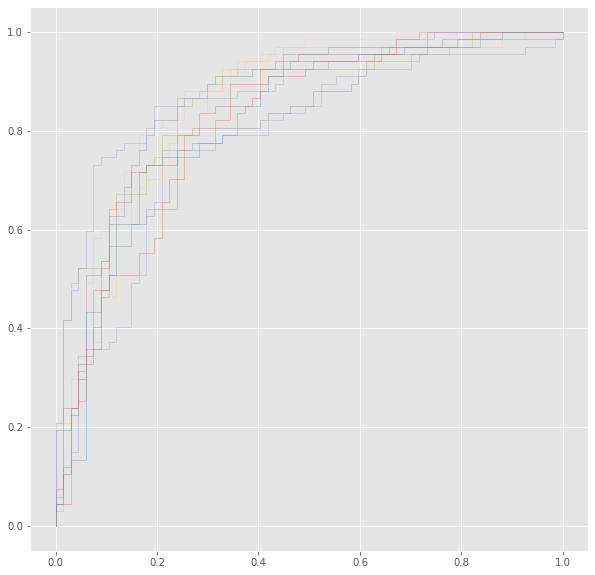

In [21]:
for train_val_idx, test_idx in StratShufSpl.split(X, y):
    shuffle_counter += 1
    print("--------------------------------")
    print("Beginning shuffle {}".format(shuffle_counter))
    print("--------------------------------")
    print("\n")
    param_grid = {"epochs": [300],
                  "validation_split": [0.1],
                  "callbacks": [[EarlyStopping(patience = 20)]],
                  "batch_size": [16, 32, 64], 
                  #"batch_size": [32],
                  "learning_rate": [0.01, 0.005, 0.001, 0.0001],
                  #"learning_rate": [0.001],
                  "activation": ["relu", "elu"],
                  "n_branch_outputs": [1, 4, 8],
                  "dropout": [0, 0.125, 0.25]}
                  #"dropout": [0]}
    
    build_keys = ["learning_rate", "activation", "n_branch_outputs", "dropout"]
    
    param_iterator = ParameterGrid(param_grid)
    grid_size = len(param_iterator)
    
    cv_list = ["CV_{}_GS_{}".format(str(i+1), str(j+1)) for i in range(n_cv_folds) for j in range(grid_size)]
    stat_df = pd.DataFrame(index = ["AUC", "MSE", "Params"], columns = cv_list)
    
    X_train_val, y_train_val = X.iloc[train_val_idx], y[train_val_idx]
    X_test, y_test = X.iloc[test_idx], y[test_idx]
    
    if f_sele:
        print("Univariately selecting features\n")
        selector = SelectPercentile(f_classif, f_percent)
        selector.fit(X_train_val, y_train_val)
        support = selector.get_support(indices = True)
        X_train_val = X_train_val.iloc[:, support]
        X_test = X_test.iloc[:, support]
    
    StratShufSplVal = StratifiedShuffleSplit(n_cv_folds,
                                             test_size = test_data_ratio, 
                                             random_state = random_seed)
    n_candidates = grid_size
    cv_fold = 0
    for train_idx, val_idx in StratShufSplVal.split(X_train_val, y_train_val):
        cv_fold += 1
        print("--------------------------------")
        print("Beginning cross validation fold {} in shuffle {} with {} candidates".format(cv_fold, shuffle_counter, n_candidates))
        print("--------------------------------")
        print("\n")
        X_train, y_train = X_train_val.iloc[train_idx], y_train_val[train_idx]
        X_val, y_val = X_train_val.iloc[val_idx], y_train_val[val_idx]

        
        print("Splitting data in different taxanomic ranks\n")
        train_dfs = zotus_to_tax_dfs(X_train, tax_table)
        val_dfs = zotus_to_tax_dfs(X_val, tax_table)
        
        print("Fitting scalers")
        dimensions = []
        train_inputs = []
        val_inputs = []
        for i in range(len(train_dfs)):
            train_dfs[i] = np.log(train_dfs[i]+1)
            val_dfs[i] = np.log(val_dfs[i]+1)
            scaler = MinMaxScaler()
            scaler.fit(train_dfs[i])
            train_inputs.append(scaler.transform(train_dfs[i]))
            val_inputs.append(scaler.transform(val_dfs[i]))
            dimensions.append(train_dfs[i].shape[-1])
        print("Finished scaling")
        
        gs_it = 0
        for params in param_iterator:
            saved_params = params.copy()
            build_params = {key: params.pop(key) for key in build_keys}
            gs_it += 1
            model = build_fn(dimensions, **build_params)
            model.fit(train_inputs, y_train, **params)
            y_pred_val = model.predict(val_inputs)
            val_mse = mean_squared_error(y_val, y_pred_val)
            val_auc = roc_auc_score(y_val, y_pred_val)
            print("\n")
            print("Val AUC: {}".format(val_auc))
            print("\n")
            
            stat_df.loc["MSE"]["CV_{}_GS_{}".format(cv_fold, gs_it)] = val_mse
            stat_df.loc["AUC"]["CV_{}_GS_{}".format(cv_fold, gs_it)] = val_auc
            stat_df.loc["Params"]["CV_{}_GS_{}".format(cv_fold, gs_it)] = saved_params
    
    # Fitting on entire train_val
    print("--------------------------------")
    print("Refitting on train + val and evaluating on test")
    print("--------------------------------")
    print("\n")
    print("Splitting data in different taxanomic ranks")
    train_val_dfs = zotus_to_tax_dfs(X_train_val, tax_table)
    test_dfs = zotus_to_tax_dfs(X_test, tax_table)
        
    print("Fitting scalers")
    train_val_inputs = []
    test_inputs = []
    for i in range(len(train_dfs)):
        train_val_dfs[i] = np.log(train_val_dfs[i]+1)
        test_dfs[i] = np.log(test_dfs[i]+1)
        scaler = MinMaxScaler()
        scaler.fit(train_val_dfs[i])
        train_val_inputs.append(scaler.transform(train_val_dfs[i]))
        test_inputs.append(scaler.transform(test_dfs[i]))
    print("Finished scaling")
    
    grouped_df, params = group_by_params(stat_df, n_combinations = grid_size)
    #grouped_df.to_csv('output_data/grouped_validation_results_{}.csv'.format(shuffle_counter))
    best_score_index = np.argmin(list(grouped_df.loc['MSE']))
    best_params = params[best_score_index]
    print('Best found parameters:\n')
    print(best_params)
    
    build_params = {key: best_params.pop(key) for key in build_keys}
    model = build_fn(dimensions, **build_params)
    model.fit(train_inputs, y_train, **best_params)
    y_pred_test = model.predict(test_inputs)
    test_mse = mean_squared_error(y_test, y_pred_test)
    test_auc = roc_auc_score(y_val, y_pred_val)

    fpr, tpr, thresholds = roc_curve(y_test, y_pred_test, pos_label = 1)
    auc_roc1 = auc(fpr, tpr)
    list_auc.append(auc_roc1)

    tprs.append(interp(mean_fpr, fpr, tpr))
    tprs[-1][0] = 0.0
    aucs.append(auc_roc1)
    plt.plot(fpr, tpr, lw=1, alpha=0.3)
    
    print("\n")
    print("Shuffle {} is done!\n".format(shuffle_counter))

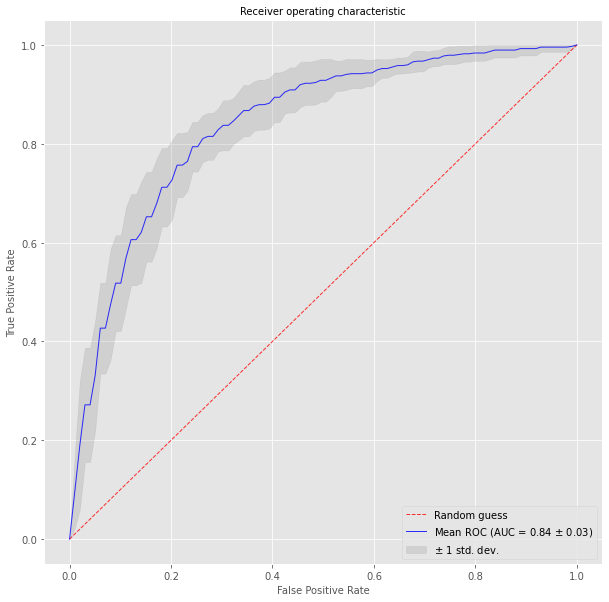

In [22]:
plt.plot([0, 1], [0, 1], linestyle='--', lw = 1, color='r',
             label="Random guess", alpha = .8)

mean_tpr = np.mean(tprs, axis=0)
mean_tpr[-1] = 1.0
mean_auc = auc(mean_fpr, mean_tpr)
std_auc = np.std(aucs)
plt.plot(mean_fpr, mean_tpr, color='b',
         label=r'Mean ROC (AUC = %0.2f $\pm$ %0.2f)' % (mean_auc, std_auc),
         lw = 1, alpha = .8)

std_tpr = np.std(tprs, axis=0)
tprs_upper = np.minimum(mean_tpr + std_tpr, 1)
tprs_lower = np.maximum(mean_tpr - std_tpr, 0)
plt.fill_between(mean_fpr, tprs_lower, tprs_upper, color = 'grey', alpha = .2,
                 label=r'$\pm$ 1 std. dev.')

plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.savefig('output_data/MLP_auc_avg.pdf', bbox_inches='tight')
plt.show()


In [23]:
dfs = zotus_to_tax_dfs(X, tax_table)
dimensions = []
for i in range(len(dfs)):
    dimensions.append(dfs[i].shape[-1])

In [24]:
print(aucs)

[0.8220093562040544, 0.8498552016039207, 0.7772332368010694, 0.8066384495433281, 0.8460681666295389, 0.8587658721318779, 0.8741367787926041, 0.8342615281799957, 0.8320338605480062, 0.8830474493205615]


In [25]:
dimensions

[4, 30, 49, 123, 203, 529, 326, 3655]

In [26]:
plot_model(model)

('Failed to import pydot. You must `pip install pydot` and install graphviz (https://graphviz.gitlab.io/download/), ', 'for `pydotprint` to work.')


In [27]:
model.summary()

Model: "functional_116819"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_zotu (InputLayer)         [(None, 1097)]       0                                            
__________________________________________________________________________________________________
input_phylum (InputLayer)       [(None, 30)]         0                                            
__________________________________________________________________________________________________
input_class (InputLayer)        [(None, 49)]         0                                            
__________________________________________________________________________________________________
input_order (InputLayer)        [(None, 123)]        0                                            
__________________________________________________________________________________

In [28]:
inter_output_model = tf.keras.Model(model.input, model.get_layer(index = 26).output)

In [29]:
#model.get_layer(index = 26).name

In [30]:
np.log(train_dfs[7]+1)

#OTU ID,Zotu79,Zotu64,Zotu1,Zotu74,Zotu291,Zotu22,Zotu20,Zotu73,Zotu168,Zotu59,...,Zotu2645,Zotu3162,Zotu3143,Zotu2005,Zotu2587,Zotu1005,Zotu2378,Zotu2006,Zotu3347,Zotu2289
ERR1369488,1.419607,0.000000,2.521200,1.574565,1.372307,1.784370,1.358505,1.745260,0.526589,1.852428,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ERR1369993,0.000000,1.678350,1.603479,1.832945,1.162283,2.212471,2.183080,1.327761,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ERR1369493,0.000000,1.026672,2.384285,1.787874,1.783183,1.864905,1.671001,1.830410,1.528427,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ERR1368928,2.164752,0.000000,0.741276,0.000000,0.000000,0.959135,0.000000,0.526589,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ERR1369421,0.000000,0.000000,1.971877,1.649561,0.959135,2.024125,1.419607,0.000000,0.000000,1.539779,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ERR1369257,0.000000,0.526589,1.886831,1.248441,0.741276,0.000000,0.000000,1.610903,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ERR1369327,0.000000,0.959135,2.128669,1.910860,1.162283,1.962640,1.026672,1.466077,1.718240,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ERR1369354,0.000000,0.526589,0.000000,0.000000,0.000000,1.271150,0.741276,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ERR1370098,0.000000,0.000000,2.304887,0.000000,0.000000,1.819777,2.045241,0.000000,0.000000,1.194706,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [31]:
train_inter_outputs = inter_output_model.predict(train_inputs)
test_inter_outputs = inter_output_model.predict(test_inputs)

In [32]:
tsne = TSNE(n_components=2)
train_embedded = tsne.fit_transform(train_inter_outputs)
test_embedded = tsne.fit_transform(test_inter_outputs)

In [33]:
train_emb_neg = train_embedded[np.where(y_train == 0)[0]]
train_emb_pos = train_embedded[np.where(y_train == 1)[0]]
test_emb_neg = test_embedded[np.where(y_test == 0)[0]]
test_emb_pos = test_embedded[np.where(y_test == 1)[0]]

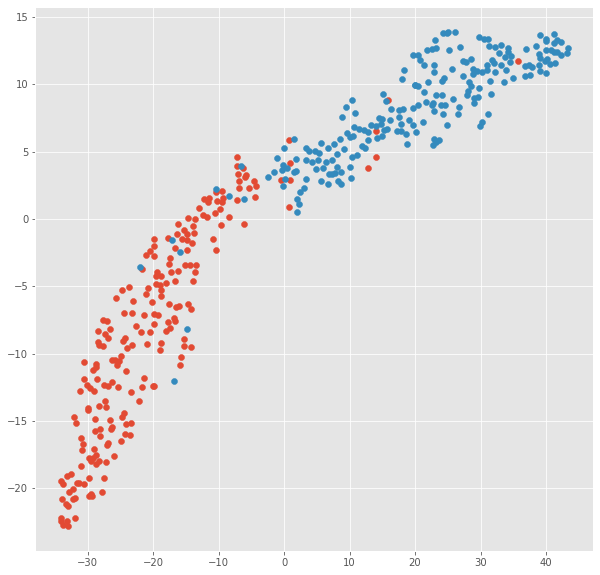

In [34]:
plt.scatter(train_emb_neg[:, 0], train_emb_neg[:, 1])
plt.scatter(train_emb_pos[:, 0], train_emb_pos[:, 1])

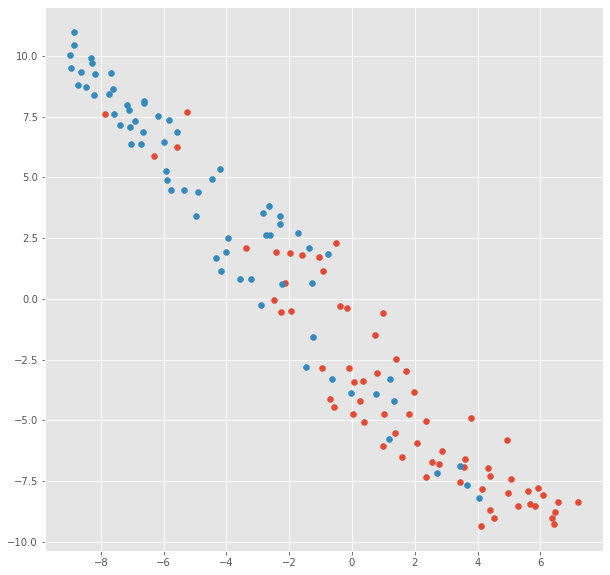

In [35]:
plt.scatter(test_emb_neg[:, 0], test_emb_neg[:, 1])
plt.scatter(test_emb_pos[:, 0], test_emb_pos[:, 1])

In [36]:
pca = PCA()
pca.fit(train_inter_outputs)
train_pca = pca.transform(train_inter_outputs)
test_pca = pca.transform(test_inter_outputs)
expl_var = pca.explained_variance_
print("Explained variances:\n\n{}".format(expl_var))

Explained variances:

[7.8016448e+00 4.1335374e-01 5.5690177e-02 4.5127507e-02 2.6262948e-02
 1.5540290e-02 1.1386625e-02 7.9801762e-03 6.0833013e-03 3.9153495e-03
 1.3642007e-03 8.9060114e-04 5.0271343e-04 2.6899658e-04 1.8073617e-04
 1.2099311e-04 1.1569758e-04 7.4502968e-05 6.1367085e-05 5.0947852e-05
 3.2731645e-05 2.5395258e-05 2.0922771e-05 1.3443514e-05 1.0247870e-05
 8.9586783e-06 6.6306743e-06 3.8057549e-06 3.1358973e-06 2.3882690e-06
 2.1653391e-06 3.0465523e-07]


In [37]:
train_pca_neg = train_pca[np.where(y_train == 0)[0]]
train_pca_pos = train_pca[np.where(y_train == 1)[0]]
test_pca_neg = test_pca[np.where(y_test == 0)[0]]
test_pca_pos = test_pca[np.where(y_test == 1)[0]]

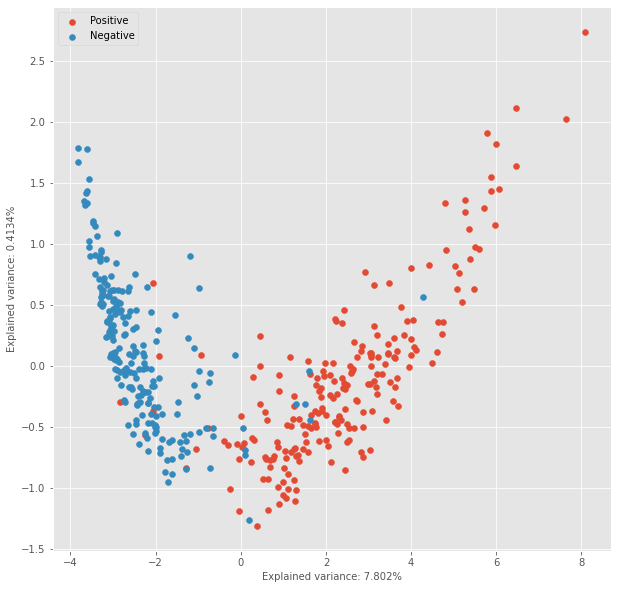

In [38]:
plt.scatter(train_pca_pos[:, 0], train_pca_pos[:, 1], label = "Positive")
plt.scatter(train_pca_neg[:, 0], train_pca_neg[:, 1], label = "Negative")
plt.xlabel("Explained variance: {0:.4g}%".format(expl_var[0]))
plt.ylabel("Explained variance: {0:.4g}%".format(expl_var[1]))
plt.legend()

Text(0, 0.5, 'Explained variance: 0.4134%')

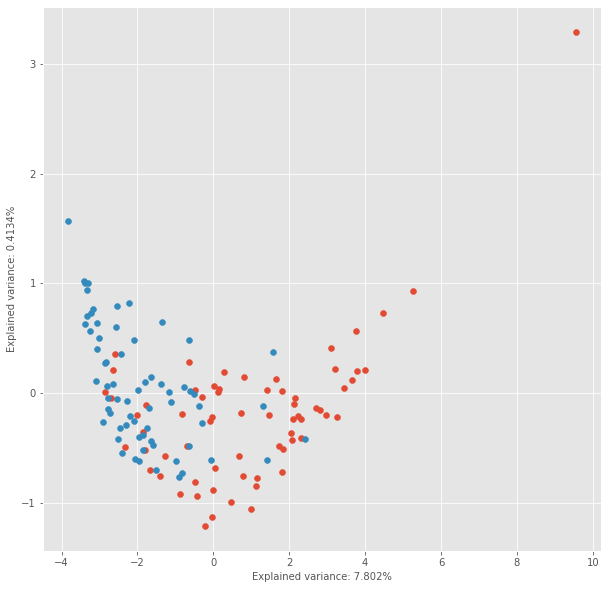

In [39]:
plt.scatter(test_pca_pos[:, 0], test_pca_pos[:, 1])
plt.scatter(test_pca_neg[:, 0], test_pca_neg[:, 1])
plt.xlabel("Explained variance: {0:.4g}%".format(expl_var[0]))
plt.ylabel("Explained variance: {0:.4g}%".format(expl_var[1]))

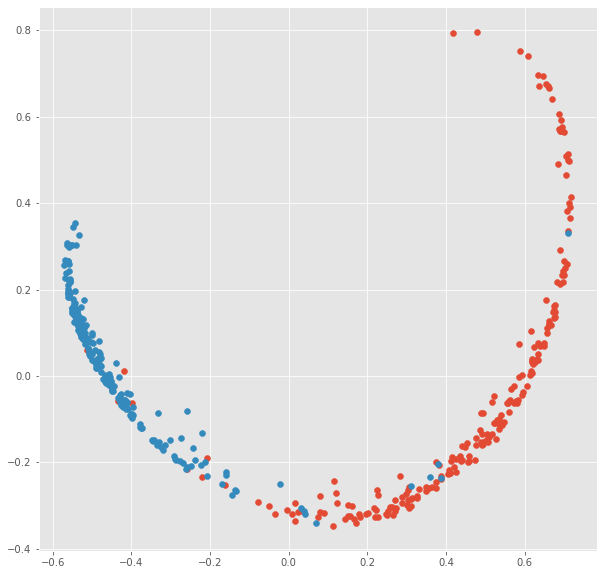

In [40]:
kpca = KernelPCA(kernel = "rbf")
kpca.fit(train_inter_outputs)
train_kpca = kpca.transform(train_inter_outputs)
test_kpca = kpca.transform(test_inter_outputs)

train_kpca_neg = train_kpca[np.where(y_train == 0)[0]]
train_kpca_pos = train_kpca[np.where(y_train == 1)[0]]
test_kpca_neg = test_kpca[np.where(y_test == 0)[0]]
test_kpca_pos = test_kpca[np.where(y_test == 1)[0]]

plt.scatter(train_kpca_pos[:, 0], train_kpca_pos[:, 1])
plt.scatter(train_kpca_neg[:, 0], train_kpca_neg[:, 1])

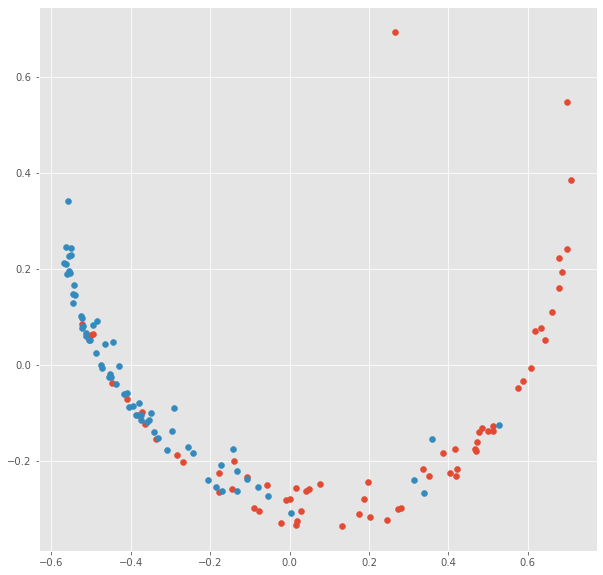

In [41]:
plt.scatter(test_kpca_pos[:, 0], test_kpca_pos[:, 1])
plt.scatter(test_kpca_neg[:, 0], test_kpca_neg[:, 1])